# Homework Assignment #1

In this homework, we will implement a few core CNN blocks and practice training neural networks by following the guidance step by step. The model to implement is similar to the [LeNet](http://yann.lecun.com/exdb/publis/pdf/lecun-01a.pdf). To do this some implementation sketch will be provided on which you can fill in your implementation.

![LeNet.png](attachment:LeNet.png)
Image Source: https://github.com/dsgiitr/d2l-pytorch/blob/master/img/lenet.png

In the following, we first import the basic packages. Feel free to add other packages if necessary.
**Note**: The only allowed deep learning framework is PyTorch. Please use Python 3.6 or newer verions and PyTorch 1.3 or newer verions for this homework.

In [0]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import DataLoader, Dataset
import matplotlib.pyplot as plt
import torchvision.utils as vutils
import numpy as np

The following is a sketch of the LeNet class which you will be filling in step-by-step. For now, you don't need to do anything with the following code.

In [0]:
# LeNet sketch code
class LeNet(nn.Module):
  def __init__(self):
    super(LeNet, self).__init__()
    """
    self.c1 = Conv2D()
    self.p2 = nn.AvgPool(2, stride=2)
    self.c3 = Conv2D()
    self.p4 = nn.AvgPool(2, stride=2)
    self.c5 = Linear()
    self.f6 = Linear()
    """
    
    
  def forward(self, imgs, labels):
    """
    scores = self.net(imgs)
    o = softmax(scores)
    loss = objective(o, labels)
    """
    return loss

## Task 1: Implement Convolutional Layer

The first task is to implement a convolutional layer by completing the following Conv2D class. The class takes the number of input channels, the number of output channels, stride size, and padding values as inputs. 

**To-do**:
    - (10 points)Implement code in-between (### start your code here ### and ### End of the code ###)

In [0]:
class Conv2D(nn.Module):
  def __init__(self, dim_in, dim_out, kernel_size, stride, padding, device):
    super(Conv2D, self).__init__()
    """
    inputs:
      dim_in: integer, number of channels in the input
      dim_out: integer, number of channels produced by the convolution
      kernel_size: integer list of length 2, spatial size of the convolving kernel
      stride: integer list of length 2, stride of the convolution along the the height dimension and width dimension
      padding: integers list of length 4, zero-padding added to both sides of the height dimension and width dimension
      
    """
    # initialize kernel and bias
    self.kernel = nn.Parameter(torch.randn([dim_out, dim_in]+kernel_size, dtype=torch.float32, device=device)*0.1, requires_grad=True)
    self.bias = nn.Parameter(torch.zeros([dim_out], dtype=torch.float32, device=device), requires_grad=True)
    
    self.dim_in = dim_in
    self.dim_out = dim_out
    
    self.kernel_size = kernel_size
    self.stride = stride
    self.padding = padding
    self.device = device
    
  def conv2d_forward(self, X):
    """
    inputs:
      X: input images
    outputs:
      Y: output produced by the convolution
    """

    ###  Star your code here ###

    pad = F.pad(X, self.padding)
    unfold = F.unfold(pad, kernel_size=self.kernel_size, stride=self.stride)
    flatten = self.kernel.view(self.kernel.size(0), -1) @ unfold
    o_h = int((pad.shape[2]-self.kernel_size[0])/self.stride[0]) + 1
    o_w = int((pad.shape[3]-self.kernel_size[1])/self.stride[1]) + 1
    Y = flatten.reshape(X.shape[0], self.dim_out, o_h, o_w).add(self.bias.view(self.dim_out, 1, 1))    
      
    ###  End of the code ###
    return Y

        
  def forward(self, x):
    return self.conv2d_forward(x)

## Conv2D Correctness Check

Run the correctness checking code. If your implementation is correct, you should be able to see the output as follows:
```python
tensor([[[[ 1.0519,  1.3811],
          [ 2.5701,  2.0508]],

         [[ 1.3159,  2.4203],
          [ 8.4296, 10.1662]]],


        [[[ 4.4640,  5.9235],
          [ 4.5179,  2.3144]],

         [[13.1246, 15.5932],
          [20.2635, 22.9700]]]], grad_fn=<AddBackward0>)
```

In [4]:
# correctness checking
torch.random.manual_seed(0)
x = torch.arange(50).view(2,1,5,5).float()
my_conv = Conv2D(1,2,[3,3],[3,3],[1,1,1,1], torch.device('cpu'))
y = my_conv(x)
print(y)

tensor([[[[ 1.0519,  1.3811],
          [ 2.5701,  2.0508]],

         [[ 1.3159,  2.4203],
          [ 8.4296, 10.1662]]],


        [[[ 4.4640,  5.9235],
          [ 4.5179,  2.3144]],

         [[13.1246, 15.5932],
          [20.2635, 22.9700]]]], grad_fn=<AddBackward0>)


## Guide: Pooling Layer

We will not implement the pooling layer. Instead, we will use the Pytorch API (torch.nn.AvgPool2d). Feel free to implement it by yourself (if you want). For the detail information about the pooling API, check the [documents](https://pytorch.org/docs/1.3.1/nn.html#avgpool2d).

## Task 2: Implementing Linear Layer

Complete the following linear layer module. To specify a linear layer, input dimension and output dimension are provided. The linear layer performs the following computation: $y = xW^T+ b$.

**To-do**:
    - (5 points)Implement code in-between (### start your code here ### and ### End of the code ###)

In [0]:
class Linear(nn.Module):
  def __init__(self, dim_in, dim_out, device):
    super(Linear, self).__init__()
    
    self.weights = nn.Parameter(torch.randn([dim_out, dim_in], dtype=torch.float32, device=device)*0.1, requires_grad=True)
    
    self.bias = nn.Parameter(torch.zeros([dim_out], dtype=torch.float32, device=device), requires_grad=True)
    self.dim_out = dim_out
    self.device = device
    
  def linear_forward(self, X):
    """
    inputs:
     X: tensor of shape (batch_size, *, dim_in)
    outputs:
     Y: tensor of shape (batch_size, *, dim_out)
    """
    
    ###  Star your code here ### 

    X = X.view(X.shape[0], self.weights.shape[1])
    Y = torch.matmul(X,self.weights.t()) + self.bias

    ###  End of the code ###
    return Y
  
  def forward(self, X):
    return self.linear_forward(X)

## Linear Correctness Check

Run the following correctness checking code. If your implementation is correct, you should be able to see the output as follows:
```python
tensor([[ -2.1595,  -0.2037,   1.8567],
        [ -6.9537,   0.7306,   2.5298],
        [-11.7479,   1.6648,   3.2028],
        [-16.5422,   2.5991,   3.8759],
        [-21.3364,   3.5334,   4.5489]], grad_fn=<AddBackward0>)
```

In [6]:
# correctness checking
torch.random.manual_seed(0)
x = torch.arange(50).view(5, 10).float()
my_linear = Linear(10, 3, torch.device('cpu'))
y = my_linear(x)
print(y)

tensor([[ -2.1595,  -0.2037,   1.8567],
        [ -6.9537,   0.7306,   2.5298],
        [-11.7479,   1.6648,   3.2028],
        [-16.5422,   2.5991,   3.8759],
        [-21.3364,   3.5334,   4.5489]], grad_fn=<AddBackward0>)


## Task 3: Loss Functions and SGD

The loss function for classification task is the Cross-Entropy Loss. For this, we need to implement the softmax output layer first and then the cross-entropy loss.

Softmax function normalizes the output so that its sum becomes 1 and each output is nonnegative:

$$
\hat{\mathbf{y}} = \text{softmax}(\mathbf{o}),\text{ where } \hat{y}_i = \frac{\text{exp}(o_i)}{\sum_j \text{exp}(o_j)}
$$

Cross-Entropy Loss is as the objective function for this classification task. When the loss is minimized, the likelihood function will be maximized:

$$
l = -\log{P(y \mid x)} = -\sum_j y_j\log{\hat{y}_j}
$$

**To-do**:
    - (10 points)Complete the function **softmax1d()**.
    - (10 points)Complete the function **cross_entropy_loss()**.

Note that you should implement the function using primative PyTorch APIs such as exp() and matmul(), instead of simply using PyTorch API for softmax and cross_entropy_loss.

In [0]:
def softmax1d(scores):
  """
  inputs:
    scores: (N, C), predicted scores for each input, where N is the number of samples and C is the number of
            classes.
  outputs:
    p: (N, C), probability distribution over classes. Converted from input (scores) with a softmax operation.
    
  Note: Do be careful of the numerial error!
  """
  ###  Star your code here ### 

  top = torch.exp(scores-torch.max(scores,1,keepdim=True)[0])
  bottom = top.sum(1).unsqueeze(1)
  p = (top/bottom).add_(1e-14)

  ###  End of the code ###
  
  return p

def cross_entropy_loss(pred_score, labels):
  """
  inputs:
    pred_score: (N, C), probaility distribution or pred_scores over classes, where N is the number of samples and C is the number of
      classes.
  outputs:
    loss: (N,), cross entropy loss for each sample.

  Note: Do be careful of the numerial error!
  """
  ###  Star your code here ### 
  
  loss = -1*torch.log(pred_score).gather(1, labels.view(-1,1))
   
  ###  End of the code ###
  
  return loss.mean()

**To-do**:
    - (10 points)Next task is to implement the update rule of stochastic gradient descent. Complete the following function.

In [0]:
def step(weights, grad, lr):
  """
  inputs:
    weights: list of learnable parameters
    grad: list of gradient of the loss w.r.t the learnable parameters
    lr: learning rate for gradient descent
  outputs:
    None. Make sure updating the weights with in-place operation, e.g. tensor.add_(). No output need be returned.
  """
  ###  Star your code here ### 

  for i in range(len(weights)):
    # weights[i].data.add_(grad[i]*lr)
    weights[i].data.sub_(grad[i]*lr)

  ###  End of the code ###

## Task 4: LeNet Forward Pass

Using the above components required to implement the LeNet, we can complete the LeNet class as follows. 

**To-do**:
    - (20 points)Complete the function **forward()** which takes the input images and labels and outputs the cross-entropy loss (for the batch) and predicted distribution. For more details, refer to the comments below.

In [0]:
# LeNet sketch code
class LeNet(nn.Module):
  def __init__(self, img_c, device):
    super(LeNet, self).__init__()
    self.c1 = Conv2D(img_c, 6, [5,5], [1,1], [2,2,2,2], device)
    self.p2 = nn.MaxPool2d(2, stride=2)
    self.c3 = Conv2D(6, 16, [5,5], [1,1], [0,0,0,0], device)
    self.p4 = nn.MaxPool2d(2, stride=2)
    self.f5 = Linear(400, 120, device)
    self.f6 = Linear(120, 84, device)
    self.f7 = Linear(84, 10, device)
    self.device = device
    
    
  def forward(self, imgs, labels):
    """
    inputs:
      imgs: (N, C, H, W), training samples from the MNIST training set, where N is the number of samples (batch_size),
          C is the image color channle number, H and W are the spatial size of the input images.
      labels: (N, L), ground truth for the input images, where N is the number of samples (batch_size) and L is the 
          number of classes.
    outputs:
      loss: (1,), mean loss value over this batch of inputs.
    
    """
    N = imgs.shape[0]
    
    o_c1 = F.relu(self.c1(imgs))
    o_p2 = self.p2(o_c1)
    o_c3 = F.relu(self.c3(o_p2))
    o_p4 = self.p4(o_c3)
    
    ### Start the code here  ###
    # 1. Please complete the rest of LeNet to get the scores predicted by LeNet for each input images #
    
    o_p5 = self.f5(o_p4)
    o_p6 = self.f6(o_p5)
    o_p7 = self.f7(o_p6)
        
    # 2. Please use the implemented objective function to obtain the losses of each input. #
    
    # p, loss = o_p7, cross_entropy_loss(softmax1d(p), labels)
    p = o_p7
    loss = cross_entropy_loss(softmax1d(p), labels)

    # 3. We will return the mean value of the losses. #

    ###  End of the code ###
    return loss.mean(), p

## Guide:  Dataset Preparation

We use MNIST dataset to train the LeNet. Run the following cell to get the dataset ready for the training. Change the data_path to a proper one.

In [0]:
import os
import urllib.request

data_path = './CS536_MNIST/'
if not os.path.exists(data_path):
  os.mkdir(data_path)
  print("Starting downloading MNIST to {}".format(data_path))
  
  import urllib
  dataset_dict = {
        'train_images': "http://yann.lecun.com/exdb/mnist/train-images-idx3-ubyte.gz",
        'train_labels': "http://yann.lecun.com/exdb/mnist/train-labels-idx1-ubyte.gz",
        'test_images': "http://yann.lecun.com/exdb/mnist/t10k-images-idx3-ubyte.gz",
        'test_labels': "http://yann.lecun.com/exdb/mnist/t10k-labels-idx1-ubyte.gz",}

  for f, url in dataset_dict.items():
    urllib.request.urlretrieve(url, data_path + f)

The class dataset has been provided below. More about PyTorch Dataset can be found [here](https://pytorch.org/tutorials/beginner/data_loading_tutorial.html#dataset-class). Please run the following Jupyter cell to make sure the dataset is ready for training.

In [0]:
train_img_file = data_path + 'train_images'
train_lb_file = data_path + 'train_labels'
test_img_file = data_path + 'test_images'
test_lb_file = data_path + 'test_labels'

class MNISTDataset(Dataset):
  def __init__(self, ds_size=10000, split='training'):
    self.split = split
    if self.split == 'training':
      img_file = train_img_file
      lb_file = train_lb_file
      n_samples = 60000
    else:
      img_file = test_img_file
      lb_file = test_lb_file
      n_samples = 10000
    self.ds_size = ds_size
      
    import gzip
    with gzip.open(img_file, 'rb') as f:
      imgs = f.read()
    imgs = np.frombuffer(imgs[16:], dtype=np.uint8).astype(np.float32)
    with gzip.open(lb_file, 'rb') as f:
      lb = f.read()
    lbs = np.frombuffer(lb[8:], dtype=np.uint8).astype(np.float32)
    
    imgs = torch.tensor(imgs).view(n_samples, 1, 28, 28) - 125.
    lbs = torch.tensor(lbs).long()
    
    self.imgs = imgs[:ds_size]
    self.lbs= lbs[:ds_size]
    
  def __len__(self):
    return self.ds_size
  
  def __getitem__(self, idx):
    return self.imgs[idx], self.lbs[idx]
  

## Guide: Training for Overfitting

First, we will make our model overfit. It is a good practice to check if a model can overfit well (It should do it well in a proper setting. If not, your model may have some bug, the model complexity is too simple, or some training parameters like learning rate are not good.)

For this, we will first use only 1000 data points instead of the full dataset (smaller datasets makes models overfit more easily if the model complexity is fixed.)

We also use the  20% -split as the validation set. The dataset loading script is provided below.

In [0]:
dataset_size = 1000
validation_size = int(0.2 * 1000)

ds = MNISTDataset(ds_size=dataset_size)

# split the dataset into training set and validation set
train_ds, val_ds = torch.utils.data.random_split(ds, [dataset_size - validation_size, validation_size])

# training batch size, hyper-parameter
batch_size = 24

# dataset loader
train_dl = DataLoader(train_ds, batch_size=batch_size, shuffle=True, drop_last=True)
val_dl = DataLoader(val_ds, batch_size=batch_size, shuffle=True, drop_last=True)
img_channel = 1

The training script is provided as follows. After $100$ epochs, you will see LeNet is overfitted as the validation error is a lot larger than the training error. Also, the classification accuracy is almost $100\%$ on the training set, while only around $70\%$ on the validation set.

step 0, loss 25.437034606933594
Target:	 tensor([9, 6, 7, 0, 4, 4, 4, 8])
Pred:	 tensor([4, 4, 4, 4, 4, 4, 4, 4])


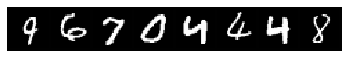

step 33, loss 29.530115127563477
Target:	 tensor([2, 1, 4, 9, 1, 8, 7, 1])
Pred:	 tensor([0, 0, 4, 4, 4, 4, 4, 4])


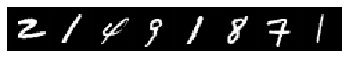

step 66, loss 15.241276741027832
Target:	 tensor([4, 0, 3, 9, 5, 9, 7, 6])
Pred:	 tensor([0, 7, 7, 4, 5, 0, 7, 4])


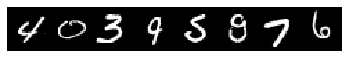

step 99, loss 24.177148818969727
Target:	 tensor([9, 3, 4, 6, 2, 4, 3, 9])
Pred:	 tensor([7, 4, 4, 4, 1, 4, 7, 0])


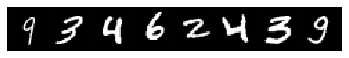

step 132, loss 18.086271286010742
Target:	 tensor([8, 7, 4, 0, 5, 3, 6, 1])
Pred:	 tensor([7, 7, 4, 0, 5, 5, 4, 1])


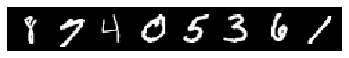

step 165, loss 17.464950561523438
Target:	 tensor([1, 3, 4, 4, 3, 5, 0, 2])
Pred:	 tensor([1, 7, 4, 4, 5, 5, 0, 4])


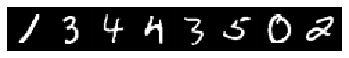

step 198, loss 19.562368392944336
Target:	 tensor([5, 4, 3, 0, 7, 7, 1, 2])
Pred:	 tensor([5, 4, 8, 7, 7, 7, 4, 4])


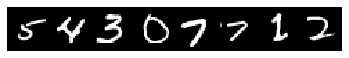

step 231, loss 14.77551555633545
Target:	 tensor([2, 5, 7, 3, 5, 6, 3, 9])
Pred:	 tensor([0, 5, 7, 5, 5, 4, 8, 4])


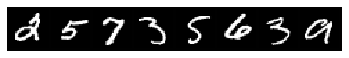

step 264, loss 12.064021110534668
Target:	 tensor([6, 9, 3, 4, 1, 5, 9, 9])
Pred:	 tensor([1, 5, 5, 4, 1, 5, 4, 4])


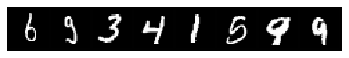

step 297, loss 9.63709545135498
Target:	 tensor([0, 4, 5, 9, 8, 5, 4, 0])
Pred:	 tensor([0, 4, 0, 7, 1, 5, 7, 0])


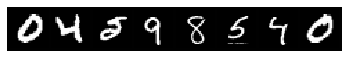

step 330, loss 17.461275100708008
Target:	 tensor([9, 1, 1, 2, 6, 8, 0, 9])
Pred:	 tensor([0, 1, 1, 7, 4, 1, 0, 7])


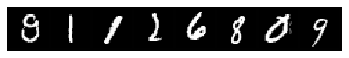

step 363, loss 20.14766502380371
Target:	 tensor([3, 9, 1, 7, 2, 0, 7, 6])
Pred:	 tensor([5, 7, 0, 7, 4, 0, 7, 4])


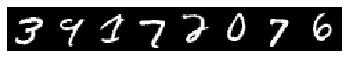

step 396, loss 17.461454391479492
Target:	 tensor([5, 2, 4, 0, 8, 3, 9, 1])
Pred:	 tensor([5, 0, 4, 0, 1, 5, 4, 1])


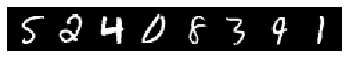

step 429, loss 18.80473518371582
Target:	 tensor([6, 5, 8, 3, 9, 4, 1, 0])
Pred:	 tensor([5, 5, 4, 1, 4, 4, 1, 0])


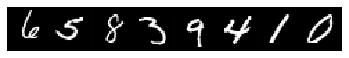

step 462, loss 12.351086616516113
Target:	 tensor([2, 2, 5, 0, 6, 9, 7, 5])
Pred:	 tensor([9, 0, 5, 0, 1, 7, 7, 5])


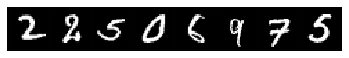

step 495, loss 13.312106132507324
Target:	 tensor([0, 0, 1, 7, 8, 3, 2, 0])
Pred:	 tensor([0, 0, 1, 7, 9, 9, 1, 0])


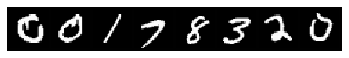

step 528, loss 11.45712947845459
Target:	 tensor([7, 6, 7, 1, 1, 2, 4, 4])
Pred:	 tensor([7, 4, 7, 4, 1, 0, 4, 9])


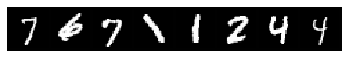

step 561, loss 21.91456413269043
Target:	 tensor([8, 4, 9, 2, 7, 2, 0, 7])
Pred:	 tensor([1, 4, 4, 5, 7, 5, 0, 7])


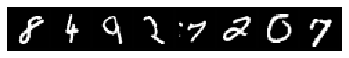

step 594, loss 14.816604614257812
Target:	 tensor([6, 5, 1, 9, 8, 1, 4, 1])
Pred:	 tensor([1, 5, 0, 9, 9, 1, 4, 1])


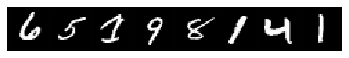

step 627, loss 8.911991119384766
Target:	 tensor([7, 9, 1, 5, 4, 0, 8, 8])
Pred:	 tensor([7, 9, 0, 5, 9, 0, 9, 9])


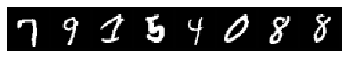

step 660, loss 9.840649604797363
Target:	 tensor([9, 0, 1, 7, 3, 0, 6, 5])
Pred:	 tensor([9, 0, 1, 9, 4, 0, 4, 5])


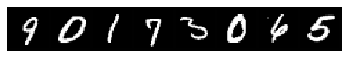

step 693, loss 12.139666557312012
Target:	 tensor([9, 7, 1, 4, 2, 1, 2, 0])
Pred:	 tensor([9, 7, 1, 4, 1, 0, 9, 0])


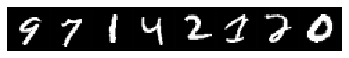

step 726, loss 10.745680809020996
Target:	 tensor([7, 3, 6, 1, 2, 4, 2, 9])
Pred:	 tensor([7, 5, 5, 1, 0, 4, 1, 9])


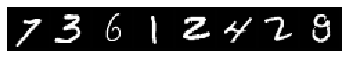

step 759, loss 14.775044441223145
Target:	 tensor([1, 8, 5, 3, 6, 3, 8, 2])
Pred:	 tensor([1, 1, 5, 5, 1, 5, 9, 1])


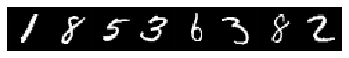

step 792, loss 10.74500560760498
Target:	 tensor([4, 2, 0, 0, 5, 8, 5, 0])
Pred:	 tensor([4, 0, 0, 0, 5, 5, 5, 0])


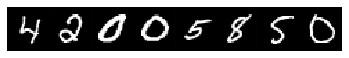

step 825, loss 13.43182373046875
Target:	 tensor([9, 2, 2, 7, 3, 4, 9, 0])
Pred:	 tensor([9, 5, 1, 7, 5, 4, 9, 0])


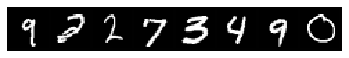

step 858, loss 10.853428840637207
Target:	 tensor([6, 2, 9, 7, 3, 9, 1, 0])
Pred:	 tensor([4, 0, 9, 7, 9, 9, 1, 0])


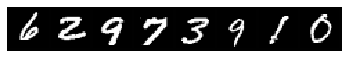

step 891, loss 14.839393615722656
Target:	 tensor([8, 9, 1, 2, 8, 8, 2, 7])
Pred:	 tensor([9, 8, 1, 0, 9, 1, 9, 7])


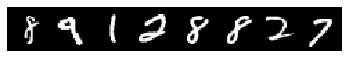

step 924, loss 16.119020462036133
Target:	 tensor([3, 1, 5, 6, 8, 6, 5, 2])
Pred:	 tensor([7, 1, 5, 5, 8, 5, 5, 1])


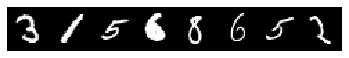

step 957, loss 7.100555896759033
Target:	 tensor([8, 9, 9, 0, 4, 4, 1, 3])
Pred:	 tensor([1, 9, 9, 0, 4, 4, 1, 8])


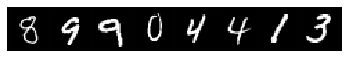

step 990, loss 9.475995063781738
Target:	 tensor([6, 4, 5, 3, 4, 4, 3, 9])
Pred:	 tensor([4, 9, 5, 5, 4, 4, 0, 9])


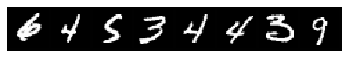

step 1023, loss 9.402860641479492
Target:	 tensor([9, 6, 6, 9, 4, 7, 1, 1])
Pred:	 tensor([9, 4, 4, 9, 4, 7, 1, 1])


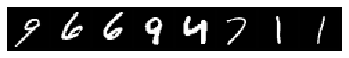

step 1056, loss 17.46128273010254
Target:	 tensor([8, 0, 4, 7, 3, 4, 2, 2])
Pred:	 tensor([9, 0, 4, 7, 9, 4, 1, 5])


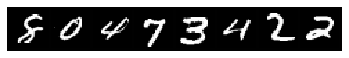

step 1089, loss 13.433527946472168
Target:	 tensor([8, 9, 2, 1, 0, 3, 2, 9])
Pred:	 tensor([5, 9, 0, 1, 0, 9, 0, 9])


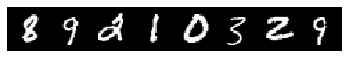

step 1122, loss 6.716646671295166
Target:	 tensor([3, 3, 7, 1, 4, 9, 7, 4])
Pred:	 tensor([4, 3, 7, 1, 4, 9, 7, 4])


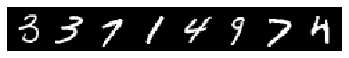

step 1155, loss 21.490869522094727
Target:	 tensor([6, 9, 3, 3, 9, 3, 8, 2])
Pred:	 tensor([5, 9, 8, 7, 9, 7, 5, 5])


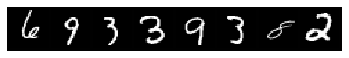

step 1188, loss 9.150771141052246
Target:	 tensor([7, 5, 7, 1, 5, 2, 7, 7])
Pred:	 tensor([7, 5, 7, 1, 5, 2, 7, 7])


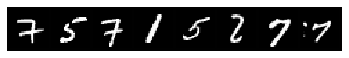

step 1221, loss 12.088580131530762
Target:	 tensor([6, 4, 4, 3, 8, 5, 1, 3])
Pred:	 tensor([4, 4, 4, 5, 1, 5, 1, 5])


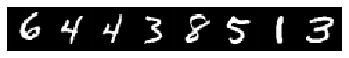

step 1254, loss 6.716585636138916
Target:	 tensor([0, 0, 1, 8, 1, 0, 7, 8])
Pred:	 tensor([0, 0, 1, 5, 1, 0, 7, 8])


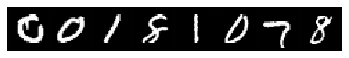

step 1287, loss 13.476971626281738
Target:	 tensor([8, 2, 4, 0, 7, 4, 1, 6])
Pred:	 tensor([9, 5, 4, 0, 7, 4, 1, 0])


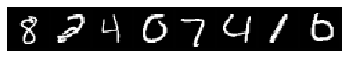

step 1320, loss 11.296759605407715
Target:	 tensor([2, 1, 3, 1, 5, 2, 5, 9])
Pred:	 tensor([5, 1, 8, 1, 5, 7, 5, 9])


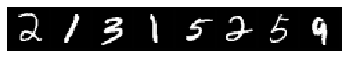

step 1353, loss 7.719701766967773
Target:	 tensor([6, 0, 9, 1, 7, 5, 5, 5])
Pred:	 tensor([4, 0, 9, 1, 7, 5, 5, 5])


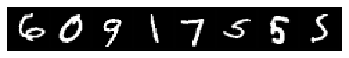

step 1386, loss 10.928603172302246
Target:	 tensor([4, 7, 1, 2, 6, 6, 7, 1])
Pred:	 tensor([4, 7, 1, 2, 4, 4, 7, 1])


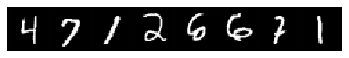

step 1419, loss 12.203654289245605
Target:	 tensor([7, 5, 8, 1, 0, 9, 1, 7])
Pred:	 tensor([7, 5, 2, 1, 0, 9, 1, 7])


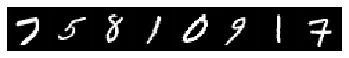

step 1452, loss 8.069825172424316
Target:	 tensor([7, 5, 3, 6, 9, 9, 6, 4])
Pred:	 tensor([7, 5, 8, 4, 9, 9, 5, 4])


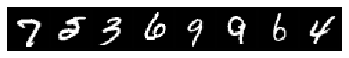

step 1485, loss 12.463027954101562
Target:	 tensor([9, 7, 7, 5, 2, 3, 6, 3])
Pred:	 tensor([9, 7, 7, 5, 2, 8, 4, 5])


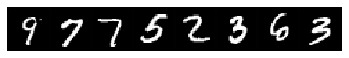

step 1518, loss 7.147481441497803
Target:	 tensor([1, 2, 0, 0, 7, 8, 2, 1])
Pred:	 tensor([1, 9, 0, 0, 7, 8, 2, 1])


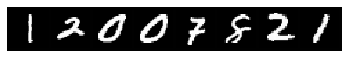

step 1551, loss 6.71783447265625
Target:	 tensor([5, 9, 3, 0, 8, 1, 7, 2])
Pred:	 tensor([5, 9, 8, 0, 8, 1, 7, 0])


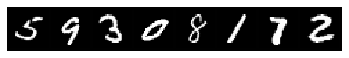

step 1584, loss 8.059048652648926
Target:	 tensor([6, 3, 3, 8, 5, 3, 3, 1])
Pred:	 tensor([8, 5, 2, 8, 5, 5, 5, 1])


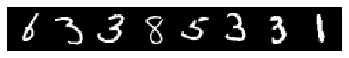

step 1617, loss 2.700214385986328
Target:	 tensor([8, 0, 8, 8, 4, 7, 1, 1])
Pred:	 tensor([8, 0, 8, 8, 4, 7, 1, 1])


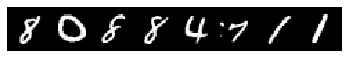

step 1650, loss 9.402560234069824
Target:	 tensor([8, 2, 0, 8, 6, 6, 7, 3])
Pred:	 tensor([8, 2, 0, 8, 5, 4, 7, 8])


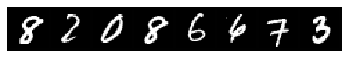

step 1683, loss 8.075831413269043
Target:	 tensor([6, 8, 6, 6, 3, 9, 1, 8])
Pred:	 tensor([4, 8, 8, 5, 8, 9, 1, 8])


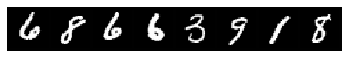

step 1716, loss 2.4335944652557373
Target:	 tensor([8, 7, 9, 1, 3, 8, 5, 4])
Pred:	 tensor([8, 7, 9, 1, 8, 8, 5, 4])


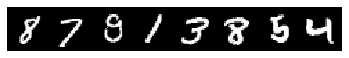

step 1749, loss 5.386206150054932
Target:	 tensor([6, 2, 5, 3, 8, 8, 9, 9])
Pred:	 tensor([8, 2, 5, 2, 8, 8, 9, 9])


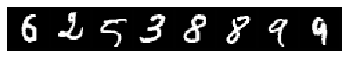

step 1782, loss 9.397457122802734
Target:	 tensor([7, 3, 7, 1, 0, 3, 1, 0])
Pred:	 tensor([7, 2, 7, 1, 0, 8, 1, 0])


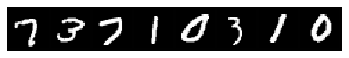

step 1815, loss 8.05930233001709
Target:	 tensor([3, 7, 0, 3, 1, 7, 0, 5])
Pred:	 tensor([2, 7, 0, 5, 1, 7, 0, 5])


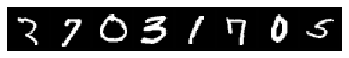

step 1848, loss 4.88438081741333
Target:	 tensor([2, 2, 7, 1, 7, 2, 2, 9])
Pred:	 tensor([9, 2, 7, 1, 7, 7, 2, 9])


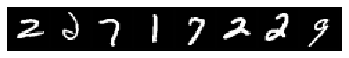

step 1881, loss 1.3439984321594238
Target:	 tensor([9, 7, 0, 5, 9, 1, 0, 4])
Pred:	 tensor([9, 7, 0, 5, 9, 1, 0, 4])


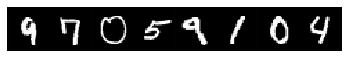

step 1914, loss 6.726696014404297
Target:	 tensor([0, 1, 8, 5, 2, 4, 8, 9])
Pred:	 tensor([0, 1, 8, 5, 2, 4, 8, 9])


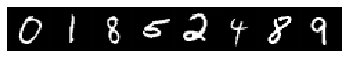

step 1947, loss 4.029506683349609
Target:	 tensor([2, 0, 4, 3, 5, 9, 0, 4])
Pred:	 tensor([2, 0, 4, 3, 5, 9, 0, 4])


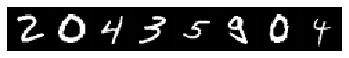

step 1980, loss 5.398993015289307
Target:	 tensor([1, 4, 3, 7, 0, 8, 1, 2])
Pred:	 tensor([1, 4, 3, 7, 0, 8, 1, 2])


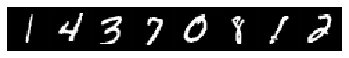

step 2013, loss 2.889932870864868
Target:	 tensor([2, 0, 2, 6, 8, 3, 6, 5])
Pred:	 tensor([2, 0, 2, 4, 8, 7, 4, 5])


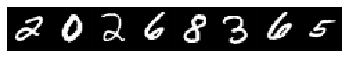

step 2046, loss 4.121704578399658
Target:	 tensor([7, 1, 6, 6, 4, 0, 4, 9])
Pred:	 tensor([7, 1, 5, 5, 4, 0, 4, 9])


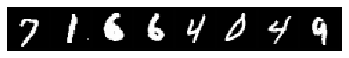

step 2079, loss 8.39208698272705
Target:	 tensor([3, 3, 8, 7, 4, 6, 7, 0])
Pred:	 tensor([2, 3, 8, 7, 4, 4, 7, 0])


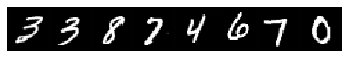

step 2112, loss 3.5531132221221924
Target:	 tensor([3, 4, 0, 4, 7, 7, 5, 1])
Pred:	 tensor([3, 4, 0, 4, 7, 3, 5, 1])


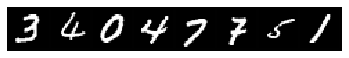

step 2145, loss 1.8655610084533691
Target:	 tensor([8, 2, 0, 2, 3, 5, 2, 8])
Pred:	 tensor([8, 2, 0, 2, 3, 5, 2, 8])


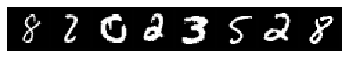

step 2178, loss 6.720986843109131
Target:	 tensor([7, 6, 3, 2, 5, 8, 8, 2])
Pred:	 tensor([7, 8, 3, 2, 5, 8, 8, 2])


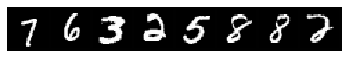

step 2211, loss 6.031684875488281
Target:	 tensor([3, 2, 1, 4, 1, 7, 6, 8])
Pred:	 tensor([5, 2, 1, 4, 1, 7, 8, 8])


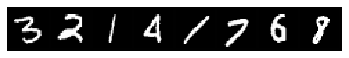

step 2244, loss 3.080530881881714
Target:	 tensor([3, 5, 3, 4, 7, 2, 4, 4])
Pred:	 tensor([8, 5, 3, 5, 7, 2, 4, 4])


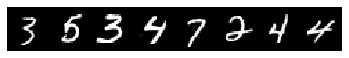

step 2277, loss 4.436770915985107
Target:	 tensor([3, 1, 2, 9, 7, 0, 5, 8])
Pred:	 tensor([3, 1, 2, 9, 7, 0, 5, 8])


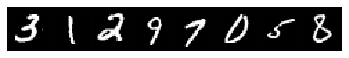

step 2310, loss 5.37285041809082
Target:	 tensor([4, 9, 1, 7, 2, 1, 1, 6])
Pred:	 tensor([4, 9, 1, 7, 9, 1, 1, 4])


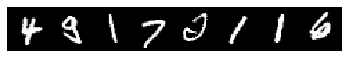

step 2343, loss 0.03763171657919884
Target:	 tensor([3, 9, 5, 8, 9, 4, 0, 1])
Pred:	 tensor([3, 9, 5, 8, 9, 4, 0, 1])


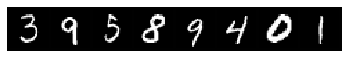

step 2376, loss 6.716254711151123
Target:	 tensor([2, 6, 3, 1, 2, 8, 1, 6])
Pred:	 tensor([2, 4, 3, 1, 2, 8, 1, 8])


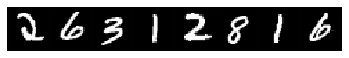

step 2409, loss 2.694366455078125
Target:	 tensor([4, 2, 4, 1, 7, 1, 8, 2])
Pred:	 tensor([4, 0, 4, 1, 7, 1, 8, 2])


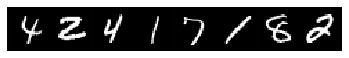

step 2442, loss 4.345253944396973
Target:	 tensor([5, 4, 7, 1, 2, 3, 5, 5])
Pred:	 tensor([5, 4, 7, 1, 2, 3, 5, 5])


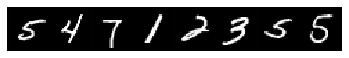

step 2475, loss 2.6870195865631104
Target:	 tensor([8, 4, 9, 0, 8, 2, 8, 1])
Pred:	 tensor([8, 4, 9, 0, 8, 2, 8, 1])


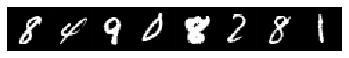

step 2508, loss 1.346941351890564
Target:	 tensor([1, 0, 9, 3, 3, 7, 9, 5])
Pred:	 tensor([1, 0, 9, 3, 3, 7, 9, 5])


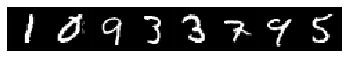

step 2541, loss 2.6866252422332764
Target:	 tensor([3, 9, 0, 3, 9, 0, 6, 5])
Pred:	 tensor([3, 9, 0, 3, 9, 0, 4, 5])


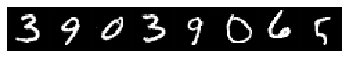

step 2574, loss 1.3517122268676758
Target:	 tensor([9, 4, 2, 2, 7, 5, 3, 1])
Pred:	 tensor([9, 4, 9, 2, 7, 5, 3, 1])


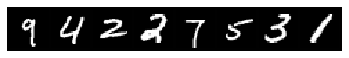

step 2607, loss 5.378880023956299
Target:	 tensor([4, 3, 8, 3, 6, 6, 0, 4])
Pred:	 tensor([4, 3, 8, 4, 4, 4, 0, 4])


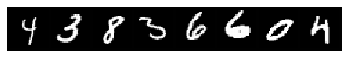

step 2640, loss 1.34587562084198
Target:	 tensor([9, 8, 2, 9, 3, 9, 7, 3])
Pred:	 tensor([9, 8, 2, 9, 3, 9, 7, 3])


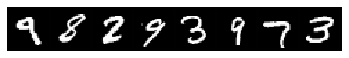

step 2673, loss 2.6984291076660156
Target:	 tensor([8, 8, 5, 3, 8, 4, 9, 2])
Pred:	 tensor([8, 8, 5, 3, 9, 4, 9, 2])


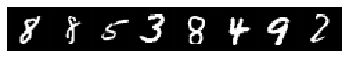

step 2706, loss 4.034243106842041
Target:	 tensor([2, 3, 0, 5, 3, 0, 7, 5])
Pred:	 tensor([2, 3, 0, 5, 3, 0, 7, 5])


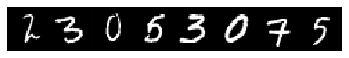

step 2739, loss 1.3470147848129272
Target:	 tensor([6, 7, 4, 5, 7, 9, 4, 2])
Pred:	 tensor([4, 7, 4, 5, 7, 9, 4, 2])


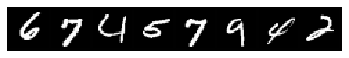

step 2772, loss 1.3460065126419067
Target:	 tensor([1, 4, 3, 2, 4, 1, 2, 0])
Pred:	 tensor([1, 4, 3, 2, 4, 1, 2, 0])


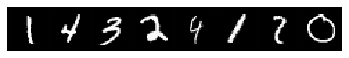

step 2805, loss 2.696601152420044
Target:	 tensor([2, 2, 2, 3, 9, 7, 0, 0])
Pred:	 tensor([2, 2, 2, 3, 9, 7, 0, 0])


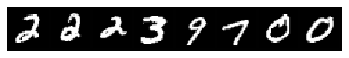

step 2838, loss 1.3453415632247925
Target:	 tensor([1, 1, 7, 8, 3, 2, 0, 0])
Pred:	 tensor([1, 1, 7, 8, 3, 2, 0, 0])


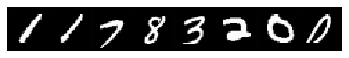

step 2871, loss 8.061172485351562
Target:	 tensor([3, 8, 9, 9, 3, 1, 3, 6])
Pred:	 tensor([3, 8, 4, 9, 3, 1, 3, 4])


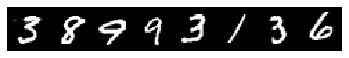

step 2904, loss 1.3448740243911743
Target:	 tensor([4, 8, 2, 7, 7, 9, 2, 2])
Pred:	 tensor([4, 8, 2, 7, 7, 9, 2, 2])


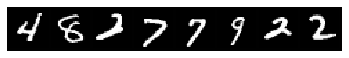

step 2937, loss 4.03026008605957
Target:	 tensor([9, 9, 2, 6, 4, 5, 4, 9])
Pred:	 tensor([9, 9, 2, 4, 4, 5, 4, 9])


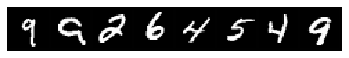

step 2970, loss 2.6868896484375
Target:	 tensor([2, 0, 2, 1, 5, 8, 5, 3])
Pred:	 tensor([2, 0, 2, 1, 5, 8, 5, 3])


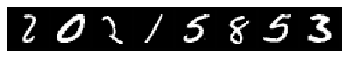

step 3003, loss 2.6882107257843018
Target:	 tensor([5, 5, 0, 7, 2, 7, 8, 0])
Pred:	 tensor([5, 5, 0, 7, 2, 7, 8, 0])


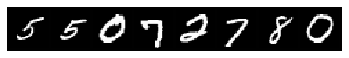

step 3036, loss 2.687811851501465
Target:	 tensor([8, 5, 7, 1, 1, 6, 5, 4])
Pred:	 tensor([8, 5, 7, 1, 1, 4, 5, 4])


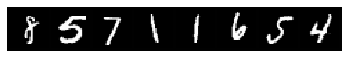

step 3069, loss 2.688512086868286
Target:	 tensor([8, 9, 1, 2, 0, 7, 4, 7])
Pred:	 tensor([8, 9, 1, 2, 0, 7, 4, 7])


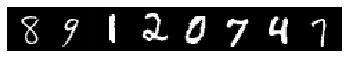

step 3102, loss 8.060288429260254
Target:	 tensor([2, 3, 1, 2, 9, 6, 8, 6])
Pred:	 tensor([2, 3, 1, 2, 9, 4, 8, 4])


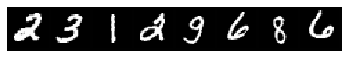

step 3135, loss 2.687730073928833
Target:	 tensor([8, 7, 1, 0, 7, 9, 1, 5])
Pred:	 tensor([8, 7, 1, 0, 7, 9, 1, 5])


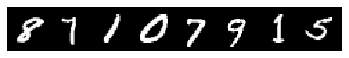

step 3168, loss 6.716831207275391
Target:	 tensor([6, 2, 5, 3, 2, 9, 4, 3])
Pred:	 tensor([4, 2, 5, 3, 9, 9, 4, 3])


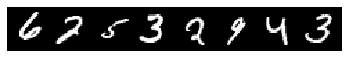

step 3201, loss 1.344580054283142
Target:	 tensor([2, 3, 9, 5, 7, 4, 7, 0])
Pred:	 tensor([2, 3, 9, 5, 7, 4, 7, 0])


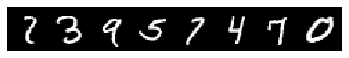

step 3234, loss 2.6869049072265625
Target:	 tensor([1, 1, 8, 5, 1, 0, 7, 8])
Pred:	 tensor([1, 1, 8, 5, 1, 0, 7, 8])


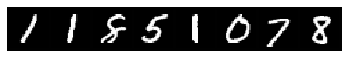

step 3267, loss 4.029649257659912
Target:	 tensor([6, 8, 1, 1, 5, 7, 7, 7])
Pred:	 tensor([4, 8, 1, 1, 5, 7, 7, 7])


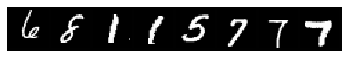

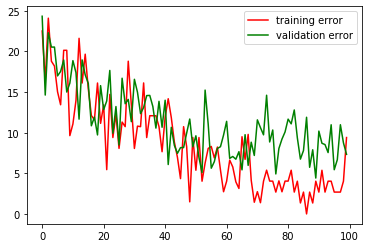

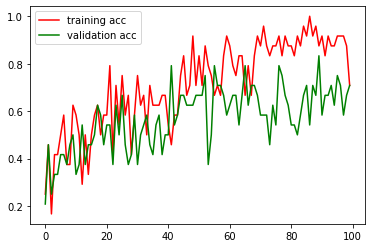

In [13]:
# learning rate, hyper-parameter
lr = 1e-4

# using GPU if it's availble
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

net = LeNet(img_channel, device)
# keep a list of moel parameters
params = [p for (n, p) in net.named_parameters()]

# training epochs, hyper-parameter
epochs = 100

# keep tracking of the changing of loss and accuracy of predictions
train_loss_list = []
val_loss_list = []
train_acc_list = []
val_acc_list = []

# the printing frequency, feel free to change this
print_interval = 50
for e in range(epochs):
  net.train()
  for i, (imgs, lbs) in enumerate(train_dl):
    imgs = imgs.to(device)
    lbs = lbs.to(device)
    loss, prob = net(imgs, lbs)
    
    net.zero_grad()
    grad = torch.autograd.grad(loss, params)
    
    # update weights
    step(params, grad, lr)
    
    # obtain the predictions
    pred = prob.argmax(dim=-1).view(batch_size)
    acc = (pred == lbs).float().mean()
    
    if i % print_interval == 0:
      print("step {}, loss {}".format(i + e*len(train_dl), loss))
      print("Target:\t {}\nPred:\t {}".format(lbs[:8], pred[:8]))
      # visualize some samples
      imgs_to_vis = vutils.make_grid(imgs[:8].cpu()+125., nrow=8, pad_value=1)
      plt.imshow(imgs_to_vis.permute(1,2,0).numpy().astype(np.uint8))
      plt.axis("off")
      plt.show()
      
  train_loss_list.append(loss.detach().mean())
  train_acc_list.append(acc.detach().mean())
  
  net.eval()
  for i, (imgs, lbs) in enumerate(val_dl):
    imgs = imgs.to(device)
    lbs = lbs.to(device)
    loss, prob = net(imgs, lbs)
    
    pred = prob.argmax(dim=-1).view(batch_size)
    acc = (pred == lbs).float().mean()
    
  val_loss_list.append(loss.detach().mean())
  val_acc_list.append(acc.detach().mean())
  

# ploting logs
plt.plot(np.arange(epochs), train_loss_list, '-r',
         np.arange(epochs), val_loss_list, '-g')
plt.legend(('training error', 'validation error'))
plt.show()
plt.plot(np.arange(epochs), train_acc_list, '-r',
         np.arange(epochs), val_acc_list, '-g')
plt.legend(('training acc', 'validation acc'))
plt.show()

## Guide: Model Saving and Loading

Once the training is completed, we can save the model on disk for evaluation or future use. It is also helpful to save the model regularly in case of unexcepted situations. Below is the snippet of how to save and load a model. More information can be found [here](https://pytorch.org/tutorials/beginner/saving_loading_models.html). You will be asked to evaluate your LeNet in the end.
```python
# Saving a model on disk:
torch.save(net.state_dict(), PATH_to_save)

# Loading a model from disk:
net = LeNet(img_c)
net.load_state_dict(torch.load(PATH_to_save))
```

## Task 5: Weight Decay

As we can see, LeNet now is overfitted on this 1k dataset. Instead of providing more data, we can use Weight Decay to improve its generalization ability.

**To-dos**: 
    - (5 points)Write the dataset loading script, training script
    - (5 points)Add **weights penalty** into the loss function.
    - (10 points)Train LeNet from scratch.
    - (10 points)Plot out the training loss curve, validation loss curve, training accuracy curve, and validation accuracy curve as those plots in the above section.

step 0, loss 28.9435977935791
Target:	 tensor([9, 5, 2, 2, 1, 7, 1, 5])
Pred:	 tensor([3, 3, 3, 3, 0, 3, 3, 3])


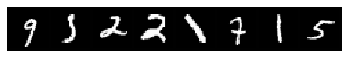

step 33, loss 24.663429260253906
Target:	 tensor([5, 3, 5, 7, 3, 8, 1, 3])
Pred:	 tensor([3, 3, 3, 9, 3, 3, 3, 3])


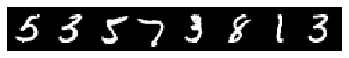

step 66, loss 26.476041793823242
Target:	 tensor([4, 8, 6, 1, 7, 4, 7, 2])
Pred:	 tensor([9, 3, 3, 3, 2, 9, 9, 9])


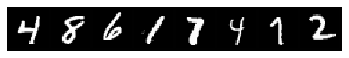

step 99, loss 26.341636657714844
Target:	 tensor([0, 4, 5, 9, 3, 2, 8, 2])
Pred:	 tensor([9, 9, 9, 9, 9, 9, 9, 9])


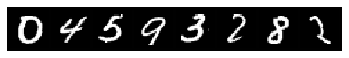

step 132, loss 22.487619400024414
Target:	 tensor([2, 2, 8, 8, 6, 9, 5, 6])
Pred:	 tensor([2, 2, 2, 9, 9, 9, 0, 0])


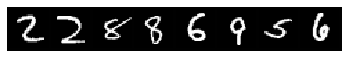

step 165, loss 23.39153289794922
Target:	 tensor([9, 7, 4, 1, 2, 1, 5, 7])
Pred:	 tensor([2, 0, 3, 2, 3, 2, 2, 9])


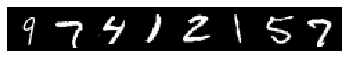

step 198, loss 24.05388641357422
Target:	 tensor([5, 1, 3, 6, 8, 5, 6, 7])
Pred:	 tensor([3, 9, 0, 9, 0, 3, 9, 9])


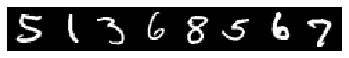

step 231, loss 20.321937561035156
Target:	 tensor([5, 3, 8, 9, 7, 0, 8, 6])
Pred:	 tensor([3, 3, 2, 0, 9, 0, 0, 0])


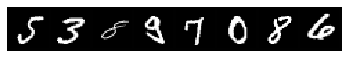

step 264, loss 21.519540786743164
Target:	 tensor([4, 4, 7, 5, 0, 3, 4, 5])
Pred:	 tensor([9, 0, 9, 0, 0, 3, 9, 3])


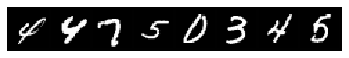

step 297, loss 14.781878471374512
Target:	 tensor([1, 2, 1, 1, 2, 7, 2, 9])
Pred:	 tensor([2, 2, 2, 2, 2, 9, 2, 9])


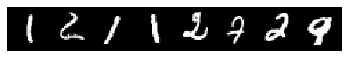

step 330, loss 16.060068130493164
Target:	 tensor([0, 1, 8, 6, 3, 5, 4, 0])
Pred:	 tensor([0, 2, 3, 0, 3, 0, 0, 0])


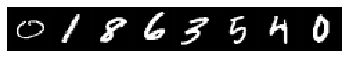

step 363, loss 16.93922233581543
Target:	 tensor([9, 7, 3, 0, 4, 6, 8, 7])
Pred:	 tensor([9, 9, 3, 0, 1, 9, 1, 1])


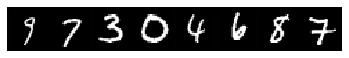

step 396, loss 16.43682289123535
Target:	 tensor([1, 5, 5, 0, 8, 9, 1, 2])
Pred:	 tensor([1, 2, 3, 0, 2, 9, 1, 2])


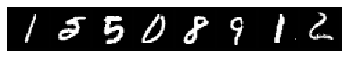

step 429, loss 9.766533851623535
Target:	 tensor([1, 0, 1, 6, 7, 1, 4, 6])
Pred:	 tensor([3, 0, 2, 2, 7, 2, 7, 9])


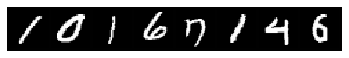

step 462, loss 8.652716636657715
Target:	 tensor([7, 1, 4, 8, 5, 6, 1, 7])
Pred:	 tensor([2, 1, 9, 7, 3, 7, 1, 7])


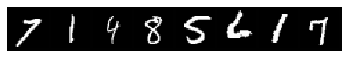

step 495, loss 4.147973537445068
Target:	 tensor([1, 3, 0, 1, 5, 6, 6, 5])
Pred:	 tensor([1, 3, 8, 1, 8, 5, 6, 3])


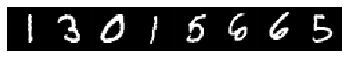

step 528, loss 3.740478754043579
Target:	 tensor([2, 4, 5, 4, 5, 4, 2, 5])
Pred:	 tensor([6, 7, 8, 8, 0, 9, 3, 0])


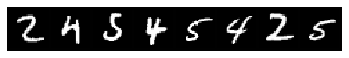

step 561, loss 2.240722894668579
Target:	 tensor([4, 6, 9, 1, 3, 9, 7, 0])
Pred:	 tensor([4, 9, 9, 1, 9, 1, 5, 0])


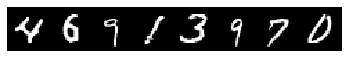

step 594, loss 1.0607362985610962
Target:	 tensor([8, 3, 6, 1, 5, 9, 2, 4])
Pred:	 tensor([8, 3, 6, 1, 4, 9, 8, 4])


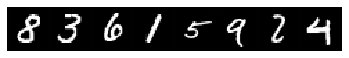

step 627, loss 2.0737133026123047
Target:	 tensor([8, 7, 7, 7, 6, 7, 6, 4])
Pred:	 tensor([9, 7, 9, 7, 6, 1, 6, 9])


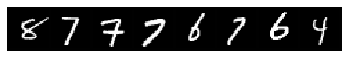

step 660, loss 1.1854768991470337
Target:	 tensor([7, 4, 4, 7, 9, 8, 8, 5])
Pred:	 tensor([2, 4, 4, 7, 9, 8, 6, 5])


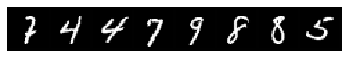

step 693, loss 0.7120614647865295
Target:	 tensor([4, 3, 7, 9, 4, 5, 3, 9])
Pred:	 tensor([4, 3, 7, 9, 4, 8, 3, 9])


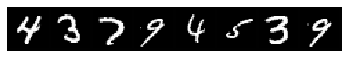

step 726, loss 1.1127872467041016
Target:	 tensor([1, 3, 3, 6, 2, 9, 0, 5])
Pred:	 tensor([8, 3, 3, 6, 6, 9, 0, 0])


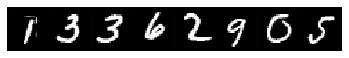

step 759, loss 1.2950689792633057
Target:	 tensor([7, 7, 7, 0, 3, 9, 7, 6])
Pred:	 tensor([7, 7, 1, 9, 3, 9, 7, 4])


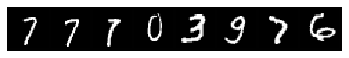

step 792, loss 1.3478766679763794
Target:	 tensor([9, 7, 7, 1, 2, 6, 8, 4])
Pred:	 tensor([9, 7, 7, 1, 2, 6, 3, 9])


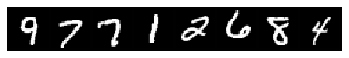

step 825, loss 0.8051313757896423
Target:	 tensor([6, 0, 4, 4, 8, 4, 2, 0])
Pred:	 tensor([6, 2, 4, 0, 9, 4, 2, 0])


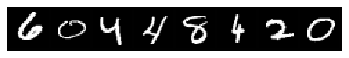

step 858, loss 0.7741357684135437
Target:	 tensor([5, 9, 7, 8, 5, 7, 6, 2])
Pred:	 tensor([5, 9, 4, 2, 8, 7, 2, 2])


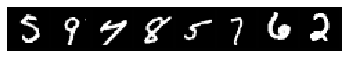

step 891, loss 0.8895671963691711
Target:	 tensor([0, 6, 7, 4, 2, 3, 2, 9])
Pred:	 tensor([0, 4, 7, 3, 7, 3, 2, 4])


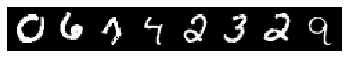

step 924, loss 0.8985540866851807
Target:	 tensor([0, 6, 9, 4, 3, 1, 0, 3])
Pred:	 tensor([0, 0, 9, 9, 3, 1, 0, 3])


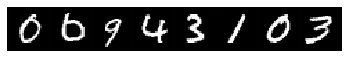

step 957, loss 1.1616421937942505
Target:	 tensor([0, 6, 8, 9, 4, 8, 8, 7])
Pred:	 tensor([0, 6, 8, 9, 4, 8, 8, 9])


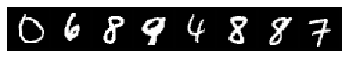

step 990, loss 0.6132267117500305
Target:	 tensor([0, 8, 9, 8, 9, 8, 8, 7])
Pred:	 tensor([0, 8, 9, 8, 8, 8, 8, 7])


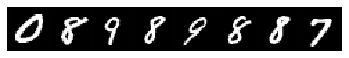

step 1023, loss 0.6830691695213318
Target:	 tensor([7, 6, 0, 7, 6, 3, 7, 4])
Pred:	 tensor([7, 6, 0, 7, 3, 1, 7, 4])


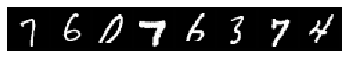

step 1056, loss 0.6891996264457703
Target:	 tensor([4, 9, 5, 8, 0, 4, 2, 0])
Pred:	 tensor([4, 9, 8, 8, 0, 4, 6, 0])


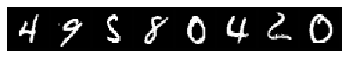

step 1089, loss 0.5818668007850647
Target:	 tensor([6, 7, 2, 3, 3, 1, 6, 9])
Pred:	 tensor([6, 2, 2, 3, 7, 1, 6, 7])


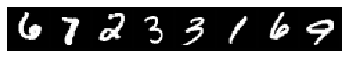

step 1122, loss 0.7668616771697998
Target:	 tensor([0, 8, 6, 5, 7, 8, 3, 9])
Pred:	 tensor([0, 5, 6, 0, 7, 8, 3, 9])


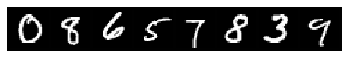

step 1155, loss 0.5559989809989929
Target:	 tensor([3, 9, 7, 5, 7, 2, 6, 8])
Pred:	 tensor([3, 9, 1, 5, 7, 2, 6, 8])


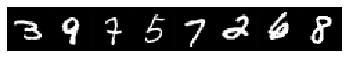

step 1188, loss 0.6979923844337463
Target:	 tensor([8, 5, 9, 0, 3, 5, 8, 0])
Pred:	 tensor([8, 5, 9, 0, 3, 5, 8, 0])


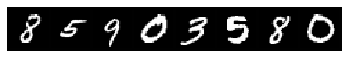

step 1221, loss 0.7270558476448059
Target:	 tensor([7, 8, 0, 8, 9, 3, 6, 4])
Pred:	 tensor([7, 8, 0, 8, 9, 5, 6, 9])


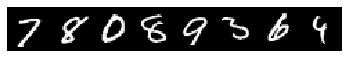

step 1254, loss 0.46220049262046814
Target:	 tensor([1, 3, 0, 7, 8, 1, 7, 0])
Pred:	 tensor([1, 3, 0, 7, 8, 1, 7, 0])


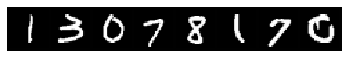

step 1287, loss 0.8594282269477844
Target:	 tensor([3, 2, 3, 9, 7, 3, 5, 7])
Pred:	 tensor([3, 1, 3, 9, 7, 3, 5, 7])


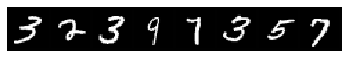

step 1320, loss 0.503251314163208
Target:	 tensor([7, 5, 0, 1, 7, 1, 0, 3])
Pred:	 tensor([7, 5, 0, 1, 7, 1, 0, 3])


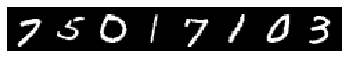

step 1353, loss 0.5990211963653564
Target:	 tensor([7, 2, 1, 2, 1, 0, 2, 7])
Pred:	 tensor([7, 2, 1, 2, 1, 0, 2, 7])


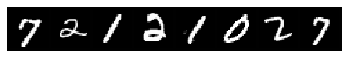

step 1386, loss 0.7755547165870667
Target:	 tensor([9, 1, 6, 3, 3, 9, 6, 6])
Pred:	 tensor([9, 1, 6, 3, 3, 9, 6, 6])


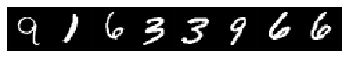

step 1419, loss 0.7158637046813965
Target:	 tensor([6, 7, 9, 0, 3, 2, 1, 5])
Pred:	 tensor([6, 7, 9, 0, 3, 2, 1, 5])


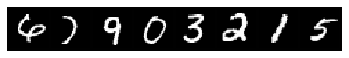

step 1452, loss 0.6981182098388672
Target:	 tensor([1, 9, 8, 8, 8, 2, 0, 6])
Pred:	 tensor([1, 9, 8, 8, 8, 2, 0, 6])


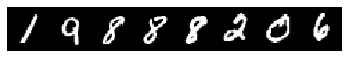

step 1485, loss 0.7890157699584961
Target:	 tensor([5, 9, 2, 4, 1, 3, 6, 4])
Pred:	 tensor([5, 9, 2, 4, 1, 3, 6, 4])


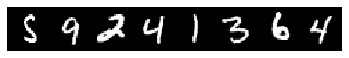

step 1518, loss 0.6063661575317383
Target:	 tensor([5, 8, 7, 2, 1, 2, 1, 6])
Pred:	 tensor([5, 8, 7, 2, 1, 2, 1, 6])


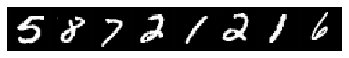

step 1551, loss 0.7970902919769287
Target:	 tensor([7, 2, 4, 0, 2, 7, 4, 1])
Pred:	 tensor([7, 2, 4, 0, 6, 7, 4, 1])


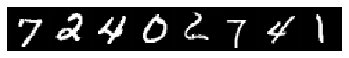

step 1584, loss 0.7213077545166016
Target:	 tensor([7, 6, 7, 3, 1, 1, 9, 4])
Pred:	 tensor([7, 6, 7, 3, 1, 1, 9, 4])


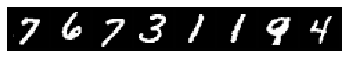

step 1617, loss 0.8384708762168884
Target:	 tensor([6, 7, 3, 3, 6, 9, 1, 7])
Pred:	 tensor([1, 7, 3, 3, 6, 9, 1, 7])


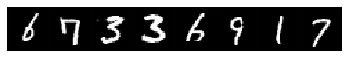

step 1650, loss 1.026007056236267
Target:	 tensor([0, 7, 5, 4, 7, 6, 0, 4])
Pred:	 tensor([0, 1, 7, 9, 9, 0, 6, 4])


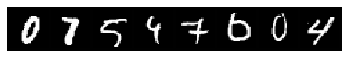

step 1683, loss 0.6841426491737366
Target:	 tensor([7, 9, 3, 1, 1, 4, 9, 7])
Pred:	 tensor([7, 9, 3, 1, 1, 4, 9, 7])


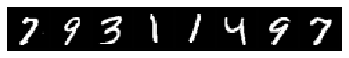

step 1716, loss 1.0828540325164795
Target:	 tensor([6, 5, 7, 2, 9, 5, 6, 1])
Pred:	 tensor([6, 5, 7, 1, 9, 5, 6, 9])


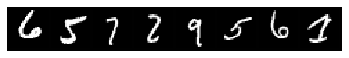

step 1749, loss 0.7070876955986023
Target:	 tensor([9, 7, 2, 2, 0, 0, 0, 3])
Pred:	 tensor([0, 7, 2, 4, 0, 0, 0, 3])


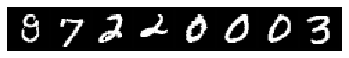

step 1782, loss 0.9595292210578918
Target:	 tensor([8, 3, 7, 7, 6, 4, 3, 9])
Pred:	 tensor([8, 3, 1, 7, 6, 4, 3, 9])


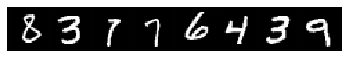

step 1815, loss 0.7786275744438171
Target:	 tensor([0, 0, 0, 7, 0, 7, 5, 4])
Pred:	 tensor([0, 0, 0, 7, 0, 7, 5, 4])


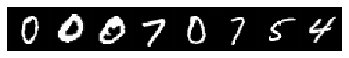

step 1848, loss 0.8853287100791931
Target:	 tensor([1, 2, 0, 6, 5, 1, 5, 1])
Pred:	 tensor([1, 2, 0, 6, 3, 1, 5, 1])


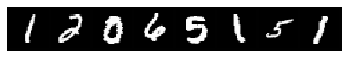

step 1881, loss 0.9152650833129883
Target:	 tensor([4, 2, 9, 5, 7, 0, 3, 1])
Pred:	 tensor([4, 2, 9, 5, 7, 0, 3, 1])


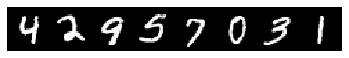

step 1914, loss 0.9587552547454834
Target:	 tensor([5, 9, 4, 7, 1, 0, 1, 2])
Pred:	 tensor([5, 7, 9, 7, 1, 0, 1, 7])


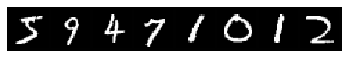

step 1947, loss 0.9575641751289368
Target:	 tensor([2, 1, 7, 6, 8, 1, 2, 2])
Pred:	 tensor([2, 1, 7, 6, 3, 1, 2, 7])


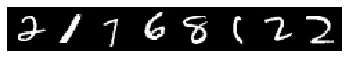

step 1980, loss 1.012285828590393
Target:	 tensor([4, 7, 6, 7, 4, 9, 3, 8])
Pred:	 tensor([4, 8, 6, 7, 4, 9, 3, 9])


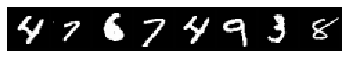

step 2013, loss 0.9369335770606995
Target:	 tensor([3, 4, 1, 6, 4, 1, 3, 5])
Pred:	 tensor([3, 4, 1, 6, 4, 1, 3, 5])


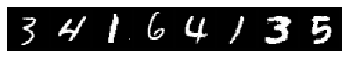

step 2046, loss 1.134945273399353
Target:	 tensor([7, 4, 8, 3, 3, 5, 8, 5])
Pred:	 tensor([7, 4, 8, 3, 3, 5, 1, 5])


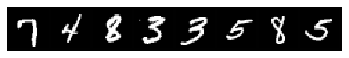

step 2079, loss 1.0739717483520508
Target:	 tensor([6, 5, 9, 0, 1, 9, 3, 5])
Pred:	 tensor([4, 5, 8, 0, 1, 9, 3, 5])


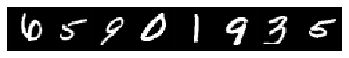

step 2112, loss 1.0814858675003052
Target:	 tensor([8, 7, 9, 6, 4, 1, 8, 1])
Pred:	 tensor([8, 0, 9, 4, 4, 1, 8, 1])


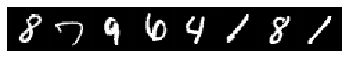

step 2145, loss 1.1424787044525146
Target:	 tensor([6, 2, 1, 1, 9, 7, 0, 4])
Pred:	 tensor([6, 0, 1, 9, 9, 7, 0, 4])


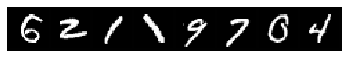

step 2178, loss 1.0496690273284912
Target:	 tensor([6, 4, 9, 0, 9, 4, 2, 3])
Pred:	 tensor([6, 4, 9, 0, 9, 4, 2, 3])


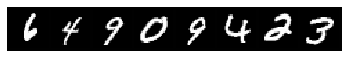

step 2211, loss 1.181714653968811
Target:	 tensor([9, 7, 0, 9, 4, 3, 1, 1])
Pred:	 tensor([9, 9, 0, 4, 4, 9, 1, 1])


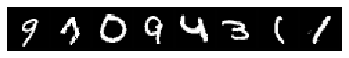

step 2244, loss 1.0734797716140747
Target:	 tensor([2, 4, 2, 8, 1, 3, 2, 0])
Pred:	 tensor([2, 4, 6, 5, 1, 3, 2, 0])


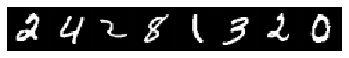

step 2277, loss 0.9697592258453369
Target:	 tensor([7, 5, 6, 0, 9, 4, 3, 0])
Pred:	 tensor([7, 5, 6, 0, 9, 4, 3, 0])


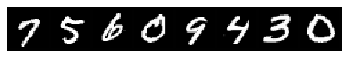

step 2310, loss 1.0869972705841064
Target:	 tensor([1, 6, 3, 2, 5, 0, 8, 6])
Pred:	 tensor([1, 6, 3, 1, 5, 0, 2, 6])


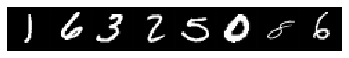

step 2343, loss 1.0673381090164185
Target:	 tensor([4, 8, 3, 3, 1, 7, 0, 8])
Pred:	 tensor([4, 8, 3, 3, 1, 9, 0, 8])


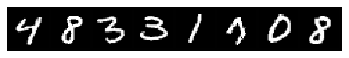

step 2376, loss 1.1533440351486206
Target:	 tensor([3, 4, 0, 1, 3, 6, 8, 9])
Pred:	 tensor([9, 4, 0, 1, 3, 6, 6, 8])


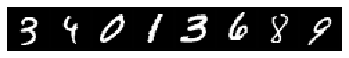

step 2409, loss 1.3391793966293335
Target:	 tensor([5, 5, 8, 3, 4, 1, 6, 1])
Pred:	 tensor([5, 5, 8, 3, 4, 7, 0, 1])


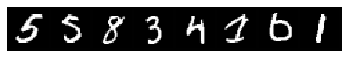

step 2442, loss 1.2413049936294556
Target:	 tensor([3, 6, 6, 6, 7, 9, 0, 2])
Pred:	 tensor([3, 6, 6, 6, 7, 9, 0, 2])


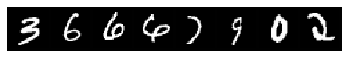

step 2475, loss 1.181916356086731
Target:	 tensor([7, 2, 1, 7, 5, 0, 8, 3])
Pred:	 tensor([7, 6, 1, 7, 5, 0, 5, 3])


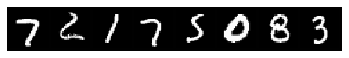

step 2508, loss 1.1954667568206787
Target:	 tensor([2, 5, 6, 2, 5, 7, 6, 3])
Pred:	 tensor([2, 5, 6, 2, 5, 7, 6, 3])


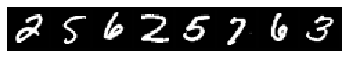

step 2541, loss 1.2352683544158936
Target:	 tensor([4, 7, 1, 9, 4, 7, 4, 3])
Pred:	 tensor([4, 7, 1, 9, 4, 7, 4, 3])


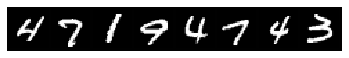

step 2574, loss 1.2939804792404175
Target:	 tensor([8, 4, 7, 4, 6, 0, 5, 7])
Pred:	 tensor([1, 4, 7, 4, 6, 0, 5, 7])


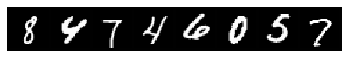

step 2607, loss 1.3107017278671265
Target:	 tensor([9, 0, 1, 4, 3, 8, 4, 5])
Pred:	 tensor([9, 0, 1, 4, 3, 3, 4, 5])


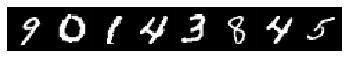

step 2640, loss 1.2674695253372192
Target:	 tensor([9, 8, 6, 7, 3, 9, 1, 5])
Pred:	 tensor([2, 8, 6, 7, 3, 9, 1, 5])


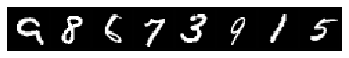

step 2673, loss 1.4089571237564087
Target:	 tensor([4, 7, 2, 3, 4, 6, 9, 7])
Pred:	 tensor([4, 7, 1, 3, 1, 6, 9, 7])


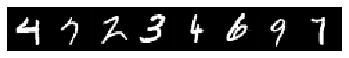

step 2706, loss 1.3558216094970703
Target:	 tensor([3, 9, 4, 1, 0, 4, 0, 9])
Pred:	 tensor([3, 9, 4, 1, 0, 6, 0, 9])


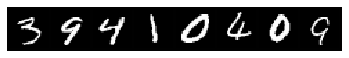

step 2739, loss 1.4690364599227905
Target:	 tensor([7, 4, 0, 1, 9, 1, 1, 7])
Pred:	 tensor([1, 4, 0, 1, 9, 1, 1, 7])


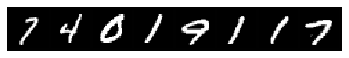

step 2772, loss 1.5833940505981445
Target:	 tensor([3, 5, 9, 3, 7, 3, 5, 5])
Pred:	 tensor([3, 5, 9, 3, 7, 3, 5, 8])


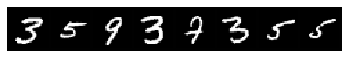

step 2805, loss 1.543493390083313
Target:	 tensor([0, 8, 4, 9, 8, 2, 3, 0])
Pred:	 tensor([0, 8, 4, 9, 1, 2, 3, 0])


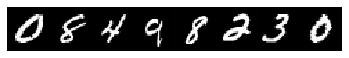

step 2838, loss 1.5640987157821655
Target:	 tensor([2, 6, 5, 1, 0, 4, 4, 9])
Pred:	 tensor([2, 6, 2, 1, 0, 4, 1, 9])


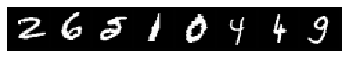

step 2871, loss 1.3642288446426392
Target:	 tensor([3, 2, 1, 1, 9, 7, 4, 7])
Pred:	 tensor([3, 2, 1, 1, 4, 7, 4, 7])


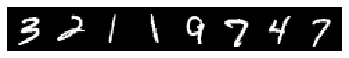

step 2904, loss 1.5924328565597534
Target:	 tensor([1, 5, 3, 4, 9, 2, 8, 4])
Pred:	 tensor([1, 0, 3, 4, 9, 7, 3, 4])


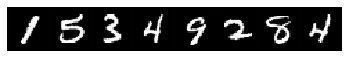

step 2937, loss 1.4456833600997925
Target:	 tensor([7, 0, 9, 1, 1, 8, 9, 2])
Pred:	 tensor([7, 0, 9, 1, 1, 8, 9, 2])


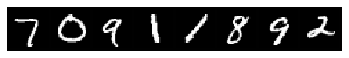

step 2970, loss 1.4228177070617676
Target:	 tensor([4, 1, 7, 7, 7, 2, 2, 7])
Pred:	 tensor([4, 1, 7, 7, 7, 6, 2, 7])


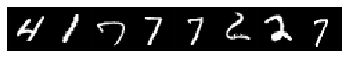

step 3003, loss 1.6268644332885742
Target:	 tensor([7, 5, 7, 2, 9, 5, 3, 3])
Pred:	 tensor([7, 5, 7, 2, 4, 5, 3, 3])


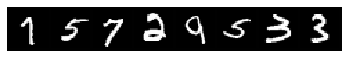

step 3036, loss 1.5634078979492188
Target:	 tensor([2, 3, 3, 0, 2, 7, 0, 0])
Pred:	 tensor([1, 7, 3, 0, 7, 7, 0, 0])


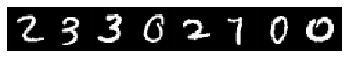

step 3069, loss 1.6653761863708496
Target:	 tensor([2, 9, 5, 8, 8, 6, 5, 2])
Pred:	 tensor([2, 4, 5, 8, 8, 6, 7, 2])


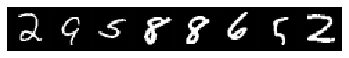

step 3102, loss 1.741401195526123
Target:	 tensor([7, 0, 7, 7, 5, 3, 5, 6])
Pred:	 tensor([1, 0, 7, 1, 5, 3, 5, 6])


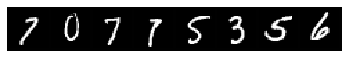

step 3135, loss 1.566247820854187
Target:	 tensor([3, 7, 9, 7, 8, 5, 0, 7])
Pred:	 tensor([0, 7, 9, 7, 1, 5, 0, 7])


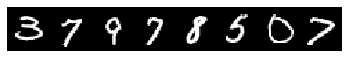

step 3168, loss 1.629808783531189
Target:	 tensor([0, 1, 8, 8, 7, 7, 2, 5])
Pred:	 tensor([0, 1, 8, 8, 7, 7, 7, 5])


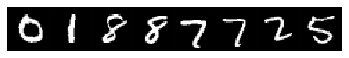

step 3201, loss 1.6205443143844604
Target:	 tensor([7, 1, 9, 7, 0, 7, 3, 4])
Pred:	 tensor([7, 1, 9, 7, 0, 7, 3, 1])


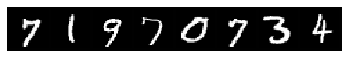

step 3234, loss 1.677028775215149
Target:	 tensor([3, 3, 7, 1, 0, 5, 2, 9])
Pred:	 tensor([4, 3, 7, 1, 0, 5, 2, 4])


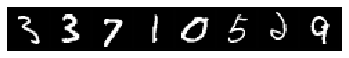

step 3267, loss 1.7670283317565918
Target:	 tensor([7, 3, 2, 5, 9, 7, 5, 6])
Pred:	 tensor([7, 3, 2, 3, 4, 7, 5, 1])


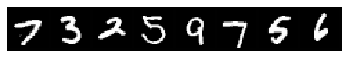

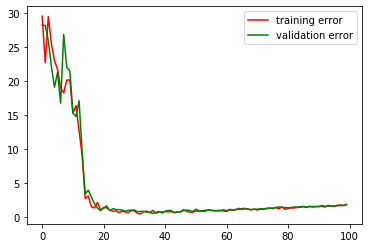

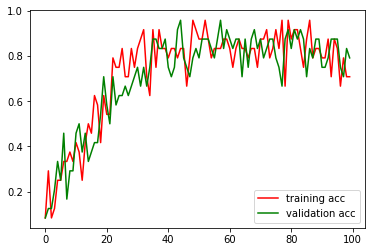

In [53]:
# 1. Loading Script (script inspired from above)
# dataset_size = 1000
validation_size = int(0.2 * 1000)

ds = MNISTDataset(ds_size=dataset_size)

train_ds, val_ds = torch.utils.data.random_split(ds, [dataset_size - validation_size, validation_size])

batch_size = 24

train_dl = DataLoader(train_ds, batch_size=batch_size, shuffle=True, drop_last=True)
val_dl = DataLoader(val_ds, batch_size=batch_size, shuffle=True, drop_last=True)
img_channel = 1


# 2. Adding weights penalty into the loss function (inspired from above)
def step(weights, grad, lr, decay_rate):
  for i in range(len(weights)):
    if decay_rate is not 0:
      weights[i].data.sub_(weights[i].data*decay_rate)
    weights[i].data.sub_(grad[i]*lr)


# 3. Training LeNet from scratch (script inspired from above)
lr = 1e-4
# Note to TA: using 0.95 according to this website which states decay default as 0.95.
# https://tf-lenet.readthedocs.io/en/latest/api/network.html
# decay_rate = 0.95 
# A decay rate of 0.95 was throwing off my accuracy so I was not sure what to set it as, so I set it at an arbitrary number closer to 0.
# decay_rate = 1e-3 --> This was so off
# decay_rate = 1e-4 --> This was too accurate
# decay_rate = 0.0009
decay_rate = 0.0001 


device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

net = LeNet(img_channel, device)

params = [p for (n, p) in net.named_parameters()]

epochs = 100

train_loss_list = []
val_loss_list = []
train_acc_list = []
val_acc_list = []

print_interval = 50
for e in range(epochs):
  net.train()
  for i, (imgs, lbs) in enumerate(train_dl):
    imgs = imgs.to(device)
    lbs = lbs.to(device)
    loss, prob = net(imgs, lbs)
    
    net.zero_grad()
    grad = torch.autograd.grad(loss, params)
    
    step(params, grad, lr, decay_rate)
    
    pred = prob.argmax(dim=-1).view(batch_size)
    acc = (pred == lbs).float().mean()
    
    if i % print_interval == 0:
      print("step {}, loss {}".format(i + e*len(train_dl), loss))
      print("Target:\t {}\nPred:\t {}".format(lbs[:8], pred[:8]))
      imgs_to_vis = vutils.make_grid(imgs[:8].cpu()+125., nrow=8, pad_value=1)
      plt.imshow(imgs_to_vis.permute(1,2,0).numpy().astype(np.uint8))
      plt.axis("off")
      plt.show()
      
  train_loss_list.append(loss.detach().mean())
  train_acc_list.append(acc.detach().mean())
  
  net.eval()
  for i, (imgs, lbs) in enumerate(val_dl):
    imgs = imgs.to(device)
    lbs = lbs.to(device)
    loss, prob = net(imgs, lbs)
    
    pred = prob.argmax(dim=-1).view(batch_size)
    acc = (pred == lbs).float().mean()
    
  val_loss_list.append(loss.detach().mean())
  val_acc_list.append(acc.detach().mean())
  

# 4. Plot out the training loss curve, validation loss curve, training accuracy curve, and validation accuracy curve.
plt.plot(np.arange(epochs), train_loss_list, '-r',
         np.arange(epochs), val_loss_list, '-g')
plt.legend(('training error', 'validation error'))
plt.show()
plt.plot(np.arange(epochs), train_acc_list, '-r',
         np.arange(epochs), val_acc_list, '-g')
plt.legend(('training acc', 'validation acc'))
plt.show()


## Task 6: Dropout

[Dropout](https://www.cs.toronto.edu/~hinton/absps/JMLRdropout.pdf) can also help with generalization. It randomly drops units from the neural network during training. Thus, training a neural network with dropout can be seen as training a collection of many sub-networks.

**To-dos**:
    - (5 points)Complete the **dropout_forward()** function for class Dropout.
    - (5 points)Modify the class LeNet with dropout layer and build a new class named LeNetDrop: add a dropout layer after layer c1, layer c3, and layer c5.
    - Write the dataset loading script, training script.
    - Train LeNetDrop on the 1k dataset.
    - (10 points)Plot out the training loss curve, validation loss curve, training accuracy curve and validation accuracy curve.

In [0]:
class Dropout(nn.Module):
  def __init__(self, p, device):
    super(Dropout, self).__init__()
    """
    inputs:
     p: scalar, the probability of an element to be zeroed.
    """
    self.p = p
    self.device = device
    
    
  def dropout_forward(self, X, training=True):
    """
    inputs:
      X: (N, *), input of dropout layer
      training: boolean, apply dropout if true. Note: We do not apply dropout during testing.
    outputs:
      Y: (N, *)
    """
    ### Start the code here  ###
    if training is True:
      dropout = torch.rand(X.size()[0], X.size()[1],1,1)
      dropout = (dropout+0.5-self.p).round().abs()
      Y = torch.mul(X, dropout)
    else:
      Y = X # will this work?    
    
    ###  End of the code ###
    return Y
  
  def forward(self, X):
    return self.dropout_forward(X)

In [0]:
# LeNetDrop sketch code (inspired by Task 4)
# Modify the class LeNet with dropout layer and build a new class named LeNetDrop
# Add a dropout layer after layer c1, layer c3, and layer c5 --> what is c5? skip for now.

class LeNetDrop(nn.Module):
  def __init__(self, img_c, device):
    # super(LeNet, self).__init__()
    super(LeNetDrop, self).__init__()

    self.c1 = Conv2D(img_c, 6, [5,5], [1,1], [2,2,2,2], device)
    self.dA = Dropout(0.5, device)
    self.p2 = nn.MaxPool2d(2, stride=2)
    self.c3 = Conv2D(6, 16, [5,5], [1,1], [0,0,0,0], device)
    self.dB = Dropout(0.5, device)
    self.p4 = nn.MaxPool2d(2, stride=2)
    self.f5 = Linear(400, 120, device)
    self.f6 = Linear(120, 84, device)
    self.f7 = Linear(84, 10, device)
    self.device = device
    
    
  def forward(self, imgs, labels):
    """
    inputs:
      imgs: (N, C, H, W), training samples from the MNIST training set, where N is the number of samples (batch_size),
          C is the image color channle number, H and W are the spatial size of the input images.
      labels: (N, L), ground truth for the input images, where N is the number of samples (batch_size) and L is the 
          number of classes.
    outputs:
      loss: (1,), mean loss value over this batch of inputs.
    
    """
    N = imgs.shape[0]
    
    ### Start the code here  ###
    # 1. Please complete the rest of LeNet to get the scores predicted by LeNet for each input images #

    o_c1 = F.relu(self.c1(imgs))
    o_dA = self.dA(o_c1)
    o_p2 = self.p2(o_dA)
    o_c3 = F.relu(self.c3(o_p2))
    o_dB = self.dB(o_c3)
    o_p4 = self.p4(o_dB)
    o_p5 = self.f5(o_p4)
    o_p6 = self.f6(o_p5)
    o_p7 = self.f7(o_p6)
        
    # 2. Please use the implemented objective function to obtain the losses of each input. #
    
    # p, loss = o_p7, cross_entropy_loss(softmax1d(p), labels)
    p = o_p7
    loss = cross_entropy_loss(softmax1d(p), labels)

    # 3. We will return the mean value of the losses. #

    ###  End of the code ###
    return loss.mean(), p

step 0, loss 25.742155075073242
Target:	 tensor([6, 8, 7, 7, 4, 8, 6, 2])
Pred:	 tensor([7, 6, 6, 6, 4, 6, 6, 6])


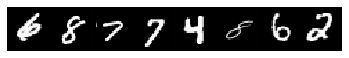

step 33, loss 22.818572998046875
Target:	 tensor([6, 8, 3, 2, 8, 4, 3, 4])
Pred:	 tensor([6, 7, 0, 6, 6, 7, 3, 0])


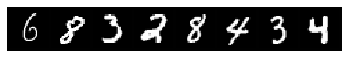

step 66, loss 28.267221450805664
Target:	 tensor([4, 3, 4, 3, 5, 1, 1, 9])
Pred:	 tensor([6, 6, 7, 7, 6, 7, 7, 3])


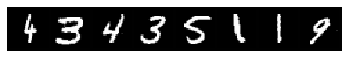

step 99, loss 25.420766830444336
Target:	 tensor([7, 9, 7, 3, 3, 0, 7, 8])
Pred:	 tensor([4, 2, 7, 7, 6, 0, 0, 7])


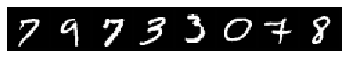

step 132, loss 24.734054565429688
Target:	 tensor([7, 4, 4, 6, 9, 5, 9, 9])
Pred:	 tensor([4, 6, 6, 6, 2, 6, 4, 6])


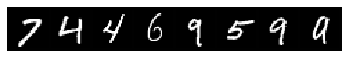

step 165, loss 19.801767349243164
Target:	 tensor([3, 1, 8, 5, 9, 1, 8, 8])
Pred:	 tensor([3, 6, 2, 5, 5, 3, 7, 4])


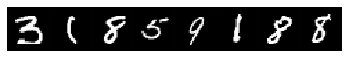

step 198, loss 21.33911895751953
Target:	 tensor([3, 9, 4, 2, 4, 5, 1, 1])
Pred:	 tensor([1, 6, 3, 0, 5, 9, 4, 7])


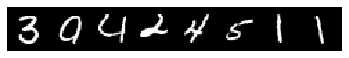

step 231, loss 15.451376914978027
Target:	 tensor([9, 4, 3, 1, 4, 3, 1, 6])
Pred:	 tensor([7, 6, 2, 7, 4, 8, 1, 8])


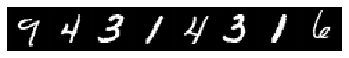

step 264, loss 14.8269681930542
Target:	 tensor([3, 6, 4, 5, 5, 1, 3, 6])
Pred:	 tensor([2, 6, 6, 3, 2, 1, 8, 6])


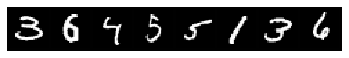

step 297, loss 9.1989164352417
Target:	 tensor([7, 5, 1, 5, 2, 1, 4, 3])
Pred:	 tensor([1, 8, 1, 6, 2, 7, 8, 0])


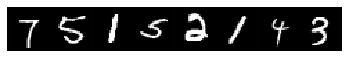

step 330, loss 8.997611999511719
Target:	 tensor([7, 9, 4, 7, 9, 0, 3, 6])
Pred:	 tensor([7, 9, 2, 9, 6, 5, 0, 0])


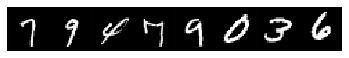

step 363, loss 5.288193225860596
Target:	 tensor([2, 7, 4, 5, 1, 2, 2, 7])
Pred:	 tensor([9, 7, 3, 5, 7, 3, 2, 7])


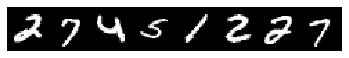

step 396, loss 5.297053337097168
Target:	 tensor([2, 1, 4, 6, 3, 7, 9, 8])
Pred:	 tensor([5, 2, 6, 9, 3, 7, 1, 8])


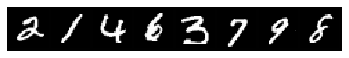

step 429, loss 4.126136302947998
Target:	 tensor([6, 2, 0, 9, 7, 1, 6, 6])
Pred:	 tensor([9, 8, 0, 9, 7, 0, 6, 8])


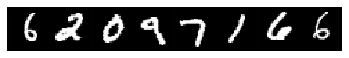

step 462, loss 2.3539083003997803
Target:	 tensor([3, 4, 2, 0, 1, 8, 4, 7])
Pred:	 tensor([3, 3, 2, 0, 0, 2, 4, 7])


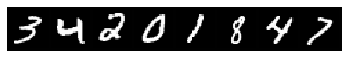

step 495, loss 4.8154120445251465
Target:	 tensor([7, 5, 3, 4, 3, 0, 1, 0])
Pred:	 tensor([7, 5, 8, 6, 4, 8, 5, 0])


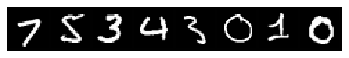

step 528, loss 2.4034392833709717
Target:	 tensor([1, 0, 8, 7, 5, 5, 2, 2])
Pred:	 tensor([1, 0, 8, 7, 5, 6, 2, 6])


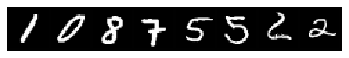

step 561, loss 5.16306209564209
Target:	 tensor([6, 8, 8, 9, 6, 2, 8, 9])
Pred:	 tensor([6, 3, 5, 6, 4, 4, 2, 7])


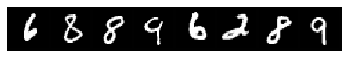

step 594, loss 3.322725296020508
Target:	 tensor([0, 5, 9, 8, 8, 7, 7, 2])
Pred:	 tensor([6, 8, 9, 2, 2, 9, 7, 7])


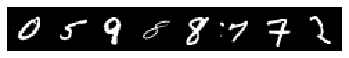

step 627, loss 2.4508399963378906
Target:	 tensor([4, 8, 5, 3, 5, 6, 9, 1])
Pred:	 tensor([4, 4, 6, 5, 2, 6, 6, 3])


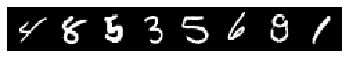

step 660, loss 3.290600538253784
Target:	 tensor([9, 2, 2, 8, 4, 1, 2, 0])
Pred:	 tensor([7, 3, 2, 4, 9, 1, 1, 0])


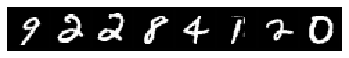

step 693, loss 2.0492029190063477
Target:	 tensor([4, 1, 7, 2, 0, 0, 3, 5])
Pred:	 tensor([1, 1, 9, 2, 0, 2, 3, 5])


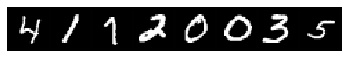

step 726, loss 2.5152032375335693
Target:	 tensor([4, 0, 3, 0, 8, 3, 0, 1])
Pred:	 tensor([4, 0, 3, 5, 1, 8, 0, 3])


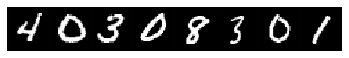

step 759, loss 2.1899359226226807
Target:	 tensor([1, 2, 2, 1, 9, 1, 9, 9])
Pred:	 tensor([7, 3, 4, 1, 4, 1, 7, 2])


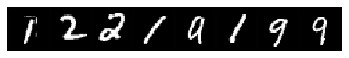

step 792, loss 1.3320685625076294
Target:	 tensor([7, 0, 4, 4, 7, 7, 2, 9])
Pred:	 tensor([7, 0, 4, 4, 7, 7, 2, 5])


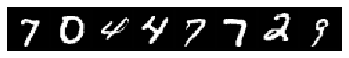

step 825, loss 1.1065341234207153
Target:	 tensor([2, 7, 7, 7, 1, 2, 0, 2])
Pred:	 tensor([2, 7, 7, 7, 1, 2, 0, 3])


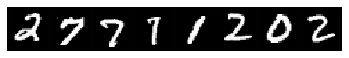

step 858, loss 1.6932686567306519
Target:	 tensor([8, 4, 2, 7, 0, 3, 4, 7])
Pred:	 tensor([2, 9, 2, 7, 0, 1, 1, 7])


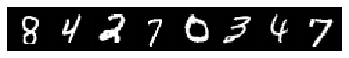

step 891, loss 1.9845304489135742
Target:	 tensor([6, 1, 9, 3, 5, 3, 3, 6])
Pred:	 tensor([6, 8, 9, 3, 9, 0, 5, 6])


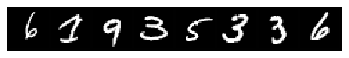

step 924, loss 1.247146487236023
Target:	 tensor([3, 1, 6, 8, 6, 5, 7, 7])
Pred:	 tensor([1, 7, 6, 5, 4, 5, 7, 7])


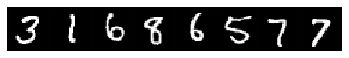

step 957, loss 1.7041219472885132
Target:	 tensor([6, 1, 5, 3, 9, 9, 4, 4])
Pred:	 tensor([6, 8, 8, 3, 3, 9, 4, 9])


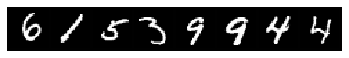

step 990, loss 1.3826872110366821
Target:	 tensor([8, 7, 7, 4, 6, 1, 3, 3])
Pred:	 tensor([8, 7, 7, 4, 6, 1, 3, 1])


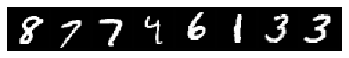

step 1023, loss 1.1730021238327026
Target:	 tensor([9, 5, 8, 1, 5, 9, 9, 7])
Pred:	 tensor([9, 5, 8, 1, 5, 5, 9, 7])


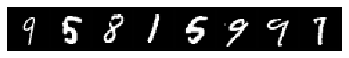

step 1056, loss 1.280705451965332
Target:	 tensor([6, 3, 4, 4, 8, 1, 9, 3])
Pred:	 tensor([6, 3, 6, 4, 6, 1, 3, 3])


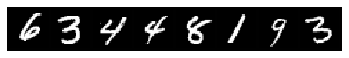

step 1089, loss 1.6159461736679077
Target:	 tensor([2, 1, 5, 9, 6, 7, 9, 4])
Pred:	 tensor([6, 9, 5, 9, 6, 7, 9, 4])


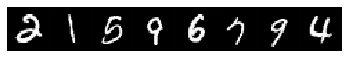

step 1122, loss 1.906837821006775
Target:	 tensor([8, 1, 3, 9, 5, 9, 8, 1])
Pred:	 tensor([8, 2, 3, 8, 5, 8, 8, 1])


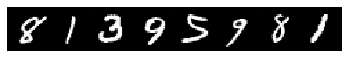

step 1155, loss 1.1477572917938232
Target:	 tensor([2, 8, 5, 6, 1, 6, 4, 2])
Pred:	 tensor([2, 8, 4, 0, 1, 6, 6, 6])


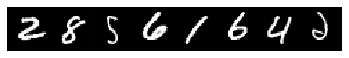

step 1188, loss 1.1701773405075073
Target:	 tensor([4, 3, 7, 6, 5, 1, 3, 5])
Pred:	 tensor([2, 6, 3, 5, 0, 1, 3, 5])


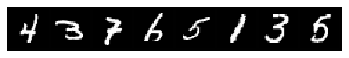

step 1221, loss 1.3670101165771484
Target:	 tensor([4, 5, 6, 3, 4, 5, 8, 6])
Pred:	 tensor([9, 5, 6, 0, 6, 9, 1, 6])


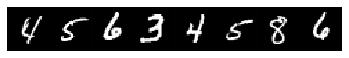

step 1254, loss 1.3136522769927979
Target:	 tensor([2, 3, 6, 7, 9, 0, 2, 1])
Pred:	 tensor([2, 3, 8, 1, 4, 0, 2, 5])


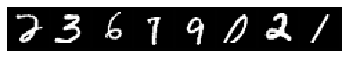

step 1287, loss 1.5542635917663574
Target:	 tensor([0, 7, 9, 3, 6, 7, 5, 5])
Pred:	 tensor([0, 7, 9, 3, 6, 7, 3, 0])


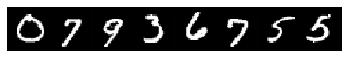

step 1320, loss 1.3705354928970337
Target:	 tensor([2, 1, 6, 8, 9, 2, 7, 7])
Pred:	 tensor([8, 1, 9, 5, 4, 2, 7, 7])


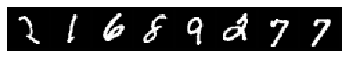

step 1353, loss 1.1151424646377563
Target:	 tensor([6, 3, 7, 6, 5, 9, 3, 6])
Pred:	 tensor([6, 7, 5, 4, 5, 5, 3, 5])


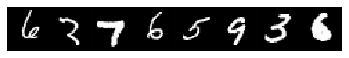

step 1386, loss 1.3057489395141602
Target:	 tensor([2, 7, 4, 0, 2, 8, 7, 1])
Pred:	 tensor([0, 9, 4, 0, 2, 8, 7, 1])


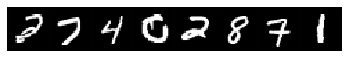

step 1419, loss 1.7513408660888672
Target:	 tensor([3, 4, 3, 8, 2, 2, 8, 4])
Pred:	 tensor([9, 4, 3, 8, 0, 2, 8, 4])


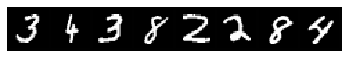

step 1452, loss 1.548806071281433
Target:	 tensor([9, 6, 4, 3, 3, 3, 6, 3])
Pred:	 tensor([7, 6, 4, 1, 3, 3, 8, 3])


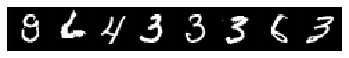

step 1485, loss 0.7975552678108215
Target:	 tensor([7, 3, 5, 7, 6, 2, 4, 7])
Pred:	 tensor([7, 1, 5, 7, 6, 2, 4, 7])


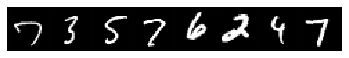

step 1518, loss 1.3186323642730713
Target:	 tensor([1, 9, 4, 9, 1, 6, 3, 8])
Pred:	 tensor([8, 9, 4, 9, 1, 4, 3, 5])


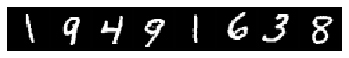

step 1551, loss 1.3665114641189575
Target:	 tensor([0, 9, 7, 8, 5, 8, 2, 0])
Pred:	 tensor([6, 8, 7, 8, 5, 8, 2, 0])


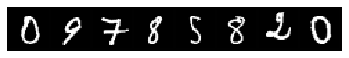

step 1584, loss 0.8179826140403748
Target:	 tensor([7, 1, 7, 5, 1, 8, 1, 6])
Pred:	 tensor([7, 1, 7, 2, 8, 8, 1, 4])


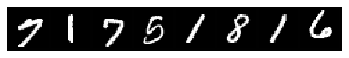

step 1617, loss 0.8932848572731018
Target:	 tensor([1, 1, 3, 4, 3, 3, 6, 2])
Pred:	 tensor([8, 1, 3, 4, 3, 5, 6, 3])


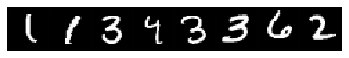

step 1650, loss 1.2601360082626343
Target:	 tensor([9, 0, 1, 0, 5, 0, 1, 7])
Pred:	 tensor([4, 0, 1, 2, 5, 0, 8, 7])


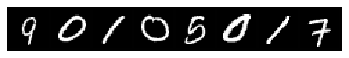

step 1683, loss 0.8562135696411133
Target:	 tensor([1, 7, 2, 0, 8, 0, 8, 8])
Pred:	 tensor([1, 7, 2, 0, 8, 0, 6, 6])


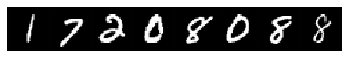

step 1716, loss 1.1003834009170532
Target:	 tensor([0, 1, 7, 0, 1, 4, 9, 1])
Pred:	 tensor([0, 1, 2, 0, 1, 4, 7, 0])


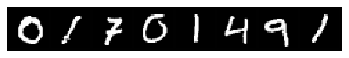

step 1749, loss 0.8406850695610046
Target:	 tensor([9, 9, 1, 3, 7, 0, 6, 0])
Pred:	 tensor([9, 9, 5, 1, 7, 0, 0, 0])


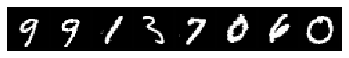

step 1782, loss 1.3006420135498047
Target:	 tensor([0, 7, 6, 4, 6, 3, 6, 0])
Pred:	 tensor([0, 1, 6, 4, 6, 3, 9, 0])


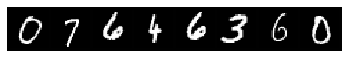

step 1815, loss 1.0388174057006836
Target:	 tensor([9, 1, 8, 6, 5, 7, 0, 6])
Pred:	 tensor([4, 7, 8, 6, 5, 7, 0, 6])


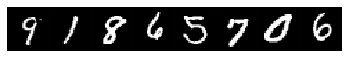

step 1848, loss 1.4446147680282593
Target:	 tensor([9, 2, 6, 6, 1, 5, 0, 9])
Pred:	 tensor([8, 6, 6, 6, 7, 4, 0, 8])


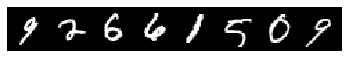

step 1881, loss 1.160995364189148
Target:	 tensor([1, 0, 5, 5, 5, 8, 3, 1])
Pred:	 tensor([1, 3, 4, 5, 5, 8, 3, 1])


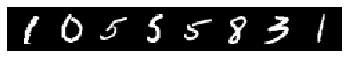

step 1914, loss 1.040189504623413
Target:	 tensor([4, 6, 5, 8, 8, 5, 3, 4])
Pred:	 tensor([4, 6, 9, 8, 1, 6, 3, 4])


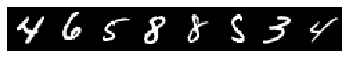

step 1947, loss 0.9236063957214355
Target:	 tensor([6, 3, 5, 9, 8, 0, 2, 7])
Pred:	 tensor([6, 3, 5, 9, 8, 0, 1, 7])


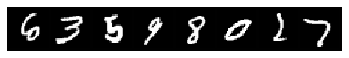

step 1980, loss 1.6128467321395874
Target:	 tensor([1, 8, 4, 4, 9, 2, 6, 2])
Pred:	 tensor([1, 5, 4, 6, 2, 2, 6, 3])


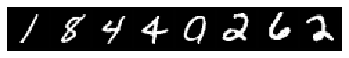

step 2013, loss 1.0427380800247192
Target:	 tensor([2, 9, 7, 3, 3, 7, 7, 2])
Pred:	 tensor([7, 9, 7, 3, 3, 7, 7, 2])


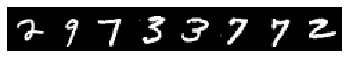

step 2046, loss 0.96250981092453
Target:	 tensor([7, 9, 9, 1, 0, 4, 8, 7])
Pred:	 tensor([7, 9, 9, 7, 2, 6, 8, 7])


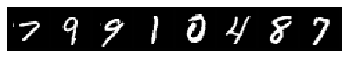

step 2079, loss 0.8661134243011475
Target:	 tensor([4, 7, 4, 3, 9, 0, 1, 1])
Pred:	 tensor([4, 9, 7, 3, 7, 0, 1, 8])


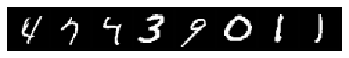

step 2112, loss 0.7340013980865479
Target:	 tensor([5, 0, 9, 3, 6, 7, 1, 4])
Pred:	 tensor([5, 0, 9, 6, 6, 7, 1, 6])


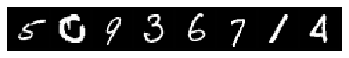

step 2145, loss 0.8975493907928467
Target:	 tensor([0, 6, 9, 6, 7, 0, 6, 0])
Pred:	 tensor([0, 2, 9, 5, 7, 0, 6, 0])


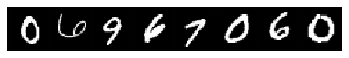

step 2178, loss 0.8605787754058838
Target:	 tensor([2, 8, 0, 5, 2, 7, 4, 2])
Pred:	 tensor([3, 8, 0, 8, 2, 7, 4, 2])


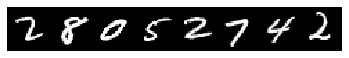

step 2211, loss 1.1742756366729736
Target:	 tensor([9, 5, 0, 7, 5, 2, 4, 4])
Pred:	 tensor([4, 8, 0, 7, 5, 4, 4, 4])


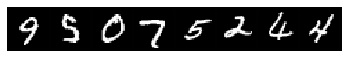

step 2244, loss 1.1786599159240723
Target:	 tensor([1, 8, 9, 9, 5, 5, 4, 2])
Pred:	 tensor([4, 5, 9, 9, 3, 3, 4, 2])


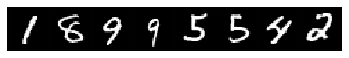

step 2277, loss 0.5100208520889282
Target:	 tensor([9, 0, 2, 6, 0, 8, 7, 5])
Pred:	 tensor([9, 0, 2, 6, 0, 8, 7, 5])


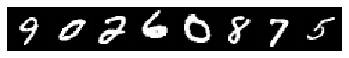

step 2310, loss 0.6504955887794495
Target:	 tensor([5, 5, 2, 4, 9, 7, 9, 4])
Pred:	 tensor([5, 3, 2, 4, 9, 7, 7, 4])


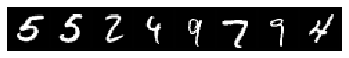

step 2343, loss 0.8874472975730896
Target:	 tensor([0, 4, 8, 0, 1, 0, 9, 3])
Pred:	 tensor([8, 4, 8, 0, 1, 0, 9, 3])


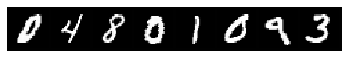

step 2376, loss 0.7673937678337097
Target:	 tensor([5, 4, 9, 7, 4, 4, 5, 8])
Pred:	 tensor([7, 4, 9, 7, 4, 4, 5, 8])


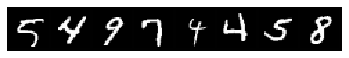

step 2409, loss 0.9196702837944031
Target:	 tensor([7, 1, 8, 7, 8, 8, 7, 5])
Pred:	 tensor([7, 1, 8, 7, 8, 8, 7, 8])


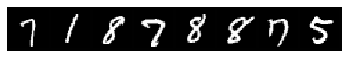

step 2442, loss 1.2054946422576904
Target:	 tensor([9, 6, 6, 2, 8, 1, 4, 3])
Pred:	 tensor([9, 6, 6, 2, 2, 1, 1, 3])


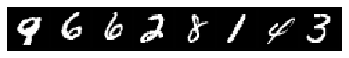

step 2475, loss 0.8537101745605469
Target:	 tensor([5, 9, 4, 7, 9, 2, 6, 3])
Pred:	 tensor([7, 9, 4, 7, 9, 2, 6, 2])


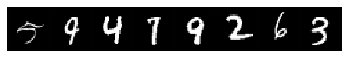

step 2508, loss 0.6698624491691589
Target:	 tensor([5, 7, 7, 2, 5, 0, 4, 3])
Pred:	 tensor([5, 7, 3, 3, 5, 0, 4, 7])


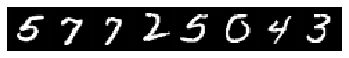

step 2541, loss 1.237122893333435
Target:	 tensor([8, 3, 7, 7, 4, 3, 2, 7])
Pred:	 tensor([0, 3, 7, 7, 4, 3, 0, 7])


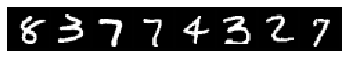

step 2574, loss 1.09713876247406
Target:	 tensor([9, 5, 1, 6, 2, 6, 9, 0])
Pred:	 tensor([8, 3, 1, 6, 1, 6, 9, 0])


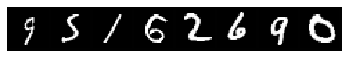

step 2607, loss 0.9158790707588196
Target:	 tensor([3, 4, 7, 1, 8, 6, 0, 8])
Pred:	 tensor([3, 4, 9, 1, 5, 6, 0, 8])


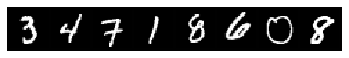

step 2640, loss 0.6424171924591064
Target:	 tensor([9, 4, 3, 7, 6, 3, 9, 0])
Pred:	 tensor([9, 4, 7, 7, 2, 3, 9, 0])


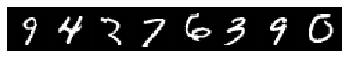

step 2673, loss 1.0226985216140747
Target:	 tensor([8, 7, 8, 3, 0, 3, 7, 1])
Pred:	 tensor([1, 7, 2, 3, 0, 3, 1, 1])


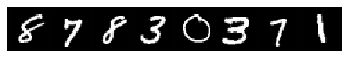

step 2706, loss 0.6824446320533752
Target:	 tensor([1, 5, 3, 2, 7, 2, 8, 1])
Pred:	 tensor([1, 1, 3, 2, 7, 2, 8, 8])


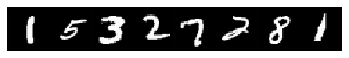

step 2739, loss 0.8720283508300781
Target:	 tensor([1, 6, 0, 9, 7, 7, 2, 4])
Pred:	 tensor([1, 6, 5, 9, 3, 7, 7, 9])


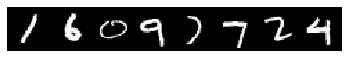

step 2772, loss 0.49634119868278503
Target:	 tensor([7, 6, 9, 6, 9, 2, 5, 2])
Pred:	 tensor([7, 6, 9, 6, 9, 2, 8, 7])


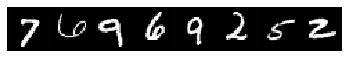

step 2805, loss 1.1331425905227661
Target:	 tensor([1, 2, 5, 1, 8, 4, 1, 9])
Pred:	 tensor([1, 2, 3, 1, 8, 4, 1, 0])


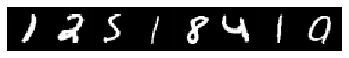

step 2838, loss 0.5534979104995728
Target:	 tensor([6, 8, 7, 9, 8, 1, 9, 0])
Pred:	 tensor([6, 8, 7, 9, 8, 1, 9, 0])


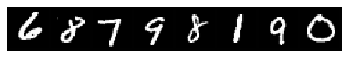

step 2871, loss 0.4609237015247345
Target:	 tensor([4, 2, 0, 7, 0, 9, 9, 7])
Pred:	 tensor([4, 1, 0, 7, 0, 9, 4, 7])


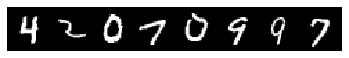

step 2904, loss 1.0151084661483765
Target:	 tensor([7, 1, 1, 1, 5, 7, 4, 2])
Pred:	 tensor([7, 1, 1, 1, 5, 7, 6, 2])


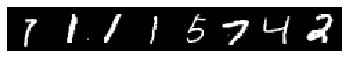

step 2937, loss 0.9366807341575623
Target:	 tensor([0, 3, 1, 0, 3, 7, 8, 4])
Pred:	 tensor([0, 2, 1, 0, 3, 7, 6, 4])


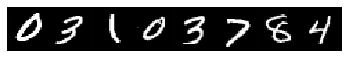

step 2970, loss 0.572837233543396
Target:	 tensor([7, 8, 3, 2, 7, 2, 5, 3])
Pred:	 tensor([7, 8, 3, 4, 7, 2, 5, 3])


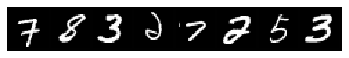

step 3003, loss 0.6208873391151428
Target:	 tensor([6, 8, 4, 4, 6, 6, 6, 1])
Pred:	 tensor([6, 2, 6, 4, 6, 6, 6, 1])


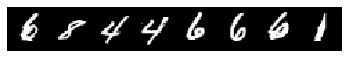

step 3036, loss 0.4651864767074585
Target:	 tensor([6, 0, 7, 5, 4, 4, 5, 6])
Pred:	 tensor([6, 0, 7, 8, 4, 4, 6, 6])


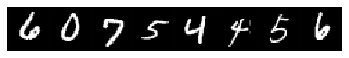

step 3069, loss 1.0898810625076294
Target:	 tensor([0, 6, 9, 6, 1, 8, 3, 7])
Pred:	 tensor([0, 6, 9, 6, 1, 1, 3, 1])


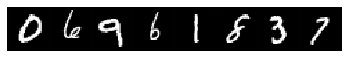

step 3102, loss 0.7450414299964905
Target:	 tensor([2, 6, 3, 3, 1, 6, 1, 6])
Pred:	 tensor([2, 5, 7, 0, 1, 4, 1, 6])


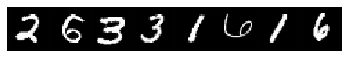

step 3135, loss 0.7660693526268005
Target:	 tensor([3, 7, 5, 7, 7, 8, 7, 3])
Pred:	 tensor([7, 7, 8, 7, 7, 5, 7, 7])


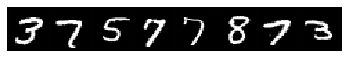

step 3168, loss 1.0185540914535522
Target:	 tensor([9, 2, 9, 6, 9, 9, 9, 6])
Pred:	 tensor([9, 7, 9, 6, 7, 9, 9, 6])


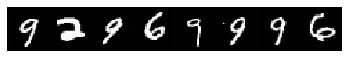

step 3201, loss 0.4490366280078888
Target:	 tensor([2, 6, 1, 3, 1, 6, 6, 6])
Pred:	 tensor([2, 6, 1, 3, 8, 6, 4, 6])


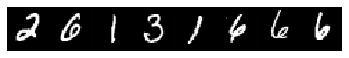

step 3234, loss 0.9259397387504578
Target:	 tensor([4, 8, 5, 1, 9, 4, 6, 2])
Pred:	 tensor([4, 5, 3, 1, 9, 4, 6, 1])


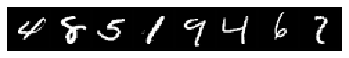

step 3267, loss 0.5673393607139587
Target:	 tensor([7, 3, 4, 6, 6, 8, 7, 4])
Pred:	 tensor([7, 3, 4, 5, 4, 8, 7, 4])


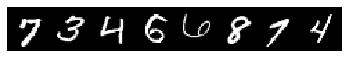

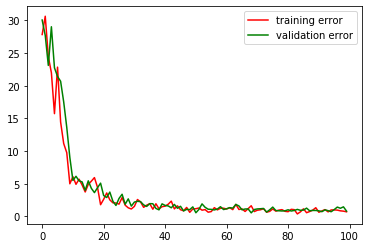

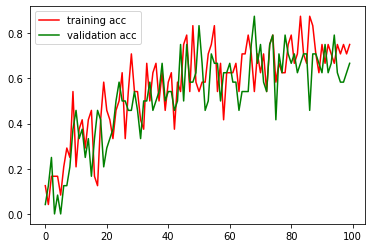

In [51]:
# TO DO:
# Write the dataset loading script, training script. - Train LeNetDrop on the 1k dataset.
# Plot out the training loss curve, validation loss curve, training accuracy curve and validation accuracy curve.


# 1. Loading Script (script inspired from above)
dataset_size = 1000
validation_size = int(0.2 * 1000)

ds = MNISTDataset(ds_size=dataset_size)

train_ds, val_ds = torch.utils.data.random_split(ds, [dataset_size - validation_size, validation_size])

batch_size = 24

train_dl = DataLoader(train_ds, batch_size=batch_size, shuffle=True, drop_last=True)
val_dl = DataLoader(val_ds, batch_size=batch_size, shuffle=True, drop_last=True)
img_channel = 1

def step(weights, grad, lr, decay_rate):
  for i in range(len(weights)):
    if decay_rate is not 0:
      weights[i].data.sub_(weights[i].data*decay_rate)
    weights[i].data.sub_(grad[i]*lr)

lr = 1e-4
# Note to TA: using 0.95 according to this website which states decay default as 0.95.
# https://tf-lenet.readthedocs.io/en/latest/api/network.html
# decay_rate = 0.95 
# A decay rate of 0.95 was throwing off my accuracy so I was not sure what to set it as, so I set it at an arbitrary number closer to 0.
# decay_rate = 1e-3 --> This was so off
# decay_rate = 1e-4 --> This was too accurate
# decay_rate = 0.0009
decay_rate = 0.0001 


device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# net = LeNet(img_channel, device)
net = LeNetDrop(img_channel, device)

params = [p for (n, p) in net.named_parameters()]

epochs = 100

train_loss_list = []
val_loss_list = []
train_acc_list = []
val_acc_list = []

print_interval = 50
for e in range(epochs):
  net.train()
  for i, (imgs, lbs) in enumerate(train_dl):
    imgs = imgs.to(device)
    lbs = lbs.to(device)
    loss, prob = net(imgs, lbs)
    
    net.zero_grad()
    grad = torch.autograd.grad(loss, params)
    
    step(params, grad, lr, decay_rate)
    
    pred = prob.argmax(dim=-1).view(batch_size)
    acc = (pred == lbs).float().mean()
    
    if i % print_interval == 0:
      print("step {}, loss {}".format(i + e*len(train_dl), loss))
      print("Target:\t {}\nPred:\t {}".format(lbs[:8], pred[:8]))
      imgs_to_vis = vutils.make_grid(imgs[:8].cpu()+125., nrow=8, pad_value=1)
      plt.imshow(imgs_to_vis.permute(1,2,0).numpy().astype(np.uint8))
      plt.axis("off")
      plt.show()
      
  train_loss_list.append(loss.detach().mean())
  train_acc_list.append(acc.detach().mean())
  
  net.eval()
  for i, (imgs, lbs) in enumerate(val_dl):
    imgs = imgs.to(device)
    lbs = lbs.to(device)
    loss, prob = net(imgs, lbs)
    
    pred = prob.argmax(dim=-1).view(batch_size)
    acc = (pred == lbs).float().mean()
    
  val_loss_list.append(loss.detach().mean())
  val_acc_list.append(acc.detach().mean())
  

# 2. Plot out the training loss curve, validation loss curve, training accuracy curve, and validation accuracy curve.
plt.plot(np.arange(epochs), train_loss_list, '-r',
         np.arange(epochs), val_loss_list, '-g')
plt.legend(('training error', 'validation error'))
plt.show()
plt.plot(np.arange(epochs), train_acc_list, '-r',
         np.arange(epochs), val_acc_list, '-g')
plt.legend(('training acc', 'validation acc'))
plt.show()


## Task 7: Train on full dataset

Now, train the LeNetDrop on the full MNIST dataset. 

**To-do**:
    - Write the dataset loading script, training script for LeNetDrop.
    - Train LeNetDrop on the full MNIST dataset below.
    - (10 points)Plot out the training loss curve, validation loss curve, training accuracy curve and validation accuracy curve.

step 0, loss 27.502973556518555
Target:	 tensor([3, 4, 7, 8, 9, 4, 9, 6])
Pred:	 tensor([1, 8, 7, 6, 7, 5, 6, 2])


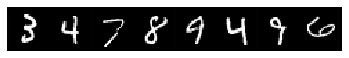

step 50, loss 28.711204528808594
Target:	 tensor([2, 8, 3, 8, 6, 7, 2, 4])
Pred:	 tensor([6, 1, 8, 1, 1, 8, 8, 1])


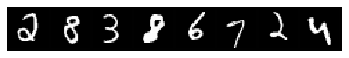

step 100, loss 25.554244995117188
Target:	 tensor([8, 7, 8, 0, 0, 8, 7, 8])
Pred:	 tensor([7, 5, 5, 7, 5, 1, 1, 7])


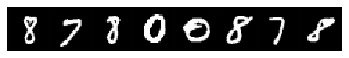

step 150, loss 23.02424430847168
Target:	 tensor([0, 1, 1, 2, 5, 5, 9, 6])
Pred:	 tensor([4, 1, 1, 1, 7, 1, 1, 6])


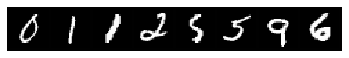

step 200, loss 21.082950592041016
Target:	 tensor([5, 3, 9, 4, 9, 3, 3, 3])
Pred:	 tensor([1, 7, 7, 1, 0, 8, 6, 7])


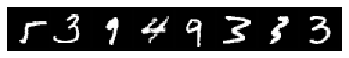

step 250, loss 21.689559936523438
Target:	 tensor([6, 6, 3, 3, 5, 9, 0, 1])
Pred:	 tensor([6, 6, 5, 4, 4, 7, 5, 1])


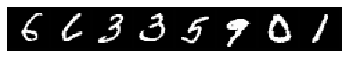

step 300, loss 20.308868408203125
Target:	 tensor([4, 1, 6, 7, 9, 4, 5, 6])
Pred:	 tensor([8, 4, 6, 8, 4, 1, 4, 1])


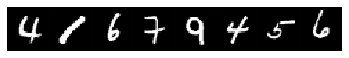

step 350, loss 14.348706245422363
Target:	 tensor([4, 9, 6, 7, 6, 8, 5, 1])
Pred:	 tensor([4, 4, 6, 5, 6, 4, 5, 7])


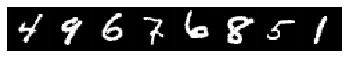

step 400, loss 15.173957824707031
Target:	 tensor([2, 2, 5, 7, 2, 1, 6, 5])
Pred:	 tensor([4, 8, 5, 0, 5, 1, 8, 8])


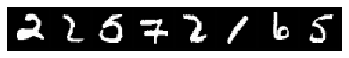

step 450, loss 15.467167854309082
Target:	 tensor([3, 2, 7, 9, 8, 9, 2, 1])
Pred:	 tensor([5, 2, 7, 0, 6, 4, 0, 1])


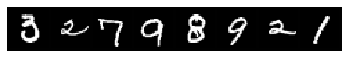

step 500, loss 12.956623077392578
Target:	 tensor([4, 0, 5, 5, 0, 8, 8, 8])
Pred:	 tensor([7, 0, 3, 8, 6, 5, 5, 9])


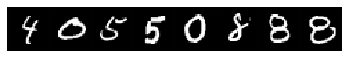

step 550, loss 3.898484945297241
Target:	 tensor([3, 8, 1, 1, 8, 5, 6, 6])
Pred:	 tensor([5, 4, 4, 1, 5, 3, 0, 6])


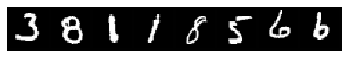

step 600, loss 6.483274936676025
Target:	 tensor([7, 5, 8, 5, 4, 9, 3, 8])
Pred:	 tensor([1, 3, 1, 4, 4, 4, 0, 5])


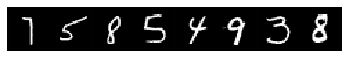

step 650, loss 5.659553050994873
Target:	 tensor([7, 5, 9, 7, 8, 0, 8, 6])
Pred:	 tensor([7, 8, 7, 7, 3, 8, 8, 9])


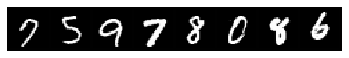

step 700, loss 3.931547164916992
Target:	 tensor([2, 7, 3, 8, 0, 7, 5, 1])
Pred:	 tensor([1, 7, 7, 6, 0, 7, 5, 1])


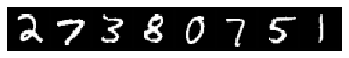

step 750, loss 2.0930190086364746
Target:	 tensor([7, 3, 0, 2, 9, 4, 1, 8])
Pred:	 tensor([1, 8, 0, 6, 3, 4, 7, 6])


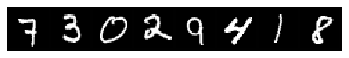

step 800, loss 2.7682971954345703
Target:	 tensor([7, 5, 3, 1, 3, 4, 7, 8])
Pred:	 tensor([0, 5, 1, 1, 4, 8, 7, 3])


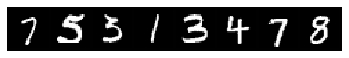

step 850, loss 3.720529556274414
Target:	 tensor([8, 7, 2, 1, 4, 1, 0, 3])
Pred:	 tensor([1, 7, 8, 1, 9, 8, 5, 2])


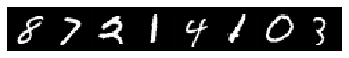

step 900, loss 3.3792097568511963
Target:	 tensor([6, 1, 7, 6, 8, 6, 5, 9])
Pred:	 tensor([2, 1, 3, 2, 9, 4, 3, 1])


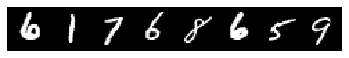

step 950, loss 2.4725916385650635
Target:	 tensor([8, 2, 4, 5, 5, 0, 8, 0])
Pred:	 tensor([1, 9, 8, 0, 4, 3, 3, 6])


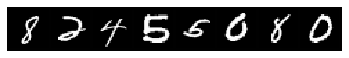

step 1000, loss 2.60188364982605
Target:	 tensor([1, 4, 4, 5, 7, 5, 4, 1])
Pred:	 tensor([1, 9, 9, 4, 7, 0, 6, 6])


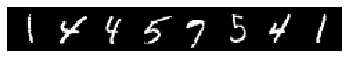

step 1050, loss 2.4700818061828613
Target:	 tensor([2, 4, 7, 9, 9, 1, 3, 2])
Pred:	 tensor([3, 9, 7, 0, 1, 1, 3, 6])


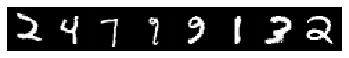

step 1100, loss 2.1059935092926025
Target:	 tensor([0, 3, 1, 1, 2, 5, 2, 1])
Pred:	 tensor([6, 8, 6, 9, 2, 5, 1, 1])


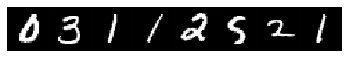

step 1150, loss 3.4830799102783203
Target:	 tensor([5, 5, 1, 4, 4, 4, 0, 3])
Pred:	 tensor([6, 6, 1, 6, 2, 4, 0, 4])


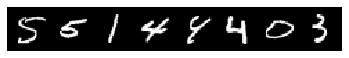

step 1200, loss 1.7160935401916504
Target:	 tensor([5, 5, 6, 0, 3, 9, 0, 6])
Pred:	 tensor([4, 8, 6, 6, 0, 0, 0, 5])


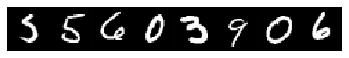

step 1250, loss 1.7283329963684082
Target:	 tensor([4, 3, 6, 3, 0, 6, 6, 7])
Pred:	 tensor([4, 5, 8, 1, 0, 9, 6, 1])


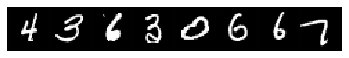

step 1300, loss 1.594680666923523
Target:	 tensor([7, 4, 9, 8, 6, 6, 2, 4])
Pred:	 tensor([7, 7, 5, 1, 2, 6, 3, 7])


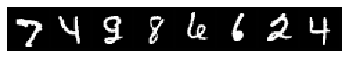

step 1350, loss 2.0616843700408936
Target:	 tensor([9, 4, 4, 1, 7, 3, 1, 5])
Pred:	 tensor([7, 8, 4, 1, 3, 9, 6, 4])


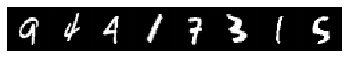

step 1400, loss 1.471018671989441
Target:	 tensor([4, 9, 8, 1, 0, 3, 2, 6])
Pred:	 tensor([4, 3, 8, 1, 5, 3, 3, 6])


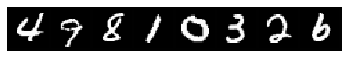

step 1450, loss 1.5352038145065308
Target:	 tensor([2, 5, 1, 0, 9, 0, 3, 4])
Pred:	 tensor([0, 5, 1, 0, 7, 0, 7, 9])


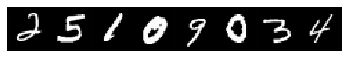

step 1500, loss 2.10615611076355
Target:	 tensor([5, 8, 2, 9, 9, 3, 9, 6])
Pred:	 tensor([5, 8, 8, 9, 8, 4, 9, 6])


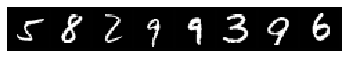

step 1550, loss 1.9679962396621704
Target:	 tensor([4, 5, 7, 7, 0, 0, 3, 8])
Pred:	 tensor([4, 6, 3, 1, 0, 6, 3, 8])


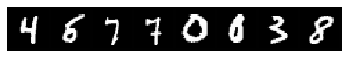

step 1600, loss 1.8018122911453247
Target:	 tensor([5, 8, 4, 7, 1, 4, 5, 5])
Pred:	 tensor([4, 4, 4, 0, 1, 4, 6, 4])


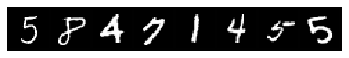

step 1650, loss 2.0706729888916016
Target:	 tensor([2, 9, 4, 6, 3, 3, 9, 8])
Pred:	 tensor([0, 7, 9, 3, 4, 3, 8, 8])


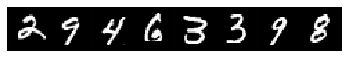

step 1700, loss 2.19234037399292
Target:	 tensor([0, 2, 1, 1, 8, 7, 1, 4])
Pred:	 tensor([3, 7, 3, 1, 6, 7, 1, 4])


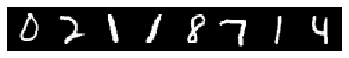

step 1750, loss 1.6565340757369995
Target:	 tensor([9, 8, 0, 7, 7, 9, 8, 7])
Pred:	 tensor([9, 2, 9, 8, 7, 4, 2, 7])


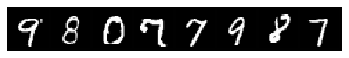

step 1800, loss 1.7137058973312378
Target:	 tensor([5, 3, 1, 4, 1, 8, 3, 7])
Pred:	 tensor([1, 3, 1, 4, 1, 8, 6, 7])


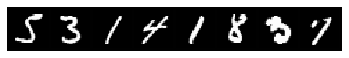

step 1850, loss 1.415493130683899
Target:	 tensor([5, 7, 9, 0, 8, 0, 2, 1])
Pred:	 tensor([3, 7, 1, 0, 4, 9, 8, 1])


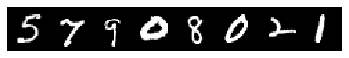

step 1900, loss 1.2646945714950562
Target:	 tensor([8, 4, 1, 8, 5, 1, 2, 4])
Pred:	 tensor([6, 4, 1, 8, 7, 1, 2, 8])


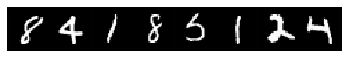

step 1950, loss 1.2081750631332397
Target:	 tensor([3, 9, 4, 4, 5, 3, 4, 7])
Pred:	 tensor([1, 4, 4, 9, 5, 3, 4, 7])


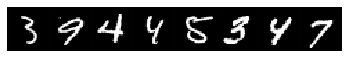

step 2000, loss 1.214880108833313
Target:	 tensor([0, 1, 1, 3, 5, 0, 9, 7])
Pred:	 tensor([0, 6, 0, 3, 0, 0, 4, 7])


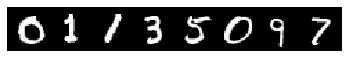

step 2050, loss 1.4086111783981323
Target:	 tensor([6, 3, 1, 5, 5, 3, 5, 9])
Pred:	 tensor([8, 0, 1, 4, 5, 3, 3, 3])


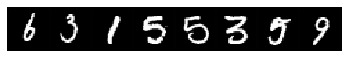

step 2100, loss 1.5901440382003784
Target:	 tensor([0, 4, 1, 3, 6, 9, 6, 8])
Pred:	 tensor([8, 8, 6, 9, 0, 9, 6, 8])


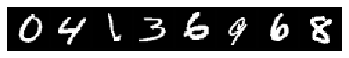

step 2150, loss 1.1622267961502075
Target:	 tensor([2, 7, 8, 0, 2, 2, 7, 6])
Pred:	 tensor([6, 7, 3, 0, 3, 3, 7, 6])


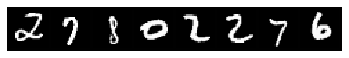

step 2200, loss 1.1559594869613647
Target:	 tensor([3, 4, 6, 6, 2, 6, 6, 4])
Pred:	 tensor([5, 4, 6, 1, 2, 6, 6, 4])


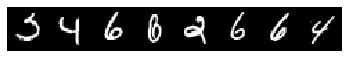

step 2250, loss 1.2477198839187622
Target:	 tensor([6, 2, 6, 7, 7, 1, 4, 8])
Pred:	 tensor([6, 4, 6, 7, 7, 6, 4, 4])


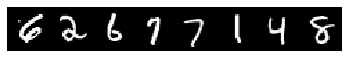

step 2300, loss 1.310217022895813
Target:	 tensor([2, 8, 2, 7, 8, 6, 9, 7])
Pred:	 tensor([8, 2, 9, 7, 8, 6, 9, 9])


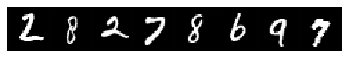

step 2350, loss 1.7832638025283813
Target:	 tensor([1, 9, 9, 1, 1, 9, 8, 4])
Pred:	 tensor([3, 8, 6, 7, 1, 9, 8, 4])


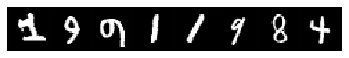

step 2400, loss 1.357114315032959
Target:	 tensor([3, 6, 8, 3, 6, 1, 7, 7])
Pred:	 tensor([3, 6, 1, 4, 6, 7, 7, 7])


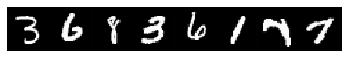

step 2450, loss 1.3982003927230835
Target:	 tensor([1, 3, 2, 5, 2, 9, 2, 0])
Pred:	 tensor([1, 5, 6, 4, 2, 4, 1, 0])


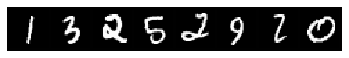

step 2491, loss 1.5708599090576172
Target:	 tensor([4, 0, 6, 9, 7, 7, 2, 6])
Pred:	 tensor([4, 3, 6, 7, 6, 8, 7, 6])


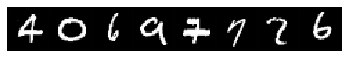

step 2541, loss 0.8778430819511414
Target:	 tensor([0, 1, 0, 6, 0, 8, 4, 1])
Pred:	 tensor([8, 1, 0, 6, 0, 8, 9, 3])


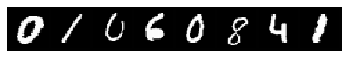

step 2591, loss 1.1716481447219849
Target:	 tensor([3, 6, 3, 2, 2, 0, 0, 6])
Pred:	 tensor([3, 6, 3, 2, 7, 0, 5, 6])


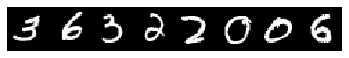

step 2641, loss 0.9506752490997314
Target:	 tensor([4, 1, 3, 3, 0, 9, 6, 5])
Pred:	 tensor([6, 1, 5, 3, 0, 9, 0, 5])


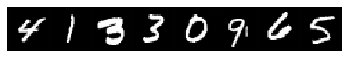

step 2691, loss 1.1768438816070557
Target:	 tensor([3, 9, 4, 3, 1, 6, 0, 8])
Pred:	 tensor([3, 7, 4, 2, 1, 0, 0, 8])


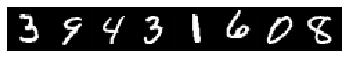

step 2741, loss 1.5455354452133179
Target:	 tensor([4, 5, 1, 1, 9, 0, 9, 5])
Pred:	 tensor([4, 5, 5, 1, 4, 2, 4, 9])


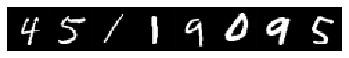

step 2791, loss 1.2238332033157349
Target:	 tensor([7, 2, 9, 2, 7, 7, 9, 1])
Pred:	 tensor([7, 0, 5, 2, 7, 7, 3, 1])


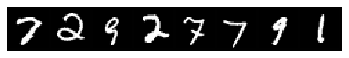

step 2841, loss 0.9411160349845886
Target:	 tensor([9, 8, 8, 0, 8, 4, 3, 3])
Pred:	 tensor([4, 8, 8, 0, 2, 4, 3, 3])


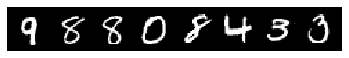

step 2891, loss 1.175479531288147
Target:	 tensor([4, 2, 9, 8, 6, 4, 8, 9])
Pred:	 tensor([1, 2, 7, 2, 6, 9, 0, 9])


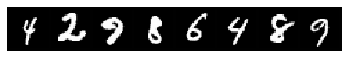

step 2941, loss 1.3102984428405762
Target:	 tensor([7, 0, 2, 9, 7, 0, 3, 8])
Pred:	 tensor([7, 0, 2, 4, 7, 0, 2, 8])


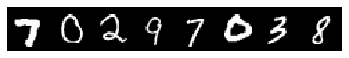

step 2991, loss 0.8856909275054932
Target:	 tensor([2, 4, 9, 2, 7, 1, 9, 1])
Pred:	 tensor([3, 4, 4, 2, 7, 1, 9, 1])


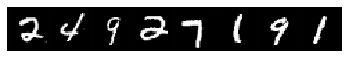

step 3041, loss 0.6773881912231445
Target:	 tensor([8, 1, 9, 0, 1, 4, 1, 2])
Pred:	 tensor([5, 1, 9, 0, 1, 4, 6, 2])


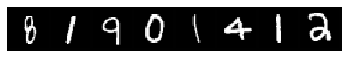

step 3091, loss 1.4271320104599
Target:	 tensor([8, 8, 3, 4, 3, 0, 3, 6])
Pred:	 tensor([8, 5, 3, 9, 0, 5, 3, 4])


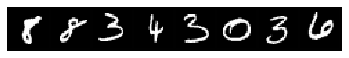

step 3141, loss 0.891383945941925
Target:	 tensor([3, 2, 0, 2, 1, 2, 1, 2])
Pred:	 tensor([3, 2, 0, 2, 1, 1, 5, 2])


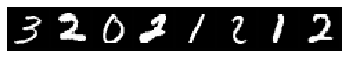

step 3191, loss 1.1755560636520386
Target:	 tensor([7, 1, 9, 6, 7, 2, 4, 1])
Pred:	 tensor([7, 1, 7, 6, 7, 4, 9, 1])


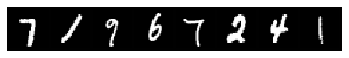

step 3241, loss 0.8056859374046326
Target:	 tensor([0, 0, 6, 1, 3, 8, 3, 4])
Pred:	 tensor([0, 0, 6, 1, 3, 5, 3, 7])


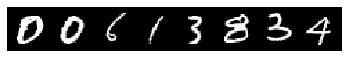

step 3291, loss 1.1531673669815063
Target:	 tensor([9, 4, 7, 3, 7, 6, 0, 0])
Pred:	 tensor([4, 9, 1, 3, 7, 6, 0, 0])


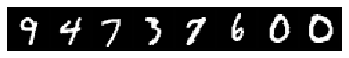

step 3341, loss 0.9993174076080322
Target:	 tensor([8, 2, 4, 4, 7, 5, 8, 2])
Pred:	 tensor([8, 7, 4, 6, 7, 5, 3, 0])


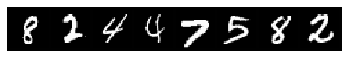

step 3391, loss 1.201581358909607
Target:	 tensor([0, 1, 3, 8, 7, 4, 0, 6])
Pred:	 tensor([2, 1, 5, 6, 7, 4, 0, 6])


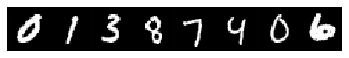

step 3441, loss 1.0115538835525513
Target:	 tensor([7, 1, 5, 5, 5, 7, 7, 3])
Pred:	 tensor([7, 1, 7, 5, 7, 7, 7, 3])


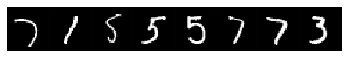

step 3491, loss 1.433912754058838
Target:	 tensor([6, 8, 3, 1, 9, 5, 5, 4])
Pred:	 tensor([6, 9, 5, 1, 5, 8, 3, 9])


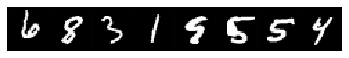

step 3541, loss 0.5462353825569153
Target:	 tensor([8, 5, 8, 9, 2, 0, 1, 1])
Pred:	 tensor([8, 5, 8, 7, 2, 0, 1, 1])


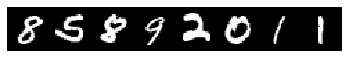

step 3591, loss 0.6868934631347656
Target:	 tensor([0, 4, 8, 2, 6, 7, 3, 1])
Pred:	 tensor([6, 4, 8, 2, 6, 7, 3, 1])


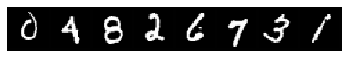

step 3641, loss 1.1129826307296753
Target:	 tensor([9, 2, 7, 9, 6, 9, 9, 3])
Pred:	 tensor([9, 2, 7, 4, 6, 8, 7, 3])


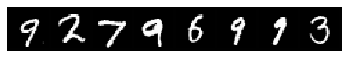

step 3691, loss 0.68147873878479
Target:	 tensor([2, 4, 7, 3, 6, 9, 7, 7])
Pred:	 tensor([2, 9, 7, 3, 5, 0, 7, 7])


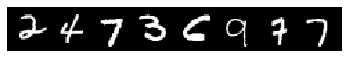

step 3741, loss 0.9149112701416016
Target:	 tensor([2, 4, 2, 4, 7, 8, 2, 8])
Pred:	 tensor([2, 3, 2, 4, 7, 8, 2, 8])


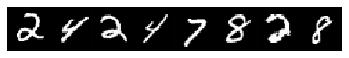

step 3791, loss 0.8324890732765198
Target:	 tensor([5, 5, 3, 5, 1, 0, 9, 0])
Pred:	 tensor([5, 5, 3, 5, 1, 0, 7, 0])


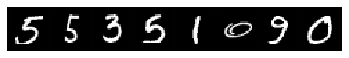

step 3841, loss 0.8789427876472473
Target:	 tensor([1, 7, 1, 5, 4, 7, 0, 8])
Pred:	 tensor([1, 2, 1, 5, 4, 7, 0, 5])


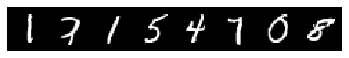

step 3891, loss 0.614768922328949
Target:	 tensor([6, 7, 5, 8, 2, 4, 1, 1])
Pred:	 tensor([6, 7, 9, 8, 6, 4, 1, 1])


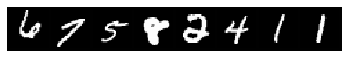

step 3941, loss 0.8042664527893066
Target:	 tensor([7, 3, 4, 5, 7, 7, 0, 3])
Pred:	 tensor([3, 3, 7, 5, 7, 7, 0, 3])


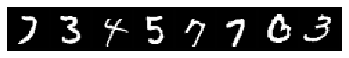

step 3991, loss 0.8560142517089844
Target:	 tensor([4, 4, 4, 2, 4, 2, 7, 1])
Pred:	 tensor([4, 4, 4, 4, 4, 2, 7, 1])


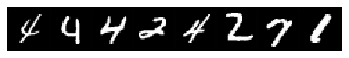

step 4041, loss 1.0066834688186646
Target:	 tensor([1, 5, 5, 2, 3, 2, 7, 2])
Pred:	 tensor([1, 5, 6, 2, 3, 2, 7, 2])


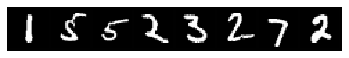

step 4091, loss 0.7299752831459045
Target:	 tensor([5, 8, 8, 9, 5, 2, 1, 3])
Pred:	 tensor([8, 8, 8, 9, 5, 2, 1, 2])


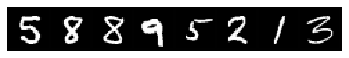

step 4141, loss 0.963078498840332
Target:	 tensor([4, 0, 6, 3, 9, 2, 0, 2])
Pred:	 tensor([4, 0, 6, 3, 7, 8, 0, 5])


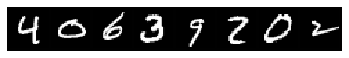

step 4191, loss 0.7934785485267639
Target:	 tensor([6, 5, 7, 1, 3, 9, 4, 7])
Pred:	 tensor([6, 5, 1, 1, 2, 9, 4, 7])


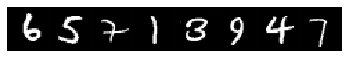

step 4241, loss 0.9689256548881531
Target:	 tensor([5, 0, 8, 0, 6, 4, 2, 6])
Pred:	 tensor([5, 0, 8, 0, 6, 4, 2, 6])


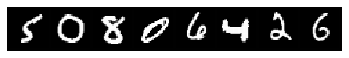

step 4291, loss 1.1747008562088013
Target:	 tensor([6, 5, 1, 6, 3, 5, 7, 6])
Pred:	 tensor([1, 5, 1, 6, 4, 5, 7, 6])


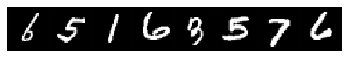

step 4341, loss 0.843254029750824
Target:	 tensor([5, 3, 6, 1, 7, 9, 9, 8])
Pred:	 tensor([3, 6, 6, 1, 7, 9, 8, 8])


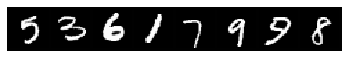

step 4391, loss 0.9544693827629089
Target:	 tensor([5, 4, 3, 5, 1, 4, 5, 7])
Pred:	 tensor([5, 8, 3, 6, 1, 9, 3, 7])


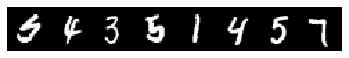

step 4441, loss 0.9178676009178162
Target:	 tensor([0, 6, 2, 6, 0, 7, 8, 2])
Pred:	 tensor([0, 6, 2, 6, 0, 1, 8, 2])


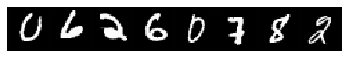

step 4491, loss 0.7817646861076355
Target:	 tensor([3, 5, 7, 1, 1, 5, 1, 2])
Pred:	 tensor([3, 5, 7, 1, 1, 5, 1, 2])


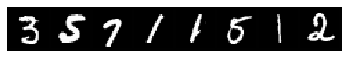

step 4541, loss 0.9378140568733215
Target:	 tensor([2, 7, 8, 5, 6, 5, 1, 4])
Pred:	 tensor([2, 7, 8, 9, 6, 0, 1, 4])


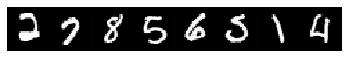

step 4591, loss 0.4637925326824188
Target:	 tensor([3, 6, 9, 2, 8, 3, 8, 7])
Pred:	 tensor([0, 6, 9, 2, 3, 5, 8, 7])


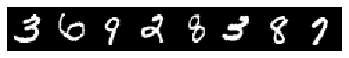

step 4641, loss 0.7044847011566162
Target:	 tensor([0, 3, 8, 4, 4, 1, 9, 1])
Pred:	 tensor([0, 2, 3, 4, 4, 1, 4, 1])


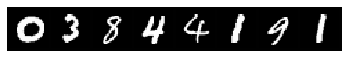

step 4691, loss 0.9550930857658386
Target:	 tensor([6, 7, 1, 3, 0, 7, 4, 0])
Pred:	 tensor([6, 7, 1, 5, 0, 7, 4, 0])


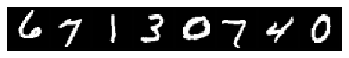

step 4741, loss 0.5695633888244629
Target:	 tensor([2, 6, 0, 3, 7, 4, 9, 7])
Pred:	 tensor([2, 6, 0, 3, 8, 4, 9, 7])


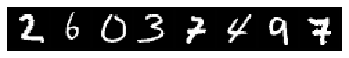

step 4791, loss 0.6243473887443542
Target:	 tensor([2, 5, 2, 5, 2, 5, 6, 0])
Pred:	 tensor([2, 5, 2, 0, 2, 3, 6, 0])


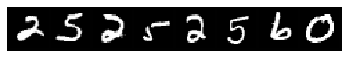

step 4841, loss 0.6778026223182678
Target:	 tensor([4, 7, 3, 6, 2, 1, 1, 6])
Pred:	 tensor([4, 7, 3, 6, 2, 1, 1, 6])


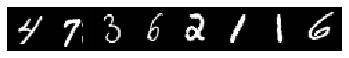

step 4891, loss 0.9444034695625305
Target:	 tensor([7, 3, 8, 5, 1, 0, 3, 2])
Pred:	 tensor([7, 3, 8, 6, 1, 5, 3, 2])


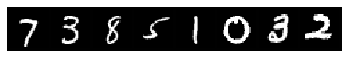

step 4941, loss 0.8958597779273987
Target:	 tensor([4, 1, 8, 3, 8, 1, 8, 4])
Pred:	 tensor([4, 5, 1, 2, 8, 1, 8, 4])


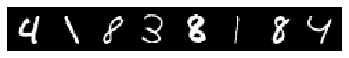

step 4982, loss 1.05352783203125
Target:	 tensor([4, 4, 7, 4, 8, 7, 9, 5])
Pred:	 tensor([5, 4, 9, 0, 8, 7, 9, 5])


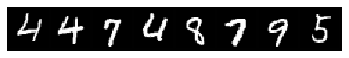

step 5032, loss 0.8791142106056213
Target:	 tensor([0, 2, 9, 4, 5, 4, 7, 4])
Pred:	 tensor([0, 2, 9, 4, 4, 4, 2, 4])


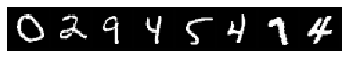

step 5082, loss 0.6285037398338318
Target:	 tensor([5, 4, 3, 7, 5, 6, 7, 7])
Pred:	 tensor([5, 4, 2, 0, 5, 6, 7, 7])


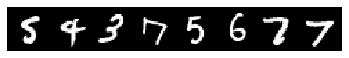

step 5132, loss 0.6696869730949402
Target:	 tensor([0, 3, 1, 0, 6, 7, 6, 8])
Pred:	 tensor([0, 3, 1, 0, 6, 7, 6, 8])


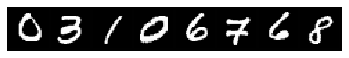

step 5182, loss 1.052085518836975
Target:	 tensor([7, 4, 2, 3, 3, 8, 8, 5])
Pred:	 tensor([7, 8, 2, 3, 2, 8, 8, 3])


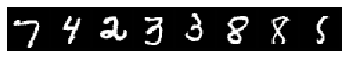

step 5232, loss 0.6655974984169006
Target:	 tensor([8, 0, 1, 7, 5, 1, 6, 5])
Pred:	 tensor([8, 0, 1, 4, 5, 1, 6, 5])


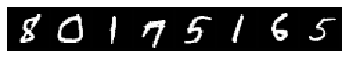

step 5282, loss 0.772352397441864
Target:	 tensor([7, 1, 2, 7, 3, 6, 3, 1])
Pred:	 tensor([3, 1, 2, 5, 3, 6, 3, 1])


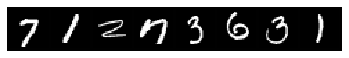

step 5332, loss 0.7890190482139587
Target:	 tensor([7, 1, 1, 1, 3, 4, 6, 6])
Pred:	 tensor([7, 1, 1, 1, 3, 4, 6, 6])


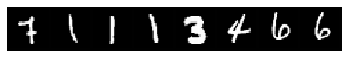

step 5382, loss 0.6095097661018372
Target:	 tensor([8, 6, 4, 9, 6, 3, 6, 5])
Pred:	 tensor([8, 6, 4, 9, 6, 2, 6, 5])


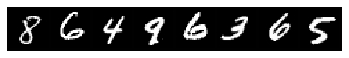

step 5432, loss 0.6394245028495789
Target:	 tensor([7, 5, 7, 8, 0, 0, 2, 9])
Pred:	 tensor([7, 5, 7, 9, 9, 0, 2, 9])


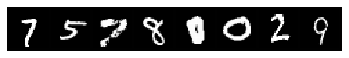

step 5482, loss 0.5343227982521057
Target:	 tensor([2, 0, 8, 8, 7, 0, 5, 6])
Pred:	 tensor([2, 0, 5, 8, 7, 0, 5, 6])


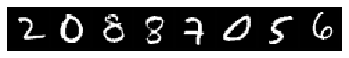

step 5532, loss 0.7474537491798401
Target:	 tensor([7, 0, 0, 9, 0, 6, 0, 7])
Pred:	 tensor([7, 0, 0, 4, 0, 6, 2, 7])


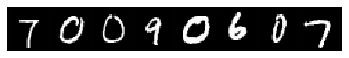

step 5582, loss 0.5407528877258301
Target:	 tensor([0, 8, 4, 1, 4, 4, 3, 0])
Pred:	 tensor([0, 8, 4, 1, 4, 4, 3, 0])


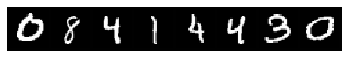

step 5632, loss 0.45562100410461426
Target:	 tensor([6, 0, 1, 2, 5, 1, 7, 1])
Pred:	 tensor([6, 0, 1, 2, 5, 1, 7, 1])


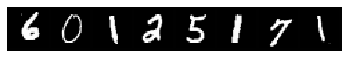

step 5682, loss 0.7272806763648987
Target:	 tensor([3, 7, 4, 1, 7, 5, 5, 8])
Pred:	 tensor([3, 7, 4, 1, 7, 5, 5, 1])


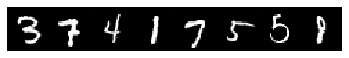

step 5732, loss 0.5545225143432617
Target:	 tensor([1, 3, 0, 7, 9, 6, 2, 0])
Pred:	 tensor([1, 8, 0, 7, 9, 6, 2, 0])


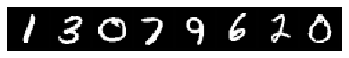

step 5782, loss 0.9266462326049805
Target:	 tensor([8, 9, 5, 7, 6, 8, 5, 3])
Pred:	 tensor([5, 9, 6, 7, 0, 2, 5, 5])


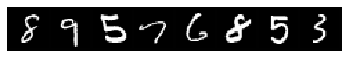

step 5832, loss 0.7891066670417786
Target:	 tensor([5, 9, 0, 8, 5, 4, 3, 5])
Pred:	 tensor([5, 4, 0, 8, 6, 4, 3, 8])


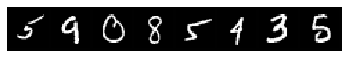

step 5882, loss 0.6930217742919922
Target:	 tensor([1, 3, 2, 3, 7, 9, 4, 1])
Pred:	 tensor([2, 3, 2, 3, 7, 9, 4, 1])


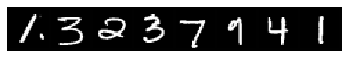

step 5932, loss 1.5321274995803833
Target:	 tensor([8, 2, 7, 4, 6, 1, 3, 6])
Pred:	 tensor([9, 6, 0, 4, 6, 1, 3, 6])


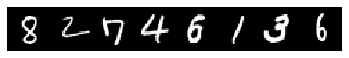

step 5982, loss 0.785581111907959
Target:	 tensor([7, 8, 8, 0, 1, 6, 5, 2])
Pred:	 tensor([9, 8, 8, 0, 1, 0, 3, 2])


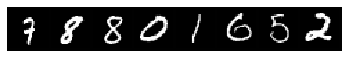

step 6032, loss 0.6289206743240356
Target:	 tensor([7, 8, 4, 1, 2, 3, 9, 2])
Pred:	 tensor([7, 8, 4, 1, 2, 3, 9, 2])


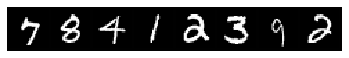

step 6082, loss 0.6784670948982239
Target:	 tensor([4, 7, 0, 2, 0, 0, 1, 5])
Pred:	 tensor([4, 7, 0, 3, 0, 0, 1, 5])


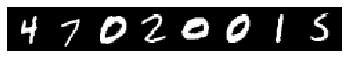

step 6132, loss 0.8659462928771973
Target:	 tensor([0, 5, 5, 1, 5, 8, 4, 6])
Pred:	 tensor([0, 4, 5, 1, 5, 8, 4, 6])


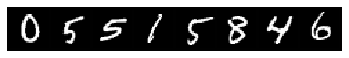

step 6182, loss 0.6288923621177673
Target:	 tensor([1, 8, 0, 4, 1, 8, 0, 8])
Pred:	 tensor([1, 8, 0, 4, 1, 8, 0, 4])


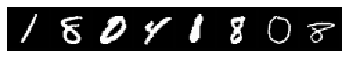

step 6232, loss 0.8896611332893372
Target:	 tensor([4, 9, 0, 8, 7, 8, 2, 4])
Pred:	 tensor([9, 9, 0, 5, 7, 8, 2, 4])


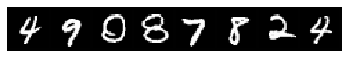

step 6282, loss 0.6417679190635681
Target:	 tensor([7, 1, 4, 8, 1, 2, 5, 1])
Pred:	 tensor([7, 1, 4, 8, 1, 2, 5, 1])


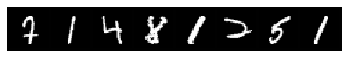

step 6332, loss 1.0113509893417358
Target:	 tensor([2, 7, 9, 7, 7, 9, 7, 5])
Pred:	 tensor([8, 9, 9, 7, 7, 9, 7, 5])


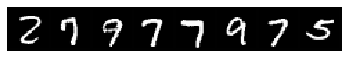

step 6382, loss 0.8023102283477783
Target:	 tensor([1, 6, 7, 6, 8, 2, 9, 2])
Pred:	 tensor([1, 6, 1, 6, 8, 2, 4, 2])


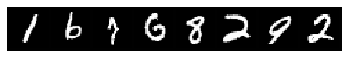

step 6432, loss 0.5661777853965759
Target:	 tensor([2, 5, 8, 4, 3, 1, 9, 2])
Pred:	 tensor([2, 5, 7, 4, 3, 1, 9, 2])


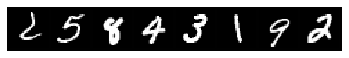

step 6482, loss 0.5065091848373413
Target:	 tensor([9, 3, 7, 9, 3, 9, 9, 4])
Pred:	 tensor([9, 3, 7, 9, 3, 9, 9, 4])


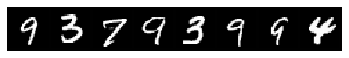

step 6532, loss 0.8316310048103333
Target:	 tensor([5, 7, 6, 7, 3, 4, 3, 7])
Pred:	 tensor([8, 7, 2, 7, 3, 9, 3, 7])


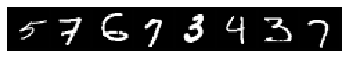

step 6582, loss 0.4704577624797821
Target:	 tensor([6, 2, 9, 8, 0, 1, 3, 5])
Pred:	 tensor([6, 2, 9, 8, 0, 1, 3, 5])


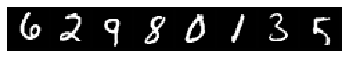

step 6632, loss 0.726544201374054
Target:	 tensor([0, 7, 1, 6, 9, 1, 6, 0])
Pred:	 tensor([0, 7, 1, 6, 4, 1, 0, 3])


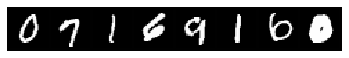

step 6682, loss 1.0368221998214722
Target:	 tensor([0, 1, 9, 8, 9, 0, 6, 3])
Pred:	 tensor([5, 8, 9, 7, 9, 0, 6, 3])


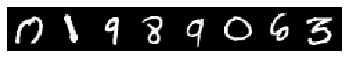

step 6732, loss 0.7842146754264832
Target:	 tensor([6, 5, 1, 1, 5, 3, 2, 6])
Pred:	 tensor([6, 0, 0, 1, 7, 3, 2, 6])


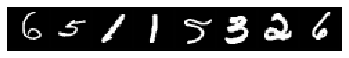

step 6782, loss 0.5309467315673828
Target:	 tensor([4, 3, 2, 7, 9, 8, 6, 0])
Pred:	 tensor([4, 3, 6, 7, 9, 8, 6, 0])


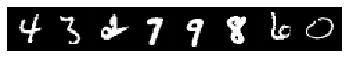

step 6832, loss 0.6739599108695984
Target:	 tensor([5, 1, 7, 6, 4, 6, 9, 3])
Pred:	 tensor([5, 1, 7, 6, 4, 6, 9, 3])


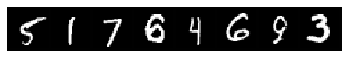

step 6882, loss 1.0011870861053467
Target:	 tensor([5, 6, 3, 8, 8, 1, 2, 3])
Pred:	 tensor([5, 6, 2, 8, 8, 1, 2, 3])


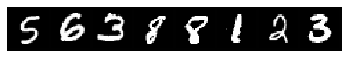

step 6932, loss 0.9091615080833435
Target:	 tensor([0, 4, 0, 9, 8, 6, 7, 2])
Pred:	 tensor([0, 9, 0, 9, 8, 5, 9, 2])


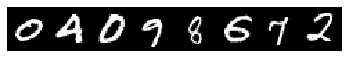

step 6982, loss 0.7607736587524414
Target:	 tensor([1, 1, 7, 9, 1, 8, 5, 7])
Pred:	 tensor([1, 0, 7, 9, 1, 8, 5, 7])


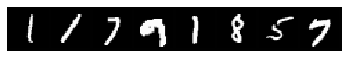

step 7032, loss 0.7394206523895264
Target:	 tensor([4, 3, 4, 3, 0, 7, 0, 8])
Pred:	 tensor([4, 3, 4, 3, 0, 7, 0, 8])


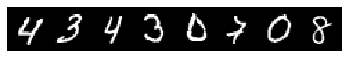

step 7082, loss 0.7662396430969238
Target:	 tensor([5, 5, 4, 5, 9, 5, 8, 0])
Pred:	 tensor([5, 5, 8, 5, 9, 5, 8, 0])


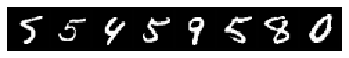

step 7132, loss 0.656075656414032
Target:	 tensor([0, 9, 6, 2, 4, 7, 6, 2])
Pred:	 tensor([0, 7, 6, 2, 4, 7, 8, 2])


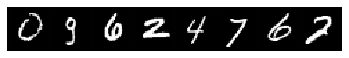

step 7182, loss 0.9138057231903076
Target:	 tensor([0, 8, 9, 9, 9, 6, 1, 9])
Pred:	 tensor([0, 8, 9, 9, 9, 6, 1, 7])


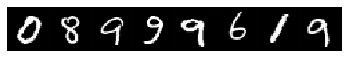

step 7232, loss 0.7129079699516296
Target:	 tensor([8, 3, 7, 8, 2, 1, 5, 1])
Pred:	 tensor([7, 1, 5, 8, 2, 1, 8, 1])


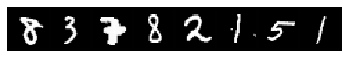

step 7282, loss 0.7499423027038574
Target:	 tensor([7, 7, 5, 5, 1, 5, 3, 9])
Pred:	 tensor([7, 7, 2, 5, 1, 6, 3, 4])


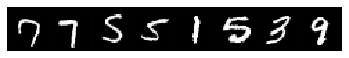

step 7332, loss 0.620356023311615
Target:	 tensor([5, 8, 7, 9, 9, 2, 0, 8])
Pred:	 tensor([5, 8, 7, 1, 4, 2, 0, 8])


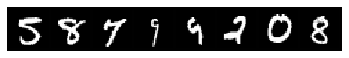

step 7382, loss 0.9351703524589539
Target:	 tensor([6, 7, 5, 1, 9, 2, 1, 0])
Pred:	 tensor([6, 7, 6, 1, 9, 2, 1, 0])


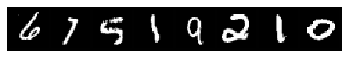

step 7432, loss 0.6552024483680725
Target:	 tensor([6, 6, 3, 6, 2, 1, 6, 3])
Pred:	 tensor([6, 6, 3, 6, 2, 1, 6, 3])


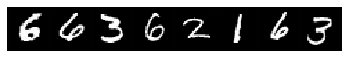

step 7473, loss 0.9210822582244873
Target:	 tensor([7, 2, 9, 4, 0, 1, 0, 9])
Pred:	 tensor([7, 2, 9, 7, 0, 1, 0, 9])


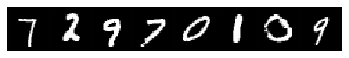

step 7523, loss 0.7960545420646667
Target:	 tensor([4, 7, 7, 0, 0, 9, 4, 5])
Pred:	 tensor([4, 7, 7, 0, 0, 7, 4, 5])


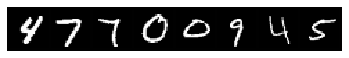

step 7573, loss 0.7379270195960999
Target:	 tensor([4, 7, 5, 2, 8, 6, 5, 7])
Pred:	 tensor([4, 8, 0, 2, 8, 6, 5, 7])


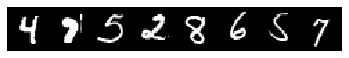

step 7623, loss 0.7086248397827148
Target:	 tensor([7, 9, 6, 3, 3, 2, 1, 6])
Pred:	 tensor([7, 4, 6, 3, 2, 0, 6, 6])


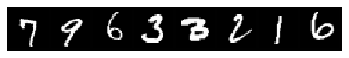

step 7673, loss 0.29837360978126526
Target:	 tensor([9, 0, 8, 0, 7, 4, 6, 0])
Pred:	 tensor([9, 0, 8, 0, 7, 4, 6, 0])


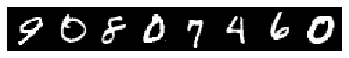

step 7723, loss 0.6470170021057129
Target:	 tensor([7, 9, 9, 4, 0, 1, 2, 4])
Pred:	 tensor([7, 9, 9, 4, 8, 1, 3, 4])


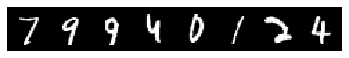

step 7773, loss 0.8187292218208313
Target:	 tensor([0, 6, 2, 1, 0, 7, 9, 9])
Pred:	 tensor([0, 6, 7, 1, 0, 7, 8, 9])


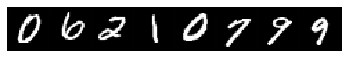

step 7823, loss 0.6603399515151978
Target:	 tensor([9, 7, 5, 2, 4, 1, 0, 4])
Pred:	 tensor([9, 7, 5, 2, 8, 1, 0, 4])


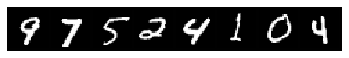

step 7873, loss 0.5352140665054321
Target:	 tensor([5, 7, 2, 1, 7, 4, 8, 6])
Pred:	 tensor([5, 7, 2, 1, 7, 4, 5, 6])


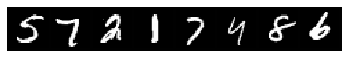

step 7923, loss 0.6446788311004639
Target:	 tensor([9, 5, 1, 1, 5, 2, 3, 3])
Pred:	 tensor([9, 5, 1, 1, 5, 2, 3, 9])


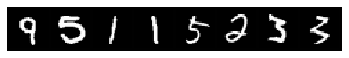

step 7973, loss 1.1950476169586182
Target:	 tensor([5, 4, 4, 5, 1, 4, 2, 9])
Pred:	 tensor([5, 9, 4, 3, 1, 9, 9, 9])


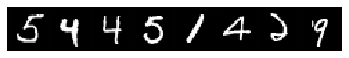

step 8023, loss 0.5712049603462219
Target:	 tensor([6, 2, 1, 9, 3, 6, 5, 2])
Pred:	 tensor([6, 2, 1, 9, 3, 6, 6, 2])


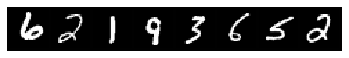

step 8073, loss 0.9543958306312561
Target:	 tensor([0, 5, 5, 5, 1, 9, 4, 5])
Pred:	 tensor([0, 5, 0, 5, 1, 9, 4, 5])


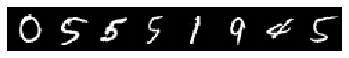

step 8123, loss 0.4729219377040863
Target:	 tensor([2, 6, 6, 3, 7, 5, 4, 1])
Pred:	 tensor([2, 6, 6, 3, 7, 5, 4, 1])


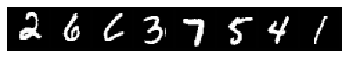

step 8173, loss 0.5673900842666626
Target:	 tensor([3, 7, 5, 6, 4, 4, 4, 4])
Pred:	 tensor([3, 7, 5, 6, 4, 4, 4, 4])


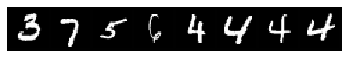

step 8223, loss 0.3995629549026489
Target:	 tensor([3, 9, 0, 7, 7, 1, 5, 4])
Pred:	 tensor([3, 9, 2, 7, 7, 1, 5, 4])


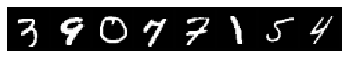

step 8273, loss 0.3948320150375366
Target:	 tensor([4, 0, 7, 4, 4, 9, 8, 9])
Pred:	 tensor([4, 0, 7, 4, 4, 9, 8, 9])


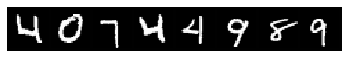

step 8323, loss 0.7799964547157288
Target:	 tensor([3, 2, 6, 9, 3, 5, 3, 7])
Pred:	 tensor([2, 2, 6, 7, 0, 5, 3, 7])


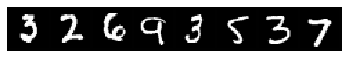

step 8373, loss 0.6377661824226379
Target:	 tensor([3, 2, 3, 7, 3, 2, 0, 6])
Pred:	 tensor([2, 7, 3, 7, 3, 2, 0, 6])


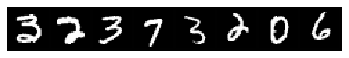

step 8423, loss 0.8216848373413086
Target:	 tensor([9, 1, 4, 7, 4, 8, 4, 0])
Pred:	 tensor([9, 1, 4, 7, 4, 2, 4, 0])


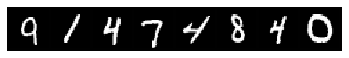

step 8473, loss 0.7750688195228577
Target:	 tensor([0, 7, 9, 2, 4, 4, 1, 7])
Pred:	 tensor([0, 7, 9, 2, 4, 4, 1, 4])


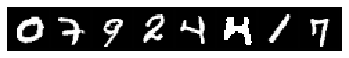

step 8523, loss 0.5755475163459778
Target:	 tensor([7, 6, 8, 9, 2, 0, 6, 5])
Pred:	 tensor([7, 6, 8, 9, 2, 0, 6, 5])


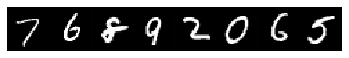

step 8573, loss 0.9232049584388733
Target:	 tensor([3, 0, 3, 6, 7, 7, 3, 1])
Pred:	 tensor([2, 0, 3, 6, 7, 7, 3, 1])


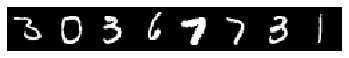

step 8623, loss 0.5182545781135559
Target:	 tensor([9, 2, 0, 2, 2, 8, 5, 5])
Pred:	 tensor([9, 2, 0, 6, 2, 8, 5, 5])


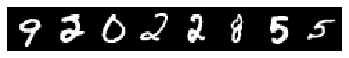

step 8673, loss 0.6430105566978455
Target:	 tensor([4, 9, 5, 9, 6, 9, 5, 4])
Pred:	 tensor([4, 9, 6, 9, 6, 9, 1, 4])


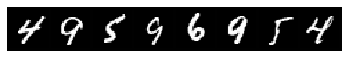

step 8723, loss 0.702700138092041
Target:	 tensor([4, 8, 9, 0, 2, 4, 1, 4])
Pred:	 tensor([4, 8, 0, 0, 2, 4, 1, 4])


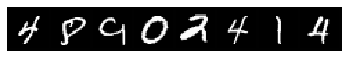

step 8773, loss 0.6488158106803894
Target:	 tensor([1, 6, 8, 2, 7, 3, 9, 2])
Pred:	 tensor([1, 6, 8, 8, 7, 3, 9, 2])


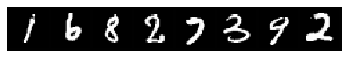

step 8823, loss 0.7069797515869141
Target:	 tensor([1, 8, 6, 2, 9, 4, 6, 9])
Pred:	 tensor([1, 8, 6, 2, 9, 4, 6, 9])


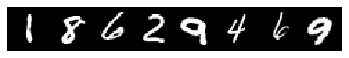

step 8873, loss 0.7431285977363586
Target:	 tensor([2, 0, 2, 7, 1, 2, 0, 2])
Pred:	 tensor([2, 0, 2, 7, 1, 6, 0, 2])


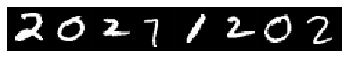

step 8923, loss 0.5855187773704529
Target:	 tensor([4, 1, 8, 1, 9, 8, 1, 7])
Pred:	 tensor([6, 1, 8, 1, 9, 8, 1, 7])


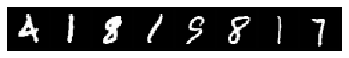

step 8973, loss 0.6330705285072327
Target:	 tensor([9, 6, 2, 7, 9, 2, 2, 4])
Pred:	 tensor([4, 6, 2, 7, 9, 2, 2, 9])


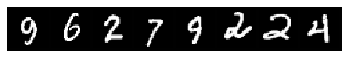

step 9023, loss 0.4347250759601593
Target:	 tensor([7, 4, 9, 2, 6, 4, 5, 2])
Pred:	 tensor([7, 4, 9, 2, 6, 4, 5, 2])


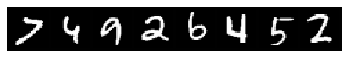

step 9073, loss 0.5974439382553101
Target:	 tensor([7, 6, 4, 9, 5, 9, 2, 5])
Pred:	 tensor([7, 4, 4, 9, 6, 9, 2, 8])


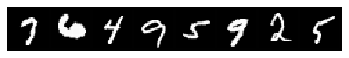

step 9123, loss 0.995530366897583
Target:	 tensor([0, 9, 0, 2, 3, 6, 6, 6])
Pred:	 tensor([0, 9, 0, 2, 3, 6, 6, 6])


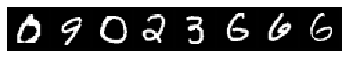

step 9173, loss 0.8007445931434631
Target:	 tensor([6, 3, 4, 3, 5, 3, 2, 7])
Pred:	 tensor([6, 3, 9, 3, 0, 5, 2, 7])


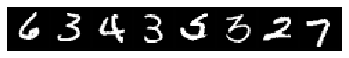

step 9223, loss 0.5934385657310486
Target:	 tensor([8, 1, 1, 1, 6, 7, 2, 9])
Pred:	 tensor([7, 1, 1, 1, 6, 7, 2, 4])


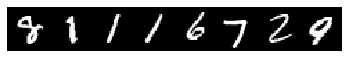

step 9273, loss 0.5860449075698853
Target:	 tensor([2, 2, 0, 7, 0, 6, 1, 8])
Pred:	 tensor([2, 2, 0, 7, 0, 6, 1, 8])


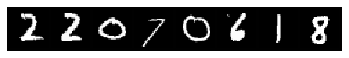

step 9323, loss 0.8157708048820496
Target:	 tensor([9, 8, 3, 3, 1, 0, 8, 1])
Pred:	 tensor([9, 2, 3, 3, 1, 0, 8, 1])


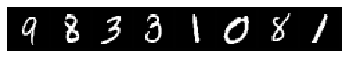

step 9373, loss 0.7021710872650146
Target:	 tensor([3, 1, 3, 7, 0, 6, 8, 8])
Pred:	 tensor([3, 1, 7, 7, 0, 6, 8, 8])


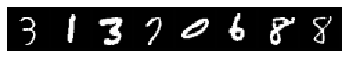

step 9423, loss 0.7714481949806213
Target:	 tensor([2, 4, 5, 2, 5, 8, 5, 9])
Pred:	 tensor([0, 6, 3, 2, 5, 8, 5, 9])


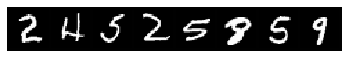

step 9473, loss 0.5182808637619019
Target:	 tensor([0, 5, 7, 8, 8, 5, 3, 4])
Pred:	 tensor([0, 5, 7, 8, 8, 5, 3, 4])


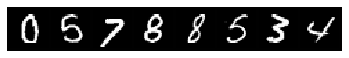

step 9523, loss 0.7704700827598572
Target:	 tensor([6, 9, 1, 6, 2, 1, 4, 8])
Pred:	 tensor([6, 9, 1, 6, 2, 1, 4, 8])


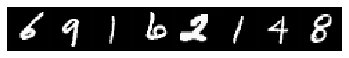

step 9573, loss 0.7438347339630127
Target:	 tensor([8, 1, 9, 7, 4, 8, 1, 9])
Pred:	 tensor([1, 1, 4, 7, 4, 8, 1, 9])


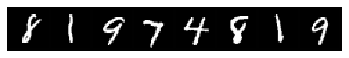

step 9623, loss 0.4418841600418091
Target:	 tensor([0, 2, 2, 6, 1, 8, 9, 0])
Pred:	 tensor([0, 3, 7, 6, 1, 8, 9, 0])


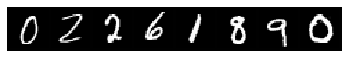

step 9673, loss 0.8503537774085999
Target:	 tensor([7, 7, 6, 7, 9, 8, 3, 1])
Pred:	 tensor([4, 7, 6, 4, 9, 8, 3, 1])


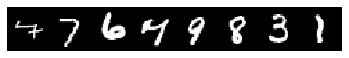

step 9723, loss 0.5418878793716431
Target:	 tensor([1, 2, 4, 3, 8, 1, 1, 6])
Pred:	 tensor([1, 2, 4, 3, 8, 1, 1, 6])


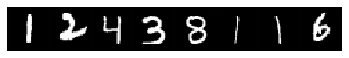

step 9773, loss 0.746117115020752
Target:	 tensor([1, 6, 6, 0, 6, 3, 8, 4])
Pred:	 tensor([1, 6, 6, 0, 6, 8, 8, 4])


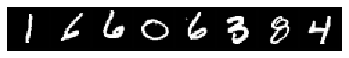

step 9823, loss 0.9125399589538574
Target:	 tensor([8, 6, 8, 2, 1, 6, 8, 4])
Pred:	 tensor([8, 6, 8, 2, 1, 6, 8, 4])


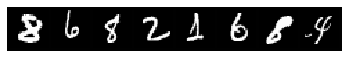

step 9873, loss 0.7286314368247986
Target:	 tensor([4, 4, 5, 9, 9, 7, 1, 5])
Pred:	 tensor([4, 6, 5, 9, 9, 7, 1, 5])


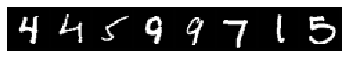

step 9923, loss 0.8282461166381836
Target:	 tensor([1, 3, 9, 3, 0, 0, 6, 7])
Pred:	 tensor([1, 5, 9, 2, 0, 0, 5, 4])


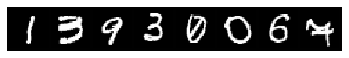

step 9964, loss 0.5265463590621948
Target:	 tensor([3, 1, 6, 4, 3, 0, 2, 3])
Pred:	 tensor([3, 1, 6, 4, 0, 0, 2, 3])


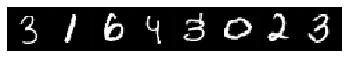

step 10014, loss 0.7264193892478943
Target:	 tensor([3, 9, 6, 4, 6, 6, 8, 3])
Pred:	 tensor([3, 9, 6, 4, 6, 6, 8, 3])


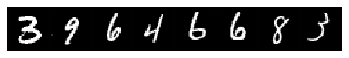

step 10064, loss 0.5388245582580566
Target:	 tensor([7, 1, 9, 8, 3, 9, 3, 6])
Pred:	 tensor([7, 1, 9, 8, 3, 9, 3, 6])


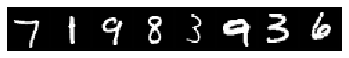

step 10114, loss 0.8776984214782715
Target:	 tensor([7, 0, 4, 6, 3, 5, 0, 9])
Pred:	 tensor([7, 0, 4, 6, 2, 3, 0, 9])


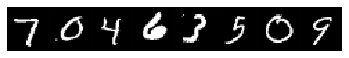

step 10164, loss 0.8952043056488037
Target:	 tensor([5, 2, 2, 4, 6, 2, 6, 1])
Pred:	 tensor([9, 2, 2, 4, 6, 6, 6, 6])


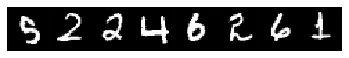

step 10214, loss 0.7350029945373535
Target:	 tensor([1, 8, 3, 4, 5, 1, 8, 2])
Pred:	 tensor([1, 8, 3, 4, 8, 1, 8, 2])


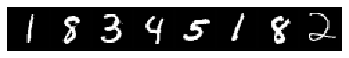

step 10264, loss 0.626917839050293
Target:	 tensor([1, 0, 1, 3, 2, 8, 9, 8])
Pred:	 tensor([1, 0, 1, 3, 2, 8, 9, 8])


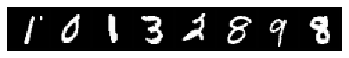

step 10314, loss 0.8101531863212585
Target:	 tensor([0, 2, 0, 4, 3, 6, 8, 9])
Pred:	 tensor([0, 2, 0, 4, 3, 6, 1, 9])


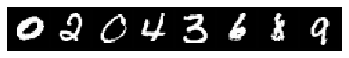

step 10364, loss 0.6795296669006348
Target:	 tensor([7, 6, 7, 9, 3, 2, 1, 6])
Pred:	 tensor([7, 6, 7, 9, 3, 3, 1, 6])


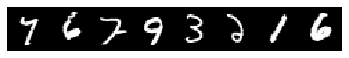

step 10414, loss 0.706046998500824
Target:	 tensor([7, 9, 4, 2, 6, 3, 8, 8])
Pred:	 tensor([7, 9, 4, 2, 4, 3, 8, 5])


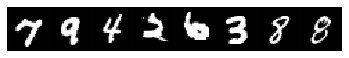

step 10464, loss 0.8042581677436829
Target:	 tensor([0, 2, 1, 9, 7, 0, 1, 8])
Pred:	 tensor([0, 2, 1, 9, 7, 0, 1, 8])


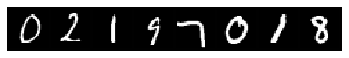

step 10514, loss 0.8624016642570496
Target:	 tensor([9, 4, 8, 2, 9, 7, 1, 5])
Pred:	 tensor([9, 4, 1, 2, 9, 7, 1, 5])


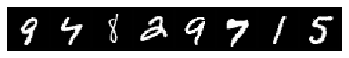

step 10564, loss 0.7177172303199768
Target:	 tensor([1, 4, 9, 8, 0, 0, 1, 1])
Pred:	 tensor([1, 4, 9, 8, 0, 0, 1, 1])


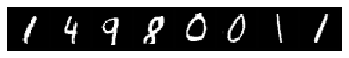

step 10614, loss 0.779085636138916
Target:	 tensor([8, 1, 7, 4, 1, 4, 7, 3])
Pred:	 tensor([8, 3, 2, 4, 1, 4, 7, 5])


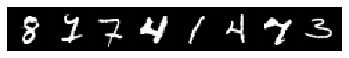

step 10664, loss 0.7738034129142761
Target:	 tensor([3, 7, 2, 1, 7, 3, 9, 9])
Pred:	 tensor([3, 7, 7, 1, 7, 5, 8, 9])


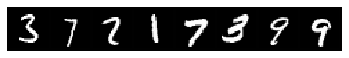

step 10714, loss 0.5090967416763306
Target:	 tensor([3, 9, 7, 1, 5, 5, 8, 5])
Pred:	 tensor([3, 9, 7, 1, 5, 5, 8, 5])


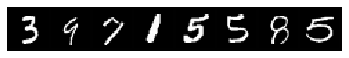

step 10764, loss 0.7074568867683411
Target:	 tensor([3, 2, 5, 6, 1, 7, 1, 9])
Pred:	 tensor([3, 2, 6, 6, 1, 7, 1, 9])


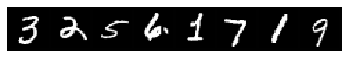

step 10814, loss 0.8167468905448914
Target:	 tensor([3, 1, 3, 2, 2, 5, 2, 6])
Pred:	 tensor([1, 1, 3, 2, 2, 4, 7, 6])


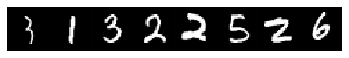

step 10864, loss 0.6177996397018433
Target:	 tensor([6, 3, 1, 9, 5, 1, 1, 0])
Pred:	 tensor([6, 3, 1, 9, 6, 1, 1, 0])


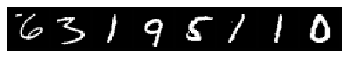

step 10914, loss 0.7164104580879211
Target:	 tensor([4, 9, 2, 3, 5, 2, 7, 6])
Pred:	 tensor([9, 4, 2, 3, 5, 2, 7, 6])


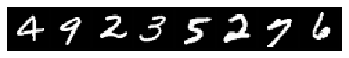

step 10964, loss 0.5199390053749084
Target:	 tensor([2, 0, 7, 7, 4, 2, 6, 1])
Pred:	 tensor([2, 0, 2, 7, 4, 2, 4, 1])


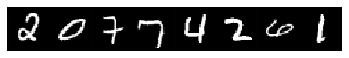

step 11014, loss 0.5636335015296936
Target:	 tensor([4, 0, 4, 2, 3, 0, 0, 3])
Pred:	 tensor([4, 0, 4, 2, 3, 0, 0, 3])


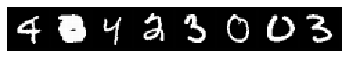

step 11064, loss 0.6505467295646667
Target:	 tensor([6, 0, 0, 1, 2, 4, 9, 2])
Pred:	 tensor([6, 0, 0, 1, 2, 4, 9, 2])


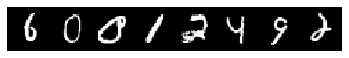

step 11114, loss 0.7517860531806946
Target:	 tensor([1, 5, 6, 6, 4, 5, 8, 1])
Pred:	 tensor([1, 9, 6, 6, 4, 5, 8, 1])


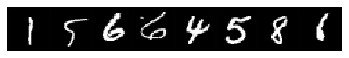

step 11164, loss 0.8739733099937439
Target:	 tensor([8, 1, 7, 6, 6, 4, 7, 3])
Pred:	 tensor([8, 1, 7, 8, 6, 4, 7, 4])


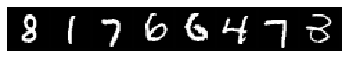

step 11214, loss 0.9940683245658875
Target:	 tensor([4, 9, 8, 5, 8, 1, 5, 7])
Pred:	 tensor([4, 4, 8, 5, 1, 1, 5, 7])


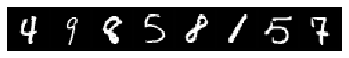

step 11264, loss 0.5794493556022644
Target:	 tensor([8, 0, 2, 3, 8, 1, 4, 6])
Pred:	 tensor([8, 0, 2, 3, 8, 1, 4, 6])


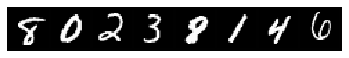

step 11314, loss 0.6846529841423035
Target:	 tensor([5, 9, 7, 7, 7, 0, 5, 3])
Pred:	 tensor([5, 9, 7, 7, 7, 0, 5, 3])


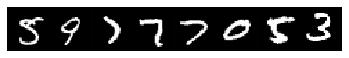

step 11364, loss 0.8777976632118225
Target:	 tensor([3, 5, 4, 5, 1, 7, 0, 4])
Pred:	 tensor([3, 5, 4, 8, 1, 7, 0, 4])


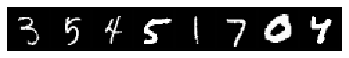

step 11414, loss 0.6648330092430115
Target:	 tensor([4, 4, 6, 5, 7, 8, 2, 9])
Pred:	 tensor([4, 4, 6, 5, 7, 8, 2, 1])


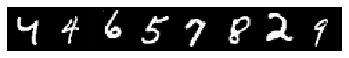

step 11464, loss 0.5367065668106079
Target:	 tensor([8, 2, 7, 7, 7, 7, 4, 9])
Pred:	 tensor([8, 2, 7, 7, 7, 9, 4, 9])


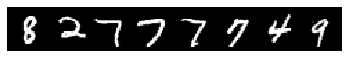

step 11514, loss 0.7033295631408691
Target:	 tensor([1, 0, 9, 4, 3, 5, 4, 8])
Pred:	 tensor([1, 0, 9, 4, 6, 5, 4, 8])


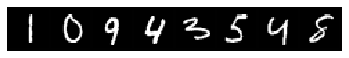

step 11564, loss 1.0288993120193481
Target:	 tensor([7, 1, 9, 4, 5, 0, 6, 1])
Pred:	 tensor([7, 1, 3, 4, 5, 0, 6, 1])


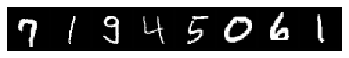

step 11614, loss 0.4847715198993683
Target:	 tensor([1, 8, 6, 2, 6, 4, 0, 9])
Pred:	 tensor([1, 8, 6, 2, 6, 4, 0, 9])


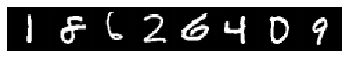

step 11664, loss 0.6910131573677063
Target:	 tensor([3, 3, 7, 1, 7, 6, 8, 1])
Pred:	 tensor([3, 3, 7, 1, 7, 1, 0, 1])


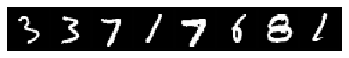

step 11714, loss 0.5797740817070007
Target:	 tensor([1, 9, 7, 3, 6, 6, 6, 5])
Pred:	 tensor([1, 9, 7, 3, 6, 6, 6, 5])


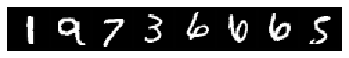

step 11764, loss 0.7041699290275574
Target:	 tensor([3, 7, 2, 2, 8, 8, 1, 6])
Pred:	 tensor([3, 7, 2, 4, 8, 8, 1, 6])


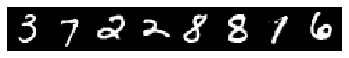

step 11814, loss 0.6464551091194153
Target:	 tensor([2, 1, 3, 7, 7, 5, 5, 3])
Pred:	 tensor([2, 1, 3, 7, 7, 5, 3, 3])


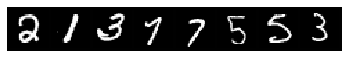

step 11864, loss 0.83305424451828
Target:	 tensor([9, 4, 9, 0, 3, 1, 4, 5])
Pred:	 tensor([9, 4, 9, 0, 5, 1, 4, 5])


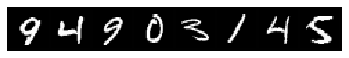

step 11914, loss 0.6026380658149719
Target:	 tensor([4, 6, 9, 5, 0, 6, 9, 5])
Pred:	 tensor([4, 6, 9, 5, 0, 6, 9, 5])


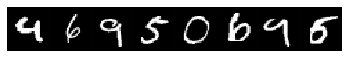

step 11964, loss 0.4966581165790558
Target:	 tensor([4, 4, 6, 0, 1, 9, 7, 9])
Pred:	 tensor([4, 4, 0, 0, 1, 9, 7, 9])


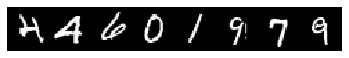

step 12014, loss 0.6488985419273376
Target:	 tensor([2, 0, 8, 6, 1, 1, 3, 6])
Pred:	 tensor([2, 0, 8, 0, 1, 1, 3, 6])


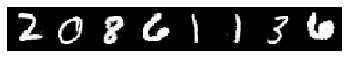

step 12064, loss 0.38319745659828186
Target:	 tensor([3, 5, 9, 3, 1, 7, 3, 8])
Pred:	 tensor([3, 5, 9, 3, 1, 7, 3, 8])


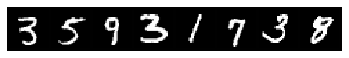

step 12114, loss 0.6178128719329834
Target:	 tensor([4, 7, 1, 6, 3, 0, 9, 2])
Pred:	 tensor([4, 7, 1, 0, 3, 0, 8, 2])


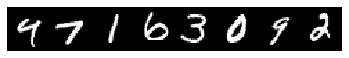

step 12164, loss 0.7434329390525818
Target:	 tensor([4, 3, 2, 1, 7, 9, 9, 1])
Pred:	 tensor([4, 3, 2, 1, 7, 9, 9, 1])


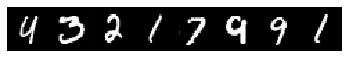

step 12214, loss 0.7362551689147949
Target:	 tensor([0, 0, 0, 6, 5, 0, 0, 6])
Pred:	 tensor([0, 0, 0, 6, 5, 0, 0, 6])


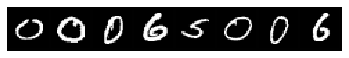

step 12264, loss 0.5773595571517944
Target:	 tensor([0, 6, 4, 1, 5, 3, 9, 0])
Pred:	 tensor([0, 6, 4, 1, 5, 3, 9, 0])


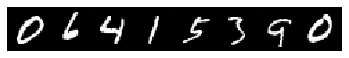

step 12314, loss 0.8438610434532166
Target:	 tensor([9, 7, 2, 6, 0, 6, 3, 3])
Pred:	 tensor([4, 7, 2, 6, 0, 1, 1, 3])


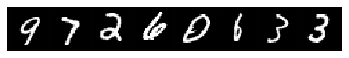

step 12364, loss 0.6990022659301758
Target:	 tensor([6, 4, 0, 6, 7, 7, 1, 3])
Pred:	 tensor([6, 4, 0, 6, 7, 7, 1, 3])


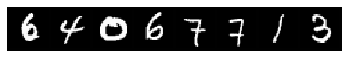

step 12414, loss 0.5688151717185974
Target:	 tensor([8, 9, 0, 2, 2, 2, 3, 2])
Pred:	 tensor([8, 9, 0, 2, 2, 2, 3, 7])


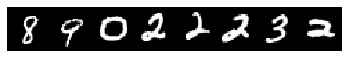

step 12455, loss 0.5990667939186096
Target:	 tensor([3, 6, 5, 1, 5, 6, 6, 2])
Pred:	 tensor([3, 6, 6, 1, 5, 6, 6, 2])


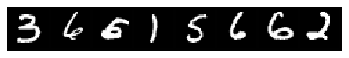

step 12505, loss 0.602544903755188
Target:	 tensor([7, 6, 9, 2, 3, 5, 4, 0])
Pred:	 tensor([7, 6, 9, 8, 0, 5, 6, 0])


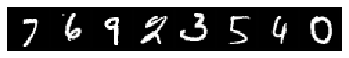

step 12555, loss 0.8167104125022888
Target:	 tensor([2, 0, 6, 2, 1, 5, 1, 4])
Pred:	 tensor([2, 0, 6, 2, 1, 6, 1, 4])


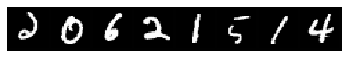

step 12605, loss 0.6351907849311829
Target:	 tensor([6, 1, 8, 5, 5, 9, 0, 3])
Pred:	 tensor([6, 1, 8, 4, 9, 9, 0, 3])


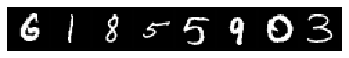

step 12655, loss 0.6699032187461853
Target:	 tensor([3, 6, 9, 9, 2, 2, 4, 4])
Pred:	 tensor([3, 6, 9, 9, 2, 2, 4, 4])


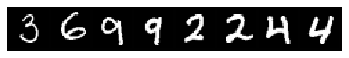

step 12705, loss 0.5607466101646423
Target:	 tensor([2, 6, 9, 1, 7, 5, 3, 4])
Pred:	 tensor([2, 1, 9, 8, 7, 5, 3, 4])


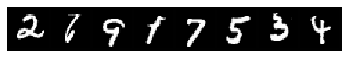

step 12755, loss 0.8434813618659973
Target:	 tensor([3, 6, 4, 4, 7, 5, 7, 3])
Pred:	 tensor([3, 1, 7, 4, 7, 5, 7, 2])


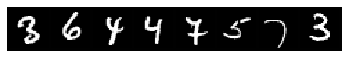

step 12805, loss 0.631425678730011
Target:	 tensor([1, 0, 2, 3, 3, 7, 8, 6])
Pred:	 tensor([1, 0, 2, 3, 5, 7, 8, 6])


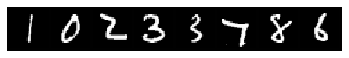

step 12855, loss 0.7900605201721191
Target:	 tensor([4, 5, 6, 0, 4, 4, 5, 6])
Pred:	 tensor([4, 3, 6, 0, 4, 4, 0, 6])


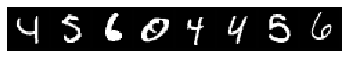

step 12905, loss 0.9574928879737854
Target:	 tensor([2, 9, 0, 8, 8, 9, 8, 1])
Pred:	 tensor([2, 9, 0, 8, 8, 9, 8, 1])


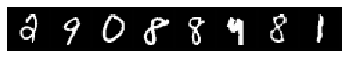

step 12955, loss 0.7483912110328674
Target:	 tensor([0, 9, 6, 0, 4, 1, 3, 9])
Pred:	 tensor([0, 9, 6, 0, 4, 1, 9, 9])


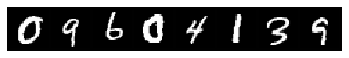

step 13005, loss 0.8203446865081787
Target:	 tensor([0, 7, 8, 0, 9, 2, 5, 8])
Pred:	 tensor([0, 7, 8, 0, 9, 2, 0, 8])


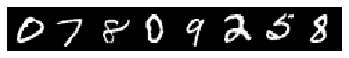

step 13055, loss 0.805704653263092
Target:	 tensor([9, 7, 0, 1, 0, 3, 5, 2])
Pred:	 tensor([9, 7, 0, 1, 0, 3, 5, 2])


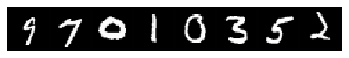

step 13105, loss 0.7927587628364563
Target:	 tensor([9, 8, 6, 9, 0, 3, 1, 6])
Pred:	 tensor([9, 9, 6, 9, 0, 3, 8, 6])


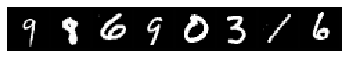

step 13155, loss 0.8752304911613464
Target:	 tensor([3, 1, 6, 2, 6, 3, 1, 3])
Pred:	 tensor([3, 1, 6, 2, 6, 1, 1, 3])


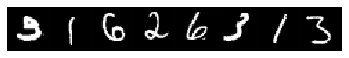

step 13205, loss 0.935271680355072
Target:	 tensor([1, 4, 4, 4, 7, 4, 4, 7])
Pred:	 tensor([1, 4, 4, 4, 8, 4, 4, 1])


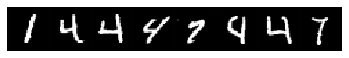

step 13255, loss 0.4942183196544647
Target:	 tensor([5, 1, 6, 5, 3, 3, 0, 3])
Pred:	 tensor([5, 1, 6, 8, 3, 3, 0, 3])


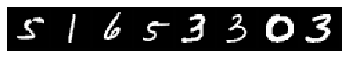

step 13305, loss 0.7073265910148621
Target:	 tensor([3, 6, 1, 5, 8, 3, 7, 6])
Pred:	 tensor([7, 6, 1, 5, 8, 3, 7, 6])


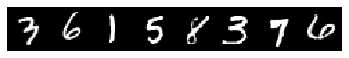

step 13355, loss 0.5994398593902588
Target:	 tensor([7, 3, 9, 0, 1, 2, 5, 9])
Pred:	 tensor([7, 3, 9, 0, 1, 2, 6, 9])


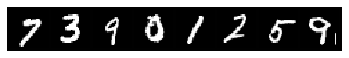

step 13405, loss 0.7374094128608704
Target:	 tensor([0, 6, 2, 4, 1, 1, 9, 9])
Pred:	 tensor([0, 6, 2, 4, 1, 1, 2, 7])


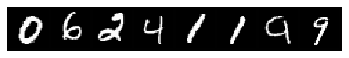

step 13455, loss 0.5556359887123108
Target:	 tensor([8, 3, 1, 4, 4, 2, 7, 4])
Pred:	 tensor([8, 3, 1, 4, 5, 2, 7, 4])


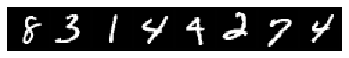

step 13505, loss 0.8110430240631104
Target:	 tensor([1, 3, 0, 9, 0, 8, 1, 0])
Pred:	 tensor([1, 3, 0, 9, 0, 8, 1, 0])


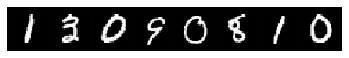

step 13555, loss 0.7731795310974121
Target:	 tensor([7, 2, 7, 1, 5, 2, 8, 7])
Pred:	 tensor([7, 2, 7, 1, 1, 2, 8, 7])


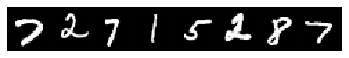

step 13605, loss 0.7729752659797668
Target:	 tensor([6, 3, 2, 8, 1, 3, 7, 1])
Pred:	 tensor([6, 3, 2, 7, 1, 3, 7, 1])


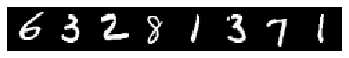

step 13655, loss 0.5157816410064697
Target:	 tensor([8, 2, 0, 4, 7, 6, 0, 2])
Pred:	 tensor([8, 2, 0, 4, 7, 6, 0, 2])


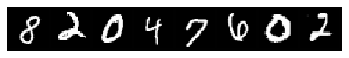

step 13705, loss 0.6041479706764221
Target:	 tensor([4, 1, 6, 4, 9, 3, 2, 4])
Pred:	 tensor([4, 1, 6, 4, 9, 3, 2, 4])


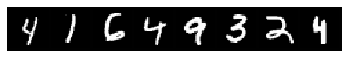

step 13755, loss 0.9046382308006287
Target:	 tensor([1, 3, 7, 4, 5, 1, 6, 0])
Pred:	 tensor([1, 3, 7, 9, 5, 1, 6, 0])


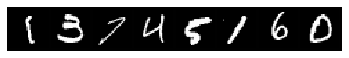

step 13805, loss 0.7268276214599609
Target:	 tensor([2, 3, 3, 8, 7, 4, 2, 4])
Pred:	 tensor([1, 2, 3, 7, 7, 4, 2, 4])


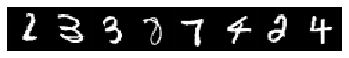

step 13855, loss 0.7491829991340637
Target:	 tensor([6, 6, 0, 8, 1, 9, 3, 1])
Pred:	 tensor([0, 6, 0, 8, 1, 1, 3, 1])


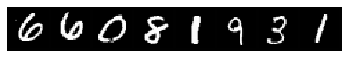

step 13905, loss 0.7864508628845215
Target:	 tensor([8, 3, 7, 3, 9, 4, 5, 2])
Pred:	 tensor([8, 3, 7, 3, 9, 4, 5, 2])


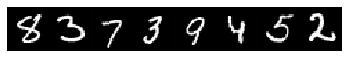

step 13955, loss 0.7104551792144775
Target:	 tensor([7, 8, 9, 2, 1, 7, 1, 4])
Pred:	 tensor([7, 8, 9, 2, 1, 7, 1, 4])


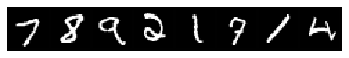

step 14005, loss 0.6796081066131592
Target:	 tensor([8, 8, 5, 7, 3, 1, 4, 6])
Pred:	 tensor([9, 9, 8, 7, 3, 1, 4, 6])


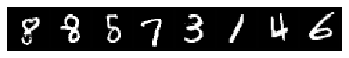

step 14055, loss 0.5410264134407043
Target:	 tensor([9, 6, 0, 3, 4, 5, 5, 7])
Pred:	 tensor([9, 6, 0, 3, 4, 5, 5, 7])


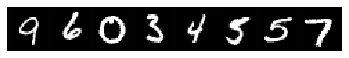

step 14105, loss 0.6497681140899658
Target:	 tensor([3, 9, 9, 5, 9, 9, 8, 5])
Pred:	 tensor([3, 9, 9, 5, 7, 9, 8, 5])


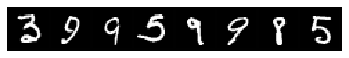

step 14155, loss 0.6905556321144104
Target:	 tensor([7, 4, 0, 4, 9, 8, 5, 2])
Pred:	 tensor([7, 4, 0, 4, 9, 3, 9, 2])


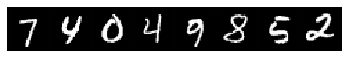

step 14205, loss 0.548768937587738
Target:	 tensor([0, 4, 3, 4, 7, 8, 7, 9])
Pred:	 tensor([0, 4, 2, 4, 7, 8, 7, 9])


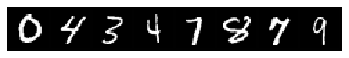

step 14255, loss 0.57950758934021
Target:	 tensor([1, 9, 8, 6, 7, 6, 3, 4])
Pred:	 tensor([1, 9, 8, 6, 7, 6, 3, 4])


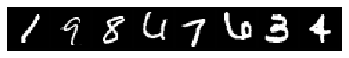

step 14305, loss 0.6960545182228088
Target:	 tensor([5, 6, 1, 1, 7, 6, 2, 2])
Pred:	 tensor([5, 6, 1, 1, 7, 6, 7, 2])


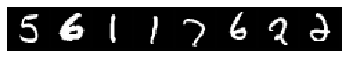

step 14355, loss 0.7345312237739563
Target:	 tensor([6, 8, 1, 4, 5, 5, 8, 7])
Pred:	 tensor([6, 8, 1, 4, 5, 5, 8, 2])


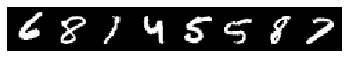

step 14405, loss 0.4816168248653412
Target:	 tensor([9, 5, 7, 0, 7, 9, 6, 0])
Pred:	 tensor([9, 5, 7, 0, 7, 9, 6, 0])


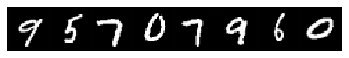

step 14455, loss 0.7437936663627625
Target:	 tensor([1, 1, 8, 9, 6, 0, 2, 2])
Pred:	 tensor([1, 1, 8, 9, 6, 0, 2, 2])


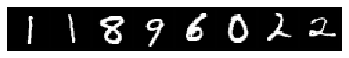

step 14505, loss 0.7849421501159668
Target:	 tensor([4, 8, 6, 2, 0, 9, 7, 4])
Pred:	 tensor([4, 8, 6, 2, 0, 9, 7, 4])


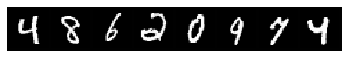

step 14555, loss 0.6394394040107727
Target:	 tensor([7, 8, 8, 4, 7, 2, 3, 0])
Pred:	 tensor([7, 8, 8, 4, 7, 2, 3, 0])


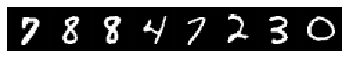

step 14605, loss 0.8606500625610352
Target:	 tensor([4, 8, 2, 1, 8, 5, 7, 0])
Pred:	 tensor([4, 8, 2, 1, 8, 5, 7, 0])


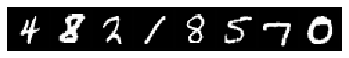

step 14655, loss 0.7008410096168518
Target:	 tensor([3, 7, 2, 2, 4, 7, 4, 7])
Pred:	 tensor([3, 7, 2, 2, 4, 7, 4, 7])


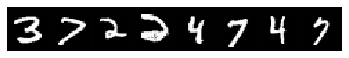

step 14705, loss 0.9350938200950623
Target:	 tensor([2, 5, 3, 7, 7, 5, 4, 5])
Pred:	 tensor([2, 5, 3, 7, 9, 5, 4, 5])


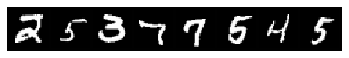

step 14755, loss 0.6557193398475647
Target:	 tensor([3, 9, 9, 0, 0, 7, 9, 7])
Pred:	 tensor([3, 9, 9, 0, 0, 7, 9, 7])


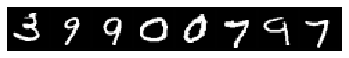

step 14805, loss 0.7387890815734863
Target:	 tensor([9, 3, 1, 1, 2, 6, 1, 1])
Pred:	 tensor([9, 2, 1, 1, 4, 6, 1, 1])


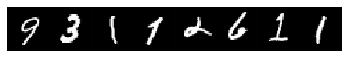

step 14855, loss 0.5018686652183533
Target:	 tensor([6, 9, 9, 1, 8, 0, 3, 7])
Pred:	 tensor([6, 9, 9, 1, 8, 0, 3, 7])


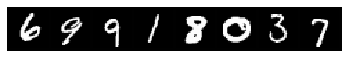

step 14905, loss 0.6719319224357605
Target:	 tensor([1, 2, 1, 7, 7, 7, 4, 3])
Pred:	 tensor([1, 4, 1, 7, 7, 7, 4, 3])


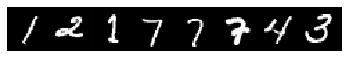

step 14946, loss 1.000953197479248
Target:	 tensor([1, 0, 2, 2, 2, 2, 7, 7])
Pred:	 tensor([1, 9, 2, 2, 2, 3, 7, 7])


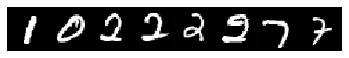

step 14996, loss 0.6191785931587219
Target:	 tensor([7, 2, 1, 8, 0, 6, 2, 5])
Pred:	 tensor([7, 2, 1, 8, 0, 6, 7, 5])


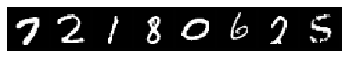

step 15046, loss 0.677189290523529
Target:	 tensor([7, 3, 6, 3, 2, 4, 7, 2])
Pred:	 tensor([7, 3, 6, 2, 2, 4, 7, 2])


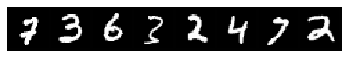

step 15096, loss 0.7121370434761047
Target:	 tensor([7, 5, 9, 9, 1, 9, 7, 7])
Pred:	 tensor([7, 9, 9, 9, 1, 9, 7, 7])


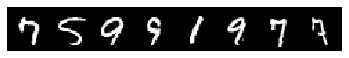

step 15146, loss 0.7501316070556641
Target:	 tensor([6, 7, 7, 7, 8, 8, 2, 0])
Pred:	 tensor([6, 7, 1, 2, 8, 2, 2, 0])


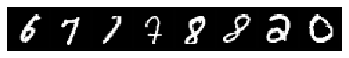

step 15196, loss 0.9777972102165222
Target:	 tensor([0, 1, 9, 5, 7, 6, 4, 9])
Pred:	 tensor([6, 1, 9, 9, 7, 6, 9, 9])


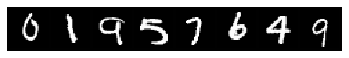

step 15246, loss 0.6587358117103577
Target:	 tensor([7, 7, 0, 6, 2, 6, 6, 1])
Pred:	 tensor([7, 7, 0, 6, 2, 4, 6, 8])


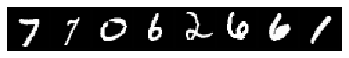

step 15296, loss 0.7046158313751221
Target:	 tensor([5, 5, 7, 1, 6, 2, 3, 2])
Pred:	 tensor([5, 5, 7, 1, 6, 3, 3, 2])


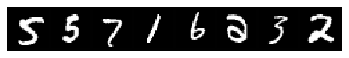

step 15346, loss 0.6585267782211304
Target:	 tensor([3, 1, 0, 1, 3, 4, 2, 8])
Pred:	 tensor([3, 1, 0, 1, 3, 4, 2, 8])


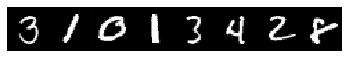

step 15396, loss 0.4584459066390991
Target:	 tensor([2, 2, 1, 7, 9, 7, 8, 2])
Pred:	 tensor([2, 2, 1, 7, 9, 7, 8, 1])


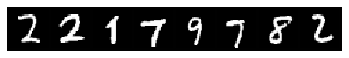

step 15446, loss 0.8759841918945312
Target:	 tensor([7, 4, 9, 2, 2, 0, 6, 7])
Pred:	 tensor([7, 4, 9, 4, 2, 0, 6, 4])


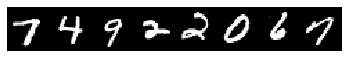

step 15496, loss 0.7285637855529785
Target:	 tensor([2, 7, 0, 6, 3, 3, 1, 4])
Pred:	 tensor([3, 7, 0, 6, 2, 3, 1, 4])


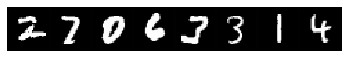

step 15546, loss 0.6041422486305237
Target:	 tensor([1, 1, 1, 7, 4, 1, 7, 9])
Pred:	 tensor([1, 1, 1, 7, 4, 1, 7, 9])


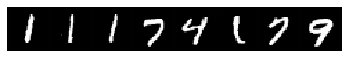

step 15596, loss 0.6850612759590149
Target:	 tensor([2, 8, 2, 2, 6, 4, 3, 1])
Pred:	 tensor([2, 8, 2, 3, 6, 4, 8, 1])


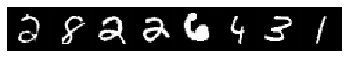

step 15646, loss 0.7856126427650452
Target:	 tensor([5, 9, 2, 6, 7, 3, 4, 0])
Pred:	 tensor([6, 9, 2, 0, 7, 3, 9, 0])


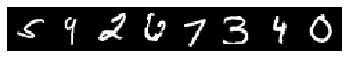

step 15696, loss 0.8935195803642273
Target:	 tensor([8, 0, 8, 6, 2, 9, 7, 9])
Pred:	 tensor([8, 0, 3, 6, 2, 4, 7, 9])


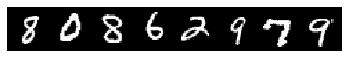

step 15746, loss 0.805101215839386
Target:	 tensor([8, 2, 2, 0, 5, 8, 2, 4])
Pred:	 tensor([8, 2, 6, 0, 5, 8, 6, 4])


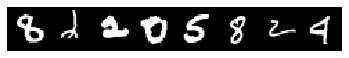

step 15796, loss 0.7430572509765625
Target:	 tensor([4, 0, 4, 0, 6, 0, 1, 9])
Pred:	 tensor([4, 2, 4, 0, 6, 0, 8, 9])


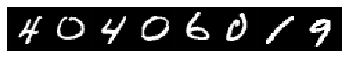

step 15846, loss 0.7852320671081543
Target:	 tensor([1, 9, 0, 6, 4, 2, 4, 9])
Pred:	 tensor([1, 9, 0, 6, 4, 4, 4, 4])


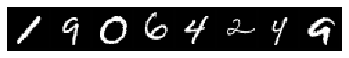

step 15896, loss 0.6805495619773865
Target:	 tensor([3, 6, 0, 7, 0, 3, 0, 7])
Pred:	 tensor([3, 6, 0, 9, 0, 3, 0, 7])


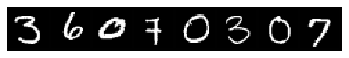

step 15946, loss 0.8010039925575256
Target:	 tensor([4, 0, 2, 5, 4, 9, 5, 2])
Pred:	 tensor([4, 0, 2, 5, 4, 9, 5, 2])


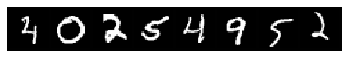

step 15996, loss 0.8380253314971924
Target:	 tensor([4, 9, 2, 4, 3, 6, 0, 1])
Pred:	 tensor([4, 9, 2, 4, 1, 6, 0, 1])


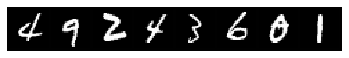

step 16046, loss 0.8097682595252991
Target:	 tensor([1, 9, 2, 9, 6, 3, 1, 5])
Pred:	 tensor([5, 9, 2, 9, 6, 3, 1, 5])


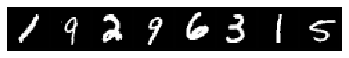

step 16096, loss 0.4526282846927643
Target:	 tensor([5, 4, 3, 9, 6, 7, 6, 1])
Pred:	 tensor([5, 4, 3, 9, 6, 7, 6, 1])


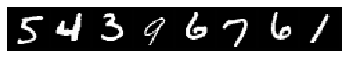

step 16146, loss 0.8275477886199951
Target:	 tensor([4, 2, 9, 2, 6, 5, 8, 6])
Pred:	 tensor([4, 2, 9, 3, 6, 5, 8, 6])


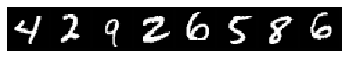

step 16196, loss 0.6095362305641174
Target:	 tensor([9, 1, 3, 1, 3, 9, 8, 0])
Pred:	 tensor([9, 1, 3, 1, 3, 9, 8, 0])


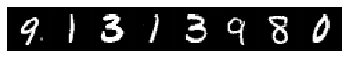

step 16246, loss 0.650349497795105
Target:	 tensor([8, 2, 4, 6, 4, 8, 0, 3])
Pred:	 tensor([8, 2, 4, 6, 4, 8, 0, 3])


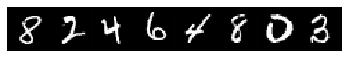

step 16296, loss 0.7590734958648682
Target:	 tensor([1, 4, 3, 3, 2, 0, 9, 8])
Pred:	 tensor([1, 4, 3, 3, 2, 0, 9, 1])


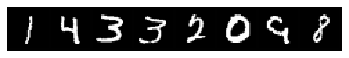

step 16346, loss 1.0211471319198608
Target:	 tensor([9, 9, 4, 4, 1, 8, 5, 1])
Pred:	 tensor([5, 9, 4, 1, 1, 8, 5, 1])


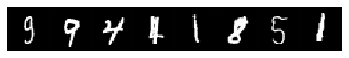

step 16396, loss 0.8312358856201172
Target:	 tensor([1, 4, 9, 9, 9, 4, 8, 4])
Pred:	 tensor([1, 4, 9, 9, 9, 4, 1, 4])


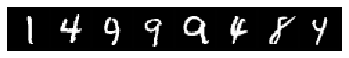

step 16446, loss 0.5043303370475769
Target:	 tensor([3, 2, 2, 4, 4, 0, 9, 4])
Pred:	 tensor([3, 2, 2, 4, 4, 6, 9, 4])


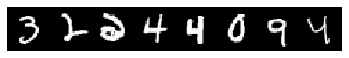

step 16496, loss 0.6014900207519531
Target:	 tensor([2, 0, 1, 4, 0, 4, 8, 2])
Pred:	 tensor([2, 0, 1, 4, 0, 4, 8, 2])


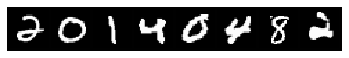

step 16546, loss 0.7582737803459167
Target:	 tensor([3, 2, 9, 1, 7, 4, 4, 7])
Pred:	 tensor([3, 2, 9, 1, 7, 9, 4, 7])


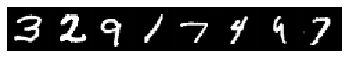

step 16596, loss 0.7822024822235107
Target:	 tensor([4, 0, 7, 4, 3, 0, 4, 7])
Pred:	 tensor([4, 0, 7, 4, 3, 0, 4, 7])


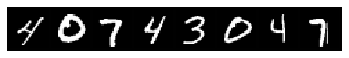

step 16646, loss 0.7818635106086731
Target:	 tensor([8, 4, 4, 2, 6, 3, 6, 5])
Pred:	 tensor([8, 4, 4, 6, 6, 3, 6, 5])


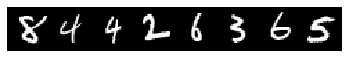

step 16696, loss 0.8287914395332336
Target:	 tensor([9, 3, 2, 3, 5, 8, 6, 3])
Pred:	 tensor([9, 3, 2, 3, 5, 8, 6, 3])


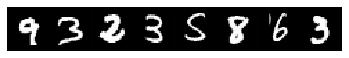

step 16746, loss 0.7678609490394592
Target:	 tensor([6, 3, 7, 8, 3, 6, 5, 3])
Pred:	 tensor([2, 3, 7, 8, 3, 6, 5, 3])


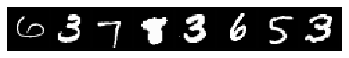

step 16796, loss 0.9137921333312988
Target:	 tensor([8, 2, 5, 6, 6, 2, 2, 0])
Pred:	 tensor([5, 4, 8, 6, 6, 2, 2, 0])


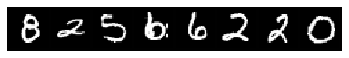

step 16846, loss 0.8727285861968994
Target:	 tensor([3, 9, 1, 0, 1, 5, 3, 2])
Pred:	 tensor([3, 9, 1, 0, 8, 8, 8, 2])


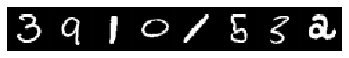

step 16896, loss 0.7232725024223328
Target:	 tensor([7, 7, 4, 8, 7, 6, 5, 0])
Pred:	 tensor([7, 7, 4, 8, 7, 6, 5, 0])


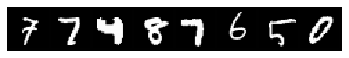

step 16946, loss 0.708489179611206
Target:	 tensor([7, 0, 0, 3, 6, 4, 0, 6])
Pred:	 tensor([7, 0, 0, 3, 6, 4, 0, 6])


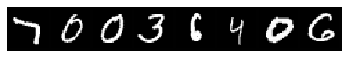

step 16996, loss 0.7560558319091797
Target:	 tensor([1, 2, 6, 0, 6, 8, 6, 4])
Pred:	 tensor([1, 2, 6, 0, 6, 8, 6, 4])


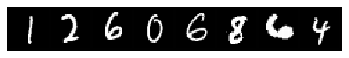

step 17046, loss 0.8808004856109619
Target:	 tensor([8, 1, 5, 4, 3, 7, 5, 0])
Pred:	 tensor([9, 1, 5, 4, 3, 7, 5, 0])


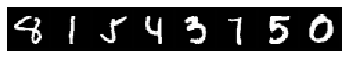

step 17096, loss 0.6836767196655273
Target:	 tensor([6, 7, 8, 0, 1, 1, 5, 1])
Pred:	 tensor([5, 7, 5, 0, 1, 1, 5, 1])


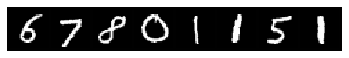

step 17146, loss 0.6196117997169495
Target:	 tensor([9, 0, 8, 9, 3, 9, 8, 8])
Pred:	 tensor([9, 0, 5, 4, 7, 9, 1, 8])


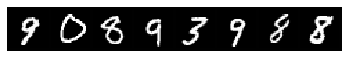

step 17196, loss 0.8929323554039001
Target:	 tensor([8, 2, 9, 8, 2, 3, 8, 4])
Pred:	 tensor([6, 2, 9, 8, 2, 3, 1, 4])


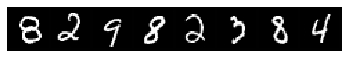

step 17246, loss 0.7327079176902771
Target:	 tensor([8, 2, 0, 9, 3, 9, 0, 8])
Pred:	 tensor([8, 2, 0, 9, 3, 9, 0, 8])


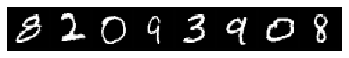

step 17296, loss 0.7051291465759277
Target:	 tensor([4, 9, 9, 2, 0, 0, 9, 9])
Pred:	 tensor([4, 8, 9, 2, 0, 0, 9, 9])


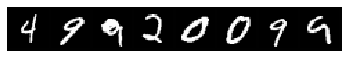

step 17346, loss 0.7271729111671448
Target:	 tensor([7, 7, 6, 7, 4, 5, 5, 5])
Pred:	 tensor([7, 9, 6, 7, 4, 8, 5, 5])


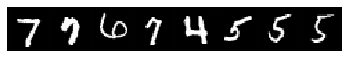

step 17396, loss 0.5942594408988953
Target:	 tensor([5, 1, 8, 3, 0, 4, 7, 4])
Pred:	 tensor([5, 1, 8, 3, 0, 4, 7, 4])


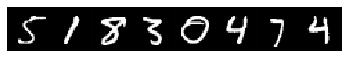

step 17437, loss 0.8368436694145203
Target:	 tensor([7, 4, 9, 4, 9, 3, 4, 3])
Pred:	 tensor([7, 4, 9, 4, 9, 3, 4, 3])


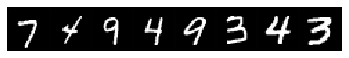

step 17487, loss 0.5938931107521057
Target:	 tensor([4, 1, 8, 9, 3, 9, 1, 8])
Pred:	 tensor([4, 1, 8, 9, 3, 9, 1, 7])


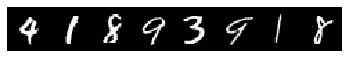

step 17537, loss 1.1145457029342651
Target:	 tensor([8, 2, 5, 8, 9, 4, 1, 8])
Pred:	 tensor([8, 2, 0, 9, 9, 4, 1, 8])


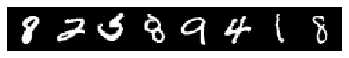

step 17587, loss 0.8779745101928711
Target:	 tensor([1, 9, 7, 8, 1, 5, 1, 8])
Pred:	 tensor([1, 9, 7, 8, 1, 5, 1, 8])


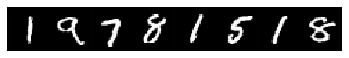

step 17637, loss 0.8787491917610168
Target:	 tensor([6, 6, 6, 2, 1, 7, 9, 7])
Pred:	 tensor([6, 5, 6, 2, 1, 7, 8, 9])


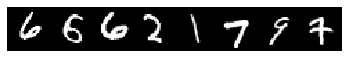

step 17687, loss 0.5531577467918396
Target:	 tensor([8, 0, 5, 5, 7, 3, 6, 6])
Pred:	 tensor([8, 6, 5, 6, 7, 7, 6, 6])


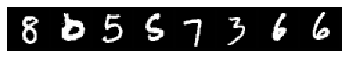

step 17737, loss 0.7796511650085449
Target:	 tensor([5, 5, 9, 9, 9, 0, 4, 3])
Pred:	 tensor([8, 5, 8, 9, 9, 0, 4, 3])


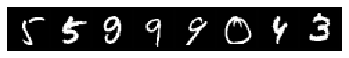

step 17787, loss 0.9074134826660156
Target:	 tensor([8, 8, 1, 5, 1, 4, 3, 1])
Pred:	 tensor([8, 8, 1, 5, 1, 4, 3, 1])


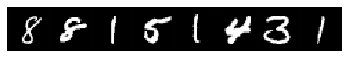

step 17837, loss 0.7323565483093262
Target:	 tensor([4, 8, 8, 3, 1, 0, 5, 1])
Pred:	 tensor([4, 8, 8, 3, 1, 0, 5, 1])


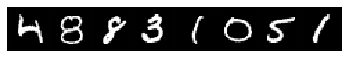

step 17887, loss 0.7454372048377991
Target:	 tensor([9, 7, 7, 4, 9, 7, 5, 0])
Pred:	 tensor([7, 4, 7, 4, 9, 7, 5, 0])


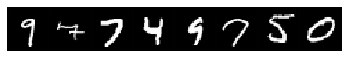

step 17937, loss 0.942699134349823
Target:	 tensor([5, 3, 1, 1, 1, 3, 5, 4])
Pred:	 tensor([5, 3, 1, 1, 1, 2, 5, 9])


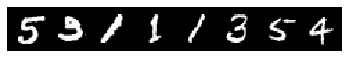

step 17987, loss 0.69532710313797
Target:	 tensor([1, 0, 1, 8, 3, 3, 2, 6])
Pred:	 tensor([1, 0, 1, 5, 3, 3, 2, 4])


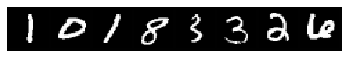

step 18037, loss 0.5917648673057556
Target:	 tensor([8, 9, 5, 2, 1, 8, 2, 2])
Pred:	 tensor([9, 9, 5, 2, 1, 8, 2, 2])


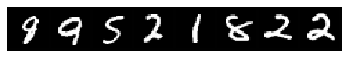

step 18087, loss 0.6487985849380493
Target:	 tensor([0, 5, 0, 6, 4, 7, 5, 2])
Pred:	 tensor([0, 5, 0, 6, 4, 9, 5, 2])


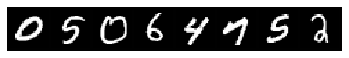

step 18137, loss 0.6594415307044983
Target:	 tensor([6, 7, 9, 6, 3, 6, 5, 1])
Pred:	 tensor([6, 7, 4, 6, 3, 6, 5, 1])


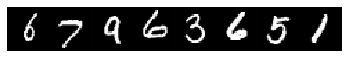

step 18187, loss 0.6703504920005798
Target:	 tensor([7, 1, 7, 5, 3, 3, 7, 2])
Pred:	 tensor([7, 1, 7, 5, 3, 3, 7, 2])


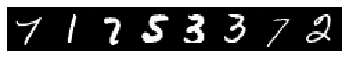

step 18237, loss 1.0488201379776
Target:	 tensor([2, 0, 9, 3, 3, 2, 4, 9])
Pred:	 tensor([0, 0, 9, 3, 3, 2, 6, 9])


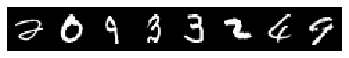

step 18287, loss 0.6472218036651611
Target:	 tensor([8, 6, 3, 1, 0, 4, 8, 0])
Pred:	 tensor([8, 6, 3, 1, 0, 4, 8, 0])


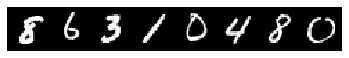

step 18337, loss 0.7980553507804871
Target:	 tensor([6, 5, 8, 4, 0, 2, 6, 6])
Pred:	 tensor([6, 3, 8, 4, 0, 2, 6, 6])


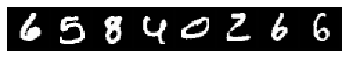

step 18387, loss 0.7952538132667542
Target:	 tensor([4, 8, 1, 2, 0, 6, 5, 2])
Pred:	 tensor([4, 8, 1, 2, 0, 6, 6, 2])


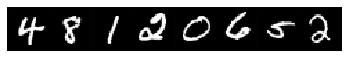

step 18437, loss 0.7146615386009216
Target:	 tensor([7, 9, 2, 0, 3, 0, 2, 5])
Pred:	 tensor([9, 9, 2, 3, 3, 0, 2, 5])


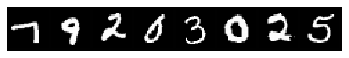

step 18487, loss 1.1054997444152832
Target:	 tensor([1, 1, 9, 0, 1, 2, 3, 1])
Pred:	 tensor([1, 1, 9, 0, 1, 2, 3, 1])


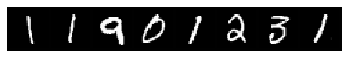

step 18537, loss 0.7749125957489014
Target:	 tensor([8, 7, 7, 7, 8, 4, 3, 6])
Pred:	 tensor([8, 7, 7, 7, 9, 4, 3, 6])


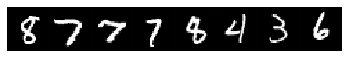

step 18587, loss 0.45108136534690857
Target:	 tensor([0, 5, 1, 3, 7, 7, 5, 6])
Pred:	 tensor([0, 5, 1, 3, 7, 7, 5, 6])


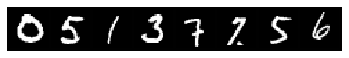

step 18637, loss 0.6039412617683411
Target:	 tensor([9, 4, 6, 0, 3, 6, 9, 6])
Pred:	 tensor([8, 4, 6, 8, 3, 6, 9, 6])


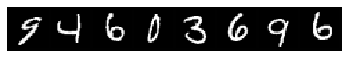

step 18687, loss 0.6912433505058289
Target:	 tensor([9, 5, 8, 1, 7, 8, 1, 9])
Pred:	 tensor([9, 9, 8, 1, 7, 8, 3, 9])


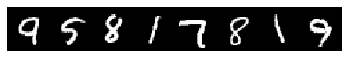

step 18737, loss 0.5881659388542175
Target:	 tensor([1, 2, 6, 3, 6, 2, 1, 2])
Pred:	 tensor([1, 2, 6, 3, 6, 2, 1, 2])


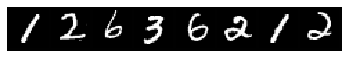

step 18787, loss 0.6405504941940308
Target:	 tensor([6, 1, 3, 0, 8, 6, 7, 1])
Pred:	 tensor([6, 1, 3, 0, 8, 6, 7, 1])


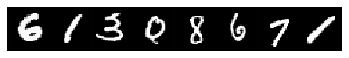

step 18837, loss 0.7789502143859863
Target:	 tensor([7, 2, 9, 9, 0, 6, 2, 2])
Pred:	 tensor([7, 2, 9, 9, 0, 6, 2, 8])


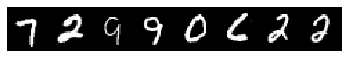

step 18887, loss 0.5997141599655151
Target:	 tensor([4, 0, 9, 4, 8, 1, 9, 1])
Pred:	 tensor([4, 0, 9, 4, 8, 1, 4, 1])


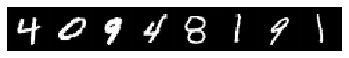

step 18937, loss 0.9070627689361572
Target:	 tensor([1, 4, 1, 8, 8, 3, 2, 3])
Pred:	 tensor([1, 1, 1, 9, 8, 3, 2, 3])


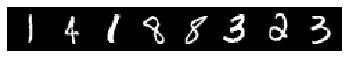

step 18987, loss 0.9190637469291687
Target:	 tensor([6, 5, 7, 2, 1, 5, 6, 5])
Pred:	 tensor([1, 6, 7, 2, 1, 5, 6, 5])


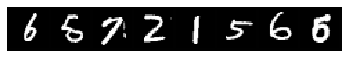

step 19037, loss 0.639934241771698
Target:	 tensor([3, 3, 7, 0, 9, 0, 5, 0])
Pred:	 tensor([3, 3, 7, 0, 8, 0, 5, 0])


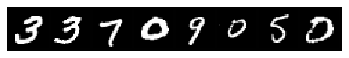

step 19087, loss 0.7975031733512878
Target:	 tensor([9, 7, 8, 4, 5, 1, 6, 9])
Pred:	 tensor([9, 7, 8, 4, 5, 2, 6, 9])


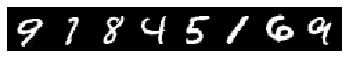

step 19137, loss 0.5053051114082336
Target:	 tensor([3, 5, 7, 1, 5, 6, 1, 9])
Pred:	 tensor([3, 5, 7, 1, 5, 6, 1, 5])


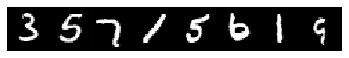

step 19187, loss 0.9092438220977783
Target:	 tensor([2, 9, 9, 4, 4, 8, 1, 0])
Pred:	 tensor([2, 9, 9, 9, 4, 6, 1, 0])


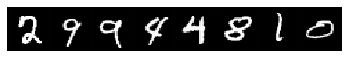

step 19237, loss 0.7223570942878723
Target:	 tensor([4, 6, 9, 5, 9, 9, 1, 5])
Pred:	 tensor([4, 6, 4, 5, 9, 9, 1, 5])


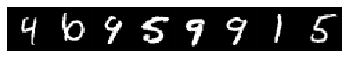

step 19287, loss 0.7984809875488281
Target:	 tensor([5, 4, 7, 9, 0, 3, 6, 3])
Pred:	 tensor([6, 4, 7, 4, 0, 3, 0, 3])


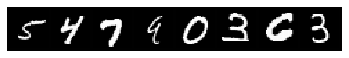

step 19337, loss 0.9018866419792175
Target:	 tensor([0, 1, 7, 8, 5, 8, 3, 8])
Pred:	 tensor([5, 1, 7, 4, 5, 8, 3, 8])


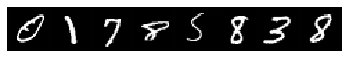

step 19387, loss 0.7466163635253906
Target:	 tensor([1, 4, 4, 9, 6, 1, 4, 3])
Pred:	 tensor([1, 4, 4, 9, 6, 1, 4, 3])


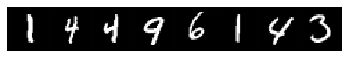

step 19437, loss 0.8793260455131531
Target:	 tensor([3, 4, 7, 0, 5, 7, 0, 7])
Pred:	 tensor([2, 4, 7, 0, 0, 7, 0, 7])


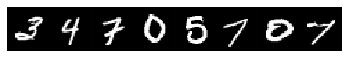

step 19487, loss 0.6245301961898804
Target:	 tensor([9, 9, 1, 9, 7, 0, 7, 7])
Pred:	 tensor([4, 9, 1, 9, 7, 0, 9, 9])


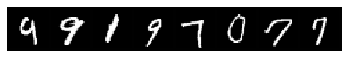

step 19537, loss 0.8639240264892578
Target:	 tensor([5, 6, 4, 8, 3, 1, 9, 3])
Pred:	 tensor([3, 6, 4, 8, 1, 1, 3, 3])


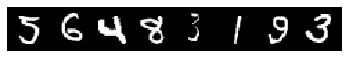

step 19587, loss 0.6943495273590088
Target:	 tensor([7, 3, 1, 5, 3, 1, 4, 9])
Pred:	 tensor([7, 3, 1, 5, 3, 1, 4, 9])


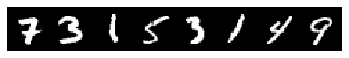

step 19637, loss 0.716092586517334
Target:	 tensor([7, 7, 3, 9, 6, 0, 0, 1])
Pred:	 tensor([7, 7, 3, 9, 6, 8, 0, 1])


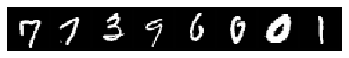

step 19687, loss 0.7203710079193115
Target:	 tensor([3, 7, 9, 4, 5, 0, 1, 4])
Pred:	 tensor([3, 7, 8, 4, 5, 0, 1, 4])


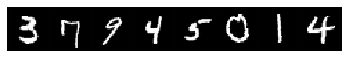

step 19737, loss 0.6511374711990356
Target:	 tensor([4, 2, 7, 0, 4, 0, 3, 7])
Pred:	 tensor([4, 2, 7, 0, 6, 0, 3, 7])


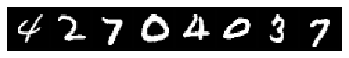

step 19787, loss 0.9679976105690002
Target:	 tensor([4, 7, 2, 4, 4, 3, 5, 2])
Pred:	 tensor([4, 7, 2, 1, 4, 7, 5, 2])


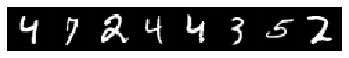

step 19837, loss 0.7684271335601807
Target:	 tensor([3, 4, 7, 6, 2, 3, 0, 0])
Pred:	 tensor([3, 4, 7, 1, 2, 3, 0, 6])


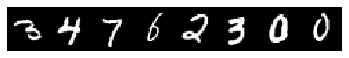

step 19887, loss 1.012961745262146
Target:	 tensor([0, 9, 0, 7, 3, 4, 5, 9])
Pred:	 tensor([0, 9, 0, 7, 3, 4, 5, 5])


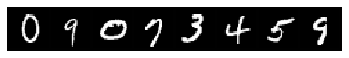

step 19928, loss 0.5947081446647644
Target:	 tensor([1, 4, 0, 3, 1, 1, 2, 1])
Pred:	 tensor([1, 4, 0, 3, 1, 1, 3, 1])


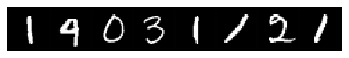

step 19978, loss 0.5810838341712952
Target:	 tensor([8, 8, 2, 2, 9, 3, 1, 8])
Pred:	 tensor([8, 5, 8, 2, 9, 3, 1, 8])


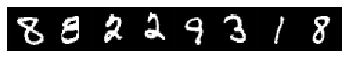

step 20028, loss 0.9488710761070251
Target:	 tensor([7, 3, 7, 0, 7, 4, 2, 6])
Pred:	 tensor([7, 3, 7, 0, 7, 4, 4, 6])


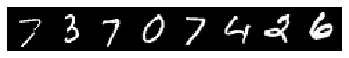

step 20078, loss 0.42381545901298523
Target:	 tensor([7, 7, 5, 1, 1, 7, 8, 7])
Pred:	 tensor([7, 7, 5, 1, 1, 7, 8, 7])


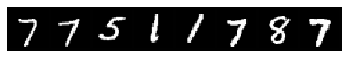

step 20128, loss 0.6634626388549805
Target:	 tensor([6, 1, 9, 0, 4, 8, 0, 0])
Pred:	 tensor([6, 1, 9, 0, 4, 6, 0, 0])


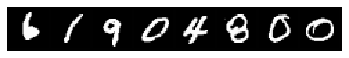

step 20178, loss 0.8844959735870361
Target:	 tensor([5, 9, 4, 4, 2, 1, 3, 7])
Pred:	 tensor([8, 9, 4, 4, 2, 1, 3, 7])


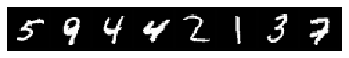

step 20228, loss 0.6411994099617004
Target:	 tensor([1, 7, 9, 4, 3, 5, 7, 1])
Pred:	 tensor([1, 7, 4, 4, 3, 5, 7, 1])


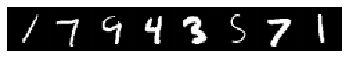

step 20278, loss 0.9212673306465149
Target:	 tensor([9, 1, 1, 3, 4, 9, 3, 3])
Pred:	 tensor([9, 1, 1, 3, 4, 9, 3, 2])


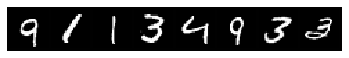

step 20328, loss 0.6297103762626648
Target:	 tensor([7, 2, 4, 3, 4, 7, 7, 3])
Pred:	 tensor([7, 2, 4, 3, 4, 7, 7, 3])


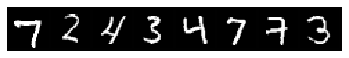

step 20378, loss 0.6305927038192749
Target:	 tensor([0, 9, 5, 2, 6, 8, 5, 8])
Pred:	 tensor([0, 9, 5, 2, 6, 8, 5, 8])


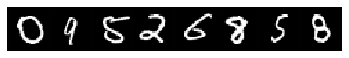

step 20428, loss 0.8660733699798584
Target:	 tensor([9, 3, 9, 9, 7, 2, 6, 4])
Pred:	 tensor([9, 3, 9, 4, 7, 2, 6, 4])


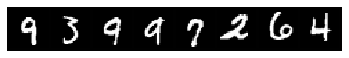

step 20478, loss 0.6659498810768127
Target:	 tensor([9, 7, 7, 7, 6, 0, 4, 8])
Pred:	 tensor([7, 7, 7, 7, 6, 8, 4, 5])


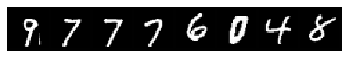

step 20528, loss 0.6699051856994629
Target:	 tensor([7, 3, 8, 2, 4, 9, 1, 4])
Pred:	 tensor([7, 3, 8, 2, 4, 9, 1, 4])


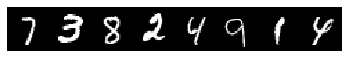

step 20578, loss 0.8377993106842041
Target:	 tensor([4, 1, 4, 1, 1, 2, 6, 1])
Pred:	 tensor([4, 1, 4, 3, 1, 2, 6, 1])


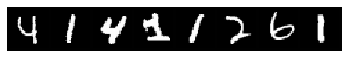

step 20628, loss 0.6892687678337097
Target:	 tensor([3, 4, 6, 5, 4, 9, 0, 0])
Pred:	 tensor([3, 4, 6, 5, 4, 9, 0, 0])


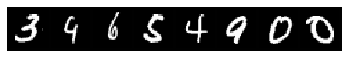

step 20678, loss 0.8772804141044617
Target:	 tensor([3, 3, 2, 2, 9, 7, 8, 8])
Pred:	 tensor([3, 3, 2, 2, 9, 7, 1, 8])


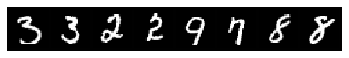

step 20728, loss 0.8228221535682678
Target:	 tensor([2, 9, 5, 4, 0, 0, 8, 9])
Pred:	 tensor([2, 9, 5, 4, 0, 0, 5, 9])


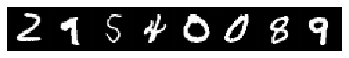

step 20778, loss 0.8624513745307922
Target:	 tensor([2, 5, 2, 9, 6, 5, 4, 9])
Pred:	 tensor([2, 5, 2, 9, 6, 5, 4, 9])


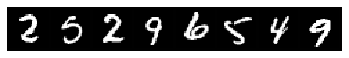

step 20828, loss 0.6844637393951416
Target:	 tensor([6, 6, 2, 8, 9, 5, 8, 8])
Pred:	 tensor([6, 6, 2, 8, 9, 5, 8, 8])


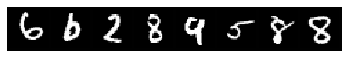

step 20878, loss 0.7215919494628906
Target:	 tensor([1, 4, 6, 4, 2, 7, 2, 9])
Pred:	 tensor([1, 4, 6, 4, 2, 7, 2, 2])


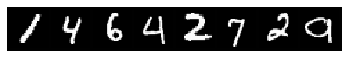

step 20928, loss 0.6420257091522217
Target:	 tensor([6, 1, 0, 5, 2, 1, 1, 8])
Pred:	 tensor([6, 1, 0, 5, 2, 1, 1, 3])


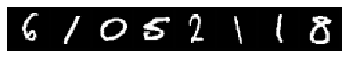

step 20978, loss 0.649685800075531
Target:	 tensor([6, 8, 7, 3, 9, 9, 2, 5])
Pred:	 tensor([6, 7, 7, 3, 9, 9, 2, 6])


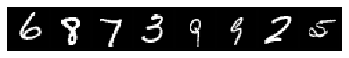

step 21028, loss 0.7281013131141663
Target:	 tensor([4, 8, 9, 1, 4, 9, 3, 8])
Pred:	 tensor([4, 8, 9, 1, 4, 7, 5, 8])


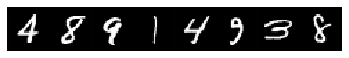

step 21078, loss 1.109197735786438
Target:	 tensor([6, 1, 2, 7, 2, 7, 9, 1])
Pred:	 tensor([6, 1, 4, 4, 6, 7, 7, 1])


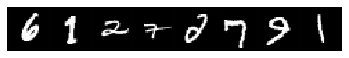

step 21128, loss 0.7478384375572205
Target:	 tensor([9, 7, 6, 9, 9, 2, 8, 4])
Pred:	 tensor([9, 7, 6, 9, 9, 1, 8, 4])


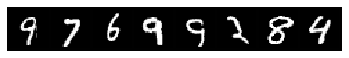

step 21178, loss 0.7997250556945801
Target:	 tensor([8, 7, 0, 7, 4, 8, 1, 2])
Pred:	 tensor([8, 7, 0, 7, 4, 8, 1, 2])


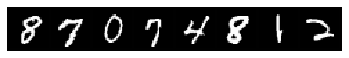

step 21228, loss 0.558623194694519
Target:	 tensor([2, 3, 4, 1, 7, 0, 0, 4])
Pred:	 tensor([2, 2, 4, 1, 7, 0, 0, 4])


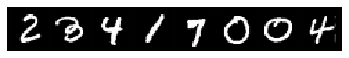

step 21278, loss 0.6887606978416443
Target:	 tensor([4, 5, 4, 5, 7, 7, 5, 4])
Pred:	 tensor([4, 5, 6, 5, 7, 7, 5, 4])


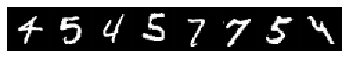

step 21328, loss 0.7136370539665222
Target:	 tensor([4, 3, 0, 3, 2, 7, 1, 4])
Pred:	 tensor([4, 3, 0, 3, 2, 7, 1, 4])


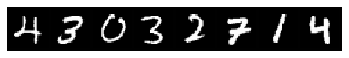

step 21378, loss 0.9024572372436523
Target:	 tensor([7, 0, 7, 3, 0, 7, 3, 5])
Pred:	 tensor([7, 0, 7, 3, 0, 7, 5, 8])


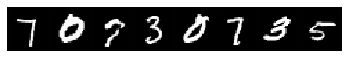

step 21428, loss 0.7582175731658936
Target:	 tensor([2, 1, 7, 0, 2, 8, 1, 4])
Pred:	 tensor([2, 1, 7, 0, 2, 8, 1, 4])


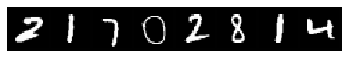

step 21478, loss 0.7716401219367981
Target:	 tensor([0, 3, 1, 6, 0, 7, 0, 7])
Pred:	 tensor([0, 3, 1, 6, 0, 7, 0, 1])


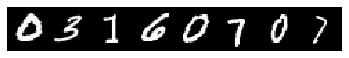

step 21528, loss 0.7677251696586609
Target:	 tensor([7, 9, 9, 4, 0, 4, 6, 8])
Pred:	 tensor([9, 9, 9, 4, 0, 4, 6, 8])


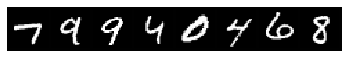

step 21578, loss 0.7195708751678467
Target:	 tensor([1, 2, 9, 6, 5, 6, 3, 1])
Pred:	 tensor([7, 2, 9, 6, 5, 6, 3, 1])


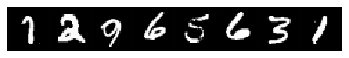

step 21628, loss 1.0330439805984497
Target:	 tensor([4, 2, 9, 9, 7, 7, 8, 9])
Pred:	 tensor([4, 2, 9, 9, 7, 7, 8, 9])


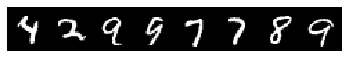

step 21678, loss 0.9499797224998474
Target:	 tensor([2, 8, 9, 9, 0, 6, 6, 3])
Pred:	 tensor([2, 8, 9, 9, 0, 6, 0, 3])


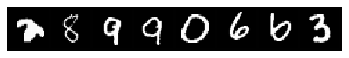

step 21728, loss 1.0340651273727417
Target:	 tensor([6, 0, 9, 6, 7, 9, 5, 8])
Pred:	 tensor([6, 0, 9, 6, 7, 9, 5, 1])


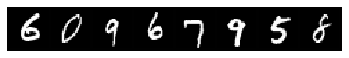

step 21778, loss 0.7893657684326172
Target:	 tensor([5, 6, 4, 9, 2, 5, 8, 7])
Pred:	 tensor([3, 6, 4, 9, 2, 5, 5, 7])


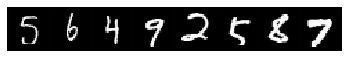

step 21828, loss 0.6865455508232117
Target:	 tensor([5, 7, 9, 4, 2, 3, 1, 6])
Pred:	 tensor([5, 7, 9, 6, 2, 3, 1, 6])


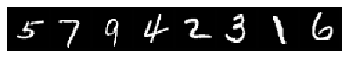

step 21878, loss 0.8310968279838562
Target:	 tensor([1, 0, 2, 9, 4, 2, 3, 8])
Pred:	 tensor([1, 0, 3, 9, 4, 2, 3, 1])


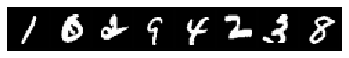

step 21928, loss 0.5311590433120728
Target:	 tensor([6, 6, 9, 3, 1, 7, 6, 4])
Pred:	 tensor([5, 6, 9, 3, 1, 2, 6, 4])


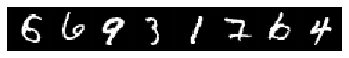

step 21978, loss 0.6555359959602356
Target:	 tensor([4, 1, 1, 1, 5, 9, 0, 0])
Pred:	 tensor([4, 1, 8, 1, 5, 9, 0, 0])


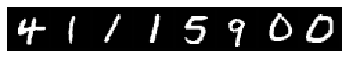

step 22028, loss 0.7077108025550842
Target:	 tensor([2, 5, 9, 4, 7, 4, 6, 9])
Pred:	 tensor([2, 5, 4, 4, 7, 4, 6, 9])


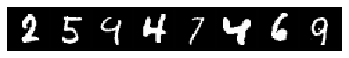

step 22078, loss 0.6553884148597717
Target:	 tensor([2, 0, 0, 8, 3, 7, 3, 4])
Pred:	 tensor([2, 0, 0, 8, 3, 7, 3, 4])


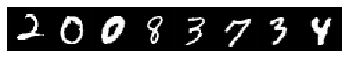

step 22128, loss 0.7286354899406433
Target:	 tensor([7, 7, 3, 0, 6, 3, 0, 5])
Pred:	 tensor([7, 7, 3, 0, 6, 3, 0, 5])


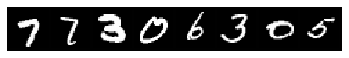

step 22178, loss 0.7313404679298401
Target:	 tensor([8, 1, 3, 3, 1, 0, 4, 0])
Pred:	 tensor([8, 1, 3, 3, 1, 0, 4, 0])


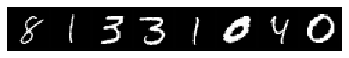

step 22228, loss 0.8294880986213684
Target:	 tensor([8, 4, 9, 0, 0, 3, 4, 0])
Pred:	 tensor([9, 4, 2, 0, 0, 3, 4, 0])


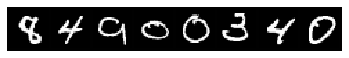

step 22278, loss 0.7985215783119202
Target:	 tensor([3, 3, 2, 1, 7, 4, 1, 3])
Pred:	 tensor([3, 3, 2, 1, 7, 4, 1, 3])


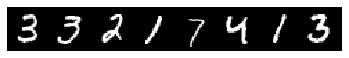

step 22328, loss 0.7493686676025391
Target:	 tensor([9, 3, 5, 3, 2, 0, 3, 4])
Pred:	 tensor([9, 3, 5, 3, 2, 0, 3, 4])


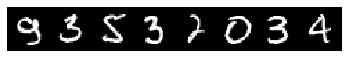

step 22378, loss 0.6429230570793152
Target:	 tensor([2, 1, 9, 0, 3, 4, 7, 0])
Pred:	 tensor([0, 1, 9, 0, 3, 4, 7, 0])


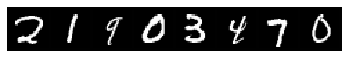

step 22419, loss 0.7511489391326904
Target:	 tensor([9, 9, 0, 7, 5, 5, 7, 7])
Pred:	 tensor([9, 4, 0, 7, 6, 5, 7, 7])


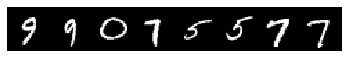

step 22469, loss 0.6794363856315613
Target:	 tensor([5, 6, 4, 0, 4, 7, 8, 0])
Pred:	 tensor([5, 6, 4, 0, 4, 7, 5, 0])


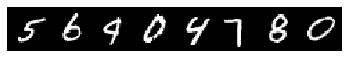

step 22519, loss 0.7356933951377869
Target:	 tensor([2, 8, 8, 6, 5, 4, 8, 5])
Pred:	 tensor([2, 8, 8, 6, 6, 4, 8, 5])


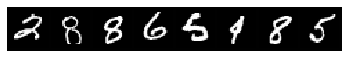

step 22569, loss 0.7157362103462219
Target:	 tensor([3, 5, 9, 4, 0, 8, 1, 0])
Pred:	 tensor([3, 5, 5, 4, 0, 5, 1, 0])


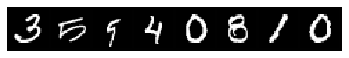

step 22619, loss 0.6261194348335266
Target:	 tensor([0, 5, 8, 7, 6, 9, 0, 3])
Pred:	 tensor([0, 5, 8, 7, 6, 9, 2, 3])


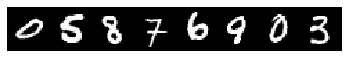

step 22669, loss 0.9507611393928528
Target:	 tensor([1, 7, 2, 2, 8, 7, 2, 3])
Pred:	 tensor([1, 7, 3, 2, 8, 7, 2, 3])


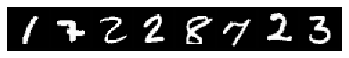

step 22719, loss 0.6504884362220764
Target:	 tensor([7, 7, 7, 6, 0, 8, 1, 0])
Pred:	 tensor([7, 7, 7, 6, 0, 1, 1, 0])


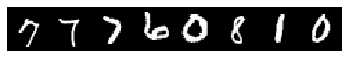

step 22769, loss 1.0217158794403076
Target:	 tensor([3, 7, 1, 6, 0, 0, 8, 8])
Pred:	 tensor([3, 7, 1, 6, 0, 0, 8, 5])


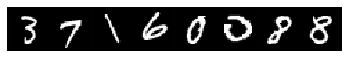

step 22819, loss 0.8690903186798096
Target:	 tensor([9, 6, 5, 7, 1, 6, 3, 0])
Pred:	 tensor([4, 6, 6, 7, 1, 1, 3, 0])


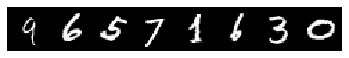

step 22869, loss 0.7298223376274109
Target:	 tensor([4, 7, 5, 3, 7, 9, 3, 1])
Pred:	 tensor([9, 7, 5, 3, 7, 9, 3, 1])


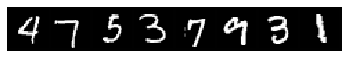

step 22919, loss 0.605012059211731
Target:	 tensor([4, 5, 6, 2, 7, 6, 4, 0])
Pred:	 tensor([4, 5, 6, 2, 7, 6, 4, 0])


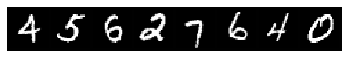

step 22969, loss 0.8864468932151794
Target:	 tensor([7, 6, 2, 7, 1, 9, 1, 8])
Pred:	 tensor([7, 6, 0, 7, 1, 7, 1, 5])


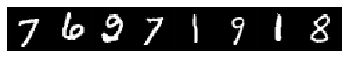

step 23019, loss 0.7596892714500427
Target:	 tensor([7, 2, 0, 3, 1, 5, 2, 0])
Pred:	 tensor([7, 2, 0, 3, 1, 5, 2, 0])


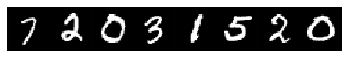

step 23069, loss 0.9807596802711487
Target:	 tensor([3, 7, 5, 7, 9, 4, 3, 0])
Pred:	 tensor([3, 7, 8, 9, 9, 4, 3, 0])


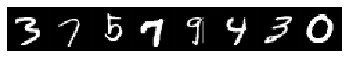

step 23119, loss 0.8553455471992493
Target:	 tensor([6, 3, 1, 7, 9, 7, 7, 7])
Pred:	 tensor([6, 2, 1, 7, 9, 7, 7, 7])


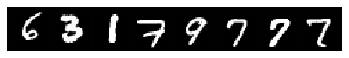

step 23169, loss 0.8808678984642029
Target:	 tensor([0, 5, 0, 8, 6, 3, 8, 5])
Pred:	 tensor([0, 5, 0, 8, 5, 3, 8, 5])


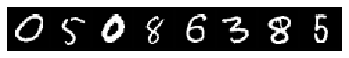

step 23219, loss 0.8761029243469238
Target:	 tensor([2, 8, 8, 5, 5, 0, 0, 3])
Pred:	 tensor([2, 8, 7, 6, 3, 0, 0, 5])


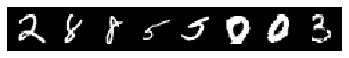

step 23269, loss 0.6885109543800354
Target:	 tensor([0, 0, 9, 2, 1, 1, 0, 3])
Pred:	 tensor([0, 0, 9, 2, 1, 1, 0, 3])


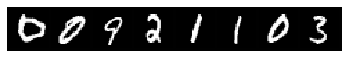

step 23319, loss 0.8994371294975281
Target:	 tensor([9, 2, 6, 9, 7, 6, 0, 1])
Pred:	 tensor([4, 2, 6, 9, 7, 6, 0, 1])


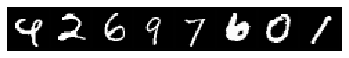

step 23369, loss 0.8865798115730286
Target:	 tensor([5, 6, 5, 7, 2, 8, 8, 6])
Pred:	 tensor([5, 6, 5, 7, 2, 8, 8, 6])


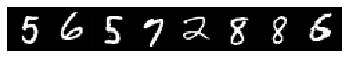

step 23419, loss 0.6478834748268127
Target:	 tensor([0, 4, 7, 8, 3, 2, 7, 6])
Pred:	 tensor([0, 4, 7, 8, 2, 2, 7, 6])


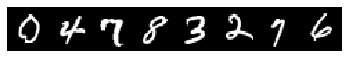

step 23469, loss 0.6253835558891296
Target:	 tensor([8, 7, 0, 9, 3, 5, 1, 1])
Pred:	 tensor([8, 7, 0, 9, 3, 5, 1, 1])


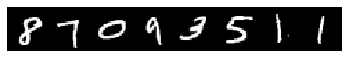

step 23519, loss 0.792141854763031
Target:	 tensor([0, 3, 5, 0, 2, 7, 1, 2])
Pred:	 tensor([0, 3, 5, 0, 2, 7, 1, 2])


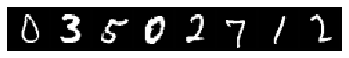

step 23569, loss 0.9426400065422058
Target:	 tensor([6, 5, 4, 6, 1, 8, 3, 4])
Pred:	 tensor([6, 5, 4, 6, 1, 5, 3, 4])


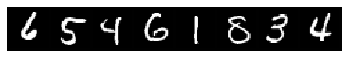

step 23619, loss 0.5803183913230896
Target:	 tensor([3, 7, 2, 4, 4, 7, 4, 3])
Pred:	 tensor([3, 7, 2, 9, 4, 7, 9, 3])


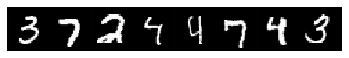

step 23669, loss 0.9603784084320068
Target:	 tensor([5, 0, 9, 0, 8, 0, 4, 9])
Pred:	 tensor([9, 0, 9, 0, 7, 0, 7, 9])


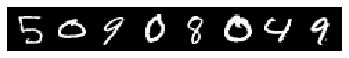

step 23719, loss 0.9604188799858093
Target:	 tensor([7, 9, 5, 7, 2, 7, 3, 3])
Pred:	 tensor([7, 9, 5, 7, 2, 7, 3, 3])


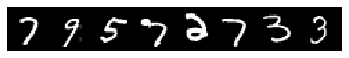

step 23769, loss 0.821540892124176
Target:	 tensor([5, 5, 1, 4, 7, 4, 9, 9])
Pred:	 tensor([5, 5, 1, 4, 7, 4, 4, 4])


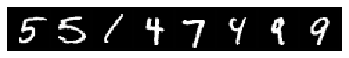

step 23819, loss 1.034716248512268
Target:	 tensor([7, 3, 3, 1, 5, 1, 1, 7])
Pred:	 tensor([7, 7, 3, 1, 6, 1, 1, 2])


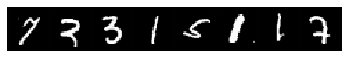

step 23869, loss 0.9377121925354004
Target:	 tensor([7, 8, 0, 6, 9, 7, 1, 3])
Pred:	 tensor([7, 9, 0, 6, 9, 7, 1, 3])


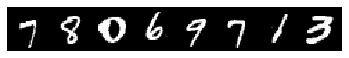

step 23919, loss 0.7871732115745544
Target:	 tensor([1, 7, 3, 8, 2, 8, 6, 3])
Pred:	 tensor([1, 7, 3, 8, 2, 8, 6, 3])


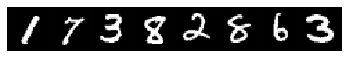

step 23969, loss 0.812537431716919
Target:	 tensor([4, 8, 0, 4, 0, 8, 3, 6])
Pred:	 tensor([4, 5, 0, 4, 8, 4, 3, 6])


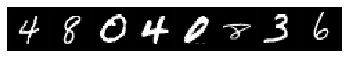

step 24019, loss 1.0331600904464722
Target:	 tensor([5, 5, 4, 4, 5, 7, 7, 6])
Pred:	 tensor([5, 5, 4, 4, 5, 7, 7, 6])


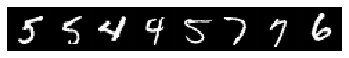

step 24069, loss 0.7651601433753967
Target:	 tensor([1, 0, 9, 0, 8, 7, 9, 2])
Pred:	 tensor([1, 0, 9, 0, 8, 7, 1, 2])


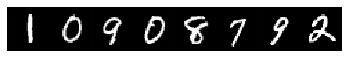

step 24119, loss 0.6728115677833557
Target:	 tensor([0, 1, 6, 9, 2, 3, 7, 2])
Pred:	 tensor([0, 1, 6, 9, 2, 3, 7, 2])


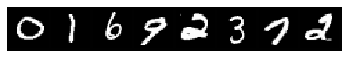

step 24169, loss 1.0472755432128906
Target:	 tensor([4, 7, 8, 1, 1, 0, 9, 2])
Pred:	 tensor([4, 7, 1, 1, 1, 6, 7, 2])


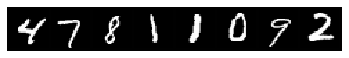

step 24219, loss 0.8045918941497803
Target:	 tensor([5, 7, 3, 0, 1, 7, 4, 8])
Pred:	 tensor([5, 7, 3, 0, 1, 7, 4, 8])


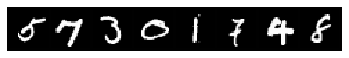

step 24269, loss 0.7870163917541504
Target:	 tensor([6, 9, 8, 5, 5, 5, 6, 7])
Pred:	 tensor([6, 9, 8, 5, 5, 8, 6, 7])


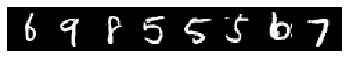

step 24319, loss 0.8336896300315857
Target:	 tensor([3, 8, 4, 8, 4, 9, 7, 3])
Pred:	 tensor([3, 8, 4, 8, 4, 7, 7, 3])


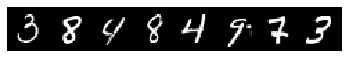

step 24369, loss 0.8144936561584473
Target:	 tensor([1, 1, 4, 3, 1, 7, 3, 3])
Pred:	 tensor([1, 1, 6, 3, 1, 7, 3, 3])


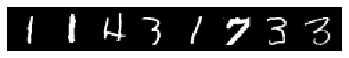

step 24419, loss 0.7941889762878418
Target:	 tensor([1, 0, 3, 1, 1, 6, 8, 6])
Pred:	 tensor([1, 0, 3, 1, 1, 6, 8, 6])


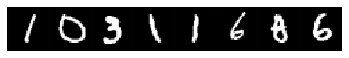

step 24469, loss 0.6523247361183167
Target:	 tensor([1, 1, 7, 8, 8, 1, 1, 3])
Pred:	 tensor([1, 1, 7, 8, 8, 1, 1, 3])


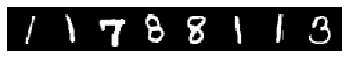

step 24519, loss 0.7110404372215271
Target:	 tensor([9, 3, 0, 0, 8, 4, 9, 1])
Pred:	 tensor([7, 3, 0, 0, 8, 4, 9, 1])


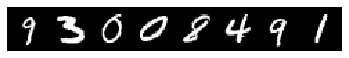

step 24569, loss 0.6180986762046814
Target:	 tensor([0, 4, 3, 9, 8, 0, 1, 3])
Pred:	 tensor([0, 4, 3, 2, 8, 0, 1, 3])


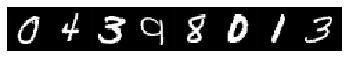

step 24619, loss 0.7706095576286316
Target:	 tensor([4, 8, 0, 1, 6, 1, 6, 2])
Pred:	 tensor([9, 8, 0, 5, 6, 1, 6, 2])


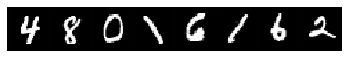

step 24669, loss 0.6194905042648315
Target:	 tensor([3, 2, 3, 3, 4, 4, 8, 8])
Pred:	 tensor([3, 2, 3, 6, 4, 4, 3, 5])


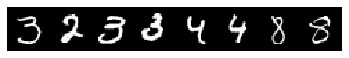

step 24719, loss 0.8642048835754395
Target:	 tensor([6, 4, 5, 6, 2, 6, 4, 1])
Pred:	 tensor([6, 4, 7, 6, 2, 6, 4, 8])


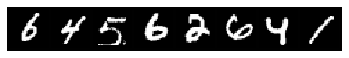

step 24769, loss 0.64396733045578
Target:	 tensor([7, 0, 0, 0, 9, 9, 4, 2])
Pred:	 tensor([7, 0, 0, 8, 9, 9, 4, 2])


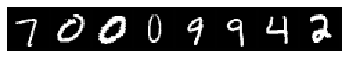

step 24819, loss 0.8243396878242493
Target:	 tensor([9, 9, 1, 0, 3, 4, 8, 4])
Pred:	 tensor([1, 9, 1, 0, 3, 4, 8, 4])


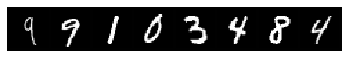

step 24869, loss 0.7923521399497986
Target:	 tensor([9, 7, 9, 6, 1, 2, 6, 5])
Pred:	 tensor([4, 7, 9, 6, 1, 2, 6, 5])


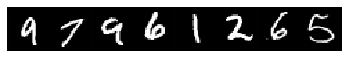

step 24910, loss 0.6569764018058777
Target:	 tensor([0, 1, 1, 8, 2, 3, 4, 1])
Pred:	 tensor([0, 1, 1, 8, 2, 3, 4, 1])


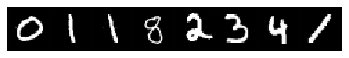

step 24960, loss 0.7434403300285339
Target:	 tensor([8, 2, 6, 4, 1, 9, 7, 0])
Pred:	 tensor([8, 2, 6, 4, 1, 9, 7, 6])


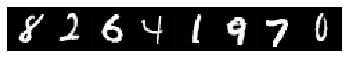

step 25010, loss 0.884894847869873
Target:	 tensor([3, 4, 8, 0, 3, 3, 5, 6])
Pred:	 tensor([3, 4, 5, 0, 3, 3, 6, 6])


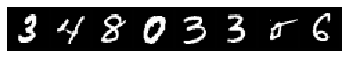

step 25060, loss 0.8575754761695862
Target:	 tensor([5, 9, 0, 8, 4, 5, 6, 9])
Pred:	 tensor([6, 9, 0, 0, 4, 5, 6, 9])


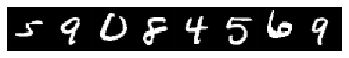

step 25110, loss 0.7750570774078369
Target:	 tensor([6, 8, 3, 3, 9, 8, 9, 8])
Pred:	 tensor([6, 8, 3, 3, 9, 8, 9, 3])


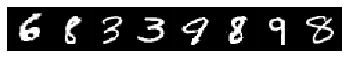

step 25160, loss 0.6700792908668518
Target:	 tensor([1, 1, 0, 1, 3, 2, 2, 9])
Pred:	 tensor([1, 1, 0, 1, 3, 2, 2, 9])


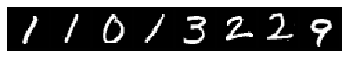

step 25210, loss 0.7770159244537354
Target:	 tensor([0, 5, 3, 7, 9, 7, 2, 6])
Pred:	 tensor([0, 5, 3, 7, 9, 7, 2, 6])


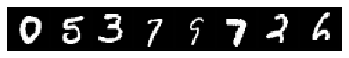

step 25260, loss 0.7463486790657043
Target:	 tensor([0, 7, 9, 4, 1, 4, 6, 3])
Pred:	 tensor([0, 7, 9, 4, 1, 4, 6, 3])


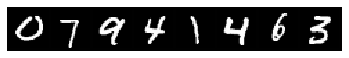

step 25310, loss 0.835932731628418
Target:	 tensor([3, 8, 2, 5, 1, 6, 0, 4])
Pred:	 tensor([3, 8, 2, 6, 1, 6, 0, 4])


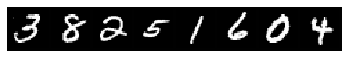

step 25360, loss 0.7756897807121277
Target:	 tensor([4, 8, 0, 4, 1, 0, 0, 1])
Pred:	 tensor([4, 8, 0, 9, 1, 0, 0, 1])


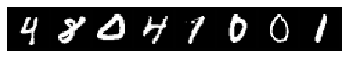

step 25410, loss 0.8066810965538025
Target:	 tensor([7, 2, 9, 9, 5, 1, 8, 5])
Pred:	 tensor([7, 1, 9, 9, 5, 1, 8, 5])


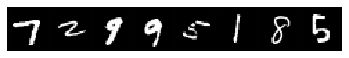

step 25460, loss 0.5759010910987854
Target:	 tensor([0, 9, 7, 6, 5, 3, 4, 5])
Pred:	 tensor([0, 9, 7, 6, 5, 3, 4, 8])


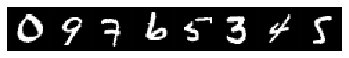

step 25510, loss 1.0349218845367432
Target:	 tensor([6, 2, 3, 7, 1, 6, 4, 5])
Pred:	 tensor([6, 2, 3, 7, 1, 6, 4, 3])


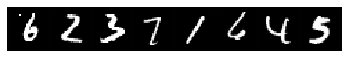

step 25560, loss 0.6966527104377747
Target:	 tensor([2, 1, 6, 1, 6, 4, 9, 4])
Pred:	 tensor([2, 1, 6, 1, 6, 4, 9, 4])


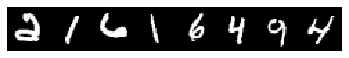

step 25610, loss 0.9753082394599915
Target:	 tensor([1, 3, 7, 2, 2, 7, 7, 4])
Pred:	 tensor([1, 3, 7, 2, 9, 7, 7, 4])


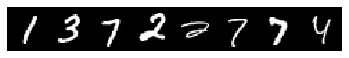

step 25660, loss 0.8903639316558838
Target:	 tensor([1, 1, 3, 8, 1, 9, 3, 1])
Pred:	 tensor([2, 1, 3, 6, 1, 9, 3, 1])


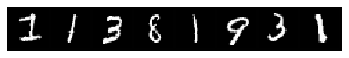

step 25710, loss 0.8802533745765686
Target:	 tensor([7, 8, 5, 4, 3, 6, 0, 8])
Pred:	 tensor([7, 8, 5, 4, 3, 6, 0, 3])


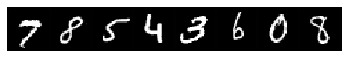

step 25760, loss 0.7093377709388733
Target:	 tensor([1, 1, 7, 4, 9, 8, 6, 6])
Pred:	 tensor([1, 1, 7, 4, 9, 8, 6, 6])


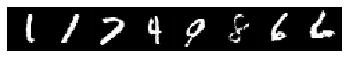

step 25810, loss 0.6856381893157959
Target:	 tensor([0, 7, 6, 1, 0, 7, 4, 5])
Pred:	 tensor([0, 9, 6, 1, 0, 7, 9, 5])


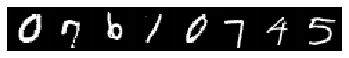

step 25860, loss 0.8117808699607849
Target:	 tensor([7, 2, 3, 2, 1, 7, 5, 4])
Pred:	 tensor([7, 2, 3, 2, 8, 7, 5, 4])


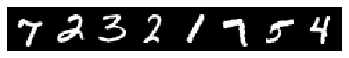

step 25910, loss 0.8308391571044922
Target:	 tensor([7, 3, 9, 2, 4, 1, 1, 7])
Pred:	 tensor([7, 5, 9, 2, 4, 1, 1, 7])


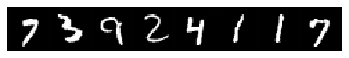

step 25960, loss 0.7225253582000732
Target:	 tensor([6, 4, 4, 2, 1, 7, 1, 7])
Pred:	 tensor([6, 9, 4, 2, 1, 7, 1, 7])


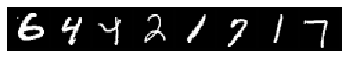

step 26010, loss 0.8275508880615234
Target:	 tensor([8, 9, 2, 7, 6, 3, 9, 3])
Pred:	 tensor([8, 9, 2, 7, 6, 3, 9, 3])


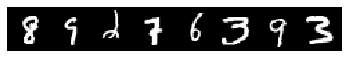

step 26060, loss 0.6933636665344238
Target:	 tensor([2, 7, 5, 4, 2, 3, 2, 7])
Pred:	 tensor([2, 7, 5, 4, 2, 3, 2, 7])


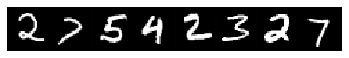

step 26110, loss 0.9071012139320374
Target:	 tensor([5, 9, 5, 9, 4, 7, 2, 0])
Pred:	 tensor([8, 9, 5, 9, 4, 7, 2, 0])


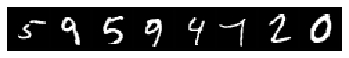

step 26160, loss 0.8517143726348877
Target:	 tensor([9, 3, 1, 7, 7, 3, 0, 6])
Pred:	 tensor([9, 5, 1, 7, 7, 3, 0, 6])


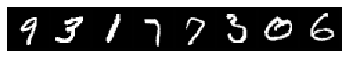

step 26210, loss 0.7653725147247314
Target:	 tensor([2, 7, 6, 4, 9, 3, 1, 5])
Pred:	 tensor([2, 7, 6, 4, 9, 3, 1, 5])


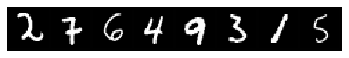

step 26260, loss 0.7299014925956726
Target:	 tensor([0, 4, 5, 2, 0, 2, 1, 6])
Pred:	 tensor([0, 9, 5, 2, 0, 2, 1, 6])


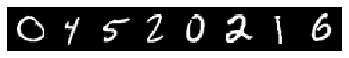

step 26310, loss 0.8286091685295105
Target:	 tensor([1, 1, 8, 7, 2, 8, 6, 5])
Pred:	 tensor([1, 1, 7, 7, 2, 1, 6, 5])


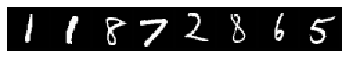

step 26360, loss 0.6474298238754272
Target:	 tensor([3, 3, 3, 5, 0, 9, 6, 4])
Pred:	 tensor([3, 3, 3, 6, 0, 9, 6, 4])


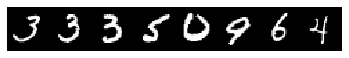

step 26410, loss 0.7948265671730042
Target:	 tensor([9, 3, 4, 4, 3, 5, 6, 5])
Pred:	 tensor([9, 3, 4, 4, 9, 5, 6, 5])


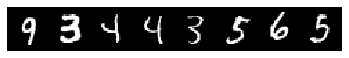

step 26460, loss 0.6432625651359558
Target:	 tensor([8, 0, 4, 7, 3, 3, 6, 9])
Pred:	 tensor([3, 0, 4, 7, 3, 3, 6, 9])


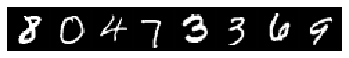

step 26510, loss 0.7202122211456299
Target:	 tensor([6, 0, 0, 8, 6, 2, 7, 0])
Pred:	 tensor([6, 0, 0, 8, 5, 2, 7, 0])


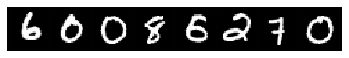

step 26560, loss 0.9095630049705505
Target:	 tensor([9, 5, 2, 5, 5, 2, 7, 4])
Pred:	 tensor([9, 5, 2, 5, 5, 2, 7, 4])


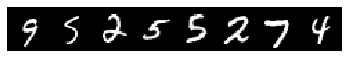

step 26610, loss 0.9074478149414062
Target:	 tensor([9, 1, 3, 8, 2, 7, 4, 9])
Pred:	 tensor([9, 1, 2, 8, 1, 7, 9, 4])


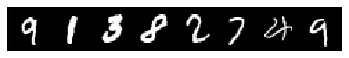

step 26660, loss 0.6128512024879456
Target:	 tensor([0, 2, 5, 7, 4, 1, 2, 7])
Pred:	 tensor([0, 2, 5, 7, 4, 1, 2, 7])


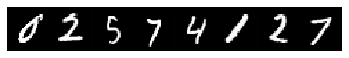

step 26710, loss 0.5572788119316101
Target:	 tensor([3, 4, 1, 1, 8, 8, 4, 1])
Pred:	 tensor([2, 4, 1, 1, 8, 8, 4, 1])


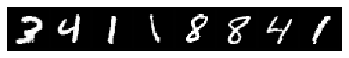

step 26760, loss 0.8295863270759583
Target:	 tensor([3, 3, 6, 2, 1, 9, 1, 9])
Pred:	 tensor([3, 3, 6, 0, 1, 9, 1, 4])


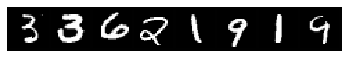

step 26810, loss 0.771765947341919
Target:	 tensor([7, 8, 2, 7, 5, 8, 3, 4])
Pred:	 tensor([7, 8, 2, 7, 5, 8, 3, 4])


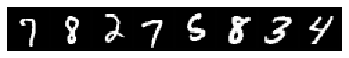

step 26860, loss 0.6550459861755371
Target:	 tensor([8, 8, 4, 1, 0, 8, 9, 1])
Pred:	 tensor([8, 5, 4, 1, 0, 1, 9, 1])


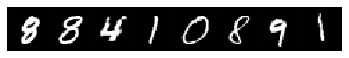

step 26910, loss 0.9881044030189514
Target:	 tensor([2, 5, 0, 1, 5, 9, 1, 7])
Pred:	 tensor([8, 8, 0, 1, 5, 9, 1, 7])


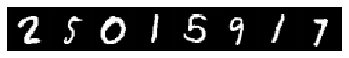

step 26960, loss 0.7113073468208313
Target:	 tensor([4, 8, 3, 2, 0, 2, 2, 8])
Pred:	 tensor([4, 9, 3, 2, 0, 2, 2, 8])


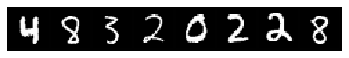

step 27010, loss 0.5856752991676331
Target:	 tensor([2, 3, 4, 6, 0, 0, 8, 1])
Pred:	 tensor([2, 3, 4, 6, 0, 0, 8, 1])


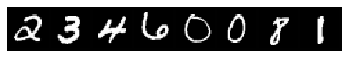

step 27060, loss 0.5866115689277649
Target:	 tensor([7, 1, 0, 6, 2, 6, 5, 3])
Pred:	 tensor([7, 1, 0, 6, 2, 6, 5, 3])


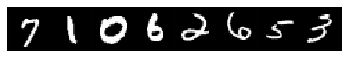

step 27110, loss 0.8799765706062317
Target:	 tensor([8, 8, 4, 4, 9, 8, 4, 9])
Pred:	 tensor([8, 8, 4, 4, 9, 8, 4, 9])


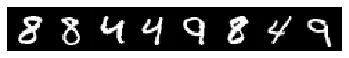

step 27160, loss 0.6390886306762695
Target:	 tensor([1, 3, 1, 5, 4, 1, 1, 6])
Pred:	 tensor([1, 3, 1, 5, 4, 1, 1, 6])


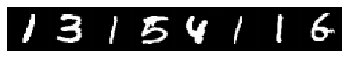

step 27210, loss 1.0029685497283936
Target:	 tensor([0, 8, 9, 1, 6, 0, 3, 0])
Pred:	 tensor([0, 3, 4, 1, 6, 0, 3, 0])


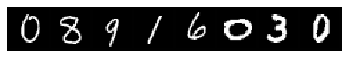

step 27260, loss 0.8683732151985168
Target:	 tensor([9, 0, 0, 0, 0, 9, 0, 0])
Pred:	 tensor([9, 0, 0, 0, 0, 4, 0, 0])


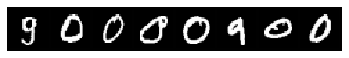

step 27310, loss 0.6712871193885803
Target:	 tensor([6, 6, 8, 2, 2, 0, 0, 0])
Pred:	 tensor([6, 6, 3, 2, 2, 0, 0, 0])


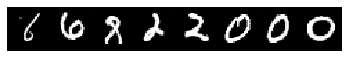

step 27360, loss 0.8739328384399414
Target:	 tensor([6, 1, 1, 1, 7, 3, 1, 4])
Pred:	 tensor([6, 1, 1, 1, 7, 3, 1, 4])


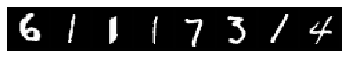

step 27401, loss 0.8928048610687256
Target:	 tensor([8, 0, 5, 2, 4, 8, 5, 7])
Pred:	 tensor([8, 6, 5, 2, 4, 8, 9, 7])


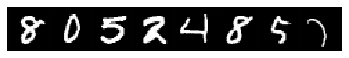

step 27451, loss 0.5941073894500732
Target:	 tensor([9, 3, 7, 6, 3, 8, 7, 7])
Pred:	 tensor([4, 3, 7, 6, 3, 8, 7, 7])


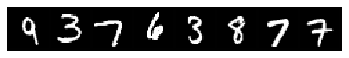

step 27501, loss 0.848933219909668
Target:	 tensor([3, 8, 4, 5, 9, 4, 6, 0])
Pred:	 tensor([3, 8, 2, 5, 9, 4, 6, 0])


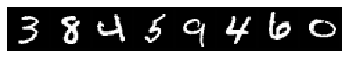

step 27551, loss 0.7032493948936462
Target:	 tensor([7, 4, 4, 1, 8, 2, 9, 2])
Pred:	 tensor([7, 4, 4, 1, 8, 2, 5, 3])


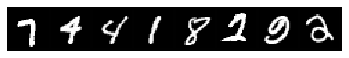

step 27601, loss 0.9335262179374695
Target:	 tensor([2, 7, 7, 6, 8, 1, 8, 1])
Pred:	 tensor([2, 7, 7, 6, 8, 1, 8, 1])


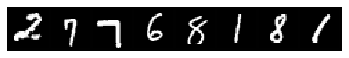

step 27651, loss 0.5979215502738953
Target:	 tensor([5, 8, 0, 3, 8, 8, 9, 7])
Pred:	 tensor([5, 8, 0, 3, 8, 8, 9, 7])


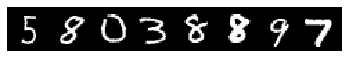

step 27701, loss 0.8394133448600769
Target:	 tensor([6, 8, 6, 9, 7, 1, 7, 6])
Pred:	 tensor([6, 8, 6, 9, 7, 1, 7, 6])


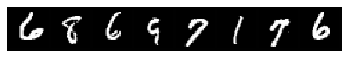

step 27751, loss 0.7045803070068359
Target:	 tensor([8, 5, 6, 8, 4, 9, 2, 6])
Pred:	 tensor([8, 5, 6, 8, 4, 9, 2, 6])


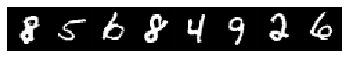

step 27801, loss 0.9236757159233093
Target:	 tensor([9, 5, 4, 7, 1, 2, 3, 4])
Pred:	 tensor([7, 5, 4, 7, 1, 1, 3, 4])


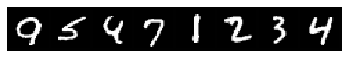

step 27851, loss 0.8929535746574402
Target:	 tensor([8, 0, 9, 9, 2, 1, 0, 9])
Pred:	 tensor([0, 0, 4, 9, 2, 1, 0, 9])


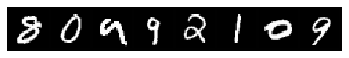

step 27901, loss 0.6885868906974792
Target:	 tensor([5, 0, 8, 9, 2, 0, 3, 0])
Pred:	 tensor([5, 0, 8, 7, 2, 0, 3, 0])


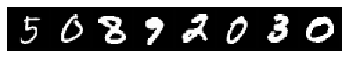

step 27951, loss 0.7194063067436218
Target:	 tensor([6, 0, 6, 4, 1, 2, 8, 4])
Pred:	 tensor([6, 0, 0, 4, 1, 1, 8, 4])


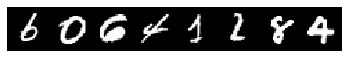

step 28001, loss 1.1572935581207275
Target:	 tensor([9, 0, 2, 0, 3, 4, 5, 8])
Pred:	 tensor([9, 0, 2, 0, 8, 4, 4, 8])


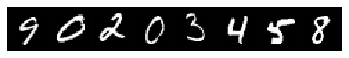

step 28051, loss 0.7917299270629883
Target:	 tensor([3, 7, 6, 4, 8, 1, 7, 5])
Pred:	 tensor([7, 7, 6, 4, 8, 1, 7, 5])


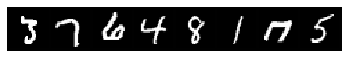

step 28101, loss 1.0212544202804565
Target:	 tensor([5, 2, 6, 1, 0, 5, 4, 0])
Pred:	 tensor([6, 2, 6, 1, 0, 5, 4, 0])


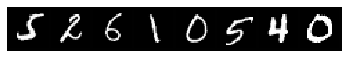

step 28151, loss 0.9692358374595642
Target:	 tensor([1, 9, 1, 8, 8, 0, 2, 5])
Pred:	 tensor([1, 9, 1, 8, 8, 0, 2, 3])


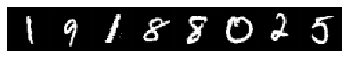

step 28201, loss 0.7670019268989563
Target:	 tensor([1, 9, 1, 8, 4, 1, 9, 0])
Pred:	 tensor([1, 9, 1, 8, 4, 1, 9, 0])


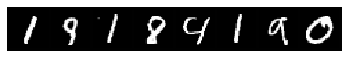

step 28251, loss 0.6960558295249939
Target:	 tensor([6, 2, 4, 3, 0, 7, 4, 0])
Pred:	 tensor([6, 3, 4, 3, 0, 7, 4, 0])


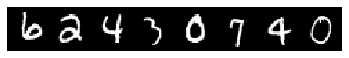

step 28301, loss 0.6270028948783875
Target:	 tensor([4, 7, 8, 2, 5, 2, 5, 0])
Pred:	 tensor([4, 7, 5, 2, 5, 2, 5, 0])


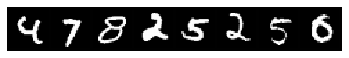

step 28351, loss 0.7478297352790833
Target:	 tensor([9, 5, 1, 6, 0, 9, 4, 9])
Pred:	 tensor([9, 5, 1, 6, 0, 9, 4, 9])


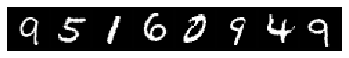

step 28401, loss 0.5350419878959656
Target:	 tensor([0, 8, 0, 8, 2, 0, 5, 1])
Pred:	 tensor([0, 8, 0, 8, 2, 0, 5, 1])


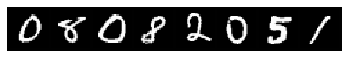

step 28451, loss 0.9672255516052246
Target:	 tensor([1, 5, 5, 5, 8, 8, 4, 2])
Pred:	 tensor([1, 5, 5, 5, 1, 0, 9, 2])


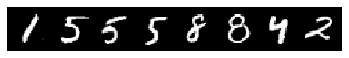

step 28501, loss 0.6000213027000427
Target:	 tensor([4, 5, 9, 3, 3, 2, 8, 6])
Pred:	 tensor([4, 3, 9, 3, 3, 2, 3, 6])


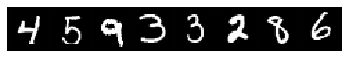

step 28551, loss 0.607498824596405
Target:	 tensor([4, 1, 9, 0, 6, 8, 5, 5])
Pred:	 tensor([4, 1, 9, 0, 6, 8, 5, 5])


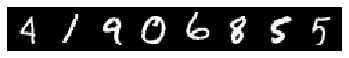

step 28601, loss 0.77183598279953
Target:	 tensor([7, 4, 6, 8, 5, 7, 1, 9])
Pred:	 tensor([9, 4, 6, 5, 3, 7, 1, 9])


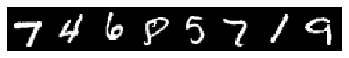

step 28651, loss 0.854282557964325
Target:	 tensor([1, 0, 2, 1, 6, 0, 0, 7])
Pred:	 tensor([1, 0, 1, 1, 6, 0, 0, 7])


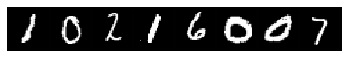

step 28701, loss 0.8846692442893982
Target:	 tensor([7, 1, 9, 9, 3, 8, 0, 0])
Pred:	 tensor([7, 1, 7, 9, 3, 3, 0, 0])


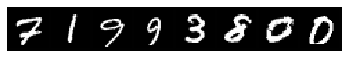

step 28751, loss 0.9813306927680969
Target:	 tensor([9, 9, 5, 5, 6, 8, 5, 5])
Pred:	 tensor([9, 4, 3, 5, 6, 3, 5, 8])


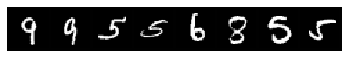

step 28801, loss 0.8443031311035156
Target:	 tensor([9, 3, 7, 7, 6, 6, 3, 2])
Pred:	 tensor([9, 3, 7, 7, 6, 6, 3, 8])


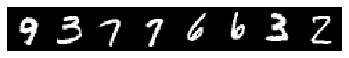

step 28851, loss 0.6743921637535095
Target:	 tensor([1, 6, 9, 3, 4, 3, 8, 8])
Pred:	 tensor([1, 6, 7, 3, 4, 3, 0, 8])


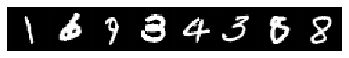

step 28901, loss 0.7572259902954102
Target:	 tensor([8, 5, 7, 5, 3, 8, 2, 3])
Pred:	 tensor([8, 5, 7, 6, 3, 8, 2, 3])


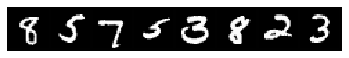

step 28951, loss 0.6694237589836121
Target:	 tensor([4, 7, 2, 5, 2, 6, 9, 0])
Pred:	 tensor([4, 7, 2, 5, 2, 6, 9, 0])


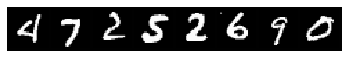

step 29001, loss 0.8174191117286682
Target:	 tensor([2, 4, 7, 9, 1, 7, 1, 0])
Pred:	 tensor([0, 6, 2, 9, 1, 1, 1, 0])


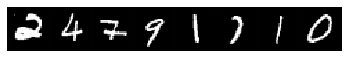

step 29051, loss 0.8974040150642395
Target:	 tensor([9, 1, 1, 5, 3, 7, 1, 1])
Pred:	 tensor([7, 1, 1, 3, 3, 7, 6, 1])


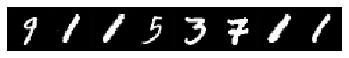

step 29101, loss 1.0603119134902954
Target:	 tensor([8, 5, 6, 8, 5, 8, 3, 1])
Pred:	 tensor([5, 3, 6, 3, 5, 8, 8, 1])


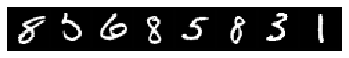

step 29151, loss 0.7505921721458435
Target:	 tensor([9, 1, 0, 9, 0, 0, 1, 5])
Pred:	 tensor([9, 1, 0, 8, 0, 0, 1, 5])


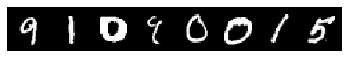

step 29201, loss 1.0938833951950073
Target:	 tensor([2, 0, 0, 9, 8, 5, 9, 3])
Pred:	 tensor([2, 0, 0, 9, 3, 5, 9, 8])


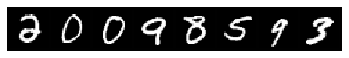

step 29251, loss 0.8177237510681152
Target:	 tensor([5, 1, 8, 9, 2, 7, 8, 5])
Pred:	 tensor([5, 1, 9, 9, 8, 7, 8, 5])


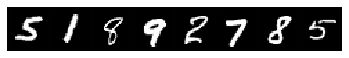

step 29301, loss 0.6522808074951172
Target:	 tensor([6, 5, 5, 1, 2, 5, 7, 6])
Pred:	 tensor([6, 5, 5, 1, 2, 5, 7, 6])


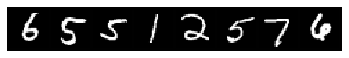

step 29351, loss 0.7404964566230774
Target:	 tensor([3, 9, 3, 7, 0, 6, 3, 7])
Pred:	 tensor([3, 8, 7, 7, 0, 6, 3, 7])


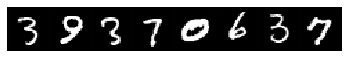

step 29401, loss 0.6251683235168457
Target:	 tensor([5, 5, 3, 3, 1, 8, 5, 1])
Pred:	 tensor([5, 5, 3, 3, 1, 8, 6, 1])


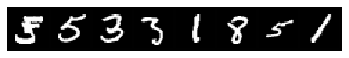

step 29451, loss 1.0692895650863647
Target:	 tensor([1, 7, 9, 4, 2, 2, 8, 5])
Pred:	 tensor([1, 7, 9, 4, 2, 2, 8, 3])


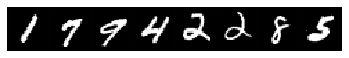

step 29501, loss 0.6184936165809631
Target:	 tensor([5, 3, 1, 7, 4, 5, 4, 9])
Pred:	 tensor([5, 3, 1, 7, 4, 8, 4, 9])


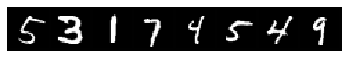

step 29551, loss 0.7787091732025146
Target:	 tensor([4, 6, 5, 4, 1, 3, 1, 2])
Pred:	 tensor([6, 6, 8, 4, 1, 3, 1, 2])


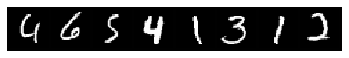

step 29601, loss 0.7451890110969543
Target:	 tensor([6, 4, 3, 6, 5, 8, 4, 8])
Pred:	 tensor([6, 4, 3, 6, 5, 8, 4, 8])


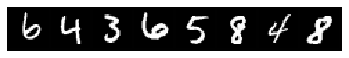

step 29651, loss 0.9762234091758728
Target:	 tensor([8, 1, 2, 1, 3, 3, 2, 7])
Pred:	 tensor([8, 1, 2, 1, 3, 3, 2, 7])


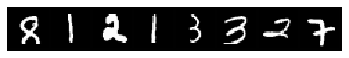

step 29701, loss 0.5832282900810242
Target:	 tensor([9, 9, 6, 3, 8, 1, 3, 3])
Pred:	 tensor([9, 9, 6, 7, 1, 1, 3, 3])


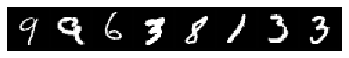

step 29751, loss 0.7017095685005188
Target:	 tensor([6, 2, 1, 0, 2, 8, 6, 1])
Pred:	 tensor([6, 2, 1, 0, 2, 1, 6, 1])


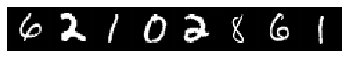

step 29801, loss 0.6936182975769043
Target:	 tensor([3, 4, 7, 2, 0, 1, 1, 6])
Pred:	 tensor([3, 4, 7, 2, 0, 1, 1, 6])


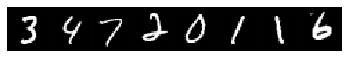

step 29851, loss 0.9090154767036438
Target:	 tensor([1, 4, 3, 2, 2, 1, 2, 7])
Pred:	 tensor([1, 6, 3, 2, 2, 1, 2, 7])


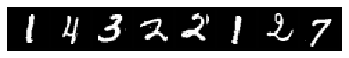

step 29892, loss 0.8435059189796448
Target:	 tensor([4, 5, 1, 9, 9, 6, 7, 0])
Pred:	 tensor([4, 5, 1, 7, 9, 6, 7, 0])


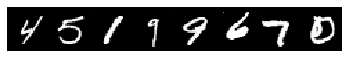

step 29942, loss 0.9720194935798645
Target:	 tensor([2, 5, 4, 8, 3, 0, 0, 5])
Pred:	 tensor([2, 5, 4, 8, 3, 0, 0, 5])


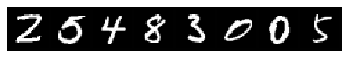

step 29992, loss 0.9082371592521667
Target:	 tensor([2, 2, 7, 5, 4, 4, 3, 0])
Pred:	 tensor([2, 2, 7, 5, 4, 4, 3, 0])


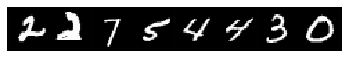

step 30042, loss 0.8007616400718689
Target:	 tensor([2, 8, 0, 6, 9, 1, 7, 4])
Pred:	 tensor([2, 5, 0, 6, 9, 1, 7, 4])


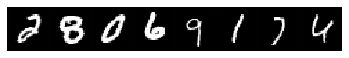

step 30092, loss 0.7287432551383972
Target:	 tensor([1, 7, 0, 1, 1, 4, 1, 2])
Pred:	 tensor([1, 9, 0, 8, 1, 4, 1, 2])


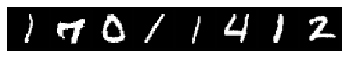

step 30142, loss 0.8765257000923157
Target:	 tensor([4, 8, 0, 8, 5, 3, 7, 4])
Pred:	 tensor([4, 9, 0, 8, 6, 5, 9, 4])


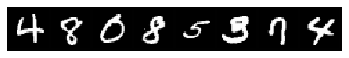

step 30192, loss 0.8488144278526306
Target:	 tensor([6, 0, 2, 8, 9, 0, 0, 8])
Pred:	 tensor([6, 0, 2, 9, 4, 0, 0, 8])


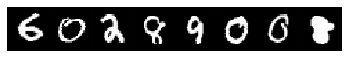

step 30242, loss 0.7454317212104797
Target:	 tensor([4, 7, 2, 5, 1, 8, 4, 0])
Pred:	 tensor([4, 7, 2, 5, 1, 4, 4, 0])


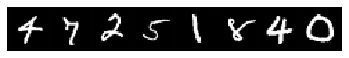

step 30292, loss 0.8993075489997864
Target:	 tensor([9, 3, 2, 1, 8, 3, 5, 5])
Pred:	 tensor([9, 3, 2, 1, 1, 0, 5, 5])


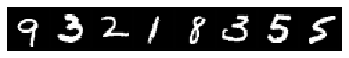

step 30342, loss 0.8744377493858337
Target:	 tensor([7, 7, 9, 0, 1, 8, 0, 3])
Pred:	 tensor([7, 7, 9, 0, 1, 8, 0, 2])


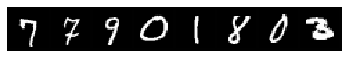

step 30392, loss 0.724291980266571
Target:	 tensor([3, 9, 3, 4, 6, 0, 8, 6])
Pred:	 tensor([3, 3, 3, 4, 6, 0, 8, 6])


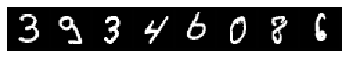

step 30442, loss 0.9363203644752502
Target:	 tensor([1, 0, 5, 6, 5, 0, 6, 4])
Pred:	 tensor([1, 0, 6, 6, 5, 0, 6, 4])


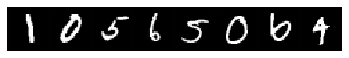

step 30492, loss 0.873680055141449
Target:	 tensor([8, 2, 6, 7, 4, 3, 4, 5])
Pred:	 tensor([8, 4, 6, 7, 4, 3, 4, 5])


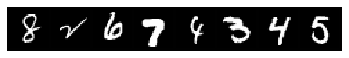

step 30542, loss 0.9948847889900208
Target:	 tensor([8, 7, 6, 0, 6, 6, 3, 7])
Pred:	 tensor([8, 7, 6, 0, 6, 5, 3, 9])


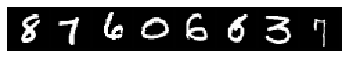

step 30592, loss 0.7898549437522888
Target:	 tensor([9, 7, 6, 4, 4, 2, 8, 6])
Pred:	 tensor([9, 7, 6, 6, 4, 2, 1, 6])


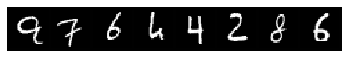

step 30642, loss 0.7689244151115417
Target:	 tensor([3, 4, 4, 3, 9, 0, 5, 9])
Pred:	 tensor([3, 4, 4, 3, 9, 0, 5, 9])


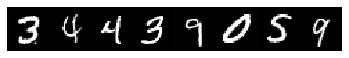

step 30692, loss 0.9463258385658264
Target:	 tensor([2, 2, 3, 3, 2, 0, 4, 9])
Pred:	 tensor([3, 2, 4, 7, 2, 0, 4, 9])


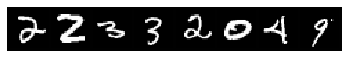

step 30742, loss 0.9795771241188049
Target:	 tensor([0, 1, 2, 7, 9, 1, 1, 7])
Pred:	 tensor([0, 1, 2, 7, 9, 1, 1, 7])


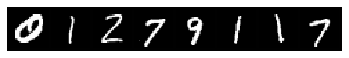

step 30792, loss 0.8185234069824219
Target:	 tensor([6, 9, 5, 1, 1, 5, 1, 0])
Pred:	 tensor([6, 9, 5, 1, 1, 5, 1, 0])


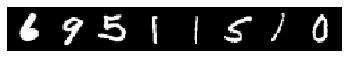

step 30842, loss 0.6850878596305847
Target:	 tensor([1, 7, 9, 7, 6, 9, 5, 1])
Pred:	 tensor([1, 7, 9, 7, 6, 9, 5, 1])


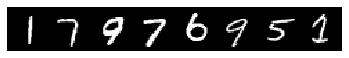

step 30892, loss 0.8825051188468933
Target:	 tensor([3, 3, 3, 7, 0, 6, 3, 1])
Pred:	 tensor([3, 3, 3, 7, 0, 6, 3, 1])


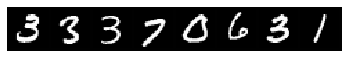

step 30942, loss 0.698874294757843
Target:	 tensor([5, 1, 6, 6, 2, 6, 5, 7])
Pred:	 tensor([5, 1, 6, 6, 2, 6, 6, 7])


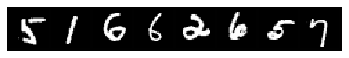

step 30992, loss 0.7785453200340271
Target:	 tensor([6, 1, 7, 8, 4, 7, 6, 3])
Pred:	 tensor([6, 1, 7, 8, 4, 7, 6, 3])


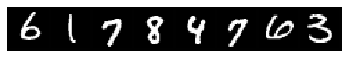

step 31042, loss 1.2291144132614136
Target:	 tensor([8, 9, 4, 9, 8, 3, 5, 3])
Pred:	 tensor([8, 7, 4, 9, 3, 3, 5, 3])


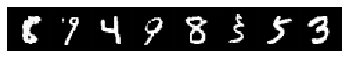

step 31092, loss 0.7677202224731445
Target:	 tensor([9, 0, 2, 1, 8, 8, 4, 8])
Pred:	 tensor([9, 0, 0, 1, 8, 8, 4, 8])


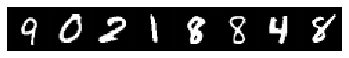

step 31142, loss 0.754356324672699
Target:	 tensor([5, 2, 9, 8, 9, 4, 9, 9])
Pred:	 tensor([5, 2, 9, 8, 9, 4, 9, 9])


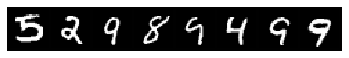

step 31192, loss 0.9793529510498047
Target:	 tensor([7, 1, 6, 2, 2, 9, 4, 3])
Pred:	 tensor([8, 1, 6, 4, 2, 4, 4, 2])


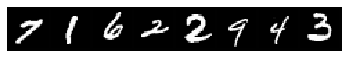

step 31242, loss 0.7390151023864746
Target:	 tensor([8, 3, 4, 7, 0, 8, 9, 7])
Pred:	 tensor([8, 7, 4, 7, 7, 8, 9, 9])


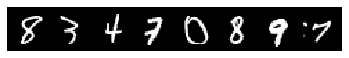

step 31292, loss 0.8440330028533936
Target:	 tensor([6, 4, 7, 1, 6, 9, 4, 1])
Pred:	 tensor([6, 4, 7, 1, 6, 4, 4, 1])


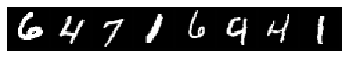

step 31342, loss 1.088746190071106
Target:	 tensor([3, 1, 8, 2, 3, 2, 6, 0])
Pred:	 tensor([3, 1, 5, 4, 8, 2, 6, 0])


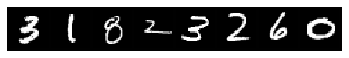

step 31392, loss 0.6708157062530518
Target:	 tensor([8, 5, 9, 4, 2, 2, 6, 4])
Pred:	 tensor([8, 5, 7, 4, 2, 2, 6, 4])


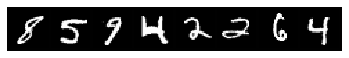

step 31442, loss 0.7273597717285156
Target:	 tensor([2, 2, 7, 4, 9, 3, 2, 7])
Pred:	 tensor([2, 2, 7, 4, 9, 3, 2, 9])


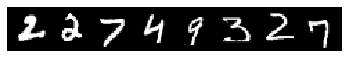

step 31492, loss 0.7236023545265198
Target:	 tensor([5, 7, 8, 5, 5, 6, 3, 4])
Pred:	 tensor([5, 2, 8, 5, 5, 6, 3, 4])


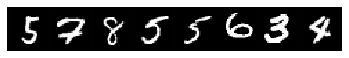

step 31542, loss 0.6997067332267761
Target:	 tensor([7, 1, 0, 5, 5, 0, 7, 8])
Pred:	 tensor([7, 1, 0, 5, 8, 0, 7, 8])


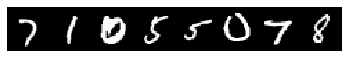

step 31592, loss 0.7312256693840027
Target:	 tensor([8, 2, 4, 8, 1, 3, 6, 3])
Pred:	 tensor([8, 3, 4, 8, 1, 3, 6, 2])


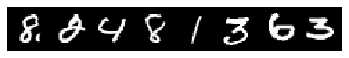

step 31642, loss 0.76064133644104
Target:	 tensor([1, 2, 5, 6, 8, 0, 8, 8])
Pred:	 tensor([1, 2, 5, 6, 8, 0, 8, 8])


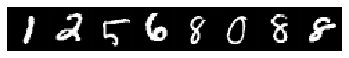

step 31692, loss 0.7215893864631653
Target:	 tensor([6, 4, 0, 1, 8, 6, 2, 4])
Pred:	 tensor([6, 6, 0, 1, 8, 6, 2, 4])


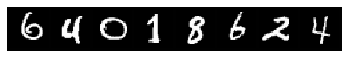

step 31742, loss 0.8004581928253174
Target:	 tensor([9, 2, 1, 2, 7, 6, 9, 0])
Pred:	 tensor([9, 2, 1, 2, 9, 6, 9, 0])


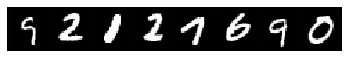

step 31792, loss 0.9308869242668152
Target:	 tensor([4, 4, 2, 2, 8, 8, 1, 4])
Pred:	 tensor([4, 4, 1, 2, 3, 8, 1, 4])


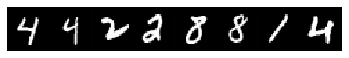

step 31842, loss 0.8480384945869446
Target:	 tensor([0, 0, 7, 8, 4, 9, 5, 2])
Pred:	 tensor([0, 0, 7, 8, 4, 9, 5, 2])


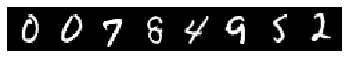

step 31892, loss 0.7740089297294617
Target:	 tensor([8, 3, 2, 0, 4, 6, 9, 3])
Pred:	 tensor([8, 3, 2, 0, 4, 6, 9, 3])


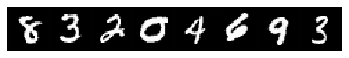

step 31942, loss 0.8671688437461853
Target:	 tensor([2, 5, 2, 5, 0, 5, 8, 9])
Pred:	 tensor([2, 5, 2, 5, 0, 5, 7, 9])


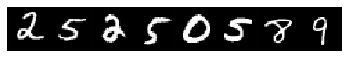

step 31992, loss 0.6945710778236389
Target:	 tensor([6, 2, 2, 0, 2, 4, 0, 1])
Pred:	 tensor([6, 2, 2, 0, 3, 9, 0, 1])


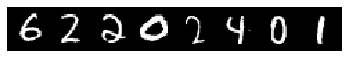

step 32042, loss 0.788731575012207
Target:	 tensor([2, 4, 5, 5, 6, 2, 6, 0])
Pred:	 tensor([2, 9, 5, 5, 6, 2, 6, 0])


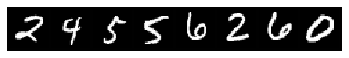

step 32092, loss 1.022907018661499
Target:	 tensor([2, 2, 3, 3, 2, 7, 9, 8])
Pred:	 tensor([2, 1, 3, 3, 0, 7, 9, 0])


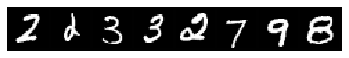

step 32142, loss 0.6146084070205688
Target:	 tensor([6, 4, 4, 9, 9, 0, 7, 5])
Pred:	 tensor([6, 4, 4, 9, 9, 0, 7, 5])


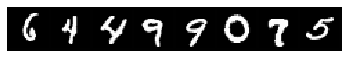

step 32192, loss 1.0314375162124634
Target:	 tensor([7, 5, 2, 4, 8, 1, 0, 5])
Pred:	 tensor([7, 5, 2, 4, 8, 1, 6, 3])


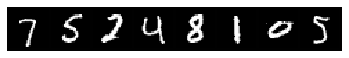

step 32242, loss 0.9940944314002991
Target:	 tensor([3, 3, 3, 1, 5, 4, 7, 5])
Pred:	 tensor([3, 3, 3, 1, 5, 9, 1, 5])


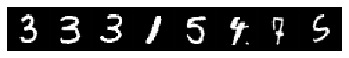

step 32292, loss 0.997478723526001
Target:	 tensor([3, 3, 4, 9, 8, 8, 6, 2])
Pred:	 tensor([3, 3, 4, 9, 8, 9, 6, 2])


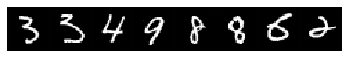

step 32342, loss 0.7759836316108704
Target:	 tensor([6, 1, 9, 3, 6, 4, 1, 2])
Pred:	 tensor([6, 1, 5, 3, 6, 4, 1, 2])


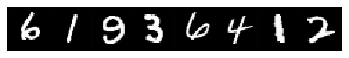

step 32383, loss 0.8451822400093079
Target:	 tensor([4, 6, 8, 3, 2, 6, 5, 8])
Pred:	 tensor([4, 6, 5, 3, 0, 6, 6, 8])


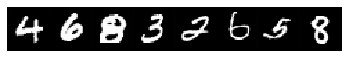

step 32433, loss 0.5816256403923035
Target:	 tensor([1, 6, 9, 6, 1, 2, 2, 9])
Pred:	 tensor([1, 6, 1, 6, 1, 2, 2, 9])


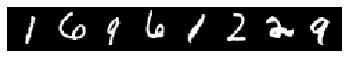

step 32483, loss 0.9166390299797058
Target:	 tensor([4, 1, 1, 2, 4, 3, 8, 1])
Pred:	 tensor([4, 1, 1, 2, 4, 3, 1, 8])


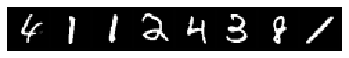

step 32533, loss 1.0446960926055908
Target:	 tensor([0, 1, 4, 2, 0, 7, 1, 6])
Pred:	 tensor([0, 1, 4, 8, 0, 7, 6, 6])


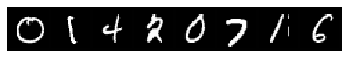

step 32583, loss 0.9837623238563538
Target:	 tensor([3, 4, 3, 1, 9, 9, 7, 3])
Pred:	 tensor([3, 4, 3, 1, 9, 4, 7, 3])


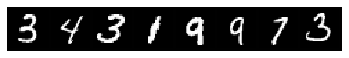

step 32633, loss 0.8974291682243347
Target:	 tensor([3, 9, 5, 6, 1, 4, 8, 5])
Pred:	 tensor([3, 9, 5, 6, 1, 4, 6, 5])


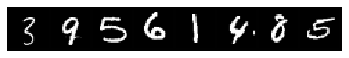

step 32683, loss 0.8570554852485657
Target:	 tensor([8, 0, 8, 3, 5, 6, 0, 6])
Pred:	 tensor([1, 0, 5, 3, 8, 6, 0, 6])


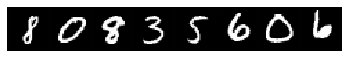

step 32733, loss 0.8397937417030334
Target:	 tensor([2, 1, 0, 7, 8, 1, 2, 9])
Pred:	 tensor([2, 1, 0, 7, 8, 1, 2, 9])


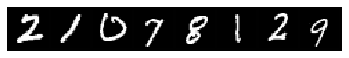

step 32783, loss 1.0685100555419922
Target:	 tensor([5, 4, 5, 8, 1, 5, 5, 8])
Pred:	 tensor([5, 4, 5, 8, 1, 5, 6, 8])


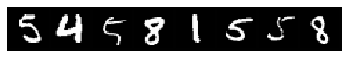

step 32833, loss 0.8401131629943848
Target:	 tensor([1, 5, 8, 1, 6, 3, 2, 4])
Pred:	 tensor([1, 5, 8, 1, 6, 3, 2, 6])


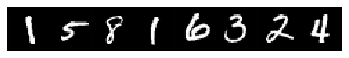

step 32883, loss 0.8099762797355652
Target:	 tensor([6, 5, 4, 6, 9, 4, 8, 1])
Pred:	 tensor([6, 5, 4, 6, 9, 4, 6, 1])


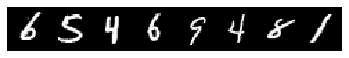

step 32933, loss 0.9758763909339905
Target:	 tensor([2, 8, 3, 5, 9, 4, 3, 2])
Pred:	 tensor([2, 9, 7, 8, 9, 4, 3, 2])


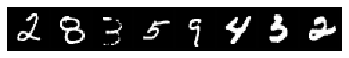

step 32983, loss 0.9930331110954285
Target:	 tensor([2, 1, 2, 0, 5, 2, 3, 8])
Pred:	 tensor([2, 1, 1, 0, 5, 1, 3, 8])


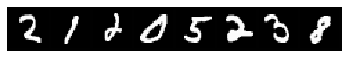

step 33033, loss 0.7184221148490906
Target:	 tensor([5, 8, 8, 7, 4, 7, 3, 6])
Pred:	 tensor([5, 8, 1, 7, 4, 7, 5, 1])


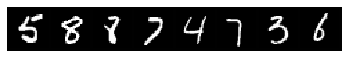

step 33083, loss 0.7880554795265198
Target:	 tensor([4, 2, 2, 7, 3, 1, 6, 6])
Pred:	 tensor([4, 2, 2, 7, 3, 1, 6, 6])


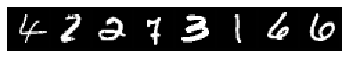

step 33133, loss 0.806736946105957
Target:	 tensor([5, 1, 9, 7, 1, 8, 4, 7])
Pred:	 tensor([5, 1, 9, 5, 1, 8, 4, 7])


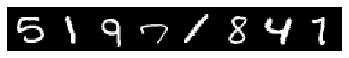

step 33183, loss 0.7421772480010986
Target:	 tensor([3, 9, 3, 2, 8, 0, 5, 7])
Pred:	 tensor([3, 9, 3, 2, 6, 0, 1, 9])


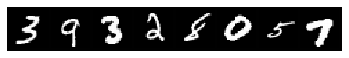

step 33233, loss 0.5124082565307617
Target:	 tensor([6, 0, 5, 8, 1, 4, 0, 3])
Pred:	 tensor([6, 0, 5, 8, 1, 4, 0, 3])


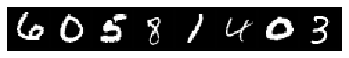

step 33283, loss 0.7117548584938049
Target:	 tensor([7, 0, 4, 6, 7, 1, 5, 1])
Pred:	 tensor([7, 0, 4, 6, 7, 1, 5, 1])


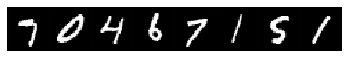

step 33333, loss 0.6088875532150269
Target:	 tensor([5, 3, 4, 4, 2, 6, 3, 1])
Pred:	 tensor([5, 3, 4, 4, 2, 6, 3, 1])


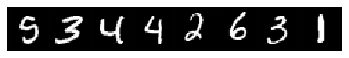

step 33383, loss 0.7018005847930908
Target:	 tensor([6, 6, 5, 9, 7, 3, 9, 6])
Pred:	 tensor([6, 0, 5, 9, 9, 6, 9, 6])


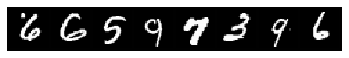

step 33433, loss 0.8739822506904602
Target:	 tensor([2, 8, 7, 0, 2, 9, 3, 4])
Pred:	 tensor([4, 8, 7, 0, 2, 9, 3, 4])


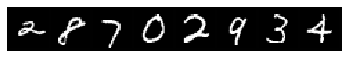

step 33483, loss 0.929810106754303
Target:	 tensor([5, 5, 4, 8, 8, 2, 2, 0])
Pred:	 tensor([5, 5, 4, 8, 1, 4, 2, 0])


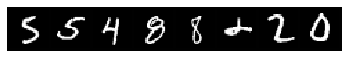

step 33533, loss 0.8923432230949402
Target:	 tensor([1, 0, 1, 9, 3, 2, 4, 8])
Pred:	 tensor([1, 0, 1, 9, 0, 2, 4, 8])


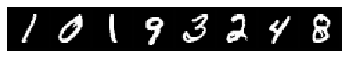

step 33583, loss 0.8244739174842834
Target:	 tensor([5, 5, 4, 1, 6, 9, 8, 8])
Pred:	 tensor([5, 2, 4, 1, 6, 9, 8, 8])


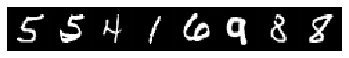

step 33633, loss 0.6946540474891663
Target:	 tensor([5, 2, 7, 7, 7, 5, 2, 7])
Pred:	 tensor([5, 2, 7, 7, 7, 4, 2, 7])


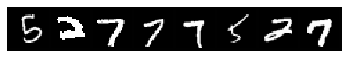

step 33683, loss 1.044009804725647
Target:	 tensor([7, 1, 1, 0, 4, 2, 8, 1])
Pred:	 tensor([1, 1, 1, 0, 4, 2, 8, 1])


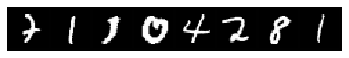

step 33733, loss 0.790854275226593
Target:	 tensor([0, 7, 9, 1, 6, 2, 9, 0])
Pred:	 tensor([0, 7, 3, 1, 6, 2, 7, 0])


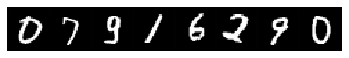

step 33783, loss 0.8182523846626282
Target:	 tensor([1, 4, 8, 5, 8, 7, 9, 2])
Pred:	 tensor([1, 4, 3, 1, 8, 7, 4, 2])


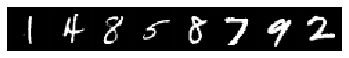

step 33833, loss 0.7012193202972412
Target:	 tensor([3, 1, 8, 1, 2, 7, 1, 3])
Pred:	 tensor([3, 1, 9, 1, 2, 7, 1, 3])


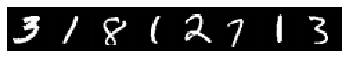

step 33883, loss 0.6543071269989014
Target:	 tensor([1, 7, 5, 7, 8, 0, 7, 0])
Pred:	 tensor([1, 7, 5, 7, 8, 0, 7, 0])


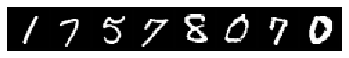

step 33933, loss 1.0288479328155518
Target:	 tensor([5, 6, 4, 7, 7, 6, 6, 5])
Pred:	 tensor([4, 6, 4, 7, 7, 6, 6, 1])


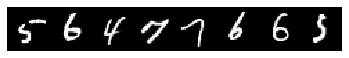

step 33983, loss 0.7353773713111877
Target:	 tensor([7, 7, 1, 0, 4, 7, 0, 2])
Pred:	 tensor([7, 7, 1, 0, 4, 7, 0, 2])


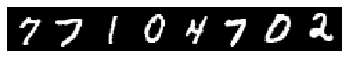

step 34033, loss 0.8336853981018066
Target:	 tensor([1, 4, 6, 2, 6, 8, 0, 7])
Pred:	 tensor([1, 4, 6, 2, 6, 8, 0, 7])


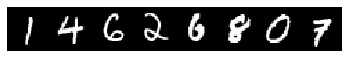

step 34083, loss 0.6907535195350647
Target:	 tensor([2, 6, 4, 3, 6, 0, 2, 7])
Pred:	 tensor([2, 6, 4, 3, 6, 0, 2, 1])


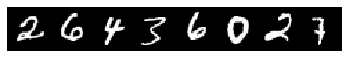

step 34133, loss 0.6610651016235352
Target:	 tensor([9, 3, 2, 8, 5, 2, 6, 7])
Pred:	 tensor([9, 2, 2, 8, 5, 2, 6, 7])


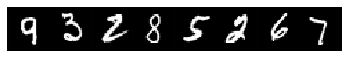

step 34183, loss 0.9875664710998535
Target:	 tensor([3, 8, 4, 9, 6, 6, 3, 9])
Pred:	 tensor([3, 8, 0, 9, 6, 6, 3, 4])


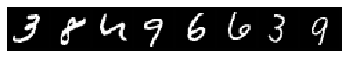

step 34233, loss 0.8730905652046204
Target:	 tensor([1, 7, 1, 3, 2, 4, 3, 4])
Pred:	 tensor([1, 7, 1, 7, 2, 4, 3, 4])


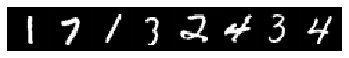

step 34283, loss 0.7918552756309509
Target:	 tensor([0, 9, 7, 1, 6, 3, 2, 9])
Pred:	 tensor([0, 9, 7, 1, 6, 3, 2, 4])


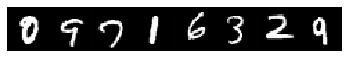

step 34333, loss 0.715941846370697
Target:	 tensor([8, 9, 6, 7, 0, 5, 1, 5])
Pred:	 tensor([8, 0, 6, 9, 0, 5, 1, 5])


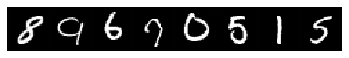

step 34383, loss 0.7105575203895569
Target:	 tensor([9, 5, 1, 9, 9, 1, 8, 2])
Pred:	 tensor([9, 5, 1, 9, 9, 1, 8, 2])


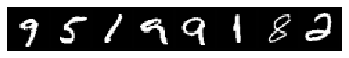

step 34433, loss 0.7063567638397217
Target:	 tensor([9, 3, 6, 9, 0, 5, 9, 0])
Pred:	 tensor([9, 5, 6, 9, 0, 5, 9, 0])


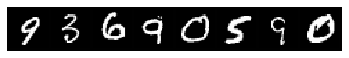

step 34483, loss 0.7591418623924255
Target:	 tensor([1, 8, 3, 9, 5, 8, 6, 3])
Pred:	 tensor([1, 6, 5, 7, 5, 3, 6, 3])


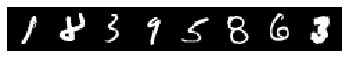

step 34533, loss 0.4386146068572998
Target:	 tensor([9, 7, 9, 1, 9, 8, 9, 0])
Pred:	 tensor([9, 7, 9, 1, 9, 8, 4, 0])


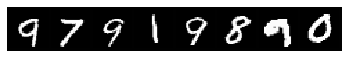

step 34583, loss 0.99898362159729
Target:	 tensor([8, 2, 1, 8, 6, 9, 8, 0])
Pred:	 tensor([8, 2, 1, 8, 6, 4, 8, 0])


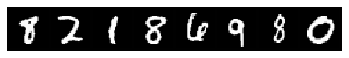

step 34633, loss 0.845240592956543
Target:	 tensor([5, 1, 4, 6, 9, 9, 5, 2])
Pred:	 tensor([5, 1, 4, 6, 4, 9, 5, 1])


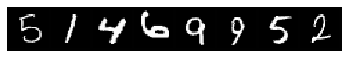

step 34683, loss 0.8340950608253479
Target:	 tensor([8, 1, 1, 8, 6, 8, 6, 1])
Pred:	 tensor([8, 1, 1, 8, 6, 3, 6, 1])


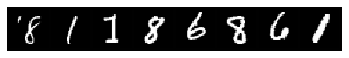

step 34733, loss 0.7549100518226624
Target:	 tensor([1, 9, 4, 6, 7, 3, 6, 0])
Pred:	 tensor([1, 9, 4, 6, 7, 3, 2, 0])


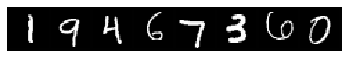

step 34783, loss 0.9026326537132263
Target:	 tensor([1, 8, 6, 5, 6, 8, 9, 0])
Pred:	 tensor([1, 8, 6, 3, 6, 8, 9, 0])


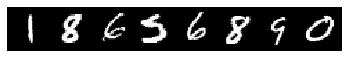

step 34833, loss 0.6135395169258118
Target:	 tensor([2, 0, 4, 1, 5, 4, 1, 5])
Pred:	 tensor([2, 0, 4, 1, 5, 4, 1, 8])


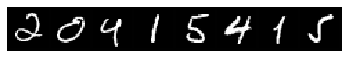

step 34874, loss 0.8383686542510986
Target:	 tensor([1, 0, 2, 5, 3, 5, 4, 1])
Pred:	 tensor([1, 0, 2, 5, 5, 5, 4, 1])


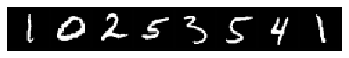

step 34924, loss 0.9597184062004089
Target:	 tensor([7, 1, 9, 9, 8, 9, 4, 9])
Pred:	 tensor([7, 1, 9, 9, 8, 9, 4, 7])


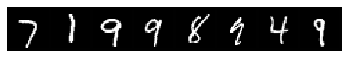

step 34974, loss 0.5252242684364319
Target:	 tensor([4, 2, 9, 8, 7, 4, 7, 8])
Pred:	 tensor([4, 2, 9, 8, 7, 4, 7, 8])


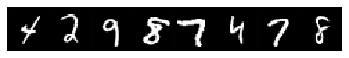

step 35024, loss 0.7866925597190857
Target:	 tensor([1, 5, 9, 1, 8, 9, 9, 4])
Pred:	 tensor([1, 5, 9, 1, 6, 4, 7, 9])


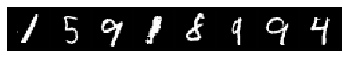

step 35074, loss 0.8897483944892883
Target:	 tensor([8, 1, 0, 0, 5, 6, 2, 1])
Pred:	 tensor([8, 1, 0, 0, 5, 6, 2, 1])


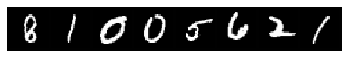

step 35124, loss 0.6747462153434753
Target:	 tensor([9, 5, 6, 2, 1, 9, 0, 0])
Pred:	 tensor([9, 8, 6, 2, 1, 9, 0, 0])


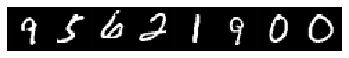

step 35174, loss 0.6135594844818115
Target:	 tensor([9, 1, 4, 0, 5, 0, 3, 5])
Pred:	 tensor([9, 1, 4, 8, 5, 0, 8, 5])


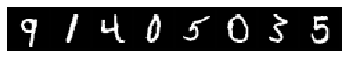

step 35224, loss 0.7736418843269348
Target:	 tensor([2, 8, 6, 2, 8, 8, 4, 7])
Pred:	 tensor([6, 8, 6, 2, 8, 8, 4, 7])


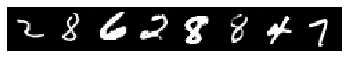

step 35274, loss 0.8891705870628357
Target:	 tensor([0, 2, 8, 8, 6, 3, 8, 4])
Pred:	 tensor([0, 2, 8, 8, 6, 3, 1, 6])


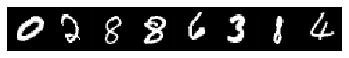

step 35324, loss 0.6529008746147156
Target:	 tensor([2, 7, 0, 4, 5, 0, 0, 7])
Pred:	 tensor([2, 7, 0, 4, 5, 0, 0, 9])


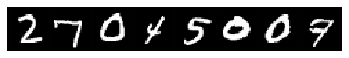

step 35374, loss 0.6617017388343811
Target:	 tensor([9, 0, 7, 3, 4, 7, 3, 4])
Pred:	 tensor([9, 0, 7, 3, 4, 7, 3, 4])


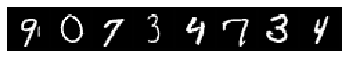

step 35424, loss 0.6413162350654602
Target:	 tensor([2, 1, 5, 0, 4, 2, 9, 5])
Pred:	 tensor([2, 8, 0, 0, 4, 2, 9, 5])


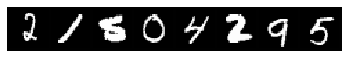

step 35474, loss 0.6188757419586182
Target:	 tensor([6, 4, 7, 0, 7, 2, 6, 1])
Pred:	 tensor([6, 4, 7, 0, 7, 2, 1, 1])


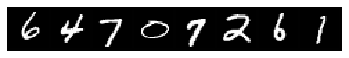

step 35524, loss 0.7553012371063232
Target:	 tensor([5, 3, 5, 6, 2, 2, 8, 0])
Pred:	 tensor([5, 3, 6, 6, 2, 2, 1, 0])


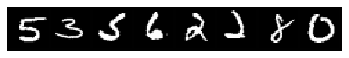

step 35574, loss 1.1222997903823853
Target:	 tensor([5, 0, 4, 2, 0, 6, 8, 4])
Pred:	 tensor([3, 0, 9, 2, 0, 6, 8, 4])


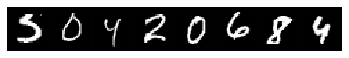

step 35624, loss 0.547011137008667
Target:	 tensor([4, 6, 4, 9, 1, 9, 9, 4])
Pred:	 tensor([4, 6, 4, 4, 1, 9, 9, 4])


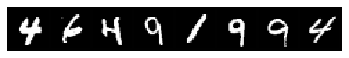

step 35674, loss 0.5744393467903137
Target:	 tensor([4, 1, 5, 1, 5, 6, 4, 5])
Pred:	 tensor([4, 1, 5, 1, 5, 6, 4, 5])


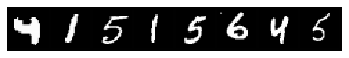

step 35724, loss 0.6995477676391602
Target:	 tensor([8, 2, 3, 8, 4, 1, 1, 7])
Pred:	 tensor([8, 2, 3, 8, 4, 1, 1, 7])


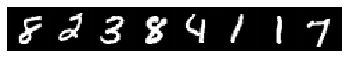

step 35774, loss 0.9141783714294434
Target:	 tensor([3, 2, 2, 6, 8, 3, 6, 6])
Pred:	 tensor([3, 1, 2, 6, 8, 3, 6, 6])


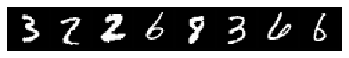

step 35824, loss 0.8464131355285645
Target:	 tensor([0, 0, 8, 4, 7, 3, 6, 9])
Pred:	 tensor([0, 0, 3, 1, 7, 3, 6, 4])


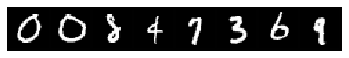

step 35874, loss 0.8602257370948792
Target:	 tensor([3, 2, 5, 9, 6, 3, 8, 3])
Pred:	 tensor([3, 2, 3, 2, 6, 3, 3, 2])


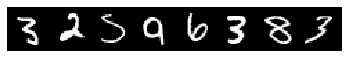

step 35924, loss 0.557896077632904
Target:	 tensor([7, 7, 4, 3, 1, 0, 0, 8])
Pred:	 tensor([7, 7, 4, 3, 1, 0, 0, 1])


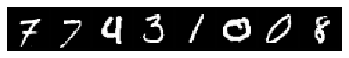

step 35974, loss 0.8993954658508301
Target:	 tensor([5, 6, 9, 9, 1, 0, 5, 9])
Pred:	 tensor([8, 6, 9, 9, 1, 0, 5, 9])


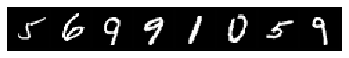

step 36024, loss 0.7710742950439453
Target:	 tensor([7, 9, 5, 4, 4, 8, 5, 9])
Pred:	 tensor([7, 9, 5, 1, 4, 1, 5, 9])


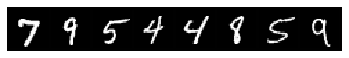

step 36074, loss 0.6802416443824768
Target:	 tensor([3, 4, 8, 0, 9, 3, 2, 4])
Pred:	 tensor([3, 4, 8, 0, 9, 3, 6, 4])


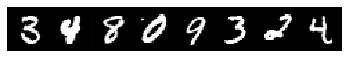

step 36124, loss 1.0122915506362915
Target:	 tensor([5, 1, 8, 7, 9, 0, 3, 8])
Pred:	 tensor([5, 1, 3, 7, 9, 0, 3, 7])


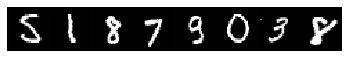

step 36174, loss 0.967413604259491
Target:	 tensor([6, 9, 2, 7, 8, 6, 6, 9])
Pred:	 tensor([6, 9, 2, 7, 9, 6, 6, 9])


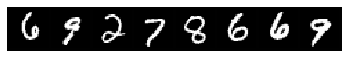

step 36224, loss 0.7479587197303772
Target:	 tensor([7, 1, 4, 1, 9, 0, 8, 4])
Pred:	 tensor([9, 1, 4, 1, 9, 0, 8, 4])


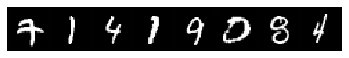

step 36274, loss 0.8915762901306152
Target:	 tensor([1, 7, 7, 8, 4, 2, 7, 2])
Pred:	 tensor([6, 7, 7, 8, 4, 2, 7, 0])


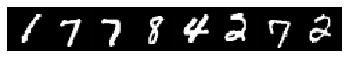

step 36324, loss 0.697612464427948
Target:	 tensor([8, 8, 2, 9, 9, 2, 8, 8])
Pred:	 tensor([8, 8, 2, 9, 9, 2, 3, 8])


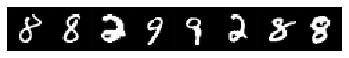

step 36374, loss 0.9479640126228333
Target:	 tensor([1, 6, 5, 4, 0, 9, 5, 2])
Pred:	 tensor([1, 6, 5, 4, 0, 9, 3, 2])


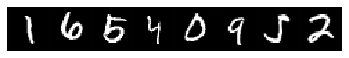

step 36424, loss 0.5373589396476746
Target:	 tensor([0, 1, 5, 4, 6, 6, 5, 2])
Pred:	 tensor([0, 1, 5, 4, 6, 6, 5, 2])


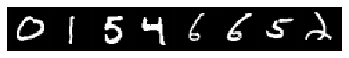

step 36474, loss 0.99721759557724
Target:	 tensor([7, 7, 8, 3, 3, 3, 4, 3])
Pred:	 tensor([7, 7, 8, 3, 8, 3, 4, 6])


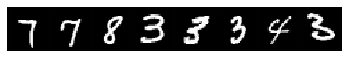

step 36524, loss 0.6858766078948975
Target:	 tensor([4, 0, 5, 8, 0, 3, 1, 3])
Pred:	 tensor([9, 0, 5, 3, 0, 3, 1, 3])


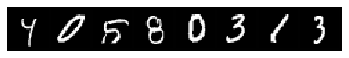

step 36574, loss 0.7820947766304016
Target:	 tensor([8, 0, 8, 1, 5, 8, 0, 4])
Pred:	 tensor([3, 0, 8, 1, 5, 8, 0, 4])


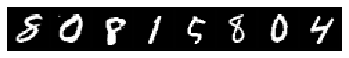

step 36624, loss 0.8531739115715027
Target:	 tensor([9, 8, 4, 0, 1, 6, 1, 5])
Pred:	 tensor([9, 8, 4, 0, 1, 6, 1, 5])


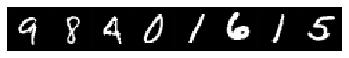

step 36674, loss 0.6540641188621521
Target:	 tensor([4, 5, 0, 9, 5, 5, 7, 3])
Pred:	 tensor([4, 5, 0, 9, 5, 4, 7, 3])


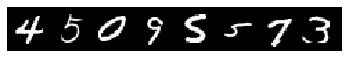

step 36724, loss 0.7524412274360657
Target:	 tensor([1, 7, 3, 3, 8, 1, 0, 1])
Pred:	 tensor([1, 7, 2, 3, 8, 1, 0, 1])


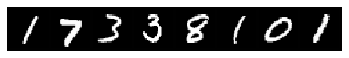

step 36774, loss 0.730758011341095
Target:	 tensor([1, 7, 1, 1, 2, 9, 1, 1])
Pred:	 tensor([1, 7, 1, 1, 2, 9, 1, 1])


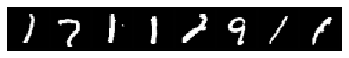

step 36824, loss 0.6993451118469238
Target:	 tensor([0, 2, 8, 4, 1, 5, 2, 8])
Pred:	 tensor([0, 2, 8, 4, 1, 9, 2, 8])


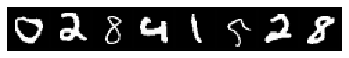

step 36874, loss 0.8097481727600098
Target:	 tensor([7, 9, 2, 4, 7, 1, 1, 4])
Pred:	 tensor([7, 9, 2, 4, 7, 1, 1, 6])


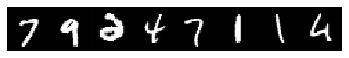

step 36924, loss 0.6822910904884338
Target:	 tensor([1, 3, 2, 4, 7, 2, 0, 1])
Pred:	 tensor([1, 3, 2, 4, 9, 2, 0, 1])


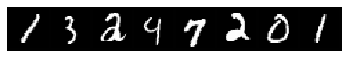

step 36974, loss 0.660153865814209
Target:	 tensor([2, 6, 9, 8, 3, 9, 4, 7])
Pred:	 tensor([2, 6, 9, 8, 3, 9, 4, 7])


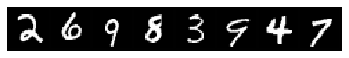

step 37024, loss 0.8468500971794128
Target:	 tensor([3, 3, 1, 1, 3, 2, 6, 3])
Pred:	 tensor([3, 3, 1, 1, 2, 2, 6, 3])


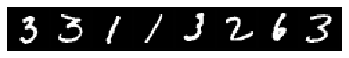

step 37074, loss 0.7809174060821533
Target:	 tensor([6, 0, 3, 4, 2, 5, 2, 4])
Pred:	 tensor([6, 0, 3, 4, 2, 5, 2, 4])


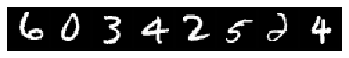

step 37124, loss 0.8787081241607666
Target:	 tensor([1, 3, 7, 1, 0, 1, 1, 3])
Pred:	 tensor([1, 3, 7, 1, 0, 8, 1, 3])


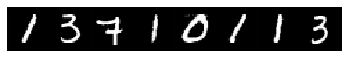

step 37174, loss 0.9877342581748962
Target:	 tensor([0, 2, 6, 7, 0, 7, 2, 2])
Pred:	 tensor([0, 7, 6, 7, 0, 7, 1, 2])


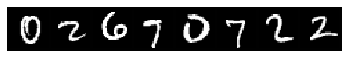

step 37224, loss 0.7092690467834473
Target:	 tensor([5, 8, 6, 6, 3, 0, 0, 8])
Pred:	 tensor([5, 8, 6, 6, 3, 0, 0, 1])


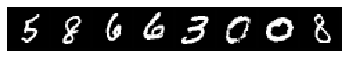

step 37274, loss 0.8648868203163147
Target:	 tensor([4, 9, 0, 3, 5, 6, 8, 9])
Pred:	 tensor([4, 0, 8, 3, 5, 6, 8, 9])


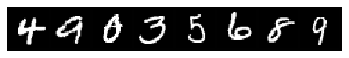

step 37324, loss 0.8984427452087402
Target:	 tensor([9, 6, 6, 7, 1, 9, 1, 8])
Pred:	 tensor([9, 6, 6, 7, 1, 9, 1, 8])


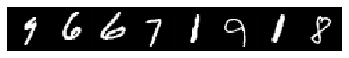

step 37365, loss 0.8270106911659241
Target:	 tensor([9, 4, 4, 6, 9, 3, 9, 9])
Pred:	 tensor([7, 4, 9, 6, 4, 3, 2, 7])


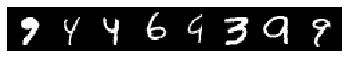

step 37415, loss 0.6827161908149719
Target:	 tensor([3, 7, 6, 4, 1, 6, 8, 0])
Pred:	 tensor([3, 7, 6, 4, 1, 6, 8, 0])


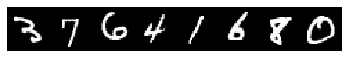

step 37465, loss 0.7447215914726257
Target:	 tensor([3, 2, 2, 4, 6, 1, 1, 5])
Pred:	 tensor([3, 2, 2, 4, 0, 1, 1, 9])


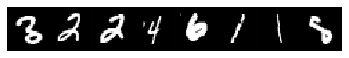

step 37515, loss 0.935430109500885
Target:	 tensor([2, 1, 7, 6, 6, 9, 7, 6])
Pred:	 tensor([2, 1, 7, 6, 6, 9, 7, 6])


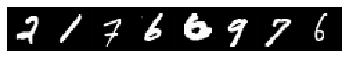

step 37565, loss 0.6860881447792053
Target:	 tensor([7, 7, 6, 5, 9, 3, 1, 0])
Pred:	 tensor([7, 7, 5, 5, 9, 3, 1, 0])


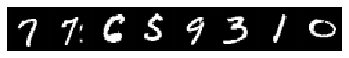

step 37615, loss 0.7696152329444885
Target:	 tensor([5, 2, 1, 2, 7, 2, 6, 0])
Pred:	 tensor([2, 2, 1, 2, 7, 1, 6, 0])


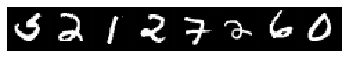

step 37665, loss 0.9662615656852722
Target:	 tensor([1, 8, 2, 9, 3, 1, 8, 5])
Pred:	 tensor([1, 3, 2, 9, 2, 1, 1, 5])


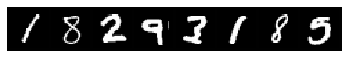

step 37715, loss 0.8867819905281067
Target:	 tensor([5, 8, 8, 8, 6, 2, 7, 5])
Pred:	 tensor([5, 1, 5, 1, 6, 2, 7, 5])


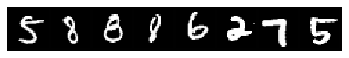

step 37765, loss 0.6041749119758606
Target:	 tensor([1, 2, 7, 6, 5, 3, 5, 6])
Pred:	 tensor([1, 2, 7, 6, 5, 3, 5, 6])


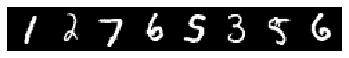

step 37815, loss 0.8151212334632874
Target:	 tensor([9, 1, 0, 2, 4, 4, 4, 1])
Pred:	 tensor([7, 1, 0, 1, 4, 4, 4, 1])


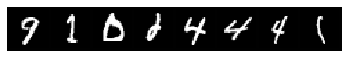

step 37865, loss 0.8012678027153015
Target:	 tensor([7, 2, 1, 7, 5, 8, 0, 4])
Pred:	 tensor([7, 2, 1, 7, 3, 8, 0, 4])


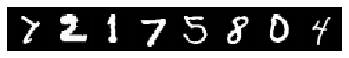

step 37915, loss 0.8988623023033142
Target:	 tensor([7, 3, 1, 0, 1, 2, 4, 5])
Pred:	 tensor([1, 3, 1, 0, 7, 2, 4, 5])


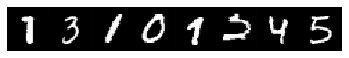

step 37965, loss 0.7980855107307434
Target:	 tensor([8, 3, 6, 4, 7, 6, 8, 9])
Pred:	 tensor([5, 3, 6, 4, 7, 6, 8, 9])


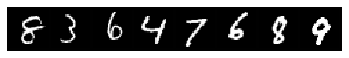

step 38015, loss 0.7969550490379333
Target:	 tensor([5, 1, 1, 0, 7, 9, 7, 9])
Pred:	 tensor([3, 1, 1, 0, 7, 9, 7, 9])


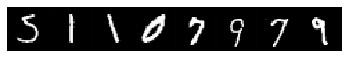

step 38065, loss 0.5899989008903503
Target:	 tensor([0, 9, 8, 8, 7, 8, 7, 5])
Pred:	 tensor([0, 9, 8, 8, 7, 8, 7, 5])


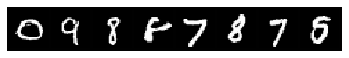

step 38115, loss 0.903092086315155
Target:	 tensor([5, 9, 3, 9, 7, 9, 5, 6])
Pred:	 tensor([3, 9, 3, 0, 9, 9, 5, 6])


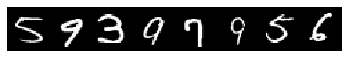

step 38165, loss 0.939093291759491
Target:	 tensor([2, 9, 4, 8, 4, 1, 3, 8])
Pred:	 tensor([2, 9, 4, 8, 4, 1, 3, 3])


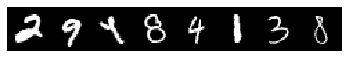

step 38215, loss 1.038021206855774
Target:	 tensor([1, 5, 4, 6, 1, 5, 5, 7])
Pred:	 tensor([1, 5, 4, 6, 5, 4, 8, 7])


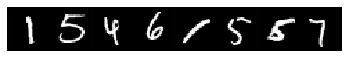

step 38265, loss 0.8746994137763977
Target:	 tensor([7, 0, 4, 6, 6, 5, 0, 0])
Pred:	 tensor([7, 0, 4, 0, 6, 5, 0, 0])


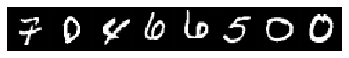

step 38315, loss 0.8737838864326477
Target:	 tensor([8, 7, 2, 4, 6, 3, 5, 4])
Pred:	 tensor([8, 7, 2, 4, 6, 3, 4, 4])


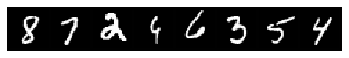

step 38365, loss 0.43620410561561584
Target:	 tensor([1, 5, 5, 3, 7, 2, 9, 7])
Pred:	 tensor([1, 5, 5, 2, 7, 2, 9, 7])


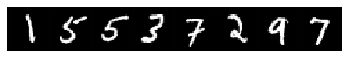

step 38415, loss 0.9955641627311707
Target:	 tensor([1, 7, 0, 3, 9, 9, 6, 0])
Pred:	 tensor([1, 7, 0, 3, 7, 9, 6, 0])


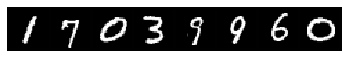

step 38465, loss 0.8049290180206299
Target:	 tensor([7, 6, 6, 9, 3, 1, 9, 6])
Pred:	 tensor([7, 6, 6, 4, 3, 1, 9, 6])


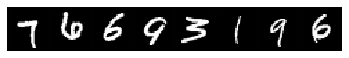

step 38515, loss 0.7905091643333435
Target:	 tensor([5, 8, 7, 2, 1, 8, 5, 3])
Pred:	 tensor([0, 7, 7, 2, 1, 8, 5, 3])


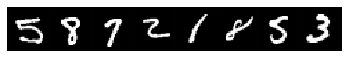

step 38565, loss 0.7892213463783264
Target:	 tensor([8, 0, 2, 2, 6, 7, 9, 6])
Pred:	 tensor([3, 0, 2, 2, 6, 7, 9, 6])


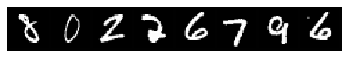

step 38615, loss 1.0200790166854858
Target:	 tensor([9, 6, 8, 9, 0, 4, 8, 5])
Pred:	 tensor([9, 1, 8, 7, 0, 4, 8, 5])


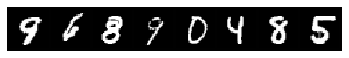

step 38665, loss 0.7050562500953674
Target:	 tensor([3, 2, 6, 8, 3, 5, 3, 5])
Pred:	 tensor([2, 2, 6, 8, 3, 8, 7, 5])


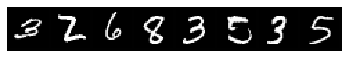

step 38715, loss 0.9895707964897156
Target:	 tensor([7, 3, 9, 3, 1, 1, 4, 2])
Pred:	 tensor([7, 3, 9, 3, 1, 1, 6, 2])


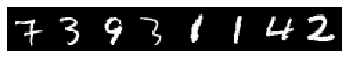

step 38765, loss 0.9023416042327881
Target:	 tensor([9, 1, 3, 8, 0, 2, 5, 2])
Pred:	 tensor([9, 1, 3, 0, 0, 2, 5, 8])


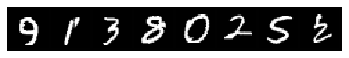

step 38815, loss 0.5087785124778748
Target:	 tensor([2, 6, 5, 5, 0, 4, 6, 1])
Pred:	 tensor([2, 6, 5, 5, 0, 4, 6, 1])


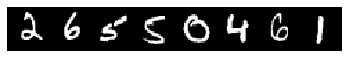

step 38865, loss 0.9661526679992676
Target:	 tensor([8, 3, 2, 0, 9, 5, 7, 3])
Pred:	 tensor([8, 3, 2, 0, 9, 5, 9, 3])


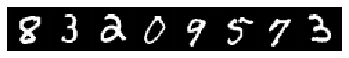

step 38915, loss 0.7792565226554871
Target:	 tensor([3, 3, 2, 6, 3, 8, 7, 5])
Pred:	 tensor([3, 7, 2, 6, 3, 8, 9, 5])


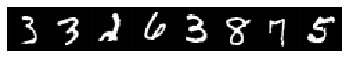

step 38965, loss 0.5733591914176941
Target:	 tensor([4, 9, 5, 0, 7, 8, 6, 9])
Pred:	 tensor([4, 9, 5, 0, 7, 8, 6, 9])


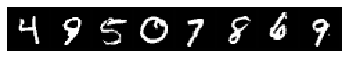

step 39015, loss 0.6543698906898499
Target:	 tensor([4, 8, 1, 1, 0, 6, 0, 6])
Pred:	 tensor([4, 8, 1, 8, 0, 6, 0, 6])


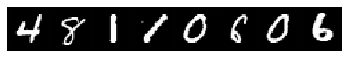

step 39065, loss 0.6952927112579346
Target:	 tensor([1, 2, 7, 0, 8, 4, 9, 1])
Pred:	 tensor([1, 2, 7, 0, 8, 4, 9, 1])


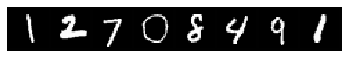

step 39115, loss 0.8767578601837158
Target:	 tensor([9, 3, 5, 4, 5, 1, 1, 1])
Pred:	 tensor([9, 7, 5, 4, 8, 1, 1, 1])


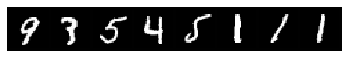

step 39165, loss 0.9154391288757324
Target:	 tensor([0, 7, 9, 2, 3, 0, 9, 1])
Pred:	 tensor([0, 7, 9, 2, 3, 0, 9, 1])


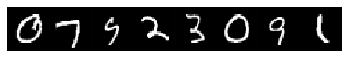

step 39215, loss 0.6576007008552551
Target:	 tensor([9, 1, 0, 8, 1, 0, 4, 6])
Pred:	 tensor([9, 1, 0, 0, 1, 0, 4, 6])


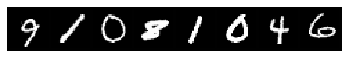

step 39265, loss 1.0106778144836426
Target:	 tensor([2, 7, 2, 0, 3, 0, 5, 2])
Pred:	 tensor([8, 7, 2, 0, 3, 0, 5, 6])


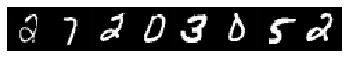

step 39315, loss 0.7386627197265625
Target:	 tensor([4, 4, 6, 9, 8, 9, 6, 0])
Pred:	 tensor([4, 4, 6, 9, 3, 9, 6, 0])


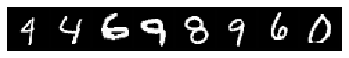

step 39365, loss 0.8797604441642761
Target:	 tensor([7, 1, 8, 1, 7, 0, 2, 1])
Pred:	 tensor([7, 1, 3, 1, 7, 0, 1, 1])


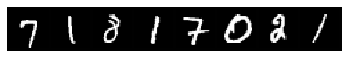

step 39415, loss 0.7181760668754578
Target:	 tensor([3, 2, 4, 6, 8, 5, 6, 7])
Pred:	 tensor([3, 2, 4, 6, 8, 5, 6, 7])


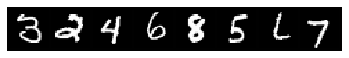

step 39465, loss 0.8459262251853943
Target:	 tensor([8, 9, 2, 1, 1, 1, 3, 0])
Pred:	 tensor([8, 9, 6, 1, 1, 1, 3, 0])


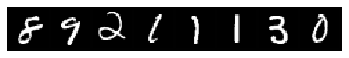

step 39515, loss 0.6797464489936829
Target:	 tensor([3, 7, 8, 9, 7, 6, 4, 4])
Pred:	 tensor([3, 7, 8, 9, 7, 6, 9, 4])


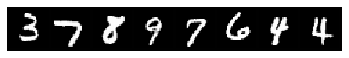

step 39565, loss 0.7675560116767883
Target:	 tensor([0, 7, 6, 3, 3, 6, 5, 1])
Pred:	 tensor([0, 7, 6, 2, 2, 6, 5, 1])


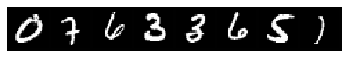

step 39615, loss 0.7504756450653076
Target:	 tensor([6, 5, 4, 6, 9, 6, 2, 9])
Pred:	 tensor([0, 3, 4, 6, 7, 6, 2, 9])


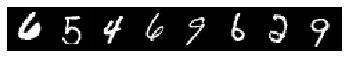

step 39665, loss 0.7631922364234924
Target:	 tensor([3, 1, 8, 7, 6, 2, 1, 0])
Pred:	 tensor([3, 1, 3, 7, 6, 2, 7, 0])


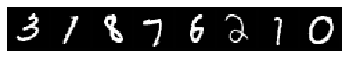

step 39715, loss 0.9228503108024597
Target:	 tensor([7, 9, 1, 1, 8, 2, 6, 9])
Pred:	 tensor([7, 5, 1, 1, 9, 2, 6, 9])


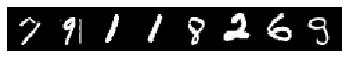

step 39765, loss 0.8738091588020325
Target:	 tensor([0, 1, 0, 8, 0, 8, 4, 5])
Pred:	 tensor([0, 1, 0, 8, 0, 3, 4, 5])


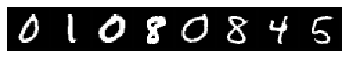

step 39815, loss 0.7469444274902344
Target:	 tensor([6, 5, 8, 8, 0, 2, 7, 3])
Pred:	 tensor([6, 5, 8, 1, 0, 2, 9, 3])


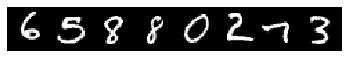

step 39856, loss 0.6086705327033997
Target:	 tensor([8, 2, 5, 6, 7, 4, 4, 1])
Pred:	 tensor([8, 2, 9, 6, 7, 4, 4, 1])


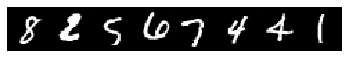

step 39906, loss 0.6631777882575989
Target:	 tensor([8, 6, 2, 1, 6, 7, 5, 0])
Pred:	 tensor([8, 6, 2, 1, 6, 7, 5, 0])


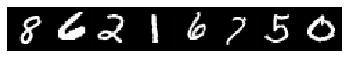

step 39956, loss 0.9121809005737305
Target:	 tensor([1, 1, 4, 9, 8, 2, 7, 8])
Pred:	 tensor([8, 1, 4, 9, 8, 2, 7, 8])


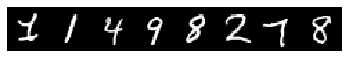

step 40006, loss 1.0314375162124634
Target:	 tensor([9, 1, 6, 9, 7, 9, 4, 8])
Pred:	 tensor([9, 1, 6, 9, 7, 9, 4, 7])


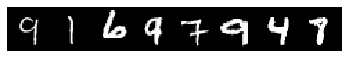

step 40056, loss 0.8057212829589844
Target:	 tensor([7, 7, 2, 4, 8, 9, 9, 8])
Pred:	 tensor([7, 9, 2, 4, 8, 9, 9, 8])


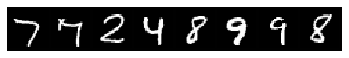

step 40106, loss 0.8116044402122498
Target:	 tensor([7, 0, 5, 2, 9, 1, 6, 9])
Pred:	 tensor([7, 0, 8, 2, 9, 1, 6, 9])


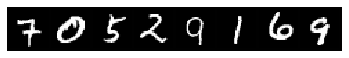

step 40156, loss 0.934969961643219
Target:	 tensor([8, 2, 3, 5, 6, 2, 8, 4])
Pred:	 tensor([8, 2, 9, 5, 6, 6, 8, 4])


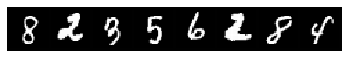

step 40206, loss 0.7294390797615051
Target:	 tensor([6, 9, 7, 3, 5, 2, 1, 3])
Pred:	 tensor([6, 9, 7, 7, 5, 2, 1, 3])


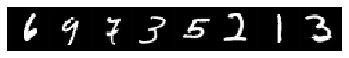

step 40256, loss 0.73985356092453
Target:	 tensor([7, 8, 9, 6, 8, 5, 1, 1])
Pred:	 tensor([7, 8, 9, 6, 4, 8, 1, 1])


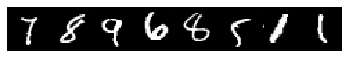

step 40306, loss 0.6165408492088318
Target:	 tensor([0, 9, 4, 9, 4, 3, 2, 7])
Pred:	 tensor([0, 9, 4, 9, 4, 1, 2, 7])


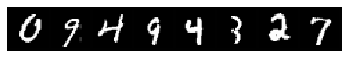

step 40356, loss 0.8563609719276428
Target:	 tensor([0, 9, 5, 3, 4, 5, 9, 0])
Pred:	 tensor([0, 4, 5, 3, 4, 9, 9, 0])


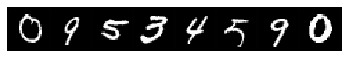

step 40406, loss 0.7476129531860352
Target:	 tensor([5, 0, 0, 7, 9, 5, 4, 6])
Pred:	 tensor([5, 0, 0, 7, 7, 5, 4, 6])


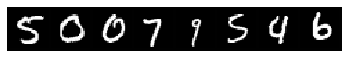

step 40456, loss 0.7325214743614197
Target:	 tensor([0, 2, 3, 6, 0, 9, 4, 2])
Pred:	 tensor([0, 2, 3, 6, 0, 4, 4, 6])


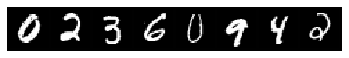

step 40506, loss 0.9482378363609314
Target:	 tensor([0, 6, 7, 6, 2, 0, 1, 3])
Pred:	 tensor([0, 6, 7, 6, 2, 0, 1, 9])


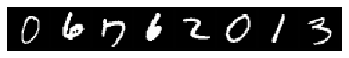

step 40556, loss 0.737023651599884
Target:	 tensor([3, 3, 1, 4, 7, 5, 7, 1])
Pred:	 tensor([3, 3, 1, 4, 7, 5, 7, 1])


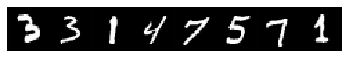

step 40606, loss 0.7350096702575684
Target:	 tensor([1, 7, 2, 2, 4, 6, 8, 8])
Pred:	 tensor([1, 7, 2, 2, 4, 6, 8, 8])


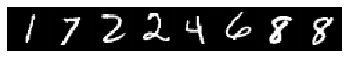

step 40656, loss 0.9053075313568115
Target:	 tensor([4, 0, 5, 0, 4, 9, 2, 6])
Pred:	 tensor([4, 0, 3, 0, 4, 9, 2, 6])


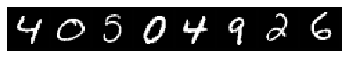

step 40706, loss 0.7217447757720947
Target:	 tensor([1, 6, 7, 9, 4, 2, 1, 5])
Pred:	 tensor([1, 6, 7, 9, 4, 2, 1, 5])


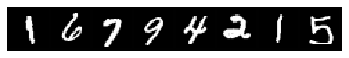

step 40756, loss 0.7497047781944275
Target:	 tensor([8, 5, 0, 2, 9, 7, 0, 9])
Pred:	 tensor([8, 5, 0, 2, 9, 7, 0, 9])


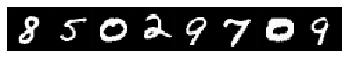

step 40806, loss 0.9732046127319336
Target:	 tensor([2, 2, 0, 6, 9, 6, 9, 9])
Pred:	 tensor([3, 2, 0, 6, 9, 6, 9, 9])


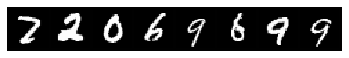

step 40856, loss 0.6937525868415833
Target:	 tensor([1, 6, 1, 6, 7, 2, 5, 9])
Pred:	 tensor([1, 6, 1, 6, 7, 2, 5, 9])


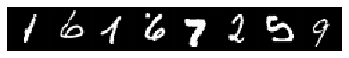

step 40906, loss 0.7793965935707092
Target:	 tensor([8, 2, 9, 4, 9, 4, 2, 4])
Pred:	 tensor([6, 2, 9, 9, 9, 4, 2, 4])


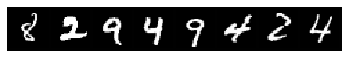

step 40956, loss 0.5642587542533875
Target:	 tensor([9, 3, 3, 8, 7, 6, 2, 5])
Pred:	 tensor([9, 3, 3, 7, 7, 6, 2, 5])


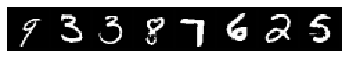

step 41006, loss 0.736271321773529
Target:	 tensor([7, 1, 7, 5, 7, 0, 5, 9])
Pred:	 tensor([7, 1, 7, 5, 7, 0, 5, 9])


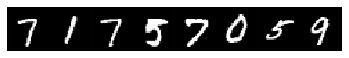

step 41056, loss 0.9721558094024658
Target:	 tensor([0, 7, 9, 5, 2, 9, 3, 8])
Pred:	 tensor([0, 7, 9, 1, 2, 9, 2, 8])


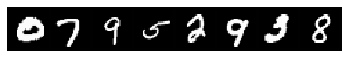

step 41106, loss 0.7356978058815002
Target:	 tensor([5, 8, 5, 5, 1, 1, 7, 3])
Pred:	 tensor([5, 8, 5, 5, 1, 1, 7, 3])


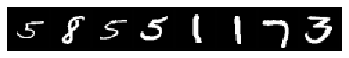

step 41156, loss 0.6850266456604004
Target:	 tensor([2, 8, 8, 1, 0, 5, 5, 0])
Pred:	 tensor([2, 3, 8, 1, 0, 5, 5, 0])


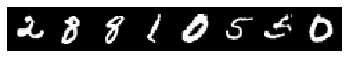

step 41206, loss 0.9470821022987366
Target:	 tensor([1, 5, 3, 5, 0, 7, 9, 8])
Pred:	 tensor([1, 5, 3, 5, 0, 7, 9, 6])


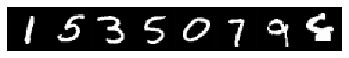

step 41256, loss 0.8213944435119629
Target:	 tensor([9, 8, 7, 2, 5, 0, 9, 8])
Pred:	 tensor([4, 7, 7, 2, 5, 0, 9, 8])


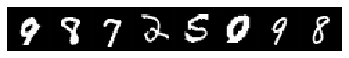

step 41306, loss 0.8486424088478088
Target:	 tensor([5, 4, 4, 5, 6, 6, 5, 4])
Pred:	 tensor([3, 4, 0, 5, 6, 6, 5, 4])


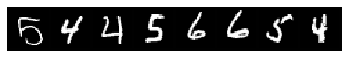

step 41356, loss 0.8201740384101868
Target:	 tensor([9, 2, 7, 4, 8, 2, 1, 2])
Pred:	 tensor([9, 2, 7, 9, 8, 2, 1, 2])


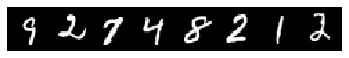

step 41406, loss 0.6927595734596252
Target:	 tensor([9, 5, 1, 6, 2, 3, 2, 4])
Pred:	 tensor([9, 5, 1, 6, 2, 3, 2, 4])


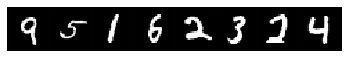

step 41456, loss 0.5644531846046448
Target:	 tensor([7, 8, 3, 1, 8, 4, 8, 2])
Pred:	 tensor([7, 8, 3, 1, 1, 4, 8, 2])


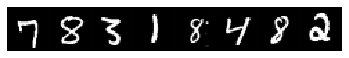

step 41506, loss 1.023511528968811
Target:	 tensor([2, 3, 7, 9, 0, 0, 7, 9])
Pred:	 tensor([2, 3, 9, 9, 0, 0, 7, 9])


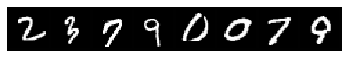

step 41556, loss 0.7049941420555115
Target:	 tensor([7, 7, 6, 2, 8, 3, 4, 8])
Pred:	 tensor([9, 7, 6, 2, 8, 1, 4, 8])


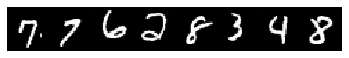

step 41606, loss 0.6444728374481201
Target:	 tensor([5, 8, 4, 7, 2, 9, 2, 4])
Pred:	 tensor([5, 5, 4, 7, 2, 4, 2, 4])


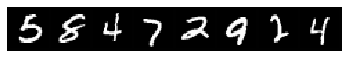

step 41656, loss 0.5710198283195496
Target:	 tensor([1, 4, 5, 7, 8, 9, 3, 1])
Pred:	 tensor([1, 4, 5, 7, 8, 9, 3, 1])


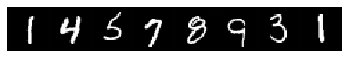

step 41706, loss 0.8539420962333679
Target:	 tensor([9, 9, 8, 3, 9, 3, 1, 0])
Pred:	 tensor([9, 9, 8, 3, 9, 2, 1, 0])


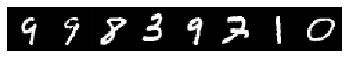

step 41756, loss 0.7387694716453552
Target:	 tensor([2, 7, 1, 0, 0, 3, 1, 2])
Pred:	 tensor([2, 7, 1, 0, 0, 3, 6, 2])


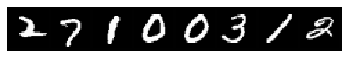

step 41806, loss 0.8443448543548584
Target:	 tensor([6, 6, 3, 5, 6, 3, 4, 8])
Pred:	 tensor([6, 6, 3, 5, 6, 3, 9, 0])


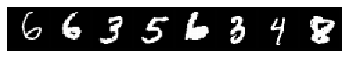

step 41856, loss 0.8775948882102966
Target:	 tensor([4, 1, 1, 4, 1, 3, 8, 2])
Pred:	 tensor([4, 1, 1, 4, 1, 8, 8, 2])


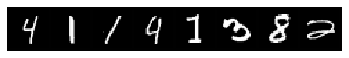

step 41906, loss 0.7093090415000916
Target:	 tensor([6, 0, 0, 6, 2, 2, 3, 9])
Pred:	 tensor([6, 0, 0, 6, 2, 2, 3, 9])


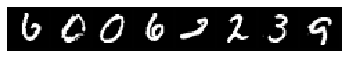

step 41956, loss 0.5557565689086914
Target:	 tensor([1, 3, 9, 3, 8, 8, 4, 0])
Pred:	 tensor([1, 3, 9, 3, 8, 1, 4, 0])


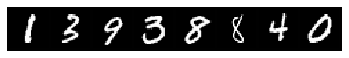

step 42006, loss 0.9647852778434753
Target:	 tensor([5, 9, 6, 1, 1, 9, 1, 2])
Pred:	 tensor([5, 9, 6, 1, 1, 9, 1, 3])


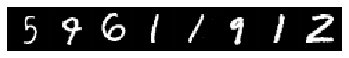

step 42056, loss 0.8006491661071777
Target:	 tensor([9, 8, 9, 0, 0, 5, 7, 1])
Pred:	 tensor([9, 5, 9, 0, 0, 5, 7, 1])


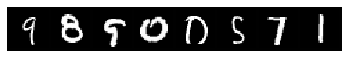

step 42106, loss 0.6754087805747986
Target:	 tensor([0, 2, 6, 2, 5, 0, 3, 0])
Pred:	 tensor([0, 0, 6, 2, 5, 0, 3, 0])


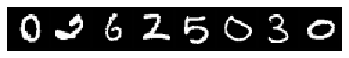

step 42156, loss 0.9190528988838196
Target:	 tensor([9, 7, 9, 3, 7, 4, 7, 1])
Pred:	 tensor([9, 7, 9, 3, 9, 9, 7, 1])


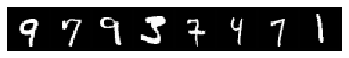

step 42206, loss 0.9517001509666443
Target:	 tensor([7, 7, 9, 2, 9, 2, 3, 3])
Pred:	 tensor([7, 7, 4, 2, 9, 2, 3, 1])


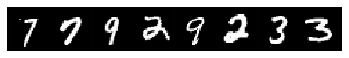

step 42256, loss 0.8279862403869629
Target:	 tensor([0, 6, 9, 1, 7, 7, 8, 1])
Pred:	 tensor([0, 2, 9, 1, 7, 9, 8, 1])


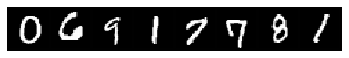

step 42306, loss 1.0599790811538696
Target:	 tensor([8, 1, 8, 5, 1, 0, 4, 5])
Pred:	 tensor([8, 1, 8, 0, 1, 0, 4, 8])


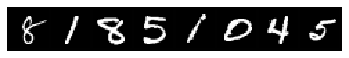

step 42347, loss 0.69249027967453
Target:	 tensor([9, 3, 7, 3, 9, 8, 5, 0])
Pred:	 tensor([9, 3, 7, 3, 9, 0, 3, 0])


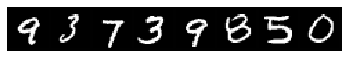

step 42397, loss 0.6524402499198914
Target:	 tensor([6, 1, 4, 0, 9, 6, 0, 2])
Pred:	 tensor([6, 1, 4, 0, 9, 6, 0, 2])


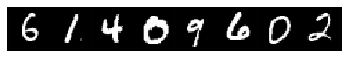

step 42447, loss 0.5336593389511108
Target:	 tensor([0, 3, 8, 6, 0, 9, 4, 2])
Pred:	 tensor([0, 3, 8, 6, 0, 9, 4, 2])


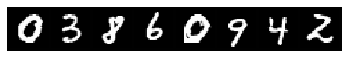

step 42497, loss 0.8461396098136902
Target:	 tensor([2, 8, 7, 2, 4, 4, 6, 7])
Pred:	 tensor([2, 8, 7, 2, 4, 4, 6, 7])


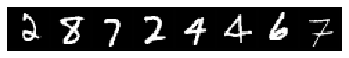

step 42547, loss 0.7170725464820862
Target:	 tensor([0, 3, 1, 6, 6, 2, 8, 0])
Pred:	 tensor([0, 3, 1, 6, 6, 1, 2, 0])


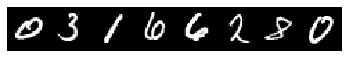

step 42597, loss 0.672825038433075
Target:	 tensor([3, 5, 9, 5, 5, 9, 1, 5])
Pred:	 tensor([7, 5, 9, 5, 5, 9, 1, 5])


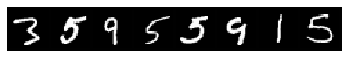

step 42647, loss 1.0673643350601196
Target:	 tensor([4, 0, 5, 5, 5, 5, 1, 1])
Pred:	 tensor([4, 0, 3, 5, 5, 5, 2, 1])


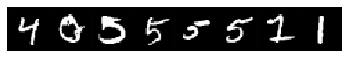

step 42697, loss 0.8206962943077087
Target:	 tensor([4, 3, 3, 0, 6, 9, 2, 8])
Pred:	 tensor([5, 7, 3, 0, 4, 9, 7, 5])


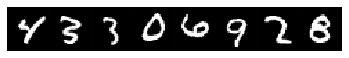

step 42747, loss 0.6956247687339783
Target:	 tensor([3, 9, 8, 4, 0, 7, 2, 9])
Pred:	 tensor([3, 7, 8, 4, 0, 7, 2, 9])


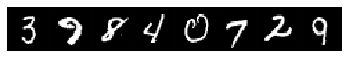

step 42797, loss 0.8142645955085754
Target:	 tensor([9, 6, 9, 1, 6, 1, 1, 4])
Pred:	 tensor([4, 6, 9, 1, 6, 1, 8, 4])


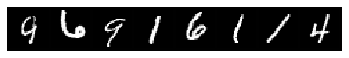

step 42847, loss 0.7943325638771057
Target:	 tensor([4, 0, 6, 1, 0, 4, 9, 1])
Pred:	 tensor([4, 0, 6, 8, 0, 4, 9, 1])


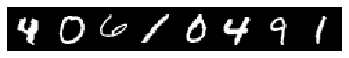

step 42897, loss 0.9719579815864563
Target:	 tensor([4, 4, 4, 2, 9, 6, 6, 1])
Pred:	 tensor([9, 4, 4, 2, 7, 5, 6, 1])


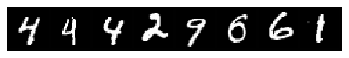

step 42947, loss 0.9082223773002625
Target:	 tensor([0, 7, 9, 1, 6, 0, 4, 5])
Pred:	 tensor([8, 7, 9, 1, 6, 0, 4, 5])


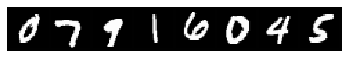

step 42997, loss 0.7480301856994629
Target:	 tensor([7, 7, 7, 1, 4, 2, 9, 0])
Pred:	 tensor([7, 7, 7, 1, 5, 2, 9, 7])


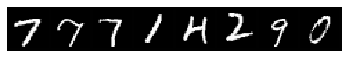

step 43047, loss 0.6024525165557861
Target:	 tensor([0, 5, 9, 6, 6, 4, 6, 3])
Pred:	 tensor([0, 5, 9, 6, 6, 4, 6, 3])


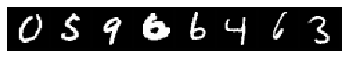

step 43097, loss 0.7653558254241943
Target:	 tensor([5, 0, 8, 2, 1, 2, 6, 5])
Pred:	 tensor([5, 0, 8, 2, 1, 2, 6, 3])


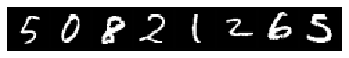

step 43147, loss 0.831932783126831
Target:	 tensor([9, 0, 5, 0, 3, 2, 9, 4])
Pred:	 tensor([9, 0, 1, 0, 5, 2, 9, 4])


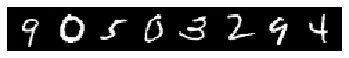

step 43197, loss 1.0044318437576294
Target:	 tensor([0, 6, 6, 2, 9, 4, 1, 7])
Pred:	 tensor([0, 6, 6, 2, 3, 4, 1, 7])


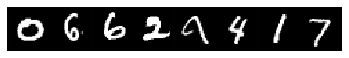

step 43247, loss 0.8916187286376953
Target:	 tensor([1, 4, 1, 8, 4, 5, 5, 0])
Pred:	 tensor([1, 4, 1, 8, 4, 8, 8, 0])


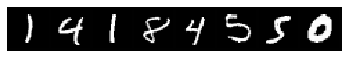

step 43297, loss 0.7534401416778564
Target:	 tensor([6, 1, 3, 2, 9, 4, 6, 9])
Pred:	 tensor([6, 8, 3, 2, 9, 4, 6, 9])


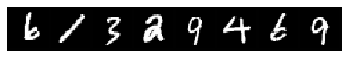

step 43347, loss 0.8152913451194763
Target:	 tensor([4, 9, 4, 9, 1, 0, 2, 0])
Pred:	 tensor([4, 9, 4, 9, 1, 0, 2, 0])


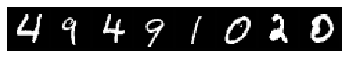

step 43397, loss 0.8229455351829529
Target:	 tensor([8, 1, 3, 6, 3, 3, 1, 9])
Pred:	 tensor([1, 1, 3, 6, 5, 3, 1, 5])


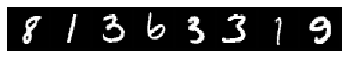

step 43447, loss 0.8504461646080017
Target:	 tensor([4, 6, 0, 2, 1, 5, 1, 0])
Pred:	 tensor([4, 6, 0, 2, 1, 5, 1, 0])


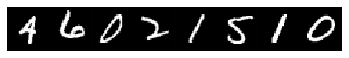

step 43497, loss 0.6813178658485413
Target:	 tensor([5, 4, 2, 3, 7, 3, 6, 6])
Pred:	 tensor([5, 4, 2, 3, 7, 5, 6, 6])


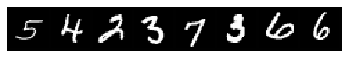

step 43547, loss 0.7074625492095947
Target:	 tensor([1, 8, 4, 4, 0, 3, 4, 3])
Pred:	 tensor([1, 8, 4, 4, 0, 3, 4, 3])


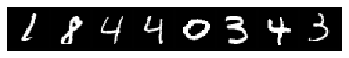

step 43597, loss 0.9589247703552246
Target:	 tensor([1, 7, 1, 5, 8, 3, 6, 8])
Pred:	 tensor([1, 7, 1, 7, 8, 3, 6, 5])


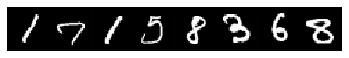

step 43647, loss 0.9236062169075012
Target:	 tensor([9, 6, 0, 2, 2, 4, 5, 2])
Pred:	 tensor([9, 6, 0, 2, 0, 4, 5, 2])


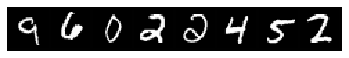

step 43697, loss 0.7347040176391602
Target:	 tensor([4, 9, 9, 1, 9, 3, 3, 0])
Pred:	 tensor([9, 4, 9, 1, 9, 3, 3, 0])


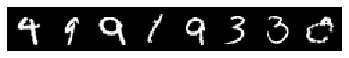

step 43747, loss 0.5794211030006409
Target:	 tensor([3, 5, 5, 2, 2, 0, 3, 8])
Pred:	 tensor([3, 5, 5, 2, 2, 0, 7, 8])


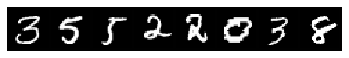

step 43797, loss 0.8868101239204407
Target:	 tensor([8, 7, 0, 3, 0, 8, 5, 5])
Pred:	 tensor([3, 9, 0, 3, 0, 8, 3, 5])


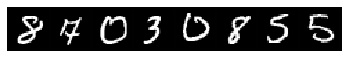

step 43847, loss 0.8438298106193542
Target:	 tensor([9, 3, 4, 7, 1, 1, 1, 9])
Pred:	 tensor([9, 3, 4, 7, 6, 1, 1, 9])


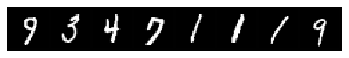

step 43897, loss 1.0806525945663452
Target:	 tensor([3, 6, 5, 0, 3, 6, 6, 0])
Pred:	 tensor([3, 6, 5, 2, 1, 6, 6, 0])


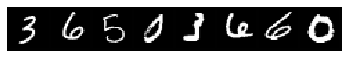

step 43947, loss 0.5589842200279236
Target:	 tensor([0, 8, 0, 6, 0, 2, 3, 8])
Pred:	 tensor([0, 3, 0, 6, 0, 2, 3, 8])


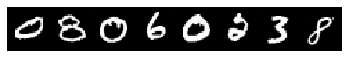

step 43997, loss 0.7512889504432678
Target:	 tensor([4, 0, 1, 6, 8, 6, 6, 6])
Pred:	 tensor([4, 0, 1, 6, 7, 6, 6, 6])


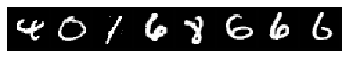

step 44047, loss 0.6218730211257935
Target:	 tensor([6, 2, 5, 5, 9, 9, 6, 0])
Pred:	 tensor([6, 2, 5, 5, 9, 9, 6, 0])


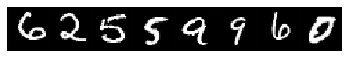

step 44097, loss 0.7523672580718994
Target:	 tensor([2, 2, 7, 5, 6, 3, 5, 6])
Pred:	 tensor([0, 2, 7, 9, 6, 3, 8, 6])


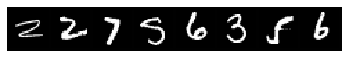

step 44147, loss 0.8757505416870117
Target:	 tensor([9, 4, 4, 4, 8, 5, 6, 0])
Pred:	 tensor([7, 4, 4, 4, 8, 5, 6, 0])


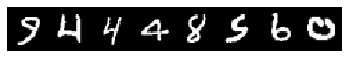

step 44197, loss 0.6569094061851501
Target:	 tensor([1, 6, 7, 2, 2, 7, 2, 9])
Pred:	 tensor([1, 6, 7, 2, 2, 7, 2, 9])


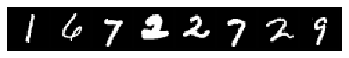

step 44247, loss 0.7852392792701721
Target:	 tensor([6, 4, 6, 1, 6, 3, 5, 7])
Pred:	 tensor([6, 4, 6, 1, 6, 3, 5, 7])


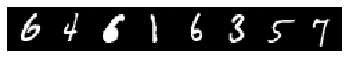

step 44297, loss 0.7148500084877014
Target:	 tensor([7, 7, 7, 4, 6, 4, 1, 8])
Pred:	 tensor([7, 7, 7, 4, 6, 4, 1, 8])


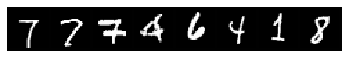

step 44347, loss 1.0469236373901367
Target:	 tensor([2, 8, 0, 1, 4, 5, 8, 1])
Pred:	 tensor([2, 8, 0, 1, 4, 5, 8, 1])


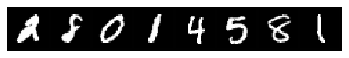

step 44397, loss 0.6176835894584656
Target:	 tensor([1, 5, 0, 9, 0, 4, 4, 7])
Pred:	 tensor([1, 5, 0, 9, 0, 4, 4, 7])


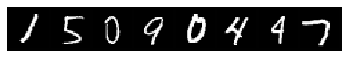

step 44447, loss 0.7496843338012695
Target:	 tensor([2, 8, 6, 3, 3, 6, 6, 5])
Pred:	 tensor([2, 5, 0, 3, 9, 6, 6, 5])


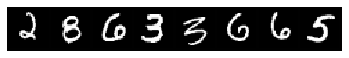

step 44497, loss 0.735604465007782
Target:	 tensor([1, 9, 3, 0, 7, 8, 8, 4])
Pred:	 tensor([1, 9, 7, 0, 7, 8, 9, 4])


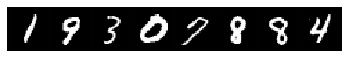

step 44547, loss 0.8486655354499817
Target:	 tensor([0, 8, 8, 7, 9, 6, 1, 2])
Pred:	 tensor([0, 8, 3, 7, 7, 6, 1, 2])


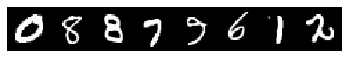

step 44597, loss 0.7287517189979553
Target:	 tensor([7, 3, 7, 2, 5, 7, 6, 8])
Pred:	 tensor([7, 3, 7, 2, 5, 4, 6, 5])


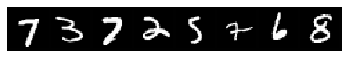

step 44647, loss 0.7167182564735413
Target:	 tensor([8, 1, 4, 6, 9, 1, 3, 7])
Pred:	 tensor([8, 1, 4, 6, 9, 1, 3, 7])


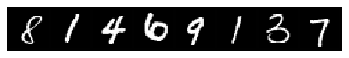

step 44697, loss 0.6453372836112976
Target:	 tensor([6, 4, 0, 2, 5, 6, 4, 9])
Pred:	 tensor([6, 4, 0, 1, 4, 6, 4, 9])


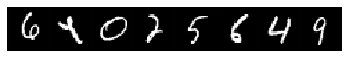

step 44747, loss 0.7530331611633301
Target:	 tensor([8, 6, 3, 9, 9, 5, 7, 4])
Pred:	 tensor([8, 6, 3, 9, 9, 5, 7, 4])


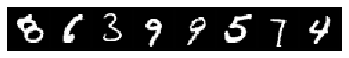

step 44797, loss 0.8316074013710022
Target:	 tensor([9, 3, 4, 2, 3, 1, 8, 8])
Pred:	 tensor([9, 3, 4, 7, 3, 1, 1, 8])


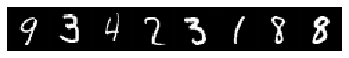

step 44838, loss 1.037755012512207
Target:	 tensor([2, 2, 0, 8, 3, 5, 0, 7])
Pred:	 tensor([2, 2, 0, 8, 3, 5, 0, 7])


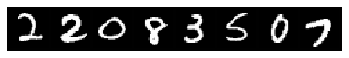

step 44888, loss 0.8318554759025574
Target:	 tensor([2, 6, 4, 9, 8, 0, 3, 3])
Pred:	 tensor([2, 6, 4, 9, 8, 0, 3, 3])


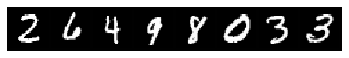

step 44938, loss 0.6864954829216003
Target:	 tensor([1, 1, 2, 2, 6, 0, 1, 1])
Pred:	 tensor([1, 8, 2, 2, 6, 0, 1, 1])


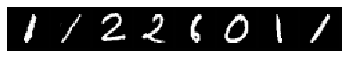

step 44988, loss 0.8447608947753906
Target:	 tensor([4, 1, 0, 2, 5, 2, 5, 4])
Pred:	 tensor([4, 1, 0, 2, 5, 2, 5, 4])


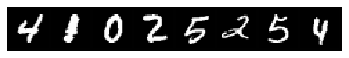

step 45038, loss 0.6469077467918396
Target:	 tensor([3, 8, 6, 4, 7, 2, 7, 4])
Pred:	 tensor([3, 3, 6, 4, 7, 2, 7, 4])


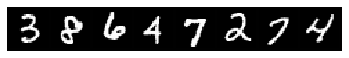

step 45088, loss 1.2156240940093994
Target:	 tensor([2, 1, 2, 2, 8, 2, 2, 9])
Pred:	 tensor([2, 1, 2, 3, 9, 2, 2, 9])


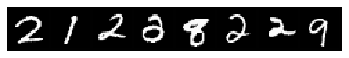

step 45138, loss 0.9999105334281921
Target:	 tensor([4, 8, 8, 5, 9, 3, 5, 4])
Pred:	 tensor([4, 8, 8, 5, 9, 3, 5, 9])


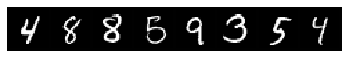

step 45188, loss 0.8726516366004944
Target:	 tensor([5, 9, 7, 6, 7, 6, 1, 2])
Pred:	 tensor([5, 9, 7, 6, 7, 6, 1, 2])


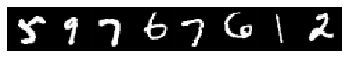

step 45238, loss 0.715640127658844
Target:	 tensor([7, 2, 0, 3, 2, 5, 1, 4])
Pred:	 tensor([7, 2, 0, 3, 2, 5, 1, 4])


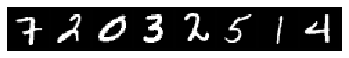

step 45288, loss 0.6826310753822327
Target:	 tensor([6, 3, 2, 2, 3, 7, 3, 0])
Pred:	 tensor([6, 3, 2, 2, 3, 7, 3, 0])


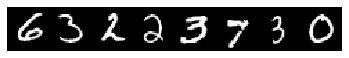

step 45338, loss 0.8267160058021545
Target:	 tensor([9, 3, 9, 1, 9, 3, 6, 5])
Pred:	 tensor([9, 3, 9, 1, 9, 3, 6, 5])


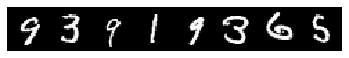

step 45388, loss 0.5946103930473328
Target:	 tensor([3, 3, 1, 9, 8, 5, 7, 7])
Pred:	 tensor([3, 3, 1, 9, 8, 9, 7, 7])


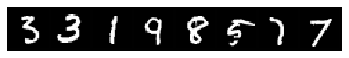

step 45438, loss 0.7235887050628662
Target:	 tensor([6, 1, 0, 1, 1, 1, 6, 4])
Pred:	 tensor([6, 1, 0, 1, 1, 1, 6, 6])


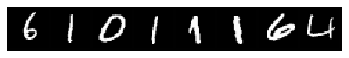

step 45488, loss 1.0831210613250732
Target:	 tensor([7, 5, 8, 1, 3, 0, 3, 2])
Pred:	 tensor([7, 3, 8, 1, 3, 0, 3, 8])


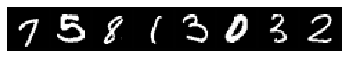

step 45538, loss 0.9334518313407898
Target:	 tensor([0, 8, 0, 8, 3, 6, 6, 3])
Pred:	 tensor([0, 3, 0, 1, 3, 6, 6, 3])


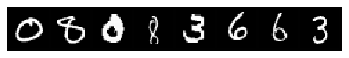

step 45588, loss 0.7701372504234314
Target:	 tensor([8, 9, 1, 0, 4, 7, 5, 0])
Pred:	 tensor([8, 7, 1, 0, 4, 7, 5, 0])


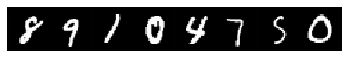

step 45638, loss 0.8986250758171082
Target:	 tensor([8, 1, 1, 4, 2, 3, 9, 9])
Pred:	 tensor([8, 2, 1, 4, 2, 4, 9, 9])


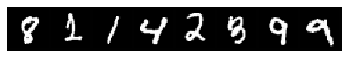

step 45688, loss 0.8306795954704285
Target:	 tensor([2, 2, 9, 0, 0, 1, 8, 7])
Pred:	 tensor([2, 2, 9, 0, 0, 1, 5, 7])


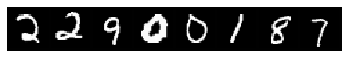

step 45738, loss 0.6897481083869934
Target:	 tensor([5, 3, 2, 6, 9, 6, 9, 7])
Pred:	 tensor([5, 3, 2, 6, 9, 6, 3, 7])


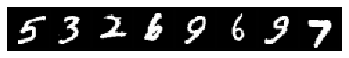

step 45788, loss 0.9758570790290833
Target:	 tensor([6, 9, 5, 3, 6, 1, 7, 7])
Pred:	 tensor([6, 7, 6, 3, 6, 1, 7, 7])


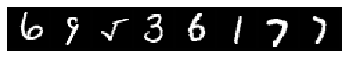

step 45838, loss 0.6525610089302063
Target:	 tensor([2, 0, 2, 9, 8, 1, 0, 7])
Pred:	 tensor([2, 0, 2, 9, 3, 1, 0, 7])


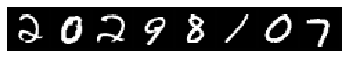

step 45888, loss 0.6479662656784058
Target:	 tensor([8, 0, 9, 3, 4, 1, 6, 0])
Pred:	 tensor([8, 0, 9, 2, 4, 1, 4, 0])


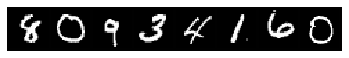

step 45938, loss 0.8659116625785828
Target:	 tensor([2, 9, 1, 6, 5, 3, 1, 5])
Pred:	 tensor([2, 4, 1, 1, 7, 3, 1, 5])


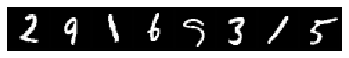

step 45988, loss 0.8125755190849304
Target:	 tensor([8, 1, 1, 3, 8, 6, 4, 9])
Pred:	 tensor([4, 1, 1, 3, 5, 6, 4, 9])


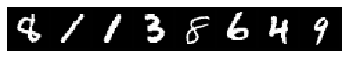

step 46038, loss 0.7864505648612976
Target:	 tensor([3, 1, 6, 4, 2, 7, 4, 1])
Pred:	 tensor([3, 1, 6, 4, 6, 7, 4, 1])


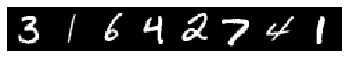

step 46088, loss 0.7180966734886169
Target:	 tensor([1, 5, 9, 4, 4, 0, 7, 2])
Pred:	 tensor([1, 5, 8, 4, 4, 0, 7, 2])


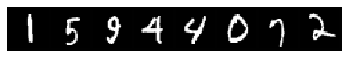

step 46138, loss 0.8656813502311707
Target:	 tensor([3, 0, 4, 9, 2, 4, 2, 7])
Pred:	 tensor([3, 0, 9, 9, 2, 4, 2, 7])


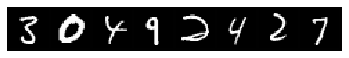

step 46188, loss 0.8450340628623962
Target:	 tensor([4, 8, 4, 9, 0, 4, 6, 6])
Pred:	 tensor([4, 8, 4, 9, 0, 9, 6, 6])


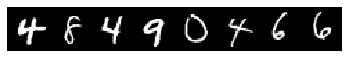

step 46238, loss 0.8476147651672363
Target:	 tensor([1, 3, 1, 6, 6, 5, 4, 6])
Pred:	 tensor([1, 3, 1, 6, 6, 5, 4, 6])


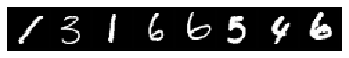

step 46288, loss 0.7553386092185974
Target:	 tensor([9, 1, 3, 8, 5, 6, 8, 8])
Pred:	 tensor([9, 1, 3, 8, 5, 6, 8, 1])


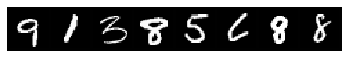

step 46338, loss 0.6593586802482605
Target:	 tensor([1, 3, 3, 3, 2, 1, 1, 4])
Pred:	 tensor([1, 3, 3, 3, 2, 1, 1, 4])


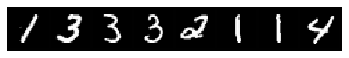

step 46388, loss 0.8180217146873474
Target:	 tensor([9, 6, 3, 2, 8, 9, 2, 1])
Pred:	 tensor([9, 6, 3, 6, 8, 9, 1, 1])


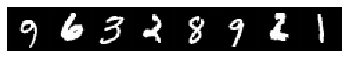

step 46438, loss 0.7063503265380859
Target:	 tensor([7, 2, 9, 3, 2, 0, 4, 3])
Pred:	 tensor([7, 2, 9, 3, 2, 0, 4, 3])


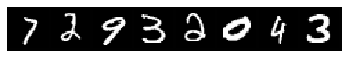

step 46488, loss 0.8826384544372559
Target:	 tensor([5, 0, 9, 0, 5, 6, 7, 1])
Pred:	 tensor([3, 0, 7, 0, 5, 6, 7, 1])


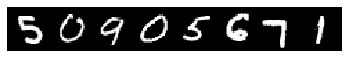

step 46538, loss 0.7458929419517517
Target:	 tensor([4, 7, 6, 2, 1, 5, 1, 9])
Pred:	 tensor([4, 7, 6, 2, 1, 5, 2, 9])


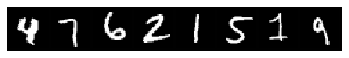

step 46588, loss 0.8017585277557373
Target:	 tensor([2, 1, 9, 7, 6, 5, 8, 8])
Pred:	 tensor([1, 1, 9, 7, 6, 5, 8, 8])


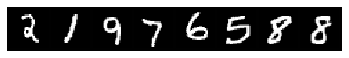

step 46638, loss 1.0366843938827515
Target:	 tensor([9, 4, 1, 4, 9, 9, 5, 8])
Pred:	 tensor([9, 4, 1, 4, 0, 9, 0, 3])


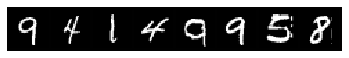

step 46688, loss 0.9141939282417297
Target:	 tensor([6, 0, 8, 0, 8, 5, 5, 8])
Pred:	 tensor([6, 0, 1, 0, 1, 0, 5, 2])


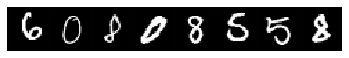

step 46738, loss 1.0329381227493286
Target:	 tensor([4, 6, 5, 9, 8, 4, 4, 1])
Pred:	 tensor([4, 6, 5, 4, 1, 4, 4, 1])


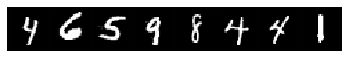

step 46788, loss 0.8697991967201233
Target:	 tensor([5, 5, 0, 8, 3, 7, 1, 8])
Pred:	 tensor([5, 8, 0, 8, 3, 7, 1, 8])


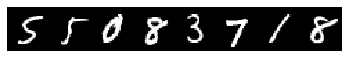

step 46838, loss 0.7823976874351501
Target:	 tensor([3, 8, 9, 8, 6, 3, 7, 8])
Pred:	 tensor([3, 8, 4, 8, 6, 3, 7, 8])


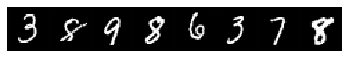

step 46888, loss 0.6796727180480957
Target:	 tensor([5, 1, 9, 5, 0, 2, 1, 1])
Pred:	 tensor([5, 1, 9, 3, 0, 2, 1, 1])


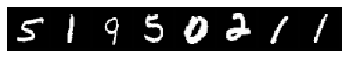

step 46938, loss 0.782240092754364
Target:	 tensor([5, 6, 1, 2, 8, 7, 6, 2])
Pred:	 tensor([1, 6, 1, 9, 8, 7, 6, 2])


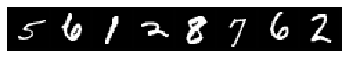

step 46988, loss 0.992082417011261
Target:	 tensor([9, 9, 8, 3, 3, 4, 6, 6])
Pred:	 tensor([5, 9, 8, 3, 5, 6, 6, 6])


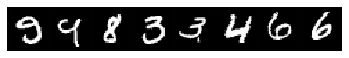

step 47038, loss 0.8502016067504883
Target:	 tensor([7, 7, 1, 3, 4, 6, 9, 0])
Pred:	 tensor([7, 7, 1, 9, 4, 6, 9, 0])


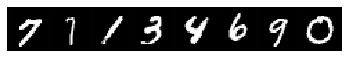

step 47088, loss 0.8906748294830322
Target:	 tensor([7, 8, 1, 8, 9, 9, 3, 3])
Pred:	 tensor([7, 8, 1, 3, 9, 7, 3, 3])


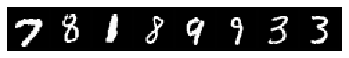

step 47138, loss 0.7811282277107239
Target:	 tensor([5, 3, 3, 6, 3, 2, 0, 4])
Pred:	 tensor([5, 3, 3, 6, 3, 2, 0, 9])


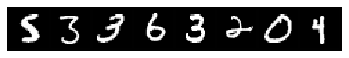

step 47188, loss 0.917632520198822
Target:	 tensor([2, 0, 2, 3, 1, 7, 4, 6])
Pred:	 tensor([2, 0, 2, 7, 1, 7, 9, 6])


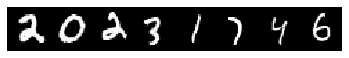

step 47238, loss 0.6657133102416992
Target:	 tensor([5, 6, 2, 3, 5, 1, 4, 3])
Pred:	 tensor([5, 6, 2, 3, 5, 1, 4, 3])


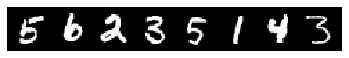

step 47288, loss 1.0510092973709106
Target:	 tensor([7, 5, 3, 2, 0, 3, 2, 9])
Pred:	 tensor([7, 5, 3, 2, 0, 3, 2, 9])


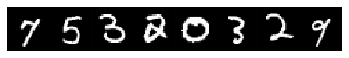

step 47329, loss 0.902163565158844
Target:	 tensor([2, 9, 4, 5, 8, 3, 9, 0])
Pred:	 tensor([2, 4, 4, 5, 5, 3, 9, 0])


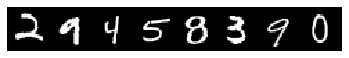

step 47379, loss 0.8667781352996826
Target:	 tensor([8, 5, 6, 5, 2, 3, 0, 9])
Pred:	 tensor([5, 4, 6, 5, 2, 2, 0, 9])


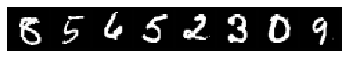

step 47429, loss 0.5529709458351135
Target:	 tensor([4, 7, 4, 5, 6, 6, 7, 6])
Pred:	 tensor([4, 7, 4, 5, 6, 6, 7, 6])


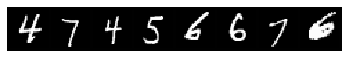

step 47479, loss 0.8427190184593201
Target:	 tensor([4, 6, 0, 7, 0, 0, 8, 4])
Pred:	 tensor([8, 6, 0, 7, 0, 0, 8, 4])


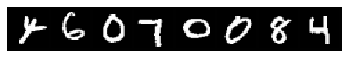

step 47529, loss 0.7944799065589905
Target:	 tensor([5, 7, 1, 8, 2, 8, 7, 2])
Pred:	 tensor([5, 7, 1, 3, 2, 2, 7, 2])


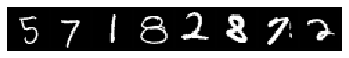

step 47579, loss 0.8326427936553955
Target:	 tensor([0, 1, 6, 6, 1, 9, 6, 9])
Pred:	 tensor([0, 1, 6, 6, 1, 9, 1, 2])


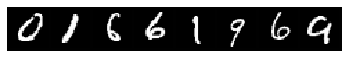

step 47629, loss 0.870175302028656
Target:	 tensor([0, 4, 0, 8, 3, 5, 9, 2])
Pred:	 tensor([0, 4, 0, 8, 3, 5, 4, 2])


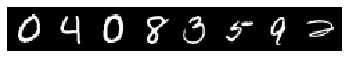

step 47679, loss 0.7350707054138184
Target:	 tensor([1, 1, 7, 0, 5, 4, 3, 0])
Pred:	 tensor([1, 1, 7, 0, 5, 4, 7, 0])


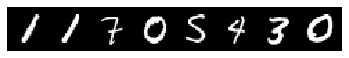

step 47729, loss 0.8154618740081787
Target:	 tensor([5, 0, 7, 9, 8, 9, 0, 2])
Pred:	 tensor([4, 0, 1, 9, 8, 9, 0, 1])


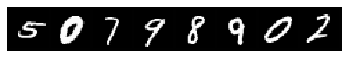

step 47779, loss 0.6238015294075012
Target:	 tensor([2, 1, 3, 0, 2, 9, 5, 0])
Pred:	 tensor([2, 1, 3, 0, 2, 9, 5, 0])


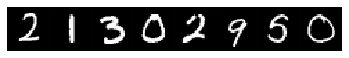

step 47829, loss 0.5785996317863464
Target:	 tensor([9, 4, 5, 0, 1, 4, 6, 6])
Pred:	 tensor([9, 4, 5, 0, 1, 4, 6, 6])


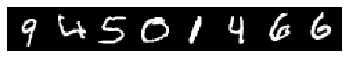

step 47879, loss 0.7548913359642029
Target:	 tensor([8, 5, 2, 9, 3, 3, 3, 1])
Pred:	 tensor([3, 5, 2, 9, 3, 3, 3, 1])


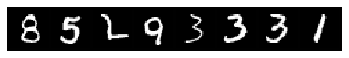

step 47929, loss 0.7437981963157654
Target:	 tensor([5, 2, 5, 6, 3, 6, 4, 1])
Pred:	 tensor([8, 2, 5, 6, 3, 6, 4, 1])


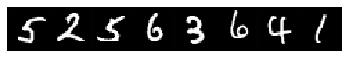

step 47979, loss 1.0821467638015747
Target:	 tensor([3, 8, 3, 2, 9, 0, 5, 6])
Pred:	 tensor([3, 8, 5, 1, 9, 0, 5, 6])


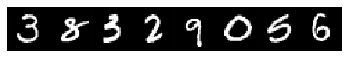

step 48029, loss 0.8099324107170105
Target:	 tensor([2, 1, 9, 9, 9, 9, 0, 3])
Pred:	 tensor([2, 1, 5, 9, 9, 9, 0, 3])


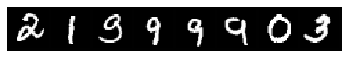

step 48079, loss 0.7192599177360535
Target:	 tensor([6, 4, 5, 5, 1, 6, 2, 6])
Pred:	 tensor([6, 4, 5, 5, 1, 6, 2, 6])


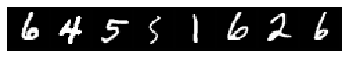

step 48129, loss 0.9138651490211487
Target:	 tensor([3, 8, 3, 0, 0, 5, 8, 2])
Pred:	 tensor([1, 8, 3, 0, 0, 5, 2, 2])


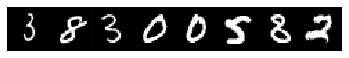

step 48179, loss 0.8436173796653748
Target:	 tensor([6, 5, 2, 2, 7, 1, 8, 9])
Pred:	 tensor([6, 5, 2, 3, 7, 1, 3, 9])


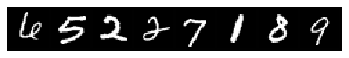

step 48229, loss 0.9709329605102539
Target:	 tensor([4, 1, 9, 6, 9, 7, 6, 5])
Pred:	 tensor([4, 1, 4, 6, 9, 7, 6, 9])


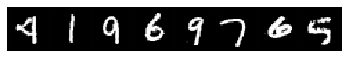

step 48279, loss 0.8397600650787354
Target:	 tensor([1, 5, 7, 4, 3, 1, 6, 5])
Pred:	 tensor([1, 5, 7, 4, 3, 1, 6, 5])


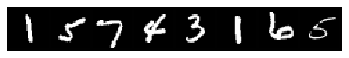

step 48329, loss 0.7740502953529358
Target:	 tensor([9, 4, 6, 9, 0, 1, 0, 1])
Pred:	 tensor([9, 4, 6, 9, 0, 1, 0, 8])


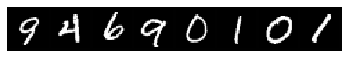

step 48379, loss 1.0464340448379517
Target:	 tensor([8, 2, 2, 3, 8, 9, 2, 4])
Pred:	 tensor([8, 2, 2, 3, 5, 9, 2, 4])


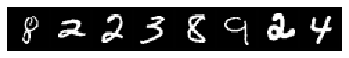

step 48429, loss 0.9067407250404358
Target:	 tensor([4, 5, 9, 1, 3, 1, 7, 8])
Pred:	 tensor([4, 3, 9, 8, 3, 1, 7, 8])


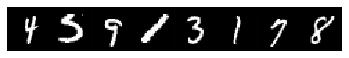

step 48479, loss 0.6476303339004517
Target:	 tensor([4, 1, 4, 7, 6, 5, 9, 1])
Pred:	 tensor([4, 1, 4, 7, 6, 5, 9, 1])


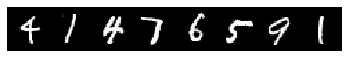

step 48529, loss 0.6772196888923645
Target:	 tensor([6, 3, 8, 3, 1, 0, 4, 1])
Pred:	 tensor([6, 3, 8, 3, 1, 0, 4, 1])


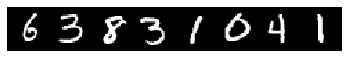

step 48579, loss 0.707567036151886
Target:	 tensor([4, 5, 9, 1, 7, 3, 4, 0])
Pred:	 tensor([9, 5, 4, 1, 7, 7, 4, 0])


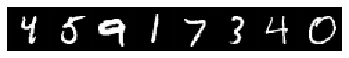

step 48629, loss 0.7460682988166809
Target:	 tensor([1, 5, 0, 1, 8, 3, 0, 0])
Pred:	 tensor([1, 5, 8, 1, 8, 3, 0, 0])


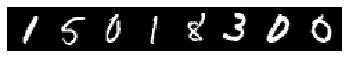

step 48679, loss 0.7720043063163757
Target:	 tensor([1, 8, 7, 6, 1, 1, 7, 1])
Pred:	 tensor([1, 8, 7, 6, 1, 1, 7, 1])


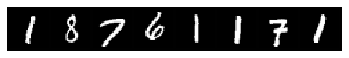

step 48729, loss 0.64957594871521
Target:	 tensor([3, 7, 6, 1, 0, 6, 0, 2])
Pred:	 tensor([3, 7, 6, 1, 0, 6, 5, 2])


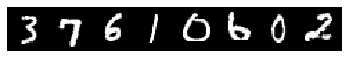

step 48779, loss 0.6111720204353333
Target:	 tensor([9, 3, 3, 9, 9, 3, 3, 0])
Pred:	 tensor([9, 3, 3, 9, 9, 3, 3, 0])


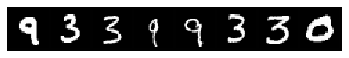

step 48829, loss 1.1398738622665405
Target:	 tensor([7, 0, 8, 5, 8, 6, 2, 6])
Pred:	 tensor([7, 0, 3, 5, 8, 6, 2, 6])


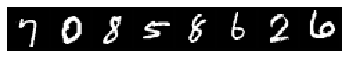

step 48879, loss 0.7509355545043945
Target:	 tensor([6, 2, 0, 3, 9, 4, 0, 0])
Pred:	 tensor([5, 2, 0, 3, 9, 4, 0, 0])


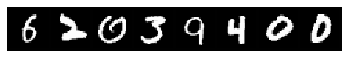

step 48929, loss 0.748024046421051
Target:	 tensor([2, 4, 0, 2, 9, 7, 9, 0])
Pred:	 tensor([2, 4, 0, 2, 9, 7, 9, 0])


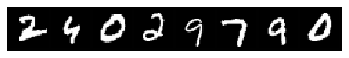

step 48979, loss 0.7967159152030945
Target:	 tensor([8, 9, 1, 1, 9, 4, 2, 5])
Pred:	 tensor([8, 9, 1, 1, 4, 4, 2, 8])


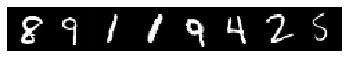

step 49029, loss 0.6838638782501221
Target:	 tensor([4, 0, 9, 1, 3, 0, 4, 6])
Pred:	 tensor([4, 0, 9, 1, 3, 0, 4, 6])


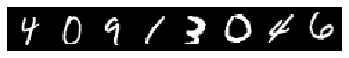

step 49079, loss 0.9909489750862122
Target:	 tensor([7, 8, 1, 3, 8, 6, 2, 4])
Pred:	 tensor([7, 8, 1, 3, 8, 6, 2, 3])


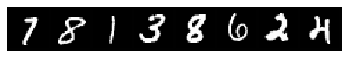

step 49129, loss 0.7310001254081726
Target:	 tensor([7, 2, 0, 4, 7, 5, 5, 8])
Pred:	 tensor([7, 2, 0, 4, 7, 5, 5, 8])


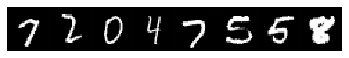

step 49179, loss 0.8200662732124329
Target:	 tensor([8, 1, 0, 3, 6, 4, 7, 7])
Pred:	 tensor([8, 1, 0, 3, 6, 4, 7, 7])


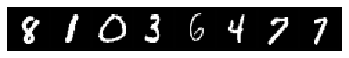

step 49229, loss 0.7542390823364258
Target:	 tensor([7, 1, 2, 6, 6, 9, 9, 2])
Pred:	 tensor([1, 1, 2, 6, 6, 9, 9, 2])


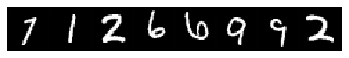

step 49279, loss 0.6490808129310608
Target:	 tensor([5, 0, 7, 9, 5, 8, 5, 1])
Pred:	 tensor([5, 0, 7, 9, 5, 8, 5, 1])


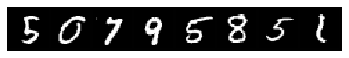

step 49329, loss 0.9684750437736511
Target:	 tensor([2, 1, 3, 2, 1, 3, 4, 2])
Pred:	 tensor([2, 1, 2, 2, 1, 2, 4, 3])


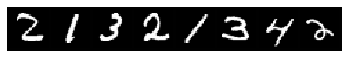

step 49379, loss 0.8152701258659363
Target:	 tensor([7, 0, 5, 0, 5, 2, 9, 4])
Pred:	 tensor([7, 0, 5, 0, 5, 2, 9, 4])


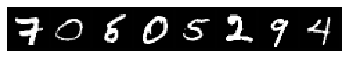

step 49429, loss 0.6627835035324097
Target:	 tensor([1, 0, 1, 9, 2, 3, 9, 0])
Pred:	 tensor([1, 0, 1, 9, 2, 3, 9, 0])


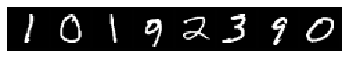

step 49479, loss 0.8746337890625
Target:	 tensor([2, 7, 5, 7, 3, 4, 5, 6])
Pred:	 tensor([2, 7, 8, 7, 3, 4, 5, 8])


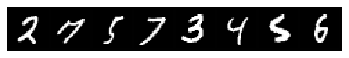

step 49529, loss 0.7754095196723938
Target:	 tensor([3, 8, 0, 7, 9, 3, 5, 4])
Pred:	 tensor([3, 8, 0, 7, 9, 1, 5, 4])


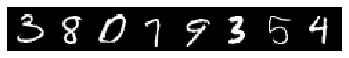

step 49579, loss 0.9689403176307678
Target:	 tensor([8, 7, 8, 1, 1, 6, 0, 3])
Pred:	 tensor([8, 7, 3, 1, 1, 6, 0, 7])


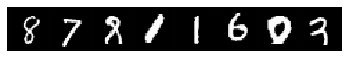

step 49629, loss 0.9278059005737305
Target:	 tensor([3, 9, 1, 2, 0, 7, 8, 1])
Pred:	 tensor([3, 4, 1, 4, 0, 7, 5, 1])


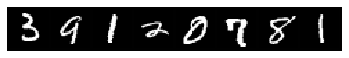

step 49679, loss 0.722238302230835
Target:	 tensor([5, 2, 2, 4, 8, 3, 3, 4])
Pred:	 tensor([5, 2, 3, 4, 8, 3, 3, 4])


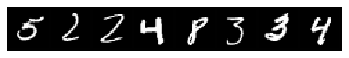

step 49729, loss 0.9833052754402161
Target:	 tensor([2, 5, 3, 5, 6, 7, 5, 8])
Pred:	 tensor([6, 5, 3, 5, 6, 7, 5, 8])


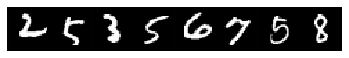

step 49779, loss 0.780818521976471
Target:	 tensor([3, 1, 2, 3, 0, 8, 7, 1])
Pred:	 tensor([3, 1, 2, 3, 0, 5, 7, 1])


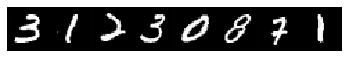

step 49820, loss 0.6540710926055908
Target:	 tensor([5, 4, 8, 1, 7, 5, 0, 7])
Pred:	 tensor([5, 4, 5, 1, 7, 5, 0, 7])


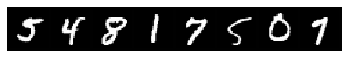

step 49870, loss 0.8171429634094238
Target:	 tensor([8, 9, 8, 2, 9, 4, 4, 5])
Pred:	 tensor([1, 9, 8, 2, 4, 4, 4, 5])


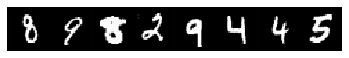

step 49920, loss 0.8493061661720276
Target:	 tensor([1, 5, 2, 8, 6, 3, 6, 1])
Pred:	 tensor([1, 6, 2, 7, 6, 3, 6, 1])


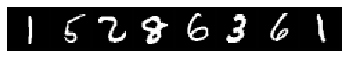

step 49970, loss 0.7856848239898682
Target:	 tensor([6, 4, 1, 0, 9, 5, 1, 8])
Pred:	 tensor([6, 4, 1, 0, 9, 5, 1, 1])


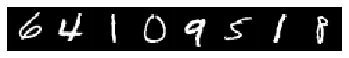

step 50020, loss 0.9057652354240417
Target:	 tensor([2, 9, 1, 8, 7, 4, 2, 2])
Pred:	 tensor([1, 4, 1, 5, 7, 4, 2, 2])


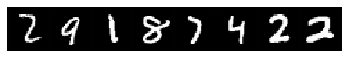

step 50070, loss 0.7861952781677246
Target:	 tensor([9, 1, 3, 8, 4, 4, 1, 6])
Pred:	 tensor([4, 1, 3, 8, 4, 4, 1, 6])


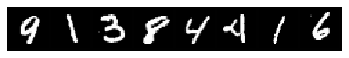

step 50120, loss 0.720757246017456
Target:	 tensor([9, 0, 1, 4, 8, 3, 6, 0])
Pred:	 tensor([9, 0, 1, 1, 1, 3, 6, 0])


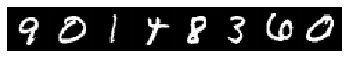

step 50170, loss 0.8258656859397888
Target:	 tensor([3, 9, 4, 7, 2, 2, 1, 6])
Pred:	 tensor([3, 9, 4, 5, 2, 2, 1, 6])


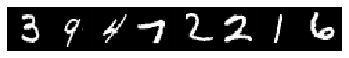

step 50220, loss 0.6681107878684998
Target:	 tensor([3, 8, 1, 3, 1, 8, 4, 3])
Pred:	 tensor([3, 8, 1, 5, 1, 8, 4, 3])


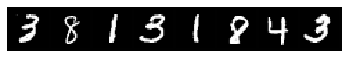

step 50270, loss 0.818209171295166
Target:	 tensor([8, 0, 0, 0, 1, 6, 9, 7])
Pred:	 tensor([8, 0, 0, 0, 1, 6, 9, 9])


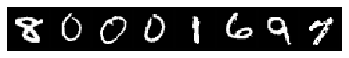

step 50320, loss 0.8509314656257629
Target:	 tensor([2, 4, 9, 4, 6, 6, 1, 8])
Pred:	 tensor([2, 4, 9, 4, 6, 6, 1, 5])


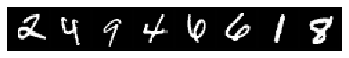

step 50370, loss 0.7155459523200989
Target:	 tensor([9, 7, 5, 7, 0, 3, 5, 1])
Pred:	 tensor([4, 7, 5, 7, 0, 3, 5, 1])


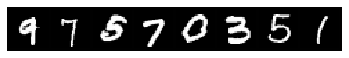

step 50420, loss 0.6943778395652771
Target:	 tensor([5, 0, 2, 8, 1, 4, 0, 0])
Pred:	 tensor([5, 0, 2, 8, 1, 4, 0, 0])


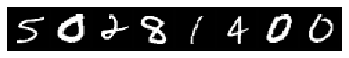

step 50470, loss 0.8860949873924255
Target:	 tensor([6, 2, 8, 6, 0, 3, 8, 2])
Pred:	 tensor([6, 2, 8, 6, 0, 3, 8, 2])


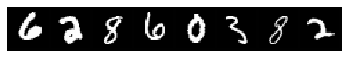

step 50520, loss 0.6941399574279785
Target:	 tensor([5, 1, 4, 7, 4, 4, 1, 9])
Pred:	 tensor([5, 1, 4, 7, 4, 4, 1, 9])


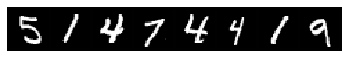

step 50570, loss 0.599422037601471
Target:	 tensor([0, 7, 5, 1, 2, 6, 1, 2])
Pred:	 tensor([0, 7, 5, 1, 2, 6, 1, 0])


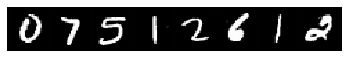

step 50620, loss 0.7496285438537598
Target:	 tensor([0, 6, 1, 2, 2, 9, 1, 5])
Pred:	 tensor([0, 6, 1, 2, 2, 9, 1, 5])


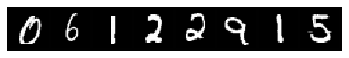

step 50670, loss 1.055145502090454
Target:	 tensor([8, 7, 3, 7, 2, 8, 4, 1])
Pred:	 tensor([8, 7, 3, 7, 4, 8, 9, 1])


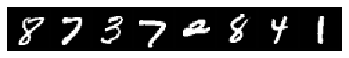

step 50720, loss 0.7470056414604187
Target:	 tensor([6, 4, 7, 7, 8, 9, 5, 2])
Pred:	 tensor([6, 4, 7, 7, 5, 9, 9, 2])


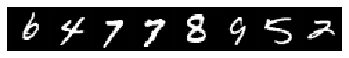

step 50770, loss 1.194594144821167
Target:	 tensor([3, 9, 0, 1, 8, 1, 9, 8])
Pred:	 tensor([3, 7, 5, 1, 8, 1, 5, 8])


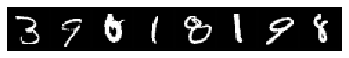

step 50820, loss 0.688234806060791
Target:	 tensor([1, 6, 4, 1, 4, 7, 3, 0])
Pred:	 tensor([1, 6, 9, 1, 4, 7, 3, 0])


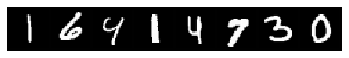

step 50870, loss 0.8790844082832336
Target:	 tensor([8, 5, 1, 2, 0, 5, 1, 4])
Pred:	 tensor([8, 5, 1, 2, 0, 5, 1, 4])


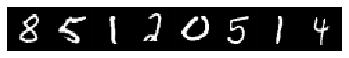

step 50920, loss 0.7409970164299011
Target:	 tensor([1, 1, 8, 0, 0, 4, 9, 6])
Pred:	 tensor([1, 6, 1, 0, 0, 4, 9, 6])


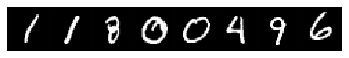

step 50970, loss 0.5084102749824524
Target:	 tensor([5, 4, 5, 2, 6, 2, 9, 3])
Pred:	 tensor([5, 4, 5, 2, 6, 2, 9, 3])


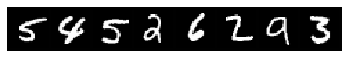

step 51020, loss 0.8776309490203857
Target:	 tensor([6, 7, 7, 9, 1, 6, 2, 8])
Pred:	 tensor([6, 7, 7, 9, 1, 6, 2, 5])


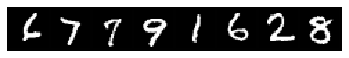

step 51070, loss 0.7562196254730225
Target:	 tensor([3, 2, 4, 0, 4, 4, 6, 7])
Pred:	 tensor([3, 2, 4, 0, 4, 4, 6, 7])


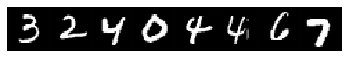

step 51120, loss 1.011746883392334
Target:	 tensor([4, 9, 0, 7, 6, 8, 9, 8])
Pred:	 tensor([4, 9, 0, 7, 6, 1, 9, 5])


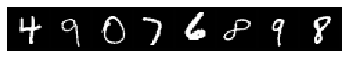

step 51170, loss 1.0863038301467896
Target:	 tensor([7, 8, 2, 7, 2, 9, 6, 1])
Pred:	 tensor([7, 5, 2, 9, 6, 9, 6, 1])


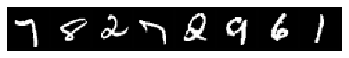

step 51220, loss 0.6788818836212158
Target:	 tensor([0, 4, 4, 0, 2, 9, 2, 9])
Pred:	 tensor([0, 4, 4, 0, 2, 9, 2, 9])


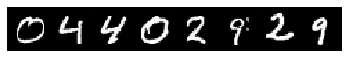

step 51270, loss 0.9198821187019348
Target:	 tensor([6, 1, 6, 6, 1, 1, 6, 4])
Pred:	 tensor([2, 1, 6, 4, 1, 1, 6, 4])


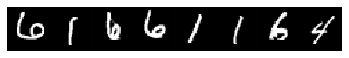

step 51320, loss 0.6527512073516846
Target:	 tensor([1, 0, 6, 3, 7, 8, 4, 1])
Pred:	 tensor([1, 0, 1, 3, 7, 0, 4, 1])


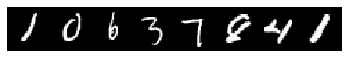

step 51370, loss 0.7762522101402283
Target:	 tensor([3, 5, 1, 8, 3, 0, 7, 7])
Pred:	 tensor([3, 5, 1, 1, 3, 0, 7, 7])


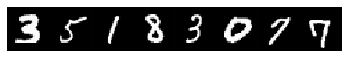

step 51420, loss 0.936296284198761
Target:	 tensor([5, 8, 8, 5, 9, 7, 1, 9])
Pred:	 tensor([5, 1, 8, 8, 9, 7, 1, 9])


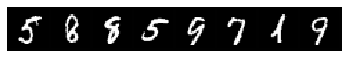

step 51470, loss 0.6946640610694885
Target:	 tensor([2, 2, 0, 6, 5, 9, 1, 7])
Pred:	 tensor([2, 2, 0, 6, 5, 9, 1, 7])


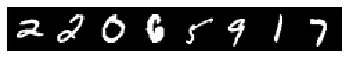

step 51520, loss 0.6357111930847168
Target:	 tensor([9, 8, 6, 3, 1, 0, 8, 0])
Pred:	 tensor([7, 8, 6, 3, 1, 0, 8, 0])


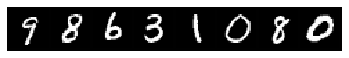

step 51570, loss 0.7553119659423828
Target:	 tensor([9, 2, 9, 5, 3, 7, 4, 4])
Pred:	 tensor([9, 2, 9, 5, 3, 7, 4, 4])


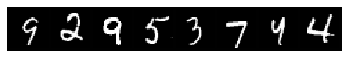

step 51620, loss 0.7723377346992493
Target:	 tensor([3, 2, 6, 1, 4, 7, 1, 9])
Pred:	 tensor([3, 2, 6, 1, 4, 7, 1, 2])


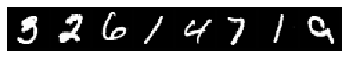

step 51670, loss 0.8226115703582764
Target:	 tensor([7, 3, 2, 3, 6, 9, 6, 7])
Pred:	 tensor([7, 3, 2, 3, 6, 9, 6, 0])


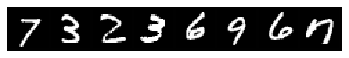

step 51720, loss 0.6081588864326477
Target:	 tensor([7, 0, 9, 3, 3, 9, 7, 3])
Pred:	 tensor([9, 0, 9, 3, 7, 7, 7, 3])


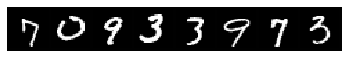

step 51770, loss 1.1536369323730469
Target:	 tensor([1, 8, 9, 7, 1, 6, 3, 6])
Pred:	 tensor([1, 8, 9, 5, 1, 0, 3, 6])


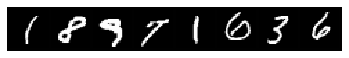

step 51820, loss 0.7568650841712952
Target:	 tensor([8, 5, 9, 9, 2, 9, 6, 1])
Pred:	 tensor([3, 5, 9, 9, 2, 9, 6, 1])


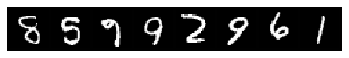

step 51870, loss 0.7193415760993958
Target:	 tensor([2, 3, 5, 6, 2, 0, 3, 8])
Pred:	 tensor([2, 3, 5, 6, 2, 0, 3, 8])


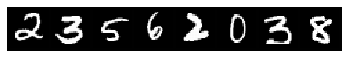

step 51920, loss 0.8277420997619629
Target:	 tensor([1, 6, 5, 9, 3, 4, 2, 3])
Pred:	 tensor([1, 4, 5, 9, 3, 4, 2, 3])


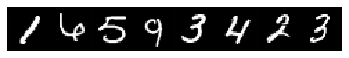

step 51970, loss 0.7986104488372803
Target:	 tensor([3, 5, 5, 7, 9, 9, 1, 7])
Pred:	 tensor([8, 5, 5, 7, 4, 9, 1, 7])


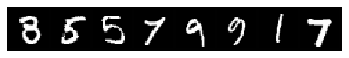

step 52020, loss 0.7265676856040955
Target:	 tensor([6, 9, 8, 3, 4, 7, 3, 2])
Pred:	 tensor([6, 9, 8, 3, 4, 7, 3, 2])


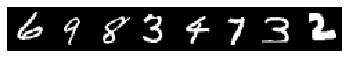

step 52070, loss 1.016149878501892
Target:	 tensor([8, 1, 7, 4, 4, 7, 2, 8])
Pred:	 tensor([3, 1, 7, 4, 4, 7, 2, 8])


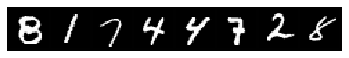

step 52120, loss 0.8902096748352051
Target:	 tensor([4, 1, 5, 8, 6, 0, 8, 6])
Pred:	 tensor([6, 1, 8, 8, 6, 0, 5, 6])


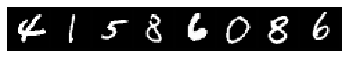

step 52170, loss 0.683326005935669
Target:	 tensor([0, 3, 5, 2, 7, 9, 1, 1])
Pred:	 tensor([0, 7, 5, 2, 7, 9, 1, 1])


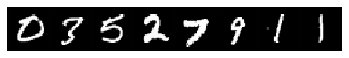

step 52220, loss 0.7746629118919373
Target:	 tensor([1, 6, 3, 3, 3, 9, 5, 7])
Pred:	 tensor([1, 6, 3, 3, 3, 9, 5, 7])


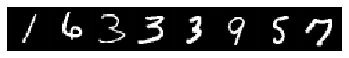

step 52270, loss 0.9995863437652588
Target:	 tensor([0, 9, 3, 1, 1, 8, 7, 6])
Pred:	 tensor([0, 9, 3, 1, 1, 8, 7, 6])


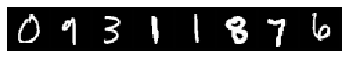

step 52311, loss 0.7365784645080566
Target:	 tensor([2, 5, 5, 4, 6, 8, 9, 2])
Pred:	 tensor([0, 5, 5, 4, 6, 8, 9, 2])


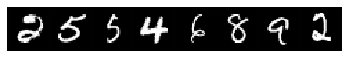

step 52361, loss 0.7853110432624817
Target:	 tensor([5, 4, 4, 5, 4, 1, 0, 5])
Pred:	 tensor([9, 4, 4, 5, 4, 3, 0, 9])


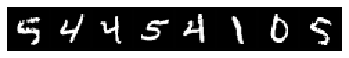

step 52411, loss 0.7552516460418701
Target:	 tensor([2, 6, 5, 5, 2, 7, 6, 4])
Pred:	 tensor([2, 6, 5, 5, 0, 7, 6, 4])


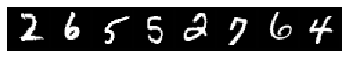

step 52461, loss 0.6235952377319336
Target:	 tensor([4, 1, 7, 6, 7, 2, 3, 6])
Pred:	 tensor([9, 1, 7, 6, 7, 2, 3, 6])


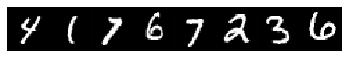

step 52511, loss 0.877605676651001
Target:	 tensor([3, 0, 4, 2, 7, 9, 6, 9])
Pred:	 tensor([3, 0, 9, 2, 7, 9, 6, 9])


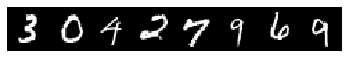

step 52561, loss 1.044487714767456
Target:	 tensor([9, 2, 1, 8, 1, 6, 7, 2])
Pred:	 tensor([9, 2, 1, 5, 1, 6, 9, 2])


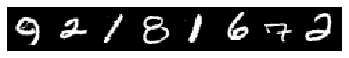

step 52611, loss 0.7728312611579895
Target:	 tensor([9, 0, 4, 4, 4, 1, 4, 7])
Pred:	 tensor([9, 0, 4, 4, 4, 1, 4, 7])


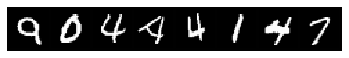

step 52661, loss 0.9578565955162048
Target:	 tensor([8, 7, 5, 1, 8, 1, 7, 3])
Pred:	 tensor([5, 7, 5, 1, 5, 1, 4, 3])


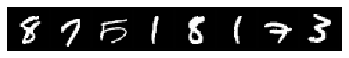

step 52711, loss 0.6606895327568054
Target:	 tensor([5, 1, 0, 8, 7, 3, 6, 9])
Pred:	 tensor([5, 8, 0, 8, 7, 8, 6, 9])


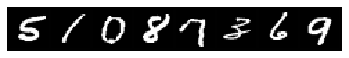

step 52761, loss 1.1554683446884155
Target:	 tensor([6, 7, 4, 1, 2, 8, 5, 7])
Pred:	 tensor([6, 7, 9, 1, 2, 5, 3, 7])


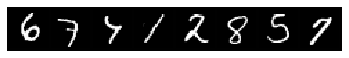

step 52811, loss 0.8031565546989441
Target:	 tensor([8, 2, 8, 8, 2, 4, 1, 6])
Pred:	 tensor([1, 6, 8, 8, 2, 9, 1, 6])


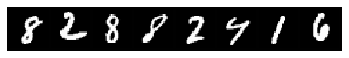

step 52861, loss 0.5533248782157898
Target:	 tensor([1, 0, 2, 5, 7, 8, 2, 4])
Pred:	 tensor([1, 0, 2, 5, 7, 7, 2, 4])


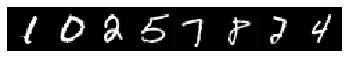

step 52911, loss 0.7291277050971985
Target:	 tensor([6, 7, 6, 7, 3, 0, 5, 4])
Pred:	 tensor([6, 7, 6, 7, 3, 0, 5, 4])


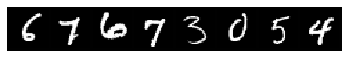

step 52961, loss 0.6691132187843323
Target:	 tensor([2, 4, 1, 9, 4, 2, 5, 9])
Pred:	 tensor([2, 4, 1, 4, 4, 2, 5, 9])


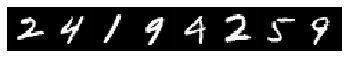

step 53011, loss 0.8216042518615723
Target:	 tensor([8, 0, 4, 2, 7, 1, 6, 9])
Pred:	 tensor([9, 0, 4, 2, 7, 8, 6, 9])


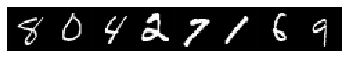

step 53061, loss 0.852653443813324
Target:	 tensor([9, 7, 4, 8, 5, 4, 4, 9])
Pred:	 tensor([9, 1, 4, 8, 5, 9, 4, 9])


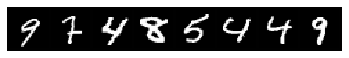

step 53111, loss 0.8008443713188171
Target:	 tensor([8, 3, 1, 4, 5, 2, 7, 3])
Pred:	 tensor([8, 3, 1, 4, 5, 2, 7, 3])


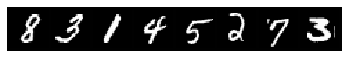

step 53161, loss 1.262194275856018
Target:	 tensor([5, 6, 1, 0, 8, 1, 7, 8])
Pred:	 tensor([8, 6, 1, 0, 8, 2, 7, 8])


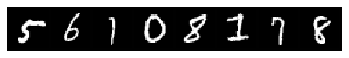

step 53211, loss 0.7538561224937439
Target:	 tensor([9, 1, 7, 9, 8, 1, 2, 2])
Pred:	 tensor([4, 1, 7, 9, 1, 1, 2, 2])


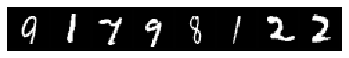

step 53261, loss 0.7316741347312927
Target:	 tensor([2, 3, 0, 0, 3, 3, 4, 1])
Pred:	 tensor([2, 3, 0, 0, 3, 7, 4, 1])


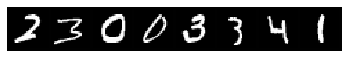

step 53311, loss 0.6826059818267822
Target:	 tensor([9, 3, 4, 7, 7, 6, 1, 9])
Pred:	 tensor([9, 3, 4, 7, 7, 6, 1, 9])


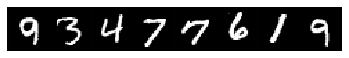

step 53361, loss 0.8022497296333313
Target:	 tensor([6, 5, 3, 2, 7, 0, 6, 6])
Pred:	 tensor([6, 5, 2, 2, 3, 0, 6, 6])


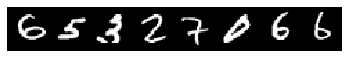

step 53411, loss 0.9298200011253357
Target:	 tensor([2, 8, 2, 1, 1, 6, 1, 7])
Pred:	 tensor([2, 8, 2, 1, 1, 6, 1, 7])


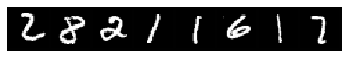

step 53461, loss 0.8449534773826599
Target:	 tensor([0, 4, 5, 3, 7, 1, 0, 4])
Pred:	 tensor([0, 4, 5, 3, 7, 1, 8, 4])


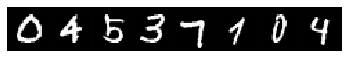

step 53511, loss 0.9760134816169739
Target:	 tensor([4, 4, 3, 8, 4, 1, 3, 5])
Pred:	 tensor([4, 4, 3, 5, 5, 1, 3, 8])


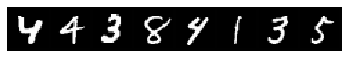

step 53561, loss 0.817809522151947
Target:	 tensor([5, 2, 8, 8, 4, 0, 6, 4])
Pred:	 tensor([5, 3, 8, 8, 4, 6, 6, 4])


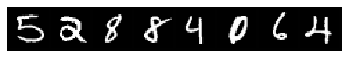

step 53611, loss 0.9035947322845459
Target:	 tensor([0, 3, 7, 3, 3, 3, 2, 9])
Pred:	 tensor([0, 3, 7, 3, 3, 3, 2, 7])


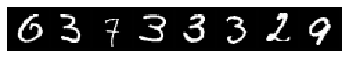

step 53661, loss 0.8587386608123779
Target:	 tensor([6, 8, 5, 8, 6, 6, 1, 2])
Pred:	 tensor([6, 3, 5, 8, 6, 6, 1, 2])


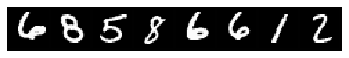

step 53711, loss 0.996648371219635
Target:	 tensor([4, 1, 2, 1, 9, 0, 8, 4])
Pred:	 tensor([4, 1, 2, 1, 4, 0, 8, 9])


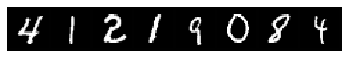

step 53761, loss 0.7441463470458984
Target:	 tensor([0, 2, 0, 4, 3, 1, 4, 4])
Pred:	 tensor([0, 3, 0, 4, 0, 1, 9, 4])


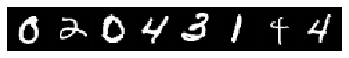

step 53811, loss 0.7050077319145203
Target:	 tensor([8, 0, 0, 7, 1, 4, 0, 8])
Pred:	 tensor([3, 0, 0, 7, 1, 4, 0, 8])


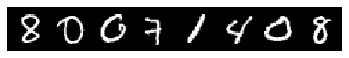

step 53861, loss 0.6202548146247864
Target:	 tensor([2, 3, 7, 2, 1, 3, 9, 2])
Pred:	 tensor([2, 3, 7, 6, 6, 3, 9, 2])


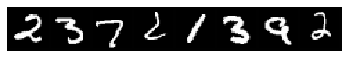

step 53911, loss 0.6339027285575867
Target:	 tensor([3, 8, 5, 9, 8, 5, 2, 5])
Pred:	 tensor([3, 8, 5, 9, 8, 5, 2, 5])


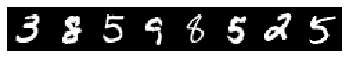

step 53961, loss 1.0428788661956787
Target:	 tensor([6, 0, 8, 1, 2, 9, 3, 7])
Pred:	 tensor([6, 0, 8, 1, 2, 4, 0, 7])


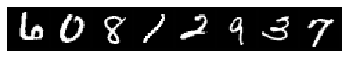

step 54011, loss 0.9359235763549805
Target:	 tensor([0, 5, 0, 3, 1, 3, 7, 1])
Pred:	 tensor([0, 5, 0, 3, 1, 3, 7, 1])


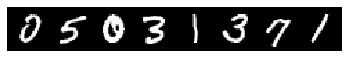

step 54061, loss 0.5612706542015076
Target:	 tensor([6, 9, 9, 7, 0, 6, 8, 3])
Pred:	 tensor([6, 1, 9, 7, 0, 6, 6, 2])


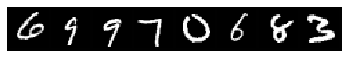

step 54111, loss 0.7698051929473877
Target:	 tensor([7, 8, 6, 3, 6, 1, 8, 9])
Pred:	 tensor([7, 8, 6, 3, 1, 1, 7, 4])


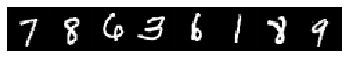

step 54161, loss 0.9639508724212646
Target:	 tensor([1, 7, 9, 2, 9, 1, 4, 9])
Pred:	 tensor([1, 7, 9, 2, 7, 1, 4, 9])


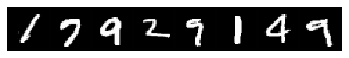

step 54211, loss 0.8735002875328064
Target:	 tensor([7, 7, 0, 4, 6, 7, 0, 1])
Pred:	 tensor([7, 7, 0, 4, 6, 7, 0, 1])


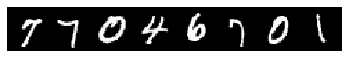

step 54261, loss 1.1330194473266602
Target:	 tensor([1, 6, 5, 6, 5, 9, 1, 5])
Pred:	 tensor([1, 6, 5, 6, 5, 9, 1, 5])


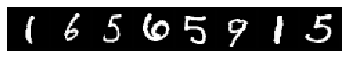

step 54311, loss 0.6807818412780762
Target:	 tensor([9, 3, 3, 3, 3, 3, 1, 2])
Pred:	 tensor([9, 3, 3, 3, 3, 3, 1, 2])


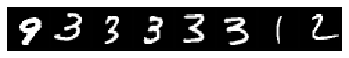

step 54361, loss 0.6706345677375793
Target:	 tensor([4, 9, 0, 9, 7, 3, 9, 2])
Pred:	 tensor([4, 9, 0, 9, 7, 3, 9, 2])


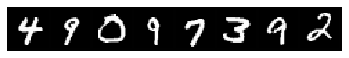

step 54411, loss 0.9932170510292053
Target:	 tensor([4, 4, 2, 1, 6, 2, 8, 8])
Pred:	 tensor([4, 9, 2, 1, 6, 2, 8, 8])


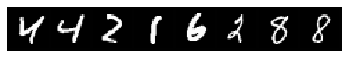

step 54461, loss 0.7353244423866272
Target:	 tensor([7, 5, 8, 7, 0, 4, 9, 5])
Pred:	 tensor([7, 5, 1, 7, 0, 4, 9, 5])


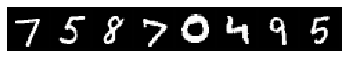

step 54511, loss 0.937845766544342
Target:	 tensor([7, 5, 1, 9, 2, 3, 5, 2])
Pred:	 tensor([7, 5, 1, 9, 2, 3, 5, 2])


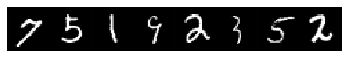

step 54561, loss 0.9511287808418274
Target:	 tensor([9, 0, 9, 4, 4, 2, 0, 8])
Pred:	 tensor([9, 0, 9, 4, 4, 2, 0, 5])


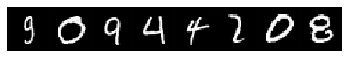

step 54611, loss 0.7906678318977356
Target:	 tensor([8, 2, 3, 8, 4, 4, 2, 2])
Pred:	 tensor([8, 1, 3, 8, 4, 4, 2, 2])


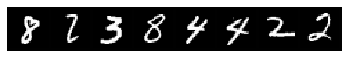

step 54661, loss 0.48128974437713623
Target:	 tensor([2, 6, 3, 7, 3, 0, 7, 7])
Pred:	 tensor([2, 6, 3, 7, 3, 0, 7, 7])


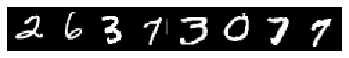

step 54711, loss 0.8215453028678894
Target:	 tensor([7, 7, 5, 0, 1, 7, 9, 6])
Pred:	 tensor([7, 7, 5, 0, 1, 7, 9, 6])


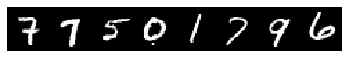

step 54761, loss 0.8313204646110535
Target:	 tensor([9, 0, 1, 6, 0, 6, 0, 7])
Pred:	 tensor([9, 0, 1, 0, 0, 6, 0, 7])


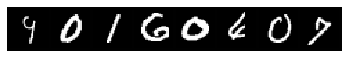

step 54802, loss 0.6505241394042969
Target:	 tensor([1, 3, 9, 3, 8, 7, 2, 1])
Pred:	 tensor([1, 3, 9, 5, 8, 7, 2, 1])


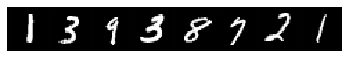

step 54852, loss 0.5766034722328186
Target:	 tensor([0, 9, 6, 5, 3, 0, 9, 3])
Pred:	 tensor([0, 9, 6, 5, 3, 0, 9, 3])


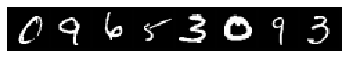

step 54902, loss 0.9389381408691406
Target:	 tensor([7, 8, 4, 5, 4, 3, 1, 6])
Pred:	 tensor([7, 8, 4, 5, 4, 2, 8, 0])


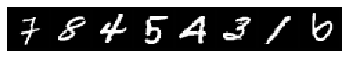

step 54952, loss 0.819821298122406
Target:	 tensor([2, 8, 8, 0, 7, 1, 7, 7])
Pred:	 tensor([1, 8, 3, 0, 7, 1, 7, 7])


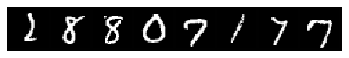

step 55002, loss 0.8691802024841309
Target:	 tensor([1, 8, 7, 8, 0, 1, 3, 9])
Pred:	 tensor([1, 5, 7, 8, 0, 1, 3, 9])


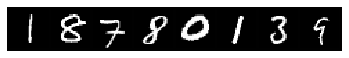

step 55052, loss 0.889072597026825
Target:	 tensor([0, 7, 2, 5, 5, 1, 0, 0])
Pred:	 tensor([0, 7, 2, 5, 5, 1, 0, 0])


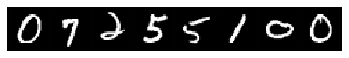

step 55102, loss 0.6949031949043274
Target:	 tensor([3, 9, 2, 8, 2, 9, 5, 6])
Pred:	 tensor([3, 9, 2, 8, 2, 5, 5, 6])


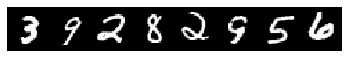

step 55152, loss 0.8803051114082336
Target:	 tensor([6, 1, 6, 2, 3, 6, 4, 3])
Pred:	 tensor([6, 1, 6, 6, 3, 6, 4, 3])


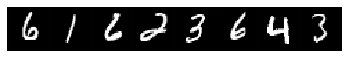

step 55202, loss 1.0486425161361694
Target:	 tensor([9, 4, 9, 4, 4, 8, 2, 5])
Pred:	 tensor([9, 4, 4, 4, 4, 1, 3, 3])


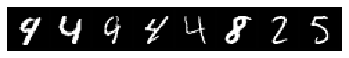

step 55252, loss 0.7206318378448486
Target:	 tensor([5, 0, 9, 9, 0, 7, 3, 2])
Pred:	 tensor([5, 0, 4, 9, 0, 7, 6, 2])


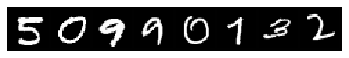

step 55302, loss 0.9057493805885315
Target:	 tensor([6, 7, 5, 6, 8, 6, 2, 9])
Pred:	 tensor([6, 9, 5, 6, 8, 6, 2, 9])


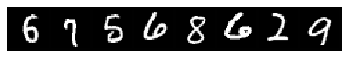

step 55352, loss 0.7205356955528259
Target:	 tensor([5, 0, 7, 2, 1, 9, 1, 2])
Pred:	 tensor([5, 0, 3, 2, 1, 9, 1, 2])


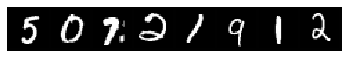

step 55402, loss 0.8233702182769775
Target:	 tensor([5, 2, 3, 3, 5, 4, 5, 3])
Pred:	 tensor([5, 3, 3, 3, 5, 6, 5, 3])


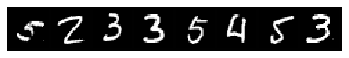

step 55452, loss 0.8458447456359863
Target:	 tensor([7, 6, 4, 9, 2, 0, 1, 5])
Pred:	 tensor([7, 6, 4, 8, 0, 0, 1, 5])


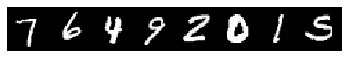

step 55502, loss 0.8024047017097473
Target:	 tensor([2, 4, 6, 2, 8, 9, 7, 2])
Pred:	 tensor([2, 4, 6, 2, 1, 3, 7, 8])


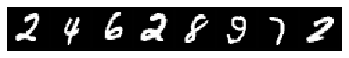

step 55552, loss 0.7549187541007996
Target:	 tensor([4, 1, 3, 9, 1, 8, 1, 3])
Pred:	 tensor([6, 1, 3, 9, 1, 8, 1, 3])


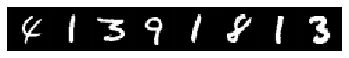

step 55602, loss 0.9192795157432556
Target:	 tensor([7, 1, 6, 1, 2, 0, 5, 6])
Pred:	 tensor([7, 1, 6, 8, 7, 0, 5, 6])


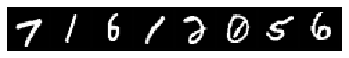

step 55652, loss 0.8877734541893005
Target:	 tensor([1, 5, 6, 8, 5, 0, 5, 4])
Pred:	 tensor([8, 5, 6, 3, 5, 0, 5, 9])


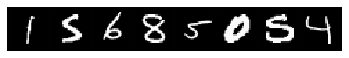

step 55702, loss 0.5113710761070251
Target:	 tensor([9, 1, 6, 8, 5, 3, 5, 6])
Pred:	 tensor([9, 1, 6, 8, 5, 3, 5, 6])


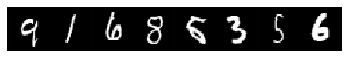

step 55752, loss 0.9911934733390808
Target:	 tensor([2, 2, 7, 4, 0, 6, 0, 3])
Pred:	 tensor([2, 2, 7, 4, 0, 6, 8, 3])


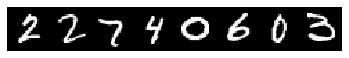

step 55802, loss 0.8986185193061829
Target:	 tensor([3, 2, 0, 8, 9, 7, 0, 7])
Pred:	 tensor([3, 2, 0, 8, 7, 9, 0, 8])


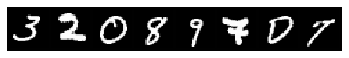

step 55852, loss 0.8854732513427734
Target:	 tensor([7, 7, 7, 2, 5, 9, 4, 5])
Pred:	 tensor([2, 7, 7, 6, 3, 9, 4, 5])


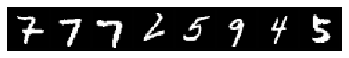

step 55902, loss 0.8258991837501526
Target:	 tensor([7, 5, 6, 7, 6, 0, 7, 3])
Pred:	 tensor([7, 5, 6, 7, 6, 0, 7, 3])


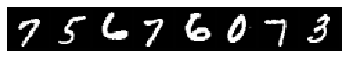

step 55952, loss 0.7340950965881348
Target:	 tensor([7, 1, 2, 6, 7, 7, 8, 4])
Pred:	 tensor([7, 1, 2, 6, 7, 7, 5, 4])


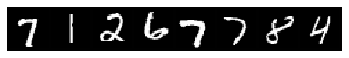

step 56002, loss 0.8166400790214539
Target:	 tensor([6, 7, 4, 2, 5, 0, 5, 7])
Pred:	 tensor([6, 7, 4, 1, 5, 0, 8, 7])


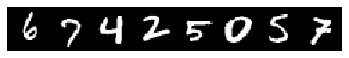

step 56052, loss 0.6991083025932312
Target:	 tensor([3, 4, 8, 1, 9, 2, 0, 4])
Pred:	 tensor([3, 4, 1, 1, 9, 1, 0, 6])


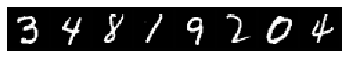

step 56102, loss 0.917994499206543
Target:	 tensor([3, 7, 6, 6, 8, 2, 1, 7])
Pred:	 tensor([3, 7, 6, 6, 6, 2, 1, 7])


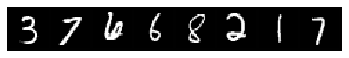

step 56152, loss 0.8773337006568909
Target:	 tensor([6, 8, 6, 6, 4, 4, 7, 1])
Pred:	 tensor([6, 3, 5, 6, 4, 4, 7, 8])


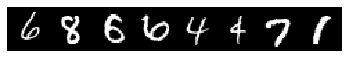

step 56202, loss 0.7707868218421936
Target:	 tensor([1, 6, 1, 9, 6, 7, 3, 8])
Pred:	 tensor([1, 6, 1, 9, 6, 9, 3, 3])


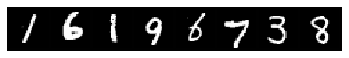

step 56252, loss 0.8029515743255615
Target:	 tensor([0, 4, 2, 6, 1, 0, 2, 9])
Pred:	 tensor([0, 4, 2, 6, 1, 0, 2, 9])


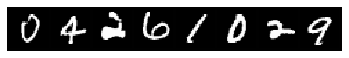

step 56302, loss 0.7209761738777161
Target:	 tensor([5, 4, 8, 3, 4, 4, 2, 4])
Pred:	 tensor([5, 4, 8, 3, 9, 9, 2, 4])


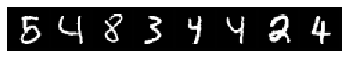

step 56352, loss 0.9706140160560608
Target:	 tensor([8, 5, 8, 7, 1, 7, 6, 4])
Pred:	 tensor([8, 5, 3, 9, 1, 7, 6, 4])


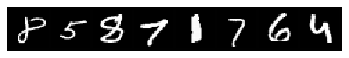

step 56402, loss 0.9232661724090576
Target:	 tensor([6, 3, 9, 2, 8, 8, 0, 4])
Pred:	 tensor([6, 2, 7, 2, 1, 5, 0, 4])


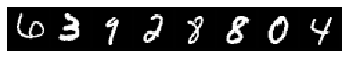

step 56452, loss 0.9291887283325195
Target:	 tensor([2, 8, 6, 8, 5, 9, 9, 9])
Pred:	 tensor([2, 8, 6, 7, 5, 7, 9, 9])


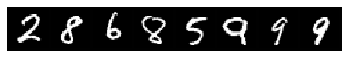

step 56502, loss 0.6332713961601257
Target:	 tensor([8, 9, 7, 6, 1, 1, 5, 6])
Pred:	 tensor([8, 9, 7, 6, 1, 1, 5, 6])


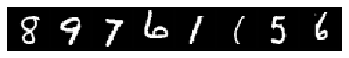

step 56552, loss 0.7177338004112244
Target:	 tensor([7, 3, 2, 3, 7, 0, 0, 1])
Pred:	 tensor([7, 2, 2, 3, 7, 0, 0, 1])


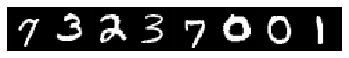

step 56602, loss 0.6851263046264648
Target:	 tensor([7, 6, 9, 3, 7, 6, 7, 9])
Pred:	 tensor([7, 6, 9, 3, 7, 6, 7, 9])


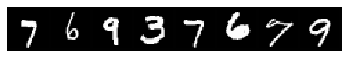

step 56652, loss 0.9019477963447571
Target:	 tensor([5, 3, 4, 8, 6, 8, 3, 0])
Pred:	 tensor([5, 3, 4, 8, 6, 5, 3, 0])


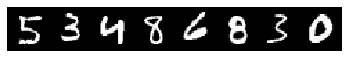

step 56702, loss 0.7396189570426941
Target:	 tensor([0, 2, 9, 8, 6, 0, 3, 9])
Pred:	 tensor([0, 2, 9, 0, 6, 0, 3, 9])


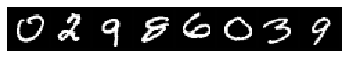

step 56752, loss 0.8111059665679932
Target:	 tensor([6, 5, 4, 8, 2, 7, 9, 0])
Pred:	 tensor([6, 5, 4, 8, 0, 7, 9, 0])


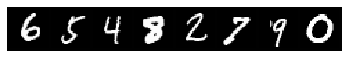

step 56802, loss 0.8879151344299316
Target:	 tensor([9, 5, 7, 1, 1, 3, 9, 7])
Pred:	 tensor([9, 8, 1, 1, 1, 3, 9, 7])


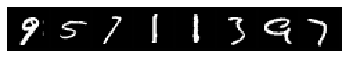

step 56852, loss 0.9879762530326843
Target:	 tensor([7, 4, 2, 5, 9, 3, 1, 3])
Pred:	 tensor([7, 4, 2, 5, 2, 1, 1, 3])


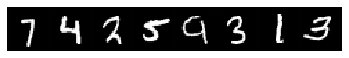

step 56902, loss 0.7672519087791443
Target:	 tensor([7, 1, 1, 1, 0, 2, 8, 4])
Pred:	 tensor([7, 1, 1, 1, 0, 2, 0, 4])


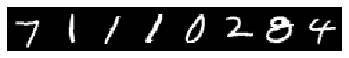

step 56952, loss 0.7112841010093689
Target:	 tensor([6, 6, 9, 7, 2, 4, 2, 2])
Pred:	 tensor([6, 6, 9, 7, 2, 4, 2, 2])


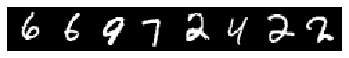

step 57002, loss 0.6100969314575195
Target:	 tensor([5, 1, 6, 0, 2, 4, 7, 3])
Pred:	 tensor([5, 1, 6, 0, 2, 4, 7, 3])


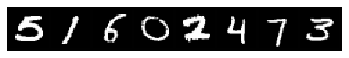

step 57052, loss 0.9414063096046448
Target:	 tensor([3, 2, 7, 2, 9, 2, 3, 0])
Pred:	 tensor([3, 2, 7, 2, 9, 2, 3, 3])


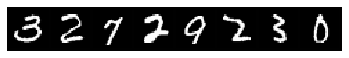

step 57102, loss 1.1694434881210327
Target:	 tensor([2, 5, 5, 2, 2, 4, 9, 9])
Pred:	 tensor([4, 8, 8, 2, 2, 4, 4, 9])


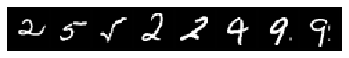

step 57152, loss 0.7149868607521057
Target:	 tensor([0, 1, 9, 2, 8, 7, 4, 7])
Pred:	 tensor([0, 1, 5, 3, 8, 7, 4, 7])


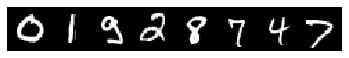

step 57202, loss 0.9985221028327942
Target:	 tensor([9, 7, 7, 0, 8, 9, 8, 5])
Pred:	 tensor([9, 9, 4, 0, 1, 9, 8, 5])


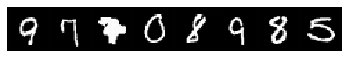

step 57252, loss 0.9779243469238281
Target:	 tensor([7, 3, 8, 4, 0, 8, 3, 7])
Pred:	 tensor([9, 3, 1, 4, 0, 8, 3, 7])


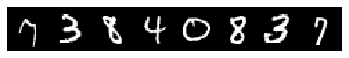

step 57293, loss 0.8424880504608154
Target:	 tensor([1, 0, 5, 8, 9, 8, 8, 4])
Pred:	 tensor([1, 0, 5, 8, 9, 8, 3, 9])


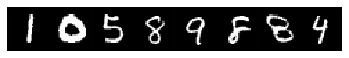

step 57343, loss 0.9854800701141357
Target:	 tensor([5, 9, 1, 1, 1, 6, 4, 1])
Pred:	 tensor([8, 9, 1, 1, 1, 6, 4, 1])


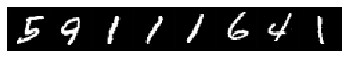

step 57393, loss 0.9432556629180908
Target:	 tensor([8, 8, 1, 5, 1, 4, 3, 9])
Pred:	 tensor([1, 3, 1, 0, 1, 9, 3, 9])


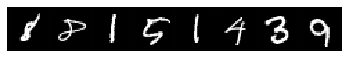

step 57443, loss 0.7549850940704346
Target:	 tensor([5, 7, 1, 4, 2, 5, 3, 7])
Pred:	 tensor([5, 7, 1, 4, 2, 6, 3, 7])


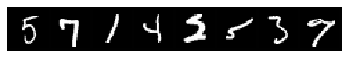

step 57493, loss 0.6422646045684814
Target:	 tensor([8, 1, 0, 7, 7, 1, 4, 0])
Pred:	 tensor([3, 1, 0, 5, 7, 1, 4, 0])


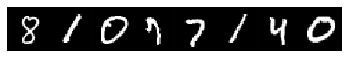

step 57543, loss 0.7818105816841125
Target:	 tensor([4, 0, 7, 8, 4, 3, 0, 9])
Pred:	 tensor([4, 0, 7, 8, 4, 3, 0, 4])


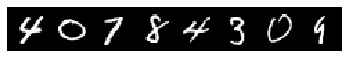

step 57593, loss 0.864916980266571
Target:	 tensor([1, 3, 0, 1, 2, 7, 6, 0])
Pred:	 tensor([1, 2, 0, 1, 2, 9, 6, 0])


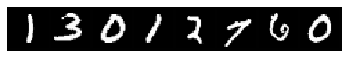

step 57643, loss 0.8173966407775879
Target:	 tensor([8, 3, 5, 5, 9, 7, 2, 8])
Pred:	 tensor([7, 7, 5, 5, 9, 7, 2, 8])


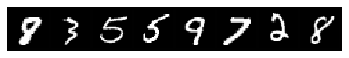

step 57693, loss 0.7125222086906433
Target:	 tensor([2, 7, 9, 0, 7, 3, 9, 8])
Pred:	 tensor([2, 7, 7, 0, 7, 3, 9, 5])


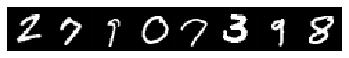

step 57743, loss 0.9977011680603027
Target:	 tensor([3, 3, 8, 0, 1, 1, 9, 5])
Pred:	 tensor([3, 2, 3, 0, 1, 1, 9, 5])


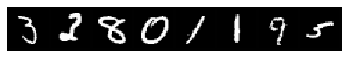

step 57793, loss 1.0205472707748413
Target:	 tensor([3, 1, 8, 6, 7, 9, 8, 7])
Pred:	 tensor([3, 1, 8, 6, 7, 9, 3, 4])


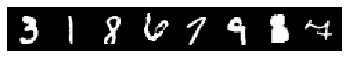

step 57843, loss 0.7209534645080566
Target:	 tensor([1, 2, 4, 4, 6, 3, 8, 1])
Pred:	 tensor([1, 2, 9, 4, 6, 3, 8, 1])


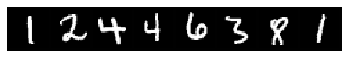

step 57893, loss 0.693385124206543
Target:	 tensor([4, 4, 2, 7, 7, 8, 4, 7])
Pred:	 tensor([4, 4, 2, 7, 7, 8, 4, 7])


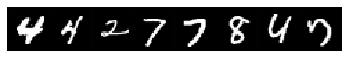

step 57943, loss 0.8394908905029297
Target:	 tensor([9, 0, 1, 4, 7, 2, 5, 6])
Pred:	 tensor([9, 0, 1, 4, 7, 2, 5, 1])


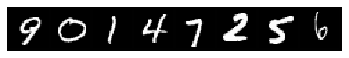

step 57993, loss 0.9994649887084961
Target:	 tensor([0, 1, 2, 1, 9, 2, 7, 9])
Pred:	 tensor([0, 7, 2, 1, 9, 2, 7, 4])


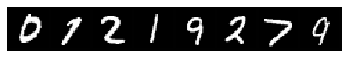

step 58043, loss 0.6534689664840698
Target:	 tensor([5, 0, 5, 3, 2, 7, 2, 8])
Pred:	 tensor([6, 0, 5, 3, 2, 7, 2, 8])


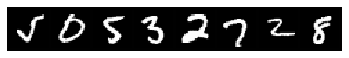

step 58093, loss 0.7878560423851013
Target:	 tensor([9, 2, 7, 9, 5, 0, 2, 8])
Pred:	 tensor([9, 2, 7, 7, 5, 0, 2, 8])


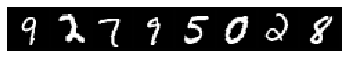

step 58143, loss 0.7464632987976074
Target:	 tensor([8, 3, 2, 7, 6, 4, 8, 6])
Pred:	 tensor([2, 3, 2, 7, 6, 4, 7, 6])


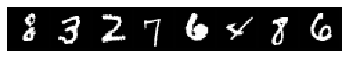

step 58193, loss 0.7231812477111816
Target:	 tensor([5, 6, 4, 4, 0, 4, 2, 4])
Pred:	 tensor([5, 6, 4, 4, 0, 4, 2, 4])


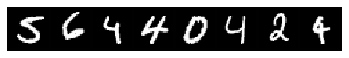

step 58243, loss 0.6808742880821228
Target:	 tensor([2, 2, 7, 7, 3, 8, 8, 4])
Pred:	 tensor([2, 2, 7, 7, 3, 8, 1, 4])


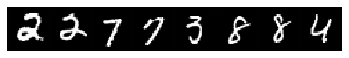

step 58293, loss 0.5990376472473145
Target:	 tensor([8, 6, 2, 7, 2, 5, 4, 1])
Pred:	 tensor([8, 6, 2, 7, 2, 5, 4, 1])


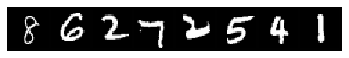

step 58343, loss 0.5488753318786621
Target:	 tensor([4, 0, 0, 0, 6, 7, 9, 3])
Pred:	 tensor([9, 0, 0, 0, 6, 9, 9, 3])


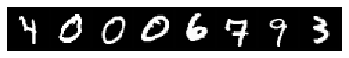

step 58393, loss 0.8846426606178284
Target:	 tensor([3, 6, 1, 2, 2, 5, 8, 2])
Pred:	 tensor([3, 6, 1, 2, 2, 5, 8, 2])


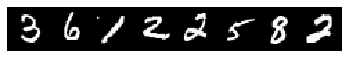

step 58443, loss 0.6792474389076233
Target:	 tensor([1, 7, 5, 2, 2, 3, 2, 6])
Pred:	 tensor([1, 7, 5, 2, 0, 3, 2, 6])


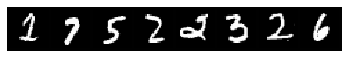

step 58493, loss 0.9163572788238525
Target:	 tensor([1, 9, 9, 5, 9, 5, 6, 7])
Pred:	 tensor([1, 9, 7, 8, 2, 5, 6, 7])


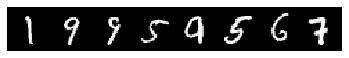

step 58543, loss 0.6403981447219849
Target:	 tensor([4, 9, 0, 3, 4, 7, 4, 8])
Pred:	 tensor([4, 9, 0, 3, 4, 7, 4, 8])


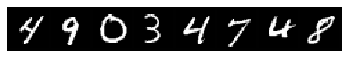

step 58593, loss 0.850151002407074
Target:	 tensor([1, 8, 0, 3, 8, 9, 9, 8])
Pred:	 tensor([1, 8, 0, 3, 1, 8, 9, 8])


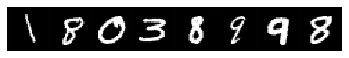

step 58643, loss 0.6111164689064026
Target:	 tensor([3, 2, 3, 5, 0, 1, 7, 0])
Pred:	 tensor([3, 2, 3, 8, 0, 1, 7, 0])


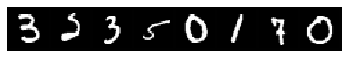

step 58693, loss 0.855309247970581
Target:	 tensor([5, 5, 3, 3, 6, 6, 6, 7])
Pred:	 tensor([5, 5, 3, 5, 1, 6, 6, 7])


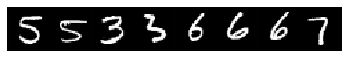

step 58743, loss 0.9577346444129944
Target:	 tensor([8, 1, 9, 5, 9, 4, 3, 9])
Pred:	 tensor([5, 1, 9, 3, 9, 4, 3, 4])


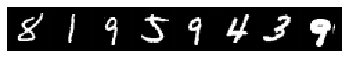

step 58793, loss 0.8761317729949951
Target:	 tensor([6, 3, 5, 6, 3, 6, 9, 8])
Pred:	 tensor([6, 3, 5, 6, 3, 6, 9, 6])


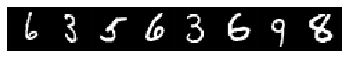

step 58843, loss 0.9978521466255188
Target:	 tensor([8, 7, 5, 7, 2, 5, 7, 6])
Pred:	 tensor([1, 7, 5, 9, 0, 5, 7, 6])


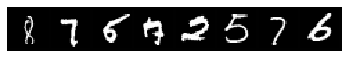

step 58893, loss 0.7298372387886047
Target:	 tensor([2, 2, 1, 1, 6, 9, 5, 7])
Pred:	 tensor([2, 2, 1, 1, 6, 4, 0, 5])


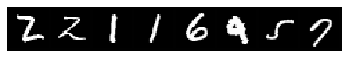

step 58943, loss 0.702873945236206
Target:	 tensor([9, 6, 5, 8, 1, 1, 5, 0])
Pred:	 tensor([9, 6, 5, 8, 1, 1, 5, 0])


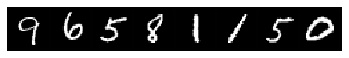

step 58993, loss 0.8099513649940491
Target:	 tensor([1, 1, 0, 7, 9, 3, 4, 5])
Pred:	 tensor([1, 1, 0, 7, 9, 1, 4, 0])


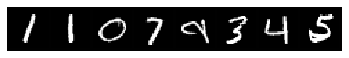

step 59043, loss 0.7545046806335449
Target:	 tensor([7, 3, 9, 0, 9, 6, 7, 7])
Pred:	 tensor([9, 3, 9, 0, 9, 1, 7, 7])


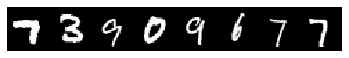

step 59093, loss 0.8981404900550842
Target:	 tensor([3, 3, 4, 3, 5, 3, 4, 0])
Pred:	 tensor([3, 3, 4, 3, 5, 3, 4, 0])


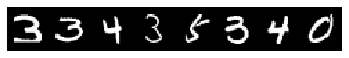

step 59143, loss 0.7255633473396301
Target:	 tensor([7, 5, 2, 4, 3, 0, 8, 1])
Pred:	 tensor([7, 6, 2, 4, 3, 0, 8, 1])


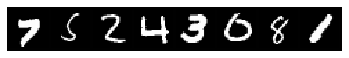

step 59193, loss 0.7274056077003479
Target:	 tensor([8, 8, 6, 1, 9, 9, 5, 3])
Pred:	 tensor([8, 7, 6, 1, 9, 7, 5, 3])


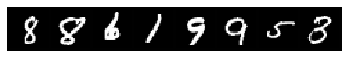

step 59243, loss 0.7746334075927734
Target:	 tensor([1, 4, 5, 2, 7, 6, 5, 8])
Pred:	 tensor([1, 9, 1, 2, 7, 6, 5, 8])


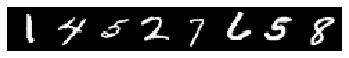

step 59293, loss 0.6727990508079529
Target:	 tensor([0, 6, 1, 2, 5, 0, 1, 4])
Pred:	 tensor([0, 6, 1, 2, 5, 0, 1, 4])


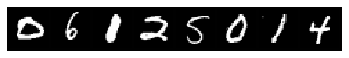

step 59343, loss 1.048719882965088
Target:	 tensor([1, 8, 7, 4, 4, 0, 7, 4])
Pred:	 tensor([1, 2, 7, 4, 4, 0, 7, 6])


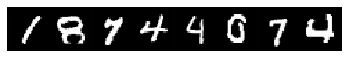

step 59393, loss 0.7547085881233215
Target:	 tensor([4, 4, 1, 7, 9, 5, 8, 6])
Pred:	 tensor([4, 4, 1, 7, 4, 5, 3, 6])


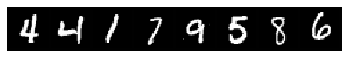

step 59443, loss 0.958233654499054
Target:	 tensor([5, 3, 0, 8, 8, 9, 0, 4])
Pred:	 tensor([4, 3, 0, 3, 8, 9, 0, 4])


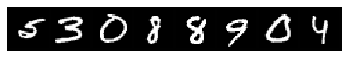

step 59493, loss 0.8138136863708496
Target:	 tensor([9, 1, 6, 1, 8, 3, 7, 3])
Pred:	 tensor([9, 1, 0, 1, 1, 3, 7, 3])


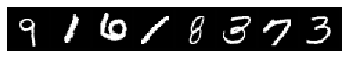

step 59543, loss 0.5641252398490906
Target:	 tensor([9, 0, 5, 3, 6, 3, 5, 0])
Pred:	 tensor([9, 0, 5, 3, 6, 3, 3, 0])


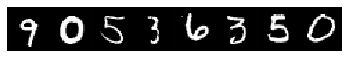

step 59593, loss 0.8752846121788025
Target:	 tensor([4, 8, 1, 1, 7, 3, 3, 7])
Pred:	 tensor([4, 8, 1, 1, 7, 1, 3, 7])


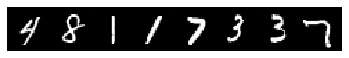

step 59643, loss 0.6997246742248535
Target:	 tensor([5, 7, 7, 9, 6, 2, 1, 5])
Pred:	 tensor([5, 9, 3, 7, 6, 2, 1, 5])


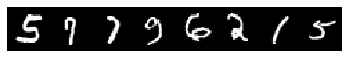

step 59693, loss 0.7246518731117249
Target:	 tensor([1, 9, 7, 4, 9, 4, 3, 3])
Pred:	 tensor([1, 9, 7, 4, 4, 4, 3, 3])


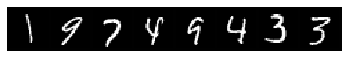

step 59743, loss 0.8288642764091492
Target:	 tensor([5, 6, 2, 8, 5, 4, 5, 3])
Pred:	 tensor([3, 8, 2, 8, 5, 4, 5, 3])


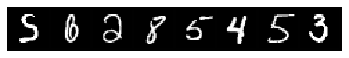

step 59784, loss 0.7538774013519287
Target:	 tensor([9, 3, 3, 2, 4, 4, 5, 3])
Pred:	 tensor([9, 3, 1, 2, 4, 4, 5, 3])


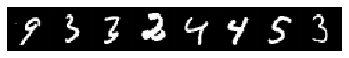

step 59834, loss 0.8249719738960266
Target:	 tensor([8, 7, 5, 0, 7, 6, 6, 1])
Pred:	 tensor([1, 7, 5, 0, 7, 6, 6, 1])


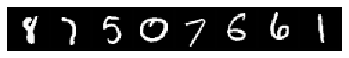

step 59884, loss 0.8243946433067322
Target:	 tensor([7, 2, 5, 9, 7, 1, 1, 3])
Pred:	 tensor([7, 6, 5, 9, 7, 1, 1, 9])


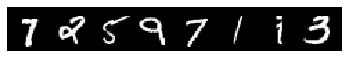

step 59934, loss 0.598664402961731
Target:	 tensor([9, 0, 0, 4, 7, 5, 9, 1])
Pred:	 tensor([9, 0, 0, 4, 7, 5, 9, 1])


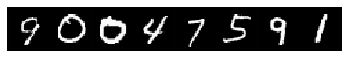

step 59984, loss 0.9671865105628967
Target:	 tensor([9, 8, 3, 9, 4, 2, 4, 8])
Pred:	 tensor([0, 8, 3, 4, 4, 2, 4, 7])


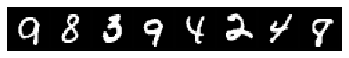

step 60034, loss 0.6906967759132385
Target:	 tensor([8, 6, 6, 2, 6, 5, 4, 0])
Pred:	 tensor([8, 0, 6, 2, 6, 5, 4, 0])


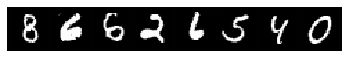

step 60084, loss 0.8228001594543457
Target:	 tensor([7, 9, 0, 0, 1, 7, 1, 3])
Pred:	 tensor([9, 9, 8, 0, 1, 7, 6, 3])


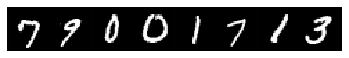

step 60134, loss 0.7803539633750916
Target:	 tensor([0, 8, 4, 9, 6, 1, 7, 9])
Pred:	 tensor([0, 8, 4, 3, 6, 1, 7, 9])


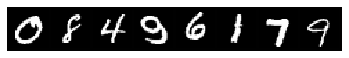

step 60184, loss 0.8188145756721497
Target:	 tensor([8, 9, 6, 3, 3, 0, 5, 2])
Pred:	 tensor([8, 9, 6, 3, 3, 0, 5, 2])


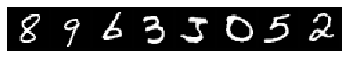

step 60234, loss 0.6631940007209778
Target:	 tensor([1, 6, 3, 7, 3, 6, 9, 3])
Pred:	 tensor([1, 6, 3, 7, 3, 6, 9, 3])


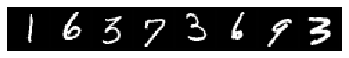

step 60284, loss 0.6739844679832458
Target:	 tensor([0, 9, 2, 9, 1, 7, 7, 9])
Pred:	 tensor([0, 9, 2, 9, 1, 7, 1, 9])


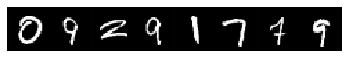

step 60334, loss 0.751049816608429
Target:	 tensor([7, 6, 7, 2, 1, 3, 4, 5])
Pred:	 tensor([7, 6, 7, 2, 1, 3, 4, 5])


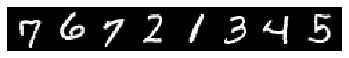

step 60384, loss 0.7226515412330627
Target:	 tensor([6, 1, 3, 8, 8, 5, 3, 6])
Pred:	 tensor([1, 1, 3, 8, 0, 5, 3, 6])


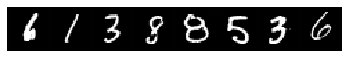

step 60434, loss 1.0685690641403198
Target:	 tensor([8, 8, 2, 0, 2, 9, 2, 8])
Pred:	 tensor([8, 8, 2, 0, 2, 1, 6, 8])


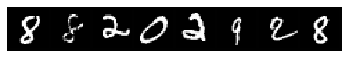

step 60484, loss 0.8321034908294678
Target:	 tensor([5, 9, 0, 6, 2, 1, 7, 4])
Pred:	 tensor([5, 9, 0, 6, 2, 1, 7, 4])


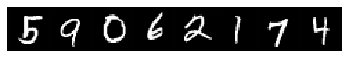

step 60534, loss 0.6942799091339111
Target:	 tensor([7, 4, 2, 3, 5, 2, 4, 3])
Pred:	 tensor([7, 4, 2, 3, 5, 2, 4, 3])


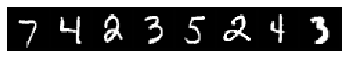

step 60584, loss 0.6970458030700684
Target:	 tensor([3, 8, 6, 1, 6, 7, 9, 5])
Pred:	 tensor([3, 7, 6, 1, 6, 7, 9, 5])


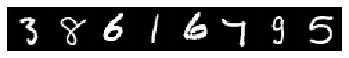

step 60634, loss 0.7210386395454407
Target:	 tensor([8, 6, 9, 1, 7, 5, 8, 0])
Pred:	 tensor([8, 6, 9, 1, 7, 5, 8, 0])


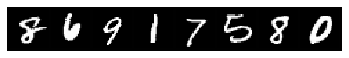

step 60684, loss 0.6849913001060486
Target:	 tensor([4, 2, 6, 9, 7, 0, 5, 4])
Pred:	 tensor([4, 2, 6, 9, 7, 0, 5, 4])


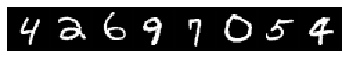

step 60734, loss 0.796719491481781
Target:	 tensor([8, 6, 1, 8, 2, 8, 2, 8])
Pred:	 tensor([6, 6, 1, 8, 2, 1, 2, 8])


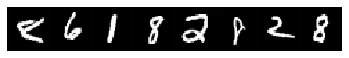

step 60784, loss 0.9377254843711853
Target:	 tensor([0, 3, 9, 2, 9, 6, 3, 8])
Pred:	 tensor([0, 2, 8, 2, 9, 6, 3, 3])


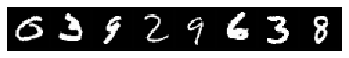

step 60834, loss 0.8317787647247314
Target:	 tensor([8, 6, 8, 2, 5, 1, 2, 6])
Pred:	 tensor([8, 6, 8, 2, 5, 1, 2, 6])


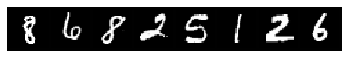

step 60884, loss 0.8690106868743896
Target:	 tensor([4, 8, 5, 9, 7, 7, 0, 3])
Pred:	 tensor([4, 1, 8, 9, 9, 7, 0, 3])


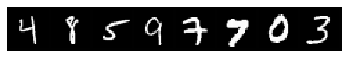

step 60934, loss 0.8261039853096008
Target:	 tensor([5, 8, 9, 1, 6, 1, 7, 8])
Pred:	 tensor([5, 8, 9, 1, 6, 1, 9, 8])


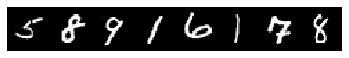

step 60984, loss 0.8857295513153076
Target:	 tensor([5, 6, 7, 3, 6, 7, 0, 2])
Pred:	 tensor([5, 6, 7, 3, 6, 9, 0, 2])


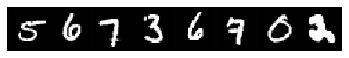

step 61034, loss 0.8519893288612366
Target:	 tensor([6, 4, 4, 5, 1, 0, 7, 8])
Pred:	 tensor([6, 4, 4, 5, 1, 0, 7, 5])


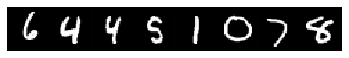

step 61084, loss 1.1864957809448242
Target:	 tensor([2, 2, 9, 5, 9, 2, 4, 1])
Pred:	 tensor([7, 6, 9, 5, 9, 2, 4, 1])


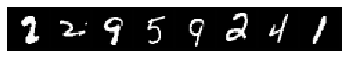

step 61134, loss 0.6319624781608582
Target:	 tensor([8, 7, 0, 1, 9, 6, 5, 2])
Pred:	 tensor([8, 7, 0, 1, 9, 6, 5, 2])


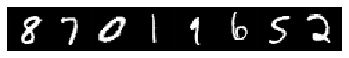

step 61184, loss 0.6865909695625305
Target:	 tensor([3, 8, 1, 1, 1, 4, 1, 5])
Pred:	 tensor([3, 9, 1, 1, 1, 4, 1, 5])


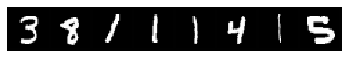

step 61234, loss 0.6453444957733154
Target:	 tensor([8, 9, 4, 4, 2, 5, 7, 1])
Pred:	 tensor([8, 9, 6, 4, 2, 5, 7, 8])


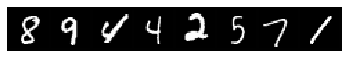

step 61284, loss 0.7212969660758972
Target:	 tensor([7, 9, 3, 4, 0, 2, 2, 8])
Pred:	 tensor([7, 9, 3, 6, 0, 2, 2, 8])


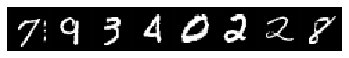

step 61334, loss 0.9197052121162415
Target:	 tensor([7, 8, 5, 3, 5, 4, 4, 4])
Pred:	 tensor([7, 8, 5, 3, 5, 4, 4, 4])


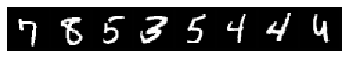

step 61384, loss 0.9511820673942566
Target:	 tensor([8, 4, 3, 9, 1, 6, 0, 5])
Pred:	 tensor([8, 4, 3, 9, 5, 6, 0, 3])


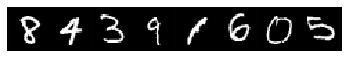

step 61434, loss 0.8291940689086914
Target:	 tensor([0, 7, 1, 1, 0, 3, 9, 9])
Pred:	 tensor([4, 7, 1, 1, 0, 3, 4, 4])


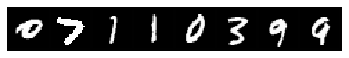

step 61484, loss 0.6820248961448669
Target:	 tensor([6, 1, 8, 9, 0, 1, 1, 0])
Pred:	 tensor([6, 1, 8, 7, 0, 1, 1, 0])


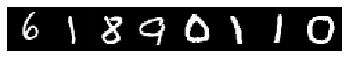

step 61534, loss 1.1765011548995972
Target:	 tensor([7, 8, 2, 4, 7, 4, 9, 7])
Pred:	 tensor([7, 7, 2, 4, 7, 4, 9, 7])


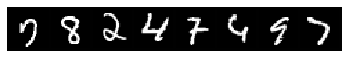

step 61584, loss 0.584534764289856
Target:	 tensor([5, 3, 0, 7, 8, 6, 9, 0])
Pred:	 tensor([5, 3, 0, 7, 5, 6, 9, 0])


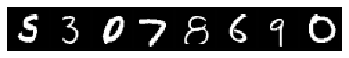

step 61634, loss 0.7914056181907654
Target:	 tensor([4, 4, 6, 0, 6, 0, 4, 6])
Pred:	 tensor([4, 4, 6, 0, 6, 0, 4, 6])


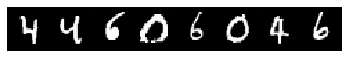

step 61684, loss 0.5471779704093933
Target:	 tensor([4, 6, 7, 0, 5, 9, 0, 0])
Pred:	 tensor([4, 6, 7, 0, 5, 9, 0, 0])


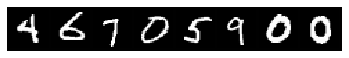

step 61734, loss 0.6737761497497559
Target:	 tensor([1, 9, 7, 0, 9, 6, 7, 0])
Pred:	 tensor([1, 9, 7, 0, 9, 6, 7, 0])


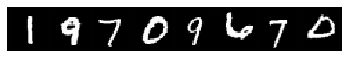

step 61784, loss 0.8683093190193176
Target:	 tensor([8, 4, 1, 5, 3, 9, 6, 3])
Pred:	 tensor([8, 4, 1, 5, 3, 9, 6, 1])


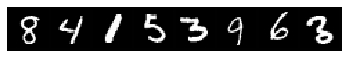

step 61834, loss 0.7706932425498962
Target:	 tensor([1, 0, 9, 8, 4, 3, 7, 7])
Pred:	 tensor([1, 0, 9, 3, 4, 3, 7, 7])


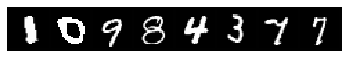

step 61884, loss 0.8664624691009521
Target:	 tensor([3, 5, 5, 3, 0, 2, 7, 8])
Pred:	 tensor([3, 9, 5, 3, 0, 2, 7, 8])


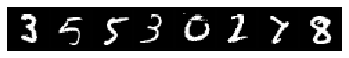

step 61934, loss 0.9213771820068359
Target:	 tensor([4, 1, 9, 4, 2, 1, 1, 5])
Pred:	 tensor([4, 8, 9, 4, 2, 1, 1, 5])


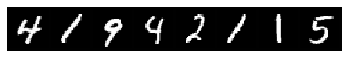

step 61984, loss 0.823381245136261
Target:	 tensor([6, 9, 5, 9, 9, 3, 7, 8])
Pred:	 tensor([6, 9, 5, 4, 4, 7, 7, 5])


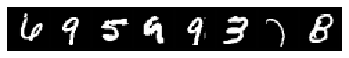

step 62034, loss 0.906528651714325
Target:	 tensor([0, 6, 0, 5, 9, 5, 7, 2])
Pred:	 tensor([3, 6, 0, 3, 9, 5, 8, 2])


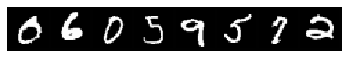

step 62084, loss 0.5822259783744812
Target:	 tensor([2, 1, 2, 3, 6, 3, 2, 1])
Pred:	 tensor([2, 1, 2, 3, 6, 3, 2, 1])


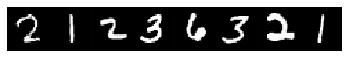

step 62134, loss 0.8145091533660889
Target:	 tensor([4, 7, 4, 6, 8, 8, 2, 1])
Pred:	 tensor([4, 7, 4, 6, 8, 8, 2, 1])


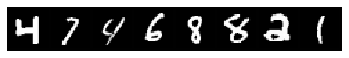

step 62184, loss 0.8830022215843201
Target:	 tensor([8, 9, 1, 3, 8, 4, 0, 4])
Pred:	 tensor([5, 9, 1, 3, 3, 4, 0, 6])


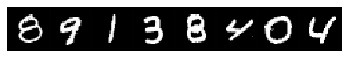

step 62234, loss 0.7212502956390381
Target:	 tensor([0, 8, 7, 1, 3, 4, 3, 5])
Pred:	 tensor([0, 8, 7, 1, 3, 6, 3, 5])


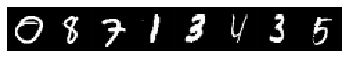

step 62275, loss 0.6516786217689514
Target:	 tensor([8, 4, 7, 4, 8, 6, 6, 1])
Pred:	 tensor([1, 4, 7, 4, 8, 6, 6, 1])


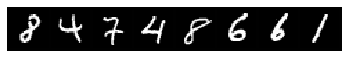

step 62325, loss 0.8319737911224365
Target:	 tensor([5, 7, 2, 2, 4, 8, 7, 5])
Pred:	 tensor([5, 7, 1, 2, 4, 8, 7, 5])


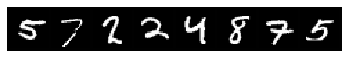

step 62375, loss 0.8228864669799805
Target:	 tensor([6, 7, 2, 7, 5, 0, 6, 2])
Pred:	 tensor([6, 7, 1, 7, 2, 0, 6, 2])


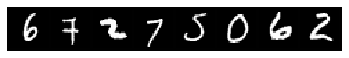

step 62425, loss 0.8561511635780334
Target:	 tensor([6, 7, 7, 8, 0, 8, 9, 0])
Pred:	 tensor([6, 7, 7, 8, 0, 8, 4, 0])


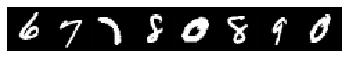

step 62475, loss 0.9570035338401794
Target:	 tensor([4, 5, 3, 0, 2, 1, 8, 1])
Pred:	 tensor([4, 5, 3, 0, 8, 8, 8, 1])


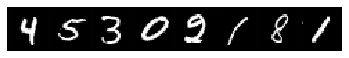

step 62525, loss 0.7072827219963074
Target:	 tensor([7, 2, 6, 3, 3, 2, 4, 3])
Pred:	 tensor([7, 2, 6, 3, 3, 2, 4, 3])


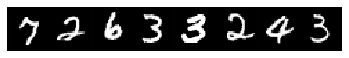

step 62575, loss 0.7233283519744873
Target:	 tensor([9, 9, 6, 6, 7, 1, 1, 1])
Pred:	 tensor([9, 0, 6, 1, 7, 1, 1, 1])


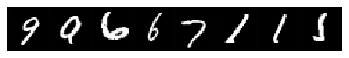

step 62625, loss 0.6529958248138428
Target:	 tensor([3, 1, 9, 4, 3, 3, 2, 2])
Pred:	 tensor([3, 1, 9, 4, 3, 3, 2, 0])


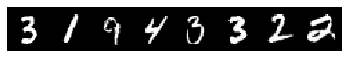

step 62675, loss 0.6494809985160828
Target:	 tensor([6, 9, 0, 6, 3, 8, 1, 4])
Pred:	 tensor([0, 9, 0, 6, 3, 8, 1, 4])


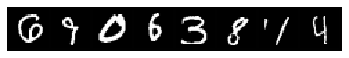

step 62725, loss 0.7735225558280945
Target:	 tensor([7, 0, 8, 8, 6, 1, 1, 5])
Pred:	 tensor([7, 0, 1, 8, 6, 6, 1, 5])


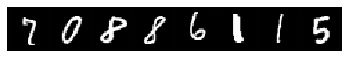

step 62775, loss 0.7088770866394043
Target:	 tensor([3, 5, 8, 7, 4, 8, 8, 6])
Pred:	 tensor([3, 5, 5, 7, 4, 8, 8, 6])


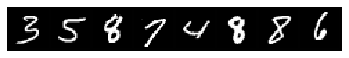

step 62825, loss 0.8093357682228088
Target:	 tensor([3, 9, 1, 3, 9, 3, 9, 1])
Pred:	 tensor([3, 9, 1, 3, 9, 3, 9, 1])


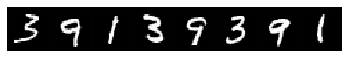

step 62875, loss 0.7830221056938171
Target:	 tensor([0, 3, 7, 7, 4, 4, 2, 7])
Pred:	 tensor([0, 3, 7, 7, 4, 4, 2, 7])


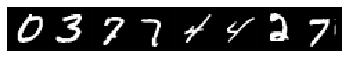

step 62925, loss 0.7218074202537537
Target:	 tensor([6, 7, 4, 7, 0, 4, 6, 2])
Pred:	 tensor([6, 7, 4, 7, 0, 4, 6, 2])


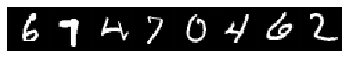

step 62975, loss 0.5225561261177063
Target:	 tensor([2, 0, 6, 3, 4, 7, 5, 8])
Pred:	 tensor([2, 0, 6, 3, 4, 7, 5, 8])


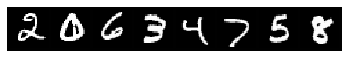

step 63025, loss 0.6878125071525574
Target:	 tensor([6, 0, 6, 4, 6, 0, 4, 1])
Pred:	 tensor([1, 8, 6, 4, 6, 0, 4, 1])


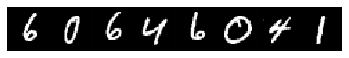

step 63075, loss 0.6966195702552795
Target:	 tensor([6, 4, 7, 5, 2, 2, 3, 3])
Pred:	 tensor([6, 4, 7, 5, 2, 2, 2, 3])


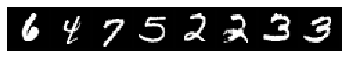

step 63125, loss 0.7091038823127747
Target:	 tensor([2, 0, 1, 1, 7, 0, 1, 0])
Pred:	 tensor([2, 0, 1, 1, 7, 0, 1, 0])


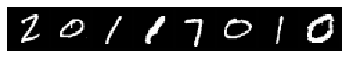

step 63175, loss 0.7127261161804199
Target:	 tensor([4, 4, 8, 6, 6, 5, 3, 0])
Pred:	 tensor([4, 4, 8, 6, 6, 5, 3, 0])


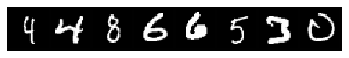

step 63225, loss 0.9634830951690674
Target:	 tensor([4, 3, 2, 0, 5, 7, 7, 2])
Pred:	 tensor([4, 3, 6, 0, 7, 7, 7, 2])


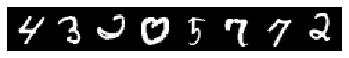

step 63275, loss 0.8514843583106995
Target:	 tensor([4, 6, 4, 0, 2, 7, 9, 8])
Pred:	 tensor([4, 6, 4, 0, 2, 7, 9, 1])


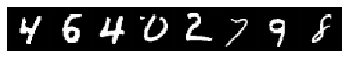

step 63325, loss 0.7602351307868958
Target:	 tensor([7, 3, 0, 3, 7, 5, 0, 4])
Pred:	 tensor([7, 2, 0, 3, 7, 5, 0, 4])


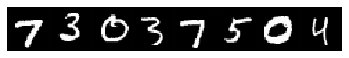

step 63375, loss 0.7614009380340576
Target:	 tensor([2, 1, 5, 5, 4, 5, 8, 1])
Pred:	 tensor([0, 1, 5, 5, 4, 5, 8, 1])


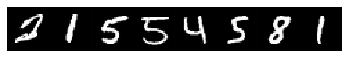

step 63425, loss 0.7389311790466309
Target:	 tensor([2, 8, 3, 7, 0, 6, 6, 1])
Pred:	 tensor([2, 8, 3, 7, 0, 6, 6, 1])


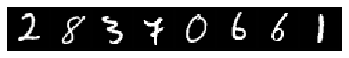

step 63475, loss 0.7363616824150085
Target:	 tensor([0, 6, 9, 0, 8, 4, 6, 4])
Pred:	 tensor([0, 6, 4, 0, 8, 4, 6, 4])


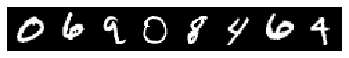

step 63525, loss 0.7072911262512207
Target:	 tensor([7, 0, 5, 1, 5, 8, 3, 5])
Pred:	 tensor([7, 0, 5, 1, 0, 1, 3, 5])


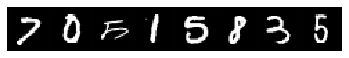

step 63575, loss 0.6878398060798645
Target:	 tensor([7, 4, 3, 6, 9, 5, 2, 6])
Pred:	 tensor([1, 4, 3, 6, 4, 5, 2, 6])


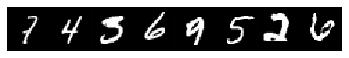

step 63625, loss 0.7535023093223572
Target:	 tensor([4, 2, 5, 1, 6, 0, 2, 7])
Pred:	 tensor([4, 3, 5, 1, 2, 0, 2, 7])


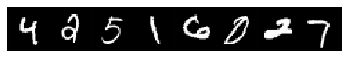

step 63675, loss 0.780465304851532
Target:	 tensor([7, 9, 8, 8, 9, 3, 4, 4])
Pred:	 tensor([7, 9, 8, 8, 9, 3, 4, 4])


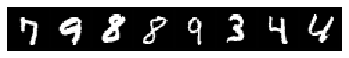

step 63725, loss 0.604539155960083
Target:	 tensor([0, 6, 6, 4, 5, 5, 8, 5])
Pred:	 tensor([0, 6, 5, 4, 5, 3, 8, 5])


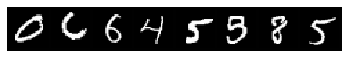

step 63775, loss 0.9159342646598816
Target:	 tensor([1, 6, 5, 5, 9, 6, 2, 8])
Pred:	 tensor([1, 6, 5, 5, 4, 1, 2, 4])


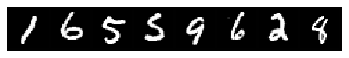

step 63825, loss 0.5767531991004944
Target:	 tensor([6, 2, 7, 2, 4, 7, 3, 9])
Pred:	 tensor([6, 2, 7, 2, 4, 7, 7, 9])


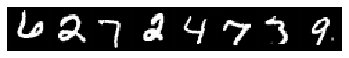

step 63875, loss 0.8279097676277161
Target:	 tensor([0, 8, 7, 8, 0, 6, 1, 5])
Pred:	 tensor([0, 8, 7, 5, 0, 6, 1, 5])


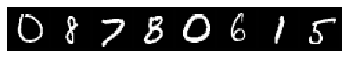

step 63925, loss 1.0294685363769531
Target:	 tensor([9, 9, 8, 2, 8, 8, 2, 1])
Pred:	 tensor([9, 9, 1, 2, 3, 8, 6, 1])


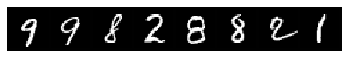

step 63975, loss 0.9805391430854797
Target:	 tensor([0, 5, 2, 9, 3, 7, 0, 6])
Pred:	 tensor([0, 5, 3, 9, 3, 7, 0, 6])


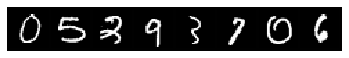

step 64025, loss 0.8906413912773132
Target:	 tensor([4, 2, 1, 1, 6, 5, 0, 1])
Pred:	 tensor([4, 2, 1, 1, 6, 8, 0, 1])


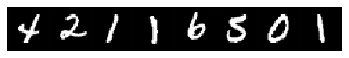

step 64075, loss 0.7288248538970947
Target:	 tensor([6, 4, 6, 2, 3, 0, 8, 5])
Pred:	 tensor([6, 4, 6, 2, 3, 0, 8, 5])


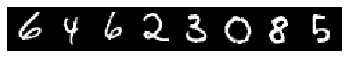

step 64125, loss 0.7472164034843445
Target:	 tensor([0, 6, 5, 8, 5, 9, 8, 5])
Pred:	 tensor([0, 6, 5, 8, 8, 9, 7, 5])


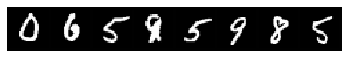

step 64175, loss 0.7781233787536621
Target:	 tensor([5, 1, 4, 5, 2, 3, 2, 6])
Pred:	 tensor([5, 1, 4, 3, 7, 3, 2, 6])


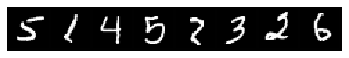

step 64225, loss 0.7076747417449951
Target:	 tensor([0, 5, 7, 0, 0, 5, 8, 1])
Pred:	 tensor([0, 5, 7, 0, 0, 5, 1, 1])


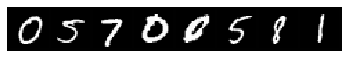

step 64275, loss 0.5502195954322815
Target:	 tensor([1, 3, 2, 6, 4, 8, 6, 2])
Pred:	 tensor([1, 3, 2, 6, 4, 8, 6, 2])


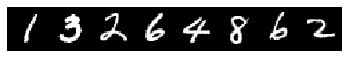

step 64325, loss 0.7589765191078186
Target:	 tensor([2, 0, 1, 1, 5, 4, 2, 1])
Pred:	 tensor([2, 6, 1, 1, 5, 4, 2, 1])


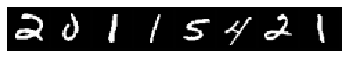

step 64375, loss 0.9314196705818176
Target:	 tensor([1, 8, 5, 2, 5, 4, 8, 4])
Pred:	 tensor([1, 8, 5, 2, 5, 4, 8, 4])


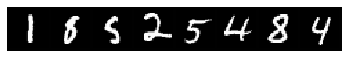

step 64425, loss 0.7940821051597595
Target:	 tensor([3, 7, 9, 4, 2, 7, 1, 1])
Pred:	 tensor([3, 7, 9, 4, 2, 7, 6, 1])


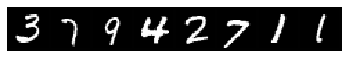

step 64475, loss 0.8645987510681152
Target:	 tensor([4, 9, 0, 4, 5, 1, 6, 2])
Pred:	 tensor([4, 9, 0, 4, 5, 1, 6, 9])


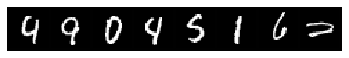

step 64525, loss 0.8934844136238098
Target:	 tensor([5, 5, 9, 7, 4, 5, 5, 1])
Pred:	 tensor([5, 3, 9, 7, 4, 0, 5, 1])


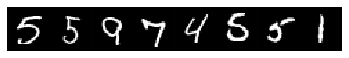

step 64575, loss 0.7921463847160339
Target:	 tensor([5, 7, 5, 6, 2, 2, 1, 9])
Pred:	 tensor([5, 7, 5, 6, 2, 2, 1, 9])


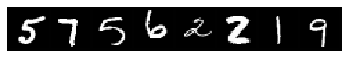

step 64625, loss 0.9585433006286621
Target:	 tensor([8, 2, 0, 4, 9, 2, 2, 3])
Pred:	 tensor([8, 6, 0, 4, 4, 6, 2, 2])


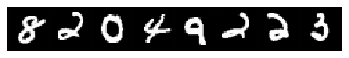

step 64675, loss 0.8006787896156311
Target:	 tensor([0, 9, 8, 3, 3, 4, 3, 6])
Pred:	 tensor([0, 9, 1, 3, 3, 4, 3, 6])


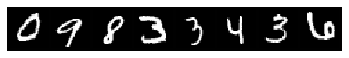

step 64725, loss 0.7846953272819519
Target:	 tensor([4, 4, 3, 9, 7, 2, 5, 1])
Pred:	 tensor([4, 4, 3, 4, 7, 2, 3, 1])


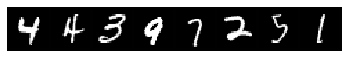

step 64766, loss 0.6623889803886414
Target:	 tensor([5, 6, 1, 5, 5, 9, 4, 0])
Pred:	 tensor([5, 6, 1, 7, 5, 9, 4, 0])


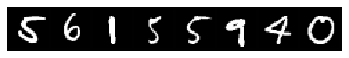

step 64816, loss 0.8961032032966614
Target:	 tensor([2, 2, 9, 7, 9, 3, 4, 5])
Pred:	 tensor([2, 2, 9, 7, 7, 3, 9, 5])


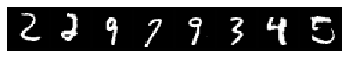

step 64866, loss 0.6657286882400513
Target:	 tensor([7, 9, 4, 1, 5, 4, 1, 3])
Pred:	 tensor([7, 9, 4, 1, 5, 4, 3, 3])


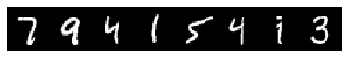

step 64916, loss 0.9132339954376221
Target:	 tensor([8, 2, 0, 7, 0, 4, 5, 2])
Pred:	 tensor([5, 2, 0, 7, 1, 4, 5, 0])


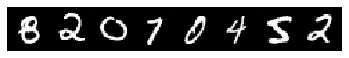

step 64966, loss 0.6635594964027405
Target:	 tensor([6, 4, 5, 1, 1, 7, 1, 8])
Pred:	 tensor([6, 4, 5, 1, 1, 1, 1, 5])


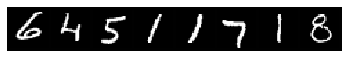

step 65016, loss 0.8433733582496643
Target:	 tensor([0, 5, 9, 0, 8, 5, 6, 0])
Pred:	 tensor([0, 5, 7, 0, 1, 5, 6, 0])


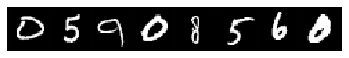

step 65066, loss 0.6270959973335266
Target:	 tensor([4, 7, 7, 7, 2, 7, 6, 4])
Pred:	 tensor([4, 7, 7, 7, 2, 7, 6, 4])


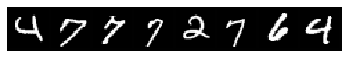

step 65116, loss 1.120058298110962
Target:	 tensor([3, 8, 6, 7, 1, 7, 6, 2])
Pred:	 tensor([3, 8, 6, 7, 1, 7, 6, 0])


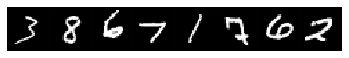

step 65166, loss 0.8252182006835938
Target:	 tensor([5, 3, 2, 8, 1, 7, 9, 6])
Pred:	 tensor([5, 3, 2, 8, 1, 7, 9, 6])


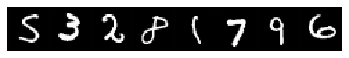

step 65216, loss 0.8571307063102722
Target:	 tensor([4, 9, 1, 9, 8, 0, 0, 5])
Pred:	 tensor([4, 9, 8, 9, 8, 0, 0, 5])


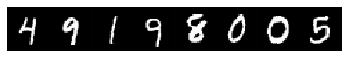

step 65266, loss 0.8300282955169678
Target:	 tensor([9, 5, 1, 6, 1, 9, 0, 9])
Pred:	 tensor([9, 1, 1, 6, 1, 9, 0, 9])


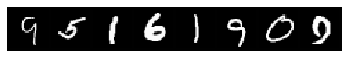

step 65316, loss 0.9871993660926819
Target:	 tensor([4, 3, 3, 4, 5, 7, 6, 4])
Pred:	 tensor([4, 3, 1, 4, 6, 7, 0, 4])


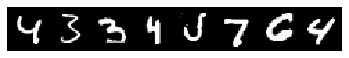

step 65366, loss 0.6853926181793213
Target:	 tensor([7, 6, 0, 6, 0, 1, 1, 5])
Pred:	 tensor([7, 6, 2, 6, 0, 1, 1, 5])


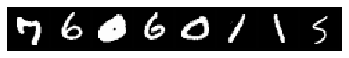

step 65416, loss 0.8454951643943787
Target:	 tensor([2, 8, 9, 0, 1, 4, 0, 4])
Pred:	 tensor([2, 1, 9, 0, 1, 4, 0, 9])


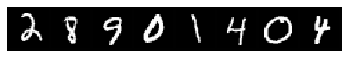

step 65466, loss 0.8091406226158142
Target:	 tensor([7, 2, 1, 9, 2, 6, 0, 1])
Pred:	 tensor([7, 2, 1, 9, 2, 1, 0, 1])


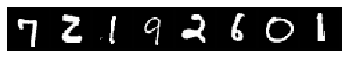

step 65516, loss 0.7615351676940918
Target:	 tensor([7, 4, 7, 8, 5, 9, 1, 8])
Pred:	 tensor([7, 1, 7, 0, 5, 9, 1, 8])


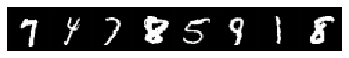

step 65566, loss 0.6153843998908997
Target:	 tensor([8, 1, 3, 1, 2, 4, 5, 7])
Pred:	 tensor([1, 1, 3, 1, 2, 4, 5, 7])


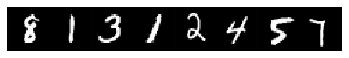

step 65616, loss 0.7350125908851624
Target:	 tensor([3, 2, 0, 2, 0, 8, 3, 3])
Pred:	 tensor([3, 2, 8, 2, 0, 8, 3, 3])


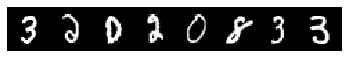

step 65666, loss 0.9578282833099365
Target:	 tensor([9, 2, 8, 1, 7, 5, 9, 8])
Pred:	 tensor([9, 3, 6, 1, 7, 4, 9, 8])


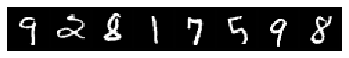

step 65716, loss 0.6705784201622009
Target:	 tensor([1, 1, 8, 6, 0, 5, 0, 2])
Pred:	 tensor([1, 1, 8, 6, 0, 5, 0, 2])


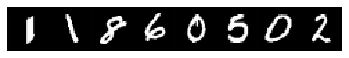

step 65766, loss 0.9089691042900085
Target:	 tensor([4, 0, 5, 7, 1, 4, 7, 4])
Pred:	 tensor([4, 2, 5, 7, 1, 4, 7, 4])


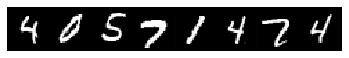

step 65816, loss 0.68386310338974
Target:	 tensor([7, 5, 6, 9, 4, 5, 8, 4])
Pred:	 tensor([7, 5, 1, 9, 4, 5, 1, 4])


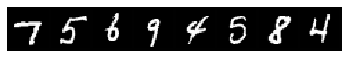

step 65866, loss 0.6548671722412109
Target:	 tensor([6, 5, 0, 0, 8, 1, 3, 4])
Pred:	 tensor([6, 5, 0, 0, 8, 1, 3, 4])


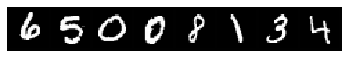

step 65916, loss 0.690313994884491
Target:	 tensor([9, 5, 1, 6, 6, 1, 1, 4])
Pred:	 tensor([9, 6, 1, 6, 6, 1, 1, 4])


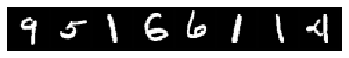

step 65966, loss 0.7008882164955139
Target:	 tensor([6, 4, 3, 1, 4, 7, 3, 8])
Pred:	 tensor([6, 4, 2, 1, 9, 7, 3, 1])


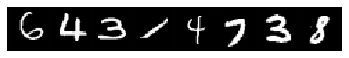

step 66016, loss 0.8050835728645325
Target:	 tensor([6, 3, 8, 5, 7, 9, 8, 2])
Pred:	 tensor([1, 3, 1, 5, 7, 4, 1, 2])


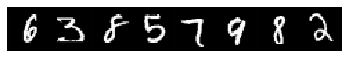

step 66066, loss 0.7650098204612732
Target:	 tensor([7, 2, 4, 4, 8, 4, 4, 6])
Pred:	 tensor([9, 2, 4, 4, 5, 4, 4, 6])


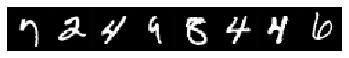

step 66116, loss 0.8069471716880798
Target:	 tensor([5, 0, 7, 1, 7, 8, 9, 1])
Pred:	 tensor([5, 0, 7, 1, 7, 8, 9, 1])


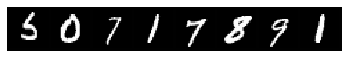

step 66166, loss 0.8425354957580566
Target:	 tensor([9, 1, 6, 8, 9, 1, 3, 8])
Pred:	 tensor([9, 1, 6, 8, 4, 1, 5, 8])


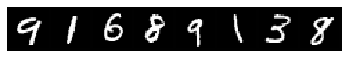

step 66216, loss 0.8862877488136292
Target:	 tensor([1, 6, 0, 8, 2, 5, 9, 6])
Pred:	 tensor([1, 6, 0, 2, 2, 5, 4, 6])


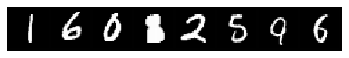

step 66266, loss 0.582539439201355
Target:	 tensor([2, 3, 0, 5, 7, 2, 6, 5])
Pred:	 tensor([2, 3, 0, 5, 7, 2, 6, 8])


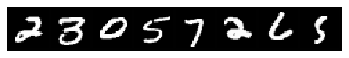

step 66316, loss 0.8191595077514648
Target:	 tensor([9, 0, 4, 7, 2, 1, 2, 0])
Pred:	 tensor([9, 0, 4, 7, 2, 1, 2, 1])


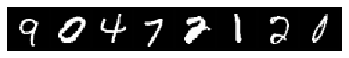

step 66366, loss 0.8004283308982849
Target:	 tensor([1, 9, 1, 4, 9, 0, 9, 8])
Pred:	 tensor([1, 9, 1, 4, 9, 0, 9, 8])


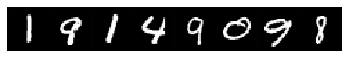

step 66416, loss 0.7504101395606995
Target:	 tensor([8, 4, 6, 7, 0, 1, 9, 2])
Pred:	 tensor([3, 4, 6, 7, 0, 1, 9, 2])


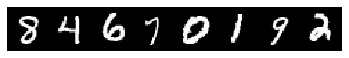

step 66466, loss 0.9081311225891113
Target:	 tensor([8, 3, 2, 1, 7, 3, 8, 1])
Pred:	 tensor([1, 7, 2, 1, 7, 3, 7, 1])


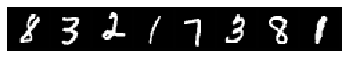

step 66516, loss 0.9064177870750427
Target:	 tensor([7, 8, 4, 1, 5, 9, 1, 0])
Pred:	 tensor([7, 3, 4, 1, 5, 5, 1, 0])


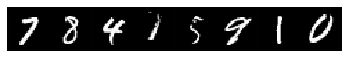

step 66566, loss 0.691288411617279
Target:	 tensor([6, 4, 1, 0, 9, 1, 3, 2])
Pred:	 tensor([6, 9, 1, 0, 9, 1, 3, 0])


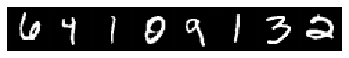

step 66616, loss 0.8200761675834656
Target:	 tensor([2, 7, 8, 5, 5, 5, 6, 1])
Pred:	 tensor([2, 7, 8, 9, 5, 5, 6, 1])


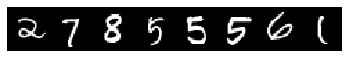

step 66666, loss 0.6665937304496765
Target:	 tensor([9, 3, 9, 5, 9, 0, 6, 0])
Pred:	 tensor([9, 3, 9, 5, 9, 0, 6, 0])


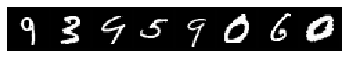

step 66716, loss 0.7107724547386169
Target:	 tensor([6, 0, 4, 0, 4, 8, 6, 4])
Pred:	 tensor([6, 0, 4, 0, 4, 8, 6, 4])


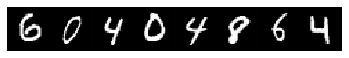

step 66766, loss 0.9644023776054382
Target:	 tensor([8, 0, 8, 1, 3, 4, 2, 3])
Pred:	 tensor([8, 0, 3, 1, 5, 4, 7, 1])


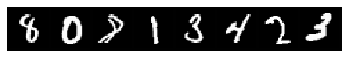

step 66816, loss 0.6016796231269836
Target:	 tensor([9, 1, 1, 7, 2, 9, 3, 1])
Pred:	 tensor([9, 1, 1, 7, 4, 9, 3, 1])


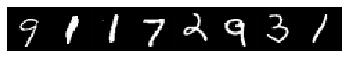

step 66866, loss 0.6253184676170349
Target:	 tensor([0, 3, 4, 0, 6, 9, 6, 4])
Pred:	 tensor([0, 3, 4, 0, 6, 9, 6, 4])


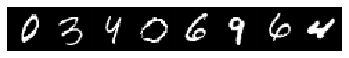

step 66916, loss 0.7939037680625916
Target:	 tensor([1, 0, 1, 6, 3, 9, 7, 0])
Pred:	 tensor([1, 0, 1, 6, 3, 7, 7, 0])


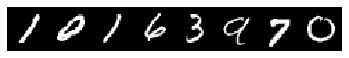

step 66966, loss 0.9502238631248474
Target:	 tensor([4, 0, 0, 1, 5, 8, 6, 6])
Pred:	 tensor([4, 0, 0, 1, 5, 8, 6, 6])


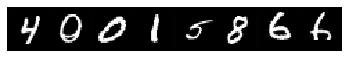

step 67016, loss 0.8845384120941162
Target:	 tensor([8, 8, 8, 1, 9, 7, 0, 0])
Pred:	 tensor([3, 1, 8, 1, 9, 7, 0, 6])


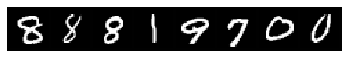

step 67066, loss 0.522024929523468
Target:	 tensor([2, 2, 6, 0, 1, 9, 6, 1])
Pred:	 tensor([2, 2, 6, 0, 1, 9, 6, 1])


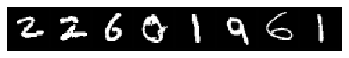

step 67116, loss 0.9069807529449463
Target:	 tensor([4, 9, 7, 4, 5, 0, 9, 9])
Pred:	 tensor([4, 5, 7, 4, 5, 0, 9, 9])


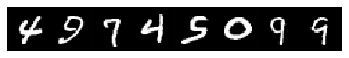

step 67166, loss 0.6506197452545166
Target:	 tensor([0, 2, 3, 6, 0, 9, 2, 0])
Pred:	 tensor([0, 2, 3, 6, 0, 9, 2, 0])


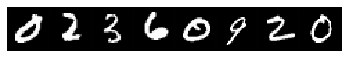

step 67216, loss 0.7748898863792419
Target:	 tensor([7, 1, 5, 4, 9, 0, 5, 5])
Pred:	 tensor([7, 1, 5, 1, 9, 0, 8, 5])


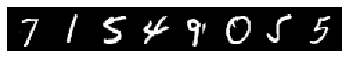

step 67257, loss 0.7345549464225769
Target:	 tensor([8, 7, 2, 2, 1, 3, 4, 8])
Pred:	 tensor([9, 7, 2, 2, 1, 3, 4, 6])


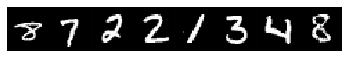

step 67307, loss 0.7540318965911865
Target:	 tensor([7, 2, 9, 3, 3, 9, 5, 9])
Pred:	 tensor([7, 2, 9, 3, 3, 9, 5, 9])


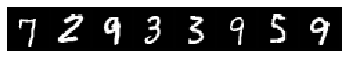

step 67357, loss 0.5854170918464661
Target:	 tensor([7, 2, 6, 2, 5, 4, 4, 0])
Pred:	 tensor([7, 2, 6, 2, 5, 4, 4, 0])


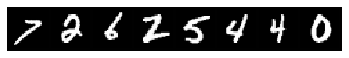

step 67407, loss 0.5632166862487793
Target:	 tensor([2, 9, 3, 5, 6, 5, 9, 7])
Pred:	 tensor([2, 9, 3, 5, 6, 5, 9, 7])


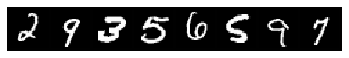

step 67457, loss 0.6935005784034729
Target:	 tensor([3, 7, 7, 9, 8, 6, 7, 9])
Pred:	 tensor([3, 7, 7, 9, 8, 6, 7, 4])


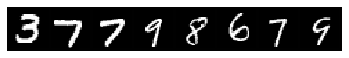

step 67507, loss 0.6905391812324524
Target:	 tensor([8, 1, 3, 8, 7, 4, 2, 1])
Pred:	 tensor([3, 7, 3, 3, 7, 9, 2, 1])


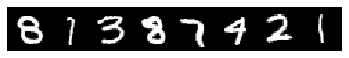

step 67557, loss 0.8155841827392578
Target:	 tensor([6, 9, 7, 4, 9, 7, 6, 5])
Pred:	 tensor([6, 9, 7, 4, 9, 7, 6, 5])


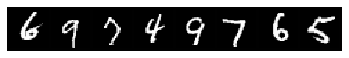

step 67607, loss 0.6801272034645081
Target:	 tensor([8, 4, 7, 4, 2, 3, 4, 1])
Pred:	 tensor([6, 4, 7, 4, 1, 3, 4, 1])


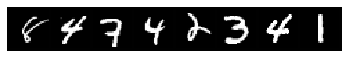

step 67657, loss 1.0769528150558472
Target:	 tensor([1, 8, 3, 6, 4, 7, 8, 9])
Pred:	 tensor([1, 2, 3, 6, 4, 7, 5, 7])


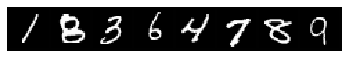

step 67707, loss 0.7890763282775879
Target:	 tensor([2, 7, 0, 1, 2, 2, 1, 1])
Pred:	 tensor([2, 7, 0, 1, 2, 2, 1, 1])


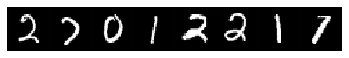

step 67757, loss 0.719843864440918
Target:	 tensor([6, 9, 2, 7, 0, 1, 1, 3])
Pred:	 tensor([6, 7, 2, 7, 0, 1, 1, 3])


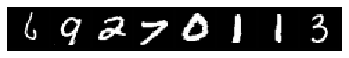

step 67807, loss 0.6120445132255554
Target:	 tensor([0, 6, 4, 3, 7, 1, 7, 4])
Pred:	 tensor([0, 6, 4, 3, 7, 1, 7, 4])


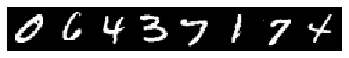

step 67857, loss 0.8188384175300598
Target:	 tensor([5, 7, 5, 7, 6, 0, 1, 6])
Pred:	 tensor([8, 7, 5, 7, 6, 0, 1, 6])


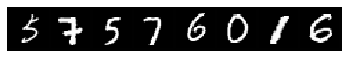

step 67907, loss 0.8100618720054626
Target:	 tensor([4, 7, 0, 6, 4, 5, 7, 5])
Pred:	 tensor([4, 1, 2, 6, 4, 5, 7, 5])


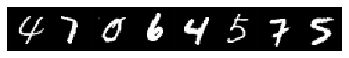

step 67957, loss 0.7952955365180969
Target:	 tensor([6, 6, 9, 9, 9, 6, 0, 0])
Pred:	 tensor([6, 6, 9, 9, 9, 6, 0, 0])


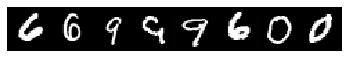

step 68007, loss 0.6446173191070557
Target:	 tensor([8, 1, 7, 1, 8, 9, 4, 0])
Pred:	 tensor([8, 1, 7, 1, 5, 9, 4, 0])


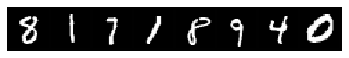

step 68057, loss 0.8470826745033264
Target:	 tensor([2, 0, 0, 8, 3, 8, 3, 2])
Pred:	 tensor([2, 0, 0, 8, 3, 5, 3, 8])


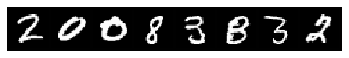

step 68107, loss 0.9639989733695984
Target:	 tensor([0, 7, 0, 9, 5, 2, 6, 9])
Pred:	 tensor([0, 8, 0, 5, 9, 3, 6, 9])


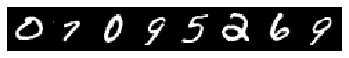

step 68157, loss 0.7248969078063965
Target:	 tensor([1, 9, 4, 6, 1, 5, 5, 8])
Pred:	 tensor([1, 9, 4, 6, 1, 5, 5, 1])


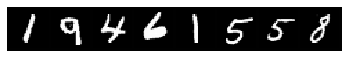

step 68207, loss 0.8080172538757324
Target:	 tensor([7, 5, 4, 4, 2, 9, 8, 0])
Pred:	 tensor([7, 6, 4, 4, 0, 9, 3, 0])


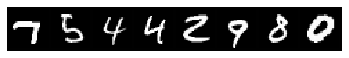

step 68257, loss 1.0685895681381226
Target:	 tensor([7, 4, 6, 9, 0, 8, 5, 5])
Pred:	 tensor([7, 4, 0, 9, 0, 8, 5, 5])


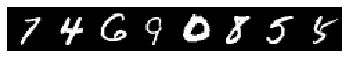

step 68307, loss 0.8081331849098206
Target:	 tensor([5, 0, 4, 5, 9, 1, 2, 3])
Pred:	 tensor([5, 0, 4, 8, 9, 1, 0, 5])


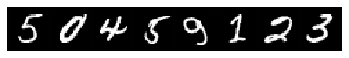

step 68357, loss 0.7411341071128845
Target:	 tensor([6, 7, 8, 2, 4, 3, 2, 3])
Pred:	 tensor([6, 7, 1, 2, 4, 2, 2, 3])


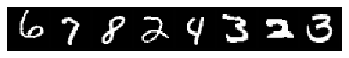

step 68407, loss 0.8482642769813538
Target:	 tensor([2, 4, 6, 2, 4, 8, 7, 2])
Pred:	 tensor([2, 4, 6, 2, 4, 8, 3, 2])


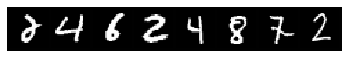

step 68457, loss 0.8199827075004578
Target:	 tensor([4, 7, 2, 7, 9, 8, 2, 3])
Pred:	 tensor([4, 7, 2, 7, 9, 9, 0, 3])


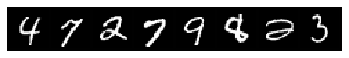

step 68507, loss 0.8335773348808289
Target:	 tensor([2, 7, 0, 6, 2, 3, 5, 9])
Pred:	 tensor([2, 7, 0, 6, 1, 3, 5, 9])


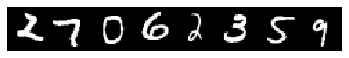

step 68557, loss 0.7120980620384216
Target:	 tensor([0, 4, 0, 7, 7, 5, 8, 3])
Pred:	 tensor([6, 4, 0, 7, 7, 5, 8, 5])


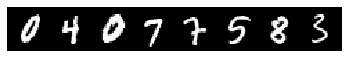

step 68607, loss 0.6972394585609436
Target:	 tensor([5, 7, 0, 0, 8, 4, 5, 4])
Pred:	 tensor([5, 7, 0, 0, 5, 4, 5, 4])


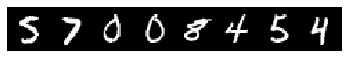

step 68657, loss 1.0932445526123047
Target:	 tensor([9, 9, 9, 8, 8, 5, 7, 1])
Pred:	 tensor([5, 9, 9, 5, 8, 5, 7, 1])


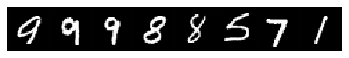

step 68707, loss 0.6857028007507324
Target:	 tensor([8, 1, 8, 5, 9, 9, 7, 3])
Pred:	 tensor([5, 1, 1, 5, 9, 9, 7, 7])


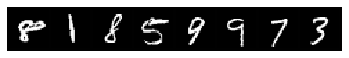

step 68757, loss 0.6241182684898376
Target:	 tensor([1, 7, 5, 3, 2, 9, 3, 6])
Pred:	 tensor([1, 7, 5, 3, 2, 9, 3, 6])


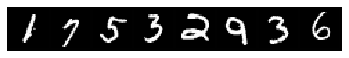

step 68807, loss 0.964951753616333
Target:	 tensor([9, 3, 8, 3, 6, 2, 2, 4])
Pred:	 tensor([9, 3, 1, 3, 6, 2, 2, 9])


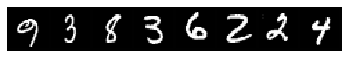

step 68857, loss 0.6503254175186157
Target:	 tensor([5, 8, 7, 9, 1, 9, 2, 8])
Pred:	 tensor([5, 8, 7, 9, 1, 4, 2, 8])


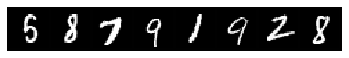

step 68907, loss 1.1568485498428345
Target:	 tensor([9, 5, 0, 5, 8, 3, 5, 3])
Pred:	 tensor([1, 5, 0, 3, 1, 0, 5, 3])


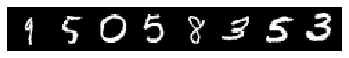

step 68957, loss 0.783998429775238
Target:	 tensor([7, 2, 4, 1, 6, 2, 7, 2])
Pred:	 tensor([7, 1, 4, 1, 6, 4, 7, 2])


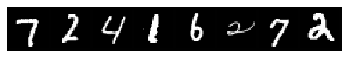

step 69007, loss 0.6660479307174683
Target:	 tensor([8, 5, 2, 6, 0, 7, 9, 8])
Pred:	 tensor([8, 5, 2, 6, 0, 7, 4, 8])


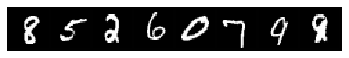

step 69057, loss 0.9184930324554443
Target:	 tensor([3, 6, 4, 7, 7, 9, 7, 6])
Pred:	 tensor([7, 5, 4, 7, 7, 9, 7, 6])


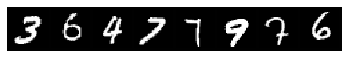

step 69107, loss 0.8271015286445618
Target:	 tensor([2, 1, 3, 2, 2, 6, 3, 1])
Pred:	 tensor([2, 1, 3, 9, 0, 6, 3, 1])


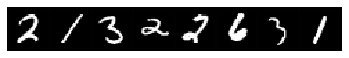

step 69157, loss 0.752570390701294
Target:	 tensor([6, 5, 5, 9, 3, 5, 4, 4])
Pred:	 tensor([6, 5, 8, 9, 3, 5, 4, 4])


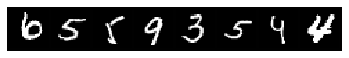

step 69207, loss 0.6192696690559387
Target:	 tensor([0, 2, 8, 8, 3, 0, 0, 6])
Pred:	 tensor([0, 2, 1, 8, 5, 2, 0, 6])


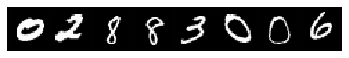

step 69257, loss 0.934135913848877
Target:	 tensor([3, 8, 5, 5, 2, 4, 1, 9])
Pred:	 tensor([3, 1, 9, 5, 2, 4, 7, 9])


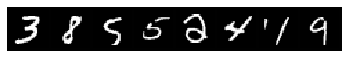

step 69307, loss 1.0242429971694946
Target:	 tensor([4, 2, 3, 2, 1, 9, 8, 2])
Pred:	 tensor([6, 2, 5, 0, 1, 0, 4, 2])


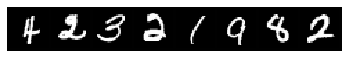

step 69357, loss 0.9663794636726379
Target:	 tensor([2, 3, 4, 9, 8, 4, 7, 4])
Pred:	 tensor([2, 3, 4, 9, 8, 9, 7, 4])


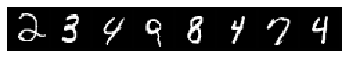

step 69407, loss 0.8966800570487976
Target:	 tensor([4, 7, 0, 1, 3, 8, 2, 8])
Pred:	 tensor([4, 7, 0, 1, 3, 8, 2, 8])


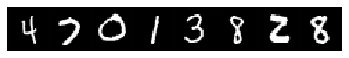

step 69457, loss 1.011919617652893
Target:	 tensor([0, 5, 3, 2, 8, 4, 5, 1])
Pred:	 tensor([0, 5, 3, 2, 6, 4, 5, 1])


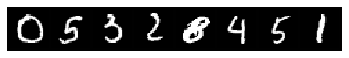

step 69507, loss 0.6008235812187195
Target:	 tensor([1, 5, 7, 1, 3, 6, 5, 7])
Pred:	 tensor([1, 5, 3, 1, 3, 6, 5, 7])


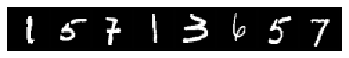

step 69557, loss 1.2871400117874146
Target:	 tensor([8, 9, 3, 9, 8, 5, 3, 8])
Pred:	 tensor([8, 9, 3, 9, 0, 5, 3, 1])


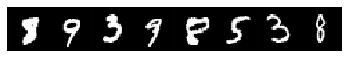

step 69607, loss 0.6975148320198059
Target:	 tensor([2, 2, 6, 5, 1, 0, 0, 3])
Pred:	 tensor([2, 2, 6, 5, 1, 0, 0, 3])


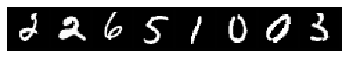

step 69657, loss 0.6017937660217285
Target:	 tensor([1, 3, 3, 7, 6, 8, 9, 7])
Pred:	 tensor([1, 3, 3, 7, 6, 8, 4, 7])


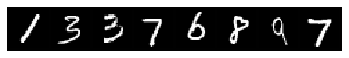

step 69707, loss 0.8761294484138489
Target:	 tensor([1, 9, 2, 1, 8, 5, 6, 3])
Pred:	 tensor([1, 9, 0, 1, 8, 5, 2, 3])


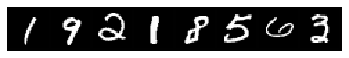

step 69748, loss 1.0050989389419556
Target:	 tensor([9, 9, 8, 9, 0, 3, 3, 3])
Pred:	 tensor([9, 7, 5, 9, 0, 3, 3, 3])


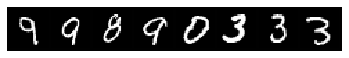

step 69798, loss 0.757936954498291
Target:	 tensor([5, 1, 0, 1, 1, 6, 0, 1])
Pred:	 tensor([5, 1, 0, 1, 3, 4, 0, 2])


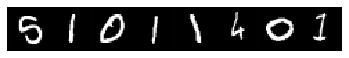

step 69848, loss 0.9517972469329834
Target:	 tensor([5, 4, 3, 9, 8, 4, 6, 2])
Pred:	 tensor([5, 4, 5, 9, 5, 4, 6, 2])


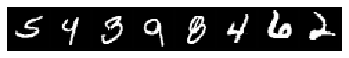

step 69898, loss 0.6624512672424316
Target:	 tensor([7, 7, 6, 1, 1, 3, 5, 6])
Pred:	 tensor([7, 7, 6, 1, 1, 3, 5, 6])


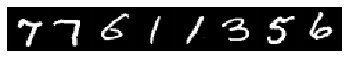

step 69948, loss 0.8988211750984192
Target:	 tensor([5, 5, 5, 9, 8, 0, 1, 0])
Pred:	 tensor([5, 5, 5, 4, 1, 0, 1, 0])


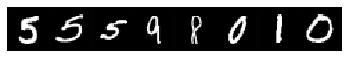

step 69998, loss 0.7878624796867371
Target:	 tensor([2, 9, 8, 2, 4, 0, 3, 5])
Pred:	 tensor([2, 7, 5, 2, 4, 0, 3, 5])


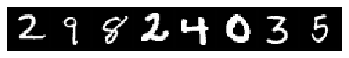

step 70048, loss 0.6391200423240662
Target:	 tensor([6, 1, 8, 4, 5, 0, 0, 0])
Pred:	 tensor([6, 1, 1, 4, 5, 0, 0, 0])


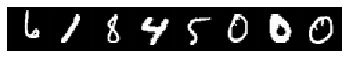

step 70098, loss 0.889249324798584
Target:	 tensor([1, 2, 8, 9, 3, 4, 0, 8])
Pred:	 tensor([1, 2, 8, 5, 3, 4, 0, 3])


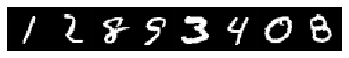

step 70148, loss 0.6199137568473816
Target:	 tensor([0, 4, 7, 3, 9, 4, 2, 6])
Pred:	 tensor([0, 4, 9, 3, 9, 4, 2, 6])


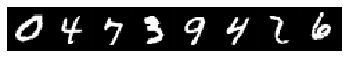

step 70198, loss 0.7126176953315735
Target:	 tensor([3, 2, 3, 6, 5, 4, 2, 7])
Pred:	 tensor([3, 3, 1, 6, 5, 4, 2, 7])


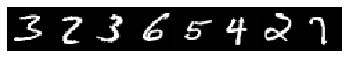

step 70248, loss 0.843336820602417
Target:	 tensor([7, 5, 0, 6, 4, 4, 1, 9])
Pred:	 tensor([7, 5, 0, 6, 4, 4, 1, 9])


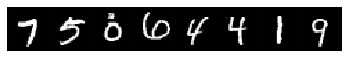

step 70298, loss 0.9085213541984558
Target:	 tensor([5, 6, 8, 3, 6, 3, 4, 3])
Pred:	 tensor([3, 6, 1, 3, 6, 3, 4, 3])


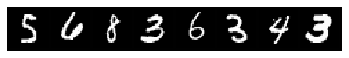

step 70348, loss 0.9475298523902893
Target:	 tensor([2, 2, 2, 7, 9, 9, 9, 3])
Pred:	 tensor([2, 2, 2, 7, 3, 9, 9, 3])


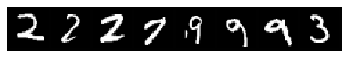

step 70398, loss 0.7308878898620605
Target:	 tensor([3, 6, 2, 7, 5, 9, 5, 7])
Pred:	 tensor([3, 0, 2, 7, 6, 9, 5, 7])


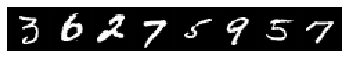

step 70448, loss 0.980617344379425
Target:	 tensor([6, 3, 9, 9, 1, 1, 5, 6])
Pred:	 tensor([6, 8, 9, 1, 6, 1, 5, 6])


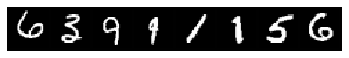

step 70498, loss 0.6757317185401917
Target:	 tensor([5, 9, 9, 7, 8, 1, 0, 6])
Pred:	 tensor([5, 9, 9, 7, 8, 1, 0, 6])


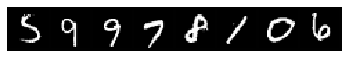

step 70548, loss 0.8606721758842468
Target:	 tensor([3, 5, 0, 3, 9, 3, 3, 9])
Pred:	 tensor([3, 5, 0, 3, 9, 3, 8, 9])


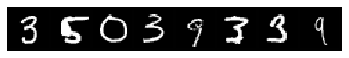

step 70598, loss 0.8954858779907227
Target:	 tensor([2, 2, 5, 9, 5, 8, 9, 5])
Pred:	 tensor([2, 2, 5, 4, 5, 8, 9, 5])


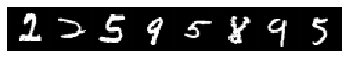

step 70648, loss 0.7184048295021057
Target:	 tensor([7, 2, 0, 6, 5, 7, 7, 6])
Pred:	 tensor([7, 2, 0, 6, 5, 7, 7, 6])


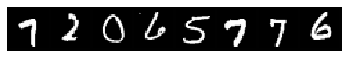

step 70698, loss 0.9133080840110779
Target:	 tensor([9, 0, 8, 0, 6, 1, 2, 4])
Pred:	 tensor([4, 0, 5, 0, 6, 1, 1, 9])


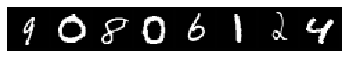

step 70748, loss 0.8794535994529724
Target:	 tensor([0, 7, 2, 7, 8, 2, 6, 8])
Pred:	 tensor([0, 7, 1, 7, 8, 2, 6, 9])


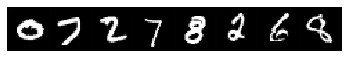

step 70798, loss 0.8498085141181946
Target:	 tensor([1, 1, 3, 3, 7, 6, 5, 0])
Pred:	 tensor([1, 8, 3, 0, 7, 6, 5, 0])


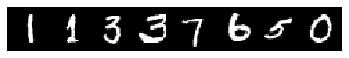

step 70848, loss 0.7809650897979736
Target:	 tensor([5, 5, 3, 8, 9, 2, 3, 2])
Pred:	 tensor([5, 1, 3, 8, 9, 2, 3, 1])


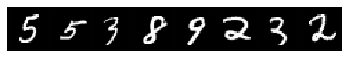

step 70898, loss 0.7617316842079163
Target:	 tensor([9, 0, 5, 3, 7, 7, 9, 5])
Pred:	 tensor([9, 0, 5, 3, 7, 7, 9, 5])


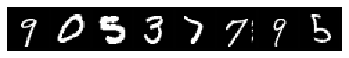

step 70948, loss 0.8197450637817383
Target:	 tensor([2, 8, 2, 9, 1, 6, 6, 2])
Pred:	 tensor([2, 8, 1, 1, 1, 6, 6, 2])


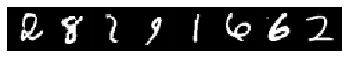

step 70998, loss 1.0669262409210205
Target:	 tensor([4, 9, 9, 9, 0, 4, 4, 6])
Pred:	 tensor([9, 9, 1, 9, 0, 4, 4, 1])


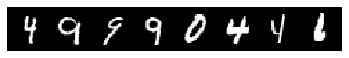

step 71048, loss 0.6629223823547363
Target:	 tensor([1, 3, 5, 6, 2, 5, 1, 4])
Pred:	 tensor([3, 3, 4, 6, 2, 5, 1, 4])


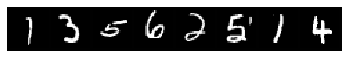

step 71098, loss 0.8074989914894104
Target:	 tensor([3, 3, 8, 9, 9, 9, 7, 9])
Pred:	 tensor([3, 3, 8, 9, 9, 7, 7, 9])


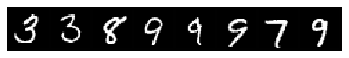

step 71148, loss 0.7486303448677063
Target:	 tensor([9, 1, 7, 2, 4, 9, 9, 3])
Pred:	 tensor([9, 1, 7, 2, 4, 9, 9, 3])


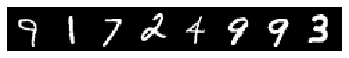

step 71198, loss 0.8033799529075623
Target:	 tensor([4, 7, 8, 5, 5, 4, 1, 2])
Pred:	 tensor([4, 7, 0, 5, 5, 4, 1, 3])


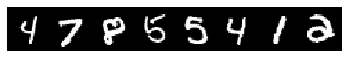

step 71248, loss 0.792716920375824
Target:	 tensor([6, 5, 8, 9, 9, 1, 9, 6])
Pred:	 tensor([6, 5, 8, 9, 9, 1, 9, 6])


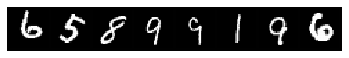

step 71298, loss 0.8725807666778564
Target:	 tensor([9, 3, 8, 9, 5, 7, 1, 0])
Pred:	 tensor([9, 3, 1, 5, 5, 7, 1, 0])


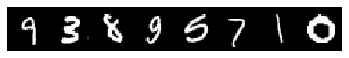

step 71348, loss 0.6542913317680359
Target:	 tensor([9, 5, 2, 9, 9, 7, 6, 2])
Pred:	 tensor([9, 5, 2, 9, 4, 7, 6, 2])


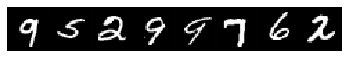

step 71398, loss 1.0852991342544556
Target:	 tensor([3, 5, 7, 3, 5, 7, 3, 5])
Pred:	 tensor([3, 5, 7, 6, 7, 7, 3, 5])


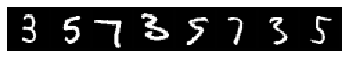

step 71448, loss 0.8701295256614685
Target:	 tensor([6, 7, 5, 9, 0, 5, 4, 1])
Pred:	 tensor([1, 7, 5, 9, 0, 5, 4, 1])


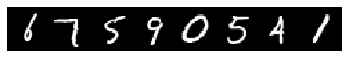

step 71498, loss 0.8024296760559082
Target:	 tensor([0, 9, 8, 3, 1, 4, 8, 1])
Pred:	 tensor([0, 9, 8, 3, 6, 4, 8, 1])


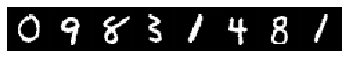

step 71548, loss 0.619356632232666
Target:	 tensor([7, 9, 6, 4, 1, 5, 0, 8])
Pred:	 tensor([7, 9, 6, 4, 1, 5, 0, 8])


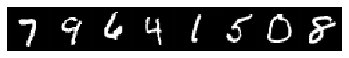

step 71598, loss 0.7733700275421143
Target:	 tensor([4, 5, 7, 1, 3, 0, 8, 8])
Pred:	 tensor([4, 5, 9, 1, 3, 0, 8, 8])


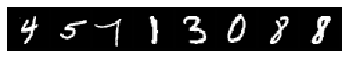

step 71648, loss 0.6708934903144836
Target:	 tensor([9, 6, 3, 1, 6, 4, 5, 9])
Pred:	 tensor([9, 6, 3, 1, 6, 4, 3, 9])


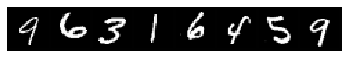

step 71698, loss 0.9206342101097107
Target:	 tensor([6, 6, 6, 2, 3, 0, 3, 5])
Pred:	 tensor([6, 6, 6, 2, 3, 0, 3, 5])


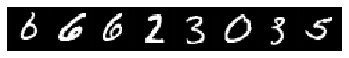

step 71748, loss 0.6584009528160095
Target:	 tensor([9, 4, 3, 1, 7, 5, 1, 4])
Pred:	 tensor([9, 4, 3, 1, 7, 8, 1, 4])


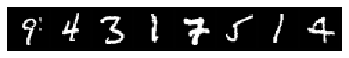

step 71798, loss 1.1580332517623901
Target:	 tensor([0, 1, 9, 8, 1, 8, 6, 1])
Pred:	 tensor([0, 8, 9, 8, 8, 3, 6, 1])


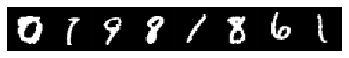

step 71848, loss 0.7812890410423279
Target:	 tensor([8, 1, 2, 1, 2, 3, 1, 1])
Pred:	 tensor([8, 1, 2, 1, 2, 9, 1, 1])


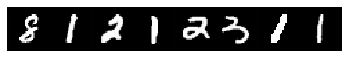

step 71898, loss 0.8042149543762207
Target:	 tensor([8, 8, 4, 4, 2, 7, 0, 7])
Pred:	 tensor([8, 8, 4, 4, 2, 7, 0, 7])


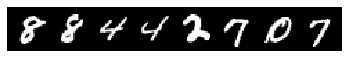

step 71948, loss 0.8992466926574707
Target:	 tensor([7, 2, 2, 5, 4, 7, 8, 7])
Pred:	 tensor([9, 2, 2, 5, 9, 7, 8, 7])


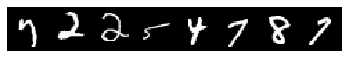

step 71998, loss 0.7697734832763672
Target:	 tensor([8, 7, 6, 6, 3, 6, 9, 1])
Pred:	 tensor([0, 7, 6, 6, 3, 6, 8, 1])


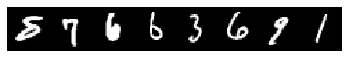

step 72048, loss 0.7981720566749573
Target:	 tensor([3, 6, 4, 8, 7, 1, 7, 3])
Pred:	 tensor([3, 6, 4, 3, 7, 1, 7, 3])


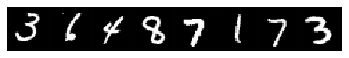

step 72098, loss 0.7822440266609192
Target:	 tensor([8, 4, 8, 8, 7, 1, 2, 3])
Pred:	 tensor([8, 4, 5, 1, 7, 1, 2, 3])


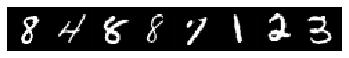

step 72148, loss 0.7147251963615417
Target:	 tensor([3, 1, 7, 2, 5, 4, 0, 0])
Pred:	 tensor([1, 1, 7, 2, 8, 4, 0, 0])


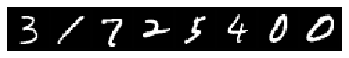

step 72198, loss 0.5907887816429138
Target:	 tensor([6, 0, 4, 6, 5, 2, 8, 2])
Pred:	 tensor([6, 0, 4, 6, 5, 2, 8, 2])


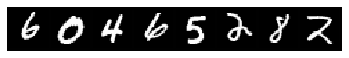

step 72239, loss 0.9298302531242371
Target:	 tensor([8, 6, 5, 9, 0, 2, 6, 0])
Pred:	 tensor([8, 6, 3, 9, 0, 2, 6, 0])


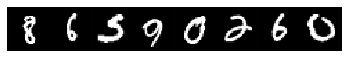

step 72289, loss 0.6491744518280029
Target:	 tensor([3, 0, 1, 3, 1, 7, 1, 9])
Pred:	 tensor([3, 0, 1, 3, 1, 7, 1, 9])


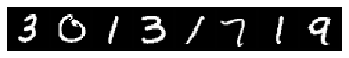

step 72339, loss 0.892061173915863
Target:	 tensor([7, 6, 7, 3, 7, 3, 4, 9])
Pred:	 tensor([9, 6, 7, 2, 9, 3, 4, 9])


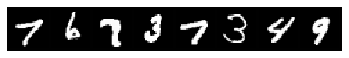

step 72389, loss 0.7175168991088867
Target:	 tensor([5, 1, 1, 6, 1, 3, 9, 9])
Pred:	 tensor([5, 8, 1, 6, 1, 3, 9, 9])


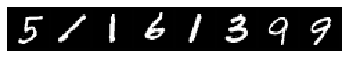

step 72439, loss 0.556445300579071
Target:	 tensor([0, 5, 6, 3, 7, 6, 0, 5])
Pred:	 tensor([0, 5, 6, 3, 7, 6, 0, 5])


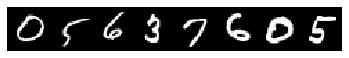

step 72489, loss 0.811133086681366
Target:	 tensor([6, 5, 0, 6, 3, 1, 1, 1])
Pred:	 tensor([6, 5, 0, 6, 3, 1, 1, 1])


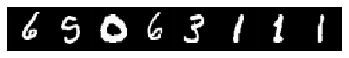

step 72539, loss 0.8996174335479736
Target:	 tensor([1, 6, 2, 9, 5, 5, 7, 0])
Pred:	 tensor([1, 6, 2, 9, 5, 5, 8, 0])


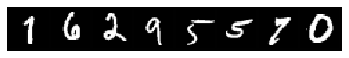

step 72589, loss 0.7773990631103516
Target:	 tensor([0, 8, 7, 1, 1, 8, 7, 5])
Pred:	 tensor([0, 8, 7, 1, 1, 8, 3, 5])


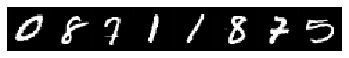

step 72639, loss 0.6242119669914246
Target:	 tensor([6, 0, 1, 0, 5, 6, 5, 6])
Pred:	 tensor([6, 0, 1, 0, 8, 6, 5, 6])


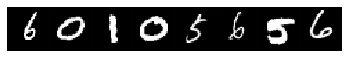

step 72689, loss 0.7713978290557861
Target:	 tensor([0, 2, 4, 3, 5, 2, 0, 9])
Pred:	 tensor([0, 2, 4, 3, 5, 2, 0, 9])


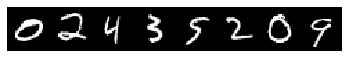

step 72739, loss 1.0128470659255981
Target:	 tensor([0, 3, 7, 0, 0, 0, 9, 4])
Pred:	 tensor([0, 3, 7, 0, 0, 0, 4, 4])


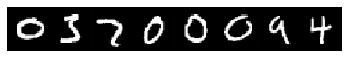

step 72789, loss 0.789458692073822
Target:	 tensor([4, 0, 7, 8, 0, 8, 7, 7])
Pred:	 tensor([4, 0, 7, 3, 0, 8, 7, 7])


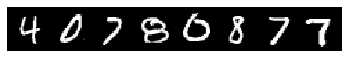

step 72839, loss 0.8275812268257141
Target:	 tensor([4, 6, 7, 0, 6, 7, 6, 7])
Pred:	 tensor([4, 6, 7, 0, 6, 7, 6, 7])


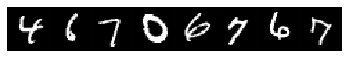

step 72889, loss 0.7438685894012451
Target:	 tensor([7, 7, 6, 2, 8, 7, 3, 1])
Pred:	 tensor([7, 7, 6, 2, 3, 1, 7, 1])


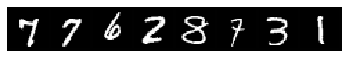

step 72939, loss 0.7287268042564392
Target:	 tensor([2, 0, 0, 7, 7, 4, 3, 0])
Pred:	 tensor([2, 0, 0, 7, 7, 4, 3, 0])


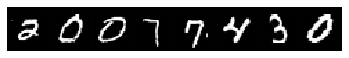

step 72989, loss 0.5505978465080261
Target:	 tensor([1, 7, 0, 3, 7, 6, 5, 6])
Pred:	 tensor([1, 7, 0, 3, 7, 6, 5, 6])


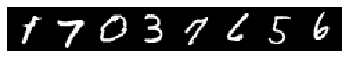

step 73039, loss 1.019060730934143
Target:	 tensor([1, 0, 8, 5, 4, 2, 0, 0])
Pred:	 tensor([1, 8, 8, 3, 4, 2, 0, 0])


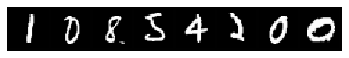

step 73089, loss 0.6618993282318115
Target:	 tensor([1, 7, 6, 4, 9, 5, 7, 1])
Pred:	 tensor([1, 7, 6, 4, 9, 5, 7, 1])


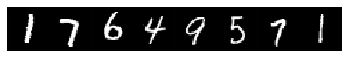

step 73139, loss 0.9634249806404114
Target:	 tensor([3, 5, 7, 2, 7, 4, 8, 5])
Pred:	 tensor([3, 5, 7, 2, 7, 4, 8, 6])


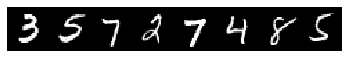

step 73189, loss 0.8738923072814941
Target:	 tensor([2, 1, 6, 1, 5, 4, 6, 8])
Pred:	 tensor([3, 1, 6, 1, 5, 4, 6, 6])


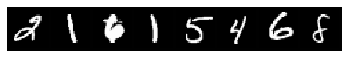

step 73239, loss 0.5931873917579651
Target:	 tensor([0, 0, 7, 3, 4, 1, 4, 6])
Pred:	 tensor([0, 0, 7, 3, 4, 1, 4, 6])


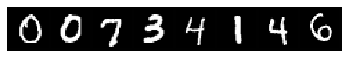

step 73289, loss 0.6755866408348083
Target:	 tensor([5, 0, 1, 0, 0, 7, 6, 7])
Pred:	 tensor([2, 0, 1, 0, 0, 7, 6, 7])


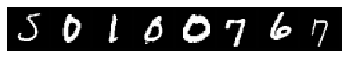

step 73339, loss 0.7180347442626953
Target:	 tensor([3, 4, 8, 8, 4, 9, 9, 3])
Pred:	 tensor([3, 4, 8, 1, 4, 9, 9, 3])


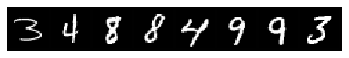

step 73389, loss 0.8520965576171875
Target:	 tensor([3, 6, 3, 1, 3, 7, 0, 8])
Pred:	 tensor([3, 6, 3, 1, 3, 7, 0, 3])


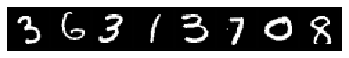

step 73439, loss 0.675770103931427
Target:	 tensor([8, 2, 9, 7, 0, 9, 3, 0])
Pred:	 tensor([0, 2, 4, 7, 0, 9, 3, 0])


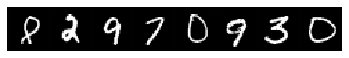

step 73489, loss 1.1390691995620728
Target:	 tensor([7, 5, 2, 2, 7, 0, 9, 1])
Pred:	 tensor([7, 5, 1, 2, 7, 0, 5, 1])


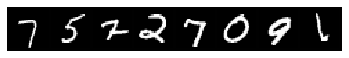

step 73539, loss 0.77177494764328
Target:	 tensor([3, 8, 7, 7, 7, 3, 1, 2])
Pred:	 tensor([3, 8, 7, 7, 7, 3, 1, 2])


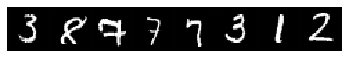

step 73589, loss 0.9683522582054138
Target:	 tensor([4, 0, 8, 1, 9, 3, 5, 9])
Pred:	 tensor([4, 0, 8, 1, 0, 3, 5, 9])


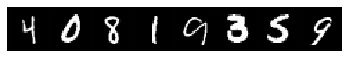

step 73639, loss 0.8025972843170166
Target:	 tensor([7, 8, 3, 5, 1, 1, 1, 9])
Pred:	 tensor([7, 8, 3, 5, 1, 1, 1, 9])


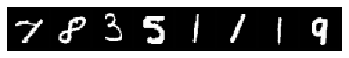

step 73689, loss 0.7879917621612549
Target:	 tensor([2, 9, 3, 7, 1, 1, 7, 3])
Pred:	 tensor([2, 7, 3, 7, 1, 1, 7, 7])


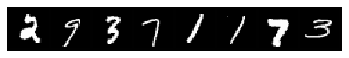

step 73739, loss 0.7181716561317444
Target:	 tensor([1, 4, 4, 5, 6, 9, 5, 3])
Pred:	 tensor([1, 9, 4, 5, 6, 9, 6, 3])


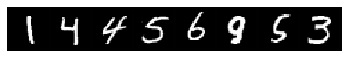

step 73789, loss 0.8014141917228699
Target:	 tensor([6, 2, 7, 1, 5, 9, 3, 2])
Pred:	 tensor([6, 2, 7, 1, 5, 9, 3, 2])


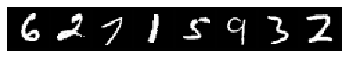

step 73839, loss 0.8887173533439636
Target:	 tensor([6, 5, 8, 9, 8, 4, 5, 2])
Pred:	 tensor([6, 5, 8, 9, 8, 4, 3, 2])


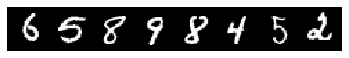

step 73889, loss 0.8188879489898682
Target:	 tensor([2, 1, 0, 6, 4, 0, 3, 1])
Pred:	 tensor([2, 1, 0, 6, 4, 0, 3, 1])


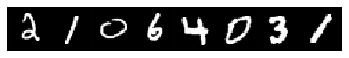

step 73939, loss 0.800109326839447
Target:	 tensor([9, 4, 7, 4, 5, 6, 9, 3])
Pred:	 tensor([9, 4, 7, 4, 1, 6, 9, 3])


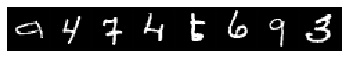

step 73989, loss 0.6659518480300903
Target:	 tensor([1, 7, 0, 5, 7, 8, 6, 3])
Pred:	 tensor([1, 7, 0, 5, 7, 5, 6, 3])


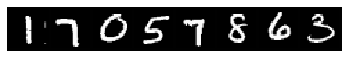

step 74039, loss 0.7792943120002747
Target:	 tensor([9, 8, 6, 8, 9, 9, 9, 1])
Pred:	 tensor([9, 6, 6, 5, 9, 9, 4, 1])


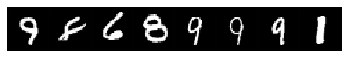

step 74089, loss 0.8013982772827148
Target:	 tensor([2, 7, 4, 7, 4, 9, 5, 1])
Pred:	 tensor([2, 7, 4, 3, 4, 7, 9, 1])


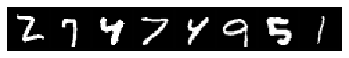

step 74139, loss 0.9797873497009277
Target:	 tensor([9, 3, 8, 7, 5, 6, 6, 4])
Pred:	 tensor([8, 2, 5, 7, 1, 6, 6, 4])


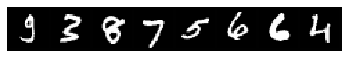

step 74189, loss 0.5653679966926575
Target:	 tensor([4, 2, 0, 1, 0, 6, 9, 9])
Pred:	 tensor([4, 2, 0, 1, 0, 6, 7, 5])


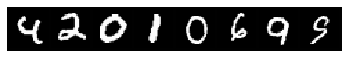

step 74239, loss 0.6384223699569702
Target:	 tensor([0, 9, 6, 1, 4, 6, 0, 9])
Pred:	 tensor([0, 9, 6, 1, 4, 6, 0, 9])


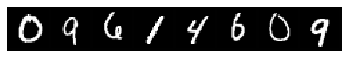

step 74289, loss 0.8110455870628357
Target:	 tensor([6, 5, 9, 4, 4, 6, 6, 7])
Pred:	 tensor([6, 5, 4, 4, 4, 6, 6, 7])


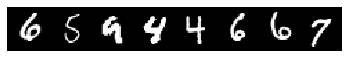

step 74339, loss 0.5289461016654968
Target:	 tensor([5, 7, 0, 8, 5, 9, 9, 6])
Pred:	 tensor([5, 7, 0, 8, 5, 9, 9, 6])


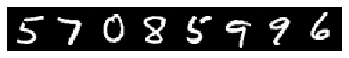

step 74389, loss 0.6996791362762451
Target:	 tensor([9, 6, 0, 8, 0, 4, 6, 0])
Pred:	 tensor([0, 6, 0, 4, 0, 4, 6, 0])


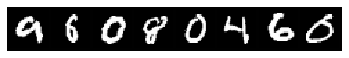

step 74439, loss 0.7502119541168213
Target:	 tensor([8, 6, 3, 2, 7, 4, 8, 5])
Pred:	 tensor([5, 6, 3, 2, 7, 4, 8, 5])


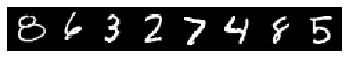

step 74489, loss 0.72135990858078
Target:	 tensor([9, 7, 8, 4, 1, 1, 0, 6])
Pred:	 tensor([9, 7, 8, 4, 1, 1, 0, 6])


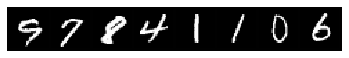

step 74539, loss 0.758830726146698
Target:	 tensor([1, 9, 2, 7, 5, 7, 2, 4])
Pred:	 tensor([1, 9, 2, 7, 5, 7, 2, 4])


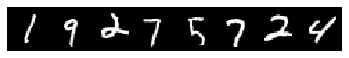

step 74589, loss 0.5546191334724426
Target:	 tensor([3, 7, 9, 0, 2, 8, 6, 6])
Pred:	 tensor([3, 9, 9, 0, 2, 3, 6, 6])


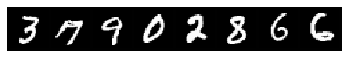

step 74639, loss 0.8278757929801941
Target:	 tensor([8, 7, 9, 6, 3, 1, 2, 6])
Pred:	 tensor([5, 7, 7, 6, 0, 1, 0, 6])


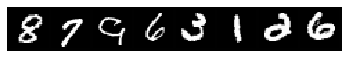

step 74689, loss 0.9473286271095276
Target:	 tensor([4, 1, 2, 1, 7, 8, 4, 9])
Pred:	 tensor([4, 1, 2, 1, 7, 5, 4, 9])


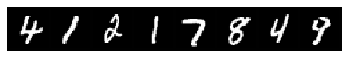

step 74730, loss 0.7360633015632629
Target:	 tensor([9, 0, 1, 2, 6, 9, 5, 2])
Pred:	 tensor([9, 0, 1, 0, 6, 4, 5, 2])


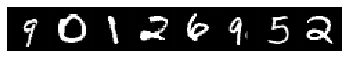

step 74780, loss 0.6791642308235168
Target:	 tensor([1, 5, 1, 4, 5, 2, 9, 8])
Pred:	 tensor([1, 5, 1, 4, 5, 2, 9, 8])


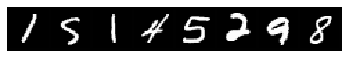

step 74830, loss 0.571721613407135
Target:	 tensor([2, 1, 4, 0, 9, 4, 0, 1])
Pred:	 tensor([2, 1, 4, 0, 4, 4, 0, 1])


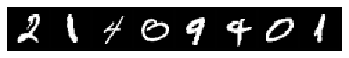

step 74880, loss 0.668804943561554
Target:	 tensor([2, 3, 3, 7, 7, 0, 3, 8])
Pred:	 tensor([2, 1, 3, 7, 7, 0, 3, 1])


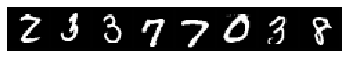

step 74930, loss 0.8886638283729553
Target:	 tensor([0, 1, 1, 1, 4, 0, 5, 5])
Pred:	 tensor([0, 1, 1, 1, 9, 0, 5, 0])


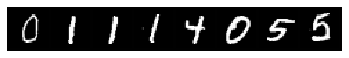

step 74980, loss 0.7160807251930237
Target:	 tensor([1, 8, 2, 4, 8, 1, 4, 0])
Pred:	 tensor([1, 3, 2, 4, 8, 1, 4, 0])


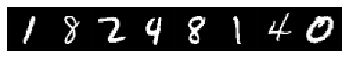

step 75030, loss 0.7791215777397156
Target:	 tensor([2, 3, 9, 1, 7, 4, 1, 9])
Pred:	 tensor([2, 3, 9, 1, 7, 4, 1, 9])


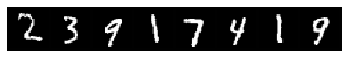

step 75080, loss 0.6802825927734375
Target:	 tensor([4, 6, 4, 4, 1, 7, 0, 0])
Pred:	 tensor([4, 2, 6, 4, 1, 7, 0, 0])


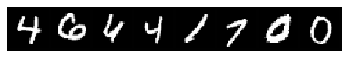

step 75130, loss 0.6322473883628845
Target:	 tensor([2, 0, 1, 3, 2, 7, 5, 8])
Pred:	 tensor([2, 0, 1, 3, 2, 7, 1, 8])


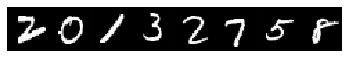

step 75180, loss 0.7762319445610046
Target:	 tensor([6, 8, 5, 2, 0, 2, 8, 0])
Pred:	 tensor([6, 8, 5, 2, 0, 2, 1, 0])


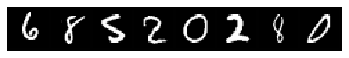

step 75230, loss 0.8959936499595642
Target:	 tensor([8, 0, 1, 3, 6, 9, 3, 2])
Pred:	 tensor([8, 0, 1, 3, 6, 9, 3, 8])


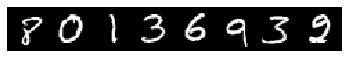

step 75280, loss 0.8305565714836121
Target:	 tensor([4, 4, 8, 6, 7, 1, 6, 8])
Pred:	 tensor([4, 4, 3, 6, 7, 3, 6, 8])


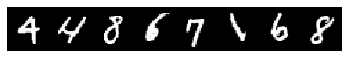

step 75330, loss 0.8090763688087463
Target:	 tensor([2, 8, 8, 8, 7, 6, 4, 5])
Pred:	 tensor([2, 3, 3, 8, 7, 1, 4, 5])


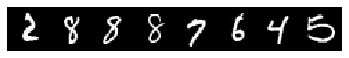

step 75380, loss 0.9575197696685791
Target:	 tensor([8, 0, 4, 5, 3, 5, 6, 2])
Pred:	 tensor([5, 0, 4, 0, 3, 5, 6, 2])


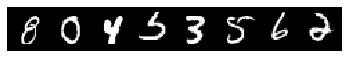

step 75430, loss 0.713340699672699
Target:	 tensor([3, 8, 6, 2, 5, 7, 0, 7])
Pred:	 tensor([0, 8, 6, 2, 3, 2, 0, 7])


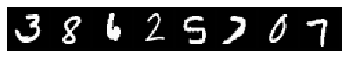

step 75480, loss 1.2124789953231812
Target:	 tensor([4, 9, 7, 9, 0, 7, 6, 2])
Pred:	 tensor([4, 0, 7, 2, 0, 9, 6, 2])


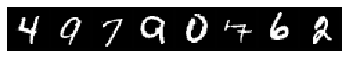

step 75530, loss 0.5836269855499268
Target:	 tensor([4, 3, 6, 7, 7, 1, 1, 0])
Pred:	 tensor([4, 3, 6, 7, 7, 1, 1, 0])


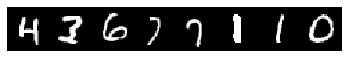

step 75580, loss 0.7244217395782471
Target:	 tensor([0, 5, 3, 6, 2, 0, 7, 2])
Pred:	 tensor([0, 5, 3, 6, 2, 0, 7, 2])


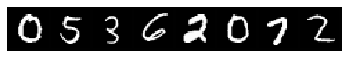

step 75630, loss 0.8848169445991516
Target:	 tensor([2, 9, 7, 5, 0, 2, 5, 8])
Pred:	 tensor([2, 9, 7, 5, 0, 2, 5, 9])


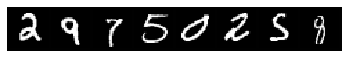

step 75680, loss 0.7333436012268066
Target:	 tensor([8, 9, 6, 4, 2, 4, 1, 8])
Pred:	 tensor([8, 4, 6, 4, 2, 4, 8, 5])


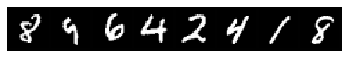

step 75730, loss 0.5843626856803894
Target:	 tensor([6, 8, 6, 2, 2, 2, 8, 9])
Pred:	 tensor([6, 8, 6, 2, 2, 2, 1, 9])


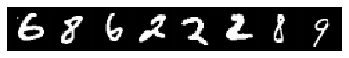

step 75780, loss 0.7623286843299866
Target:	 tensor([6, 2, 9, 4, 6, 9, 9, 9])
Pred:	 tensor([6, 2, 9, 4, 6, 9, 9, 9])


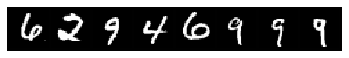

step 75830, loss 0.6529579758644104
Target:	 tensor([3, 4, 6, 6, 8, 7, 3, 2])
Pred:	 tensor([1, 4, 6, 6, 8, 7, 3, 2])


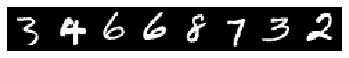

step 75880, loss 0.9590551853179932
Target:	 tensor([2, 3, 2, 3, 7, 5, 4, 8])
Pred:	 tensor([2, 5, 2, 3, 7, 5, 4, 8])


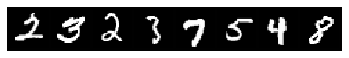

step 75930, loss 0.8413769602775574
Target:	 tensor([2, 2, 2, 9, 7, 2, 2, 3])
Pred:	 tensor([0, 2, 2, 4, 7, 2, 2, 7])


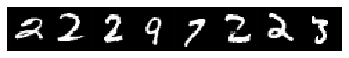

step 75980, loss 0.5749954581260681
Target:	 tensor([4, 7, 6, 7, 1, 2, 6, 1])
Pred:	 tensor([4, 7, 1, 7, 1, 2, 6, 1])


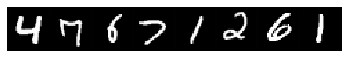

step 76030, loss 0.7790942788124084
Target:	 tensor([0, 4, 0, 6, 6, 1, 9, 1])
Pred:	 tensor([6, 4, 0, 6, 6, 1, 7, 1])


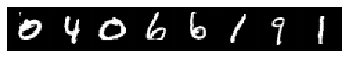

step 76080, loss 0.9112096428871155
Target:	 tensor([4, 0, 0, 3, 7, 2, 0, 0])
Pred:	 tensor([4, 0, 0, 3, 1, 2, 0, 0])


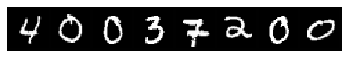

step 76130, loss 0.5532691478729248
Target:	 tensor([6, 0, 1, 8, 0, 4, 4, 1])
Pred:	 tensor([6, 7, 1, 8, 0, 4, 4, 1])


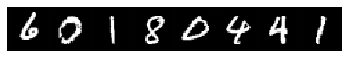

step 76180, loss 0.5420928597450256
Target:	 tensor([4, 8, 7, 2, 6, 5, 2, 4])
Pred:	 tensor([4, 1, 7, 2, 6, 5, 2, 4])


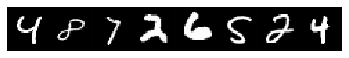

step 76230, loss 0.7592132091522217
Target:	 tensor([8, 0, 5, 4, 6, 3, 5, 6])
Pred:	 tensor([8, 0, 5, 4, 5, 3, 4, 6])


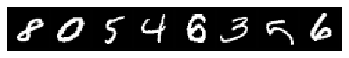

step 76280, loss 0.8326849937438965
Target:	 tensor([1, 9, 6, 3, 6, 2, 3, 8])
Pred:	 tensor([1, 9, 1, 3, 6, 2, 3, 3])


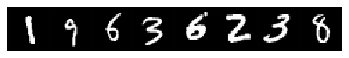

step 76330, loss 0.656622588634491
Target:	 tensor([3, 1, 4, 2, 9, 7, 6, 4])
Pred:	 tensor([3, 2, 4, 2, 9, 7, 6, 4])


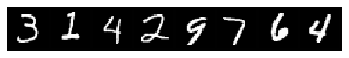

step 76380, loss 0.7783510088920593
Target:	 tensor([7, 1, 7, 7, 4, 5, 2, 8])
Pred:	 tensor([7, 1, 7, 7, 4, 5, 2, 7])


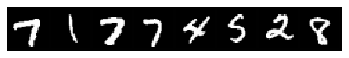

step 76430, loss 0.6818816065788269
Target:	 tensor([7, 3, 4, 4, 6, 6, 2, 9])
Pred:	 tensor([7, 7, 4, 4, 6, 6, 2, 9])


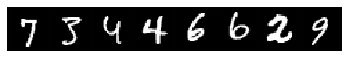

step 76480, loss 0.7185995578765869
Target:	 tensor([3, 7, 9, 9, 6, 1, 5, 9])
Pred:	 tensor([5, 7, 9, 9, 6, 1, 5, 9])


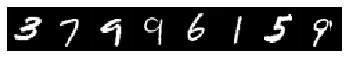

step 76530, loss 0.9172911047935486
Target:	 tensor([2, 8, 4, 1, 0, 8, 1, 8])
Pred:	 tensor([2, 3, 4, 1, 0, 1, 1, 8])


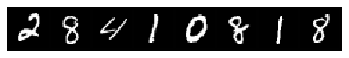

step 76580, loss 0.6701464653015137
Target:	 tensor([4, 4, 5, 4, 3, 5, 5, 7])
Pred:	 tensor([4, 4, 3, 4, 3, 5, 9, 7])


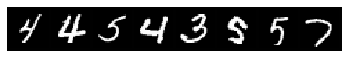

step 76630, loss 0.7663919925689697
Target:	 tensor([6, 2, 1, 7, 1, 2, 3, 1])
Pred:	 tensor([6, 4, 1, 7, 1, 2, 3, 1])


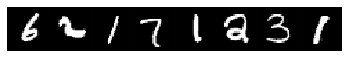

step 76680, loss 1.0008379220962524
Target:	 tensor([4, 5, 0, 7, 3, 7, 9, 0])
Pred:	 tensor([4, 5, 0, 7, 3, 7, 4, 0])


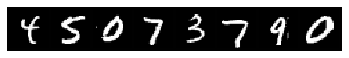

step 76730, loss 0.7926639914512634
Target:	 tensor([8, 7, 6, 4, 3, 1, 8, 8])
Pred:	 tensor([5, 7, 6, 4, 3, 1, 8, 8])


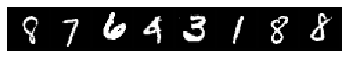

step 76780, loss 0.7805363535881042
Target:	 tensor([3, 8, 5, 7, 6, 1, 9, 6])
Pred:	 tensor([8, 1, 5, 7, 4, 1, 9, 6])


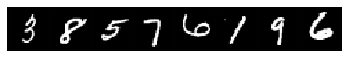

step 76830, loss 0.7891505360603333
Target:	 tensor([1, 0, 6, 0, 6, 8, 5, 0])
Pred:	 tensor([1, 0, 6, 0, 6, 1, 5, 0])


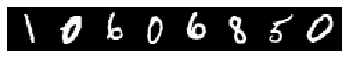

step 76880, loss 0.7216147780418396
Target:	 tensor([7, 9, 3, 5, 2, 2, 2, 9])
Pred:	 tensor([7, 9, 3, 5, 2, 2, 2, 9])


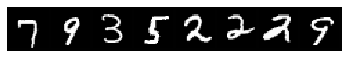

step 76930, loss 0.627301812171936
Target:	 tensor([1, 8, 7, 9, 0, 3, 4, 5])
Pred:	 tensor([1, 5, 7, 9, 0, 3, 4, 5])


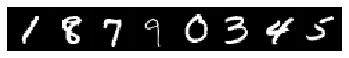

step 76980, loss 0.9068116545677185
Target:	 tensor([8, 5, 8, 7, 5, 0, 6, 8])
Pred:	 tensor([5, 5, 8, 7, 5, 0, 6, 8])


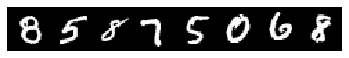

step 77030, loss 0.8183975219726562
Target:	 tensor([8, 2, 7, 4, 6, 3, 8, 1])
Pred:	 tensor([3, 2, 7, 4, 5, 3, 0, 1])


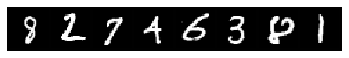

step 77080, loss 0.806252658367157
Target:	 tensor([6, 0, 9, 5, 8, 9, 6, 5])
Pred:	 tensor([6, 0, 9, 5, 3, 9, 6, 5])


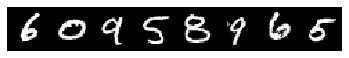

step 77130, loss 0.6470717787742615
Target:	 tensor([9, 3, 5, 1, 6, 3, 7, 0])
Pred:	 tensor([9, 3, 8, 1, 6, 3, 7, 0])


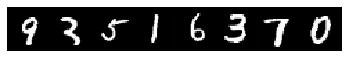

step 77180, loss 0.7242498993873596
Target:	 tensor([2, 5, 1, 6, 2, 7, 2, 5])
Pred:	 tensor([2, 5, 1, 6, 2, 7, 2, 5])


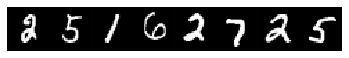

step 77221, loss 0.767512857913971
Target:	 tensor([4, 2, 2, 6, 0, 7, 6, 8])
Pred:	 tensor([4, 2, 2, 2, 3, 7, 5, 8])


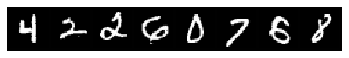

step 77271, loss 0.7449042797088623
Target:	 tensor([7, 7, 0, 1, 1, 7, 5, 6])
Pred:	 tensor([7, 7, 0, 1, 1, 7, 8, 6])


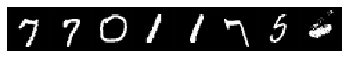

step 77321, loss 0.7904160022735596
Target:	 tensor([7, 7, 3, 0, 7, 0, 4, 0])
Pred:	 tensor([7, 7, 3, 7, 7, 0, 4, 0])


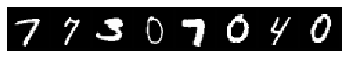

step 77371, loss 0.933584451675415
Target:	 tensor([7, 4, 2, 4, 3, 1, 4, 2])
Pred:	 tensor([7, 4, 2, 4, 3, 2, 4, 2])


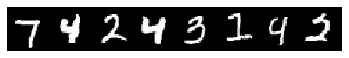

step 77421, loss 0.9326245188713074
Target:	 tensor([1, 4, 2, 4, 1, 8, 8, 0])
Pred:	 tensor([1, 4, 7, 4, 1, 8, 8, 0])


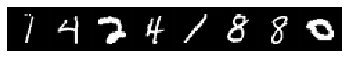

step 77471, loss 0.8597638010978699
Target:	 tensor([8, 0, 0, 3, 1, 4, 1, 6])
Pred:	 tensor([1, 0, 0, 3, 1, 4, 1, 6])


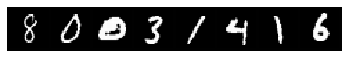

step 77521, loss 0.6242943406105042
Target:	 tensor([7, 8, 2, 6, 7, 4, 6, 4])
Pred:	 tensor([7, 8, 7, 6, 9, 4, 6, 4])


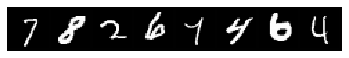

step 77571, loss 0.7067103385925293
Target:	 tensor([7, 0, 1, 8, 8, 1, 5, 5])
Pred:	 tensor([7, 0, 1, 5, 8, 1, 5, 5])


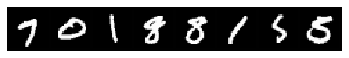

step 77621, loss 0.9007790088653564
Target:	 tensor([9, 8, 5, 5, 5, 6, 8, 6])
Pred:	 tensor([9, 3, 5, 5, 6, 6, 8, 6])


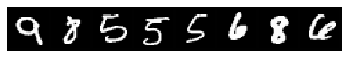

step 77671, loss 1.0019017457962036
Target:	 tensor([5, 3, 3, 9, 5, 9, 7, 1])
Pred:	 tensor([5, 3, 3, 9, 5, 9, 7, 1])


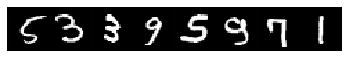

step 77721, loss 0.9838311076164246
Target:	 tensor([2, 8, 8, 4, 8, 8, 3, 6])
Pred:	 tensor([2, 1, 8, 4, 5, 5, 1, 6])


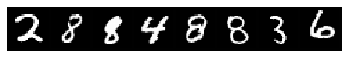

step 77771, loss 0.7731660008430481
Target:	 tensor([6, 4, 0, 2, 2, 3, 3, 4])
Pred:	 tensor([6, 4, 0, 2, 2, 3, 3, 6])


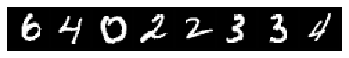

step 77821, loss 0.7527382373809814
Target:	 tensor([7, 9, 0, 4, 6, 8, 3, 1])
Pred:	 tensor([7, 9, 0, 4, 6, 1, 3, 1])


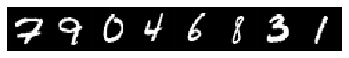

step 77871, loss 0.5791125893592834
Target:	 tensor([4, 6, 7, 6, 2, 5, 7, 9])
Pred:	 tensor([4, 6, 7, 6, 2, 5, 7, 9])


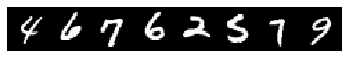

step 77921, loss 0.9051780700683594
Target:	 tensor([3, 6, 9, 7, 3, 6, 7, 4])
Pred:	 tensor([3, 5, 4, 7, 3, 6, 3, 9])


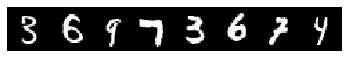

step 77971, loss 0.8248493075370789
Target:	 tensor([4, 3, 2, 4, 3, 9, 1, 4])
Pred:	 tensor([4, 3, 2, 9, 9, 9, 1, 4])


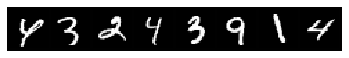

step 78021, loss 0.9015257358551025
Target:	 tensor([7, 2, 5, 8, 7, 3, 4, 2])
Pred:	 tensor([7, 2, 5, 5, 7, 3, 4, 2])


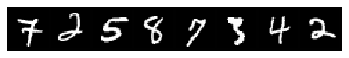

step 78071, loss 1.1567803621292114
Target:	 tensor([9, 4, 8, 9, 8, 3, 3, 5])
Pred:	 tensor([9, 4, 8, 4, 1, 3, 1, 8])


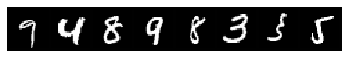

step 78121, loss 0.9606178402900696
Target:	 tensor([2, 1, 9, 6, 2, 8, 9, 7])
Pred:	 tensor([2, 1, 9, 6, 2, 8, 9, 7])


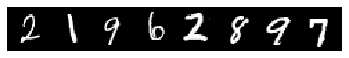

step 78171, loss 0.8242957592010498
Target:	 tensor([0, 1, 6, 8, 9, 0, 3, 4])
Pred:	 tensor([0, 1, 6, 8, 9, 0, 8, 4])


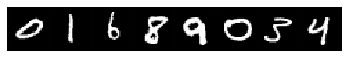

step 78221, loss 0.7614689469337463
Target:	 tensor([5, 8, 0, 3, 5, 1, 7, 7])
Pred:	 tensor([6, 8, 0, 3, 5, 1, 7, 7])


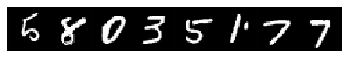

step 78271, loss 0.6988137364387512
Target:	 tensor([9, 9, 9, 7, 5, 2, 6, 0])
Pred:	 tensor([9, 4, 9, 7, 5, 2, 6, 0])


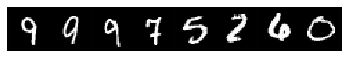

step 78321, loss 0.761141836643219
Target:	 tensor([9, 0, 1, 8, 6, 8, 9, 2])
Pred:	 tensor([9, 0, 1, 8, 6, 3, 9, 2])


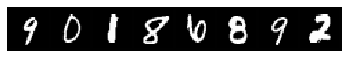

step 78371, loss 0.7450636029243469
Target:	 tensor([0, 3, 7, 6, 8, 9, 6, 5])
Pred:	 tensor([0, 3, 7, 4, 1, 9, 8, 5])


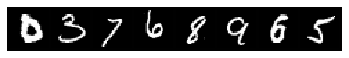

step 78421, loss 0.7727357745170593
Target:	 tensor([8, 1, 6, 2, 7, 9, 1, 0])
Pred:	 tensor([6, 1, 6, 2, 7, 9, 1, 0])


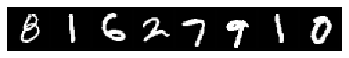

step 78471, loss 0.7684438228607178
Target:	 tensor([7, 1, 1, 9, 2, 4, 3, 3])
Pred:	 tensor([7, 1, 1, 4, 2, 4, 3, 3])


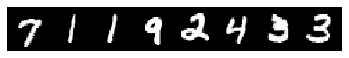

step 78521, loss 0.9260175228118896
Target:	 tensor([8, 1, 4, 9, 1, 4, 5, 0])
Pred:	 tensor([8, 1, 6, 9, 1, 4, 5, 0])


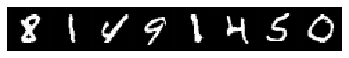

step 78571, loss 0.6270297765731812
Target:	 tensor([7, 7, 4, 3, 7, 4, 0, 1])
Pred:	 tensor([7, 7, 4, 3, 9, 4, 0, 1])


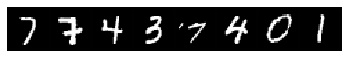

step 78621, loss 1.0081753730773926
Target:	 tensor([3, 3, 5, 6, 7, 4, 8, 3])
Pred:	 tensor([3, 3, 5, 6, 7, 4, 1, 3])


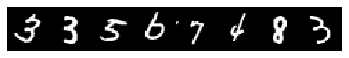

step 78671, loss 0.9869223237037659
Target:	 tensor([7, 9, 0, 7, 9, 4, 6, 8])
Pred:	 tensor([5, 9, 0, 7, 9, 4, 6, 1])


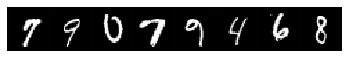

step 78721, loss 0.9365164637565613
Target:	 tensor([6, 8, 0, 6, 1, 4, 8, 6])
Pred:	 tensor([6, 8, 0, 6, 1, 9, 5, 6])


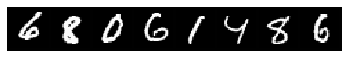

step 78771, loss 0.9401698708534241
Target:	 tensor([1, 1, 7, 6, 5, 7, 3, 3])
Pred:	 tensor([1, 8, 9, 6, 5, 9, 3, 3])


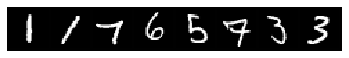

step 78821, loss 0.7020960450172424
Target:	 tensor([2, 6, 1, 4, 6, 9, 0, 1])
Pred:	 tensor([2, 6, 1, 9, 6, 9, 0, 1])


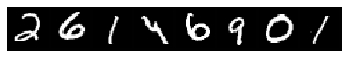

step 78871, loss 0.5638394951820374
Target:	 tensor([1, 9, 2, 8, 6, 1, 2, 4])
Pred:	 tensor([1, 9, 1, 8, 6, 1, 2, 4])


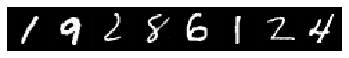

step 78921, loss 0.8723182678222656
Target:	 tensor([0, 3, 6, 2, 3, 9, 3, 0])
Pred:	 tensor([0, 5, 1, 2, 3, 7, 3, 0])


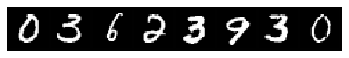

step 78971, loss 0.620944619178772
Target:	 tensor([8, 9, 9, 7, 4, 7, 8, 3])
Pred:	 tensor([3, 9, 9, 5, 4, 7, 8, 3])


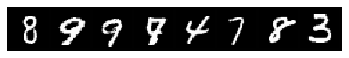

step 79021, loss 0.6395938992500305
Target:	 tensor([7, 5, 1, 3, 2, 7, 3, 6])
Pred:	 tensor([7, 5, 1, 3, 2, 7, 0, 6])


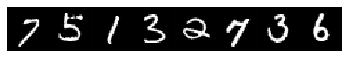

step 79071, loss 0.8599223494529724
Target:	 tensor([5, 7, 0, 6, 9, 7, 1, 5])
Pred:	 tensor([5, 7, 0, 6, 7, 9, 1, 3])


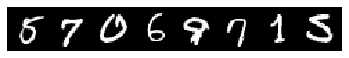

step 79121, loss 0.6464043259620667
Target:	 tensor([3, 2, 8, 0, 5, 1, 3, 0])
Pred:	 tensor([3, 1, 5, 0, 5, 1, 3, 0])


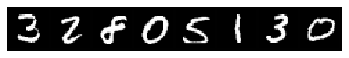

step 79171, loss 0.7032492160797119
Target:	 tensor([1, 7, 9, 0, 0, 6, 6, 7])
Pred:	 tensor([1, 9, 9, 0, 0, 6, 6, 7])


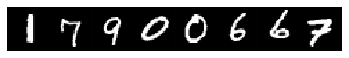

step 79221, loss 0.7500651478767395
Target:	 tensor([1, 0, 6, 9, 6, 7, 6, 8])
Pred:	 tensor([1, 0, 6, 7, 6, 9, 6, 3])


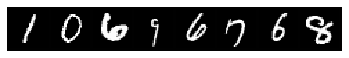

step 79271, loss 0.887476921081543
Target:	 tensor([9, 2, 6, 7, 2, 3, 2, 9])
Pred:	 tensor([9, 2, 6, 7, 2, 3, 2, 9])


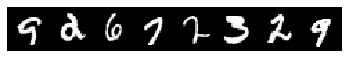

step 79321, loss 0.9149095416069031
Target:	 tensor([6, 6, 1, 9, 3, 1, 5, 2])
Pred:	 tensor([6, 6, 1, 9, 3, 2, 5, 2])


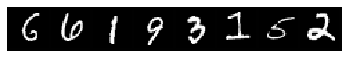

step 79371, loss 0.8748745322227478
Target:	 tensor([6, 2, 7, 7, 2, 6, 2, 2])
Pred:	 tensor([6, 8, 7, 7, 2, 6, 2, 2])


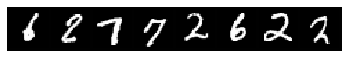

step 79421, loss 0.8657658100128174
Target:	 tensor([1, 2, 0, 9, 7, 8, 7, 3])
Pred:	 tensor([1, 2, 0, 9, 1, 5, 7, 3])


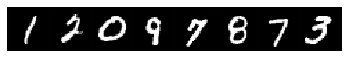

step 79471, loss 0.8649711012840271
Target:	 tensor([1, 7, 2, 6, 6, 3, 1, 6])
Pred:	 tensor([1, 7, 2, 6, 6, 3, 1, 6])


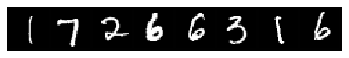

step 79521, loss 0.6637685894966125
Target:	 tensor([3, 9, 5, 5, 5, 1, 1, 7])
Pred:	 tensor([3, 9, 3, 5, 5, 1, 1, 9])


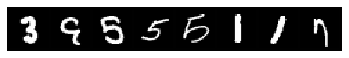

step 79571, loss 0.8985440731048584
Target:	 tensor([6, 6, 2, 9, 1, 6, 3, 7])
Pred:	 tensor([6, 6, 2, 9, 1, 6, 3, 7])


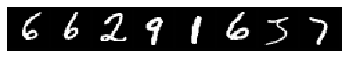

step 79621, loss 1.1260185241699219
Target:	 tensor([5, 8, 9, 2, 6, 8, 5, 8])
Pred:	 tensor([5, 8, 9, 2, 6, 8, 3, 8])


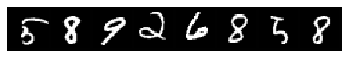

step 79671, loss 0.8795602321624756
Target:	 tensor([8, 7, 9, 5, 5, 6, 4, 9])
Pred:	 tensor([8, 7, 9, 5, 5, 6, 4, 7])


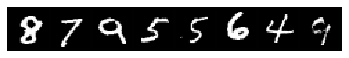

step 79712, loss 1.0258816480636597
Target:	 tensor([3, 0, 8, 7, 3, 8, 8, 1])
Pred:	 tensor([1, 8, 3, 7, 3, 8, 8, 1])


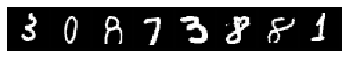

step 79762, loss 0.946310818195343
Target:	 tensor([4, 8, 6, 3, 0, 0, 6, 8])
Pred:	 tensor([6, 5, 6, 3, 0, 0, 6, 8])


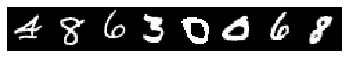

step 79812, loss 0.9482269883155823
Target:	 tensor([9, 4, 1, 6, 3, 7, 3, 5])
Pred:	 tensor([9, 4, 1, 6, 3, 7, 3, 5])


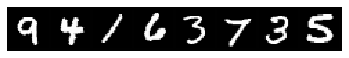

step 79862, loss 0.6114675998687744
Target:	 tensor([9, 4, 2, 1, 3, 2, 6, 5])
Pred:	 tensor([9, 4, 2, 1, 8, 1, 6, 5])


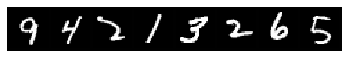

step 79912, loss 0.8220398426055908
Target:	 tensor([9, 9, 2, 0, 8, 9, 9, 9])
Pred:	 tensor([5, 9, 2, 0, 5, 4, 9, 9])


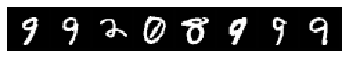

step 79962, loss 0.6995996832847595
Target:	 tensor([8, 1, 3, 3, 7, 9, 8, 3])
Pred:	 tensor([1, 1, 2, 3, 7, 7, 3, 3])


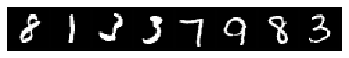

step 80012, loss 0.8389482498168945
Target:	 tensor([3, 8, 7, 1, 4, 9, 4, 1])
Pred:	 tensor([3, 8, 7, 1, 4, 9, 9, 1])


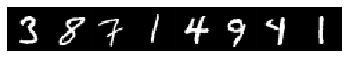

step 80062, loss 0.776012122631073
Target:	 tensor([8, 5, 2, 8, 1, 5, 4, 7])
Pred:	 tensor([8, 5, 2, 1, 8, 5, 4, 7])


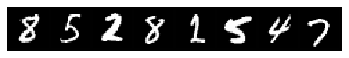

step 80112, loss 0.7555208206176758
Target:	 tensor([8, 6, 1, 2, 8, 6, 4, 1])
Pred:	 tensor([8, 6, 1, 2, 9, 2, 4, 1])


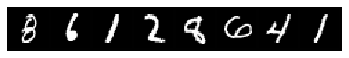

step 80162, loss 0.6272468566894531
Target:	 tensor([5, 4, 0, 8, 7, 1, 9, 1])
Pred:	 tensor([5, 4, 0, 8, 7, 1, 9, 1])


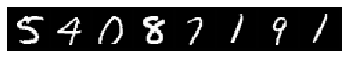

step 80212, loss 0.9180194735527039
Target:	 tensor([4, 1, 0, 4, 2, 8, 4, 2])
Pred:	 tensor([4, 1, 0, 4, 6, 0, 4, 2])


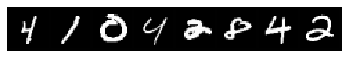

step 80262, loss 0.634722113609314
Target:	 tensor([7, 6, 7, 0, 0, 6, 8, 9])
Pred:	 tensor([7, 6, 7, 0, 0, 6, 8, 7])


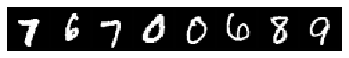

step 80312, loss 0.8453717827796936
Target:	 tensor([4, 6, 3, 8, 2, 9, 5, 6])
Pred:	 tensor([4, 4, 9, 8, 2, 9, 5, 6])


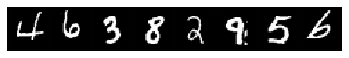

step 80362, loss 0.9038729071617126
Target:	 tensor([8, 7, 4, 2, 7, 2, 2, 0])
Pred:	 tensor([8, 7, 4, 2, 9, 1, 2, 0])


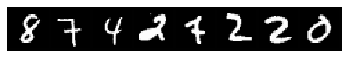

step 80412, loss 0.687166690826416
Target:	 tensor([7, 6, 3, 1, 3, 9, 7, 5])
Pred:	 tensor([7, 6, 3, 1, 9, 9, 7, 5])


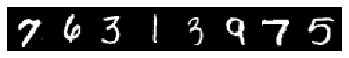

step 80462, loss 0.49399372935295105
Target:	 tensor([7, 5, 7, 7, 1, 0, 9, 4])
Pred:	 tensor([7, 5, 7, 7, 1, 0, 9, 9])


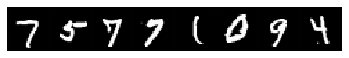

step 80512, loss 1.080797553062439
Target:	 tensor([7, 8, 9, 8, 1, 0, 2, 6])
Pred:	 tensor([7, 8, 9, 8, 1, 0, 0, 6])


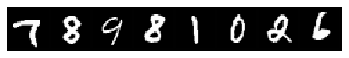

step 80562, loss 0.8144066333770752
Target:	 tensor([0, 3, 8, 8, 8, 6, 9, 4])
Pred:	 tensor([3, 3, 5, 8, 8, 5, 4, 4])


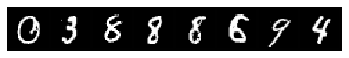

step 80612, loss 0.5433235168457031
Target:	 tensor([0, 3, 1, 4, 0, 3, 7, 6])
Pred:	 tensor([0, 3, 1, 4, 0, 3, 7, 6])


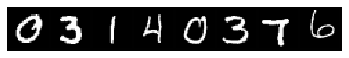

step 80662, loss 0.7746773362159729
Target:	 tensor([5, 4, 4, 2, 9, 3, 3, 1])
Pred:	 tensor([5, 4, 4, 2, 9, 3, 3, 1])


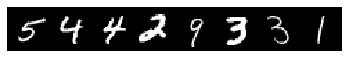

step 80712, loss 0.5667142868041992
Target:	 tensor([3, 6, 9, 9, 9, 7, 0, 0])
Pred:	 tensor([2, 6, 9, 4, 4, 7, 0, 0])


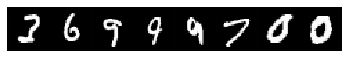

step 80762, loss 0.9442358016967773
Target:	 tensor([4, 2, 9, 4, 7, 7, 9, 9])
Pred:	 tensor([4, 0, 9, 4, 7, 7, 9, 4])


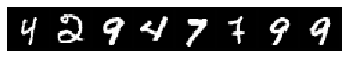

step 80812, loss 0.6701428294181824
Target:	 tensor([6, 0, 5, 4, 2, 1, 6, 6])
Pred:	 tensor([6, 0, 0, 4, 2, 1, 6, 6])


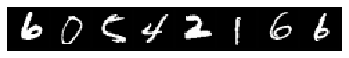

step 80862, loss 0.8051239848136902
Target:	 tensor([0, 8, 7, 8, 5, 1, 5, 1])
Pred:	 tensor([0, 1, 7, 8, 8, 1, 8, 1])


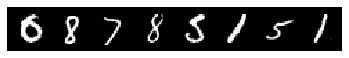

step 80912, loss 0.8191146850585938
Target:	 tensor([7, 1, 7, 3, 7, 2, 5, 6])
Pred:	 tensor([7, 1, 7, 7, 7, 2, 9, 6])


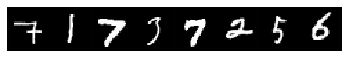

step 80962, loss 0.9041235446929932
Target:	 tensor([9, 1, 6, 8, 5, 9, 8, 7])
Pred:	 tensor([9, 1, 6, 8, 5, 9, 8, 7])


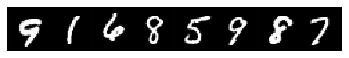

step 81012, loss 0.8037569522857666
Target:	 tensor([9, 4, 1, 7, 9, 2, 5, 2])
Pred:	 tensor([9, 4, 1, 7, 5, 2, 5, 2])


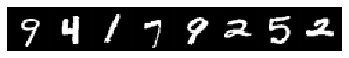

step 81062, loss 0.5949992537498474
Target:	 tensor([2, 0, 8, 0, 5, 9, 7, 3])
Pred:	 tensor([2, 0, 8, 0, 3, 9, 7, 3])


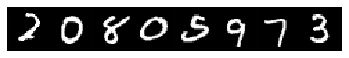

step 81112, loss 0.6992108821868896
Target:	 tensor([1, 0, 0, 8, 7, 3, 4, 5])
Pred:	 tensor([1, 0, 0, 8, 7, 3, 6, 5])


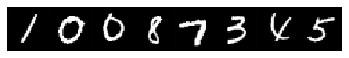

step 81162, loss 0.9534392356872559
Target:	 tensor([2, 1, 3, 5, 3, 1, 6, 1])
Pred:	 tensor([2, 1, 3, 4, 9, 1, 6, 1])


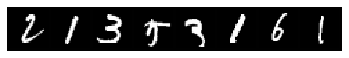

step 81212, loss 0.7228286266326904
Target:	 tensor([1, 2, 4, 9, 2, 1, 1, 2])
Pred:	 tensor([1, 1, 4, 9, 2, 1, 1, 0])


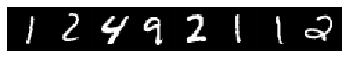

step 81262, loss 0.8769214749336243
Target:	 tensor([9, 8, 0, 3, 3, 8, 8, 4])
Pred:	 tensor([9, 8, 0, 3, 3, 7, 8, 6])


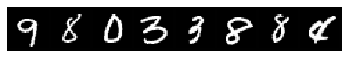

step 81312, loss 0.6965868473052979
Target:	 tensor([6, 7, 5, 8, 3, 7, 5, 1])
Pred:	 tensor([6, 7, 5, 5, 3, 9, 5, 1])


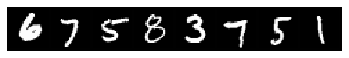

step 81362, loss 0.681438684463501
Target:	 tensor([4, 6, 2, 1, 7, 8, 0, 0])
Pred:	 tensor([4, 6, 2, 1, 7, 1, 0, 0])


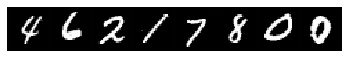

step 81412, loss 0.6269515156745911
Target:	 tensor([6, 7, 5, 3, 4, 4, 6, 2])
Pred:	 tensor([6, 7, 5, 3, 4, 9, 6, 2])


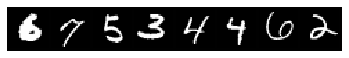

step 81462, loss 0.822826087474823
Target:	 tensor([4, 3, 7, 1, 9, 0, 6, 0])
Pred:	 tensor([4, 3, 7, 1, 9, 0, 6, 0])


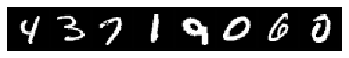

step 81512, loss 0.622718870639801
Target:	 tensor([4, 2, 7, 2, 9, 7, 9, 4])
Pred:	 tensor([4, 2, 2, 2, 9, 7, 9, 4])


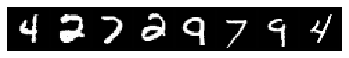

step 81562, loss 0.6478040814399719
Target:	 tensor([3, 9, 5, 9, 4, 3, 6, 4])
Pred:	 tensor([5, 0, 5, 9, 4, 3, 6, 4])


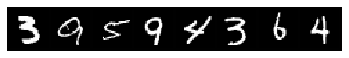

step 81612, loss 0.8632369637489319
Target:	 tensor([1, 0, 4, 8, 2, 1, 3, 0])
Pred:	 tensor([1, 0, 4, 8, 2, 1, 9, 0])


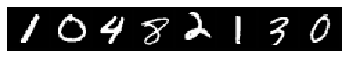

step 81662, loss 0.846076250076294
Target:	 tensor([5, 1, 4, 1, 7, 1, 8, 2])
Pred:	 tensor([5, 1, 9, 1, 7, 1, 1, 2])


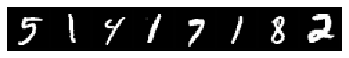

step 81712, loss 0.6581185460090637
Target:	 tensor([5, 6, 2, 7, 7, 7, 7, 6])
Pred:	 tensor([5, 6, 1, 7, 7, 7, 7, 6])


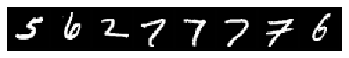

step 81762, loss 0.698614776134491
Target:	 tensor([6, 3, 7, 8, 0, 3, 3, 2])
Pred:	 tensor([6, 3, 7, 1, 0, 3, 3, 2])


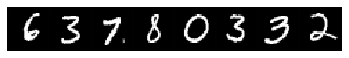

step 81812, loss 0.9235703945159912
Target:	 tensor([4, 3, 6, 9, 3, 6, 5, 9])
Pred:	 tensor([4, 3, 6, 9, 8, 6, 5, 4])


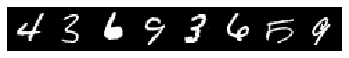

step 81862, loss 0.5850013494491577
Target:	 tensor([0, 7, 0, 6, 7, 1, 2, 7])
Pred:	 tensor([0, 7, 0, 6, 7, 1, 2, 7])


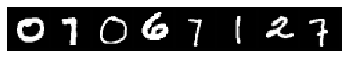

step 81912, loss 0.7661559581756592
Target:	 tensor([2, 6, 7, 2, 6, 6, 4, 0])
Pred:	 tensor([2, 6, 7, 2, 6, 6, 4, 0])


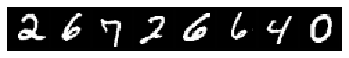

step 81962, loss 0.8191430568695068
Target:	 tensor([4, 4, 0, 1, 4, 3, 7, 6])
Pred:	 tensor([4, 4, 0, 1, 4, 8, 2, 6])


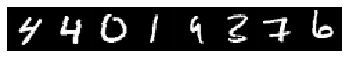

step 82012, loss 1.032686710357666
Target:	 tensor([2, 1, 7, 3, 1, 4, 3, 3])
Pred:	 tensor([2, 8, 9, 3, 1, 4, 2, 5])


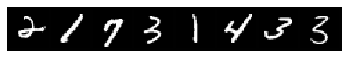

step 82062, loss 0.600209653377533
Target:	 tensor([3, 8, 0, 7, 0, 2, 1, 3])
Pred:	 tensor([3, 3, 0, 7, 0, 2, 1, 5])


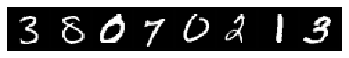

step 82112, loss 0.8689184188842773
Target:	 tensor([6, 3, 0, 5, 3, 3, 9, 4])
Pred:	 tensor([6, 3, 0, 6, 3, 3, 4, 4])


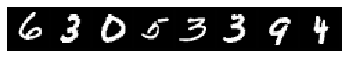

step 82162, loss 0.7506287693977356
Target:	 tensor([0, 0, 2, 8, 7, 8, 2, 1])
Pred:	 tensor([0, 0, 2, 5, 7, 8, 2, 6])


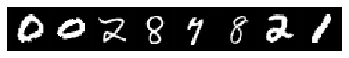

step 82203, loss 0.9655534625053406
Target:	 tensor([9, 3, 3, 8, 6, 7, 9, 2])
Pred:	 tensor([9, 7, 3, 8, 6, 7, 9, 7])


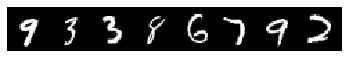

step 82253, loss 0.9630560278892517
Target:	 tensor([3, 1, 5, 6, 9, 7, 6, 3])
Pred:	 tensor([3, 8, 5, 6, 9, 9, 6, 3])


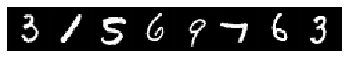

step 82303, loss 0.6370459198951721
Target:	 tensor([4, 9, 5, 8, 7, 7, 1, 5])
Pred:	 tensor([4, 9, 5, 8, 7, 7, 1, 9])


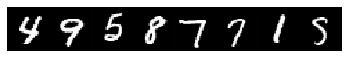

step 82353, loss 1.1577147245407104
Target:	 tensor([6, 2, 3, 0, 6, 3, 1, 3])
Pred:	 tensor([6, 4, 3, 0, 6, 5, 1, 2])


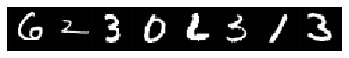

step 82403, loss 0.7443662285804749
Target:	 tensor([7, 6, 1, 8, 3, 2, 7, 2])
Pred:	 tensor([7, 6, 1, 2, 3, 2, 7, 2])


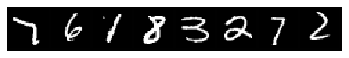

step 82453, loss 0.7720200419425964
Target:	 tensor([1, 0, 4, 3, 0, 8, 2, 8])
Pred:	 tensor([1, 0, 4, 3, 0, 0, 2, 5])


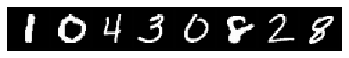

step 82503, loss 0.8214449286460876
Target:	 tensor([2, 4, 9, 4, 4, 5, 3, 8])
Pred:	 tensor([2, 4, 9, 4, 4, 5, 3, 8])


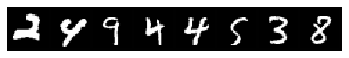

step 82553, loss 0.6752551198005676
Target:	 tensor([5, 1, 5, 3, 7, 5, 8, 4])
Pred:	 tensor([5, 1, 8, 3, 7, 5, 3, 4])


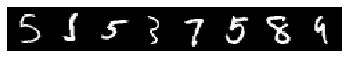

step 82603, loss 0.6614206433296204
Target:	 tensor([5, 4, 6, 5, 4, 1, 5, 0])
Pred:	 tensor([5, 4, 6, 5, 4, 1, 5, 0])


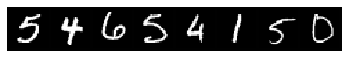

step 82653, loss 0.6789438128471375
Target:	 tensor([5, 8, 1, 0, 8, 1, 7, 4])
Pred:	 tensor([5, 8, 1, 0, 8, 1, 7, 4])


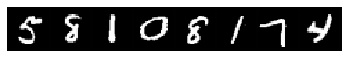

step 82703, loss 1.1433299779891968
Target:	 tensor([3, 5, 4, 4, 7, 6, 4, 5])
Pred:	 tensor([3, 8, 6, 6, 7, 6, 4, 5])


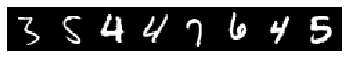

step 82753, loss 0.5942444205284119
Target:	 tensor([2, 6, 4, 7, 8, 8, 0, 5])
Pred:	 tensor([2, 6, 4, 7, 8, 8, 0, 5])


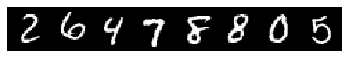

step 82803, loss 0.7318676114082336
Target:	 tensor([4, 2, 4, 6, 7, 2, 5, 0])
Pred:	 tensor([4, 2, 4, 6, 7, 8, 5, 0])


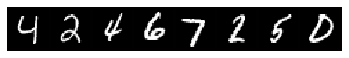

step 82853, loss 0.82041335105896
Target:	 tensor([6, 3, 6, 2, 7, 2, 7, 4])
Pred:	 tensor([6, 3, 6, 2, 7, 2, 7, 4])


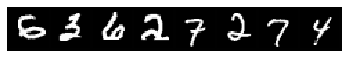

step 82903, loss 0.8539602160453796
Target:	 tensor([6, 9, 9, 3, 5, 4, 2, 0])
Pred:	 tensor([6, 9, 9, 3, 5, 6, 2, 0])


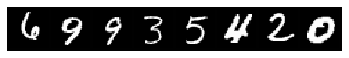

step 82953, loss 0.7082293629646301
Target:	 tensor([7, 3, 5, 1, 1, 5, 3, 2])
Pred:	 tensor([7, 3, 5, 1, 1, 5, 3, 2])


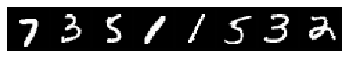

step 83003, loss 0.8823435306549072
Target:	 tensor([8, 2, 7, 0, 3, 3, 2, 0])
Pred:	 tensor([8, 2, 7, 0, 3, 7, 2, 2])


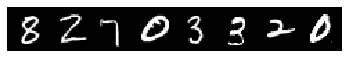

step 83053, loss 0.9796721339225769
Target:	 tensor([7, 6, 5, 8, 4, 2, 8, 9])
Pred:	 tensor([3, 6, 5, 8, 4, 6, 7, 9])


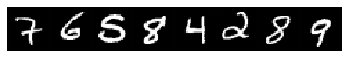

step 83103, loss 0.8385534286499023
Target:	 tensor([0, 5, 4, 3, 7, 2, 3, 7])
Pred:	 tensor([0, 5, 4, 2, 7, 2, 3, 7])


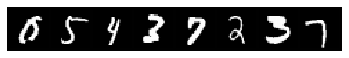

step 83153, loss 0.7934049963951111
Target:	 tensor([1, 3, 0, 5, 7, 1, 8, 2])
Pred:	 tensor([1, 3, 0, 5, 7, 2, 1, 2])


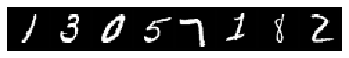

step 83203, loss 0.6888241171836853
Target:	 tensor([9, 1, 4, 8, 8, 6, 5, 1])
Pred:	 tensor([9, 1, 4, 3, 4, 6, 5, 1])


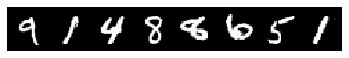

step 83253, loss 1.0233229398727417
Target:	 tensor([1, 0, 5, 0, 6, 5, 1, 9])
Pred:	 tensor([1, 0, 5, 0, 6, 5, 1, 7])


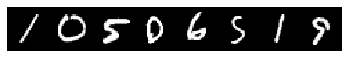

step 83303, loss 0.5417519807815552
Target:	 tensor([3, 5, 5, 0, 2, 3, 9, 0])
Pred:	 tensor([3, 5, 5, 0, 2, 3, 9, 0])


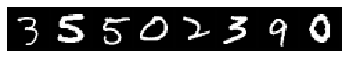

step 83353, loss 0.637846827507019
Target:	 tensor([0, 3, 8, 0, 9, 6, 2, 1])
Pred:	 tensor([0, 3, 1, 0, 7, 6, 3, 1])


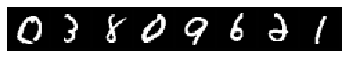

step 83403, loss 0.7882695198059082
Target:	 tensor([7, 2, 9, 5, 6, 3, 1, 6])
Pred:	 tensor([7, 2, 9, 5, 6, 3, 1, 6])


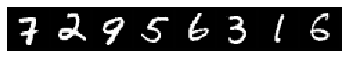

step 83453, loss 0.7235170006752014
Target:	 tensor([8, 9, 6, 2, 2, 2, 2, 2])
Pred:	 tensor([8, 9, 6, 2, 2, 2, 2, 2])


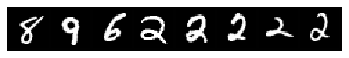

step 83503, loss 0.9028616547584534
Target:	 tensor([0, 5, 3, 3, 5, 7, 3, 8])
Pred:	 tensor([0, 5, 7, 3, 7, 7, 3, 3])


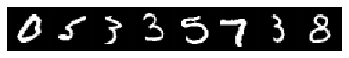

step 83553, loss 0.5424599647521973
Target:	 tensor([5, 3, 7, 3, 3, 7, 7, 6])
Pred:	 tensor([5, 3, 5, 3, 3, 7, 7, 6])


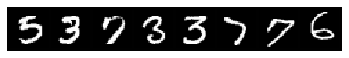

step 83603, loss 0.9341654777526855
Target:	 tensor([7, 8, 6, 0, 8, 3, 1, 6])
Pred:	 tensor([9, 3, 6, 0, 8, 3, 8, 6])


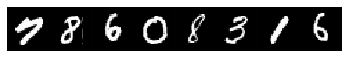

step 83653, loss 0.8397740721702576
Target:	 tensor([6, 0, 7, 8, 2, 0, 9, 1])
Pred:	 tensor([2, 0, 7, 3, 2, 0, 9, 1])


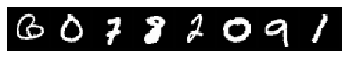

step 83703, loss 0.690683126449585
Target:	 tensor([2, 6, 8, 3, 1, 4, 1, 4])
Pred:	 tensor([2, 6, 8, 3, 1, 9, 1, 4])


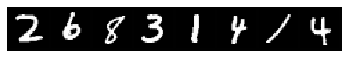

step 83753, loss 0.9313957691192627
Target:	 tensor([9, 5, 6, 0, 7, 8, 4, 3])
Pred:	 tensor([9, 5, 6, 0, 7, 8, 4, 9])


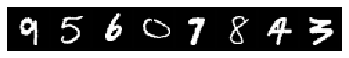

step 83803, loss 0.7180359959602356
Target:	 tensor([1, 2, 7, 8, 8, 1, 9, 9])
Pred:	 tensor([1, 2, 7, 8, 8, 1, 9, 9])


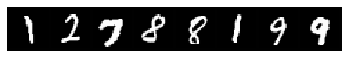

step 83853, loss 0.8689765930175781
Target:	 tensor([4, 7, 3, 0, 7, 8, 8, 4])
Pred:	 tensor([9, 7, 3, 6, 7, 6, 8, 4])


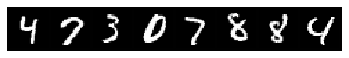

step 83903, loss 0.9364936947822571
Target:	 tensor([8, 7, 2, 4, 3, 8, 9, 0])
Pred:	 tensor([8, 7, 8, 9, 3, 8, 9, 5])


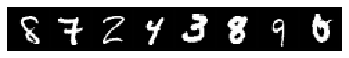

step 83953, loss 0.7738094925880432
Target:	 tensor([8, 6, 5, 2, 9, 3, 3, 1])
Pred:	 tensor([8, 6, 8, 2, 7, 9, 3, 8])


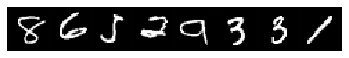

step 84003, loss 0.7997419834136963
Target:	 tensor([9, 9, 8, 9, 7, 9, 1, 0])
Pred:	 tensor([4, 9, 8, 9, 7, 9, 1, 0])


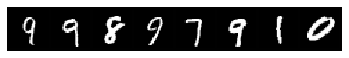

step 84053, loss 0.66133713722229
Target:	 tensor([6, 2, 3, 8, 8, 7, 2, 3])
Pred:	 tensor([6, 2, 3, 3, 8, 7, 2, 3])


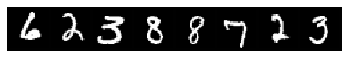

step 84103, loss 0.841762363910675
Target:	 tensor([2, 8, 5, 2, 7, 2, 1, 1])
Pred:	 tensor([2, 1, 5, 2, 7, 2, 1, 1])


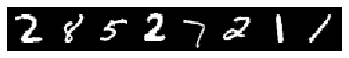

step 84153, loss 1.0225952863693237
Target:	 tensor([8, 7, 8, 4, 3, 0, 0, 1])
Pred:	 tensor([3, 3, 8, 9, 3, 8, 0, 1])


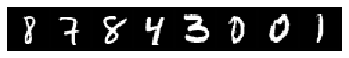

step 84203, loss 0.7286965847015381
Target:	 tensor([6, 2, 0, 2, 6, 8, 5, 8])
Pred:	 tensor([6, 8, 0, 6, 6, 8, 5, 3])


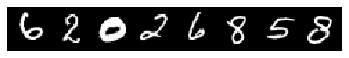

step 84253, loss 0.8353951573371887
Target:	 tensor([7, 9, 7, 8, 8, 7, 3, 3])
Pred:	 tensor([7, 9, 7, 8, 5, 1, 3, 7])


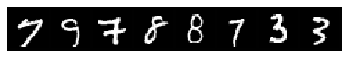

step 84303, loss 0.8642683625221252
Target:	 tensor([4, 8, 8, 3, 2, 6, 2, 9])
Pred:	 tensor([4, 8, 1, 3, 2, 6, 2, 9])


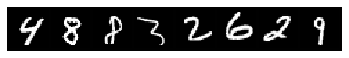

step 84353, loss 0.6684457659721375
Target:	 tensor([8, 9, 7, 3, 4, 3, 6, 1])
Pred:	 tensor([8, 9, 7, 3, 4, 3, 6, 1])


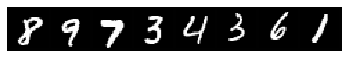

step 84403, loss 0.8081182837486267
Target:	 tensor([9, 6, 1, 2, 3, 6, 2, 6])
Pred:	 tensor([3, 6, 1, 2, 3, 6, 4, 6])


step 84453, loss 0.8249831795692444
Target:	 tensor([8, 1, 4, 8, 3, 4, 8, 7])
Pred:	 tensor([1, 1, 4, 3, 3, 4, 3, 7])


step 84503, loss 0.911582887172699
Target:	 tensor([2, 0, 6, 1, 4, 8, 4, 4])
Pred:	 tensor([1, 0, 6, 1, 4, 5, 6, 4])


step 84553, loss 0.6030566692352295
Target:	 tensor([4, 1, 1, 7, 2, 8, 1, 6])
Pred:	 tensor([4, 1, 1, 7, 2, 8, 1, 6])


step 84603, loss 0.7860128283500671
Target:	 tensor([0, 2, 5, 6, 4, 1, 1, 1])
Pred:	 tensor([0, 2, 0, 6, 9, 1, 1, 1])


step 84653, loss 1.0866974592208862
Target:	 tensor([9, 9, 4, 5, 8, 1, 4, 5])
Pred:	 tensor([2, 9, 4, 4, 8, 1, 1, 4])


step 84694, loss 1.004359483718872
Target:	 tensor([7, 0, 3, 0, 2, 4, 6, 6])
Pred:	 tensor([9, 0, 3, 0, 1, 4, 6, 6])


step 84744, loss 0.9668183326721191
Target:	 tensor([9, 7, 1, 9, 5, 9, 2, 4])
Pred:	 tensor([7, 7, 1, 9, 5, 4, 1, 6])


step 84794, loss 0.8263683915138245
Target:	 tensor([0, 3, 8, 3, 5, 6, 8, 1])
Pred:	 tensor([0, 3, 8, 3, 3, 6, 8, 8])


step 84844, loss 0.8625392913818359
Target:	 tensor([9, 9, 0, 6, 0, 2, 7, 9])
Pred:	 tensor([9, 5, 0, 6, 0, 2, 7, 9])


step 84894, loss 0.6183119416236877
Target:	 tensor([2, 8, 7, 3, 4, 1, 2, 9])
Pred:	 tensor([2, 6, 7, 3, 4, 1, 2, 9])


step 84944, loss 0.9677398204803467
Target:	 tensor([5, 0, 2, 5, 5, 3, 3, 5])
Pred:	 tensor([8, 0, 0, 0, 6, 3, 3, 5])


step 84994, loss 1.0387803316116333
Target:	 tensor([6, 1, 2, 4, 8, 9, 1, 0])
Pred:	 tensor([6, 1, 2, 4, 8, 2, 1, 0])


step 85044, loss 0.6464137434959412
Target:	 tensor([3, 8, 4, 2, 8, 1, 6, 4])
Pred:	 tensor([3, 3, 4, 0, 1, 1, 6, 4])


step 85094, loss 1.0091931819915771
Target:	 tensor([4, 8, 4, 1, 5, 6, 6, 8])
Pred:	 tensor([4, 3, 4, 1, 3, 6, 6, 8])


step 85144, loss 0.6486114859580994
Target:	 tensor([4, 7, 3, 5, 7, 6, 4, 3])
Pred:	 tensor([4, 7, 3, 5, 7, 6, 4, 3])


step 85194, loss 0.7037075161933899
Target:	 tensor([5, 2, 7, 3, 4, 6, 7, 4])
Pred:	 tensor([5, 2, 7, 3, 9, 6, 7, 4])


step 85244, loss 0.7297265529632568
Target:	 tensor([2, 2, 6, 0, 9, 7, 3, 7])
Pred:	 tensor([2, 0, 6, 0, 9, 7, 3, 7])


step 85294, loss 0.7294528484344482
Target:	 tensor([3, 3, 0, 6, 6, 5, 2, 7])
Pred:	 tensor([3, 3, 0, 6, 6, 5, 2, 7])


step 85344, loss 0.7205403447151184
Target:	 tensor([0, 8, 9, 8, 6, 5, 8, 7])
Pred:	 tensor([0, 8, 9, 5, 6, 5, 5, 7])


step 85394, loss 0.4331373870372772
Target:	 tensor([9, 6, 3, 7, 7, 6, 7, 6])
Pred:	 tensor([9, 6, 3, 7, 7, 6, 7, 6])


step 85444, loss 0.6459879875183105
Target:	 tensor([3, 6, 3, 8, 1, 6, 3, 6])
Pred:	 tensor([3, 6, 5, 8, 1, 6, 3, 6])


step 85494, loss 0.9035168290138245
Target:	 tensor([2, 7, 5, 8, 2, 5, 7, 5])
Pred:	 tensor([2, 7, 5, 5, 2, 5, 7, 5])


step 85544, loss 0.5930171012878418
Target:	 tensor([8, 6, 5, 3, 4, 5, 9, 6])
Pred:	 tensor([8, 6, 5, 3, 4, 5, 9, 6])


step 85594, loss 0.7102038860321045
Target:	 tensor([4, 8, 0, 2, 5, 8, 9, 3])
Pred:	 tensor([4, 8, 0, 2, 5, 8, 9, 3])


step 85644, loss 0.8695478439331055
Target:	 tensor([9, 6, 2, 3, 5, 7, 3, 6])
Pred:	 tensor([9, 6, 2, 2, 5, 7, 5, 6])


step 85694, loss 0.924935519695282
Target:	 tensor([4, 8, 1, 0, 5, 2, 9, 9])
Pred:	 tensor([4, 5, 1, 5, 5, 2, 0, 9])


step 85744, loss 0.8111600279808044
Target:	 tensor([1, 6, 2, 1, 2, 0, 7, 9])
Pred:	 tensor([6, 6, 2, 1, 0, 0, 7, 9])


step 85794, loss 0.7867030501365662
Target:	 tensor([5, 3, 0, 7, 0, 0, 3, 8])
Pred:	 tensor([8, 3, 0, 7, 0, 5, 3, 8])


step 85844, loss 0.7936660647392273
Target:	 tensor([8, 8, 1, 4, 6, 7, 3, 3])
Pred:	 tensor([4, 5, 1, 4, 6, 7, 3, 5])


step 85894, loss 0.6601760387420654
Target:	 tensor([3, 0, 0, 9, 4, 2, 3, 2])
Pred:	 tensor([3, 0, 0, 5, 9, 2, 3, 2])


step 85944, loss 0.7028084397315979
Target:	 tensor([4, 8, 7, 6, 7, 5, 5, 8])
Pred:	 tensor([9, 8, 7, 6, 7, 5, 6, 3])


step 85994, loss 0.5908458828926086
Target:	 tensor([1, 0, 8, 0, 7, 1, 6, 1])
Pred:	 tensor([1, 0, 5, 0, 7, 1, 6, 1])


step 86044, loss 0.8128561973571777
Target:	 tensor([2, 3, 1, 8, 6, 7, 4, 6])
Pred:	 tensor([2, 3, 8, 8, 6, 7, 4, 6])


step 86094, loss 0.6426705718040466
Target:	 tensor([7, 0, 5, 7, 7, 1, 1, 2])
Pred:	 tensor([7, 0, 5, 7, 7, 1, 1, 2])


step 86144, loss 0.7374608516693115
Target:	 tensor([4, 8, 9, 8, 7, 8, 3, 1])
Pred:	 tensor([4, 5, 9, 1, 9, 1, 3, 1])


step 86194, loss 0.8568452000617981
Target:	 tensor([8, 9, 2, 4, 5, 1, 3, 1])
Pred:	 tensor([3, 5, 8, 4, 5, 1, 3, 1])


step 86244, loss 0.7452625632286072
Target:	 tensor([8, 6, 0, 0, 5, 2, 9, 1])
Pred:	 tensor([8, 6, 0, 0, 5, 2, 9, 1])


step 86294, loss 0.9998732209205627
Target:	 tensor([8, 5, 8, 9, 8, 6, 8, 1])
Pred:	 tensor([8, 5, 1, 9, 8, 6, 5, 1])


step 86344, loss 0.9036571383476257
Target:	 tensor([5, 3, 6, 8, 8, 5, 3, 1])
Pred:	 tensor([5, 3, 6, 8, 3, 5, 3, 1])


step 86394, loss 0.8349239230155945
Target:	 tensor([4, 4, 1, 4, 7, 6, 9, 1])
Pred:	 tensor([4, 4, 1, 4, 7, 6, 9, 8])


step 86444, loss 0.8399975895881653
Target:	 tensor([9, 7, 0, 1, 5, 5, 4, 8])
Pred:	 tensor([9, 7, 0, 1, 5, 5, 4, 3])


step 86494, loss 0.7680522799491882
Target:	 tensor([8, 2, 0, 0, 0, 0, 1, 4])
Pred:	 tensor([8, 2, 0, 0, 5, 0, 1, 4])


step 86544, loss 0.8425427079200745
Target:	 tensor([0, 1, 1, 9, 1, 0, 0, 9])
Pred:	 tensor([0, 1, 1, 9, 1, 0, 0, 9])


step 86594, loss 0.7552246451377869
Target:	 tensor([5, 1, 1, 3, 7, 1, 4, 8])
Pred:	 tensor([9, 1, 1, 3, 7, 1, 4, 5])


step 86644, loss 0.6799677014350891
Target:	 tensor([9, 5, 4, 7, 7, 2, 1, 9])
Pred:	 tensor([9, 5, 4, 7, 7, 2, 1, 9])


step 86694, loss 0.8644916415214539
Target:	 tensor([3, 4, 5, 9, 5, 8, 9, 8])
Pred:	 tensor([3, 4, 5, 9, 5, 3, 9, 8])


step 86744, loss 0.9831138253211975
Target:	 tensor([9, 2, 0, 3, 9, 2, 5, 7])
Pred:	 tensor([9, 7, 0, 3, 9, 2, 5, 7])


step 86794, loss 0.7121610641479492
Target:	 tensor([3, 4, 0, 1, 4, 4, 8, 3])
Pred:	 tensor([3, 4, 0, 1, 4, 9, 8, 3])


step 86844, loss 0.6452566981315613
Target:	 tensor([9, 1, 0, 3, 4, 0, 5, 6])
Pred:	 tensor([9, 1, 0, 3, 4, 0, 5, 6])


step 86894, loss 0.9050026535987854
Target:	 tensor([9, 0, 5, 1, 9, 7, 9, 5])
Pred:	 tensor([9, 0, 5, 1, 9, 7, 9, 5])


step 86944, loss 0.9827561378479004
Target:	 tensor([8, 8, 1, 9, 1, 6, 7, 7])
Pred:	 tensor([2, 7, 1, 9, 1, 6, 7, 7])


step 86994, loss 0.8389076590538025
Target:	 tensor([3, 2, 5, 1, 3, 6, 2, 7])
Pred:	 tensor([3, 2, 3, 1, 2, 6, 2, 7])


step 87044, loss 0.8499415516853333
Target:	 tensor([3, 3, 5, 6, 3, 9, 1, 8])
Pred:	 tensor([3, 3, 9, 6, 3, 9, 1, 8])


step 87094, loss 0.7957059741020203
Target:	 tensor([2, 9, 6, 6, 8, 0, 7, 6])
Pred:	 tensor([2, 9, 6, 6, 8, 0, 7, 6])


step 87144, loss 0.834937572479248
Target:	 tensor([9, 7, 6, 0, 0, 1, 3, 6])
Pred:	 tensor([7, 7, 4, 0, 0, 6, 3, 6])


step 87185, loss 1.1523313522338867
Target:	 tensor([1, 1, 8, 8, 6, 9, 6, 5])
Pred:	 tensor([1, 1, 3, 5, 6, 4, 6, 5])


step 87235, loss 0.8768333792686462
Target:	 tensor([1, 8, 7, 0, 4, 6, 5, 3])
Pred:	 tensor([1, 8, 7, 0, 4, 6, 0, 3])


step 87285, loss 0.8307501673698425
Target:	 tensor([1, 7, 7, 3, 6, 4, 1, 2])
Pred:	 tensor([1, 7, 7, 3, 6, 4, 6, 2])


step 87335, loss 0.8197116255760193
Target:	 tensor([3, 9, 2, 9, 1, 2, 9, 2])
Pred:	 tensor([3, 9, 2, 4, 1, 2, 9, 2])


step 87385, loss 0.7571616768836975
Target:	 tensor([9, 0, 9, 0, 0, 2, 3, 0])
Pred:	 tensor([9, 0, 9, 0, 0, 2, 3, 0])


step 87435, loss 0.6981819272041321
Target:	 tensor([5, 4, 9, 0, 4, 1, 2, 4])
Pred:	 tensor([8, 2, 9, 0, 9, 1, 2, 4])


step 87485, loss 0.6770876049995422
Target:	 tensor([3, 6, 0, 3, 2, 8, 1, 3])
Pred:	 tensor([2, 1, 0, 3, 6, 8, 6, 3])


step 87535, loss 0.9177670478820801
Target:	 tensor([4, 7, 2, 2, 9, 7, 6, 3])
Pred:	 tensor([4, 7, 2, 2, 9, 7, 6, 5])


step 87585, loss 0.8690006136894226
Target:	 tensor([1, 7, 8, 0, 7, 5, 9, 0])
Pred:	 tensor([1, 3, 3, 0, 7, 5, 4, 0])


step 87635, loss 0.7876236438751221
Target:	 tensor([4, 8, 9, 1, 4, 3, 4, 8])
Pred:	 tensor([4, 8, 9, 1, 4, 3, 4, 1])


step 87685, loss 0.6495051980018616
Target:	 tensor([0, 1, 6, 2, 0, 6, 8, 8])
Pred:	 tensor([0, 1, 6, 2, 0, 6, 8, 8])


step 87735, loss 0.9182202816009521
Target:	 tensor([7, 2, 1, 2, 0, 1, 2, 0])
Pred:	 tensor([7, 2, 1, 4, 0, 2, 2, 0])


step 87785, loss 0.7116766571998596
Target:	 tensor([2, 1, 1, 6, 7, 9, 4, 7])
Pred:	 tensor([2, 1, 1, 6, 7, 9, 4, 7])


step 87835, loss 0.675990641117096
Target:	 tensor([6, 4, 8, 4, 2, 9, 4, 7])
Pred:	 tensor([6, 4, 3, 4, 2, 9, 4, 7])


step 87885, loss 0.8686617016792297
Target:	 tensor([5, 5, 2, 3, 7, 3, 3, 1])
Pred:	 tensor([5, 5, 3, 3, 7, 3, 3, 1])


step 87935, loss 0.7063032984733582
Target:	 tensor([9, 3, 9, 4, 8, 3, 0, 1])
Pred:	 tensor([9, 3, 4, 4, 1, 7, 0, 1])


step 87985, loss 0.7213592529296875
Target:	 tensor([3, 5, 1, 5, 9, 4, 3, 7])
Pred:	 tensor([3, 5, 1, 5, 9, 4, 3, 7])


step 88035, loss 0.8615006804466248
Target:	 tensor([6, 6, 1, 5, 3, 9, 0, 2])
Pred:	 tensor([6, 6, 1, 5, 3, 4, 0, 2])


step 88085, loss 0.8414615988731384
Target:	 tensor([3, 0, 5, 8, 9, 8, 8, 1])
Pred:	 tensor([8, 0, 5, 8, 9, 8, 8, 9])


step 88135, loss 0.9513534903526306
Target:	 tensor([3, 6, 6, 5, 5, 9, 9, 7])
Pred:	 tensor([2, 6, 6, 5, 5, 9, 9, 7])


step 88185, loss 0.8862228989601135
Target:	 tensor([8, 1, 0, 9, 5, 0, 5, 9])
Pred:	 tensor([6, 1, 0, 9, 5, 0, 5, 9])


step 88235, loss 0.7053520083427429
Target:	 tensor([3, 8, 1, 5, 4, 3, 3, 6])
Pred:	 tensor([3, 3, 1, 5, 4, 3, 3, 6])


step 88285, loss 0.7045080661773682
Target:	 tensor([2, 4, 9, 9, 1, 1, 7, 6])
Pred:	 tensor([2, 4, 9, 1, 1, 1, 7, 6])


step 88335, loss 1.0753921270370483
Target:	 tensor([3, 2, 5, 2, 9, 8, 8, 2])
Pred:	 tensor([3, 2, 5, 2, 4, 3, 5, 6])


step 88385, loss 0.9217555522918701
Target:	 tensor([5, 4, 3, 5, 7, 2, 5, 6])
Pred:	 tensor([5, 4, 8, 5, 7, 2, 5, 6])


step 88435, loss 0.9080169796943665
Target:	 tensor([4, 3, 5, 2, 9, 0, 9, 7])
Pred:	 tensor([4, 3, 8, 1, 9, 0, 9, 1])


step 88485, loss 1.007827639579773
Target:	 tensor([7, 6, 8, 8, 1, 5, 9, 5])
Pred:	 tensor([7, 6, 8, 3, 1, 5, 9, 5])


step 88535, loss 1.0219578742980957
Target:	 tensor([2, 8, 0, 4, 0, 5, 2, 1])
Pred:	 tensor([2, 5, 0, 1, 0, 5, 2, 1])


step 88585, loss 0.45203614234924316
Target:	 tensor([1, 0, 9, 5, 8, 4, 9, 7])
Pred:	 tensor([1, 0, 9, 5, 8, 4, 9, 7])


step 88635, loss 0.6611607670783997
Target:	 tensor([4, 1, 3, 3, 5, 7, 2, 0])
Pred:	 tensor([4, 1, 3, 3, 5, 7, 2, 0])


step 88685, loss 0.7819563746452332
Target:	 tensor([3, 2, 6, 2, 5, 5, 8, 7])
Pred:	 tensor([3, 2, 4, 2, 5, 5, 5, 7])


step 88735, loss 0.8991290926933289
Target:	 tensor([4, 5, 1, 9, 1, 5, 4, 4])
Pred:	 tensor([4, 5, 1, 9, 1, 3, 4, 4])


step 88785, loss 0.9865390658378601
Target:	 tensor([0, 9, 8, 8, 2, 0, 6, 1])
Pred:	 tensor([0, 8, 8, 3, 3, 0, 6, 1])


step 88835, loss 0.9583292603492737
Target:	 tensor([0, 0, 5, 1, 1, 7, 1, 6])
Pred:	 tensor([0, 0, 5, 1, 1, 7, 1, 6])


step 88885, loss 1.2454618215560913
Target:	 tensor([8, 6, 7, 3, 7, 7, 8, 6])
Pred:	 tensor([1, 6, 7, 3, 7, 7, 9, 6])


step 88935, loss 0.7701838612556458
Target:	 tensor([5, 8, 1, 5, 3, 9, 1, 3])
Pred:	 tensor([5, 5, 1, 5, 3, 4, 4, 3])


step 88985, loss 0.8443889617919922
Target:	 tensor([1, 5, 6, 7, 5, 8, 4, 6])
Pred:	 tensor([1, 5, 6, 7, 5, 3, 4, 0])


step 89035, loss 0.9223949909210205
Target:	 tensor([3, 3, 0, 0, 9, 2, 9, 4])
Pred:	 tensor([3, 3, 0, 0, 9, 2, 9, 4])


step 89085, loss 0.5200309753417969
Target:	 tensor([7, 4, 8, 1, 0, 3, 7, 1])
Pred:	 tensor([7, 4, 3, 1, 0, 3, 7, 1])


step 89135, loss 0.879791796207428
Target:	 tensor([7, 6, 8, 7, 8, 5, 1, 0])
Pred:	 tensor([3, 6, 5, 7, 8, 5, 1, 0])


step 89185, loss 0.866788923740387
Target:	 tensor([1, 5, 8, 3, 3, 3, 0, 1])
Pred:	 tensor([8, 6, 8, 3, 3, 3, 0, 1])


step 89235, loss 0.8683333992958069
Target:	 tensor([7, 5, 9, 4, 7, 7, 2, 9])
Pred:	 tensor([7, 5, 9, 9, 2, 7, 1, 9])


step 89285, loss 0.9620003700256348
Target:	 tensor([3, 6, 4, 6, 9, 9, 0, 9])
Pred:	 tensor([3, 6, 4, 6, 9, 9, 0, 8])


step 89335, loss 0.7460249066352844
Target:	 tensor([5, 2, 6, 1, 8, 4, 9, 8])
Pred:	 tensor([5, 2, 6, 1, 1, 4, 9, 8])


step 89385, loss 0.7852320075035095
Target:	 tensor([5, 1, 2, 9, 3, 7, 9, 2])
Pred:	 tensor([5, 1, 2, 5, 3, 7, 9, 2])


step 89435, loss 0.8460718989372253
Target:	 tensor([2, 6, 6, 5, 1, 9, 8, 8])
Pred:	 tensor([2, 6, 6, 5, 1, 9, 8, 1])


step 89485, loss 0.8636886477470398
Target:	 tensor([2, 3, 7, 9, 6, 8, 2, 4])
Pred:	 tensor([2, 3, 7, 7, 6, 3, 1, 4])


step 89535, loss 0.8072355389595032
Target:	 tensor([2, 5, 4, 6, 0, 3, 8, 7])
Pred:	 tensor([2, 5, 4, 6, 0, 1, 8, 7])


step 89585, loss 0.8204179406166077
Target:	 tensor([1, 7, 1, 3, 3, 6, 5, 0])
Pred:	 tensor([1, 7, 1, 3, 3, 6, 5, 0])


step 89635, loss 0.7593896985054016
Target:	 tensor([0, 5, 0, 9, 8, 5, 0, 8])
Pred:	 tensor([0, 5, 0, 4, 8, 5, 0, 8])


step 89676, loss 0.6148675084114075
Target:	 tensor([0, 6, 8, 6, 3, 6, 6, 8])
Pred:	 tensor([0, 6, 5, 6, 3, 6, 6, 8])


step 89726, loss 0.6761903762817383
Target:	 tensor([3, 4, 5, 7, 6, 3, 7, 6])
Pred:	 tensor([3, 4, 5, 7, 6, 3, 1, 6])


step 89776, loss 0.5886715054512024
Target:	 tensor([5, 7, 7, 5, 5, 3, 4, 3])
Pred:	 tensor([5, 7, 7, 8, 5, 3, 4, 3])


step 89826, loss 0.8633416295051575
Target:	 tensor([7, 9, 3, 6, 4, 4, 9, 6])
Pred:	 tensor([7, 9, 3, 6, 4, 1, 9, 6])


step 89876, loss 0.7361552119255066
Target:	 tensor([9, 5, 4, 1, 1, 8, 0, 6])
Pred:	 tensor([9, 5, 4, 1, 1, 8, 0, 6])


step 89926, loss 0.8287346363067627
Target:	 tensor([0, 1, 9, 4, 1, 8, 2, 5])
Pred:	 tensor([0, 1, 9, 9, 1, 6, 6, 5])


step 89976, loss 0.6311981081962585
Target:	 tensor([9, 8, 9, 3, 4, 0, 6, 0])
Pred:	 tensor([9, 7, 4, 3, 4, 0, 6, 0])


step 90026, loss 0.6994035243988037
Target:	 tensor([9, 3, 1, 9, 9, 6, 1, 0])
Pred:	 tensor([7, 3, 1, 9, 9, 6, 1, 0])


step 90076, loss 0.8376639485359192
Target:	 tensor([5, 5, 5, 0, 1, 3, 4, 8])
Pred:	 tensor([5, 5, 5, 0, 6, 3, 4, 8])


step 90126, loss 0.5912895798683167
Target:	 tensor([5, 1, 3, 6, 8, 9, 4, 4])
Pred:	 tensor([3, 1, 8, 6, 8, 9, 4, 6])


step 90176, loss 1.0414854288101196
Target:	 tensor([2, 1, 8, 1, 9, 9, 6, 2])
Pred:	 tensor([2, 1, 8, 1, 9, 9, 0, 2])


step 90226, loss 1.3599352836608887
Target:	 tensor([1, 1, 7, 5, 8, 2, 4, 2])
Pred:	 tensor([8, 1, 5, 4, 8, 2, 4, 2])


step 90276, loss 0.9066889882087708
Target:	 tensor([8, 1, 5, 5, 1, 5, 2, 3])
Pred:	 tensor([7, 1, 5, 8, 1, 5, 1, 2])


step 90326, loss 0.6979696154594421
Target:	 tensor([9, 3, 3, 4, 0, 8, 5, 8])
Pred:	 tensor([4, 3, 3, 4, 0, 8, 8, 8])


step 90376, loss 0.693037748336792
Target:	 tensor([6, 1, 1, 9, 9, 6, 5, 7])
Pred:	 tensor([6, 1, 1, 9, 9, 6, 5, 7])


step 90426, loss 0.6360756754875183
Target:	 tensor([1, 1, 4, 7, 6, 2, 5, 6])
Pred:	 tensor([1, 1, 4, 7, 6, 2, 6, 6])


step 90476, loss 0.7593206763267517
Target:	 tensor([7, 6, 2, 6, 6, 5, 0, 9])
Pred:	 tensor([7, 6, 2, 0, 6, 5, 0, 9])


step 90526, loss 0.9298513531684875
Target:	 tensor([6, 4, 0, 8, 7, 1, 1, 6])
Pred:	 tensor([6, 6, 0, 6, 7, 1, 1, 6])


step 90576, loss 0.6835548877716064
Target:	 tensor([6, 6, 8, 4, 6, 3, 2, 4])
Pred:	 tensor([6, 6, 4, 4, 6, 2, 2, 4])


step 90626, loss 0.7990570664405823
Target:	 tensor([4, 0, 7, 5, 8, 7, 5, 7])
Pred:	 tensor([4, 0, 7, 5, 8, 7, 5, 7])


step 90676, loss 0.6479153037071228
Target:	 tensor([3, 0, 5, 1, 0, 7, 8, 4])
Pred:	 tensor([3, 0, 5, 6, 0, 7, 8, 4])


step 90726, loss 0.9293265342712402
Target:	 tensor([4, 9, 5, 1, 5, 1, 9, 6])
Pred:	 tensor([4, 1, 6, 1, 5, 1, 4, 6])


step 90776, loss 0.7588240504264832
Target:	 tensor([0, 3, 7, 5, 4, 9, 1, 6])
Pred:	 tensor([0, 3, 7, 5, 4, 9, 1, 0])


step 90826, loss 1.0142415761947632
Target:	 tensor([7, 2, 4, 1, 6, 2, 4, 7])
Pred:	 tensor([7, 2, 6, 1, 6, 1, 9, 7])


step 90876, loss 0.8791993260383606
Target:	 tensor([2, 1, 9, 0, 4, 2, 2, 7])
Pred:	 tensor([4, 1, 9, 6, 4, 2, 2, 9])


step 90926, loss 0.520226776599884
Target:	 tensor([3, 1, 9, 7, 0, 7, 3, 7])
Pred:	 tensor([3, 1, 9, 7, 0, 7, 7, 7])


step 90976, loss 0.6840105056762695
Target:	 tensor([1, 1, 3, 2, 1, 8, 9, 4])
Pred:	 tensor([1, 1, 3, 2, 1, 1, 9, 4])


step 91026, loss 0.8354761600494385
Target:	 tensor([7, 0, 8, 1, 2, 3, 4, 1])
Pred:	 tensor([7, 0, 8, 1, 2, 3, 4, 1])


step 91076, loss 0.9427689909934998
Target:	 tensor([6, 6, 6, 2, 5, 3, 1, 1])
Pred:	 tensor([6, 6, 1, 6, 5, 3, 1, 1])


step 91126, loss 0.8253799080848694
Target:	 tensor([2, 4, 1, 0, 3, 3, 8, 9])
Pred:	 tensor([0, 4, 1, 0, 3, 3, 8, 9])


step 91176, loss 0.6793075203895569
Target:	 tensor([2, 2, 2, 4, 4, 7, 9, 7])
Pred:	 tensor([2, 2, 2, 4, 4, 7, 9, 7])


step 91226, loss 0.894213855266571
Target:	 tensor([2, 6, 3, 5, 4, 3, 6, 1])
Pred:	 tensor([2, 6, 3, 2, 9, 4, 6, 1])


step 91276, loss 0.8733582496643066
Target:	 tensor([4, 1, 3, 1, 3, 0, 2, 4])
Pred:	 tensor([6, 1, 3, 1, 3, 6, 2, 4])


step 91326, loss 1.1320252418518066
Target:	 tensor([4, 7, 7, 8, 7, 3, 6, 2])
Pred:	 tensor([4, 7, 7, 9, 2, 3, 6, 2])


step 91376, loss 0.8880791664123535
Target:	 tensor([4, 5, 7, 3, 2, 4, 8, 9])
Pred:	 tensor([4, 5, 7, 7, 2, 6, 8, 9])


step 91426, loss 0.8808313012123108
Target:	 tensor([1, 2, 9, 0, 7, 0, 5, 8])
Pred:	 tensor([1, 2, 9, 0, 9, 0, 5, 4])


step 91476, loss 0.8470618724822998
Target:	 tensor([2, 9, 4, 8, 2, 0, 6, 9])
Pred:	 tensor([0, 9, 4, 1, 2, 0, 6, 9])


step 91526, loss 0.843822717666626
Target:	 tensor([6, 4, 6, 0, 5, 1, 5, 9])
Pred:	 tensor([6, 4, 6, 0, 3, 1, 5, 4])


step 91576, loss 0.6301173567771912
Target:	 tensor([5, 8, 5, 5, 4, 9, 1, 7])
Pred:	 tensor([5, 8, 6, 5, 4, 7, 1, 7])


step 91626, loss 0.8282677531242371
Target:	 tensor([4, 3, 1, 4, 7, 1, 8, 3])
Pred:	 tensor([4, 3, 1, 4, 7, 1, 8, 3])


step 91676, loss 0.8442485928535461
Target:	 tensor([9, 1, 0, 2, 4, 8, 8, 9])
Pred:	 tensor([4, 1, 0, 2, 4, 8, 8, 4])


step 91726, loss 1.1311994791030884
Target:	 tensor([2, 5, 5, 8, 3, 4, 9, 6])
Pred:	 tensor([0, 8, 5, 2, 3, 1, 9, 6])


step 91776, loss 0.7226026058197021
Target:	 tensor([2, 7, 4, 9, 7, 8, 8, 2])
Pred:	 tensor([2, 7, 4, 9, 7, 3, 8, 0])


step 91826, loss 1.0356824398040771
Target:	 tensor([7, 8, 0, 6, 8, 2, 7, 2])
Pred:	 tensor([7, 5, 0, 6, 8, 0, 7, 2])


step 91876, loss 0.8508722186088562
Target:	 tensor([9, 4, 2, 3, 4, 4, 4, 2])
Pred:	 tensor([9, 4, 2, 3, 6, 4, 4, 2])


step 91926, loss 0.9296057820320129
Target:	 tensor([8, 8, 9, 0, 4, 1, 8, 4])
Pred:	 tensor([3, 8, 4, 0, 4, 1, 8, 4])


step 91976, loss 0.8739199638366699
Target:	 tensor([2, 3, 1, 3, 3, 7, 2, 6])
Pred:	 tensor([0, 9, 1, 3, 3, 7, 2, 6])


step 92026, loss 0.815613329410553
Target:	 tensor([4, 8, 0, 8, 6, 1, 0, 7])
Pred:	 tensor([4, 6, 8, 8, 6, 3, 0, 1])


step 92076, loss 0.7365884184837341
Target:	 tensor([6, 5, 3, 1, 0, 3, 2, 4])
Pred:	 tensor([6, 5, 5, 1, 0, 3, 4, 4])


step 92126, loss 0.6544584631919861
Target:	 tensor([7, 6, 0, 8, 1, 8, 7, 2])
Pred:	 tensor([7, 6, 6, 8, 1, 1, 7, 2])


step 92167, loss 0.6174266934394836
Target:	 tensor([9, 1, 3, 3, 4, 9, 9, 6])
Pred:	 tensor([9, 1, 3, 3, 4, 9, 9, 6])


step 92217, loss 0.8362666964530945
Target:	 tensor([5, 8, 7, 4, 2, 5, 5, 0])
Pred:	 tensor([5, 1, 7, 4, 1, 5, 5, 0])


step 92267, loss 0.8714810013771057
Target:	 tensor([6, 2, 4, 1, 3, 7, 4, 6])
Pred:	 tensor([6, 2, 4, 1, 3, 7, 4, 3])


step 92317, loss 0.7586590647697449
Target:	 tensor([8, 1, 4, 5, 1, 2, 4, 8])
Pred:	 tensor([8, 1, 4, 5, 1, 2, 4, 8])


step 92367, loss 0.848715603351593
Target:	 tensor([2, 1, 1, 0, 2, 5, 2, 9])
Pred:	 tensor([2, 1, 1, 0, 2, 5, 2, 4])


step 92417, loss 0.9391677975654602
Target:	 tensor([8, 0, 5, 6, 7, 3, 6, 1])
Pred:	 tensor([8, 0, 5, 1, 7, 3, 2, 1])


step 92467, loss 0.6743327975273132
Target:	 tensor([8, 0, 8, 8, 2, 1, 3, 9])
Pred:	 tensor([1, 0, 8, 8, 2, 1, 3, 9])


step 92517, loss 0.7667202353477478
Target:	 tensor([8, 1, 3, 3, 7, 6, 3, 6])
Pred:	 tensor([1, 1, 3, 3, 7, 6, 3, 6])


step 92567, loss 0.7906897068023682
Target:	 tensor([8, 8, 6, 0, 0, 0, 6, 7])
Pred:	 tensor([8, 4, 6, 0, 0, 0, 6, 9])


step 92617, loss 0.7277640700340271
Target:	 tensor([6, 1, 0, 9, 0, 0, 8, 9])
Pred:	 tensor([6, 1, 0, 9, 0, 0, 8, 9])


step 92667, loss 0.7959215044975281
Target:	 tensor([9, 7, 2, 8, 2, 1, 2, 1])
Pred:	 tensor([9, 7, 2, 8, 2, 1, 0, 1])


step 92717, loss 0.7586002349853516
Target:	 tensor([2, 2, 2, 9, 6, 0, 7, 1])
Pred:	 tensor([2, 7, 2, 9, 6, 0, 7, 1])


step 92767, loss 0.7820377349853516
Target:	 tensor([3, 1, 9, 4, 6, 3, 6, 8])
Pred:	 tensor([7, 1, 7, 1, 6, 3, 6, 8])


step 92817, loss 0.7716793417930603
Target:	 tensor([0, 8, 0, 5, 6, 4, 9, 8])
Pred:	 tensor([0, 1, 0, 9, 6, 4, 7, 8])


step 92867, loss 0.9328833222389221
Target:	 tensor([4, 6, 1, 0, 5, 3, 7, 0])
Pred:	 tensor([4, 6, 6, 0, 0, 3, 3, 0])


step 92917, loss 0.6465042233467102
Target:	 tensor([3, 2, 3, 7, 6, 6, 1, 0])
Pred:	 tensor([3, 2, 3, 7, 6, 6, 1, 0])


step 92967, loss 0.761690080165863
Target:	 tensor([5, 3, 4, 3, 5, 7, 0, 0])
Pred:	 tensor([8, 3, 4, 3, 5, 7, 0, 0])


step 93017, loss 0.7216516137123108
Target:	 tensor([7, 5, 3, 6, 5, 4, 8, 7])
Pred:	 tensor([7, 5, 3, 6, 5, 4, 9, 7])


step 93067, loss 0.8144896626472473
Target:	 tensor([0, 2, 1, 1, 7, 5, 4, 6])
Pred:	 tensor([0, 2, 1, 1, 7, 5, 4, 6])


step 93117, loss 0.6610403656959534
Target:	 tensor([8, 1, 1, 2, 4, 1, 2, 6])
Pred:	 tensor([8, 1, 1, 2, 4, 1, 2, 6])


step 93167, loss 0.8876623511314392
Target:	 tensor([1, 8, 8, 3, 0, 0, 3, 2])
Pred:	 tensor([1, 8, 8, 3, 0, 0, 2, 2])


step 93217, loss 0.9611523747444153
Target:	 tensor([5, 1, 1, 9, 2, 0, 9, 3])
Pred:	 tensor([5, 1, 1, 9, 2, 0, 4, 5])


step 93267, loss 0.8481475710868835
Target:	 tensor([1, 3, 9, 0, 1, 1, 5, 5])
Pred:	 tensor([1, 3, 9, 0, 1, 1, 2, 5])


step 93317, loss 0.9202001690864563
Target:	 tensor([1, 0, 6, 7, 8, 6, 3, 0])
Pred:	 tensor([1, 0, 0, 7, 1, 6, 3, 5])


step 93367, loss 0.8051087856292725
Target:	 tensor([1, 5, 8, 6, 4, 3, 8, 6])
Pred:	 tensor([8, 5, 8, 6, 4, 7, 8, 6])


step 93417, loss 0.6042273640632629
Target:	 tensor([8, 7, 1, 9, 2, 1, 6, 0])
Pred:	 tensor([3, 7, 1, 4, 2, 1, 6, 0])


step 93467, loss 0.9679691195487976
Target:	 tensor([0, 3, 8, 1, 5, 8, 3, 2])
Pred:	 tensor([6, 3, 8, 1, 5, 8, 3, 2])


step 93517, loss 0.7504344582557678
Target:	 tensor([1, 2, 1, 7, 5, 1, 5, 0])
Pred:	 tensor([1, 2, 1, 7, 1, 1, 5, 0])


step 93567, loss 1.0556215047836304
Target:	 tensor([1, 5, 7, 5, 1, 5, 5, 2])
Pred:	 tensor([1, 5, 9, 9, 1, 5, 5, 2])


step 93617, loss 0.9511097073554993
Target:	 tensor([4, 4, 9, 7, 4, 3, 0, 1])
Pred:	 tensor([4, 4, 9, 7, 4, 3, 0, 1])


step 93667, loss 0.5648001432418823
Target:	 tensor([9, 3, 7, 7, 0, 7, 6, 5])
Pred:	 tensor([9, 3, 7, 7, 0, 7, 6, 5])


step 93717, loss 0.6467675566673279
Target:	 tensor([1, 0, 6, 0, 5, 7, 1, 2])
Pred:	 tensor([1, 0, 6, 0, 8, 7, 1, 2])


step 93767, loss 0.912951648235321
Target:	 tensor([9, 4, 7, 7, 7, 8, 3, 0])
Pred:	 tensor([9, 4, 9, 7, 7, 8, 9, 0])


step 93817, loss 0.7302749156951904
Target:	 tensor([3, 2, 0, 6, 5, 4, 2, 2])
Pred:	 tensor([3, 2, 0, 6, 5, 6, 2, 2])


step 93867, loss 0.7551602721214294
Target:	 tensor([7, 6, 1, 0, 9, 4, 9, 6])
Pred:	 tensor([7, 6, 1, 0, 9, 4, 9, 6])


step 93917, loss 0.664142906665802
Target:	 tensor([4, 4, 6, 3, 9, 1, 3, 7])
Pred:	 tensor([4, 4, 6, 3, 9, 1, 3, 7])


step 93967, loss 0.8664734363555908
Target:	 tensor([9, 5, 0, 9, 9, 6, 9, 8])
Pred:	 tensor([9, 8, 0, 7, 9, 6, 9, 8])


step 94017, loss 0.944955050945282
Target:	 tensor([8, 1, 3, 2, 4, 9, 9, 8])
Pred:	 tensor([9, 1, 3, 2, 4, 9, 9, 8])


step 94067, loss 0.9563946723937988
Target:	 tensor([0, 3, 5, 8, 2, 1, 0, 2])
Pred:	 tensor([0, 3, 5, 8, 2, 1, 0, 2])


step 94117, loss 0.8082597851753235
Target:	 tensor([9, 1, 6, 7, 2, 8, 7, 4])
Pred:	 tensor([4, 1, 6, 7, 2, 5, 7, 4])


step 94167, loss 0.7075192332267761
Target:	 tensor([6, 5, 6, 5, 8, 4, 1, 0])
Pred:	 tensor([6, 8, 6, 5, 8, 4, 1, 0])


step 94217, loss 0.8172397613525391
Target:	 tensor([4, 2, 7, 3, 1, 0, 9, 3])
Pred:	 tensor([4, 2, 7, 2, 1, 0, 9, 3])


step 94267, loss 0.8488602638244629
Target:	 tensor([9, 5, 8, 3, 2, 9, 8, 3])
Pred:	 tensor([9, 8, 8, 3, 2, 9, 5, 8])


step 94317, loss 0.8251649737358093
Target:	 tensor([8, 5, 5, 3, 1, 1, 0, 6])
Pred:	 tensor([8, 5, 5, 3, 1, 1, 0, 6])


step 94367, loss 0.716810941696167
Target:	 tensor([7, 4, 3, 2, 1, 9, 4, 0])
Pred:	 tensor([7, 4, 3, 0, 1, 9, 4, 0])


step 94417, loss 0.5845921635627747
Target:	 tensor([4, 3, 2, 3, 8, 1, 1, 9])
Pred:	 tensor([4, 3, 1, 3, 3, 1, 1, 9])


step 94467, loss 0.8856505751609802
Target:	 tensor([1, 0, 0, 0, 6, 7, 6, 8])
Pred:	 tensor([1, 0, 0, 0, 6, 7, 6, 8])


step 94517, loss 0.8167154788970947
Target:	 tensor([8, 7, 0, 2, 1, 8, 8, 9])
Pred:	 tensor([8, 7, 0, 2, 1, 1, 8, 9])


step 94567, loss 0.7513217329978943
Target:	 tensor([6, 9, 0, 9, 6, 2, 2, 4])
Pred:	 tensor([6, 9, 6, 9, 5, 2, 2, 4])


step 94617, loss 0.8310675024986267
Target:	 tensor([1, 3, 6, 7, 4, 8, 0, 5])
Pred:	 tensor([1, 3, 6, 7, 4, 5, 0, 5])


step 94658, loss 0.8864428400993347
Target:	 tensor([6, 2, 5, 1, 4, 1, 2, 2])
Pred:	 tensor([6, 0, 6, 1, 9, 1, 2, 2])


step 94708, loss 0.8191336989402771
Target:	 tensor([3, 4, 3, 3, 8, 1, 9, 6])
Pred:	 tensor([3, 4, 3, 3, 8, 1, 9, 6])


step 94758, loss 0.7569761276245117
Target:	 tensor([0, 8, 9, 2, 2, 7, 7, 3])
Pred:	 tensor([0, 5, 9, 2, 8, 7, 9, 3])


step 94808, loss 0.49019655585289
Target:	 tensor([2, 1, 1, 4, 4, 0, 1, 7])
Pred:	 tensor([2, 1, 1, 4, 4, 0, 1, 7])


step 94858, loss 1.0226483345031738
Target:	 tensor([6, 7, 1, 9, 2, 9, 7, 4])
Pred:	 tensor([6, 9, 1, 8, 2, 9, 7, 4])


step 94908, loss 0.616486668586731
Target:	 tensor([1, 1, 8, 2, 9, 1, 1, 5])
Pred:	 tensor([1, 1, 5, 2, 9, 1, 1, 8])


step 94958, loss 0.6000247597694397
Target:	 tensor([1, 4, 2, 9, 6, 4, 7, 4])
Pred:	 tensor([1, 4, 2, 9, 6, 4, 7, 4])


step 95008, loss 0.8184362053871155
Target:	 tensor([6, 2, 5, 0, 6, 6, 6, 3])
Pred:	 tensor([6, 2, 0, 2, 6, 0, 6, 3])


step 95058, loss 0.6994702219963074
Target:	 tensor([5, 2, 8, 4, 7, 9, 7, 1])
Pred:	 tensor([5, 2, 8, 4, 7, 4, 9, 1])


step 95108, loss 0.6693225502967834
Target:	 tensor([1, 5, 3, 5, 2, 3, 3, 6])
Pred:	 tensor([1, 5, 5, 5, 2, 3, 3, 6])


step 95158, loss 0.8609693646430969
Target:	 tensor([9, 1, 7, 4, 4, 7, 5, 2])
Pred:	 tensor([9, 1, 7, 4, 9, 7, 5, 2])


step 95208, loss 0.8311170935630798
Target:	 tensor([9, 9, 5, 3, 4, 2, 4, 8])
Pred:	 tensor([9, 9, 5, 3, 4, 2, 4, 5])


step 95258, loss 0.7439201474189758
Target:	 tensor([1, 4, 4, 6, 5, 4, 2, 9])
Pred:	 tensor([1, 9, 5, 6, 5, 4, 2, 7])


step 95308, loss 0.8114054799079895
Target:	 tensor([6, 0, 3, 5, 5, 2, 9, 5])
Pred:	 tensor([6, 0, 3, 5, 5, 1, 9, 5])


step 95358, loss 0.8286215662956238
Target:	 tensor([2, 7, 4, 8, 3, 6, 1, 2])
Pred:	 tensor([2, 7, 4, 8, 3, 8, 1, 2])


step 95408, loss 1.0293244123458862
Target:	 tensor([2, 5, 9, 8, 9, 2, 9, 1])
Pred:	 tensor([2, 8, 9, 5, 9, 2, 4, 1])


step 95458, loss 0.8056895732879639
Target:	 tensor([7, 6, 0, 6, 0, 7, 6, 9])
Pred:	 tensor([7, 6, 0, 6, 0, 7, 6, 9])


step 95508, loss 0.5329154133796692
Target:	 tensor([2, 8, 2, 3, 8, 5, 4, 9])
Pred:	 tensor([2, 8, 2, 3, 5, 5, 4, 9])


step 95558, loss 0.8127567768096924
Target:	 tensor([1, 0, 1, 9, 8, 4, 5, 6])
Pred:	 tensor([1, 0, 1, 9, 8, 4, 8, 6])


step 95608, loss 0.739703893661499
Target:	 tensor([4, 6, 9, 4, 0, 4, 5, 4])
Pred:	 tensor([4, 6, 9, 4, 0, 4, 5, 4])


step 95658, loss 0.8402894139289856
Target:	 tensor([7, 5, 0, 5, 1, 2, 4, 0])
Pred:	 tensor([7, 8, 0, 5, 1, 2, 4, 0])


step 95708, loss 0.6876264214515686
Target:	 tensor([7, 2, 9, 4, 2, 6, 7, 0])
Pred:	 tensor([7, 6, 9, 4, 2, 6, 7, 0])


step 95758, loss 0.8965981006622314
Target:	 tensor([2, 0, 0, 8, 5, 6, 8, 5])
Pred:	 tensor([2, 0, 0, 3, 5, 6, 6, 5])


step 95808, loss 0.7704115509986877
Target:	 tensor([0, 7, 0, 4, 1, 3, 6, 4])
Pred:	 tensor([0, 7, 0, 4, 1, 2, 0, 6])


step 95858, loss 0.9886681437492371
Target:	 tensor([6, 5, 2, 1, 3, 4, 9, 9])
Pred:	 tensor([6, 5, 2, 1, 3, 9, 9, 9])


step 95908, loss 0.7880696654319763
Target:	 tensor([8, 2, 2, 4, 2, 6, 6, 9])
Pred:	 tensor([3, 2, 2, 9, 4, 0, 6, 9])


step 95958, loss 0.86713045835495
Target:	 tensor([8, 7, 6, 0, 5, 1, 5, 1])
Pred:	 tensor([5, 7, 6, 0, 5, 1, 5, 1])


step 96008, loss 0.856473982334137
Target:	 tensor([6, 2, 8, 8, 2, 4, 5, 6])
Pred:	 tensor([6, 2, 5, 1, 2, 4, 6, 6])


step 96058, loss 0.797896146774292
Target:	 tensor([3, 3, 0, 6, 6, 4, 5, 1])
Pred:	 tensor([3, 3, 0, 6, 6, 6, 5, 1])


step 96108, loss 0.7483270168304443
Target:	 tensor([3, 1, 3, 6, 2, 8, 7, 5])
Pred:	 tensor([3, 1, 3, 6, 2, 8, 7, 5])


step 96158, loss 0.6365774273872375
Target:	 tensor([9, 1, 3, 3, 4, 6, 1, 4])
Pred:	 tensor([9, 1, 7, 3, 4, 6, 1, 4])


step 96208, loss 0.6839316487312317
Target:	 tensor([9, 1, 8, 7, 2, 7, 4, 1])
Pred:	 tensor([9, 1, 5, 7, 2, 9, 6, 1])


step 96258, loss 0.806973934173584
Target:	 tensor([3, 9, 3, 0, 2, 0, 8, 5])
Pred:	 tensor([3, 9, 3, 0, 6, 0, 8, 5])


step 96308, loss 0.8888934254646301
Target:	 tensor([6, 7, 4, 6, 9, 2, 2, 1])
Pred:	 tensor([6, 9, 4, 6, 9, 2, 2, 1])


step 96358, loss 0.6939621567726135
Target:	 tensor([1, 2, 5, 2, 6, 7, 6, 2])
Pred:	 tensor([1, 2, 8, 2, 6, 7, 6, 2])


step 96408, loss 0.6929993033409119
Target:	 tensor([1, 5, 9, 8, 7, 2, 7, 3])
Pred:	 tensor([1, 5, 4, 8, 7, 2, 7, 3])


step 96458, loss 0.8929620385169983
Target:	 tensor([4, 6, 1, 6, 3, 7, 9, 5])
Pred:	 tensor([4, 6, 1, 6, 3, 7, 5, 5])


step 96508, loss 0.7723096013069153
Target:	 tensor([4, 1, 7, 0, 4, 5, 8, 1])
Pred:	 tensor([6, 1, 7, 0, 4, 5, 2, 1])


step 96558, loss 0.751356303691864
Target:	 tensor([2, 6, 0, 7, 8, 1, 2, 5])
Pred:	 tensor([2, 6, 0, 7, 1, 1, 2, 0])


step 96608, loss 0.8583709597587585
Target:	 tensor([9, 0, 2, 9, 8, 1, 8, 4])
Pred:	 tensor([9, 0, 8, 9, 8, 1, 8, 4])


step 96658, loss 0.7587723731994629
Target:	 tensor([0, 8, 8, 6, 4, 1, 0, 5])
Pred:	 tensor([0, 8, 8, 6, 4, 1, 0, 5])


step 96708, loss 0.9101390838623047
Target:	 tensor([5, 2, 8, 8, 3, 8, 7, 7])
Pred:	 tensor([8, 2, 3, 8, 3, 1, 9, 7])


step 96758, loss 0.725287139415741
Target:	 tensor([6, 8, 4, 4, 2, 1, 4, 3])
Pred:	 tensor([6, 8, 4, 9, 2, 1, 4, 3])


step 96808, loss 0.7007343769073486
Target:	 tensor([2, 1, 6, 0, 1, 2, 0, 3])
Pred:	 tensor([2, 1, 6, 0, 1, 2, 0, 3])


step 96858, loss 0.7661125659942627
Target:	 tensor([1, 6, 7, 0, 9, 3, 7, 1])
Pred:	 tensor([1, 6, 7, 2, 9, 3, 9, 1])


step 96908, loss 0.6149131655693054
Target:	 tensor([4, 6, 0, 1, 5, 5, 3, 3])
Pred:	 tensor([4, 6, 0, 1, 5, 8, 3, 3])


step 96958, loss 0.7075435519218445
Target:	 tensor([2, 9, 2, 7, 8, 8, 6, 8])
Pred:	 tensor([3, 9, 2, 7, 8, 8, 6, 8])


step 97008, loss 0.8284809589385986
Target:	 tensor([5, 4, 3, 8, 4, 6, 4, 7])
Pred:	 tensor([5, 4, 3, 8, 4, 6, 4, 7])


step 97058, loss 0.511424720287323
Target:	 tensor([0, 6, 6, 9, 7, 5, 3, 7])
Pred:	 tensor([0, 6, 6, 9, 7, 5, 3, 7])


step 97108, loss 1.2934890985488892
Target:	 tensor([4, 8, 7, 1, 9, 8, 3, 1])
Pred:	 tensor([4, 3, 7, 1, 1, 8, 3, 1])


step 97149, loss 0.997823178768158
Target:	 tensor([3, 4, 0, 1, 0, 4, 4, 3])
Pred:	 tensor([2, 4, 0, 1, 0, 4, 4, 1])


step 97199, loss 0.5811043381690979
Target:	 tensor([6, 0, 6, 9, 1, 8, 8, 6])
Pred:	 tensor([6, 0, 6, 9, 1, 5, 8, 6])


step 97249, loss 0.6225765347480774
Target:	 tensor([2, 3, 8, 0, 6, 9, 1, 5])
Pred:	 tensor([2, 3, 1, 0, 6, 9, 1, 5])


step 97299, loss 0.6741353869438171
Target:	 tensor([2, 4, 6, 6, 4, 5, 4, 2])
Pred:	 tensor([2, 4, 6, 6, 4, 5, 4, 2])


step 97349, loss 0.5952598452568054
Target:	 tensor([6, 0, 6, 8, 7, 3, 7, 4])
Pred:	 tensor([6, 0, 6, 8, 7, 3, 7, 4])


step 97399, loss 0.45987364649772644
Target:	 tensor([9, 1, 5, 1, 7, 2, 6, 0])
Pred:	 tensor([9, 1, 5, 1, 7, 2, 6, 0])


step 97449, loss 0.72730952501297
Target:	 tensor([2, 2, 8, 8, 0, 1, 1, 1])
Pred:	 tensor([2, 2, 8, 1, 0, 1, 1, 1])


step 97499, loss 0.8872756958007812
Target:	 tensor([2, 3, 3, 5, 3, 8, 5, 4])
Pred:	 tensor([2, 3, 3, 8, 5, 6, 5, 4])


step 97549, loss 0.8789563179016113
Target:	 tensor([1, 1, 1, 4, 1, 3, 5, 5])
Pred:	 tensor([1, 1, 1, 4, 6, 3, 5, 5])


step 97599, loss 0.7531189322471619
Target:	 tensor([0, 8, 2, 0, 7, 3, 7, 7])
Pred:	 tensor([6, 8, 2, 0, 7, 3, 7, 7])


step 97649, loss 0.7702891826629639
Target:	 tensor([0, 2, 0, 0, 2, 1, 0, 0])
Pred:	 tensor([0, 2, 0, 0, 2, 8, 0, 0])


step 97699, loss 1.016119122505188
Target:	 tensor([4, 4, 4, 6, 8, 7, 3, 0])
Pred:	 tensor([4, 4, 4, 6, 8, 7, 2, 0])


step 97749, loss 0.7730352878570557
Target:	 tensor([0, 5, 5, 0, 6, 5, 3, 7])
Pred:	 tensor([0, 5, 5, 0, 6, 5, 3, 9])


step 97799, loss 0.9934253692626953
Target:	 tensor([9, 5, 2, 3, 3, 1, 0, 7])
Pred:	 tensor([9, 5, 2, 3, 3, 1, 0, 7])


step 97849, loss 0.633243978023529
Target:	 tensor([5, 3, 8, 9, 1, 4, 2, 9])
Pred:	 tensor([5, 3, 8, 9, 1, 9, 6, 9])


step 97899, loss 0.8903536200523376
Target:	 tensor([9, 9, 9, 0, 0, 6, 1, 8])
Pred:	 tensor([4, 4, 9, 0, 0, 6, 1, 3])


step 97949, loss 0.7206521034240723
Target:	 tensor([1, 3, 4, 8, 1, 8, 6, 3])
Pred:	 tensor([1, 3, 9, 5, 1, 1, 6, 3])


step 97999, loss 0.8128734230995178
Target:	 tensor([9, 5, 0, 3, 0, 7, 9, 6])
Pred:	 tensor([9, 5, 0, 3, 0, 7, 5, 6])


step 98049, loss 0.7903301119804382
Target:	 tensor([8, 8, 1, 9, 1, 0, 3, 1])
Pred:	 tensor([8, 5, 1, 8, 1, 0, 3, 1])


step 98099, loss 0.9550239443778992
Target:	 tensor([4, 6, 9, 3, 9, 4, 2, 3])
Pred:	 tensor([4, 6, 9, 3, 4, 4, 4, 3])


step 98149, loss 0.6314614415168762
Target:	 tensor([5, 9, 6, 5, 5, 9, 7, 1])
Pred:	 tensor([8, 9, 6, 5, 5, 9, 7, 1])


step 98199, loss 0.7338663935661316
Target:	 tensor([9, 2, 8, 3, 1, 2, 3, 2])
Pred:	 tensor([9, 2, 3, 3, 1, 2, 3, 2])


step 98249, loss 0.99123615026474
Target:	 tensor([2, 8, 1, 8, 7, 2, 1, 8])
Pred:	 tensor([2, 8, 1, 8, 9, 1, 1, 8])


step 98299, loss 0.9541414380073547
Target:	 tensor([5, 0, 0, 4, 1, 5, 6, 3])
Pred:	 tensor([6, 5, 0, 4, 1, 5, 6, 6])


step 98349, loss 0.9081901907920837
Target:	 tensor([9, 7, 3, 4, 9, 4, 6, 1])
Pred:	 tensor([9, 7, 3, 4, 5, 4, 6, 1])


step 98399, loss 0.9344677329063416
Target:	 tensor([1, 9, 0, 3, 4, 5, 4, 7])
Pred:	 tensor([1, 4, 0, 3, 4, 5, 9, 7])


step 98449, loss 0.7572806477546692
Target:	 tensor([7, 3, 5, 5, 2, 7, 1, 4])
Pred:	 tensor([7, 3, 5, 5, 2, 7, 1, 4])


step 98499, loss 0.8110620975494385
Target:	 tensor([4, 2, 7, 0, 3, 5, 8, 2])
Pred:	 tensor([4, 2, 7, 0, 3, 8, 7, 2])


step 98549, loss 0.7881341576576233
Target:	 tensor([3, 4, 1, 0, 0, 4, 5, 9])
Pred:	 tensor([3, 4, 1, 0, 0, 4, 8, 9])


step 98599, loss 0.8683827519416809
Target:	 tensor([1, 6, 8, 8, 9, 4, 3, 3])
Pred:	 tensor([3, 6, 8, 8, 9, 4, 9, 3])


step 98649, loss 0.7577590346336365
Target:	 tensor([3, 7, 0, 6, 8, 9, 1, 6])
Pred:	 tensor([3, 7, 0, 1, 8, 4, 1, 6])


step 98699, loss 0.6147913932800293
Target:	 tensor([5, 1, 2, 0, 4, 3, 6, 1])
Pred:	 tensor([3, 1, 2, 0, 4, 3, 6, 1])


step 98749, loss 0.750495970249176
Target:	 tensor([8, 3, 0, 3, 7, 8, 8, 0])
Pred:	 tensor([3, 3, 0, 3, 7, 8, 8, 0])


step 98799, loss 0.653950035572052
Target:	 tensor([2, 8, 2, 0, 7, 0, 2, 4])
Pred:	 tensor([2, 1, 2, 0, 7, 0, 2, 4])


step 98849, loss 0.6744914650917053
Target:	 tensor([9, 7, 7, 7, 4, 5, 2, 1])
Pred:	 tensor([9, 7, 7, 7, 4, 5, 2, 1])


step 98899, loss 1.015926480293274
Target:	 tensor([8, 7, 6, 1, 2, 1, 9, 6])
Pred:	 tensor([8, 7, 6, 1, 1, 1, 9, 0])


step 98949, loss 0.8519730567932129
Target:	 tensor([3, 1, 7, 7, 2, 7, 1, 3])
Pred:	 tensor([2, 1, 7, 7, 7, 7, 1, 3])


step 98999, loss 0.7302194237709045
Target:	 tensor([7, 7, 1, 9, 6, 6, 7, 3])
Pred:	 tensor([7, 7, 1, 9, 6, 1, 7, 2])


step 99049, loss 1.0762362480163574
Target:	 tensor([6, 3, 3, 2, 0, 3, 8, 0])
Pred:	 tensor([6, 3, 3, 2, 0, 8, 8, 0])


step 99099, loss 1.012755036354065
Target:	 tensor([1, 6, 8, 4, 8, 7, 6, 8])
Pred:	 tensor([6, 6, 8, 4, 8, 7, 1, 5])


step 99149, loss 0.714439868927002
Target:	 tensor([6, 9, 2, 0, 5, 0, 4, 3])
Pred:	 tensor([6, 9, 2, 0, 5, 0, 4, 3])


step 99199, loss 0.8339001536369324
Target:	 tensor([5, 4, 8, 7, 9, 5, 7, 1])
Pred:	 tensor([8, 4, 0, 7, 7, 5, 7, 1])


step 99249, loss 0.9133746027946472
Target:	 tensor([8, 8, 2, 3, 8, 9, 9, 3])
Pred:	 tensor([3, 8, 2, 3, 8, 8, 4, 3])


step 99299, loss 0.8908030986785889
Target:	 tensor([4, 7, 8, 6, 5, 4, 5, 9])
Pred:	 tensor([4, 7, 8, 6, 5, 4, 5, 4])


step 99349, loss 0.6667218804359436
Target:	 tensor([2, 1, 7, 7, 2, 7, 5, 3])
Pred:	 tensor([2, 1, 7, 1, 2, 7, 5, 3])


step 99399, loss 0.6282619833946228
Target:	 tensor([0, 4, 2, 0, 5, 5, 0, 0])
Pred:	 tensor([0, 4, 2, 0, 5, 5, 0, 0])


step 99449, loss 0.9939219951629639
Target:	 tensor([5, 4, 8, 1, 0, 0, 3, 8])
Pred:	 tensor([8, 9, 8, 1, 0, 0, 3, 3])


step 99499, loss 0.6665614247322083
Target:	 tensor([8, 9, 7, 1, 6, 8, 0, 0])
Pred:	 tensor([5, 9, 7, 1, 6, 8, 0, 0])


step 99549, loss 1.0684871673583984
Target:	 tensor([1, 1, 4, 3, 4, 2, 7, 0])
Pred:	 tensor([1, 8, 4, 3, 4, 2, 9, 1])


step 99599, loss 0.7622904181480408
Target:	 tensor([3, 3, 3, 9, 0, 2, 1, 5])
Pred:	 tensor([3, 3, 3, 9, 0, 2, 1, 5])


step 99640, loss 0.8370664119720459
Target:	 tensor([6, 3, 3, 6, 1, 0, 7, 9])
Pred:	 tensor([6, 3, 3, 6, 1, 0, 7, 9])


step 99690, loss 0.70374995470047
Target:	 tensor([8, 2, 4, 0, 8, 9, 7, 8])
Pred:	 tensor([6, 2, 4, 0, 8, 7, 7, 8])


step 99740, loss 0.8873446583747864
Target:	 tensor([3, 0, 5, 6, 8, 7, 7, 9])
Pred:	 tensor([3, 0, 5, 6, 1, 7, 7, 2])


step 99790, loss 0.8153641223907471
Target:	 tensor([7, 6, 1, 2, 3, 6, 5, 5])
Pred:	 tensor([7, 6, 1, 2, 3, 6, 5, 5])


step 99840, loss 0.9499278664588928
Target:	 tensor([4, 9, 6, 9, 3, 1, 0, 8])
Pred:	 tensor([4, 9, 6, 9, 3, 1, 0, 8])


step 99890, loss 0.6917092204093933
Target:	 tensor([4, 9, 1, 2, 3, 8, 9, 7])
Pred:	 tensor([4, 9, 1, 3, 3, 8, 9, 7])


step 99940, loss 0.8015136122703552
Target:	 tensor([7, 8, 1, 4, 0, 7, 5, 6])
Pred:	 tensor([7, 1, 1, 4, 0, 7, 5, 0])


step 99990, loss 0.7948266863822937
Target:	 tensor([2, 1, 8, 8, 2, 5, 8, 4])
Pred:	 tensor([2, 1, 8, 8, 2, 8, 5, 4])


step 100040, loss 0.9160347580909729
Target:	 tensor([4, 0, 1, 9, 7, 4, 9, 5])
Pred:	 tensor([4, 0, 1, 9, 7, 4, 9, 5])


step 100090, loss 0.8603324890136719
Target:	 tensor([3, 0, 6, 1, 2, 6, 1, 9])
Pred:	 tensor([3, 0, 6, 1, 2, 6, 1, 9])


step 100140, loss 0.7647536396980286
Target:	 tensor([1, 1, 0, 2, 3, 1, 3, 7])
Pred:	 tensor([1, 1, 0, 2, 3, 1, 9, 7])


step 100190, loss 0.9368993639945984
Target:	 tensor([8, 2, 1, 1, 5, 3, 3, 2])
Pred:	 tensor([8, 7, 1, 1, 5, 3, 3, 0])


step 100240, loss 0.9568371772766113
Target:	 tensor([3, 8, 4, 6, 7, 0, 1, 7])
Pred:	 tensor([3, 3, 4, 6, 7, 0, 1, 7])


step 100290, loss 0.7782395482063293
Target:	 tensor([3, 1, 0, 0, 1, 6, 5, 5])
Pred:	 tensor([3, 1, 0, 0, 1, 6, 5, 5])


step 100340, loss 0.6082020998001099
Target:	 tensor([1, 6, 2, 6, 9, 6, 3, 6])
Pred:	 tensor([1, 6, 2, 6, 9, 6, 3, 6])


step 100390, loss 0.4992212951183319
Target:	 tensor([6, 5, 4, 2, 8, 2, 0, 3])
Pred:	 tensor([6, 5, 4, 2, 8, 2, 0, 3])


step 100440, loss 0.6948842406272888
Target:	 tensor([5, 0, 0, 5, 5, 2, 5, 1])
Pred:	 tensor([5, 0, 0, 5, 5, 2, 5, 1])


step 100490, loss 0.7581872344017029
Target:	 tensor([8, 0, 7, 9, 6, 2, 7, 8])
Pred:	 tensor([8, 0, 7, 9, 6, 2, 7, 8])


step 100540, loss 0.6944058537483215
Target:	 tensor([2, 8, 1, 1, 0, 8, 9, 1])
Pred:	 tensor([0, 8, 1, 1, 0, 8, 7, 1])


step 100590, loss 1.0834664106369019
Target:	 tensor([1, 1, 7, 0, 8, 0, 3, 3])
Pred:	 tensor([1, 1, 7, 0, 3, 5, 3, 3])


step 100640, loss 0.8045117855072021
Target:	 tensor([7, 3, 3, 7, 2, 5, 2, 9])
Pred:	 tensor([7, 9, 3, 7, 2, 5, 1, 9])


step 100690, loss 0.5737210512161255
Target:	 tensor([4, 2, 2, 7, 1, 6, 3, 7])
Pred:	 tensor([4, 2, 2, 7, 1, 6, 3, 7])


step 100740, loss 0.5989103317260742
Target:	 tensor([9, 2, 3, 4, 4, 7, 3, 9])
Pred:	 tensor([9, 2, 3, 4, 4, 7, 3, 4])


step 100790, loss 0.7913290858268738
Target:	 tensor([8, 6, 4, 9, 0, 5, 7, 8])
Pred:	 tensor([5, 6, 6, 9, 0, 5, 7, 8])


step 100840, loss 0.9440703392028809
Target:	 tensor([6, 7, 6, 5, 7, 5, 5, 8])
Pred:	 tensor([6, 7, 6, 5, 7, 5, 6, 8])


step 100890, loss 0.6438952088356018
Target:	 tensor([0, 0, 5, 9, 4, 4, 4, 7])
Pred:	 tensor([0, 0, 5, 9, 4, 8, 6, 7])


step 100940, loss 0.840021550655365
Target:	 tensor([2, 3, 6, 7, 5, 9, 8, 1])
Pred:	 tensor([2, 3, 6, 7, 5, 9, 3, 1])


step 100990, loss 0.6993628144264221
Target:	 tensor([1, 7, 5, 7, 6, 7, 6, 3])
Pred:	 tensor([1, 7, 5, 7, 6, 7, 6, 3])


step 101040, loss 0.8259798884391785
Target:	 tensor([9, 5, 8, 0, 5, 7, 2, 4])
Pred:	 tensor([9, 5, 0, 0, 3, 5, 2, 9])


step 101090, loss 0.6503189206123352
Target:	 tensor([7, 0, 1, 4, 6, 6, 9, 2])
Pred:	 tensor([7, 0, 1, 4, 6, 6, 4, 2])


step 101140, loss 0.9180297255516052
Target:	 tensor([5, 0, 1, 2, 4, 0, 2, 4])
Pred:	 tensor([4, 0, 1, 7, 4, 0, 2, 4])


step 101190, loss 0.8654892444610596
Target:	 tensor([6, 0, 7, 2, 7, 7, 6, 3])
Pred:	 tensor([6, 0, 7, 2, 9, 7, 6, 3])


step 101240, loss 0.746548593044281
Target:	 tensor([9, 7, 3, 5, 0, 9, 7, 1])
Pred:	 tensor([4, 7, 3, 5, 0, 9, 7, 1])


step 101290, loss 1.2170462608337402
Target:	 tensor([8, 9, 7, 8, 4, 1, 6, 4])
Pred:	 tensor([5, 9, 7, 3, 4, 1, 6, 9])


step 101340, loss 0.47586047649383545
Target:	 tensor([6, 4, 0, 0, 8, 0, 9, 3])
Pred:	 tensor([6, 4, 0, 0, 8, 0, 9, 3])


step 101390, loss 0.9972670078277588
Target:	 tensor([0, 4, 8, 9, 9, 8, 1, 1])
Pred:	 tensor([0, 4, 3, 9, 9, 3, 1, 1])


step 101440, loss 0.5706281661987305
Target:	 tensor([3, 9, 1, 0, 0, 7, 1, 6])
Pred:	 tensor([3, 9, 3, 0, 0, 7, 1, 6])


step 101490, loss 0.5638096928596497
Target:	 tensor([9, 6, 7, 6, 7, 1, 3, 9])
Pred:	 tensor([9, 1, 1, 6, 7, 1, 3, 9])


step 101540, loss 0.8820140361785889
Target:	 tensor([2, 1, 2, 5, 8, 2, 9, 2])
Pred:	 tensor([4, 1, 2, 5, 1, 2, 9, 2])


step 101590, loss 0.9707548022270203
Target:	 tensor([3, 3, 1, 5, 2, 5, 5, 2])
Pred:	 tensor([3, 3, 1, 5, 9, 5, 5, 4])


step 101640, loss 0.916804850101471
Target:	 tensor([7, 5, 6, 8, 1, 7, 8, 2])
Pred:	 tensor([7, 5, 6, 7, 1, 7, 8, 2])


step 101690, loss 0.6969773769378662
Target:	 tensor([7, 9, 7, 1, 7, 5, 9, 1])
Pred:	 tensor([7, 7, 7, 1, 7, 5, 9, 1])


step 101740, loss 0.7873361110687256
Target:	 tensor([5, 4, 7, 4, 8, 7, 2, 0])
Pred:	 tensor([5, 4, 7, 4, 3, 7, 2, 0])


step 101790, loss 0.742061197757721
Target:	 tensor([4, 8, 2, 6, 5, 7, 7, 9])
Pred:	 tensor([4, 8, 7, 6, 5, 7, 7, 9])


step 101840, loss 0.5078838467597961
Target:	 tensor([0, 0, 1, 7, 5, 3, 1, 3])
Pred:	 tensor([0, 0, 1, 7, 5, 3, 1, 3])


step 101890, loss 1.0145902633666992
Target:	 tensor([2, 3, 3, 5, 9, 0, 4, 6])
Pred:	 tensor([7, 3, 3, 9, 7, 0, 4, 6])


step 101940, loss 0.7914688587188721
Target:	 tensor([5, 5, 1, 7, 8, 5, 5, 5])
Pred:	 tensor([9, 5, 1, 7, 8, 5, 5, 5])


step 101990, loss 0.9164848923683167
Target:	 tensor([0, 0, 1, 7, 0, 8, 0, 9])
Pred:	 tensor([0, 6, 1, 7, 0, 8, 0, 9])


step 102040, loss 0.647261917591095
Target:	 tensor([3, 7, 5, 8, 1, 1, 4, 0])
Pred:	 tensor([3, 7, 5, 8, 1, 1, 4, 0])


step 102090, loss 0.7400615811347961
Target:	 tensor([2, 8, 1, 4, 7, 0, 1, 5])
Pred:	 tensor([2, 8, 1, 1, 7, 0, 1, 5])


step 102131, loss 0.7268645763397217
Target:	 tensor([3, 9, 5, 4, 0, 1, 3, 1])
Pred:	 tensor([1, 9, 5, 1, 0, 1, 3, 1])


step 102181, loss 0.8245809674263
Target:	 tensor([5, 4, 5, 5, 8, 1, 0, 4])
Pred:	 tensor([5, 4, 0, 5, 8, 1, 0, 4])


step 102231, loss 0.7623541355133057
Target:	 tensor([6, 2, 1, 2, 1, 0, 7, 7])
Pred:	 tensor([6, 0, 1, 2, 4, 0, 7, 7])


step 102281, loss 0.8863089680671692
Target:	 tensor([5, 1, 6, 2, 5, 8, 0, 9])
Pred:	 tensor([5, 1, 6, 2, 3, 3, 0, 9])


step 102331, loss 0.7697229981422424
Target:	 tensor([7, 3, 5, 8, 1, 2, 7, 3])
Pred:	 tensor([7, 2, 5, 0, 1, 7, 7, 3])


step 102381, loss 0.7872533202171326
Target:	 tensor([9, 2, 6, 6, 9, 3, 1, 2])
Pred:	 tensor([9, 2, 6, 6, 4, 3, 1, 1])


step 102431, loss 0.7811205387115479
Target:	 tensor([3, 8, 1, 0, 6, 8, 7, 4])
Pred:	 tensor([3, 8, 8, 0, 6, 7, 7, 4])


step 102481, loss 0.8794183731079102
Target:	 tensor([0, 1, 3, 2, 8, 1, 0, 5])
Pred:	 tensor([0, 1, 3, 2, 8, 1, 0, 5])


step 102531, loss 0.5818904638290405
Target:	 tensor([4, 9, 0, 2, 9, 6, 4, 5])
Pred:	 tensor([4, 9, 0, 2, 9, 6, 4, 5])


step 102581, loss 0.8455095887184143
Target:	 tensor([2, 1, 8, 3, 8, 6, 4, 6])
Pred:	 tensor([2, 1, 8, 3, 5, 6, 4, 6])


step 102631, loss 0.9927542209625244
Target:	 tensor([9, 4, 3, 2, 6, 4, 1, 9])
Pred:	 tensor([9, 4, 3, 8, 6, 9, 1, 9])


step 102681, loss 0.7936258316040039
Target:	 tensor([6, 1, 1, 7, 2, 4, 3, 4])
Pred:	 tensor([6, 1, 1, 9, 2, 4, 8, 4])


step 102731, loss 0.8750507235527039
Target:	 tensor([2, 1, 5, 3, 9, 2, 2, 6])
Pred:	 tensor([2, 1, 5, 5, 9, 2, 2, 6])


step 102781, loss 0.6467911601066589
Target:	 tensor([9, 6, 9, 7, 8, 3, 4, 5])
Pred:	 tensor([4, 6, 5, 7, 8, 3, 4, 5])


step 102831, loss 0.9966376423835754
Target:	 tensor([8, 9, 7, 3, 7, 5, 8, 7])
Pred:	 tensor([7, 9, 7, 3, 3, 5, 4, 7])


step 102881, loss 0.6240504384040833
Target:	 tensor([4, 6, 7, 7, 3, 8, 6, 4])
Pred:	 tensor([4, 6, 7, 7, 3, 8, 6, 4])


step 102931, loss 0.8201975226402283
Target:	 tensor([1, 1, 0, 3, 7, 2, 4, 8])
Pred:	 tensor([1, 1, 0, 3, 7, 3, 4, 8])


step 102981, loss 0.6180060505867004
Target:	 tensor([6, 0, 4, 3, 9, 1, 7, 4])
Pred:	 tensor([6, 0, 4, 5, 4, 1, 9, 4])


step 103031, loss 0.4633372128009796
Target:	 tensor([4, 1, 0, 0, 1, 2, 1, 6])
Pred:	 tensor([9, 1, 0, 0, 1, 2, 1, 6])


step 103081, loss 0.8498658537864685
Target:	 tensor([8, 5, 4, 8, 8, 8, 6, 3])
Pred:	 tensor([5, 5, 4, 1, 8, 5, 6, 3])


step 103131, loss 0.667423665523529
Target:	 tensor([6, 8, 0, 1, 2, 8, 7, 0])
Pred:	 tensor([6, 8, 0, 1, 2, 8, 7, 0])


step 103181, loss 0.8984437584877014
Target:	 tensor([1, 8, 6, 7, 2, 2, 6, 1])
Pred:	 tensor([1, 3, 6, 7, 2, 2, 6, 6])


step 103231, loss 0.6812241673469543
Target:	 tensor([2, 9, 9, 7, 3, 7, 9, 7])
Pred:	 tensor([2, 9, 9, 7, 3, 7, 9, 7])


step 103281, loss 0.9336573481559753
Target:	 tensor([9, 9, 8, 3, 0, 7, 6, 0])
Pred:	 tensor([9, 4, 1, 3, 0, 7, 1, 0])


step 103331, loss 0.9437928795814514
Target:	 tensor([0, 8, 5, 5, 5, 8, 9, 0])
Pred:	 tensor([0, 9, 5, 3, 8, 6, 0, 0])


step 103381, loss 0.8288339972496033
Target:	 tensor([3, 7, 7, 8, 5, 5, 3, 4])
Pred:	 tensor([3, 7, 7, 8, 5, 5, 3, 4])


step 103431, loss 0.8958508968353271
Target:	 tensor([0, 8, 3, 9, 8, 2, 2, 6])
Pred:	 tensor([0, 5, 7, 0, 8, 2, 2, 6])


step 103481, loss 0.925203263759613
Target:	 tensor([8, 5, 1, 1, 3, 9, 8, 8])
Pred:	 tensor([8, 5, 1, 1, 1, 9, 1, 2])


step 103531, loss 0.6484066843986511
Target:	 tensor([7, 2, 2, 0, 5, 2, 7, 3])
Pred:	 tensor([9, 2, 2, 0, 5, 2, 7, 3])


step 103581, loss 0.8898100256919861
Target:	 tensor([5, 8, 0, 4, 0, 8, 5, 9])
Pred:	 tensor([5, 8, 0, 4, 0, 5, 5, 9])


step 103631, loss 1.0301268100738525
Target:	 tensor([5, 9, 8, 0, 9, 1, 1, 9])
Pred:	 tensor([6, 9, 1, 0, 9, 1, 1, 9])


step 103681, loss 0.685039222240448
Target:	 tensor([6, 1, 0, 1, 1, 5, 6, 1])
Pred:	 tensor([6, 1, 0, 1, 1, 5, 6, 1])


step 103731, loss 0.5789383053779602
Target:	 tensor([0, 3, 7, 2, 5, 6, 6, 1])
Pred:	 tensor([0, 8, 7, 2, 5, 6, 6, 1])


step 103781, loss 0.9961345791816711
Target:	 tensor([7, 8, 9, 7, 0, 2, 8, 3])
Pred:	 tensor([7, 7, 9, 7, 0, 2, 7, 3])


step 103831, loss 0.7208197116851807
Target:	 tensor([6, 1, 9, 9, 2, 7, 2, 5])
Pred:	 tensor([6, 1, 9, 4, 2, 7, 2, 5])


step 103881, loss 0.9190506935119629
Target:	 tensor([3, 8, 8, 3, 6, 2, 8, 8])
Pred:	 tensor([3, 3, 5, 3, 6, 2, 3, 8])


step 103931, loss 0.617315948009491
Target:	 tensor([1, 0, 0, 1, 0, 8, 3, 4])
Pred:	 tensor([1, 0, 0, 1, 0, 8, 3, 4])


step 103981, loss 0.9164678454399109
Target:	 tensor([7, 5, 6, 0, 7, 9, 9, 1])
Pred:	 tensor([7, 1, 6, 0, 7, 9, 9, 1])


step 104031, loss 0.8060016632080078
Target:	 tensor([1, 1, 2, 8, 3, 0, 8, 3])
Pred:	 tensor([1, 1, 2, 5, 9, 0, 8, 5])


step 104081, loss 0.5170143246650696
Target:	 tensor([4, 3, 4, 4, 5, 0, 1, 5])
Pred:	 tensor([4, 3, 4, 4, 5, 0, 1, 5])


step 104131, loss 0.7847135663032532
Target:	 tensor([2, 4, 3, 6, 4, 2, 2, 7])
Pred:	 tensor([1, 4, 3, 6, 4, 3, 2, 7])


step 104181, loss 0.63774174451828
Target:	 tensor([6, 6, 9, 3, 1, 4, 0, 1])
Pred:	 tensor([6, 6, 9, 3, 1, 4, 0, 1])


step 104231, loss 0.6642959117889404
Target:	 tensor([3, 9, 7, 8, 5, 4, 7, 5])
Pred:	 tensor([3, 9, 7, 3, 8, 9, 7, 9])


step 104281, loss 0.6992685794830322
Target:	 tensor([4, 0, 1, 5, 4, 7, 7, 3])
Pred:	 tensor([4, 0, 1, 5, 4, 7, 7, 3])


step 104331, loss 0.8667919635772705
Target:	 tensor([3, 2, 3, 2, 4, 2, 9, 8])
Pred:	 tensor([3, 2, 8, 2, 4, 2, 4, 8])


step 104381, loss 0.8497214317321777
Target:	 tensor([1, 1, 9, 9, 9, 7, 8, 0])
Pred:	 tensor([1, 1, 9, 9, 9, 7, 8, 8])


step 104431, loss 0.8568554520606995
Target:	 tensor([4, 3, 8, 7, 6, 5, 5, 8])
Pred:	 tensor([4, 3, 5, 7, 6, 8, 5, 8])


step 104481, loss 0.7119681239128113
Target:	 tensor([1, 9, 3, 1, 7, 5, 2, 1])
Pred:	 tensor([1, 7, 3, 1, 7, 5, 2, 1])


step 104531, loss 0.7817679047584534
Target:	 tensor([4, 4, 6, 7, 8, 3, 9, 1])
Pred:	 tensor([4, 4, 6, 7, 1, 3, 9, 1])


step 104581, loss 0.8331117630004883
Target:	 tensor([6, 3, 3, 3, 7, 3, 8, 0])
Pred:	 tensor([1, 3, 3, 3, 7, 3, 3, 0])


step 104622, loss 0.6662163138389587
Target:	 tensor([7, 0, 2, 8, 4, 8, 0, 2])
Pred:	 tensor([7, 0, 2, 5, 4, 8, 1, 2])


step 104672, loss 0.8628100752830505
Target:	 tensor([6, 9, 8, 8, 7, 4, 7, 9])
Pred:	 tensor([6, 4, 3, 3, 7, 4, 7, 9])


step 104722, loss 0.7803686261177063
Target:	 tensor([0, 9, 6, 5, 9, 0, 8, 0])
Pred:	 tensor([0, 9, 6, 5, 7, 0, 4, 0])


step 104772, loss 1.0243197679519653
Target:	 tensor([3, 1, 0, 9, 0, 6, 1, 3])
Pred:	 tensor([1, 1, 0, 9, 0, 6, 1, 1])


step 104822, loss 0.8324669003486633
Target:	 tensor([2, 0, 4, 6, 5, 1, 4, 7])
Pred:	 tensor([2, 0, 4, 1, 6, 1, 4, 7])


step 104872, loss 0.7547978758811951
Target:	 tensor([1, 6, 7, 3, 8, 7, 4, 8])
Pred:	 tensor([1, 6, 7, 3, 1, 9, 4, 5])


step 104922, loss 1.0471168756484985
Target:	 tensor([1, 3, 7, 1, 1, 2, 7, 1])
Pred:	 tensor([1, 3, 7, 1, 1, 1, 3, 1])


step 104972, loss 1.0320801734924316
Target:	 tensor([4, 3, 6, 2, 5, 0, 5, 3])
Pred:	 tensor([4, 3, 6, 6, 4, 0, 5, 3])


step 105022, loss 0.9444405436515808
Target:	 tensor([6, 7, 0, 0, 1, 2, 0, 8])
Pred:	 tensor([6, 9, 0, 0, 1, 2, 0, 1])


step 105072, loss 0.7779648900032043
Target:	 tensor([4, 4, 5, 5, 6, 3, 8, 5])
Pred:	 tensor([4, 9, 5, 5, 6, 1, 3, 5])


step 105122, loss 0.6966729164123535
Target:	 tensor([3, 5, 8, 2, 3, 9, 7, 8])
Pred:	 tensor([3, 5, 8, 2, 3, 9, 9, 8])


step 105172, loss 0.7937352657318115
Target:	 tensor([0, 2, 6, 5, 5, 9, 5, 1])
Pred:	 tensor([0, 2, 6, 5, 1, 9, 5, 1])


step 105222, loss 1.0551767349243164
Target:	 tensor([9, 5, 0, 7, 0, 9, 8, 7])
Pred:	 tensor([9, 5, 0, 9, 0, 4, 3, 7])


step 105272, loss 0.8025664687156677
Target:	 tensor([8, 2, 4, 0, 9, 3, 1, 2])
Pred:	 tensor([5, 3, 4, 0, 9, 3, 1, 8])


step 105322, loss 0.7561631202697754
Target:	 tensor([2, 6, 1, 0, 7, 5, 1, 2])
Pred:	 tensor([2, 6, 1, 0, 7, 5, 1, 2])


step 105372, loss 0.5376905798912048
Target:	 tensor([4, 9, 0, 7, 0, 7, 6, 3])
Pred:	 tensor([4, 9, 0, 7, 0, 7, 6, 3])


step 105422, loss 0.6295550465583801
Target:	 tensor([7, 4, 9, 2, 9, 0, 2, 2])
Pred:	 tensor([3, 4, 9, 2, 9, 0, 2, 2])


step 105472, loss 0.8648562431335449
Target:	 tensor([5, 8, 1, 3, 3, 4, 4, 3])
Pred:	 tensor([5, 8, 4, 3, 3, 6, 4, 3])


step 105522, loss 0.9076871275901794
Target:	 tensor([8, 7, 5, 3, 8, 8, 3, 4])
Pred:	 tensor([8, 7, 8, 3, 5, 8, 9, 4])


step 105572, loss 0.630004346370697
Target:	 tensor([6, 1, 5, 6, 4, 6, 1, 9])
Pred:	 tensor([6, 1, 5, 6, 4, 6, 1, 9])


step 105622, loss 0.9445502161979675
Target:	 tensor([6, 5, 2, 5, 7, 1, 6, 3])
Pred:	 tensor([6, 3, 2, 5, 7, 5, 6, 3])


step 105672, loss 0.5732720494270325
Target:	 tensor([8, 4, 0, 8, 0, 0, 7, 8])
Pred:	 tensor([5, 4, 0, 8, 0, 0, 7, 1])


step 105722, loss 0.8396095633506775
Target:	 tensor([8, 1, 3, 2, 1, 3, 9, 5])
Pred:	 tensor([8, 1, 3, 2, 1, 7, 9, 5])


step 105772, loss 0.705055296421051
Target:	 tensor([9, 6, 1, 7, 7, 5, 1, 5])
Pred:	 tensor([9, 6, 1, 7, 7, 5, 1, 4])


step 105822, loss 0.8471588492393494
Target:	 tensor([6, 3, 6, 8, 0, 7, 8, 3])
Pred:	 tensor([1, 3, 6, 8, 0, 7, 5, 3])


step 105872, loss 0.5165076851844788
Target:	 tensor([3, 2, 3, 4, 6, 1, 8, 3])
Pred:	 tensor([3, 2, 3, 4, 6, 1, 8, 3])


step 105922, loss 0.8669309020042419
Target:	 tensor([0, 2, 7, 0, 4, 8, 3, 0])
Pred:	 tensor([0, 2, 7, 0, 4, 8, 0, 0])


step 105972, loss 0.7325194478034973
Target:	 tensor([6, 1, 3, 8, 3, 9, 5, 8])
Pred:	 tensor([4, 6, 3, 8, 3, 7, 5, 8])


step 106022, loss 0.5387973785400391
Target:	 tensor([4, 6, 4, 1, 9, 0, 0, 7])
Pred:	 tensor([4, 6, 4, 1, 4, 0, 0, 7])


step 106072, loss 0.8315327167510986
Target:	 tensor([4, 8, 0, 6, 9, 1, 0, 8])
Pred:	 tensor([4, 1, 0, 6, 9, 1, 0, 8])


step 106122, loss 0.7751853466033936
Target:	 tensor([2, 0, 2, 2, 4, 5, 9, 4])
Pred:	 tensor([0, 0, 0, 2, 4, 5, 7, 4])


step 106172, loss 0.5327706336975098
Target:	 tensor([6, 0, 5, 8, 0, 0, 3, 3])
Pred:	 tensor([6, 0, 3, 8, 0, 0, 9, 3])


step 106222, loss 0.36770153045654297
Target:	 tensor([1, 4, 1, 2, 3, 7, 4, 0])
Pred:	 tensor([1, 4, 1, 2, 3, 7, 4, 0])


step 106272, loss 0.7373923659324646
Target:	 tensor([4, 3, 3, 1, 7, 7, 0, 9])
Pred:	 tensor([4, 3, 3, 3, 9, 7, 0, 4])


step 106322, loss 0.6371774673461914
Target:	 tensor([5, 7, 2, 6, 3, 1, 1, 2])
Pred:	 tensor([5, 7, 2, 6, 3, 1, 1, 1])


step 106372, loss 0.8267515301704407
Target:	 tensor([7, 4, 6, 8, 6, 5, 4, 4])
Pred:	 tensor([7, 4, 6, 1, 6, 5, 4, 4])


step 106422, loss 0.9850106239318848
Target:	 tensor([9, 9, 3, 5, 0, 6, 1, 7])
Pred:	 tensor([9, 9, 8, 4, 0, 6, 1, 7])


step 106472, loss 0.8920719623565674
Target:	 tensor([7, 6, 1, 7, 5, 8, 9, 3])
Pred:	 tensor([7, 6, 1, 7, 5, 1, 9, 1])


step 106522, loss 0.6503420472145081
Target:	 tensor([7, 2, 2, 5, 0, 9, 3, 6])
Pred:	 tensor([7, 2, 2, 6, 0, 9, 3, 6])


step 106572, loss 0.7430124878883362
Target:	 tensor([1, 9, 2, 7, 9, 5, 8, 3])
Pred:	 tensor([1, 9, 2, 7, 9, 3, 8, 3])


step 106622, loss 0.7994905114173889
Target:	 tensor([6, 1, 6, 5, 2, 3, 3, 6])
Pred:	 tensor([6, 1, 6, 5, 3, 3, 7, 6])


step 106672, loss 0.699685275554657
Target:	 tensor([5, 0, 4, 8, 7, 6, 6, 2])
Pred:	 tensor([0, 0, 4, 8, 7, 6, 6, 2])


step 106722, loss 0.5998815894126892
Target:	 tensor([6, 1, 1, 6, 2, 2, 7, 7])
Pred:	 tensor([6, 8, 1, 6, 2, 2, 7, 7])


step 106772, loss 0.5631856918334961
Target:	 tensor([5, 2, 9, 1, 5, 7, 6, 8])
Pred:	 tensor([5, 2, 9, 1, 5, 7, 6, 5])


step 106822, loss 0.6840295791625977
Target:	 tensor([1, 9, 1, 4, 9, 2, 0, 1])
Pred:	 tensor([1, 9, 9, 4, 9, 2, 0, 1])


step 106872, loss 0.8248479962348938
Target:	 tensor([8, 7, 6, 2, 8, 7, 8, 4])
Pred:	 tensor([8, 7, 6, 2, 8, 7, 8, 4])


step 106922, loss 0.8455362319946289
Target:	 tensor([5, 3, 5, 0, 6, 7, 3, 1])
Pred:	 tensor([7, 3, 5, 0, 6, 7, 3, 8])


step 106972, loss 0.8115370869636536
Target:	 tensor([5, 5, 5, 5, 3, 5, 8, 6])
Pred:	 tensor([5, 5, 5, 5, 3, 0, 4, 6])


step 107022, loss 0.778242826461792
Target:	 tensor([7, 4, 9, 4, 7, 1, 1, 1])
Pred:	 tensor([7, 4, 9, 4, 9, 1, 1, 1])


step 107072, loss 0.7219597697257996
Target:	 tensor([9, 9, 7, 7, 5, 6, 0, 8])
Pred:	 tensor([9, 9, 7, 7, 5, 6, 0, 5])


step 107113, loss 0.9397067427635193
Target:	 tensor([2, 8, 2, 8, 3, 2, 0, 7])
Pred:	 tensor([2, 8, 4, 5, 3, 2, 0, 1])


step 107163, loss 0.8323609232902527
Target:	 tensor([4, 9, 4, 4, 1, 5, 1, 6])
Pred:	 tensor([4, 9, 4, 4, 1, 5, 9, 6])


step 107213, loss 0.9813212752342224
Target:	 tensor([3, 0, 3, 1, 7, 9, 0, 1])
Pred:	 tensor([1, 0, 3, 1, 7, 9, 0, 1])


step 107263, loss 1.0294020175933838
Target:	 tensor([6, 7, 3, 1, 1, 3, 2, 2])
Pred:	 tensor([1, 7, 3, 1, 1, 3, 2, 4])


step 107313, loss 0.5030682682991028
Target:	 tensor([7, 4, 7, 6, 0, 2, 7, 0])
Pred:	 tensor([7, 4, 7, 6, 0, 2, 7, 0])


step 107363, loss 0.8828526139259338
Target:	 tensor([4, 2, 6, 1, 2, 0, 6, 5])
Pred:	 tensor([4, 8, 6, 8, 0, 0, 6, 5])


step 107413, loss 0.7909272313117981
Target:	 tensor([6, 8, 8, 6, 4, 7, 1, 4])
Pred:	 tensor([1, 8, 8, 6, 4, 7, 1, 4])


step 107463, loss 0.9382212162017822
Target:	 tensor([0, 1, 1, 8, 0, 4, 5, 6])
Pred:	 tensor([0, 1, 1, 1, 0, 4, 5, 6])


step 107513, loss 0.9987914562225342
Target:	 tensor([6, 6, 0, 1, 9, 3, 9, 9])
Pred:	 tensor([6, 6, 0, 1, 8, 3, 9, 7])


step 107563, loss 0.6838512420654297
Target:	 tensor([0, 5, 4, 3, 6, 5, 9, 0])
Pred:	 tensor([0, 5, 4, 3, 6, 4, 9, 0])


step 107613, loss 0.8263460993766785
Target:	 tensor([8, 9, 9, 4, 9, 1, 3, 1])
Pred:	 tensor([7, 9, 9, 6, 9, 1, 2, 1])


step 107663, loss 0.8510444760322571
Target:	 tensor([3, 0, 7, 6, 2, 9, 6, 3])
Pred:	 tensor([3, 0, 3, 1, 1, 9, 6, 2])


step 107713, loss 0.7733834385871887
Target:	 tensor([3, 7, 3, 7, 3, 0, 5, 8])
Pred:	 tensor([3, 7, 7, 7, 3, 0, 5, 8])


step 107763, loss 0.9385897517204285
Target:	 tensor([7, 7, 7, 3, 9, 0, 3, 9])
Pred:	 tensor([7, 7, 7, 3, 0, 0, 3, 9])


step 107813, loss 0.7412974834442139
Target:	 tensor([4, 1, 2, 0, 1, 7, 6, 8])
Pred:	 tensor([4, 1, 2, 0, 1, 7, 6, 8])


step 107863, loss 0.7914614081382751
Target:	 tensor([6, 1, 1, 3, 5, 7, 0, 7])
Pred:	 tensor([6, 1, 6, 3, 8, 9, 0, 7])


step 107913, loss 0.9987463355064392
Target:	 tensor([9, 9, 7, 0, 9, 7, 1, 7])
Pred:	 tensor([4, 9, 7, 0, 9, 7, 1, 7])


step 107963, loss 0.8846002221107483
Target:	 tensor([8, 6, 3, 9, 9, 3, 2, 6])
Pred:	 tensor([5, 6, 9, 4, 9, 7, 2, 6])


step 108013, loss 0.8231596946716309
Target:	 tensor([2, 0, 8, 5, 8, 3, 5, 3])
Pred:	 tensor([6, 0, 3, 5, 4, 7, 7, 3])


step 108063, loss 0.8189391493797302
Target:	 tensor([8, 0, 2, 6, 8, 1, 5, 4])
Pred:	 tensor([8, 0, 2, 0, 3, 1, 5, 4])


step 108113, loss 0.8665461540222168
Target:	 tensor([8, 6, 4, 9, 1, 2, 8, 7])
Pred:	 tensor([5, 6, 4, 9, 1, 2, 3, 7])


step 108163, loss 0.8575448989868164
Target:	 tensor([1, 4, 8, 9, 0, 6, 6, 5])
Pred:	 tensor([1, 4, 5, 9, 0, 5, 6, 5])


step 108213, loss 0.7110302448272705
Target:	 tensor([6, 9, 7, 4, 5, 3, 9, 0])
Pred:	 tensor([6, 9, 7, 4, 5, 3, 9, 0])


step 108263, loss 0.9311010837554932
Target:	 tensor([4, 0, 0, 1, 2, 5, 4, 2])
Pred:	 tensor([6, 0, 0, 1, 2, 5, 4, 3])


step 108313, loss 0.6259577870368958
Target:	 tensor([6, 8, 4, 6, 2, 5, 4, 7])
Pred:	 tensor([6, 3, 4, 6, 2, 5, 9, 7])


step 108363, loss 0.8141078352928162
Target:	 tensor([4, 7, 2, 6, 2, 8, 8, 0])
Pred:	 tensor([6, 7, 2, 6, 2, 8, 8, 0])


step 108413, loss 0.8689301609992981
Target:	 tensor([0, 5, 2, 6, 7, 3, 9, 1])
Pred:	 tensor([0, 5, 2, 1, 7, 3, 9, 1])


step 108463, loss 0.7966201305389404
Target:	 tensor([7, 1, 6, 7, 9, 3, 6, 0])
Pred:	 tensor([9, 1, 6, 7, 9, 3, 6, 0])


step 108513, loss 0.8810291886329651
Target:	 tensor([1, 7, 4, 2, 2, 9, 7, 8])
Pred:	 tensor([1, 7, 1, 1, 3, 9, 7, 8])


step 108563, loss 0.9085640907287598
Target:	 tensor([4, 1, 3, 5, 7, 2, 7, 7])
Pred:	 tensor([4, 1, 3, 5, 7, 1, 7, 7])


step 108613, loss 0.6609160900115967
Target:	 tensor([6, 6, 8, 5, 5, 9, 0, 7])
Pred:	 tensor([6, 6, 9, 5, 5, 9, 0, 7])


step 108663, loss 0.7987510561943054
Target:	 tensor([2, 5, 3, 8, 9, 7, 6, 5])
Pred:	 tensor([2, 5, 3, 3, 9, 7, 6, 8])


step 108713, loss 0.641904890537262
Target:	 tensor([3, 6, 9, 1, 2, 1, 4, 2])
Pred:	 tensor([3, 6, 9, 1, 2, 1, 4, 2])


step 108763, loss 0.6776593327522278
Target:	 tensor([7, 6, 1, 3, 2, 6, 0, 6])
Pred:	 tensor([7, 6, 1, 3, 2, 5, 0, 6])


step 108813, loss 0.9403703808784485
Target:	 tensor([1, 3, 4, 2, 5, 8, 3, 1])
Pred:	 tensor([1, 3, 9, 2, 8, 8, 3, 1])


step 108863, loss 0.7465357184410095
Target:	 tensor([3, 1, 0, 2, 6, 4, 9, 3])
Pred:	 tensor([5, 1, 0, 2, 6, 4, 9, 3])


step 108913, loss 0.8140059113502502
Target:	 tensor([0, 6, 2, 1, 1, 5, 8, 7])
Pred:	 tensor([0, 6, 2, 1, 1, 5, 1, 7])


step 108963, loss 0.884368360042572
Target:	 tensor([7, 1, 2, 3, 9, 7, 1, 0])
Pred:	 tensor([7, 1, 2, 3, 9, 7, 1, 0])


step 109013, loss 0.9795748591423035
Target:	 tensor([3, 7, 9, 0, 8, 8, 2, 9])
Pred:	 tensor([3, 3, 0, 0, 8, 1, 6, 9])


step 109063, loss 0.8165262341499329
Target:	 tensor([3, 3, 3, 6, 5, 0, 3, 1])
Pred:	 tensor([3, 3, 3, 6, 5, 0, 1, 1])


step 109113, loss 0.7431798577308655
Target:	 tensor([1, 7, 1, 4, 3, 3, 5, 5])
Pred:	 tensor([1, 7, 1, 4, 3, 3, 5, 5])


step 109163, loss 0.9016284346580505
Target:	 tensor([5, 1, 1, 9, 4, 6, 0, 2])
Pred:	 tensor([5, 1, 1, 4, 4, 6, 0, 2])


step 109213, loss 0.9513211250305176
Target:	 tensor([0, 1, 9, 8, 1, 8, 8, 6])
Pred:	 tensor([0, 1, 4, 0, 1, 1, 0, 6])


step 109263, loss 0.8939819931983948
Target:	 tensor([4, 0, 8, 7, 5, 2, 4, 0])
Pred:	 tensor([4, 0, 0, 7, 5, 2, 4, 0])


step 109313, loss 0.6080400347709656
Target:	 tensor([6, 1, 9, 1, 4, 1, 2, 0])
Pred:	 tensor([5, 1, 4, 1, 4, 1, 2, 0])


step 109363, loss 0.8840832114219666
Target:	 tensor([6, 0, 2, 5, 6, 5, 1, 7])
Pred:	 tensor([1, 0, 2, 4, 6, 5, 1, 7])


step 109413, loss 0.6352507472038269
Target:	 tensor([4, 4, 7, 7, 3, 3, 8, 9])
Pred:	 tensor([4, 4, 7, 7, 3, 3, 8, 9])


step 109463, loss 0.7308438420295715
Target:	 tensor([7, 3, 2, 0, 4, 5, 8, 2])
Pred:	 tensor([7, 3, 2, 0, 4, 5, 8, 2])


step 109513, loss 0.9191336035728455
Target:	 tensor([7, 8, 0, 7, 0, 0, 7, 2])
Pred:	 tensor([7, 3, 0, 7, 0, 0, 7, 2])


step 109563, loss 0.8378753066062927
Target:	 tensor([4, 6, 8, 7, 6, 7, 4, 5])
Pred:	 tensor([4, 6, 8, 7, 6, 7, 4, 5])


step 109604, loss 0.82924485206604
Target:	 tensor([7, 9, 5, 9, 8, 2, 9, 3])
Pred:	 tensor([7, 9, 5, 3, 8, 2, 9, 3])


step 109654, loss 0.8934820294380188
Target:	 tensor([5, 8, 6, 4, 4, 2, 5, 3])
Pred:	 tensor([5, 5, 6, 4, 4, 2, 4, 3])


step 109704, loss 1.0365532636642456
Target:	 tensor([1, 3, 4, 8, 1, 2, 4, 8])
Pred:	 tensor([1, 3, 4, 8, 1, 0, 4, 8])


step 109754, loss 0.7735978960990906
Target:	 tensor([5, 5, 6, 2, 8, 7, 9, 1])
Pred:	 tensor([5, 5, 6, 2, 8, 7, 1, 1])


step 109804, loss 0.870209276676178
Target:	 tensor([0, 8, 0, 0, 0, 5, 0, 4])
Pred:	 tensor([0, 8, 1, 0, 0, 5, 0, 4])


step 109854, loss 0.7251748442649841
Target:	 tensor([6, 0, 4, 7, 9, 8, 9, 7])
Pred:	 tensor([6, 0, 4, 7, 7, 7, 9, 7])


step 109904, loss 0.7191894054412842
Target:	 tensor([9, 5, 2, 6, 2, 5, 7, 5])
Pred:	 tensor([4, 5, 2, 6, 2, 5, 7, 9])


step 109954, loss 0.6570027470588684
Target:	 tensor([5, 0, 2, 9, 2, 0, 1, 4])
Pred:	 tensor([3, 0, 2, 9, 2, 0, 8, 4])


step 110004, loss 0.779961347579956
Target:	 tensor([8, 8, 8, 0, 5, 7, 5, 6])
Pred:	 tensor([8, 8, 8, 0, 5, 7, 5, 6])


step 110054, loss 0.9794169068336487
Target:	 tensor([2, 0, 0, 8, 9, 0, 0, 1])
Pred:	 tensor([2, 0, 0, 8, 8, 0, 0, 1])


step 110104, loss 0.35419416427612305
Target:	 tensor([1, 1, 8, 9, 9, 5, 4, 4])
Pred:	 tensor([1, 1, 8, 9, 9, 5, 4, 4])


step 110154, loss 0.7104153037071228
Target:	 tensor([7, 7, 4, 5, 6, 2, 7, 9])
Pred:	 tensor([9, 7, 4, 2, 6, 2, 7, 9])


step 110204, loss 0.7271037101745605
Target:	 tensor([7, 3, 1, 4, 4, 5, 2, 7])
Pred:	 tensor([7, 3, 1, 4, 4, 5, 2, 7])


step 110254, loss 0.724515438079834
Target:	 tensor([0, 4, 2, 1, 7, 9, 6, 4])
Pred:	 tensor([0, 4, 2, 1, 9, 9, 6, 4])


step 110304, loss 0.6918444633483887
Target:	 tensor([2, 9, 0, 8, 2, 4, 2, 5])
Pred:	 tensor([2, 9, 0, 8, 2, 4, 2, 5])


step 110354, loss 0.930253803730011
Target:	 tensor([8, 6, 7, 9, 3, 8, 3, 5])
Pred:	 tensor([1, 6, 7, 9, 2, 8, 3, 5])


step 110404, loss 0.6032252311706543
Target:	 tensor([7, 8, 5, 0, 6, 2, 7, 5])
Pred:	 tensor([7, 8, 8, 0, 6, 1, 7, 5])


step 110454, loss 0.7217977046966553
Target:	 tensor([1, 1, 4, 1, 5, 5, 0, 1])
Pred:	 tensor([1, 1, 4, 1, 5, 6, 0, 1])


step 110504, loss 0.8887717127799988
Target:	 tensor([5, 6, 5, 7, 8, 1, 0, 1])
Pred:	 tensor([5, 6, 5, 7, 8, 1, 0, 1])


step 110554, loss 0.7929535508155823
Target:	 tensor([6, 8, 1, 9, 6, 4, 4, 1])
Pred:	 tensor([6, 6, 1, 9, 6, 4, 4, 1])


step 110604, loss 0.858532190322876
Target:	 tensor([4, 3, 8, 9, 9, 0, 0, 1])
Pred:	 tensor([4, 6, 5, 9, 9, 0, 0, 1])


step 110654, loss 1.0527141094207764
Target:	 tensor([1, 2, 2, 2, 9, 2, 0, 7])
Pred:	 tensor([1, 4, 2, 2, 9, 2, 0, 7])


step 110704, loss 0.9877502918243408
Target:	 tensor([9, 2, 6, 9, 1, 4, 3, 3])
Pred:	 tensor([9, 2, 6, 9, 1, 4, 3, 1])


step 110754, loss 0.7226831316947937
Target:	 tensor([0, 8, 4, 1, 1, 6, 4, 1])
Pred:	 tensor([0, 8, 4, 1, 1, 6, 9, 1])


step 110804, loss 0.898665726184845
Target:	 tensor([7, 1, 0, 6, 9, 7, 1, 6])
Pred:	 tensor([3, 8, 0, 6, 9, 7, 1, 6])


step 110854, loss 0.7120863795280457
Target:	 tensor([1, 1, 7, 6, 3, 1, 6, 2])
Pred:	 tensor([1, 1, 7, 6, 9, 1, 6, 2])


step 110904, loss 0.5347781777381897
Target:	 tensor([0, 0, 9, 9, 0, 1, 5, 2])
Pred:	 tensor([0, 0, 9, 9, 0, 1, 5, 2])


step 110954, loss 0.6713423728942871
Target:	 tensor([5, 8, 4, 1, 9, 7, 6, 8])
Pred:	 tensor([5, 8, 4, 1, 9, 7, 6, 1])


step 111004, loss 0.6824471354484558
Target:	 tensor([5, 5, 2, 0, 7, 3, 1, 1])
Pred:	 tensor([5, 5, 3, 0, 7, 1, 1, 1])


step 111054, loss 0.7264305949211121
Target:	 tensor([9, 6, 9, 8, 3, 6, 0, 6])
Pred:	 tensor([9, 6, 9, 8, 3, 6, 0, 6])


step 111104, loss 0.647157609462738
Target:	 tensor([2, 9, 6, 1, 4, 7, 1, 0])
Pred:	 tensor([2, 9, 6, 1, 4, 9, 1, 0])


step 111154, loss 0.859694242477417
Target:	 tensor([0, 4, 6, 1, 4, 5, 7, 9])
Pred:	 tensor([0, 4, 6, 1, 4, 5, 7, 4])


step 111204, loss 0.6961913704872131
Target:	 tensor([8, 5, 4, 5, 6, 1, 3, 9])
Pred:	 tensor([0, 5, 4, 5, 6, 1, 3, 9])


step 111254, loss 0.8373557925224304
Target:	 tensor([4, 9, 0, 5, 4, 8, 9, 0])
Pred:	 tensor([1, 4, 0, 5, 4, 3, 1, 0])


step 111304, loss 0.643295168876648
Target:	 tensor([6, 5, 9, 0, 1, 2, 1, 8])
Pred:	 tensor([6, 5, 9, 0, 3, 2, 1, 8])


step 111354, loss 0.6630719304084778
Target:	 tensor([2, 4, 2, 1, 5, 0, 0, 0])
Pred:	 tensor([2, 4, 2, 1, 5, 0, 0, 0])


step 111404, loss 0.8482452034950256
Target:	 tensor([9, 7, 5, 8, 6, 4, 7, 4])
Pred:	 tensor([4, 7, 5, 1, 6, 4, 7, 4])


step 111454, loss 0.8049399256706238
Target:	 tensor([3, 5, 4, 9, 3, 8, 1, 5])
Pred:	 tensor([3, 5, 4, 4, 3, 5, 1, 5])


step 111504, loss 0.9566355347633362
Target:	 tensor([4, 4, 7, 1, 4, 0, 3, 0])
Pred:	 tensor([4, 4, 7, 1, 6, 5, 3, 3])


step 111554, loss 0.7172380089759827
Target:	 tensor([8, 9, 4, 6, 5, 0, 5, 0])
Pred:	 tensor([8, 9, 4, 6, 8, 0, 5, 0])


step 111604, loss 0.785736620426178
Target:	 tensor([1, 0, 4, 1, 9, 7, 9, 3])
Pred:	 tensor([1, 0, 4, 1, 9, 7, 4, 3])


step 111654, loss 0.7543211579322815
Target:	 tensor([9, 9, 9, 8, 3, 1, 2, 5])
Pred:	 tensor([9, 9, 9, 8, 3, 1, 2, 5])


step 111704, loss 0.7077603340148926
Target:	 tensor([0, 6, 9, 7, 1, 2, 2, 0])
Pred:	 tensor([0, 6, 9, 7, 1, 2, 2, 0])


step 111754, loss 0.9239769577980042
Target:	 tensor([0, 9, 0, 6, 9, 4, 3, 9])
Pred:	 tensor([0, 9, 0, 6, 9, 6, 3, 9])


step 111804, loss 0.9484449028968811
Target:	 tensor([6, 2, 1, 7, 0, 9, 4, 5])
Pred:	 tensor([6, 2, 1, 7, 0, 7, 4, 6])


step 111854, loss 0.7357573509216309
Target:	 tensor([5, 9, 3, 9, 5, 6, 5, 4])
Pred:	 tensor([5, 2, 9, 4, 5, 1, 5, 4])


step 111904, loss 0.8314316272735596
Target:	 tensor([4, 9, 5, 7, 5, 1, 8, 5])
Pred:	 tensor([4, 4, 5, 7, 5, 1, 5, 5])


step 111954, loss 0.7283464074134827
Target:	 tensor([4, 9, 3, 4, 7, 4, 6, 7])
Pred:	 tensor([6, 9, 3, 4, 7, 4, 6, 7])


step 112004, loss 0.8998622298240662
Target:	 tensor([8, 0, 8, 8, 3, 1, 7, 7])
Pred:	 tensor([3, 0, 6, 8, 3, 1, 7, 7])


step 112054, loss 0.5690580606460571
Target:	 tensor([5, 5, 4, 7, 2, 3, 9, 1])
Pred:	 tensor([5, 5, 5, 7, 2, 3, 5, 1])


step 112095, loss 0.8164863586425781
Target:	 tensor([8, 7, 0, 7, 9, 5, 6, 3])
Pred:	 tensor([3, 7, 0, 7, 9, 5, 6, 3])


step 112145, loss 0.796379029750824
Target:	 tensor([4, 3, 8, 9, 5, 8, 9, 3])
Pred:	 tensor([9, 3, 5, 9, 5, 8, 9, 2])


step 112195, loss 0.725099503993988
Target:	 tensor([7, 1, 1, 2, 7, 2, 0, 8])
Pred:	 tensor([7, 1, 1, 2, 7, 2, 0, 3])


step 112245, loss 0.9870572686195374
Target:	 tensor([5, 5, 2, 6, 7, 3, 1, 2])
Pred:	 tensor([5, 5, 2, 6, 7, 3, 1, 2])


step 112295, loss 0.7395134568214417
Target:	 tensor([7, 5, 0, 8, 9, 4, 0, 0])
Pred:	 tensor([7, 8, 0, 8, 9, 6, 0, 0])


step 112345, loss 0.7014596462249756
Target:	 tensor([1, 6, 1, 0, 6, 6, 3, 0])
Pred:	 tensor([1, 6, 1, 0, 6, 6, 3, 0])


step 112395, loss 0.7201170325279236
Target:	 tensor([1, 0, 2, 4, 2, 8, 6, 3])
Pred:	 tensor([1, 0, 2, 4, 2, 5, 6, 3])


step 112445, loss 0.8863529562950134
Target:	 tensor([8, 9, 2, 9, 3, 7, 7, 2])
Pred:	 tensor([8, 4, 2, 9, 3, 7, 7, 2])


step 112495, loss 0.9566640257835388
Target:	 tensor([7, 2, 1, 8, 6, 8, 2, 4])
Pred:	 tensor([9, 2, 1, 8, 6, 8, 2, 4])


step 112545, loss 0.6844696998596191
Target:	 tensor([9, 7, 4, 3, 0, 1, 1, 7])
Pred:	 tensor([9, 7, 4, 2, 0, 1, 1, 7])


step 112595, loss 0.9431285858154297
Target:	 tensor([5, 2, 9, 0, 8, 3, 1, 5])
Pred:	 tensor([8, 2, 9, 0, 4, 9, 1, 5])


step 112645, loss 0.719273030757904
Target:	 tensor([3, 2, 0, 4, 5, 8, 7, 0])
Pred:	 tensor([3, 2, 8, 4, 5, 8, 7, 0])


step 112695, loss 0.8626788258552551
Target:	 tensor([3, 5, 1, 5, 8, 7, 3, 7])
Pred:	 tensor([3, 5, 1, 5, 1, 7, 9, 7])


step 112745, loss 0.5606005191802979
Target:	 tensor([4, 1, 7, 3, 5, 7, 5, 4])
Pred:	 tensor([4, 9, 7, 3, 5, 7, 5, 4])


step 112795, loss 0.6977953910827637
Target:	 tensor([3, 4, 9, 2, 8, 7, 1, 0])
Pred:	 tensor([3, 4, 9, 2, 8, 7, 1, 0])


step 112845, loss 0.8025257587432861
Target:	 tensor([4, 5, 4, 7, 0, 3, 3, 2])
Pred:	 tensor([4, 5, 4, 7, 0, 3, 3, 3])


step 112895, loss 0.6730100512504578
Target:	 tensor([5, 2, 6, 8, 9, 5, 2, 6])
Pred:	 tensor([5, 2, 6, 3, 9, 5, 2, 6])


step 112945, loss 0.7381455898284912
Target:	 tensor([7, 2, 5, 2, 7, 9, 8, 4])
Pred:	 tensor([9, 2, 5, 1, 7, 9, 8, 4])


step 112995, loss 0.5949990153312683
Target:	 tensor([0, 5, 1, 3, 4, 7, 2, 3])
Pred:	 tensor([0, 5, 1, 2, 4, 7, 2, 3])


step 113045, loss 0.8356656432151794
Target:	 tensor([9, 2, 4, 6, 2, 9, 3, 4])
Pred:	 tensor([9, 2, 4, 6, 2, 9, 3, 1])


step 113095, loss 0.6944399476051331
Target:	 tensor([3, 1, 2, 2, 0, 4, 3, 3])
Pred:	 tensor([3, 1, 2, 2, 0, 4, 3, 3])


step 113145, loss 0.8606461882591248
Target:	 tensor([0, 1, 5, 5, 3, 8, 5, 2])
Pred:	 tensor([0, 1, 5, 5, 3, 8, 5, 2])


step 113195, loss 0.8035781383514404
Target:	 tensor([4, 4, 1, 3, 6, 7, 6, 8])
Pred:	 tensor([4, 6, 1, 3, 6, 7, 0, 8])


step 113245, loss 0.7184839248657227
Target:	 tensor([1, 7, 4, 5, 8, 1, 2, 4])
Pred:	 tensor([1, 7, 4, 5, 5, 1, 2, 4])


step 113295, loss 0.8442392945289612
Target:	 tensor([0, 4, 3, 0, 9, 3, 6, 4])
Pred:	 tensor([0, 4, 3, 0, 9, 3, 6, 4])


step 113345, loss 0.7605568766593933
Target:	 tensor([8, 0, 7, 3, 0, 1, 1, 5])
Pred:	 tensor([8, 0, 7, 3, 0, 1, 1, 5])


step 113395, loss 0.8516961932182312
Target:	 tensor([3, 1, 6, 6, 4, 6, 0, 1])
Pred:	 tensor([3, 1, 6, 6, 4, 6, 0, 1])


step 113445, loss 1.0904830694198608
Target:	 tensor([1, 3, 1, 8, 7, 5, 4, 7])
Pred:	 tensor([4, 3, 1, 8, 7, 5, 6, 7])


step 113495, loss 0.6700255274772644
Target:	 tensor([2, 0, 4, 1, 7, 7, 4, 0])
Pred:	 tensor([2, 0, 4, 1, 7, 3, 4, 0])


step 113545, loss 0.7164837718009949
Target:	 tensor([0, 8, 9, 4, 1, 2, 1, 9])
Pred:	 tensor([8, 8, 5, 4, 1, 2, 1, 4])


step 113595, loss 0.5494897961616516
Target:	 tensor([2, 9, 6, 7, 8, 7, 2, 6])
Pred:	 tensor([2, 9, 6, 7, 8, 7, 2, 6])


step 113645, loss 0.6434113383293152
Target:	 tensor([6, 5, 0, 7, 0, 4, 1, 6])
Pred:	 tensor([6, 5, 0, 7, 0, 4, 1, 6])


step 113695, loss 0.8554387092590332
Target:	 tensor([8, 8, 0, 7, 7, 2, 1, 6])
Pred:	 tensor([8, 8, 7, 7, 7, 2, 1, 6])


step 113745, loss 0.8625147342681885
Target:	 tensor([3, 1, 2, 1, 7, 2, 7, 8])
Pred:	 tensor([9, 1, 2, 1, 2, 2, 7, 8])


step 113795, loss 0.909719705581665
Target:	 tensor([4, 5, 7, 3, 2, 5, 6, 3])
Pred:	 tensor([4, 5, 7, 3, 2, 4, 6, 3])


step 113845, loss 0.7736964225769043
Target:	 tensor([3, 4, 4, 9, 1, 6, 5, 6])
Pred:	 tensor([3, 4, 4, 9, 1, 6, 5, 6])


step 113895, loss 0.6184501051902771
Target:	 tensor([2, 8, 5, 6, 4, 6, 4, 6])
Pred:	 tensor([2, 8, 8, 6, 9, 6, 4, 6])


step 113945, loss 0.8838241100311279
Target:	 tensor([0, 1, 8, 6, 7, 2, 6, 6])
Pred:	 tensor([0, 1, 5, 6, 7, 2, 6, 6])


step 113995, loss 0.650251030921936
Target:	 tensor([9, 7, 2, 8, 4, 4, 9, 0])
Pred:	 tensor([9, 7, 2, 8, 4, 4, 9, 0])


step 114045, loss 0.6943016052246094
Target:	 tensor([0, 7, 1, 5, 7, 2, 4, 1])
Pred:	 tensor([0, 7, 1, 5, 7, 2, 4, 1])


step 114095, loss 0.8816667199134827
Target:	 tensor([9, 0, 2, 8, 9, 1, 7, 6])
Pred:	 tensor([9, 0, 2, 8, 9, 1, 7, 6])


step 114145, loss 0.6956415772438049
Target:	 tensor([5, 3, 7, 5, 3, 8, 3, 6])
Pred:	 tensor([5, 3, 7, 5, 3, 5, 3, 6])


step 114195, loss 0.7666539549827576
Target:	 tensor([8, 5, 0, 5, 9, 1, 8, 7])
Pred:	 tensor([8, 5, 0, 5, 9, 1, 8, 7])


step 114245, loss 0.671651303768158
Target:	 tensor([6, 1, 4, 3, 9, 8, 6, 7])
Pred:	 tensor([6, 1, 4, 3, 9, 3, 6, 7])


step 114295, loss 1.009433627128601
Target:	 tensor([8, 8, 5, 3, 8, 6, 8, 7])
Pred:	 tensor([8, 8, 8, 3, 8, 6, 8, 7])


step 114345, loss 0.6582868099212646
Target:	 tensor([4, 4, 3, 6, 1, 5, 7, 6])
Pred:	 tensor([4, 4, 3, 6, 1, 5, 9, 6])


step 114395, loss 0.8347041606903076
Target:	 tensor([3, 1, 1, 8, 0, 0, 1, 9])
Pred:	 tensor([3, 1, 1, 1, 0, 0, 1, 7])


step 114445, loss 0.8672364354133606
Target:	 tensor([4, 2, 6, 2, 1, 5, 1, 9])
Pred:	 tensor([4, 4, 6, 2, 1, 5, 1, 9])


step 114495, loss 0.7537860870361328
Target:	 tensor([8, 9, 6, 1, 9, 9, 9, 0])
Pred:	 tensor([8, 9, 6, 1, 9, 3, 9, 0])


step 114545, loss 0.6744818091392517
Target:	 tensor([2, 9, 7, 9, 1, 6, 2, 2])
Pred:	 tensor([7, 7, 7, 4, 1, 6, 2, 2])


step 114586, loss 0.7053834795951843
Target:	 tensor([5, 7, 8, 5, 1, 1, 9, 9])
Pred:	 tensor([5, 7, 8, 5, 1, 1, 9, 7])


step 114636, loss 0.40787065029144287
Target:	 tensor([9, 9, 7, 7, 4, 1, 0, 7])
Pred:	 tensor([9, 9, 7, 7, 4, 1, 0, 7])


step 114686, loss 0.841840922832489
Target:	 tensor([4, 2, 1, 8, 2, 3, 2, 2])
Pred:	 tensor([4, 2, 1, 8, 2, 3, 4, 2])


step 114736, loss 0.5768958926200867
Target:	 tensor([6, 3, 0, 8, 7, 0, 0, 5])
Pred:	 tensor([6, 3, 0, 8, 7, 0, 0, 5])


step 114786, loss 0.71543288230896
Target:	 tensor([6, 5, 0, 7, 3, 4, 9, 7])
Pred:	 tensor([6, 5, 0, 7, 3, 4, 3, 7])


step 114836, loss 1.121376633644104
Target:	 tensor([7, 8, 8, 4, 1, 8, 1, 0])
Pred:	 tensor([7, 5, 8, 4, 1, 5, 8, 0])


step 114886, loss 0.7835083603858948
Target:	 tensor([7, 3, 8, 2, 7, 4, 3, 4])
Pred:	 tensor([7, 3, 8, 2, 7, 4, 3, 9])


step 114936, loss 1.038739562034607
Target:	 tensor([5, 5, 5, 5, 6, 3, 1, 9])
Pred:	 tensor([5, 3, 5, 5, 6, 3, 1, 9])


step 114986, loss 0.8648989200592041
Target:	 tensor([7, 3, 1, 5, 2, 3, 1, 9])
Pred:	 tensor([7, 3, 1, 9, 2, 8, 1, 9])


step 115036, loss 0.891040027141571
Target:	 tensor([3, 2, 3, 1, 0, 8, 5, 0])
Pred:	 tensor([3, 2, 3, 1, 0, 3, 5, 0])


step 115086, loss 0.82707279920578
Target:	 tensor([4, 5, 5, 2, 7, 4, 5, 0])
Pred:	 tensor([9, 5, 5, 2, 7, 6, 5, 0])


step 115136, loss 0.7380964756011963
Target:	 tensor([4, 9, 8, 1, 6, 5, 2, 7])
Pred:	 tensor([6, 9, 5, 1, 6, 5, 2, 7])


step 115186, loss 0.6135982275009155
Target:	 tensor([5, 0, 7, 3, 6, 1, 4, 5])
Pred:	 tensor([8, 0, 7, 3, 6, 1, 4, 5])


step 115236, loss 0.5822429656982422
Target:	 tensor([7, 0, 5, 8, 1, 7, 9, 3])
Pred:	 tensor([7, 0, 3, 8, 1, 7, 4, 3])


step 115286, loss 0.7369906306266785
Target:	 tensor([7, 7, 1, 0, 8, 8, 1, 2])
Pred:	 tensor([7, 7, 1, 0, 8, 3, 1, 2])


step 115336, loss 0.8696504235267639
Target:	 tensor([7, 0, 4, 2, 3, 4, 2, 4])
Pred:	 tensor([7, 0, 4, 2, 1, 4, 2, 4])


step 115386, loss 0.7091684937477112
Target:	 tensor([3, 3, 3, 7, 4, 3, 3, 3])
Pred:	 tensor([3, 3, 3, 7, 4, 3, 3, 0])


step 115436, loss 0.9401907920837402
Target:	 tensor([4, 2, 1, 4, 0, 7, 7, 1])
Pred:	 tensor([4, 4, 1, 9, 0, 7, 7, 1])


step 115486, loss 0.8215959072113037
Target:	 tensor([4, 8, 5, 3, 7, 9, 1, 1])
Pred:	 tensor([4, 5, 5, 3, 7, 7, 1, 1])


step 115536, loss 0.8664753437042236
Target:	 tensor([0, 2, 4, 6, 7, 9, 6, 8])
Pred:	 tensor([0, 2, 4, 6, 7, 9, 6, 3])


step 115586, loss 0.8002913594245911
Target:	 tensor([8, 1, 6, 8, 6, 7, 7, 5])
Pred:	 tensor([1, 1, 6, 8, 6, 7, 7, 5])


step 115636, loss 0.6570205092430115
Target:	 tensor([1, 5, 6, 0, 2, 2, 7, 3])
Pred:	 tensor([1, 5, 6, 0, 2, 2, 7, 3])


step 115686, loss 0.687489926815033
Target:	 tensor([4, 4, 3, 1, 0, 3, 1, 0])
Pred:	 tensor([4, 4, 3, 1, 0, 3, 1, 0])


step 115736, loss 0.6406201720237732
Target:	 tensor([1, 5, 6, 2, 0, 2, 4, 0])
Pred:	 tensor([1, 5, 6, 2, 0, 2, 4, 0])


step 115786, loss 0.9358429908752441
Target:	 tensor([4, 7, 4, 6, 7, 6, 2, 3])
Pred:	 tensor([4, 7, 4, 6, 5, 6, 0, 3])


step 115836, loss 0.7825875878334045
Target:	 tensor([0, 7, 5, 4, 9, 8, 7, 5])
Pred:	 tensor([0, 7, 5, 4, 9, 3, 7, 5])


step 115886, loss 0.9469260573387146
Target:	 tensor([6, 4, 9, 8, 9, 8, 2, 6])
Pred:	 tensor([6, 4, 7, 8, 4, 6, 2, 6])


step 115936, loss 0.8598387241363525
Target:	 tensor([1, 9, 5, 0, 7, 1, 3, 1])
Pred:	 tensor([1, 9, 5, 0, 5, 1, 3, 1])


step 115986, loss 0.890470027923584
Target:	 tensor([4, 3, 4, 9, 8, 7, 9, 8])
Pred:	 tensor([6, 3, 4, 4, 8, 7, 9, 8])


step 116036, loss 0.7707238793373108
Target:	 tensor([1, 6, 0, 4, 4, 2, 1, 4])
Pred:	 tensor([1, 1, 0, 4, 4, 3, 1, 4])


step 116086, loss 0.7727968096733093
Target:	 tensor([5, 3, 4, 5, 3, 1, 4, 1])
Pred:	 tensor([5, 3, 9, 5, 3, 1, 4, 1])


step 116136, loss 0.596500813961029
Target:	 tensor([9, 0, 7, 5, 3, 8, 6, 0])
Pred:	 tensor([9, 0, 7, 5, 3, 3, 6, 0])


step 116186, loss 0.723545253276825
Target:	 tensor([3, 1, 1, 9, 6, 7, 1, 3])
Pred:	 tensor([3, 1, 6, 5, 6, 7, 1, 3])


step 116236, loss 0.8102884888648987
Target:	 tensor([2, 2, 8, 2, 9, 6, 0, 7])
Pred:	 tensor([2, 2, 1, 2, 9, 6, 0, 2])


step 116286, loss 0.8548216223716736
Target:	 tensor([9, 2, 1, 3, 6, 8, 4, 4])
Pred:	 tensor([7, 2, 1, 3, 6, 3, 4, 9])


step 116336, loss 0.9220387935638428
Target:	 tensor([0, 9, 1, 8, 1, 2, 7, 7])
Pred:	 tensor([0, 9, 1, 8, 1, 2, 7, 7])


step 116386, loss 0.8073633313179016
Target:	 tensor([0, 7, 8, 1, 6, 9, 1, 5])
Pred:	 tensor([0, 7, 8, 1, 6, 7, 1, 5])


step 116436, loss 0.9288951754570007
Target:	 tensor([1, 0, 5, 2, 9, 6, 5, 1])
Pred:	 tensor([1, 0, 0, 3, 9, 6, 5, 1])


step 116486, loss 0.49127840995788574
Target:	 tensor([4, 6, 1, 1, 7, 9, 4, 1])
Pred:	 tensor([4, 6, 1, 1, 7, 9, 4, 1])


step 116536, loss 1.0788943767547607
Target:	 tensor([9, 7, 0, 2, 1, 4, 3, 6])
Pred:	 tensor([5, 1, 0, 2, 3, 4, 5, 6])


step 116586, loss 0.5505536198616028
Target:	 tensor([2, 5, 8, 1, 6, 4, 7, 2])
Pred:	 tensor([2, 5, 8, 1, 6, 9, 7, 2])


step 116636, loss 0.6783759593963623
Target:	 tensor([8, 9, 2, 7, 4, 8, 4, 4])
Pred:	 tensor([8, 9, 2, 7, 4, 8, 6, 4])


step 116686, loss 0.7605226039886475
Target:	 tensor([7, 4, 2, 1, 4, 0, 0, 7])
Pred:	 tensor([7, 6, 2, 1, 4, 0, 0, 7])


step 116736, loss 0.8242552876472473
Target:	 tensor([5, 0, 6, 8, 4, 9, 2, 1])
Pred:	 tensor([5, 0, 6, 0, 9, 0, 2, 1])


step 116786, loss 0.9282287955284119
Target:	 tensor([7, 3, 4, 1, 5, 7, 9, 6])
Pred:	 tensor([9, 3, 4, 1, 5, 7, 9, 6])


step 116836, loss 0.772425651550293
Target:	 tensor([9, 5, 1, 8, 4, 3, 0, 5])
Pred:	 tensor([9, 5, 1, 3, 4, 3, 0, 1])


step 116886, loss 0.7463646531105042
Target:	 tensor([6, 6, 2, 7, 3, 0, 9, 7])
Pred:	 tensor([6, 6, 2, 7, 3, 0, 9, 7])


step 116936, loss 0.4486296474933624
Target:	 tensor([3, 7, 0, 1, 0, 1, 9, 0])
Pred:	 tensor([3, 7, 0, 1, 0, 1, 9, 0])


step 116986, loss 0.915108859539032
Target:	 tensor([4, 3, 7, 3, 3, 5, 5, 2])
Pred:	 tensor([4, 3, 7, 5, 3, 8, 3, 2])


step 117036, loss 0.9702200889587402
Target:	 tensor([4, 8, 1, 5, 7, 0, 9, 6])
Pred:	 tensor([4, 8, 1, 5, 7, 0, 4, 6])


step 117077, loss 0.8529351353645325
Target:	 tensor([1, 1, 7, 1, 2, 3, 1, 6])
Pred:	 tensor([1, 1, 7, 1, 2, 3, 1, 5])


step 117127, loss 0.6921360492706299
Target:	 tensor([9, 4, 2, 3, 0, 3, 2, 1])
Pred:	 tensor([9, 4, 2, 3, 0, 3, 2, 1])


step 117177, loss 0.8101888298988342
Target:	 tensor([9, 2, 9, 1, 8, 3, 2, 3])
Pred:	 tensor([9, 2, 4, 6, 8, 3, 2, 3])


step 117227, loss 0.9389238357543945
Target:	 tensor([9, 2, 1, 2, 5, 4, 4, 9])
Pred:	 tensor([7, 2, 1, 2, 5, 4, 4, 9])


step 117277, loss 0.7396119236946106
Target:	 tensor([8, 4, 5, 3, 6, 5, 7, 4])
Pred:	 tensor([8, 4, 5, 7, 6, 5, 7, 4])


step 117327, loss 0.8006932139396667
Target:	 tensor([6, 1, 9, 1, 2, 8, 1, 4])
Pred:	 tensor([6, 1, 4, 1, 2, 8, 1, 4])


step 117377, loss 0.7327646613121033
Target:	 tensor([2, 2, 9, 5, 5, 2, 2, 7])
Pred:	 tensor([3, 2, 9, 5, 5, 6, 3, 7])


step 117427, loss 0.4320894777774811
Target:	 tensor([6, 8, 7, 6, 2, 5, 5, 3])
Pred:	 tensor([6, 8, 7, 6, 2, 5, 5, 3])


step 117477, loss 0.8463141322135925
Target:	 tensor([1, 0, 7, 7, 5, 6, 2, 0])
Pred:	 tensor([1, 0, 7, 1, 5, 6, 2, 0])


step 117527, loss 0.7830908298492432
Target:	 tensor([7, 1, 9, 3, 5, 3, 2, 5])
Pred:	 tensor([7, 1, 4, 2, 5, 2, 2, 7])


step 117577, loss 0.5970488786697388
Target:	 tensor([6, 2, 7, 0, 4, 3, 7, 6])
Pred:	 tensor([6, 9, 7, 0, 4, 8, 7, 6])


step 117627, loss 0.9235261082649231
Target:	 tensor([4, 5, 1, 3, 8, 5, 7, 5])
Pred:	 tensor([4, 8, 1, 3, 3, 5, 7, 5])


step 117677, loss 0.7424793243408203
Target:	 tensor([2, 9, 0, 8, 3, 2, 4, 1])
Pred:	 tensor([2, 9, 0, 8, 3, 2, 9, 1])


step 117727, loss 0.6276981830596924
Target:	 tensor([7, 1, 5, 9, 0, 7, 8, 7])
Pred:	 tensor([7, 1, 5, 9, 0, 7, 5, 7])


step 117777, loss 0.41318997740745544
Target:	 tensor([0, 3, 1, 1, 4, 9, 4, 2])
Pred:	 tensor([0, 3, 1, 1, 4, 9, 4, 2])


step 117827, loss 0.6262906789779663
Target:	 tensor([0, 7, 5, 9, 5, 6, 3, 2])
Pred:	 tensor([0, 7, 5, 9, 5, 6, 3, 2])


step 117877, loss 0.8503882884979248
Target:	 tensor([5, 3, 5, 1, 1, 4, 9, 0])
Pred:	 tensor([5, 3, 5, 8, 1, 4, 9, 0])


step 117927, loss 0.6638925671577454
Target:	 tensor([5, 6, 7, 8, 0, 5, 7, 6])
Pred:	 tensor([5, 6, 7, 5, 0, 5, 7, 1])


step 117977, loss 0.7236549258232117
Target:	 tensor([7, 5, 6, 2, 1, 9, 6, 8])
Pred:	 tensor([9, 5, 6, 1, 1, 9, 6, 5])


step 118027, loss 0.8086085915565491
Target:	 tensor([3, 6, 7, 3, 0, 1, 0, 1])
Pred:	 tensor([2, 6, 7, 3, 0, 1, 0, 1])


step 118077, loss 0.8244336247444153
Target:	 tensor([6, 0, 6, 4, 3, 5, 1, 9])
Pred:	 tensor([6, 0, 6, 4, 3, 0, 1, 9])


step 118127, loss 0.9659886956214905
Target:	 tensor([0, 4, 7, 6, 9, 8, 4, 8])
Pred:	 tensor([0, 4, 7, 6, 2, 5, 7, 8])


step 118177, loss 0.687777578830719
Target:	 tensor([7, 1, 6, 6, 1, 4, 2, 1])
Pred:	 tensor([7, 1, 6, 6, 1, 4, 1, 1])


step 118227, loss 0.7829158902168274
Target:	 tensor([8, 9, 8, 9, 0, 0, 2, 4])
Pred:	 tensor([1, 4, 8, 9, 0, 0, 2, 4])


step 118277, loss 0.998603343963623
Target:	 tensor([9, 1, 9, 3, 4, 9, 6, 9])
Pred:	 tensor([4, 1, 9, 3, 4, 9, 6, 2])


step 118327, loss 0.7349538803100586
Target:	 tensor([8, 7, 2, 5, 1, 8, 8, 4])
Pred:	 tensor([3, 7, 2, 5, 1, 8, 8, 4])


step 118377, loss 0.906364381313324
Target:	 tensor([3, 5, 3, 9, 7, 3, 5, 2])
Pred:	 tensor([3, 5, 1, 9, 7, 3, 5, 2])


step 118427, loss 0.8303642272949219
Target:	 tensor([2, 9, 4, 6, 4, 5, 1, 9])
Pred:	 tensor([2, 9, 4, 6, 4, 6, 1, 9])


step 118477, loss 0.8076276779174805
Target:	 tensor([4, 7, 4, 3, 8, 4, 8, 5])
Pred:	 tensor([6, 7, 9, 3, 8, 4, 0, 5])


step 118527, loss 0.9410912990570068
Target:	 tensor([2, 3, 5, 5, 2, 5, 3, 0])
Pred:	 tensor([2, 3, 5, 5, 2, 5, 3, 0])


step 118577, loss 1.0482920408248901
Target:	 tensor([6, 6, 2, 5, 9, 8, 3, 3])
Pred:	 tensor([6, 6, 6, 8, 7, 8, 2, 3])


step 118627, loss 0.8259374499320984
Target:	 tensor([1, 3, 8, 6, 0, 4, 0, 2])
Pred:	 tensor([1, 3, 0, 2, 0, 4, 0, 2])


step 118677, loss 0.9739181995391846
Target:	 tensor([1, 5, 3, 8, 8, 2, 0, 5])
Pred:	 tensor([1, 8, 3, 3, 8, 2, 0, 5])


step 118727, loss 0.5518247485160828
Target:	 tensor([7, 9, 3, 6, 1, 2, 1, 5])
Pred:	 tensor([7, 9, 3, 6, 1, 2, 1, 5])


step 118777, loss 0.6608701348304749
Target:	 tensor([3, 7, 3, 4, 1, 4, 1, 4])
Pred:	 tensor([7, 7, 3, 4, 1, 4, 1, 4])


step 118827, loss 0.9230022430419922
Target:	 tensor([7, 0, 9, 0, 2, 9, 7, 2])
Pred:	 tensor([3, 0, 9, 0, 2, 7, 7, 2])


step 118877, loss 0.9730424284934998
Target:	 tensor([3, 5, 7, 8, 6, 3, 9, 3])
Pred:	 tensor([7, 5, 7, 6, 6, 2, 4, 0])


step 118927, loss 0.7253971099853516
Target:	 tensor([6, 6, 4, 2, 2, 9, 9, 6])
Pred:	 tensor([6, 6, 4, 2, 2, 9, 9, 6])


step 118977, loss 0.758976399898529
Target:	 tensor([9, 0, 4, 2, 7, 0, 1, 3])
Pred:	 tensor([1, 0, 4, 2, 7, 0, 1, 3])


step 119027, loss 0.8712790608406067
Target:	 tensor([1, 1, 3, 3, 2, 1, 5, 1])
Pred:	 tensor([1, 1, 3, 3, 2, 1, 2, 1])


step 119077, loss 1.0236653089523315
Target:	 tensor([8, 4, 3, 8, 8, 2, 0, 5])
Pred:	 tensor([5, 4, 3, 6, 9, 3, 0, 5])


step 119127, loss 0.5965726971626282
Target:	 tensor([9, 7, 5, 0, 2, 3, 0, 1])
Pred:	 tensor([9, 7, 5, 0, 2, 3, 0, 1])


step 119177, loss 0.7363340258598328
Target:	 tensor([2, 1, 1, 4, 4, 5, 3, 3])
Pred:	 tensor([2, 8, 1, 9, 4, 5, 3, 3])


step 119227, loss 0.7510521411895752
Target:	 tensor([4, 9, 1, 8, 2, 9, 2, 1])
Pred:	 tensor([6, 7, 1, 1, 2, 9, 2, 1])


step 119277, loss 0.6947523951530457
Target:	 tensor([5, 7, 7, 2, 2, 1, 9, 3])
Pred:	 tensor([5, 7, 7, 2, 2, 1, 9, 5])


step 119327, loss 0.8775314688682556
Target:	 tensor([0, 7, 8, 7, 9, 9, 2, 3])
Pred:	 tensor([0, 3, 5, 7, 9, 9, 2, 3])


step 119377, loss 1.025818109512329
Target:	 tensor([1, 0, 2, 1, 4, 9, 2, 7])
Pred:	 tensor([1, 0, 2, 1, 9, 9, 2, 1])


step 119427, loss 0.6988532543182373
Target:	 tensor([7, 6, 9, 2, 2, 1, 1, 4])
Pred:	 tensor([7, 6, 9, 2, 2, 8, 1, 4])


step 119477, loss 0.7141215801239014
Target:	 tensor([0, 3, 6, 2, 2, 4, 4, 3])
Pred:	 tensor([0, 3, 6, 2, 2, 4, 9, 3])


step 119527, loss 0.8205253481864929
Target:	 tensor([3, 8, 0, 6, 1, 0, 7, 0])
Pred:	 tensor([3, 8, 0, 6, 1, 0, 7, 0])


step 119568, loss 0.5519707798957825
Target:	 tensor([2, 1, 4, 7, 2, 8, 4, 4])
Pred:	 tensor([3, 1, 4, 7, 2, 6, 4, 4])


step 119618, loss 0.6507424712181091
Target:	 tensor([8, 6, 9, 8, 8, 5, 1, 7])
Pred:	 tensor([8, 6, 4, 8, 3, 5, 1, 7])


step 119668, loss 0.5976868867874146
Target:	 tensor([3, 2, 5, 1, 4, 8, 4, 1])
Pred:	 tensor([3, 0, 5, 1, 4, 8, 4, 1])


step 119718, loss 0.7420403957366943
Target:	 tensor([8, 1, 9, 4, 9, 5, 2, 5])
Pred:	 tensor([3, 1, 9, 4, 9, 5, 2, 5])


step 119768, loss 0.758258581161499
Target:	 tensor([4, 1, 8, 4, 0, 6, 8, 9])
Pred:	 tensor([4, 1, 3, 4, 0, 6, 8, 9])


step 119818, loss 0.7712664604187012
Target:	 tensor([7, 8, 6, 8, 9, 8, 0, 6])
Pred:	 tensor([7, 8, 6, 8, 9, 8, 0, 6])


step 119868, loss 0.7184498310089111
Target:	 tensor([5, 6, 7, 6, 6, 7, 8, 2])
Pred:	 tensor([5, 6, 7, 6, 6, 7, 8, 2])


step 119918, loss 0.920184850692749
Target:	 tensor([3, 8, 9, 2, 8, 3, 9, 4])
Pred:	 tensor([3, 8, 9, 2, 8, 3, 9, 4])


step 119968, loss 0.6555004715919495
Target:	 tensor([9, 4, 3, 0, 7, 3, 0, 7])
Pred:	 tensor([9, 4, 3, 0, 7, 3, 6, 7])


step 120018, loss 0.7685484886169434
Target:	 tensor([4, 8, 7, 4, 6, 9, 7, 5])
Pred:	 tensor([4, 8, 7, 4, 6, 9, 7, 5])


step 120068, loss 0.8071346282958984
Target:	 tensor([1, 3, 1, 4, 9, 9, 5, 7])
Pred:	 tensor([1, 3, 1, 4, 9, 9, 5, 7])


step 120118, loss 0.765479564666748
Target:	 tensor([0, 5, 4, 2, 8, 2, 6, 5])
Pred:	 tensor([0, 5, 4, 2, 5, 0, 6, 0])


step 120168, loss 0.7098333835601807
Target:	 tensor([1, 6, 2, 0, 1, 1, 1, 5])
Pred:	 tensor([1, 6, 2, 0, 1, 1, 3, 5])


step 120218, loss 1.0619031190872192
Target:	 tensor([3, 3, 9, 6, 5, 1, 7, 9])
Pred:	 tensor([3, 3, 9, 5, 5, 1, 7, 9])


step 120268, loss 0.5087471008300781
Target:	 tensor([3, 5, 5, 2, 2, 4, 5, 4])
Pred:	 tensor([3, 5, 5, 2, 2, 4, 5, 4])


step 120318, loss 0.8308752179145813
Target:	 tensor([1, 3, 6, 7, 1, 2, 1, 3])
Pred:	 tensor([1, 3, 6, 7, 1, 2, 1, 3])


step 120368, loss 0.6707067489624023
Target:	 tensor([6, 6, 7, 4, 0, 7, 8, 5])
Pred:	 tensor([6, 6, 7, 4, 0, 7, 7, 5])


step 120418, loss 0.6846694350242615
Target:	 tensor([6, 7, 6, 7, 0, 3, 8, 2])
Pred:	 tensor([6, 7, 6, 7, 0, 3, 8, 2])


step 120468, loss 0.9015353322029114
Target:	 tensor([8, 3, 8, 0, 6, 5, 2, 5])
Pred:	 tensor([3, 9, 7, 0, 1, 3, 2, 8])


step 120518, loss 0.6245875358581543
Target:	 tensor([8, 7, 8, 5, 7, 6, 7, 7])
Pred:	 tensor([7, 7, 1, 5, 7, 6, 7, 7])


step 120568, loss 0.7887046933174133
Target:	 tensor([3, 4, 7, 1, 8, 5, 1, 5])
Pred:	 tensor([3, 4, 7, 1, 8, 5, 1, 5])


step 120618, loss 0.8950807452201843
Target:	 tensor([1, 9, 2, 4, 8, 8, 3, 8])
Pred:	 tensor([1, 9, 1, 4, 3, 8, 3, 5])


step 120668, loss 0.823682963848114
Target:	 tensor([3, 3, 1, 6, 7, 8, 8, 4])
Pred:	 tensor([3, 3, 1, 6, 7, 8, 5, 4])


step 120718, loss 0.7855568528175354
Target:	 tensor([2, 0, 6, 3, 6, 7, 4, 8])
Pred:	 tensor([2, 0, 6, 3, 0, 7, 4, 8])


step 120768, loss 0.8115601539611816
Target:	 tensor([0, 9, 0, 8, 3, 8, 1, 9])
Pred:	 tensor([0, 9, 0, 8, 3, 1, 1, 9])


step 120818, loss 0.6977875828742981
Target:	 tensor([7, 0, 5, 0, 6, 4, 6, 1])
Pred:	 tensor([7, 0, 5, 0, 6, 4, 6, 1])


step 120868, loss 0.7478447556495667
Target:	 tensor([8, 4, 3, 3, 2, 6, 4, 3])
Pred:	 tensor([3, 4, 3, 3, 2, 6, 4, 3])


step 120918, loss 0.5324215888977051
Target:	 tensor([8, 4, 4, 5, 7, 1, 1, 0])
Pred:	 tensor([8, 4, 4, 5, 7, 1, 1, 0])


step 120968, loss 0.9667232036590576
Target:	 tensor([2, 5, 8, 1, 5, 0, 8, 9])
Pred:	 tensor([2, 5, 5, 1, 1, 0, 1, 9])


step 121018, loss 1.0269907712936401
Target:	 tensor([8, 5, 2, 1, 1, 3, 4, 2])
Pred:	 tensor([8, 8, 2, 1, 1, 3, 4, 4])


step 121068, loss 0.7958090901374817
Target:	 tensor([1, 4, 3, 7, 8, 0, 7, 5])
Pred:	 tensor([1, 4, 3, 7, 3, 0, 7, 5])


step 121118, loss 0.6236499547958374
Target:	 tensor([8, 7, 6, 7, 2, 7, 0, 3])
Pred:	 tensor([8, 7, 6, 7, 2, 7, 0, 3])


step 121168, loss 0.8306111693382263
Target:	 tensor([3, 7, 3, 6, 9, 9, 4, 4])
Pred:	 tensor([3, 9, 3, 6, 9, 9, 4, 4])


step 121218, loss 1.14480459690094
Target:	 tensor([3, 4, 8, 1, 8, 6, 9, 1])
Pred:	 tensor([9, 9, 8, 1, 1, 6, 9, 3])


step 121268, loss 0.7371340394020081
Target:	 tensor([4, 0, 9, 8, 3, 4, 5, 1])
Pred:	 tensor([4, 0, 9, 8, 3, 4, 3, 1])


step 121318, loss 0.841503918170929
Target:	 tensor([5, 3, 0, 7, 4, 4, 0, 8])
Pred:	 tensor([5, 3, 0, 7, 4, 4, 0, 8])


step 121368, loss 0.7824356555938721
Target:	 tensor([1, 7, 9, 8, 1, 8, 2, 0])
Pred:	 tensor([1, 7, 9, 3, 1, 8, 1, 0])


step 121418, loss 0.9033982157707214
Target:	 tensor([4, 2, 2, 1, 6, 3, 4, 2])
Pred:	 tensor([4, 2, 2, 1, 6, 9, 4, 4])


step 121468, loss 0.8055955767631531
Target:	 tensor([4, 4, 8, 8, 3, 3, 1, 1])
Pred:	 tensor([4, 4, 8, 5, 3, 7, 1, 1])


step 121518, loss 0.9200992584228516
Target:	 tensor([2, 4, 8, 7, 8, 3, 1, 6])
Pred:	 tensor([2, 9, 1, 7, 8, 3, 1, 6])


step 121568, loss 0.7847614884376526
Target:	 tensor([7, 3, 1, 2, 7, 4, 1, 8])
Pred:	 tensor([7, 5, 1, 3, 7, 4, 1, 8])


step 121618, loss 0.5404990315437317
Target:	 tensor([8, 0, 2, 5, 1, 0, 8, 3])
Pred:	 tensor([8, 0, 2, 5, 1, 0, 9, 3])


step 121668, loss 0.8500103950500488
Target:	 tensor([9, 4, 1, 6, 3, 6, 8, 4])
Pred:	 tensor([9, 4, 1, 6, 3, 6, 3, 4])


step 121718, loss 0.687171995639801
Target:	 tensor([2, 5, 3, 9, 7, 5, 6, 2])
Pred:	 tensor([2, 3, 3, 4, 7, 5, 6, 7])


step 121768, loss 0.8419749140739441
Target:	 tensor([9, 1, 5, 4, 3, 6, 4, 9])
Pred:	 tensor([9, 1, 5, 4, 3, 6, 4, 7])


step 121818, loss 0.7556271553039551
Target:	 tensor([5, 6, 7, 9, 1, 0, 8, 2])
Pred:	 tensor([3, 6, 7, 9, 1, 0, 8, 4])


step 121868, loss 0.7034618854522705
Target:	 tensor([1, 2, 4, 6, 2, 9, 9, 6])
Pred:	 tensor([1, 2, 4, 6, 2, 9, 4, 6])


step 121918, loss 0.8579738140106201
Target:	 tensor([1, 0, 1, 9, 3, 0, 6, 4])
Pred:	 tensor([1, 0, 1, 9, 3, 2, 6, 4])


step 121968, loss 0.6943807005882263
Target:	 tensor([5, 1, 0, 6, 3, 3, 2, 7])
Pred:	 tensor([5, 1, 0, 6, 9, 9, 2, 7])


step 122018, loss 0.8033685684204102
Target:	 tensor([4, 9, 3, 6, 6, 0, 6, 6])
Pred:	 tensor([4, 4, 3, 6, 6, 0, 6, 6])


step 122059, loss 0.6793081760406494
Target:	 tensor([6, 6, 3, 6, 5, 9, 3, 5])
Pred:	 tensor([6, 6, 3, 6, 8, 4, 3, 5])


step 122109, loss 0.8229004740715027
Target:	 tensor([6, 9, 3, 7, 4, 8, 9, 9])
Pred:	 tensor([6, 9, 3, 7, 4, 8, 9, 5])


step 122159, loss 0.48769617080688477
Target:	 tensor([1, 9, 9, 5, 3, 0, 2, 2])
Pred:	 tensor([1, 9, 9, 5, 3, 0, 2, 2])


step 122209, loss 0.7964730262756348
Target:	 tensor([6, 7, 3, 2, 1, 7, 9, 6])
Pred:	 tensor([6, 7, 3, 2, 8, 7, 9, 6])


step 122259, loss 0.8257927894592285
Target:	 tensor([1, 3, 9, 8, 7, 9, 3, 5])
Pred:	 tensor([1, 3, 9, 3, 7, 9, 2, 5])


step 122309, loss 0.8048000931739807
Target:	 tensor([7, 2, 4, 6, 3, 6, 8, 0])
Pred:	 tensor([9, 2, 4, 6, 3, 6, 8, 0])


step 122359, loss 0.6804592609405518
Target:	 tensor([5, 8, 4, 1, 1, 7, 3, 2])
Pred:	 tensor([5, 3, 4, 1, 1, 7, 3, 2])


step 122409, loss 0.6941692233085632
Target:	 tensor([5, 1, 2, 8, 6, 3, 2, 5])
Pred:	 tensor([5, 1, 2, 1, 6, 2, 2, 5])


step 122459, loss 0.864013135433197
Target:	 tensor([1, 1, 8, 2, 9, 2, 3, 9])
Pred:	 tensor([1, 1, 8, 3, 9, 4, 3, 9])


step 122509, loss 0.7871485352516174
Target:	 tensor([1, 1, 3, 2, 3, 7, 3, 3])
Pred:	 tensor([1, 1, 3, 2, 3, 7, 3, 3])


step 122559, loss 0.9415693879127502
Target:	 tensor([5, 3, 5, 8, 7, 7, 7, 6])
Pred:	 tensor([5, 3, 5, 1, 2, 7, 7, 6])


step 122609, loss 0.6878867745399475
Target:	 tensor([5, 5, 3, 2, 9, 0, 3, 6])
Pred:	 tensor([5, 5, 3, 2, 9, 0, 1, 6])


step 122659, loss 0.6416477560997009
Target:	 tensor([2, 0, 5, 5, 0, 8, 2, 8])
Pred:	 tensor([2, 0, 5, 5, 0, 8, 2, 8])


step 122709, loss 0.6825706362724304
Target:	 tensor([0, 1, 9, 7, 1, 3, 6, 2])
Pred:	 tensor([0, 1, 0, 7, 1, 3, 6, 2])


step 122759, loss 1.1301186084747314
Target:	 tensor([5, 5, 4, 9, 4, 4, 0, 8])
Pred:	 tensor([5, 5, 4, 9, 4, 4, 0, 5])


step 122809, loss 0.9327729344367981
Target:	 tensor([3, 7, 2, 1, 9, 2, 0, 8])
Pred:	 tensor([7, 7, 1, 1, 9, 2, 0, 8])


step 122859, loss 0.9017817378044128
Target:	 tensor([8, 4, 3, 0, 8, 2, 6, 4])
Pred:	 tensor([8, 4, 3, 0, 7, 7, 6, 4])


step 122909, loss 0.6037768125534058
Target:	 tensor([4, 4, 4, 7, 3, 3, 2, 5])
Pred:	 tensor([4, 4, 9, 7, 3, 3, 2, 5])


step 122959, loss 0.7148184776306152
Target:	 tensor([7, 3, 9, 3, 0, 2, 6, 0])
Pred:	 tensor([7, 1, 7, 3, 0, 2, 6, 0])


step 123009, loss 0.8218895792961121
Target:	 tensor([3, 4, 6, 8, 6, 9, 5, 7])
Pred:	 tensor([3, 4, 6, 8, 6, 9, 5, 7])


step 123059, loss 0.7154213786125183
Target:	 tensor([5, 8, 4, 1, 0, 4, 2, 7])
Pred:	 tensor([5, 5, 4, 1, 0, 4, 2, 7])


step 123109, loss 0.9235830307006836
Target:	 tensor([5, 1, 8, 4, 8, 1, 8, 5])
Pred:	 tensor([6, 1, 8, 4, 8, 1, 5, 5])


step 123159, loss 0.805931568145752
Target:	 tensor([1, 8, 0, 0, 3, 4, 3, 6])
Pred:	 tensor([1, 8, 0, 0, 3, 4, 3, 6])


step 123209, loss 0.7724104523658752
Target:	 tensor([3, 5, 3, 8, 4, 3, 0, 1])
Pred:	 tensor([3, 5, 3, 8, 6, 3, 0, 4])


step 123259, loss 0.8064948916435242
Target:	 tensor([5, 9, 2, 5, 6, 2, 5, 7])
Pred:	 tensor([5, 8, 2, 5, 6, 2, 8, 7])


step 123309, loss 0.9363407492637634
Target:	 tensor([7, 1, 8, 8, 2, 5, 7, 3])
Pred:	 tensor([7, 1, 5, 8, 2, 5, 7, 1])


step 123359, loss 0.7518866062164307
Target:	 tensor([6, 6, 6, 2, 5, 3, 9, 7])
Pred:	 tensor([6, 6, 6, 2, 5, 3, 3, 7])


step 123409, loss 1.0082889795303345
Target:	 tensor([3, 2, 0, 7, 5, 9, 8, 5])
Pred:	 tensor([3, 4, 5, 9, 3, 4, 8, 5])


step 123459, loss 0.7022974491119385
Target:	 tensor([9, 5, 3, 7, 6, 9, 5, 6])
Pred:	 tensor([9, 5, 0, 7, 6, 9, 5, 6])


step 123509, loss 0.8028042316436768
Target:	 tensor([6, 5, 3, 3, 0, 5, 6, 8])
Pred:	 tensor([6, 5, 3, 3, 0, 5, 6, 8])


step 123559, loss 0.8931276798248291
Target:	 tensor([8, 8, 4, 4, 7, 2, 1, 9])
Pred:	 tensor([5, 5, 4, 6, 7, 2, 1, 9])


step 123609, loss 0.6796323657035828
Target:	 tensor([2, 3, 1, 2, 9, 5, 5, 1])
Pred:	 tensor([2, 3, 1, 3, 9, 5, 5, 1])


step 123659, loss 0.8507022857666016
Target:	 tensor([5, 1, 0, 7, 3, 8, 0, 3])
Pred:	 tensor([5, 1, 6, 7, 2, 8, 0, 3])


step 123709, loss 0.7696621417999268
Target:	 tensor([2, 1, 3, 0, 2, 2, 3, 1])
Pred:	 tensor([6, 1, 3, 0, 2, 2, 3, 1])


step 123759, loss 0.838455855846405
Target:	 tensor([6, 3, 8, 0, 1, 8, 6, 2])
Pred:	 tensor([6, 3, 8, 0, 1, 2, 6, 2])


step 123809, loss 0.9993083477020264
Target:	 tensor([4, 4, 2, 2, 7, 4, 7, 2])
Pred:	 tensor([4, 7, 1, 2, 4, 4, 7, 1])


step 123859, loss 0.5890888571739197
Target:	 tensor([3, 2, 4, 5, 5, 2, 3, 6])
Pred:	 tensor([3, 2, 4, 5, 5, 2, 3, 6])


step 123909, loss 0.8136499524116516
Target:	 tensor([8, 8, 2, 1, 6, 5, 7, 7])
Pred:	 tensor([1, 3, 2, 1, 6, 5, 7, 9])


step 123959, loss 0.8567830920219421
Target:	 tensor([2, 6, 6, 3, 0, 8, 1, 1])
Pred:	 tensor([2, 6, 6, 7, 0, 8, 1, 1])


step 124009, loss 0.6776081919670105
Target:	 tensor([1, 1, 0, 3, 2, 8, 9, 5])
Pred:	 tensor([1, 1, 0, 3, 2, 8, 9, 5])


step 124059, loss 0.9600526690483093
Target:	 tensor([9, 3, 8, 1, 1, 9, 6, 6])
Pred:	 tensor([9, 3, 8, 1, 6, 6, 1, 6])


step 124109, loss 0.8624885678291321
Target:	 tensor([6, 5, 4, 2, 3, 8, 2, 0])
Pred:	 tensor([6, 5, 6, 2, 3, 8, 2, 0])


step 124159, loss 0.912575900554657
Target:	 tensor([6, 6, 1, 5, 9, 3, 7, 8])
Pred:	 tensor([0, 6, 1, 5, 9, 3, 7, 5])


step 124209, loss 0.7974779009819031
Target:	 tensor([2, 0, 2, 4, 1, 3, 1, 7])
Pred:	 tensor([2, 0, 2, 6, 1, 3, 1, 9])


step 124259, loss 1.0298227071762085
Target:	 tensor([4, 1, 5, 3, 2, 4, 2, 1])
Pred:	 tensor([4, 1, 5, 3, 2, 4, 3, 1])


step 124309, loss 1.2964211702346802
Target:	 tensor([7, 9, 3, 2, 2, 3, 7, 4])
Pred:	 tensor([7, 9, 3, 2, 4, 3, 7, 4])


step 124359, loss 0.9573307037353516
Target:	 tensor([7, 0, 8, 0, 6, 7, 5, 1])
Pred:	 tensor([7, 0, 5, 0, 6, 2, 5, 1])


step 124409, loss 0.5889184474945068
Target:	 tensor([4, 9, 9, 5, 6, 3, 4, 2])
Pred:	 tensor([4, 9, 9, 5, 6, 3, 4, 1])


step 124459, loss 0.857844889163971
Target:	 tensor([7, 6, 4, 7, 8, 5, 5, 7])
Pred:	 tensor([7, 6, 4, 7, 5, 8, 6, 7])


step 124509, loss 0.8403561115264893
Target:	 tensor([5, 4, 4, 0, 9, 8, 6, 4])
Pred:	 tensor([4, 4, 4, 0, 4, 8, 6, 4])


step 124550, loss 0.9118719696998596
Target:	 tensor([7, 2, 5, 7, 8, 9, 4, 4])
Pred:	 tensor([7, 2, 5, 7, 8, 1, 4, 4])


step 124600, loss 0.8264081478118896
Target:	 tensor([7, 5, 7, 3, 8, 4, 5, 6])
Pred:	 tensor([7, 5, 7, 3, 5, 4, 5, 6])


step 124650, loss 0.7430656552314758
Target:	 tensor([1, 1, 2, 8, 0, 7, 5, 4])
Pred:	 tensor([1, 1, 2, 8, 0, 7, 6, 6])


step 124700, loss 0.6423284411430359
Target:	 tensor([4, 0, 5, 6, 6, 7, 2, 5])
Pred:	 tensor([4, 0, 5, 6, 6, 7, 0, 5])


step 124750, loss 0.8648021817207336
Target:	 tensor([2, 9, 3, 7, 0, 5, 1, 9])
Pred:	 tensor([2, 9, 8, 7, 0, 9, 1, 4])


step 124800, loss 0.6217079758644104
Target:	 tensor([1, 5, 6, 8, 1, 6, 3, 0])
Pred:	 tensor([1, 5, 6, 5, 1, 6, 8, 0])


step 124850, loss 0.5765323042869568
Target:	 tensor([1, 7, 6, 7, 0, 1, 9, 6])
Pred:	 tensor([1, 7, 6, 7, 0, 1, 9, 6])


step 124900, loss 0.5780782103538513
Target:	 tensor([1, 3, 7, 6, 5, 8, 7, 4])
Pred:	 tensor([1, 3, 7, 6, 3, 8, 7, 6])


step 124950, loss 1.0257341861724854
Target:	 tensor([8, 6, 0, 4, 7, 4, 9, 8])
Pred:	 tensor([8, 6, 0, 4, 7, 4, 9, 8])


step 125000, loss 0.7694807052612305
Target:	 tensor([0, 0, 4, 8, 5, 1, 8, 1])
Pred:	 tensor([0, 0, 4, 8, 5, 1, 6, 1])


step 125050, loss 0.7183418273925781
Target:	 tensor([7, 4, 1, 2, 6, 5, 4, 2])
Pred:	 tensor([7, 4, 1, 2, 6, 5, 4, 2])


step 125100, loss 0.7981364727020264
Target:	 tensor([7, 1, 0, 3, 4, 7, 3, 2])
Pred:	 tensor([7, 1, 0, 3, 4, 7, 3, 2])


step 125150, loss 0.8351662158966064
Target:	 tensor([3, 8, 6, 1, 4, 7, 2, 6])
Pred:	 tensor([3, 4, 6, 1, 4, 7, 2, 6])


step 125200, loss 0.4794488251209259
Target:	 tensor([7, 1, 0, 5, 7, 4, 6, 9])
Pred:	 tensor([7, 1, 0, 5, 7, 4, 6, 9])


step 125250, loss 0.8591155409812927
Target:	 tensor([8, 4, 8, 4, 1, 5, 4, 8])
Pred:	 tensor([3, 4, 8, 4, 1, 5, 4, 8])


step 125300, loss 0.4110085070133209
Target:	 tensor([3, 3, 3, 2, 1, 8, 4, 1])
Pred:	 tensor([3, 3, 3, 2, 1, 3, 4, 1])


step 125350, loss 1.05357825756073
Target:	 tensor([5, 5, 2, 0, 9, 9, 9, 6])
Pred:	 tensor([3, 5, 2, 0, 9, 7, 9, 6])


step 125400, loss 0.5543116331100464
Target:	 tensor([8, 6, 3, 9, 2, 8, 3, 3])
Pred:	 tensor([5, 6, 8, 9, 2, 8, 3, 3])


step 125450, loss 0.6625518798828125
Target:	 tensor([8, 6, 4, 9, 1, 2, 6, 1])
Pred:	 tensor([8, 6, 4, 9, 1, 2, 6, 1])


step 125500, loss 0.4905807673931122
Target:	 tensor([6, 0, 7, 2, 1, 5, 0, 8])
Pred:	 tensor([6, 0, 7, 2, 1, 5, 0, 8])


step 125550, loss 0.8184177279472351
Target:	 tensor([8, 5, 2, 0, 4, 4, 1, 8])
Pred:	 tensor([8, 5, 2, 0, 4, 4, 1, 9])


step 125600, loss 0.8470292091369629
Target:	 tensor([3, 8, 2, 2, 1, 1, 5, 3])
Pred:	 tensor([3, 3, 2, 3, 1, 1, 9, 3])


step 125650, loss 0.7877371311187744
Target:	 tensor([5, 8, 4, 1, 0, 0, 0, 0])
Pred:	 tensor([5, 8, 4, 1, 0, 0, 0, 0])


step 125700, loss 0.5904353857040405
Target:	 tensor([2, 2, 3, 0, 1, 3, 6, 6])
Pred:	 tensor([2, 2, 3, 5, 1, 3, 6, 6])


step 125750, loss 0.6596575975418091
Target:	 tensor([2, 0, 1, 4, 9, 4, 7, 7])
Pred:	 tensor([2, 0, 1, 4, 4, 4, 7, 7])


step 125800, loss 0.7997036576271057
Target:	 tensor([8, 1, 6, 0, 9, 2, 8, 1])
Pred:	 tensor([3, 1, 6, 0, 9, 2, 1, 1])


step 125850, loss 0.8765063881874084
Target:	 tensor([1, 3, 8, 3, 1, 8, 7, 3])
Pred:	 tensor([1, 2, 5, 5, 1, 3, 7, 3])


step 125900, loss 0.7538139224052429
Target:	 tensor([8, 6, 3, 1, 8, 3, 8, 3])
Pred:	 tensor([5, 6, 3, 1, 4, 3, 3, 3])


step 125950, loss 0.842548131942749
Target:	 tensor([6, 2, 2, 5, 6, 3, 3, 7])
Pred:	 tensor([6, 2, 0, 1, 6, 3, 3, 7])


step 126000, loss 0.8233633637428284
Target:	 tensor([7, 7, 3, 4, 4, 5, 8, 8])
Pred:	 tensor([7, 7, 3, 1, 4, 5, 8, 8])


step 126050, loss 0.5290482640266418
Target:	 tensor([1, 3, 9, 4, 3, 9, 4, 0])
Pred:	 tensor([1, 1, 9, 4, 3, 9, 4, 0])


step 126100, loss 0.9540104269981384
Target:	 tensor([2, 3, 2, 8, 7, 6, 8, 0])
Pred:	 tensor([2, 3, 2, 1, 7, 6, 3, 0])


step 126150, loss 0.7793261408805847
Target:	 tensor([6, 8, 0, 1, 5, 9, 6, 7])
Pred:	 tensor([6, 3, 0, 1, 5, 9, 6, 7])


step 126200, loss 0.9648564457893372
Target:	 tensor([5, 0, 6, 8, 3, 8, 5, 9])
Pred:	 tensor([5, 0, 6, 8, 9, 8, 5, 9])


step 126250, loss 0.7523021101951599
Target:	 tensor([7, 2, 2, 1, 5, 6, 3, 8])
Pred:	 tensor([3, 2, 2, 1, 5, 6, 3, 1])


step 126300, loss 0.8366648554801941
Target:	 tensor([1, 1, 5, 9, 1, 8, 5, 2])
Pred:	 tensor([1, 1, 5, 9, 1, 8, 5, 2])


step 126350, loss 0.8605435490608215
Target:	 tensor([8, 2, 0, 9, 1, 4, 4, 7])
Pred:	 tensor([1, 2, 0, 9, 1, 4, 4, 9])


step 126400, loss 0.9019587635993958
Target:	 tensor([7, 0, 4, 6, 4, 6, 2, 4])
Pred:	 tensor([7, 0, 4, 6, 4, 6, 2, 4])


step 126450, loss 0.6712071895599365
Target:	 tensor([1, 4, 5, 0, 4, 1, 4, 5])
Pred:	 tensor([1, 9, 5, 0, 4, 1, 4, 5])


step 126500, loss 1.0586999654769897
Target:	 tensor([2, 8, 1, 3, 2, 8, 0, 1])
Pred:	 tensor([2, 9, 1, 3, 2, 8, 0, 1])


step 126550, loss 0.8531291484832764
Target:	 tensor([8, 8, 9, 9, 1, 9, 6, 0])
Pred:	 tensor([3, 8, 9, 9, 1, 9, 6, 0])


step 126600, loss 0.687766969203949
Target:	 tensor([8, 9, 9, 6, 8, 9, 2, 4])
Pred:	 tensor([5, 4, 9, 6, 8, 9, 2, 4])


step 126650, loss 0.9491199851036072
Target:	 tensor([8, 9, 8, 1, 6, 3, 4, 4])
Pred:	 tensor([8, 9, 8, 1, 6, 3, 4, 4])


step 126700, loss 0.8234677314758301
Target:	 tensor([4, 7, 3, 4, 9, 1, 6, 0])
Pred:	 tensor([4, 7, 3, 9, 2, 1, 6, 0])


step 126750, loss 0.8652406334877014
Target:	 tensor([7, 5, 7, 7, 0, 8, 9, 8])
Pred:	 tensor([9, 5, 7, 1, 0, 5, 9, 7])


step 126800, loss 0.8583059310913086
Target:	 tensor([6, 3, 0, 2, 3, 1, 9, 5])
Pred:	 tensor([6, 3, 0, 2, 3, 1, 4, 5])


step 126850, loss 0.827363908290863
Target:	 tensor([0, 8, 6, 8, 7, 5, 7, 8])
Pred:	 tensor([0, 8, 6, 8, 7, 8, 7, 8])


step 126900, loss 0.7172904014587402
Target:	 tensor([1, 9, 4, 5, 3, 3, 7, 5])
Pred:	 tensor([1, 9, 4, 5, 3, 3, 7, 5])


step 126950, loss 0.8592996597290039
Target:	 tensor([8, 9, 4, 6, 4, 2, 6, 4])
Pred:	 tensor([5, 1, 4, 6, 4, 2, 6, 4])


step 127000, loss 0.8996029496192932
Target:	 tensor([5, 3, 8, 0, 8, 6, 7, 6])
Pred:	 tensor([5, 3, 3, 0, 8, 6, 7, 6])


step 127041, loss 0.9581741690635681
Target:	 tensor([3, 9, 4, 3, 4, 2, 3, 7])
Pred:	 tensor([3, 1, 4, 5, 4, 2, 1, 7])


step 127091, loss 0.6855586171150208
Target:	 tensor([7, 7, 3, 7, 8, 2, 1, 3])
Pred:	 tensor([7, 7, 3, 7, 3, 2, 1, 3])


step 127141, loss 0.7235764861106873
Target:	 tensor([1, 7, 3, 0, 6, 1, 2, 2])
Pred:	 tensor([1, 7, 7, 0, 6, 1, 2, 1])


step 127191, loss 0.7527286410331726
Target:	 tensor([4, 9, 9, 8, 7, 7, 2, 9])
Pred:	 tensor([4, 4, 9, 5, 7, 7, 2, 9])


step 127241, loss 0.6638240218162537
Target:	 tensor([9, 5, 7, 1, 0, 4, 2, 8])
Pred:	 tensor([9, 5, 7, 1, 0, 4, 2, 8])


step 127291, loss 0.7785651683807373
Target:	 tensor([0, 8, 3, 3, 8, 6, 2, 3])
Pred:	 tensor([0, 8, 3, 3, 3, 6, 2, 3])


step 127341, loss 0.8210434913635254
Target:	 tensor([3, 4, 7, 6, 2, 9, 8, 2])
Pred:	 tensor([3, 4, 7, 6, 2, 9, 8, 2])


step 127391, loss 0.606214702129364
Target:	 tensor([0, 9, 4, 4, 3, 9, 7, 0])
Pred:	 tensor([0, 9, 4, 4, 3, 4, 7, 0])


step 127441, loss 0.8890659809112549
Target:	 tensor([0, 1, 9, 4, 4, 8, 8, 1])
Pred:	 tensor([6, 1, 5, 4, 4, 8, 8, 1])


step 127491, loss 0.7103328108787537
Target:	 tensor([8, 7, 8, 8, 4, 6, 7, 2])
Pred:	 tensor([8, 7, 8, 8, 4, 6, 9, 2])


step 127541, loss 0.9471312165260315
Target:	 tensor([5, 6, 9, 4, 3, 6, 9, 7])
Pred:	 tensor([5, 6, 9, 4, 3, 6, 9, 7])


step 127591, loss 0.8031314015388489
Target:	 tensor([0, 6, 3, 0, 7, 4, 6, 8])
Pred:	 tensor([0, 6, 3, 0, 7, 4, 6, 8])


step 127641, loss 0.6333205699920654
Target:	 tensor([0, 1, 9, 6, 7, 3, 8, 2])
Pred:	 tensor([0, 1, 9, 6, 7, 3, 8, 6])


step 127691, loss 0.865401029586792
Target:	 tensor([5, 0, 0, 2, 1, 7, 1, 0])
Pred:	 tensor([7, 5, 0, 2, 1, 7, 1, 0])


step 127741, loss 0.5737316012382507
Target:	 tensor([3, 4, 0, 1, 0, 5, 7, 7])
Pred:	 tensor([3, 4, 0, 1, 0, 8, 7, 7])


step 127791, loss 0.8078298568725586
Target:	 tensor([0, 8, 7, 4, 4, 8, 2, 4])
Pred:	 tensor([0, 2, 7, 4, 4, 3, 2, 4])


step 127841, loss 0.837784469127655
Target:	 tensor([6, 3, 2, 7, 4, 4, 6, 7])
Pred:	 tensor([6, 8, 1, 7, 4, 9, 6, 7])


step 127891, loss 0.6237719655036926
Target:	 tensor([9, 1, 1, 1, 3, 3, 6, 5])
Pred:	 tensor([9, 1, 1, 1, 3, 3, 6, 5])


step 127941, loss 1.0402066707611084
Target:	 tensor([2, 1, 3, 5, 2, 4, 3, 5])
Pred:	 tensor([2, 1, 3, 1, 2, 4, 1, 5])


step 127991, loss 0.5465884804725647
Target:	 tensor([7, 4, 5, 0, 4, 6, 8, 1])
Pred:	 tensor([7, 4, 3, 0, 4, 6, 8, 1])


step 128041, loss 0.6858477592468262
Target:	 tensor([2, 5, 7, 9, 5, 7, 4, 3])
Pred:	 tensor([2, 8, 7, 5, 5, 9, 4, 3])


step 128091, loss 0.7138211131095886
Target:	 tensor([0, 3, 6, 6, 6, 4, 7, 7])
Pred:	 tensor([0, 3, 6, 6, 6, 4, 7, 7])


step 128141, loss 0.7945029735565186
Target:	 tensor([5, 3, 9, 8, 1, 7, 1, 3])
Pred:	 tensor([5, 3, 9, 8, 1, 7, 1, 3])


step 128191, loss 0.9843834042549133
Target:	 tensor([7, 5, 6, 6, 9, 9, 6, 3])
Pred:	 tensor([7, 5, 6, 6, 3, 9, 1, 3])


step 128241, loss 0.7716386318206787
Target:	 tensor([9, 8, 0, 5, 0, 3, 3, 0])
Pred:	 tensor([5, 8, 0, 5, 0, 3, 3, 0])


step 128291, loss 0.8773181438446045
Target:	 tensor([8, 7, 4, 5, 8, 6, 5, 1])
Pred:	 tensor([8, 7, 4, 5, 8, 6, 5, 1])


step 128341, loss 0.8699030876159668
Target:	 tensor([7, 3, 7, 9, 3, 8, 5, 9])
Pred:	 tensor([9, 3, 7, 8, 3, 5, 5, 4])


step 128391, loss 0.5157445073127747
Target:	 tensor([6, 0, 2, 5, 4, 8, 3, 5])
Pred:	 tensor([6, 0, 2, 3, 4, 8, 3, 5])


step 128441, loss 0.7645943760871887
Target:	 tensor([7, 7, 4, 5, 9, 8, 6, 6])
Pred:	 tensor([7, 7, 4, 5, 9, 3, 6, 6])


step 128491, loss 1.1754223108291626
Target:	 tensor([1, 8, 3, 6, 6, 8, 9, 5])
Pred:	 tensor([1, 8, 3, 1, 6, 6, 4, 4])


step 128541, loss 0.8517197966575623
Target:	 tensor([1, 8, 7, 5, 0, 0, 1, 9])
Pred:	 tensor([1, 1, 7, 8, 0, 0, 1, 6])


step 128591, loss 1.0540988445281982
Target:	 tensor([1, 9, 8, 6, 7, 9, 3, 5])
Pred:	 tensor([1, 9, 8, 6, 7, 7, 3, 5])


step 128641, loss 0.8325547575950623
Target:	 tensor([1, 9, 7, 6, 4, 2, 5, 8])
Pred:	 tensor([1, 9, 9, 1, 4, 2, 5, 1])


step 128691, loss 0.7471969127655029
Target:	 tensor([1, 2, 9, 9, 1, 3, 0, 2])
Pred:	 tensor([1, 2, 9, 9, 1, 0, 0, 1])


step 128741, loss 0.9469854831695557
Target:	 tensor([4, 0, 2, 8, 3, 0, 2, 3])
Pred:	 tensor([4, 0, 2, 1, 3, 0, 2, 3])


step 128791, loss 0.8956500887870789
Target:	 tensor([0, 1, 4, 8, 2, 6, 2, 4])
Pred:	 tensor([0, 1, 4, 3, 2, 6, 2, 4])


step 128841, loss 0.8999388217926025
Target:	 tensor([5, 4, 6, 5, 8, 9, 8, 7])
Pred:	 tensor([5, 4, 6, 2, 8, 4, 0, 2])


step 128891, loss 0.9609226584434509
Target:	 tensor([7, 1, 7, 5, 9, 0, 5, 9])
Pred:	 tensor([7, 1, 0, 3, 7, 0, 4, 4])


step 128941, loss 0.7532155513763428
Target:	 tensor([3, 7, 7, 5, 4, 9, 4, 6])
Pred:	 tensor([1, 9, 7, 5, 4, 9, 4, 6])


step 128991, loss 0.9834594130516052
Target:	 tensor([3, 8, 7, 3, 0, 2, 0, 9])
Pred:	 tensor([3, 7, 9, 3, 8, 2, 0, 0])


step 129041, loss 0.6007352471351624
Target:	 tensor([6, 1, 7, 2, 1, 6, 6, 6])
Pred:	 tensor([6, 3, 7, 2, 1, 6, 6, 6])


step 129091, loss 0.6832906603813171
Target:	 tensor([1, 3, 9, 9, 3, 1, 7, 0])
Pred:	 tensor([1, 3, 1, 9, 3, 1, 7, 0])


step 129141, loss 0.7914389967918396
Target:	 tensor([7, 9, 6, 8, 9, 6, 3, 7])
Pred:	 tensor([7, 9, 6, 8, 9, 6, 3, 2])


step 129191, loss 1.0852688550949097
Target:	 tensor([9, 5, 5, 9, 2, 5, 2, 6])
Pred:	 tensor([9, 5, 3, 9, 3, 3, 8, 6])


step 129241, loss 0.9083974361419678
Target:	 tensor([0, 4, 5, 7, 5, 9, 7, 5])
Pred:	 tensor([0, 4, 9, 7, 5, 9, 7, 5])


step 129291, loss 0.7532834410667419
Target:	 tensor([0, 8, 5, 9, 7, 9, 1, 3])
Pred:	 tensor([0, 8, 5, 9, 7, 9, 1, 3])


step 129341, loss 0.7675425410270691
Target:	 tensor([7, 6, 5, 8, 8, 0, 2, 4])
Pred:	 tensor([7, 6, 9, 5, 8, 0, 4, 4])


step 129391, loss 0.6245327591896057
Target:	 tensor([0, 8, 2, 0, 8, 5, 9, 6])
Pred:	 tensor([0, 8, 2, 0, 8, 5, 9, 6])


step 129441, loss 0.726800262928009
Target:	 tensor([6, 9, 4, 8, 3, 1, 7, 1])
Pred:	 tensor([6, 4, 4, 8, 1, 1, 7, 1])


step 129491, loss 0.764622688293457
Target:	 tensor([5, 7, 3, 7, 9, 3, 3, 8])
Pred:	 tensor([5, 7, 3, 7, 9, 3, 3, 8])


step 129532, loss 0.8403751254081726
Target:	 tensor([9, 9, 6, 5, 8, 9, 0, 2])
Pred:	 tensor([9, 9, 6, 5, 5, 9, 0, 2])


step 129582, loss 1.1283005475997925
Target:	 tensor([9, 8, 0, 8, 1, 7, 4, 4])
Pred:	 tensor([9, 1, 0, 1, 1, 7, 7, 4])


step 129632, loss 0.8690803050994873
Target:	 tensor([4, 4, 2, 6, 3, 8, 8, 7])
Pred:	 tensor([4, 4, 6, 1, 3, 8, 5, 7])


step 129682, loss 1.1232653856277466
Target:	 tensor([7, 8, 2, 6, 3, 1, 8, 9])
Pred:	 tensor([7, 3, 2, 6, 3, 1, 8, 9])


step 129732, loss 0.649135410785675
Target:	 tensor([3, 7, 8, 9, 6, 6, 2, 3])
Pred:	 tensor([8, 7, 8, 9, 6, 6, 2, 8])


step 129782, loss 0.7242642045021057
Target:	 tensor([7, 7, 0, 8, 2, 1, 6, 5])
Pred:	 tensor([7, 7, 0, 3, 2, 1, 6, 5])


step 129832, loss 0.582325279712677
Target:	 tensor([5, 3, 1, 1, 4, 1, 8, 2])
Pred:	 tensor([8, 3, 1, 1, 4, 1, 8, 2])


step 129882, loss 0.6384330987930298
Target:	 tensor([8, 9, 6, 4, 2, 8, 4, 2])
Pred:	 tensor([8, 1, 6, 4, 2, 1, 4, 2])


step 129932, loss 0.8343338370323181
Target:	 tensor([1, 6, 7, 3, 1, 5, 3, 5])
Pred:	 tensor([1, 6, 9, 3, 1, 5, 3, 0])


step 129982, loss 0.5680268406867981
Target:	 tensor([8, 9, 3, 6, 2, 6, 7, 0])
Pred:	 tensor([1, 4, 3, 6, 2, 6, 7, 0])


step 130032, loss 0.6657801866531372
Target:	 tensor([9, 4, 1, 2, 6, 7, 2, 7])
Pred:	 tensor([9, 4, 1, 2, 6, 7, 2, 7])


step 130082, loss 0.9238023161888123
Target:	 tensor([1, 8, 9, 5, 6, 8, 1, 1])
Pred:	 tensor([1, 8, 9, 5, 6, 5, 1, 1])


step 130132, loss 0.6088723540306091
Target:	 tensor([7, 7, 2, 8, 5, 0, 1, 4])
Pred:	 tensor([7, 7, 2, 3, 5, 0, 1, 4])


step 130182, loss 0.8025800585746765
Target:	 tensor([8, 4, 3, 3, 2, 6, 4, 9])
Pred:	 tensor([3, 4, 2, 5, 2, 6, 4, 4])


step 130232, loss 0.7690987586975098
Target:	 tensor([7, 8, 3, 9, 1, 3, 6, 0])
Pred:	 tensor([9, 8, 3, 9, 1, 2, 6, 0])


step 130282, loss 0.7725172638893127
Target:	 tensor([1, 9, 6, 4, 2, 4, 3, 3])
Pred:	 tensor([1, 9, 6, 4, 2, 4, 3, 3])


step 130332, loss 0.6116697788238525
Target:	 tensor([9, 7, 3, 7, 3, 6, 2, 6])
Pred:	 tensor([9, 7, 3, 7, 3, 6, 2, 6])


step 130382, loss 0.7428062558174133
Target:	 tensor([4, 4, 2, 4, 4, 2, 1, 3])
Pred:	 tensor([4, 4, 0, 4, 9, 2, 1, 3])


step 130432, loss 0.789034366607666
Target:	 tensor([8, 5, 9, 9, 5, 7, 3, 8])
Pred:	 tensor([8, 5, 9, 4, 8, 7, 3, 8])


step 130482, loss 0.41109803318977356
Target:	 tensor([4, 4, 1, 1, 1, 0, 5, 1])
Pred:	 tensor([4, 4, 1, 1, 1, 0, 5, 1])


step 130532, loss 0.4244609773159027
Target:	 tensor([5, 0, 7, 2, 4, 8, 4, 7])
Pred:	 tensor([5, 0, 7, 2, 4, 8, 4, 7])


step 130582, loss 0.7201271057128906
Target:	 tensor([3, 6, 9, 4, 9, 1, 6, 5])
Pred:	 tensor([8, 6, 9, 4, 9, 1, 5, 5])


step 130632, loss 0.587704062461853
Target:	 tensor([8, 0, 1, 9, 5, 4, 1, 5])
Pred:	 tensor([8, 0, 1, 9, 5, 4, 1, 5])


step 130682, loss 0.7458375096321106
Target:	 tensor([7, 7, 2, 7, 1, 3, 0, 8])
Pred:	 tensor([7, 7, 2, 7, 1, 3, 0, 8])


step 130732, loss 0.8928818106651306
Target:	 tensor([4, 9, 3, 7, 1, 4, 0, 2])
Pred:	 tensor([4, 9, 3, 7, 1, 4, 0, 2])


step 130782, loss 0.8371235728263855
Target:	 tensor([5, 8, 9, 8, 3, 4, 3, 1])
Pred:	 tensor([5, 3, 7, 8, 3, 4, 3, 1])


step 130832, loss 0.8096047043800354
Target:	 tensor([2, 0, 6, 6, 5, 7, 4, 8])
Pred:	 tensor([2, 0, 6, 6, 5, 7, 4, 8])


step 130882, loss 0.4577520191669464
Target:	 tensor([3, 7, 8, 7, 2, 7, 6, 3])
Pred:	 tensor([9, 7, 1, 7, 3, 7, 6, 3])


step 130932, loss 1.0299400091171265
Target:	 tensor([0, 2, 1, 8, 7, 9, 7, 5])
Pred:	 tensor([2, 3, 1, 0, 7, 5, 7, 8])


step 130982, loss 0.7258946299552917
Target:	 tensor([1, 6, 3, 5, 9, 2, 1, 0])
Pred:	 tensor([1, 6, 3, 5, 9, 1, 1, 0])


step 131032, loss 0.7867136001586914
Target:	 tensor([8, 6, 0, 7, 2, 7, 1, 6])
Pred:	 tensor([5, 6, 0, 7, 1, 7, 1, 6])


step 131082, loss 0.6928659081459045
Target:	 tensor([1, 2, 1, 8, 3, 7, 6, 2])
Pred:	 tensor([1, 2, 1, 8, 5, 7, 6, 2])


step 131132, loss 0.8509703278541565
Target:	 tensor([4, 4, 2, 8, 3, 8, 6, 4])
Pred:	 tensor([4, 4, 2, 8, 3, 3, 6, 4])


step 131182, loss 0.6649628281593323
Target:	 tensor([0, 7, 2, 8, 2, 8, 7, 2])
Pred:	 tensor([0, 7, 2, 5, 2, 8, 7, 2])


step 131232, loss 0.563385546207428
Target:	 tensor([6, 5, 8, 4, 3, 9, 1, 0])
Pred:	 tensor([6, 5, 8, 4, 3, 4, 1, 0])


step 131282, loss 0.5959851741790771
Target:	 tensor([1, 0, 0, 0, 5, 5, 5, 1])
Pred:	 tensor([1, 0, 0, 0, 5, 5, 5, 1])


step 131332, loss 0.8896723389625549
Target:	 tensor([5, 7, 0, 7, 7, 3, 1, 7])
Pred:	 tensor([5, 9, 0, 7, 7, 3, 1, 7])


step 131382, loss 0.585297703742981
Target:	 tensor([8, 1, 5, 9, 2, 0, 7, 9])
Pred:	 tensor([8, 1, 5, 9, 2, 0, 7, 9])


step 131432, loss 0.7112899422645569
Target:	 tensor([7, 7, 1, 3, 7, 4, 8, 6])
Pred:	 tensor([7, 9, 1, 3, 7, 4, 8, 6])


step 131482, loss 0.9633087515830994
Target:	 tensor([5, 0, 5, 8, 7, 5, 2, 5])
Pred:	 tensor([6, 0, 5, 1, 7, 5, 2, 5])


step 131532, loss 0.7571008801460266
Target:	 tensor([6, 2, 0, 0, 9, 4, 1, 1])
Pred:	 tensor([6, 2, 0, 0, 9, 4, 1, 1])


step 131582, loss 0.8087246417999268
Target:	 tensor([7, 7, 3, 4, 6, 8, 1, 5])
Pred:	 tensor([7, 7, 3, 4, 6, 5, 1, 5])


step 131632, loss 0.8301308155059814
Target:	 tensor([8, 2, 4, 2, 6, 6, 9, 1])
Pred:	 tensor([5, 2, 4, 2, 6, 6, 4, 1])


step 131682, loss 0.7161510586738586
Target:	 tensor([0, 7, 7, 4, 1, 6, 2, 6])
Pred:	 tensor([0, 7, 7, 4, 1, 6, 2, 6])


step 131732, loss 0.8395664095878601
Target:	 tensor([9, 6, 7, 0, 7, 8, 7, 0])
Pred:	 tensor([9, 6, 7, 1, 9, 4, 7, 6])


step 131782, loss 0.9367404580116272
Target:	 tensor([6, 1, 1, 2, 4, 3, 2, 5])
Pred:	 tensor([1, 2, 1, 2, 4, 3, 2, 5])


step 131832, loss 0.8135454058647156
Target:	 tensor([0, 6, 7, 6, 2, 9, 7, 7])
Pred:	 tensor([0, 6, 7, 6, 4, 7, 7, 7])


step 131882, loss 0.7798113822937012
Target:	 tensor([3, 4, 7, 5, 6, 6, 4, 2])
Pred:	 tensor([3, 4, 7, 5, 6, 6, 4, 2])


step 131932, loss 0.6456577181816101
Target:	 tensor([0, 0, 5, 0, 8, 0, 6, 3])
Pred:	 tensor([0, 0, 9, 0, 8, 0, 6, 3])


step 131982, loss 0.7429845929145813
Target:	 tensor([2, 9, 0, 9, 7, 0, 5, 5])
Pred:	 tensor([2, 4, 0, 9, 7, 0, 5, 3])


step 132023, loss 0.7766292691230774
Target:	 tensor([1, 7, 0, 7, 8, 1, 9, 3])
Pred:	 tensor([1, 7, 0, 9, 8, 1, 7, 3])


step 132073, loss 0.6380209922790527
Target:	 tensor([1, 9, 4, 6, 7, 8, 7, 5])
Pred:	 tensor([1, 9, 4, 6, 7, 8, 7, 0])


step 132123, loss 0.7544085383415222
Target:	 tensor([3, 6, 1, 2, 1, 4, 8, 3])
Pred:	 tensor([3, 6, 1, 2, 1, 4, 3, 3])


step 132173, loss 0.633978545665741
Target:	 tensor([0, 6, 1, 7, 0, 7, 9, 0])
Pred:	 tensor([0, 6, 1, 7, 0, 7, 9, 6])


step 132223, loss 0.7525162696838379
Target:	 tensor([1, 4, 9, 7, 8, 8, 9, 9])
Pred:	 tensor([1, 4, 7, 7, 8, 8, 9, 1])


step 132273, loss 0.8014499545097351
Target:	 tensor([7, 2, 2, 5, 5, 5, 1, 1])
Pred:	 tensor([7, 7, 2, 5, 1, 5, 1, 1])


step 132323, loss 0.5256364345550537
Target:	 tensor([2, 0, 6, 3, 5, 9, 4, 4])
Pred:	 tensor([1, 0, 6, 3, 5, 9, 4, 4])


step 132373, loss 0.7063488960266113
Target:	 tensor([9, 4, 3, 0, 5, 6, 9, 1])
Pred:	 tensor([9, 4, 3, 0, 5, 6, 9, 1])


step 132423, loss 0.9456334114074707
Target:	 tensor([4, 1, 4, 8, 3, 6, 0, 8])
Pred:	 tensor([4, 1, 4, 5, 3, 6, 0, 5])


step 132473, loss 0.8815876841545105
Target:	 tensor([1, 0, 5, 2, 5, 3, 2, 7])
Pred:	 tensor([1, 0, 5, 2, 5, 3, 1, 7])


step 132523, loss 0.868262529373169
Target:	 tensor([8, 5, 5, 3, 6, 2, 1, 7])
Pred:	 tensor([8, 5, 5, 3, 6, 2, 3, 9])


step 132573, loss 0.6704778671264648
Target:	 tensor([9, 1, 2, 9, 1, 5, 3, 7])
Pred:	 tensor([9, 1, 2, 9, 1, 5, 3, 7])


step 132623, loss 0.8761091828346252
Target:	 tensor([3, 8, 1, 9, 6, 5, 9, 8])
Pred:	 tensor([3, 1, 1, 1, 6, 3, 4, 1])


step 132673, loss 0.7792870998382568
Target:	 tensor([8, 3, 1, 9, 4, 9, 6, 2])
Pred:	 tensor([3, 3, 1, 9, 4, 9, 8, 2])


step 132723, loss 0.9792272448539734
Target:	 tensor([2, 4, 4, 8, 5, 3, 3, 6])
Pred:	 tensor([2, 4, 4, 3, 5, 5, 3, 6])


step 132773, loss 0.465822696685791
Target:	 tensor([2, 5, 2, 6, 0, 2, 0, 0])
Pred:	 tensor([2, 5, 7, 6, 0, 2, 0, 0])


step 132823, loss 0.9695879817008972
Target:	 tensor([6, 7, 1, 2, 0, 2, 1, 3])
Pred:	 tensor([6, 9, 1, 2, 0, 1, 1, 3])


step 132873, loss 0.7297140955924988
Target:	 tensor([9, 0, 6, 5, 4, 0, 0, 3])
Pred:	 tensor([7, 0, 6, 0, 4, 0, 0, 3])


step 132923, loss 0.6499263644218445
Target:	 tensor([3, 5, 0, 7, 7, 8, 1, 8])
Pred:	 tensor([3, 5, 0, 7, 7, 8, 1, 8])


step 132973, loss 0.7483733296394348
Target:	 tensor([9, 4, 3, 8, 6, 6, 0, 4])
Pred:	 tensor([9, 4, 3, 8, 6, 6, 0, 9])


step 133023, loss 0.6548587083816528
Target:	 tensor([8, 8, 7, 6, 7, 7, 4, 8])
Pred:	 tensor([3, 1, 7, 6, 7, 7, 4, 8])


step 133073, loss 0.8071783185005188
Target:	 tensor([7, 5, 0, 4, 1, 9, 5, 8])
Pred:	 tensor([7, 5, 0, 4, 1, 4, 9, 8])


step 133123, loss 0.6111104488372803
Target:	 tensor([8, 1, 3, 6, 2, 3, 0, 2])
Pred:	 tensor([1, 1, 3, 6, 2, 3, 0, 2])


step 133173, loss 0.706801176071167
Target:	 tensor([5, 7, 6, 0, 5, 7, 7, 1])
Pred:	 tensor([5, 7, 6, 0, 3, 7, 7, 1])


step 133223, loss 0.4809342324733734
Target:	 tensor([2, 8, 2, 9, 6, 6, 2, 4])
Pred:	 tensor([1, 5, 2, 9, 6, 6, 2, 4])


step 133273, loss 0.8368398547172546
Target:	 tensor([4, 7, 2, 2, 5, 8, 3, 5])
Pred:	 tensor([4, 7, 2, 2, 8, 3, 3, 5])


step 133323, loss 0.5302885174751282
Target:	 tensor([4, 4, 3, 2, 0, 2, 5, 2])
Pred:	 tensor([4, 4, 3, 2, 0, 2, 5, 2])


step 133373, loss 0.7473719120025635
Target:	 tensor([6, 8, 4, 2, 7, 8, 0, 2])
Pred:	 tensor([6, 8, 6, 2, 7, 8, 0, 2])


step 133423, loss 0.7000563740730286
Target:	 tensor([1, 8, 4, 2, 2, 3, 9, 3])
Pred:	 tensor([1, 8, 4, 2, 2, 3, 9, 3])


step 133473, loss 0.5924990177154541
Target:	 tensor([4, 7, 4, 0, 5, 0, 8, 0])
Pred:	 tensor([4, 7, 4, 0, 5, 0, 1, 0])


step 133523, loss 0.6873681545257568
Target:	 tensor([9, 1, 6, 6, 0, 1, 7, 1])
Pred:	 tensor([9, 1, 6, 6, 0, 1, 7, 1])


step 133573, loss 0.9302971959114075
Target:	 tensor([1, 7, 1, 8, 1, 3, 4, 9])
Pred:	 tensor([1, 5, 1, 8, 8, 3, 4, 9])


step 133623, loss 0.8122950196266174
Target:	 tensor([9, 3, 5, 5, 1, 5, 4, 1])
Pred:	 tensor([9, 5, 5, 5, 1, 5, 1, 1])


step 133673, loss 0.6527009010314941
Target:	 tensor([2, 5, 6, 5, 5, 9, 7, 1])
Pred:	 tensor([2, 5, 6, 5, 5, 9, 7, 1])


step 133723, loss 0.6335108876228333
Target:	 tensor([3, 3, 1, 0, 5, 4, 0, 7])
Pred:	 tensor([2, 3, 1, 0, 5, 4, 0, 7])


step 133773, loss 0.7400705814361572
Target:	 tensor([7, 1, 1, 1, 6, 3, 6, 4])
Pred:	 tensor([7, 8, 1, 1, 6, 3, 6, 4])


step 133823, loss 0.6429511308670044
Target:	 tensor([6, 2, 0, 0, 0, 7, 4, 1])
Pred:	 tensor([6, 2, 0, 0, 0, 7, 4, 3])


step 133873, loss 0.7320148348808289
Target:	 tensor([5, 1, 9, 3, 4, 3, 8, 8])
Pred:	 tensor([5, 1, 4, 3, 4, 3, 1, 8])


step 133923, loss 0.8380534648895264
Target:	 tensor([4, 6, 8, 3, 4, 0, 0, 8])
Pred:	 tensor([4, 6, 3, 3, 4, 0, 6, 5])


step 133973, loss 0.8946779370307922
Target:	 tensor([5, 9, 8, 3, 3, 9, 4, 7])
Pred:	 tensor([5, 9, 5, 3, 3, 9, 4, 7])


step 134023, loss 0.5579937100410461
Target:	 tensor([3, 1, 5, 9, 0, 6, 5, 1])
Pred:	 tensor([3, 1, 5, 9, 0, 6, 5, 1])


step 134073, loss 0.7911394238471985
Target:	 tensor([0, 8, 4, 8, 8, 6, 2, 8])
Pred:	 tensor([0, 8, 4, 8, 3, 6, 2, 8])


step 134123, loss 0.7320571541786194
Target:	 tensor([6, 2, 2, 2, 6, 0, 3, 3])
Pred:	 tensor([6, 2, 2, 2, 6, 0, 3, 3])


step 134173, loss 0.9860951900482178
Target:	 tensor([8, 8, 2, 8, 4, 9, 5, 2])
Pred:	 tensor([8, 3, 2, 1, 4, 4, 8, 2])


step 134223, loss 0.6780645847320557
Target:	 tensor([8, 8, 8, 3, 7, 3, 9, 7])
Pred:	 tensor([8, 8, 8, 3, 7, 3, 9, 7])


step 134273, loss 0.8456105589866638
Target:	 tensor([3, 2, 0, 8, 6, 8, 7, 8])
Pred:	 tensor([3, 2, 0, 1, 6, 8, 7, 8])


step 134323, loss 0.9117863774299622
Target:	 tensor([5, 8, 1, 8, 9, 4, 4, 7])
Pred:	 tensor([9, 8, 1, 5, 9, 9, 4, 9])


step 134373, loss 0.5836620330810547
Target:	 tensor([2, 2, 6, 1, 8, 6, 9, 6])
Pred:	 tensor([2, 2, 6, 6, 8, 6, 9, 6])


step 134423, loss 0.6390721201896667
Target:	 tensor([4, 8, 3, 9, 7, 1, 0, 0])
Pred:	 tensor([4, 1, 3, 9, 7, 1, 0, 2])


step 134473, loss 0.9625990390777588
Target:	 tensor([6, 8, 2, 3, 0, 7, 8, 1])
Pred:	 tensor([6, 3, 2, 3, 8, 7, 8, 1])


step 134514, loss 0.6774242520332336
Target:	 tensor([9, 5, 8, 9, 6, 3, 6, 3])
Pred:	 tensor([9, 5, 8, 9, 6, 3, 6, 3])


step 134564, loss 0.7401247620582581
Target:	 tensor([4, 1, 3, 8, 3, 4, 6, 2])
Pred:	 tensor([4, 1, 3, 8, 3, 4, 6, 2])


step 134614, loss 0.7020118236541748
Target:	 tensor([7, 0, 3, 8, 3, 0, 3, 4])
Pred:	 tensor([7, 0, 3, 5, 3, 0, 3, 4])


step 134664, loss 0.8581425547599792
Target:	 tensor([4, 6, 0, 8, 8, 4, 5, 7])
Pred:	 tensor([4, 6, 0, 8, 1, 4, 5, 7])


step 134714, loss 0.8368948101997375
Target:	 tensor([2, 1, 9, 8, 0, 8, 7, 7])
Pred:	 tensor([2, 1, 3, 8, 0, 8, 7, 7])


step 134764, loss 0.8962543606758118
Target:	 tensor([2, 7, 6, 5, 2, 2, 4, 8])
Pred:	 tensor([6, 7, 6, 5, 2, 2, 9, 1])


step 134814, loss 0.9175002574920654
Target:	 tensor([6, 0, 9, 2, 8, 6, 6, 6])
Pred:	 tensor([6, 0, 9, 2, 8, 6, 6, 2])


step 134864, loss 0.684783399105072
Target:	 tensor([3, 6, 8, 9, 7, 5, 4, 5])
Pred:	 tensor([3, 6, 0, 9, 7, 5, 4, 5])


step 134914, loss 0.8907083868980408
Target:	 tensor([3, 6, 0, 8, 1, 6, 6, 4])
Pred:	 tensor([3, 6, 0, 8, 1, 6, 6, 4])


step 134964, loss 0.8301301598548889
Target:	 tensor([9, 4, 4, 6, 0, 2, 9, 7])
Pred:	 tensor([4, 4, 4, 6, 0, 2, 9, 7])


step 135014, loss 0.663844645023346
Target:	 tensor([5, 2, 2, 0, 5, 7, 7, 2])
Pred:	 tensor([5, 2, 2, 0, 5, 7, 9, 2])


step 135064, loss 0.8076013922691345
Target:	 tensor([1, 3, 8, 4, 5, 4, 3, 3])
Pred:	 tensor([1, 3, 8, 4, 5, 4, 2, 7])


step 135114, loss 0.8085547089576721
Target:	 tensor([5, 6, 5, 8, 7, 3, 7, 1])
Pred:	 tensor([5, 6, 5, 8, 7, 3, 7, 1])


step 135164, loss 0.7925358414649963
Target:	 tensor([3, 2, 5, 0, 5, 6, 0, 9])
Pred:	 tensor([3, 2, 3, 0, 5, 5, 0, 9])


step 135214, loss 0.462356835603714
Target:	 tensor([0, 9, 5, 3, 9, 0, 9, 0])
Pred:	 tensor([0, 9, 5, 7, 4, 0, 9, 0])


step 135264, loss 0.7757198810577393
Target:	 tensor([8, 5, 9, 6, 0, 7, 7, 2])
Pred:	 tensor([8, 5, 9, 6, 8, 7, 9, 2])


step 135314, loss 0.7865056991577148
Target:	 tensor([9, 5, 9, 3, 7, 1, 2, 5])
Pred:	 tensor([3, 3, 9, 3, 7, 1, 2, 5])


step 135364, loss 0.615034282207489
Target:	 tensor([6, 1, 3, 2, 5, 3, 0, 8])
Pred:	 tensor([6, 1, 3, 2, 5, 3, 0, 8])


step 135414, loss 0.7294378876686096
Target:	 tensor([8, 1, 5, 7, 6, 1, 9, 9])
Pred:	 tensor([8, 1, 5, 1, 6, 1, 9, 1])


step 135464, loss 0.8293442726135254
Target:	 tensor([5, 8, 6, 3, 6, 6, 9, 8])
Pred:	 tensor([5, 1, 6, 7, 6, 6, 9, 8])


step 135514, loss 0.6951001286506653
Target:	 tensor([5, 9, 9, 0, 2, 0, 5, 4])
Pred:	 tensor([5, 9, 9, 0, 2, 0, 5, 4])


step 135564, loss 0.686347484588623
Target:	 tensor([7, 6, 7, 7, 7, 0, 9, 4])
Pred:	 tensor([7, 0, 7, 7, 7, 0, 4, 4])


step 135614, loss 0.7066547274589539
Target:	 tensor([4, 3, 2, 5, 2, 6, 2, 9])
Pred:	 tensor([4, 3, 2, 5, 2, 6, 2, 3])


step 135664, loss 0.8228846192359924
Target:	 tensor([1, 0, 6, 4, 7, 3, 6, 7])
Pred:	 tensor([1, 0, 6, 4, 7, 3, 0, 7])


step 135714, loss 0.9101362824440002
Target:	 tensor([2, 2, 1, 0, 0, 1, 3, 2])
Pred:	 tensor([2, 1, 1, 0, 0, 1, 3, 2])


step 135764, loss 0.72967129945755
Target:	 tensor([8, 5, 7, 3, 6, 2, 8, 0])
Pred:	 tensor([8, 5, 7, 3, 5, 1, 8, 0])


step 135814, loss 0.9470050930976868
Target:	 tensor([8, 8, 8, 0, 4, 8, 3, 7])
Pred:	 tensor([8, 1, 3, 0, 4, 8, 8, 7])


step 135864, loss 0.572123110294342
Target:	 tensor([9, 8, 2, 7, 3, 5, 3, 8])
Pred:	 tensor([9, 8, 2, 7, 3, 5, 3, 8])


step 135914, loss 0.8027068972587585
Target:	 tensor([9, 2, 9, 0, 6, 3, 2, 4])
Pred:	 tensor([4, 2, 5, 0, 6, 1, 6, 4])


step 135964, loss 0.7944826483726501
Target:	 tensor([2, 8, 8, 1, 5, 5, 1, 2])
Pred:	 tensor([2, 7, 8, 1, 5, 5, 1, 2])


step 136014, loss 0.6539931893348694
Target:	 tensor([6, 1, 2, 0, 7, 3, 6, 6])
Pred:	 tensor([6, 1, 2, 0, 7, 3, 6, 6])


step 136064, loss 0.8304107189178467
Target:	 tensor([3, 9, 1, 2, 3, 1, 9, 0])
Pred:	 tensor([2, 9, 1, 2, 8, 1, 9, 0])


step 136114, loss 0.8560053706169128
Target:	 tensor([0, 1, 0, 5, 1, 5, 2, 1])
Pred:	 tensor([0, 1, 0, 0, 1, 5, 2, 4])


step 136164, loss 0.878422737121582
Target:	 tensor([2, 3, 6, 0, 1, 6, 8, 7])
Pred:	 tensor([2, 3, 6, 0, 1, 6, 1, 2])


step 136214, loss 0.9698745608329773
Target:	 tensor([3, 5, 9, 1, 5, 9, 1, 7])
Pred:	 tensor([9, 5, 9, 1, 5, 9, 1, 7])


step 136264, loss 0.9129524230957031
Target:	 tensor([5, 8, 0, 2, 4, 6, 2, 2])
Pred:	 tensor([5, 5, 0, 2, 4, 6, 2, 2])


step 136314, loss 0.5621694326400757
Target:	 tensor([6, 6, 9, 1, 2, 1, 6, 0])
Pred:	 tensor([6, 6, 9, 1, 2, 1, 6, 0])


step 136364, loss 0.5677723288536072
Target:	 tensor([1, 9, 6, 7, 3, 9, 1, 0])
Pred:	 tensor([1, 9, 6, 7, 3, 9, 1, 0])


step 136414, loss 1.0135432481765747
Target:	 tensor([2, 9, 3, 4, 3, 0, 3, 6])
Pred:	 tensor([2, 9, 3, 4, 3, 0, 3, 6])


step 136464, loss 0.9099065661430359
Target:	 tensor([5, 6, 6, 9, 4, 8, 9, 3])
Pred:	 tensor([8, 6, 6, 7, 4, 4, 9, 3])


step 136514, loss 0.9657037258148193
Target:	 tensor([0, 2, 9, 8, 7, 6, 2, 8])
Pred:	 tensor([0, 1, 9, 6, 7, 6, 2, 1])


step 136564, loss 0.7481827735900879
Target:	 tensor([2, 0, 8, 4, 0, 4, 6, 0])
Pred:	 tensor([2, 0, 0, 4, 0, 4, 6, 0])


step 136614, loss 0.7475316524505615
Target:	 tensor([2, 6, 7, 6, 5, 7, 7, 6])
Pred:	 tensor([8, 6, 9, 5, 3, 7, 9, 6])


step 136664, loss 0.791656494140625
Target:	 tensor([6, 1, 6, 3, 9, 3, 3, 9])
Pred:	 tensor([6, 1, 6, 3, 9, 3, 3, 4])


step 136714, loss 0.9297847151756287
Target:	 tensor([2, 3, 7, 5, 2, 6, 9, 7])
Pred:	 tensor([2, 3, 9, 8, 2, 6, 9, 7])


step 136764, loss 0.8117653727531433
Target:	 tensor([5, 9, 6, 7, 7, 1, 8, 5])
Pred:	 tensor([5, 4, 6, 7, 9, 1, 5, 5])


step 136814, loss 0.9983541965484619
Target:	 tensor([6, 4, 0, 1, 5, 0, 8, 1])
Pred:	 tensor([6, 4, 0, 1, 5, 0, 3, 1])


step 136864, loss 0.6539922952651978
Target:	 tensor([0, 2, 0, 7, 1, 9, 1, 6])
Pred:	 tensor([0, 1, 0, 3, 1, 9, 1, 6])


step 136914, loss 0.8284478783607483
Target:	 tensor([3, 9, 1, 5, 2, 9, 5, 0])
Pred:	 tensor([3, 9, 1, 5, 0, 4, 5, 0])


step 136964, loss 0.8349377512931824
Target:	 tensor([4, 0, 3, 7, 6, 1, 8, 6])
Pred:	 tensor([9, 0, 3, 7, 6, 1, 7, 6])


step 137005, loss 0.6430323719978333
Target:	 tensor([4, 5, 2, 0, 6, 4, 2, 1])
Pred:	 tensor([9, 6, 2, 0, 6, 4, 2, 1])


step 137055, loss 0.7555777430534363
Target:	 tensor([2, 9, 3, 3, 0, 0, 1, 4])
Pred:	 tensor([2, 9, 3, 3, 0, 0, 1, 4])


step 137105, loss 0.687340497970581
Target:	 tensor([7, 4, 6, 7, 4, 7, 3, 4])
Pred:	 tensor([7, 4, 5, 7, 4, 7, 3, 4])


step 137155, loss 0.9169922471046448
Target:	 tensor([4, 1, 9, 8, 3, 2, 3, 1])
Pred:	 tensor([4, 1, 9, 3, 1, 2, 3, 1])


step 137205, loss 0.7418445944786072
Target:	 tensor([1, 1, 7, 5, 9, 3, 8, 8])
Pred:	 tensor([1, 1, 7, 5, 9, 3, 1, 8])


step 137255, loss 1.0748088359832764
Target:	 tensor([4, 9, 5, 4, 2, 4, 5, 6])
Pred:	 tensor([4, 0, 5, 4, 2, 4, 5, 6])


step 137305, loss 0.8027050495147705
Target:	 tensor([9, 0, 5, 1, 0, 3, 5, 9])
Pred:	 tensor([9, 0, 5, 1, 0, 3, 4, 9])


step 137355, loss 0.6666218638420105
Target:	 tensor([9, 6, 6, 8, 9, 4, 3, 2])
Pred:	 tensor([9, 6, 6, 5, 9, 4, 3, 2])


step 137405, loss 0.842782735824585
Target:	 tensor([3, 6, 3, 1, 8, 8, 5, 1])
Pred:	 tensor([3, 6, 3, 1, 8, 1, 4, 1])


step 137455, loss 0.662510097026825
Target:	 tensor([6, 1, 7, 0, 0, 1, 1, 5])
Pred:	 tensor([6, 1, 7, 0, 0, 1, 1, 5])


step 137505, loss 0.6449263691902161
Target:	 tensor([5, 5, 8, 6, 2, 1, 6, 2])
Pred:	 tensor([5, 5, 8, 6, 2, 1, 6, 2])


step 137555, loss 0.9307246804237366
Target:	 tensor([7, 2, 9, 2, 1, 8, 8, 4])
Pred:	 tensor([7, 2, 9, 2, 1, 8, 8, 4])


step 137605, loss 0.6271278262138367
Target:	 tensor([6, 1, 4, 2, 7, 6, 6, 1])
Pred:	 tensor([6, 1, 9, 3, 7, 6, 6, 1])


step 137655, loss 0.7630715370178223
Target:	 tensor([8, 7, 6, 0, 6, 6, 7, 6])
Pred:	 tensor([8, 7, 6, 0, 6, 6, 7, 6])


step 137705, loss 0.6752107739448547
Target:	 tensor([0, 3, 0, 8, 5, 7, 6, 2])
Pred:	 tensor([8, 3, 0, 3, 5, 7, 6, 2])


step 137755, loss 0.6344688534736633
Target:	 tensor([1, 6, 9, 9, 0, 4, 5, 5])
Pred:	 tensor([1, 6, 9, 9, 0, 4, 5, 5])


step 137805, loss 0.6552572846412659
Target:	 tensor([7, 5, 7, 5, 6, 7, 3, 8])
Pred:	 tensor([7, 5, 3, 5, 6, 7, 3, 8])


step 137855, loss 0.8131685256958008
Target:	 tensor([0, 7, 1, 9, 7, 5, 6, 1])
Pred:	 tensor([0, 7, 1, 9, 7, 5, 6, 1])


step 137905, loss 1.091036081314087
Target:	 tensor([3, 1, 1, 1, 4, 2, 9, 0])
Pred:	 tensor([3, 1, 1, 6, 4, 4, 9, 0])


step 137955, loss 0.9773969650268555
Target:	 tensor([2, 7, 7, 7, 4, 1, 1, 2])
Pred:	 tensor([6, 7, 7, 7, 7, 1, 1, 2])


step 138005, loss 0.8725998997688293
Target:	 tensor([2, 6, 3, 1, 0, 8, 4, 2])
Pred:	 tensor([2, 6, 3, 1, 0, 5, 4, 0])


step 138055, loss 0.7260575294494629
Target:	 tensor([6, 8, 0, 3, 1, 1, 9, 7])
Pred:	 tensor([6, 5, 0, 3, 1, 1, 4, 9])


step 138105, loss 0.6326956748962402
Target:	 tensor([2, 0, 6, 3, 3, 8, 8, 2])
Pred:	 tensor([2, 0, 6, 8, 3, 1, 8, 2])


step 138155, loss 0.6805323958396912
Target:	 tensor([8, 3, 3, 1, 3, 7, 0, 9])
Pred:	 tensor([8, 3, 3, 1, 3, 7, 0, 5])


step 138205, loss 0.855755090713501
Target:	 tensor([8, 3, 9, 1, 5, 1, 0, 2])
Pred:	 tensor([8, 2, 9, 6, 0, 1, 0, 2])


step 138255, loss 0.7056183218955994
Target:	 tensor([5, 6, 9, 8, 7, 8, 5, 0])
Pred:	 tensor([5, 6, 9, 8, 7, 8, 5, 0])


step 138305, loss 0.5851997137069702
Target:	 tensor([0, 0, 9, 9, 5, 9, 0, 7])
Pred:	 tensor([0, 0, 7, 9, 5, 9, 0, 7])


step 138355, loss 0.9256919026374817
Target:	 tensor([8, 0, 0, 4, 7, 0, 5, 7])
Pred:	 tensor([8, 0, 0, 4, 7, 0, 5, 7])


step 138405, loss 0.894374430179596
Target:	 tensor([6, 7, 5, 0, 5, 1, 8, 2])
Pred:	 tensor([6, 7, 5, 0, 5, 6, 3, 2])


step 138455, loss 0.7322295308113098
Target:	 tensor([2, 7, 0, 3, 5, 0, 8, 6])
Pred:	 tensor([7, 7, 0, 3, 5, 0, 1, 6])


step 138505, loss 0.7947935461997986
Target:	 tensor([4, 6, 5, 0, 2, 5, 0, 2])
Pred:	 tensor([4, 6, 5, 0, 2, 5, 0, 2])


step 138555, loss 0.8981661796569824
Target:	 tensor([7, 6, 7, 0, 1, 3, 4, 1])
Pred:	 tensor([7, 6, 7, 0, 1, 3, 4, 1])


step 138605, loss 0.9447937607765198
Target:	 tensor([9, 9, 6, 7, 7, 7, 2, 2])
Pred:	 tensor([9, 8, 6, 9, 7, 7, 2, 6])


step 138655, loss 0.8431029319763184
Target:	 tensor([5, 1, 1, 6, 6, 8, 4, 1])
Pred:	 tensor([5, 1, 1, 6, 6, 5, 4, 1])


step 138705, loss 0.7364363670349121
Target:	 tensor([7, 7, 6, 5, 5, 3, 3, 0])
Pred:	 tensor([9, 7, 6, 5, 5, 3, 7, 0])


step 138755, loss 0.625636637210846
Target:	 tensor([0, 4, 8, 3, 7, 4, 7, 8])
Pred:	 tensor([0, 4, 3, 3, 7, 4, 7, 8])


step 138805, loss 0.8114208579063416
Target:	 tensor([3, 3, 5, 6, 6, 6, 5, 4])
Pred:	 tensor([1, 3, 5, 6, 6, 6, 5, 4])


step 138855, loss 0.8918763995170593
Target:	 tensor([7, 7, 3, 2, 8, 9, 5, 3])
Pred:	 tensor([7, 7, 3, 1, 3, 4, 5, 3])


step 138905, loss 0.9705448150634766
Target:	 tensor([2, 1, 8, 5, 7, 8, 8, 6])
Pred:	 tensor([2, 1, 5, 9, 7, 1, 8, 6])


step 138955, loss 1.0044463872909546
Target:	 tensor([1, 6, 4, 8, 8, 5, 6, 7])
Pred:	 tensor([6, 8, 4, 3, 3, 6, 6, 9])


step 139005, loss 0.6138349771499634
Target:	 tensor([5, 3, 7, 8, 0, 5, 7, 6])
Pred:	 tensor([5, 3, 7, 8, 0, 5, 7, 6])


step 139055, loss 0.5268424153327942
Target:	 tensor([3, 5, 2, 6, 9, 1, 9, 3])
Pred:	 tensor([3, 5, 2, 6, 9, 1, 9, 3])


step 139105, loss 0.7195286154747009
Target:	 tensor([5, 2, 7, 6, 5, 6, 6, 4])
Pred:	 tensor([5, 2, 7, 6, 5, 6, 6, 9])


step 139155, loss 0.7087368369102478
Target:	 tensor([0, 7, 3, 5, 1, 1, 9, 9])
Pred:	 tensor([0, 7, 3, 5, 8, 1, 9, 9])


step 139205, loss 0.620144248008728
Target:	 tensor([3, 0, 9, 0, 5, 6, 4, 4])
Pred:	 tensor([2, 0, 9, 0, 5, 6, 4, 4])


step 139255, loss 0.9622106552124023
Target:	 tensor([8, 2, 4, 8, 2, 9, 5, 3])
Pred:	 tensor([1, 2, 4, 3, 2, 9, 8, 2])


step 139305, loss 0.7371180653572083
Target:	 tensor([8, 0, 1, 1, 8, 7, 2, 3])
Pred:	 tensor([8, 0, 1, 1, 8, 7, 2, 3])


step 139355, loss 0.7571122646331787
Target:	 tensor([9, 6, 4, 4, 9, 0, 6, 2])
Pred:	 tensor([7, 6, 4, 4, 9, 0, 6, 2])


step 139405, loss 0.8558059334754944
Target:	 tensor([0, 6, 9, 5, 4, 0, 4, 9])
Pred:	 tensor([0, 6, 9, 5, 4, 0, 4, 4])


step 139455, loss 0.6798630356788635
Target:	 tensor([3, 4, 1, 9, 8, 2, 6, 1])
Pred:	 tensor([3, 4, 1, 4, 1, 2, 6, 1])


step 139496, loss 0.7335215210914612
Target:	 tensor([5, 3, 0, 5, 1, 4, 1, 5])
Pred:	 tensor([5, 3, 0, 0, 1, 4, 1, 6])


step 139546, loss 0.6483500003814697
Target:	 tensor([6, 6, 7, 4, 1, 4, 0, 4])
Pred:	 tensor([6, 6, 7, 4, 1, 4, 0, 4])


step 139596, loss 0.6390715837478638
Target:	 tensor([9, 3, 2, 4, 6, 3, 6, 8])
Pred:	 tensor([9, 3, 2, 6, 6, 3, 6, 3])


step 139646, loss 0.678827702999115
Target:	 tensor([0, 4, 7, 4, 5, 8, 7, 0])
Pred:	 tensor([0, 9, 7, 4, 5, 8, 7, 0])


step 139696, loss 0.9267909526824951
Target:	 tensor([1, 6, 3, 8, 2, 6, 9, 7])
Pred:	 tensor([1, 1, 7, 8, 2, 5, 9, 7])


step 139746, loss 1.0676780939102173
Target:	 tensor([2, 6, 8, 3, 9, 9, 6, 3])
Pred:	 tensor([2, 6, 8, 3, 9, 9, 6, 3])


step 139796, loss 0.8486941456794739
Target:	 tensor([3, 1, 8, 3, 3, 1, 5, 9])
Pred:	 tensor([2, 1, 1, 3, 6, 2, 5, 9])


step 139846, loss 0.8315638899803162
Target:	 tensor([0, 2, 0, 8, 7, 0, 9, 7])
Pred:	 tensor([0, 2, 0, 3, 7, 0, 9, 7])


step 139896, loss 0.6246612668037415
Target:	 tensor([9, 2, 6, 5, 6, 7, 1, 0])
Pred:	 tensor([9, 2, 6, 5, 6, 7, 1, 0])


step 139946, loss 1.061083197593689
Target:	 tensor([8, 8, 2, 6, 8, 6, 2, 6])
Pred:	 tensor([8, 3, 2, 1, 3, 1, 2, 6])


step 139996, loss 0.7013309597969055
Target:	 tensor([7, 6, 2, 3, 1, 4, 1, 1])
Pred:	 tensor([7, 6, 2, 3, 1, 4, 1, 1])


step 140046, loss 0.6100794672966003
Target:	 tensor([9, 9, 9, 4, 7, 6, 7, 3])
Pred:	 tensor([9, 9, 9, 4, 7, 0, 7, 3])


step 140096, loss 0.9060518145561218
Target:	 tensor([3, 0, 3, 7, 0, 0, 9, 4])
Pred:	 tensor([3, 0, 3, 7, 0, 0, 0, 4])


step 140146, loss 0.7687055468559265
Target:	 tensor([6, 4, 6, 0, 7, 0, 3, 6])
Pred:	 tensor([6, 6, 6, 0, 7, 0, 2, 6])


step 140196, loss 0.6786332130432129
Target:	 tensor([3, 4, 4, 5, 9, 3, 3, 9])
Pred:	 tensor([3, 4, 4, 5, 9, 3, 3, 4])


step 140246, loss 0.6110884547233582
Target:	 tensor([7, 7, 9, 9, 3, 7, 4, 3])
Pred:	 tensor([7, 7, 9, 9, 3, 7, 4, 3])


step 140296, loss 0.8114417195320129
Target:	 tensor([0, 4, 2, 6, 3, 7, 7, 0])
Pred:	 tensor([0, 4, 2, 6, 7, 9, 7, 2])


step 140346, loss 0.6993280053138733
Target:	 tensor([7, 0, 7, 1, 6, 7, 1, 1])
Pred:	 tensor([7, 0, 7, 1, 6, 7, 1, 1])


step 140396, loss 0.9034850001335144
Target:	 tensor([9, 4, 3, 2, 0, 7, 8, 1])
Pred:	 tensor([9, 4, 3, 2, 0, 7, 8, 8])


step 140446, loss 1.0432361364364624
Target:	 tensor([1, 2, 2, 3, 9, 8, 6, 1])
Pred:	 tensor([6, 7, 3, 2, 9, 8, 6, 8])


step 140496, loss 0.8205766081809998
Target:	 tensor([6, 4, 9, 5, 4, 9, 5, 3])
Pred:	 tensor([6, 4, 9, 5, 4, 4, 6, 3])


step 140546, loss 0.723278820514679
Target:	 tensor([4, 4, 4, 5, 3, 9, 4, 4])
Pred:	 tensor([4, 9, 9, 5, 3, 5, 4, 4])


step 140596, loss 0.8809999823570251
Target:	 tensor([3, 9, 3, 6, 8, 3, 4, 0])
Pred:	 tensor([3, 9, 2, 6, 3, 2, 4, 0])


step 140646, loss 0.8426586985588074
Target:	 tensor([9, 1, 6, 7, 3, 6, 5, 6])
Pred:	 tensor([7, 1, 6, 7, 3, 5, 5, 6])


step 140696, loss 0.6402141451835632
Target:	 tensor([4, 2, 6, 0, 3, 9, 9, 6])
Pred:	 tensor([4, 2, 6, 0, 3, 9, 9, 6])


step 140746, loss 0.5556027293205261
Target:	 tensor([0, 6, 3, 3, 4, 5, 2, 8])
Pred:	 tensor([0, 6, 3, 3, 4, 0, 2, 8])


step 140796, loss 0.9611173272132874
Target:	 tensor([6, 2, 6, 3, 6, 2, 5, 8])
Pred:	 tensor([6, 2, 6, 3, 6, 2, 5, 6])


step 140846, loss 0.6626601815223694
Target:	 tensor([8, 0, 1, 6, 0, 8, 7, 3])
Pred:	 tensor([8, 0, 1, 4, 0, 8, 7, 3])


step 140896, loss 0.6188390851020813
Target:	 tensor([7, 9, 4, 9, 9, 6, 9, 5])
Pred:	 tensor([7, 9, 4, 9, 4, 6, 9, 5])


step 140946, loss 0.6492583155632019
Target:	 tensor([9, 1, 1, 3, 9, 3, 0, 0])
Pred:	 tensor([9, 1, 1, 3, 9, 3, 0, 0])


step 140996, loss 0.9561390280723572
Target:	 tensor([7, 8, 3, 0, 0, 2, 2, 3])
Pred:	 tensor([9, 6, 3, 0, 0, 2, 2, 1])


step 141046, loss 0.938248872756958
Target:	 tensor([7, 9, 9, 5, 6, 8, 8, 3])
Pred:	 tensor([7, 9, 9, 6, 6, 8, 8, 7])


step 141096, loss 0.7913515567779541
Target:	 tensor([5, 7, 3, 7, 8, 1, 1, 2])
Pred:	 tensor([5, 7, 3, 7, 8, 1, 1, 2])


step 141146, loss 0.7404264807701111
Target:	 tensor([1, 0, 8, 6, 1, 2, 7, 8])
Pred:	 tensor([1, 0, 8, 6, 1, 2, 7, 5])


step 141196, loss 0.748356282711029
Target:	 tensor([8, 9, 8, 9, 3, 9, 1, 5])
Pred:	 tensor([1, 9, 5, 9, 3, 9, 1, 5])


step 141246, loss 0.830362856388092
Target:	 tensor([7, 6, 2, 0, 5, 4, 4, 0])
Pred:	 tensor([9, 0, 2, 0, 5, 9, 4, 0])


step 141296, loss 0.9007499814033508
Target:	 tensor([6, 1, 3, 6, 5, 5, 0, 0])
Pred:	 tensor([6, 1, 3, 6, 5, 5, 0, 0])


step 141346, loss 0.6986668109893799
Target:	 tensor([9, 2, 1, 9, 0, 9, 0, 2])
Pred:	 tensor([9, 0, 1, 9, 0, 4, 0, 2])


step 141396, loss 0.8035323619842529
Target:	 tensor([7, 2, 1, 7, 0, 8, 1, 0])
Pred:	 tensor([7, 2, 1, 9, 0, 8, 1, 0])


step 141446, loss 0.5133647322654724
Target:	 tensor([8, 6, 9, 0, 4, 9, 0, 6])
Pred:	 tensor([8, 6, 9, 0, 4, 7, 0, 6])


step 141496, loss 0.8891823887825012
Target:	 tensor([9, 9, 5, 7, 4, 9, 5, 7])
Pred:	 tensor([4, 9, 5, 7, 6, 9, 5, 7])


step 141546, loss 0.6851800084114075
Target:	 tensor([7, 9, 8, 5, 9, 7, 1, 9])
Pred:	 tensor([7, 9, 8, 5, 9, 2, 1, 4])


step 141596, loss 0.7998387813568115
Target:	 tensor([3, 1, 6, 1, 2, 0, 2, 8])
Pred:	 tensor([3, 1, 5, 1, 2, 0, 2, 5])


step 141646, loss 0.7636520862579346
Target:	 tensor([1, 6, 1, 6, 4, 0, 6, 5])
Pred:	 tensor([1, 6, 8, 5, 4, 0, 6, 8])


step 141696, loss 0.78989577293396
Target:	 tensor([8, 9, 1, 1, 4, 8, 7, 7])
Pred:	 tensor([5, 9, 1, 1, 4, 8, 7, 7])


step 141746, loss 1.1829248666763306
Target:	 tensor([9, 9, 9, 7, 1, 9, 2, 6])
Pred:	 tensor([9, 9, 4, 7, 1, 9, 9, 6])


step 141796, loss 0.6784464716911316
Target:	 tensor([0, 0, 6, 2, 1, 1, 8, 3])
Pred:	 tensor([0, 0, 6, 2, 1, 1, 1, 3])


step 141846, loss 0.5833597183227539
Target:	 tensor([9, 9, 3, 0, 1, 7, 2, 5])
Pred:	 tensor([9, 4, 3, 0, 1, 7, 2, 6])


step 141896, loss 1.0410860776901245
Target:	 tensor([9, 6, 5, 4, 3, 3, 3, 9])
Pred:	 tensor([9, 6, 5, 4, 4, 3, 8, 9])


step 141946, loss 0.9200838208198547
Target:	 tensor([9, 5, 3, 3, 4, 5, 6, 8])
Pred:	 tensor([9, 5, 3, 2, 4, 5, 6, 6])


step 141987, loss 0.6209047436714172
Target:	 tensor([6, 4, 0, 5, 7, 5, 3, 6])
Pred:	 tensor([6, 4, 0, 5, 9, 5, 3, 6])


step 142037, loss 0.6712246537208557
Target:	 tensor([5, 6, 5, 7, 5, 4, 9, 0])
Pred:	 tensor([5, 6, 5, 7, 5, 4, 9, 0])


step 142087, loss 0.8262011408805847
Target:	 tensor([3, 4, 1, 3, 2, 6, 2, 1])
Pred:	 tensor([3, 4, 1, 3, 2, 6, 2, 1])


step 142137, loss 0.7029890418052673
Target:	 tensor([7, 8, 7, 6, 1, 9, 6, 3])
Pred:	 tensor([7, 8, 7, 6, 1, 4, 6, 3])


step 142187, loss 0.7641813158988953
Target:	 tensor([1, 3, 8, 5, 7, 6, 2, 6])
Pred:	 tensor([1, 2, 1, 6, 7, 6, 2, 6])


step 142237, loss 0.8254787921905518
Target:	 tensor([3, 3, 1, 5, 9, 7, 6, 2])
Pred:	 tensor([3, 3, 1, 5, 9, 7, 6, 2])


step 142287, loss 0.8068869709968567
Target:	 tensor([5, 2, 6, 7, 5, 9, 2, 7])
Pred:	 tensor([5, 2, 6, 7, 5, 4, 2, 7])


step 142337, loss 1.0013245344161987
Target:	 tensor([9, 8, 2, 3, 6, 4, 1, 1])
Pred:	 tensor([3, 5, 2, 5, 6, 4, 1, 1])


step 142387, loss 0.820324718952179
Target:	 tensor([4, 6, 2, 4, 8, 2, 8, 9])
Pred:	 tensor([4, 6, 2, 4, 8, 2, 5, 9])


step 142437, loss 0.8580574989318848
Target:	 tensor([3, 9, 6, 9, 7, 0, 2, 0])
Pred:	 tensor([1, 9, 6, 9, 9, 0, 1, 0])


step 142487, loss 0.9449539184570312
Target:	 tensor([8, 4, 5, 6, 7, 4, 8, 3])
Pred:	 tensor([7, 4, 1, 6, 7, 4, 8, 3])


step 142537, loss 0.9563421607017517
Target:	 tensor([7, 4, 8, 5, 9, 3, 0, 4])
Pred:	 tensor([7, 4, 1, 5, 5, 3, 1, 4])


step 142587, loss 0.8802874088287354
Target:	 tensor([5, 8, 9, 7, 1, 5, 4, 0])
Pred:	 tensor([5, 9, 4, 7, 1, 5, 4, 2])


step 142637, loss 0.8630113005638123
Target:	 tensor([5, 8, 5, 8, 4, 3, 6, 2])
Pred:	 tensor([5, 8, 1, 8, 4, 3, 6, 2])


step 142687, loss 0.6011587977409363
Target:	 tensor([9, 0, 4, 9, 3, 6, 3, 2])
Pred:	 tensor([5, 0, 4, 4, 3, 6, 3, 2])


step 142737, loss 0.968222439289093
Target:	 tensor([2, 2, 7, 9, 9, 1, 1, 4])
Pred:	 tensor([2, 2, 7, 9, 7, 1, 1, 8])


step 142787, loss 0.7791762351989746
Target:	 tensor([6, 6, 3, 6, 4, 2, 0, 6])
Pred:	 tensor([6, 6, 3, 6, 9, 2, 0, 6])


step 142837, loss 0.7494727969169617
Target:	 tensor([0, 8, 1, 6, 9, 4, 7, 5])
Pred:	 tensor([0, 8, 1, 6, 7, 4, 7, 8])


step 142887, loss 0.70675128698349
Target:	 tensor([1, 3, 8, 6, 0, 1, 2, 3])
Pred:	 tensor([1, 7, 1, 6, 0, 1, 2, 3])


step 142937, loss 0.6738983988761902
Target:	 tensor([2, 6, 5, 4, 5, 8, 7, 2])
Pred:	 tensor([2, 6, 5, 4, 5, 8, 7, 2])


step 142987, loss 0.7180033326148987
Target:	 tensor([8, 3, 6, 3, 9, 0, 0, 8])
Pred:	 tensor([4, 3, 0, 2, 9, 0, 0, 5])


step 143037, loss 0.9289417266845703
Target:	 tensor([5, 9, 8, 1, 1, 1, 3, 3])
Pred:	 tensor([5, 7, 5, 6, 6, 1, 3, 3])


step 143087, loss 0.8683256506919861
Target:	 tensor([7, 2, 0, 3, 8, 3, 7, 4])
Pred:	 tensor([7, 1, 0, 3, 5, 7, 7, 4])


step 143137, loss 0.9155402183532715
Target:	 tensor([2, 2, 8, 6, 6, 2, 2, 9])
Pred:	 tensor([3, 2, 3, 1, 6, 2, 4, 9])


step 143187, loss 0.8264787793159485
Target:	 tensor([9, 0, 3, 1, 9, 5, 3, 2])
Pred:	 tensor([4, 0, 3, 1, 5, 5, 3, 6])


step 143237, loss 0.8285154700279236
Target:	 tensor([4, 5, 2, 5, 9, 4, 6, 3])
Pred:	 tensor([4, 5, 2, 5, 0, 4, 6, 3])


step 143287, loss 0.6187505125999451
Target:	 tensor([8, 8, 1, 7, 1, 1, 3, 4])
Pred:	 tensor([8, 8, 1, 7, 1, 1, 3, 4])


step 143337, loss 0.8595046997070312
Target:	 tensor([3, 8, 1, 4, 9, 6, 9, 0])
Pred:	 tensor([3, 8, 1, 4, 9, 6, 5, 0])


step 143387, loss 0.7546637654304504
Target:	 tensor([3, 1, 9, 2, 3, 0, 6, 4])
Pred:	 tensor([3, 1, 7, 2, 3, 8, 6, 8])


step 143437, loss 0.7730133533477783
Target:	 tensor([0, 0, 4, 9, 4, 7, 9, 0])
Pred:	 tensor([0, 0, 4, 9, 4, 7, 9, 0])


step 143487, loss 0.7193941473960876
Target:	 tensor([2, 5, 7, 3, 4, 7, 4, 3])
Pred:	 tensor([2, 5, 7, 3, 5, 7, 4, 3])


step 143537, loss 0.6629137396812439
Target:	 tensor([4, 6, 3, 8, 2, 4, 7, 5])
Pred:	 tensor([1, 6, 3, 1, 2, 4, 7, 5])


step 143587, loss 1.2609461545944214
Target:	 tensor([6, 2, 6, 9, 1, 1, 1, 4])
Pred:	 tensor([6, 1, 5, 9, 1, 8, 2, 4])


step 143637, loss 0.7460684776306152
Target:	 tensor([1, 9, 6, 2, 2, 6, 9, 3])
Pred:	 tensor([1, 9, 6, 2, 2, 6, 9, 3])


step 143687, loss 0.682328462600708
Target:	 tensor([9, 0, 3, 1, 6, 3, 5, 4])
Pred:	 tensor([4, 0, 3, 1, 6, 3, 5, 4])


step 143737, loss 0.8208717703819275
Target:	 tensor([5, 6, 6, 5, 1, 2, 3, 2])
Pred:	 tensor([3, 6, 6, 5, 1, 2, 3, 3])


step 143787, loss 0.9183128476142883
Target:	 tensor([3, 2, 5, 8, 0, 8, 9, 0])
Pred:	 tensor([3, 2, 5, 8, 0, 8, 9, 0])


step 143837, loss 0.8944206833839417
Target:	 tensor([0, 4, 1, 3, 3, 9, 1, 3])
Pred:	 tensor([0, 4, 8, 3, 3, 9, 1, 3])


step 143887, loss 0.8086227774620056
Target:	 tensor([8, 6, 3, 5, 8, 0, 0, 2])
Pred:	 tensor([8, 6, 3, 5, 8, 0, 0, 2])


step 143937, loss 0.6298078894615173
Target:	 tensor([0, 0, 3, 3, 2, 4, 7, 4])
Pred:	 tensor([0, 0, 3, 9, 2, 4, 7, 1])


step 143987, loss 0.7025228142738342
Target:	 tensor([9, 7, 7, 5, 0, 2, 8, 7])
Pred:	 tensor([9, 7, 7, 5, 0, 2, 8, 7])


step 144037, loss 0.5599170327186584
Target:	 tensor([2, 0, 7, 8, 3, 7, 0, 0])
Pred:	 tensor([2, 0, 7, 8, 3, 7, 0, 5])


step 144087, loss 0.8016034960746765
Target:	 tensor([9, 4, 2, 2, 7, 3, 7, 0])
Pred:	 tensor([4, 4, 2, 2, 7, 3, 7, 0])


step 144137, loss 0.7474367022514343
Target:	 tensor([4, 9, 3, 6, 0, 1, 8, 9])
Pred:	 tensor([4, 9, 3, 6, 0, 1, 8, 9])


step 144187, loss 0.8867635726928711
Target:	 tensor([1, 9, 5, 9, 9, 7, 3, 8])
Pred:	 tensor([1, 7, 5, 9, 9, 7, 5, 6])


step 144237, loss 0.7350947856903076
Target:	 tensor([4, 9, 9, 7, 1, 2, 8, 5])
Pred:	 tensor([4, 9, 9, 7, 1, 2, 1, 5])


step 144287, loss 0.9244078993797302
Target:	 tensor([1, 2, 2, 9, 1, 7, 3, 7])
Pred:	 tensor([1, 2, 0, 9, 1, 9, 3, 7])


step 144337, loss 0.803142249584198
Target:	 tensor([1, 8, 5, 1, 5, 9, 4, 8])
Pred:	 tensor([1, 5, 5, 1, 5, 4, 4, 2])


step 144387, loss 0.7347117066383362
Target:	 tensor([1, 8, 3, 1, 3, 8, 4, 0])
Pred:	 tensor([2, 1, 2, 1, 3, 8, 4, 0])


step 144437, loss 1.030991792678833
Target:	 tensor([1, 4, 3, 8, 2, 4, 6, 7])
Pred:	 tensor([3, 9, 3, 5, 2, 6, 6, 7])


step 144478, loss 0.9117631912231445
Target:	 tensor([3, 4, 6, 7, 9, 7, 2, 4])
Pred:	 tensor([7, 4, 1, 9, 9, 7, 2, 4])


step 144528, loss 1.0091898441314697
Target:	 tensor([3, 9, 2, 8, 2, 6, 8, 8])
Pred:	 tensor([3, 9, 2, 8, 2, 6, 8, 6])


step 144578, loss 0.6780356764793396
Target:	 tensor([3, 2, 7, 6, 9, 6, 7, 6])
Pred:	 tensor([3, 2, 7, 6, 9, 6, 7, 6])


step 144628, loss 0.9440940022468567
Target:	 tensor([8, 1, 2, 0, 4, 6, 6, 9])
Pred:	 tensor([8, 1, 2, 0, 4, 6, 0, 9])


step 144678, loss 0.6815219521522522
Target:	 tensor([1, 3, 8, 4, 9, 1, 5, 4])
Pred:	 tensor([1, 3, 3, 4, 9, 1, 8, 9])


step 144728, loss 0.7114295363426208
Target:	 tensor([0, 7, 9, 5, 1, 6, 3, 3])
Pred:	 tensor([0, 7, 7, 5, 6, 6, 3, 3])


step 144778, loss 0.7006175518035889
Target:	 tensor([4, 9, 7, 5, 9, 3, 7, 1])
Pred:	 tensor([6, 9, 7, 5, 1, 3, 7, 1])


step 144828, loss 0.7805535197257996
Target:	 tensor([4, 3, 0, 3, 2, 8, 1, 7])
Pred:	 tensor([4, 3, 0, 3, 1, 5, 1, 7])


step 144878, loss 0.8027902245521545
Target:	 tensor([0, 0, 6, 9, 7, 2, 8, 7])
Pred:	 tensor([0, 0, 6, 9, 7, 3, 8, 7])


step 144928, loss 0.8615193963050842
Target:	 tensor([0, 8, 8, 6, 3, 3, 4, 6])
Pred:	 tensor([0, 8, 3, 6, 3, 3, 4, 6])


step 144978, loss 0.8489108681678772
Target:	 tensor([6, 1, 1, 8, 4, 7, 6, 3])
Pred:	 tensor([6, 1, 1, 8, 4, 9, 6, 2])


step 145028, loss 0.6923534870147705
Target:	 tensor([9, 7, 1, 1, 2, 4, 9, 6])
Pred:	 tensor([9, 7, 1, 1, 2, 4, 9, 6])


step 145078, loss 0.8212868571281433
Target:	 tensor([1, 8, 1, 0, 8, 9, 7, 3])
Pred:	 tensor([1, 0, 1, 0, 5, 9, 7, 3])


step 145128, loss 0.6902778744697571
Target:	 tensor([7, 1, 6, 4, 7, 4, 7, 2])
Pred:	 tensor([9, 1, 6, 4, 7, 4, 7, 2])


step 145178, loss 0.6742520928382874
Target:	 tensor([5, 9, 1, 8, 6, 1, 5, 2])
Pred:	 tensor([5, 9, 1, 8, 6, 1, 5, 2])


step 145228, loss 0.9781587719917297
Target:	 tensor([4, 0, 5, 1, 1, 0, 1, 8])
Pred:	 tensor([6, 0, 5, 1, 1, 0, 2, 6])


step 145278, loss 0.6581432223320007
Target:	 tensor([2, 2, 4, 8, 3, 3, 1, 2])
Pred:	 tensor([2, 2, 4, 8, 3, 3, 1, 2])


step 145328, loss 0.5871306657791138
Target:	 tensor([8, 7, 1, 7, 3, 1, 1, 7])
Pred:	 tensor([5, 1, 1, 7, 3, 1, 1, 9])


step 145378, loss 0.8002814650535583
Target:	 tensor([0, 2, 5, 7, 2, 2, 3, 1])
Pred:	 tensor([0, 2, 5, 7, 6, 0, 3, 1])


step 145428, loss 0.8122239112854004
Target:	 tensor([1, 1, 2, 6, 2, 8, 6, 3])
Pred:	 tensor([1, 1, 2, 6, 0, 1, 6, 7])


step 145478, loss 0.8937759399414062
Target:	 tensor([9, 5, 7, 9, 2, 5, 5, 4])
Pred:	 tensor([9, 5, 7, 9, 1, 5, 5, 4])


step 145528, loss 0.9455409049987793
Target:	 tensor([8, 7, 1, 6, 0, 4, 4, 4])
Pred:	 tensor([5, 9, 2, 6, 0, 4, 4, 4])


step 145578, loss 0.677119791507721
Target:	 tensor([8, 2, 7, 8, 4, 1, 4, 9])
Pred:	 tensor([8, 2, 7, 8, 4, 1, 4, 9])


step 145628, loss 0.6720955967903137
Target:	 tensor([5, 2, 9, 5, 9, 8, 3, 6])
Pred:	 tensor([5, 2, 9, 5, 9, 3, 3, 6])


step 145678, loss 0.7925780415534973
Target:	 tensor([3, 9, 5, 3, 7, 6, 8, 4])
Pred:	 tensor([3, 9, 0, 3, 7, 6, 6, 4])


step 145728, loss 0.6825233101844788
Target:	 tensor([3, 0, 6, 9, 6, 1, 8, 3])
Pred:	 tensor([3, 0, 6, 9, 6, 1, 3, 3])


step 145778, loss 0.7150424122810364
Target:	 tensor([0, 2, 3, 2, 9, 9, 1, 0])
Pred:	 tensor([0, 2, 3, 2, 9, 9, 1, 0])


step 145828, loss 0.8023721575737
Target:	 tensor([0, 1, 9, 7, 5, 1, 4, 8])
Pred:	 tensor([0, 1, 5, 7, 5, 1, 9, 1])


step 145878, loss 0.6599364876747131
Target:	 tensor([6, 1, 0, 0, 8, 3, 6, 1])
Pred:	 tensor([6, 1, 0, 0, 8, 3, 6, 1])


step 145928, loss 1.0483977794647217
Target:	 tensor([3, 9, 2, 2, 1, 0, 2, 4])
Pred:	 tensor([3, 9, 4, 0, 1, 0, 2, 4])


step 145978, loss 0.7779330611228943
Target:	 tensor([6, 3, 8, 2, 9, 8, 0, 3])
Pred:	 tensor([6, 3, 1, 2, 9, 8, 0, 8])


step 146028, loss 0.7512926459312439
Target:	 tensor([8, 7, 6, 5, 3, 2, 3, 8])
Pred:	 tensor([7, 7, 6, 0, 3, 2, 3, 5])


step 146078, loss 0.7328910827636719
Target:	 tensor([0, 5, 7, 0, 0, 1, 0, 4])
Pred:	 tensor([6, 5, 7, 0, 0, 1, 0, 4])


step 146128, loss 0.803199827671051
Target:	 tensor([0, 1, 0, 1, 7, 7, 1, 2])
Pred:	 tensor([0, 1, 0, 1, 9, 7, 1, 2])


step 146178, loss 0.9668514728546143
Target:	 tensor([8, 3, 5, 2, 7, 7, 4, 3])
Pred:	 tensor([3, 3, 5, 2, 7, 7, 4, 3])


step 146228, loss 0.6319672465324402
Target:	 tensor([6, 4, 7, 0, 3, 9, 3, 3])
Pred:	 tensor([6, 9, 7, 0, 3, 9, 3, 3])


step 146278, loss 0.5972506999969482
Target:	 tensor([3, 9, 1, 1, 7, 6, 7, 6])
Pred:	 tensor([3, 9, 1, 1, 7, 6, 7, 6])


step 146328, loss 0.6761012077331543
Target:	 tensor([9, 1, 5, 0, 9, 8, 7, 1])
Pred:	 tensor([9, 1, 5, 0, 9, 8, 7, 1])


step 146378, loss 1.0055615901947021
Target:	 tensor([9, 6, 1, 3, 4, 9, 9, 7])
Pred:	 tensor([4, 6, 1, 3, 9, 9, 9, 7])


step 146428, loss 0.6684066653251648
Target:	 tensor([7, 4, 9, 4, 4, 2, 8, 0])
Pred:	 tensor([7, 4, 9, 4, 4, 2, 0, 0])


step 146478, loss 0.7166324257850647
Target:	 tensor([3, 3, 1, 6, 3, 2, 6, 3])
Pred:	 tensor([3, 3, 1, 6, 3, 2, 6, 3])


step 146528, loss 0.7066821455955505
Target:	 tensor([8, 8, 8, 8, 4, 7, 2, 9])
Pred:	 tensor([8, 5, 1, 8, 9, 7, 2, 9])


step 146578, loss 0.7902515530586243
Target:	 tensor([7, 7, 7, 5, 6, 5, 2, 6])
Pred:	 tensor([7, 1, 7, 5, 6, 5, 2, 6])


step 146628, loss 0.8486794829368591
Target:	 tensor([1, 4, 0, 1, 6, 2, 9, 2])
Pred:	 tensor([1, 4, 0, 1, 6, 1, 9, 2])


step 146678, loss 0.8643215298652649
Target:	 tensor([1, 7, 0, 6, 1, 9, 6, 9])
Pred:	 tensor([3, 1, 0, 6, 1, 9, 1, 4])


step 146728, loss 0.8280050754547119
Target:	 tensor([3, 8, 7, 8, 0, 9, 6, 7])
Pred:	 tensor([3, 8, 9, 8, 0, 9, 6, 7])


step 146778, loss 0.6697962284088135
Target:	 tensor([7, 0, 9, 0, 4, 6, 6, 1])
Pred:	 tensor([7, 0, 9, 0, 4, 6, 6, 1])


step 146828, loss 1.0946346521377563
Target:	 tensor([0, 5, 5, 2, 3, 9, 0, 5])
Pred:	 tensor([0, 5, 5, 2, 3, 9, 0, 5])


step 146878, loss 0.810280978679657
Target:	 tensor([6, 8, 7, 6, 3, 0, 1, 7])
Pred:	 tensor([6, 8, 7, 6, 3, 0, 1, 1])


step 146928, loss 0.629205048084259
Target:	 tensor([2, 3, 6, 5, 2, 6, 2, 0])
Pred:	 tensor([2, 3, 6, 5, 2, 6, 2, 0])


step 146969, loss 0.642236590385437
Target:	 tensor([6, 2, 6, 7, 9, 7, 5, 9])
Pred:	 tensor([6, 2, 6, 7, 9, 7, 5, 9])


step 147019, loss 0.9856705069541931
Target:	 tensor([6, 0, 8, 3, 3, 9, 9, 9])
Pred:	 tensor([6, 6, 8, 3, 3, 9, 9, 4])


step 147069, loss 0.539282500743866
Target:	 tensor([6, 7, 7, 2, 4, 0, 5, 2])
Pred:	 tensor([6, 7, 7, 2, 9, 0, 5, 2])


step 147119, loss 0.850843608379364
Target:	 tensor([5, 8, 7, 0, 1, 1, 9, 1])
Pred:	 tensor([5, 8, 7, 0, 1, 1, 9, 1])


step 147169, loss 0.8511978983879089
Target:	 tensor([7, 8, 1, 8, 0, 3, 3, 5])
Pred:	 tensor([7, 8, 1, 3, 0, 3, 3, 5])


step 147219, loss 0.8022333979606628
Target:	 tensor([3, 2, 0, 7, 8, 8, 7, 1])
Pred:	 tensor([3, 2, 0, 7, 8, 8, 7, 1])


step 147269, loss 0.7090029716491699
Target:	 tensor([4, 0, 7, 8, 6, 7, 2, 8])
Pred:	 tensor([4, 0, 7, 3, 6, 7, 2, 8])


step 147319, loss 0.6753621101379395
Target:	 tensor([1, 4, 1, 7, 7, 7, 8, 0])
Pred:	 tensor([1, 4, 1, 7, 7, 7, 8, 6])


step 147369, loss 1.1201255321502686
Target:	 tensor([4, 0, 4, 8, 9, 5, 6, 5])
Pred:	 tensor([4, 0, 4, 8, 9, 5, 6, 5])


step 147419, loss 0.7427918910980225
Target:	 tensor([5, 5, 3, 1, 9, 3, 9, 1])
Pred:	 tensor([5, 5, 3, 1, 5, 3, 9, 1])


step 147469, loss 0.6516826152801514
Target:	 tensor([2, 9, 1, 1, 0, 1, 5, 0])
Pred:	 tensor([2, 9, 1, 1, 0, 8, 5, 0])


step 147519, loss 1.0239630937576294
Target:	 tensor([9, 2, 9, 2, 6, 0, 3, 4])
Pred:	 tensor([9, 9, 9, 2, 6, 0, 3, 6])


step 147569, loss 0.9164519906044006
Target:	 tensor([4, 3, 8, 6, 9, 9, 5, 3])
Pred:	 tensor([4, 3, 8, 6, 4, 9, 5, 3])


step 147619, loss 0.8071504235267639
Target:	 tensor([1, 8, 6, 4, 8, 5, 5, 9])
Pred:	 tensor([1, 8, 6, 4, 3, 5, 8, 1])


step 147669, loss 0.8997769355773926
Target:	 tensor([6, 7, 1, 1, 8, 7, 4, 3])
Pred:	 tensor([6, 4, 1, 1, 8, 7, 4, 3])


step 147719, loss 0.6714386940002441
Target:	 tensor([1, 9, 3, 7, 1, 1, 4, 0])
Pred:	 tensor([1, 4, 3, 7, 1, 1, 9, 0])


step 147769, loss 0.6090984344482422
Target:	 tensor([9, 1, 7, 7, 4, 4, 0, 0])
Pred:	 tensor([9, 1, 7, 7, 4, 4, 0, 0])


step 147819, loss 0.6120091080665588
Target:	 tensor([0, 1, 6, 5, 0, 2, 7, 9])
Pred:	 tensor([0, 1, 6, 5, 0, 2, 7, 4])


step 147869, loss 0.5931306481361389
Target:	 tensor([0, 6, 9, 6, 2, 9, 3, 5])
Pred:	 tensor([6, 6, 9, 6, 2, 9, 9, 5])


step 147919, loss 0.6120421290397644
Target:	 tensor([6, 1, 7, 1, 3, 9, 9, 9])
Pred:	 tensor([6, 3, 7, 1, 3, 9, 7, 9])


step 147969, loss 0.7253605723381042
Target:	 tensor([5, 3, 6, 1, 9, 7, 4, 4])
Pred:	 tensor([5, 3, 1, 1, 9, 7, 4, 4])


step 148019, loss 0.7240262031555176
Target:	 tensor([6, 9, 9, 0, 6, 8, 2, 3])
Pred:	 tensor([6, 9, 9, 0, 1, 7, 2, 3])


step 148069, loss 0.8882765769958496
Target:	 tensor([1, 0, 0, 6, 5, 3, 1, 3])
Pred:	 tensor([1, 0, 0, 6, 5, 3, 1, 3])


step 148119, loss 0.9266906380653381
Target:	 tensor([0, 2, 4, 9, 9, 7, 0, 0])
Pred:	 tensor([0, 2, 9, 9, 9, 7, 6, 0])


step 148169, loss 0.937449038028717
Target:	 tensor([4, 3, 0, 2, 9, 6, 9, 2])
Pred:	 tensor([4, 3, 0, 1, 9, 6, 9, 2])


step 148219, loss 0.6797633767127991
Target:	 tensor([7, 8, 8, 1, 0, 0, 0, 4])
Pred:	 tensor([7, 3, 8, 1, 0, 0, 0, 4])


step 148269, loss 0.7864764332771301
Target:	 tensor([4, 0, 4, 5, 2, 9, 4, 1])
Pred:	 tensor([4, 0, 4, 3, 1, 9, 4, 1])


step 148319, loss 0.7569532990455627
Target:	 tensor([4, 6, 1, 5, 2, 8, 8, 1])
Pred:	 tensor([4, 6, 1, 5, 2, 5, 8, 1])


step 148369, loss 0.5260708332061768
Target:	 tensor([1, 9, 3, 2, 3, 1, 2, 8])
Pred:	 tensor([1, 4, 8, 2, 2, 1, 2, 8])


step 148419, loss 0.9393426775932312
Target:	 tensor([3, 9, 2, 6, 6, 7, 6, 0])
Pred:	 tensor([3, 3, 2, 6, 6, 7, 6, 0])


step 148469, loss 0.8741291165351868
Target:	 tensor([4, 6, 2, 0, 4, 0, 3, 2])
Pred:	 tensor([6, 1, 0, 0, 4, 0, 3, 2])


step 148519, loss 0.6113699078559875
Target:	 tensor([8, 3, 0, 6, 7, 3, 6, 0])
Pred:	 tensor([3, 3, 0, 4, 7, 8, 6, 0])


step 148569, loss 0.8578442931175232
Target:	 tensor([4, 3, 6, 5, 9, 9, 7, 1])
Pred:	 tensor([4, 3, 6, 5, 9, 7, 7, 1])


step 148619, loss 1.044245719909668
Target:	 tensor([8, 0, 9, 7, 6, 7, 0, 5])
Pred:	 tensor([8, 6, 0, 7, 5, 7, 0, 5])


step 148669, loss 0.7639101147651672
Target:	 tensor([2, 1, 7, 4, 1, 4, 4, 3])
Pred:	 tensor([2, 1, 7, 4, 1, 9, 4, 3])


step 148719, loss 1.1180554628372192
Target:	 tensor([9, 8, 0, 1, 3, 3, 8, 7])
Pred:	 tensor([9, 8, 0, 2, 3, 3, 2, 7])


step 148769, loss 0.7571925520896912
Target:	 tensor([4, 5, 8, 9, 5, 4, 5, 5])
Pred:	 tensor([4, 5, 8, 9, 2, 4, 5, 5])


step 148819, loss 0.8415506482124329
Target:	 tensor([9, 8, 2, 2, 6, 5, 9, 8])
Pred:	 tensor([9, 8, 2, 0, 1, 5, 9, 1])


step 148869, loss 0.6936574578285217
Target:	 tensor([9, 7, 1, 6, 7, 5, 5, 5])
Pred:	 tensor([9, 7, 1, 6, 7, 5, 5, 5])


step 148919, loss 0.5194844007492065
Target:	 tensor([3, 3, 6, 4, 3, 0, 3, 8])
Pred:	 tensor([3, 3, 6, 4, 3, 0, 3, 8])


step 148969, loss 0.6916634440422058
Target:	 tensor([2, 2, 7, 3, 5, 7, 2, 5])
Pred:	 tensor([2, 2, 7, 3, 8, 7, 2, 5])


step 149019, loss 1.0059876441955566
Target:	 tensor([8, 1, 5, 1, 8, 7, 0, 6])
Pred:	 tensor([3, 1, 0, 1, 3, 7, 0, 6])


step 149069, loss 0.7549667954444885
Target:	 tensor([2, 4, 9, 6, 0, 0, 2, 5])
Pred:	 tensor([2, 4, 9, 6, 6, 0, 2, 5])


step 149119, loss 0.9749049544334412
Target:	 tensor([2, 3, 0, 3, 6, 6, 6, 8])
Pred:	 tensor([2, 3, 9, 3, 6, 6, 6, 1])


step 149169, loss 0.687872588634491
Target:	 tensor([9, 1, 4, 7, 7, 3, 4, 0])
Pred:	 tensor([9, 1, 4, 7, 7, 3, 4, 0])


step 149219, loss 0.7387552261352539
Target:	 tensor([9, 9, 1, 2, 3, 3, 0, 2])
Pred:	 tensor([9, 9, 1, 2, 2, 3, 0, 2])


step 149269, loss 0.6359344720840454
Target:	 tensor([3, 7, 9, 7, 8, 1, 5, 2])
Pred:	 tensor([3, 7, 4, 7, 8, 1, 5, 2])


step 149319, loss 1.204276204109192
Target:	 tensor([2, 6, 2, 9, 3, 8, 4, 5])
Pred:	 tensor([2, 6, 1, 4, 9, 2, 4, 5])


step 149369, loss 0.661922812461853
Target:	 tensor([9, 3, 6, 4, 5, 2, 3, 7])
Pred:	 tensor([9, 3, 6, 4, 5, 2, 3, 7])


step 149419, loss 0.8218317627906799
Target:	 tensor([1, 7, 2, 6, 9, 0, 9, 1])
Pred:	 tensor([1, 7, 4, 6, 4, 0, 9, 1])


step 149460, loss 0.910947859287262
Target:	 tensor([8, 8, 8, 5, 9, 7, 6, 9])
Pred:	 tensor([1, 7, 1, 8, 9, 7, 6, 9])


step 149510, loss 0.580874502658844
Target:	 tensor([1, 0, 7, 9, 2, 5, 0, 5])
Pred:	 tensor([1, 0, 7, 9, 2, 8, 0, 5])


step 149560, loss 0.5477999448776245
Target:	 tensor([8, 0, 0, 1, 4, 7, 9, 9])
Pred:	 tensor([5, 0, 0, 1, 4, 7, 9, 9])


step 149610, loss 0.8096440434455872
Target:	 tensor([8, 3, 0, 6, 4, 6, 6, 7])
Pred:	 tensor([8, 3, 0, 6, 4, 6, 6, 7])


step 149660, loss 0.6300724744796753
Target:	 tensor([2, 6, 1, 0, 7, 5, 0, 1])
Pred:	 tensor([2, 6, 1, 0, 7, 3, 0, 1])


step 149710, loss 0.8110129237174988
Target:	 tensor([8, 4, 3, 3, 1, 2, 5, 1])
Pred:	 tensor([8, 4, 3, 2, 1, 2, 5, 1])


step 149760, loss 0.6660694479942322
Target:	 tensor([6, 8, 1, 6, 5, 2, 9, 0])
Pred:	 tensor([6, 5, 1, 6, 5, 0, 7, 0])


step 149810, loss 0.5365684628486633
Target:	 tensor([6, 8, 8, 1, 2, 0, 5, 0])
Pred:	 tensor([6, 8, 8, 1, 2, 0, 5, 0])


step 149860, loss 0.9245762228965759
Target:	 tensor([6, 5, 8, 1, 5, 3, 7, 3])
Pred:	 tensor([6, 5, 1, 1, 5, 3, 7, 3])


step 149910, loss 0.7388556003570557
Target:	 tensor([7, 6, 1, 5, 7, 7, 9, 8])
Pred:	 tensor([2, 6, 1, 5, 7, 7, 9, 8])


step 149960, loss 0.8248339295387268
Target:	 tensor([9, 4, 0, 8, 8, 6, 5, 5])
Pred:	 tensor([9, 4, 8, 8, 8, 6, 5, 5])


step 150010, loss 0.7386892437934875
Target:	 tensor([0, 5, 6, 8, 6, 5, 1, 1])
Pred:	 tensor([0, 5, 6, 8, 6, 5, 1, 1])


step 150060, loss 0.84231036901474
Target:	 tensor([2, 3, 8, 9, 8, 1, 1, 1])
Pred:	 tensor([2, 5, 6, 9, 5, 1, 6, 1])


step 150110, loss 0.806125819683075
Target:	 tensor([8, 8, 0, 4, 0, 5, 0, 5])
Pred:	 tensor([6, 9, 0, 4, 0, 5, 2, 5])


step 150160, loss 0.7384243011474609
Target:	 tensor([6, 7, 4, 3, 6, 1, 0, 4])
Pred:	 tensor([6, 7, 4, 3, 6, 1, 0, 4])


step 150210, loss 0.7877957224845886
Target:	 tensor([3, 6, 1, 8, 9, 6, 8, 4])
Pred:	 tensor([3, 6, 1, 8, 9, 6, 0, 4])


step 150260, loss 0.7731587886810303
Target:	 tensor([7, 0, 0, 0, 2, 4, 8, 3])
Pred:	 tensor([7, 0, 0, 0, 2, 4, 3, 3])


step 150310, loss 0.6728288531303406
Target:	 tensor([8, 6, 7, 4, 6, 2, 3, 5])
Pred:	 tensor([9, 6, 7, 4, 6, 2, 3, 5])


step 150360, loss 0.6712525486946106
Target:	 tensor([5, 5, 2, 5, 1, 3, 1, 0])
Pred:	 tensor([5, 5, 2, 5, 1, 3, 1, 0])


step 150410, loss 0.6867137551307678
Target:	 tensor([1, 3, 7, 8, 7, 4, 5, 7])
Pred:	 tensor([1, 3, 7, 8, 7, 1, 5, 7])


step 150460, loss 0.6881048083305359
Target:	 tensor([9, 8, 6, 8, 9, 4, 5, 8])
Pred:	 tensor([9, 8, 6, 8, 9, 4, 5, 8])


step 150510, loss 0.846262514591217
Target:	 tensor([2, 1, 5, 2, 0, 4, 0, 8])
Pred:	 tensor([2, 1, 5, 2, 0, 4, 0, 8])


step 150560, loss 0.7302784323692322
Target:	 tensor([8, 3, 2, 1, 5, 2, 7, 7])
Pred:	 tensor([3, 3, 2, 1, 5, 2, 7, 7])


step 150610, loss 0.7035989165306091
Target:	 tensor([0, 2, 2, 6, 7, 1, 4, 1])
Pred:	 tensor([0, 2, 1, 6, 7, 1, 9, 1])


step 150660, loss 0.7802093029022217
Target:	 tensor([0, 3, 7, 1, 1, 4, 7, 3])
Pred:	 tensor([0, 3, 7, 1, 1, 4, 7, 3])


step 150710, loss 0.7568502426147461
Target:	 tensor([1, 0, 1, 0, 3, 3, 5, 9])
Pred:	 tensor([1, 0, 1, 8, 3, 2, 5, 9])


step 150760, loss 0.8139652609825134
Target:	 tensor([2, 5, 4, 1, 7, 7, 3, 9])
Pred:	 tensor([2, 3, 4, 1, 7, 7, 3, 3])


step 150810, loss 0.6717342734336853
Target:	 tensor([5, 3, 4, 0, 6, 1, 6, 9])
Pred:	 tensor([5, 3, 4, 0, 6, 1, 6, 7])


step 150860, loss 0.7958748936653137
Target:	 tensor([3, 3, 9, 0, 6, 6, 9, 2])
Pred:	 tensor([3, 3, 9, 0, 1, 6, 9, 2])


step 150910, loss 0.9028129577636719
Target:	 tensor([5, 8, 1, 2, 8, 5, 4, 6])
Pred:	 tensor([5, 3, 1, 2, 3, 5, 4, 6])


step 150960, loss 0.6631072163581848
Target:	 tensor([7, 1, 1, 2, 3, 4, 1, 2])
Pred:	 tensor([7, 1, 1, 2, 3, 4, 1, 2])


step 151010, loss 0.8477693200111389
Target:	 tensor([2, 3, 1, 1, 1, 0, 5, 5])
Pred:	 tensor([2, 3, 1, 1, 1, 0, 5, 5])


step 151060, loss 0.8528995513916016
Target:	 tensor([9, 8, 7, 3, 9, 6, 5, 4])
Pred:	 tensor([9, 8, 7, 1, 5, 6, 5, 4])


step 151110, loss 0.8882821202278137
Target:	 tensor([4, 4, 9, 1, 1, 9, 3, 2])
Pred:	 tensor([4, 9, 7, 1, 1, 9, 3, 2])


step 151160, loss 0.8841363787651062
Target:	 tensor([1, 9, 9, 1, 5, 7, 0, 1])
Pred:	 tensor([1, 9, 4, 1, 5, 7, 0, 1])


step 151210, loss 0.7878420948982239
Target:	 tensor([4, 2, 2, 4, 0, 8, 3, 7])
Pred:	 tensor([4, 2, 2, 4, 0, 1, 3, 9])


step 151260, loss 0.7667872905731201
Target:	 tensor([5, 7, 8, 4, 5, 8, 0, 6])
Pred:	 tensor([5, 7, 5, 4, 5, 3, 0, 6])


step 151310, loss 0.6746035218238831
Target:	 tensor([0, 4, 8, 4, 5, 8, 9, 5])
Pred:	 tensor([0, 6, 8, 4, 5, 8, 9, 3])


step 151360, loss 0.7485056519508362
Target:	 tensor([7, 3, 1, 7, 7, 5, 6, 3])
Pred:	 tensor([7, 3, 1, 7, 7, 5, 6, 7])


step 151410, loss 0.7904393076896667
Target:	 tensor([5, 6, 5, 1, 4, 3, 8, 7])
Pred:	 tensor([3, 1, 5, 1, 4, 9, 8, 7])


step 151460, loss 1.04098379611969
Target:	 tensor([4, 1, 3, 1, 1, 4, 2, 5])
Pred:	 tensor([4, 1, 3, 3, 1, 4, 1, 5])


step 151510, loss 0.8947791457176208
Target:	 tensor([8, 5, 8, 3, 5, 3, 5, 0])
Pred:	 tensor([9, 0, 8, 3, 5, 3, 9, 0])


step 151560, loss 0.5802829265594482
Target:	 tensor([0, 5, 6, 3, 1, 7, 1, 4])
Pred:	 tensor([0, 5, 6, 3, 1, 7, 1, 4])


step 151610, loss 0.5002066493034363
Target:	 tensor([3, 2, 2, 1, 1, 7, 3, 5])
Pred:	 tensor([3, 2, 2, 1, 1, 7, 2, 6])


step 151660, loss 0.9225459694862366
Target:	 tensor([6, 5, 9, 8, 9, 1, 7, 3])
Pred:	 tensor([6, 5, 1, 8, 9, 1, 7, 1])


step 151710, loss 0.770594596862793
Target:	 tensor([1, 0, 5, 1, 7, 9, 3, 0])
Pred:	 tensor([1, 0, 5, 1, 7, 9, 3, 0])


step 151760, loss 0.8132040500640869
Target:	 tensor([5, 5, 0, 0, 6, 5, 8, 0])
Pred:	 tensor([5, 8, 0, 2, 5, 5, 8, 0])


step 151810, loss 0.9246982932090759
Target:	 tensor([3, 0, 9, 4, 1, 1, 3, 7])
Pred:	 tensor([3, 0, 9, 9, 1, 1, 3, 7])


step 151860, loss 0.7934796810150146
Target:	 tensor([3, 6, 4, 7, 0, 7, 8, 8])
Pred:	 tensor([3, 6, 4, 7, 0, 7, 3, 8])


step 151910, loss 0.8524212837219238
Target:	 tensor([1, 4, 2, 4, 3, 9, 4, 6])
Pred:	 tensor([1, 4, 2, 4, 5, 9, 4, 6])


step 151951, loss 0.7127039432525635
Target:	 tensor([6, 1, 6, 3, 8, 2, 7, 3])
Pred:	 tensor([6, 1, 6, 3, 1, 2, 7, 3])


step 152001, loss 0.9235716462135315
Target:	 tensor([2, 3, 8, 4, 6, 7, 9, 5])
Pred:	 tensor([2, 3, 1, 4, 6, 7, 9, 5])


step 152051, loss 0.8360614776611328
Target:	 tensor([5, 1, 8, 6, 7, 8, 0, 6])
Pred:	 tensor([5, 1, 8, 8, 7, 8, 0, 6])


step 152101, loss 0.6747840046882629
Target:	 tensor([3, 1, 2, 6, 6, 2, 4, 6])
Pred:	 tensor([3, 1, 2, 6, 6, 2, 4, 6])


step 152151, loss 0.9306004643440247
Target:	 tensor([6, 6, 3, 8, 3, 8, 3, 7])
Pred:	 tensor([6, 6, 5, 1, 3, 1, 7, 7])


step 152201, loss 0.809664249420166
Target:	 tensor([1, 5, 9, 1, 0, 8, 9, 8])
Pred:	 tensor([1, 5, 2, 1, 0, 8, 9, 3])


step 152251, loss 0.583926796913147
Target:	 tensor([5, 2, 2, 2, 1, 3, 4, 1])
Pred:	 tensor([5, 2, 2, 2, 1, 3, 4, 1])


step 152301, loss 0.5358924269676208
Target:	 tensor([1, 4, 0, 9, 3, 7, 7, 1])
Pred:	 tensor([1, 4, 0, 9, 3, 9, 9, 1])


step 152351, loss 0.6298460364341736
Target:	 tensor([1, 5, 7, 1, 2, 8, 6, 7])
Pred:	 tensor([1, 5, 7, 1, 2, 7, 6, 7])


step 152401, loss 0.7177773118019104
Target:	 tensor([0, 2, 8, 2, 1, 5, 8, 5])
Pred:	 tensor([0, 2, 8, 2, 1, 5, 5, 5])


step 152451, loss 0.9561889171600342
Target:	 tensor([2, 8, 8, 7, 9, 1, 8, 4])
Pred:	 tensor([2, 8, 8, 7, 4, 1, 5, 4])


step 152501, loss 0.6734843850135803
Target:	 tensor([6, 3, 5, 6, 5, 0, 1, 2])
Pred:	 tensor([6, 3, 5, 6, 8, 0, 1, 2])


step 152551, loss 0.8405357003211975
Target:	 tensor([0, 1, 9, 4, 7, 6, 0, 0])
Pred:	 tensor([0, 8, 7, 4, 7, 6, 0, 0])


step 152601, loss 0.6615318059921265
Target:	 tensor([8, 6, 0, 2, 1, 6, 4, 4])
Pred:	 tensor([8, 6, 8, 2, 1, 6, 4, 4])


step 152651, loss 0.7482746243476868
Target:	 tensor([2, 0, 6, 8, 5, 3, 6, 6])
Pred:	 tensor([1, 0, 6, 5, 5, 8, 6, 6])


step 152701, loss 0.7025415897369385
Target:	 tensor([4, 6, 2, 3, 5, 7, 0, 6])
Pred:	 tensor([4, 6, 2, 3, 5, 7, 6, 6])


step 152751, loss 0.49916717410087585
Target:	 tensor([8, 3, 7, 6, 9, 1, 3, 9])
Pred:	 tensor([6, 3, 7, 6, 9, 1, 3, 9])


step 152801, loss 0.9368257522583008
Target:	 tensor([3, 3, 6, 0, 8, 1, 6, 1])
Pred:	 tensor([3, 1, 6, 0, 8, 3, 6, 2])


step 152851, loss 0.8165967464447021
Target:	 tensor([2, 1, 6, 6, 9, 3, 2, 7])
Pred:	 tensor([4, 1, 6, 6, 9, 3, 2, 7])


step 152901, loss 0.5761751532554626
Target:	 tensor([1, 7, 2, 9, 8, 7, 3, 3])
Pred:	 tensor([1, 7, 2, 4, 8, 7, 3, 3])


step 152951, loss 0.9059963226318359
Target:	 tensor([4, 9, 3, 5, 4, 8, 8, 8])
Pred:	 tensor([4, 9, 3, 3, 4, 8, 8, 5])


step 153001, loss 1.0548810958862305
Target:	 tensor([9, 3, 3, 8, 9, 1, 5, 5])
Pred:	 tensor([9, 1, 3, 2, 9, 1, 5, 8])


step 153051, loss 0.7761772274971008
Target:	 tensor([9, 3, 2, 2, 5, 1, 7, 3])
Pred:	 tensor([4, 9, 2, 1, 5, 1, 7, 3])


step 153101, loss 0.7599243521690369
Target:	 tensor([7, 9, 3, 5, 9, 0, 8, 7])
Pred:	 tensor([7, 9, 3, 6, 9, 0, 8, 7])


step 153151, loss 0.7647314071655273
Target:	 tensor([0, 5, 6, 8, 9, 3, 1, 9])
Pred:	 tensor([0, 5, 1, 5, 9, 9, 1, 9])


step 153201, loss 0.8019242882728577
Target:	 tensor([1, 8, 6, 7, 9, 9, 8, 1])
Pred:	 tensor([1, 7, 6, 9, 4, 9, 8, 1])


step 153251, loss 0.7048327326774597
Target:	 tensor([3, 7, 5, 8, 7, 3, 7, 8])
Pred:	 tensor([3, 7, 5, 3, 7, 9, 7, 8])


step 153301, loss 0.8097191452980042
Target:	 tensor([1, 9, 8, 1, 9, 2, 1, 1])
Pred:	 tensor([1, 9, 1, 1, 9, 2, 1, 1])


step 153351, loss 0.5831039547920227
Target:	 tensor([0, 0, 1, 1, 9, 7, 9, 6])
Pred:	 tensor([0, 0, 1, 1, 9, 7, 9, 6])


step 153401, loss 0.8948054313659668
Target:	 tensor([8, 9, 4, 8, 0, 9, 3, 7])
Pred:	 tensor([1, 9, 4, 3, 0, 9, 3, 7])


step 153451, loss 0.5639129281044006
Target:	 tensor([9, 4, 3, 0, 8, 3, 5, 2])
Pred:	 tensor([9, 4, 3, 0, 8, 3, 5, 2])


step 153501, loss 0.9049311280250549
Target:	 tensor([6, 9, 3, 6, 1, 7, 2, 4])
Pred:	 tensor([6, 9, 3, 6, 1, 7, 2, 4])


step 153551, loss 0.670455276966095
Target:	 tensor([2, 8, 2, 4, 7, 2, 1, 0])
Pred:	 tensor([2, 1, 2, 4, 7, 2, 1, 0])


step 153601, loss 0.46919214725494385
Target:	 tensor([9, 2, 7, 0, 2, 2, 6, 1])
Pred:	 tensor([9, 2, 7, 0, 2, 2, 6, 1])


step 153651, loss 0.6333913207054138
Target:	 tensor([4, 1, 7, 3, 3, 5, 9, 9])
Pred:	 tensor([4, 1, 7, 3, 3, 5, 9, 4])


step 153701, loss 0.6189100742340088
Target:	 tensor([2, 2, 8, 9, 0, 4, 0, 5])
Pred:	 tensor([2, 2, 8, 9, 0, 4, 0, 5])


step 153751, loss 0.7796950936317444
Target:	 tensor([3, 8, 3, 3, 7, 5, 9, 5])
Pred:	 tensor([3, 5, 3, 3, 7, 5, 9, 5])


step 153801, loss 0.8968955874443054
Target:	 tensor([3, 6, 2, 2, 8, 0, 7, 6])
Pred:	 tensor([3, 6, 2, 2, 8, 0, 7, 6])


step 153851, loss 0.9315700531005859
Target:	 tensor([9, 6, 8, 1, 4, 1, 1, 4])
Pred:	 tensor([9, 6, 9, 1, 9, 1, 1, 4])


step 153901, loss 0.64795982837677
Target:	 tensor([5, 5, 0, 3, 7, 9, 5, 7])
Pred:	 tensor([5, 4, 0, 9, 7, 9, 5, 7])


step 153951, loss 0.7971814274787903
Target:	 tensor([3, 6, 6, 3, 3, 0, 1, 6])
Pred:	 tensor([3, 6, 6, 3, 2, 0, 1, 6])


step 154001, loss 0.789391815662384
Target:	 tensor([0, 5, 0, 1, 8, 7, 1, 4])
Pred:	 tensor([0, 5, 0, 8, 3, 7, 1, 4])


step 154051, loss 0.9115684628486633
Target:	 tensor([1, 6, 0, 0, 9, 3, 9, 9])
Pred:	 tensor([1, 6, 0, 0, 4, 3, 9, 9])


step 154101, loss 0.6782855987548828
Target:	 tensor([0, 5, 0, 1, 0, 9, 0, 7])
Pred:	 tensor([0, 5, 0, 1, 0, 9, 0, 7])


step 154151, loss 0.7513708472251892
Target:	 tensor([6, 7, 7, 7, 4, 8, 8, 3])
Pred:	 tensor([6, 7, 7, 7, 4, 8, 8, 1])


step 154201, loss 0.9224081635475159
Target:	 tensor([5, 9, 6, 9, 9, 8, 9, 4])
Pred:	 tensor([5, 9, 6, 9, 8, 0, 9, 4])


step 154251, loss 0.7626451849937439
Target:	 tensor([9, 7, 0, 1, 3, 8, 5, 7])
Pred:	 tensor([7, 7, 0, 1, 3, 8, 5, 2])


step 154301, loss 0.6905680298805237
Target:	 tensor([1, 3, 4, 4, 2, 2, 2, 4])
Pred:	 tensor([1, 3, 6, 4, 2, 2, 4, 4])


step 154351, loss 0.812990128993988
Target:	 tensor([0, 9, 9, 1, 5, 6, 9, 9])
Pred:	 tensor([0, 4, 9, 1, 5, 6, 9, 9])


step 154401, loss 0.8060995936393738
Target:	 tensor([5, 2, 0, 5, 9, 1, 5, 7])
Pred:	 tensor([5, 2, 0, 5, 9, 1, 5, 7])


step 154442, loss 0.6512189507484436
Target:	 tensor([4, 2, 7, 3, 3, 0, 0, 5])
Pred:	 tensor([4, 2, 7, 3, 3, 0, 0, 5])


step 154492, loss 0.6281134486198425
Target:	 tensor([1, 5, 3, 4, 7, 3, 5, 7])
Pred:	 tensor([1, 5, 3, 4, 7, 7, 5, 7])


step 154542, loss 0.8721368312835693
Target:	 tensor([6, 9, 7, 2, 6, 4, 4, 7])
Pred:	 tensor([6, 9, 7, 7, 6, 4, 9, 7])


step 154592, loss 0.7968507409095764
Target:	 tensor([9, 7, 3, 8, 7, 7, 9, 9])
Pred:	 tensor([9, 7, 3, 8, 7, 7, 9, 9])


step 154642, loss 0.6258881688117981
Target:	 tensor([0, 6, 4, 1, 0, 3, 7, 3])
Pred:	 tensor([0, 6, 4, 1, 0, 3, 7, 3])


step 154692, loss 1.0293500423431396
Target:	 tensor([3, 3, 8, 5, 1, 2, 5, 8])
Pred:	 tensor([3, 3, 8, 0, 1, 3, 5, 1])


step 154742, loss 0.9065181612968445
Target:	 tensor([3, 5, 2, 2, 5, 4, 3, 4])
Pred:	 tensor([3, 5, 0, 3, 5, 4, 3, 4])


step 154792, loss 0.6684969067573547
Target:	 tensor([1, 9, 1, 2, 3, 7, 0, 8])
Pred:	 tensor([1, 9, 1, 2, 3, 7, 0, 3])


step 154842, loss 0.8514628410339355
Target:	 tensor([9, 0, 6, 3, 1, 4, 1, 3])
Pred:	 tensor([9, 0, 6, 9, 1, 4, 1, 3])


step 154892, loss 1.0411865711212158
Target:	 tensor([8, 8, 6, 7, 1, 0, 8, 9])
Pred:	 tensor([4, 9, 6, 7, 1, 0, 8, 4])


step 154942, loss 0.5970639586448669
Target:	 tensor([7, 7, 1, 0, 8, 9, 2, 6])
Pred:	 tensor([7, 7, 1, 0, 3, 9, 2, 6])


step 154992, loss 0.7340781092643738
Target:	 tensor([4, 4, 8, 4, 5, 8, 2, 4])
Pred:	 tensor([4, 4, 5, 4, 5, 5, 2, 9])


step 155042, loss 1.0138496160507202
Target:	 tensor([7, 4, 0, 1, 9, 7, 8, 5])
Pred:	 tensor([7, 4, 0, 1, 9, 7, 8, 3])


step 155092, loss 0.6233733296394348
Target:	 tensor([3, 4, 8, 2, 6, 9, 2, 8])
Pred:	 tensor([3, 4, 8, 2, 6, 9, 2, 8])


step 155142, loss 0.7601969242095947
Target:	 tensor([7, 1, 8, 5, 3, 2, 5, 1])
Pred:	 tensor([7, 1, 0, 5, 3, 2, 5, 1])


step 155192, loss 0.8122529983520508
Target:	 tensor([6, 8, 3, 8, 1, 4, 5, 3])
Pred:	 tensor([6, 5, 1, 1, 1, 4, 5, 3])


step 155242, loss 0.5966173410415649
Target:	 tensor([8, 1, 7, 5, 0, 5, 8, 0])
Pred:	 tensor([8, 1, 7, 5, 0, 5, 1, 0])


step 155292, loss 0.8438494801521301
Target:	 tensor([3, 2, 5, 4, 8, 7, 0, 4])
Pred:	 tensor([3, 2, 3, 9, 5, 7, 5, 4])


step 155342, loss 0.5265265107154846
Target:	 tensor([5, 5, 1, 3, 3, 2, 2, 7])
Pred:	 tensor([5, 5, 1, 3, 3, 2, 2, 7])


step 155392, loss 0.5297369360923767
Target:	 tensor([1, 0, 2, 4, 7, 5, 2, 6])
Pred:	 tensor([1, 0, 2, 4, 7, 5, 2, 6])


step 155442, loss 0.8707712292671204
Target:	 tensor([1, 1, 4, 5, 7, 2, 9, 2])
Pred:	 tensor([1, 1, 4, 5, 7, 2, 9, 2])


step 155492, loss 0.5332610607147217
Target:	 tensor([4, 4, 9, 3, 7, 2, 0, 1])
Pred:	 tensor([4, 4, 9, 3, 7, 2, 0, 1])


step 155542, loss 0.6929029822349548
Target:	 tensor([5, 1, 7, 4, 2, 9, 8, 8])
Pred:	 tensor([5, 1, 7, 4, 2, 9, 5, 5])


step 155592, loss 0.6931179165840149
Target:	 tensor([3, 6, 8, 2, 2, 3, 4, 9])
Pred:	 tensor([3, 6, 5, 2, 2, 2, 4, 7])


step 155642, loss 0.7676774859428406
Target:	 tensor([5, 7, 7, 7, 9, 7, 4, 7])
Pred:	 tensor([5, 9, 7, 7, 9, 7, 4, 9])


step 155692, loss 0.7657250761985779
Target:	 tensor([8, 6, 9, 8, 8, 4, 2, 0])
Pred:	 tensor([8, 6, 9, 8, 8, 4, 2, 0])


step 155742, loss 0.6968746185302734
Target:	 tensor([8, 4, 1, 3, 1, 3, 7, 9])
Pred:	 tensor([0, 4, 1, 3, 1, 3, 7, 9])


step 155792, loss 0.8893382549285889
Target:	 tensor([5, 3, 4, 6, 8, 9, 9, 3])
Pred:	 tensor([5, 4, 6, 6, 1, 9, 4, 9])


step 155842, loss 0.8887694478034973
Target:	 tensor([1, 9, 5, 2, 2, 7, 8, 2])
Pred:	 tensor([1, 9, 5, 2, 7, 7, 2, 2])


step 155892, loss 0.7203643918037415
Target:	 tensor([2, 2, 7, 7, 3, 5, 2, 9])
Pred:	 tensor([0, 2, 7, 7, 9, 5, 2, 9])


step 155942, loss 0.7383801937103271
Target:	 tensor([2, 4, 8, 6, 0, 6, 1, 1])
Pred:	 tensor([1, 9, 8, 6, 0, 6, 1, 1])


step 155992, loss 0.8624100089073181
Target:	 tensor([1, 3, 5, 2, 6, 4, 2, 9])
Pred:	 tensor([1, 3, 5, 2, 6, 4, 2, 9])


step 156042, loss 0.9838287830352783
Target:	 tensor([4, 7, 3, 1, 8, 2, 1, 7])
Pred:	 tensor([4, 7, 3, 8, 0, 6, 1, 7])


step 156092, loss 1.0279957056045532
Target:	 tensor([3, 2, 5, 3, 7, 0, 4, 9])
Pred:	 tensor([3, 2, 1, 3, 7, 8, 1, 9])


step 156142, loss 0.7719149589538574
Target:	 tensor([7, 1, 4, 3, 4, 8, 6, 8])
Pred:	 tensor([7, 1, 4, 3, 4, 3, 6, 8])


step 156192, loss 0.8118711113929749
Target:	 tensor([0, 8, 2, 7, 4, 5, 0, 8])
Pred:	 tensor([0, 0, 2, 7, 4, 5, 0, 8])


step 156242, loss 0.6739168167114258
Target:	 tensor([8, 1, 1, 7, 7, 6, 4, 9])
Pred:	 tensor([5, 8, 1, 7, 7, 6, 4, 9])


step 156292, loss 0.5534914135932922
Target:	 tensor([3, 7, 1, 1, 1, 2, 1, 0])
Pred:	 tensor([3, 7, 1, 1, 1, 2, 1, 0])


step 156342, loss 1.1041791439056396
Target:	 tensor([5, 1, 5, 1, 9, 1, 8, 6])
Pred:	 tensor([3, 1, 5, 1, 4, 9, 5, 6])


step 156392, loss 0.9961932301521301
Target:	 tensor([6, 4, 8, 3, 0, 2, 8, 0])
Pred:	 tensor([8, 4, 8, 7, 6, 2, 3, 0])


step 156442, loss 0.8451895713806152
Target:	 tensor([7, 5, 0, 3, 7, 0, 8, 1])
Pred:	 tensor([7, 5, 0, 3, 7, 8, 3, 1])


step 156492, loss 0.59666907787323
Target:	 tensor([3, 4, 3, 9, 4, 3, 1, 4])
Pred:	 tensor([3, 4, 3, 9, 4, 3, 1, 4])


step 156542, loss 0.5912821292877197
Target:	 tensor([9, 3, 9, 3, 1, 2, 7, 5])
Pred:	 tensor([9, 3, 9, 3, 1, 2, 7, 5])


step 156592, loss 0.6826596260070801
Target:	 tensor([9, 9, 0, 8, 7, 7, 4, 9])
Pred:	 tensor([9, 9, 0, 1, 7, 7, 4, 9])


step 156642, loss 1.0068150758743286
Target:	 tensor([5, 7, 6, 5, 2, 0, 6, 9])
Pred:	 tensor([5, 2, 6, 5, 2, 0, 6, 9])


step 156692, loss 0.8567566871643066
Target:	 tensor([1, 7, 8, 1, 3, 5, 5, 7])
Pred:	 tensor([1, 7, 4, 1, 3, 5, 5, 7])


step 156742, loss 0.8423437476158142
Target:	 tensor([0, 3, 7, 7, 6, 3, 2, 5])
Pred:	 tensor([0, 3, 7, 7, 5, 0, 2, 3])


step 156792, loss 0.7224645614624023
Target:	 tensor([5, 5, 5, 7, 4, 6, 9, 2])
Pred:	 tensor([8, 5, 3, 7, 4, 6, 4, 2])


step 156842, loss 0.672390878200531
Target:	 tensor([6, 2, 1, 4, 8, 6, 5, 7])
Pred:	 tensor([6, 2, 1, 4, 1, 6, 1, 7])


step 156892, loss 0.6886026859283447
Target:	 tensor([3, 5, 8, 3, 0, 7, 3, 5])
Pred:	 tensor([3, 4, 8, 3, 0, 7, 3, 5])


step 156933, loss 0.829805850982666
Target:	 tensor([5, 6, 1, 5, 9, 7, 4, 2])
Pred:	 tensor([4, 6, 1, 6, 9, 7, 4, 2])


step 156983, loss 0.625857949256897
Target:	 tensor([6, 3, 0, 7, 1, 4, 9, 7])
Pred:	 tensor([6, 3, 0, 7, 1, 4, 9, 7])


step 157033, loss 0.5007489919662476
Target:	 tensor([6, 8, 2, 9, 6, 7, 8, 3])
Pred:	 tensor([6, 8, 2, 9, 6, 7, 8, 3])


step 157083, loss 0.5951395630836487
Target:	 tensor([7, 7, 6, 1, 9, 7, 5, 2])
Pred:	 tensor([9, 7, 6, 1, 9, 7, 5, 2])


step 157133, loss 0.9130043387413025
Target:	 tensor([9, 8, 8, 8, 3, 8, 1, 6])
Pred:	 tensor([4, 3, 3, 8, 3, 8, 8, 6])


step 157183, loss 0.7463377118110657
Target:	 tensor([3, 7, 1, 2, 7, 7, 4, 4])
Pred:	 tensor([3, 7, 6, 2, 7, 7, 4, 9])


step 157233, loss 0.7283422946929932
Target:	 tensor([1, 7, 9, 3, 4, 5, 7, 1])
Pred:	 tensor([1, 1, 9, 3, 4, 5, 7, 1])


step 157283, loss 0.6526333689689636
Target:	 tensor([5, 4, 3, 7, 0, 3, 3, 7])
Pred:	 tensor([5, 4, 3, 7, 0, 3, 3, 7])


step 157333, loss 0.619843065738678
Target:	 tensor([2, 2, 5, 6, 9, 4, 3, 5])
Pred:	 tensor([2, 6, 9, 6, 9, 4, 3, 5])


step 157383, loss 0.6714302897453308
Target:	 tensor([8, 6, 5, 2, 2, 0, 2, 7])
Pred:	 tensor([8, 6, 8, 2, 2, 0, 2, 7])


step 157433, loss 0.7294042706489563
Target:	 tensor([3, 0, 4, 5, 8, 9, 1, 0])
Pred:	 tensor([3, 0, 4, 5, 1, 9, 1, 0])


step 157483, loss 0.8616917133331299
Target:	 tensor([7, 2, 3, 8, 1, 1, 6, 2])
Pred:	 tensor([7, 2, 3, 1, 1, 1, 6, 1])


step 157533, loss 0.6365041732788086
Target:	 tensor([7, 7, 1, 6, 8, 5, 0, 2])
Pred:	 tensor([7, 7, 1, 6, 8, 5, 0, 2])


step 157583, loss 0.6969074606895447
Target:	 tensor([5, 4, 1, 2, 0, 2, 0, 1])
Pred:	 tensor([5, 4, 1, 4, 0, 2, 0, 1])


step 157633, loss 0.7413318753242493
Target:	 tensor([9, 3, 3, 4, 1, 5, 0, 0])
Pred:	 tensor([9, 3, 3, 4, 1, 5, 0, 0])


step 157683, loss 0.8655604720115662
Target:	 tensor([4, 8, 4, 1, 7, 3, 7, 7])
Pred:	 tensor([4, 5, 4, 1, 9, 1, 7, 7])


step 157733, loss 0.43150100111961365
Target:	 tensor([0, 2, 7, 9, 4, 5, 8, 6])
Pred:	 tensor([0, 2, 7, 9, 4, 5, 1, 6])


step 157783, loss 0.9054743647575378
Target:	 tensor([4, 4, 0, 9, 2, 1, 0, 6])
Pred:	 tensor([4, 4, 0, 9, 2, 1, 0, 6])


step 157833, loss 0.7606082558631897
Target:	 tensor([8, 5, 4, 8, 3, 6, 5, 7])
Pred:	 tensor([1, 5, 4, 5, 3, 6, 5, 7])


step 157883, loss 0.7512416243553162
Target:	 tensor([6, 4, 4, 5, 8, 6, 3, 4])
Pred:	 tensor([6, 4, 4, 5, 8, 6, 3, 4])


step 157933, loss 0.7577929496765137
Target:	 tensor([9, 4, 6, 9, 4, 4, 9, 4])
Pred:	 tensor([4, 4, 6, 9, 4, 4, 4, 4])


step 157983, loss 0.7817842960357666
Target:	 tensor([1, 8, 7, 5, 5, 2, 9, 2])
Pred:	 tensor([1, 8, 7, 3, 5, 2, 9, 2])


step 158033, loss 0.6882556080818176
Target:	 tensor([1, 2, 6, 2, 1, 7, 2, 0])
Pred:	 tensor([1, 2, 6, 2, 1, 7, 2, 0])


step 158083, loss 0.8386179804801941
Target:	 tensor([7, 6, 6, 5, 6, 4, 4, 9])
Pred:	 tensor([7, 6, 6, 5, 6, 4, 4, 9])


step 158133, loss 0.7584890723228455
Target:	 tensor([9, 3, 2, 1, 0, 5, 9, 4])
Pred:	 tensor([7, 3, 2, 1, 0, 3, 9, 4])


step 158183, loss 0.5931927561759949
Target:	 tensor([3, 8, 4, 0, 4, 3, 1, 3])
Pred:	 tensor([3, 8, 4, 6, 4, 3, 1, 3])


step 158233, loss 0.8745050430297852
Target:	 tensor([7, 5, 9, 7, 0, 5, 0, 1])
Pred:	 tensor([7, 5, 9, 7, 0, 5, 0, 1])


step 158283, loss 0.7796265482902527
Target:	 tensor([9, 0, 9, 7, 3, 9, 8, 5])
Pred:	 tensor([9, 0, 1, 7, 3, 9, 3, 8])


step 158333, loss 0.4579603374004364
Target:	 tensor([7, 2, 2, 9, 4, 3, 1, 7])
Pred:	 tensor([7, 2, 2, 9, 4, 3, 1, 7])


step 158383, loss 0.6462740302085876
Target:	 tensor([7, 1, 0, 3, 9, 9, 4, 2])
Pred:	 tensor([7, 1, 0, 3, 9, 9, 4, 2])


step 158433, loss 0.7863814234733582
Target:	 tensor([6, 0, 4, 8, 3, 7, 4, 5])
Pred:	 tensor([6, 0, 4, 8, 3, 9, 4, 5])


step 158483, loss 0.9021970629692078
Target:	 tensor([1, 5, 7, 5, 3, 0, 5, 3])
Pred:	 tensor([8, 8, 7, 5, 3, 0, 5, 3])


step 158533, loss 0.7580140233039856
Target:	 tensor([1, 2, 6, 0, 1, 5, 9, 6])
Pred:	 tensor([1, 2, 6, 0, 2, 6, 7, 6])


step 158583, loss 0.727199137210846
Target:	 tensor([5, 7, 4, 9, 9, 6, 3, 4])
Pred:	 tensor([5, 9, 4, 9, 9, 2, 3, 4])


step 158633, loss 1.070854902267456
Target:	 tensor([8, 4, 2, 9, 5, 6, 0, 1])
Pred:	 tensor([3, 4, 3, 9, 5, 6, 6, 1])


step 158683, loss 0.8074855208396912
Target:	 tensor([5, 9, 4, 8, 6, 3, 0, 8])
Pred:	 tensor([5, 4, 4, 8, 6, 3, 0, 1])


step 158733, loss 0.6056202054023743
Target:	 tensor([1, 6, 5, 9, 7, 7, 4, 8])
Pred:	 tensor([1, 6, 8, 9, 7, 7, 4, 3])


step 158783, loss 0.8177446722984314
Target:	 tensor([5, 2, 3, 3, 8, 7, 7, 2])
Pred:	 tensor([5, 2, 1, 3, 8, 7, 7, 2])


step 158833, loss 0.9314504265785217
Target:	 tensor([1, 1, 5, 6, 8, 3, 0, 1])
Pred:	 tensor([1, 1, 5, 6, 8, 3, 0, 1])


step 158883, loss 0.8564732670783997
Target:	 tensor([3, 8, 9, 1, 4, 3, 7, 9])
Pred:	 tensor([2, 8, 9, 1, 4, 3, 7, 8])


step 158933, loss 0.7142999768257141
Target:	 tensor([9, 2, 4, 8, 0, 3, 7, 3])
Pred:	 tensor([9, 2, 4, 1, 0, 9, 7, 3])


step 158983, loss 0.8061465620994568
Target:	 tensor([0, 5, 5, 6, 3, 6, 8, 9])
Pred:	 tensor([0, 5, 5, 6, 3, 6, 5, 9])


step 159033, loss 0.6638484597206116
Target:	 tensor([0, 9, 9, 4, 9, 6, 3, 6])
Pred:	 tensor([0, 9, 9, 4, 9, 6, 3, 6])


step 159083, loss 0.8036558032035828
Target:	 tensor([4, 7, 5, 4, 9, 8, 0, 7])
Pred:	 tensor([4, 7, 5, 4, 9, 3, 5, 7])


step 159133, loss 1.0669304132461548
Target:	 tensor([0, 6, 3, 3, 7, 6, 1, 9])
Pred:	 tensor([0, 6, 3, 3, 7, 6, 1, 5])


step 159183, loss 0.8661601543426514
Target:	 tensor([5, 6, 8, 3, 4, 9, 3, 3])
Pred:	 tensor([5, 6, 8, 3, 4, 0, 3, 3])


step 159233, loss 0.7793658375740051
Target:	 tensor([6, 7, 6, 6, 7, 7, 5, 6])
Pred:	 tensor([6, 9, 6, 6, 5, 7, 5, 5])


step 159283, loss 0.6114221215248108
Target:	 tensor([4, 4, 4, 1, 5, 9, 2, 2])
Pred:	 tensor([4, 4, 4, 1, 5, 9, 2, 2])


step 159333, loss 0.6396812796592712
Target:	 tensor([5, 2, 5, 5, 3, 2, 1, 8])
Pred:	 tensor([5, 2, 5, 5, 3, 2, 1, 8])


step 159383, loss 0.5177839994430542
Target:	 tensor([4, 0, 2, 9, 4, 2, 3, 4])
Pred:	 tensor([4, 0, 2, 9, 4, 6, 3, 4])


step 159424, loss 0.7507618069648743
Target:	 tensor([4, 9, 0, 1, 4, 3, 2, 5])
Pred:	 tensor([4, 9, 0, 1, 4, 2, 2, 5])


step 159474, loss 0.9318254590034485
Target:	 tensor([3, 9, 8, 9, 8, 3, 0, 2])
Pred:	 tensor([5, 9, 8, 4, 5, 3, 0, 2])


step 159524, loss 0.8487394452095032
Target:	 tensor([0, 4, 6, 8, 9, 9, 7, 8])
Pred:	 tensor([0, 4, 6, 8, 9, 9, 7, 7])


step 159574, loss 0.8208654522895813
Target:	 tensor([3, 2, 2, 5, 3, 9, 4, 9])
Pred:	 tensor([3, 2, 2, 5, 3, 9, 9, 4])


step 159624, loss 0.7238572239875793
Target:	 tensor([1, 4, 0, 7, 2, 2, 7, 3])
Pred:	 tensor([1, 4, 0, 2, 3, 2, 7, 3])


step 159674, loss 0.8155636191368103
Target:	 tensor([2, 5, 6, 9, 1, 9, 8, 3])
Pred:	 tensor([3, 5, 6, 9, 1, 7, 8, 3])


step 159724, loss 0.8397376537322998
Target:	 tensor([3, 0, 9, 3, 8, 6, 1, 0])
Pred:	 tensor([3, 0, 9, 3, 8, 6, 1, 0])


step 159774, loss 1.029765009880066
Target:	 tensor([1, 8, 7, 9, 2, 3, 3, 5])
Pred:	 tensor([1, 8, 7, 9, 2, 3, 1, 5])


step 159824, loss 0.7979354858398438
Target:	 tensor([1, 7, 5, 8, 2, 3, 8, 6])
Pred:	 tensor([1, 7, 5, 8, 2, 3, 8, 6])


step 159874, loss 0.6772665977478027
Target:	 tensor([8, 9, 8, 5, 9, 9, 4, 2])
Pred:	 tensor([8, 1, 8, 5, 9, 9, 4, 2])


step 159924, loss 0.7696688175201416
Target:	 tensor([8, 2, 5, 3, 6, 3, 2, 0])
Pred:	 tensor([1, 2, 6, 3, 1, 2, 2, 0])


step 159974, loss 0.7156475186347961
Target:	 tensor([9, 6, 3, 4, 1, 6, 4, 0])
Pred:	 tensor([4, 6, 3, 4, 1, 6, 4, 0])


step 160024, loss 0.9114437699317932
Target:	 tensor([4, 0, 8, 2, 4, 6, 3, 1])
Pred:	 tensor([4, 0, 5, 2, 4, 6, 8, 1])


step 160074, loss 0.6147043704986572
Target:	 tensor([1, 9, 1, 2, 3, 0, 4, 9])
Pred:	 tensor([1, 9, 1, 6, 3, 0, 4, 9])


step 160124, loss 0.6949077248573303
Target:	 tensor([6, 5, 1, 3, 0, 8, 3, 2])
Pred:	 tensor([1, 5, 1, 3, 0, 8, 2, 2])


step 160174, loss 0.8551161885261536
Target:	 tensor([7, 7, 9, 1, 4, 7, 8, 5])
Pred:	 tensor([7, 7, 9, 8, 4, 7, 3, 5])


step 160224, loss 0.5652830004692078
Target:	 tensor([3, 2, 0, 6, 6, 4, 4, 7])
Pred:	 tensor([3, 2, 0, 6, 6, 4, 4, 9])


step 160274, loss 0.6824155449867249
Target:	 tensor([0, 4, 5, 3, 0, 3, 5, 0])
Pred:	 tensor([0, 4, 5, 3, 0, 2, 5, 0])


step 160324, loss 0.722583532333374
Target:	 tensor([0, 7, 0, 9, 9, 9, 1, 2])
Pred:	 tensor([0, 7, 0, 4, 4, 9, 1, 2])


step 160374, loss 0.8291313052177429
Target:	 tensor([2, 2, 7, 4, 2, 8, 8, 5])
Pred:	 tensor([2, 2, 3, 4, 2, 1, 8, 8])


step 160424, loss 0.6791799664497375
Target:	 tensor([3, 2, 7, 2, 5, 4, 9, 7])
Pred:	 tensor([3, 2, 7, 8, 5, 4, 9, 7])


step 160474, loss 1.1983658075332642
Target:	 tensor([1, 4, 4, 0, 7, 2, 1, 4])
Pred:	 tensor([1, 4, 4, 0, 7, 2, 8, 4])


step 160524, loss 0.8548192381858826
Target:	 tensor([0, 5, 9, 0, 1, 5, 6, 1])
Pred:	 tensor([0, 5, 9, 1, 1, 0, 6, 1])


step 160574, loss 0.880599319934845
Target:	 tensor([7, 0, 8, 7, 8, 8, 1, 9])
Pred:	 tensor([7, 0, 8, 9, 1, 1, 1, 9])


step 160624, loss 0.7300562858581543
Target:	 tensor([1, 7, 0, 0, 0, 9, 5, 9])
Pred:	 tensor([1, 7, 0, 0, 0, 5, 5, 9])


step 160674, loss 0.6336921453475952
Target:	 tensor([5, 7, 2, 9, 3, 0, 3, 7])
Pred:	 tensor([5, 7, 2, 9, 3, 0, 3, 7])


step 160724, loss 0.8864984512329102
Target:	 tensor([9, 0, 5, 6, 7, 2, 5, 1])
Pred:	 tensor([7, 6, 5, 6, 7, 2, 6, 1])


step 160774, loss 0.749236524105072
Target:	 tensor([9, 4, 5, 7, 5, 6, 0, 1])
Pred:	 tensor([9, 4, 9, 7, 6, 6, 0, 1])


step 160824, loss 0.8679357171058655
Target:	 tensor([8, 1, 5, 8, 2, 6, 0, 6])
Pred:	 tensor([8, 1, 5, 0, 2, 6, 0, 6])


step 160874, loss 0.5593767762184143
Target:	 tensor([9, 6, 7, 5, 5, 1, 0, 7])
Pred:	 tensor([9, 6, 7, 5, 5, 1, 0, 7])


step 160924, loss 0.6580594182014465
Target:	 tensor([7, 6, 3, 1, 4, 2, 1, 4])
Pred:	 tensor([7, 6, 3, 1, 4, 2, 1, 4])


step 160974, loss 0.8539628982543945
Target:	 tensor([6, 4, 6, 7, 3, 6, 9, 6])
Pred:	 tensor([6, 4, 6, 7, 3, 6, 7, 6])


step 161024, loss 0.5940600037574768
Target:	 tensor([5, 4, 1, 1, 7, 5, 3, 1])
Pred:	 tensor([5, 4, 1, 1, 7, 5, 4, 1])


step 161074, loss 0.7718477249145508
Target:	 tensor([0, 6, 3, 6, 9, 6, 7, 6])
Pred:	 tensor([0, 6, 3, 6, 9, 6, 7, 6])


step 161124, loss 0.7493442893028259
Target:	 tensor([9, 6, 7, 1, 1, 5, 5, 7])
Pred:	 tensor([9, 6, 7, 1, 1, 5, 5, 7])


step 161174, loss 0.593024492263794
Target:	 tensor([4, 3, 2, 7, 9, 9, 8, 1])
Pred:	 tensor([4, 3, 2, 7, 4, 9, 8, 1])


step 161224, loss 0.5696248412132263
Target:	 tensor([3, 8, 8, 7, 2, 7, 8, 4])
Pred:	 tensor([3, 7, 8, 7, 2, 7, 5, 4])


step 161274, loss 0.833200216293335
Target:	 tensor([8, 4, 2, 1, 4, 7, 9, 7])
Pred:	 tensor([5, 9, 2, 1, 4, 7, 9, 7])


step 161324, loss 0.4872477054595947
Target:	 tensor([8, 9, 5, 7, 0, 7, 1, 6])
Pred:	 tensor([8, 9, 5, 7, 0, 7, 1, 6])


step 161374, loss 0.8019542098045349
Target:	 tensor([3, 3, 2, 3, 0, 8, 8, 0])
Pred:	 tensor([3, 3, 0, 3, 0, 8, 8, 0])


step 161424, loss 0.7876011729240417
Target:	 tensor([5, 4, 7, 7, 6, 2, 6, 0])
Pred:	 tensor([8, 4, 9, 7, 6, 3, 6, 6])


step 161474, loss 0.9925403594970703
Target:	 tensor([7, 5, 3, 9, 7, 8, 0, 8])
Pred:	 tensor([7, 5, 3, 9, 7, 8, 0, 5])


step 161524, loss 0.45813146233558655
Target:	 tensor([9, 9, 1, 0, 3, 4, 3, 7])
Pred:	 tensor([9, 9, 1, 0, 3, 4, 3, 7])


step 161574, loss 0.7749307155609131
Target:	 tensor([6, 4, 8, 4, 9, 2, 4, 7])
Pred:	 tensor([6, 4, 8, 4, 4, 2, 6, 7])


step 161624, loss 0.7243046760559082
Target:	 tensor([4, 8, 6, 0, 4, 6, 9, 1])
Pred:	 tensor([4, 5, 6, 0, 9, 6, 9, 1])


step 161674, loss 1.2348692417144775
Target:	 tensor([4, 0, 2, 7, 1, 5, 9, 3])
Pred:	 tensor([4, 2, 2, 5, 1, 5, 9, 3])


step 161724, loss 0.7553350925445557
Target:	 tensor([6, 1, 3, 4, 2, 4, 6, 7])
Pred:	 tensor([6, 1, 3, 4, 4, 4, 6, 7])


step 161774, loss 0.6736486554145813
Target:	 tensor([5, 1, 4, 0, 0, 5, 3, 4])
Pred:	 tensor([5, 1, 4, 0, 0, 5, 3, 4])


step 161824, loss 0.6141902804374695
Target:	 tensor([1, 2, 0, 3, 0, 7, 2, 4])
Pred:	 tensor([1, 2, 0, 3, 0, 7, 2, 4])


step 161874, loss 0.7469809651374817
Target:	 tensor([9, 3, 5, 2, 1, 6, 2, 7])
Pred:	 tensor([9, 3, 5, 2, 1, 6, 2, 7])


step 161915, loss 0.7085055708885193
Target:	 tensor([2, 0, 7, 0, 9, 0, 7, 6])
Pred:	 tensor([2, 0, 7, 0, 9, 0, 7, 6])


step 161965, loss 0.9006669521331787
Target:	 tensor([8, 6, 3, 6, 2, 7, 2, 4])
Pred:	 tensor([8, 6, 9, 6, 2, 7, 2, 4])


step 162015, loss 0.7020500302314758
Target:	 tensor([8, 9, 2, 2, 6, 7, 9, 4])
Pred:	 tensor([3, 9, 3, 2, 6, 7, 9, 4])


step 162065, loss 0.7035383582115173
Target:	 tensor([5, 0, 4, 4, 4, 3, 6, 8])
Pred:	 tensor([3, 0, 4, 4, 4, 3, 6, 8])


step 162115, loss 0.8719586730003357
Target:	 tensor([8, 4, 5, 2, 9, 9, 8, 9])
Pred:	 tensor([8, 4, 5, 2, 1, 0, 8, 4])


step 162165, loss 0.8266351222991943
Target:	 tensor([9, 8, 4, 1, 1, 0, 5, 6])
Pred:	 tensor([7, 3, 4, 1, 1, 0, 8, 6])


step 162215, loss 0.6159879565238953
Target:	 tensor([3, 7, 4, 7, 5, 5, 4, 0])
Pred:	 tensor([3, 7, 4, 7, 5, 5, 4, 0])


step 162265, loss 0.6427431106567383
Target:	 tensor([1, 2, 3, 3, 3, 8, 8, 2])
Pred:	 tensor([1, 2, 3, 3, 3, 8, 8, 2])


step 162315, loss 0.8006157279014587
Target:	 tensor([5, 1, 7, 0, 2, 1, 1, 7])
Pred:	 tensor([5, 1, 7, 0, 2, 1, 1, 1])


step 162365, loss 0.7930544018745422
Target:	 tensor([4, 3, 8, 4, 2, 0, 1, 4])
Pred:	 tensor([4, 3, 8, 4, 2, 0, 1, 4])


step 162415, loss 1.3452891111373901
Target:	 tensor([4, 9, 3, 0, 1, 9, 8, 1])
Pred:	 tensor([0, 1, 3, 0, 1, 9, 5, 1])


step 162465, loss 0.9369797706604004
Target:	 tensor([2, 9, 0, 5, 2, 1, 5, 8])
Pred:	 tensor([2, 5, 0, 8, 6, 1, 5, 5])


step 162515, loss 0.864782989025116
Target:	 tensor([3, 5, 5, 0, 4, 9, 6, 7])
Pred:	 tensor([3, 5, 5, 0, 4, 9, 6, 9])


step 162565, loss 0.8686738014221191
Target:	 tensor([1, 5, 6, 5, 2, 4, 6, 9])
Pred:	 tensor([1, 4, 6, 5, 2, 9, 6, 9])


step 162615, loss 0.850881814956665
Target:	 tensor([7, 1, 2, 4, 7, 2, 9, 8])
Pred:	 tensor([7, 1, 2, 4, 8, 2, 4, 8])


step 162665, loss 0.875012218952179
Target:	 tensor([7, 8, 6, 4, 5, 0, 9, 5])
Pred:	 tensor([7, 1, 6, 4, 8, 0, 9, 0])


step 162715, loss 0.7514274716377258
Target:	 tensor([9, 5, 0, 3, 0, 1, 6, 2])
Pred:	 tensor([9, 5, 0, 3, 0, 1, 6, 2])


step 162765, loss 0.7391231060028076
Target:	 tensor([8, 7, 6, 1, 1, 6, 0, 4])
Pred:	 tensor([3, 7, 6, 1, 1, 6, 0, 4])


step 162815, loss 0.7925376296043396
Target:	 tensor([7, 1, 3, 2, 9, 7, 6, 9])
Pred:	 tensor([7, 1, 3, 2, 9, 9, 6, 9])


step 162865, loss 0.5979135036468506
Target:	 tensor([9, 0, 4, 3, 1, 8, 1, 1])
Pred:	 tensor([9, 0, 4, 3, 1, 8, 1, 1])


step 162915, loss 0.6743455529212952
Target:	 tensor([9, 2, 8, 6, 7, 0, 4, 4])
Pred:	 tensor([9, 2, 8, 6, 7, 0, 4, 4])


step 162965, loss 0.7911683917045593
Target:	 tensor([7, 8, 5, 8, 1, 6, 3, 5])
Pred:	 tensor([7, 1, 5, 8, 1, 6, 4, 8])


step 163015, loss 0.649207353591919
Target:	 tensor([1, 8, 4, 9, 2, 5, 7, 8])
Pred:	 tensor([1, 1, 4, 9, 2, 0, 7, 8])


step 163065, loss 0.7200917601585388
Target:	 tensor([4, 2, 8, 5, 0, 3, 5, 3])
Pred:	 tensor([9, 2, 9, 5, 0, 3, 5, 3])


step 163115, loss 0.8415386080741882
Target:	 tensor([8, 7, 3, 7, 5, 1, 1, 9])
Pred:	 tensor([8, 7, 3, 7, 5, 1, 1, 9])


step 163165, loss 0.5662834048271179
Target:	 tensor([1, 2, 9, 7, 6, 5, 5, 1])
Pred:	 tensor([1, 2, 9, 7, 6, 5, 5, 1])


step 163215, loss 0.9502914547920227
Target:	 tensor([3, 8, 1, 7, 9, 5, 5, 7])
Pred:	 tensor([3, 6, 1, 9, 7, 5, 5, 7])


step 163265, loss 0.8842778205871582
Target:	 tensor([2, 1, 6, 9, 6, 7, 4, 3])
Pred:	 tensor([1, 1, 6, 9, 6, 3, 4, 8])


step 163315, loss 0.626606822013855
Target:	 tensor([7, 9, 7, 7, 8, 7, 9, 2])
Pred:	 tensor([7, 9, 7, 7, 8, 7, 9, 2])


step 163365, loss 0.5075576901435852
Target:	 tensor([7, 5, 6, 5, 0, 2, 5, 1])
Pred:	 tensor([7, 5, 6, 5, 0, 2, 5, 1])


step 163415, loss 1.0150336027145386
Target:	 tensor([0, 8, 3, 5, 0, 7, 7, 8])
Pred:	 tensor([0, 5, 3, 8, 5, 7, 7, 8])


step 163465, loss 0.5588025450706482
Target:	 tensor([7, 4, 2, 6, 3, 4, 3, 6])
Pred:	 tensor([3, 4, 2, 6, 3, 4, 3, 6])


step 163515, loss 0.8774166703224182
Target:	 tensor([2, 0, 8, 9, 3, 1, 3, 6])
Pred:	 tensor([1, 0, 3, 9, 5, 1, 3, 6])


step 163565, loss 0.7223719954490662
Target:	 tensor([3, 2, 0, 9, 1, 5, 4, 7])
Pred:	 tensor([3, 2, 0, 9, 1, 5, 4, 7])


step 163615, loss 0.9489415287971497
Target:	 tensor([6, 5, 2, 8, 3, 8, 8, 1])
Pred:	 tensor([6, 1, 2, 8, 3, 3, 8, 1])


step 163665, loss 0.5193796753883362
Target:	 tensor([0, 4, 0, 5, 6, 2, 9, 6])
Pred:	 tensor([0, 4, 0, 5, 6, 2, 7, 6])


step 163715, loss 0.7708888053894043
Target:	 tensor([1, 3, 9, 6, 3, 2, 4, 4])
Pred:	 tensor([3, 8, 9, 6, 3, 2, 4, 4])


step 163765, loss 0.8662918210029602
Target:	 tensor([1, 9, 5, 1, 4, 3, 3, 0])
Pred:	 tensor([1, 1, 5, 1, 4, 3, 8, 0])


step 163815, loss 0.7585875988006592
Target:	 tensor([1, 9, 9, 9, 9, 1, 0, 8])
Pred:	 tensor([1, 9, 4, 9, 9, 1, 0, 1])


step 163865, loss 1.000787377357483
Target:	 tensor([3, 2, 1, 0, 8, 9, 5, 7])
Pred:	 tensor([3, 9, 1, 0, 7, 9, 3, 7])


step 163915, loss 0.730152428150177
Target:	 tensor([9, 4, 7, 5, 6, 0, 0, 0])
Pred:	 tensor([9, 4, 7, 5, 6, 0, 0, 0])


step 163965, loss 0.8286343216896057
Target:	 tensor([9, 1, 6, 4, 6, 0, 1, 6])
Pred:	 tensor([1, 1, 6, 9, 6, 0, 1, 6])


step 164015, loss 0.7096576690673828
Target:	 tensor([7, 8, 9, 0, 9, 0, 0, 4])
Pred:	 tensor([7, 3, 9, 0, 9, 0, 0, 4])


step 164065, loss 0.7899444699287415
Target:	 tensor([3, 0, 6, 4, 1, 0, 0, 4])
Pred:	 tensor([3, 0, 6, 8, 1, 0, 0, 4])


step 164115, loss 0.8413975238800049
Target:	 tensor([0, 8, 5, 2, 7, 9, 4, 0])
Pred:	 tensor([0, 8, 5, 2, 9, 3, 9, 0])


step 164165, loss 0.724969208240509
Target:	 tensor([4, 8, 6, 1, 8, 5, 4, 7])
Pred:	 tensor([4, 8, 6, 1, 1, 5, 6, 7])


step 164215, loss 0.864757239818573
Target:	 tensor([4, 5, 7, 2, 4, 3, 1, 2])
Pred:	 tensor([4, 5, 7, 1, 4, 3, 1, 2])


step 164265, loss 0.7761440277099609
Target:	 tensor([5, 5, 6, 1, 9, 0, 3, 9])
Pred:	 tensor([5, 5, 6, 1, 9, 0, 3, 9])


step 164315, loss 0.8296058773994446
Target:	 tensor([5, 5, 4, 5, 1, 1, 2, 5])
Pred:	 tensor([5, 5, 4, 5, 1, 1, 2, 5])


step 164365, loss 0.8483086228370667
Target:	 tensor([6, 9, 4, 6, 1, 8, 1, 9])
Pred:	 tensor([6, 4, 4, 6, 1, 8, 1, 9])


step 164406, loss 0.7971188426017761
Target:	 tensor([2, 5, 4, 7, 8, 1, 9, 8])
Pred:	 tensor([2, 5, 4, 7, 1, 1, 4, 1])


step 164456, loss 1.1615947484970093
Target:	 tensor([7, 9, 2, 3, 3, 2, 5, 4])
Pred:	 tensor([7, 9, 2, 3, 3, 2, 8, 4])


step 164506, loss 0.7507712841033936
Target:	 tensor([3, 7, 8, 7, 8, 8, 0, 1])
Pred:	 tensor([3, 7, 6, 7, 8, 8, 0, 1])


step 164556, loss 0.7104633450508118
Target:	 tensor([2, 2, 7, 6, 0, 8, 4, 5])
Pred:	 tensor([1, 2, 1, 6, 0, 8, 4, 5])


step 164606, loss 1.1730365753173828
Target:	 tensor([3, 5, 5, 3, 8, 1, 1, 9])
Pred:	 tensor([3, 5, 4, 3, 1, 2, 1, 5])


step 164656, loss 0.7432278990745544
Target:	 tensor([9, 8, 8, 3, 1, 7, 6, 4])
Pred:	 tensor([9, 3, 5, 7, 2, 7, 6, 6])


step 164706, loss 0.8949188590049744
Target:	 tensor([5, 7, 8, 9, 7, 0, 5, 3])
Pred:	 tensor([5, 7, 7, 4, 0, 0, 5, 3])


step 164756, loss 0.7809175848960876
Target:	 tensor([1, 8, 5, 1, 5, 2, 1, 1])
Pred:	 tensor([1, 8, 5, 1, 8, 3, 1, 1])


step 164806, loss 0.7050275206565857
Target:	 tensor([1, 6, 5, 9, 1, 5, 8, 4])
Pred:	 tensor([1, 6, 5, 5, 1, 5, 6, 4])


step 164856, loss 0.7350585460662842
Target:	 tensor([2, 8, 7, 8, 8, 9, 6, 6])
Pred:	 tensor([8, 5, 7, 8, 5, 9, 6, 6])


step 164906, loss 1.005207896232605
Target:	 tensor([5, 6, 3, 6, 8, 2, 9, 5])
Pred:	 tensor([3, 6, 2, 6, 8, 2, 4, 1])


step 164956, loss 0.8407543301582336
Target:	 tensor([7, 3, 0, 8, 7, 8, 5, 0])
Pred:	 tensor([7, 2, 0, 7, 7, 8, 3, 0])


step 165006, loss 0.6583744883537292
Target:	 tensor([0, 6, 2, 6, 0, 7, 3, 4])
Pred:	 tensor([0, 6, 2, 6, 0, 7, 3, 4])


step 165056, loss 0.5638247728347778
Target:	 tensor([9, 4, 4, 1, 5, 3, 1, 7])
Pred:	 tensor([9, 4, 4, 1, 5, 3, 1, 7])


step 165106, loss 0.6052383780479431
Target:	 tensor([7, 1, 8, 4, 4, 7, 6, 6])
Pred:	 tensor([7, 1, 8, 4, 4, 7, 6, 6])


step 165156, loss 0.6029475927352905
Target:	 tensor([8, 8, 5, 3, 9, 6, 6, 3])
Pred:	 tensor([8, 8, 5, 3, 9, 6, 6, 3])


step 165206, loss 0.6173326373100281
Target:	 tensor([6, 6, 2, 2, 4, 1, 0, 3])
Pred:	 tensor([6, 6, 2, 2, 4, 1, 0, 9])


step 165256, loss 0.8718023300170898
Target:	 tensor([7, 9, 8, 1, 5, 5, 1, 3])
Pred:	 tensor([7, 9, 8, 1, 5, 5, 1, 3])


step 165306, loss 0.8180446624755859
Target:	 tensor([4, 2, 8, 4, 2, 2, 6, 9])
Pred:	 tensor([4, 1, 8, 4, 4, 1, 6, 9])


step 165356, loss 0.688962459564209
Target:	 tensor([7, 7, 0, 5, 3, 0, 0, 4])
Pred:	 tensor([7, 7, 0, 5, 3, 0, 0, 6])


step 165406, loss 0.8399412631988525
Target:	 tensor([8, 7, 3, 5, 7, 9, 0, 5])
Pred:	 tensor([8, 7, 3, 5, 7, 9, 0, 9])


step 165456, loss 0.7738790512084961
Target:	 tensor([7, 5, 3, 7, 8, 3, 1, 8])
Pred:	 tensor([7, 5, 3, 7, 8, 3, 1, 8])


step 165506, loss 0.7922497391700745
Target:	 tensor([3, 3, 9, 1, 7, 6, 4, 9])
Pred:	 tensor([3, 3, 7, 1, 7, 6, 9, 9])


step 165556, loss 0.8757098317146301
Target:	 tensor([5, 6, 6, 8, 7, 8, 6, 2])
Pred:	 tensor([5, 6, 6, 8, 7, 3, 6, 2])


step 165606, loss 0.8064627647399902
Target:	 tensor([6, 7, 2, 8, 9, 1, 7, 6])
Pred:	 tensor([6, 7, 2, 3, 9, 1, 7, 6])


step 165656, loss 1.0371063947677612
Target:	 tensor([9, 1, 8, 6, 7, 3, 1, 5])
Pred:	 tensor([9, 1, 8, 6, 3, 3, 1, 5])


step 165706, loss 0.8915719985961914
Target:	 tensor([2, 1, 9, 1, 1, 3, 9, 1])
Pred:	 tensor([2, 1, 9, 1, 1, 2, 4, 1])


step 165756, loss 0.7779464721679688
Target:	 tensor([5, 4, 9, 8, 9, 6, 0, 8])
Pred:	 tensor([5, 4, 2, 5, 9, 6, 0, 8])


step 165806, loss 0.7318158149719238
Target:	 tensor([0, 5, 1, 6, 4, 9, 2, 0])
Pred:	 tensor([0, 8, 1, 6, 4, 9, 9, 0])


step 165856, loss 1.0217467546463013
Target:	 tensor([4, 0, 1, 5, 8, 9, 4, 1])
Pred:	 tensor([4, 3, 1, 5, 8, 9, 4, 1])


step 165906, loss 0.42878392338752747
Target:	 tensor([8, 7, 9, 0, 0, 6, 3, 0])
Pred:	 tensor([8, 7, 9, 0, 0, 6, 3, 0])


step 165956, loss 0.8730048537254333
Target:	 tensor([8, 7, 2, 7, 0, 3, 1, 2])
Pred:	 tensor([3, 7, 2, 7, 0, 3, 2, 6])


step 166006, loss 0.8431687951087952
Target:	 tensor([9, 0, 2, 8, 4, 3, 6, 6])
Pred:	 tensor([9, 0, 2, 8, 4, 9, 6, 6])


step 166056, loss 0.7407126426696777
Target:	 tensor([8, 2, 9, 5, 0, 9, 3, 0])
Pred:	 tensor([6, 2, 9, 0, 0, 4, 8, 0])


step 166106, loss 0.5971055626869202
Target:	 tensor([7, 0, 5, 9, 9, 1, 5, 1])
Pred:	 tensor([7, 0, 5, 9, 4, 1, 5, 1])


step 166156, loss 0.6233555674552917
Target:	 tensor([0, 2, 6, 1, 2, 9, 3, 1])
Pred:	 tensor([0, 2, 6, 1, 2, 0, 3, 1])


step 166206, loss 0.89005446434021
Target:	 tensor([8, 9, 3, 8, 2, 3, 8, 3])
Pred:	 tensor([8, 9, 1, 3, 2, 8, 8, 7])


step 166256, loss 0.7116336822509766
Target:	 tensor([5, 7, 1, 8, 7, 9, 9, 3])
Pred:	 tensor([5, 7, 1, 8, 7, 9, 9, 3])


step 166306, loss 0.6784242987632751
Target:	 tensor([4, 4, 7, 3, 3, 2, 1, 8])
Pred:	 tensor([4, 4, 7, 3, 3, 2, 1, 8])


step 166356, loss 0.7632815837860107
Target:	 tensor([8, 3, 8, 3, 0, 1, 0, 4])
Pred:	 tensor([1, 3, 0, 3, 0, 1, 0, 1])


step 166406, loss 0.6396118402481079
Target:	 tensor([5, 8, 6, 7, 4, 1, 2, 6])
Pred:	 tensor([5, 8, 6, 7, 4, 1, 2, 6])


step 166456, loss 0.6616572737693787
Target:	 tensor([0, 2, 3, 8, 1, 3, 3, 5])
Pred:	 tensor([0, 2, 5, 8, 1, 3, 3, 5])


step 166506, loss 0.8409562706947327
Target:	 tensor([0, 0, 6, 7, 5, 2, 2, 5])
Pred:	 tensor([0, 0, 6, 7, 5, 2, 2, 5])


step 166556, loss 0.7588333487510681
Target:	 tensor([9, 8, 4, 3, 8, 8, 2, 7])
Pred:	 tensor([9, 5, 4, 3, 8, 5, 2, 7])


step 166606, loss 1.0044161081314087
Target:	 tensor([0, 3, 9, 6, 7, 2, 3, 6])
Pred:	 tensor([0, 3, 9, 6, 7, 2, 8, 6])


step 166656, loss 0.6050212383270264
Target:	 tensor([3, 5, 0, 9, 2, 6, 3, 9])
Pred:	 tensor([7, 5, 0, 9, 2, 6, 3, 9])


step 166706, loss 0.6916003823280334
Target:	 tensor([5, 2, 8, 1, 9, 9, 1, 9])
Pred:	 tensor([5, 2, 1, 1, 9, 9, 1, 9])


step 166756, loss 0.6525663733482361
Target:	 tensor([9, 8, 9, 9, 5, 7, 5, 7])
Pred:	 tensor([9, 8, 9, 9, 5, 7, 6, 7])


step 166806, loss 0.7745301127433777
Target:	 tensor([0, 2, 5, 6, 2, 4, 2, 0])
Pred:	 tensor([0, 2, 5, 6, 2, 4, 2, 0])


step 166856, loss 0.803403377532959
Target:	 tensor([2, 2, 0, 4, 3, 5, 5, 6])
Pred:	 tensor([2, 3, 1, 4, 3, 5, 5, 6])


step 166897, loss 0.7254636883735657
Target:	 tensor([3, 7, 7, 2, 4, 1, 1, 4])
Pred:	 tensor([3, 3, 7, 2, 4, 8, 1, 4])


step 166947, loss 0.6306415796279907
Target:	 tensor([6, 7, 3, 2, 9, 5, 0, 1])
Pred:	 tensor([6, 7, 7, 2, 9, 5, 0, 1])


step 166997, loss 0.4526476562023163
Target:	 tensor([5, 3, 4, 3, 3, 3, 6, 7])
Pred:	 tensor([5, 3, 4, 7, 3, 3, 6, 7])


step 167047, loss 0.9747083187103271
Target:	 tensor([9, 9, 6, 8, 3, 4, 9, 3])
Pred:	 tensor([5, 8, 6, 3, 3, 4, 9, 3])


step 167097, loss 0.8254533410072327
Target:	 tensor([0, 7, 6, 7, 1, 6, 1, 5])
Pred:	 tensor([0, 7, 0, 7, 1, 6, 1, 5])


step 167147, loss 1.0320953130722046
Target:	 tensor([8, 8, 5, 5, 3, 9, 3, 3])
Pred:	 tensor([0, 8, 5, 5, 3, 4, 3, 3])


step 167197, loss 0.8361068367958069
Target:	 tensor([0, 7, 0, 6, 6, 3, 4, 8])
Pred:	 tensor([0, 7, 0, 6, 6, 3, 4, 8])


step 167247, loss 0.5210166573524475
Target:	 tensor([5, 6, 4, 9, 1, 6, 0, 9])
Pred:	 tensor([8, 6, 4, 9, 1, 6, 0, 9])


step 167297, loss 0.848315954208374
Target:	 tensor([3, 8, 2, 3, 3, 9, 0, 8])
Pred:	 tensor([3, 3, 2, 3, 3, 9, 0, 1])


step 167347, loss 1.1172380447387695
Target:	 tensor([6, 2, 0, 5, 1, 6, 3, 1])
Pred:	 tensor([6, 2, 1, 5, 1, 6, 3, 7])


step 167397, loss 0.6575682163238525
Target:	 tensor([2, 9, 4, 3, 9, 7, 6, 8])
Pred:	 tensor([2, 9, 4, 9, 9, 7, 6, 1])


step 167447, loss 0.7985593676567078
Target:	 tensor([8, 9, 1, 7, 7, 6, 9, 7])
Pred:	 tensor([1, 9, 1, 7, 3, 6, 4, 7])


step 167497, loss 0.775034487247467
Target:	 tensor([3, 0, 9, 5, 5, 1, 0, 0])
Pred:	 tensor([3, 0, 9, 5, 5, 1, 0, 8])


step 167547, loss 0.8809559345245361
Target:	 tensor([3, 6, 2, 8, 4, 8, 2, 0])
Pred:	 tensor([3, 6, 1, 8, 4, 8, 2, 0])


step 167597, loss 0.7278411388397217
Target:	 tensor([8, 2, 0, 8, 0, 9, 4, 9])
Pred:	 tensor([8, 2, 0, 8, 0, 0, 4, 9])


step 167647, loss 0.7768435478210449
Target:	 tensor([9, 5, 1, 3, 8, 9, 9, 7])
Pred:	 tensor([9, 5, 1, 3, 8, 9, 9, 7])


step 167697, loss 0.5691047310829163
Target:	 tensor([1, 1, 3, 1, 6, 2, 5, 7])
Pred:	 tensor([1, 1, 7, 1, 6, 2, 5, 7])


step 167747, loss 1.0370079278945923
Target:	 tensor([0, 8, 7, 1, 7, 0, 5, 9])
Pred:	 tensor([6, 7, 7, 1, 7, 0, 5, 9])


step 167797, loss 0.7791499495506287
Target:	 tensor([5, 1, 1, 4, 1, 6, 2, 2])
Pred:	 tensor([5, 1, 8, 4, 1, 6, 1, 2])


step 167847, loss 0.6841511726379395
Target:	 tensor([3, 9, 8, 8, 8, 9, 7, 0])
Pred:	 tensor([3, 9, 8, 8, 7, 9, 3, 0])


step 167897, loss 0.4706929922103882
Target:	 tensor([9, 3, 6, 4, 2, 1, 7, 7])
Pred:	 tensor([9, 3, 6, 4, 2, 1, 7, 7])


step 167947, loss 0.8423926830291748
Target:	 tensor([7, 8, 4, 7, 1, 4, 5, 8])
Pred:	 tensor([7, 3, 4, 7, 1, 4, 8, 9])


step 167997, loss 0.632764458656311
Target:	 tensor([8, 4, 9, 8, 1, 7, 0, 0])
Pred:	 tensor([3, 4, 9, 8, 1, 7, 0, 0])


step 168047, loss 0.5909191966056824
Target:	 tensor([8, 7, 1, 5, 2, 6, 1, 1])
Pred:	 tensor([3, 7, 1, 5, 2, 6, 1, 1])


step 168097, loss 0.6396899223327637
Target:	 tensor([2, 2, 7, 4, 9, 8, 7, 4])
Pred:	 tensor([2, 2, 7, 4, 9, 8, 7, 4])


step 168147, loss 0.6343820691108704
Target:	 tensor([1, 2, 0, 2, 5, 1, 5, 6])
Pred:	 tensor([1, 2, 0, 2, 5, 1, 5, 6])


step 168197, loss 0.6494424343109131
Target:	 tensor([7, 1, 1, 5, 6, 3, 5, 4])
Pred:	 tensor([9, 1, 1, 5, 6, 3, 5, 9])


step 168247, loss 0.8058941960334778
Target:	 tensor([1, 3, 6, 9, 1, 6, 8, 7])
Pred:	 tensor([1, 3, 6, 7, 1, 6, 0, 7])


step 168297, loss 0.8703212141990662
Target:	 tensor([9, 8, 5, 3, 8, 6, 5, 8])
Pred:	 tensor([9, 6, 5, 1, 3, 6, 5, 8])


step 168347, loss 0.8290923237800598
Target:	 tensor([9, 7, 2, 4, 8, 0, 5, 8])
Pred:	 tensor([9, 9, 2, 4, 5, 0, 5, 8])


step 168397, loss 0.8923840522766113
Target:	 tensor([3, 3, 6, 2, 9, 7, 9, 7])
Pred:	 tensor([3, 5, 6, 2, 9, 7, 5, 7])


step 168447, loss 0.603679358959198
Target:	 tensor([6, 0, 0, 6, 7, 3, 2, 7])
Pred:	 tensor([6, 0, 0, 6, 7, 3, 2, 7])


step 168497, loss 0.7704241871833801
Target:	 tensor([1, 1, 3, 2, 1, 3, 2, 8])
Pred:	 tensor([1, 1, 3, 2, 1, 3, 2, 8])


step 168547, loss 0.7610604166984558
Target:	 tensor([4, 6, 2, 1, 1, 0, 9, 0])
Pred:	 tensor([4, 6, 2, 6, 1, 0, 9, 0])


step 168597, loss 1.0708889961242676
Target:	 tensor([9, 1, 6, 0, 7, 5, 3, 2])
Pred:	 tensor([9, 1, 6, 0, 1, 6, 3, 2])


step 168647, loss 0.7101206183433533
Target:	 tensor([0, 8, 7, 9, 8, 8, 7, 0])
Pred:	 tensor([8, 8, 7, 9, 1, 1, 7, 0])


step 168697, loss 0.6855025887489319
Target:	 tensor([0, 0, 3, 3, 7, 1, 9, 3])
Pred:	 tensor([8, 0, 3, 3, 7, 1, 9, 3])


step 168747, loss 0.8360230326652527
Target:	 tensor([3, 7, 2, 2, 2, 5, 2, 3])
Pred:	 tensor([3, 7, 2, 2, 2, 5, 1, 3])


step 168797, loss 0.6514419913291931
Target:	 tensor([8, 1, 0, 0, 9, 2, 6, 4])
Pred:	 tensor([8, 1, 0, 0, 9, 2, 6, 4])


step 168847, loss 1.0690534114837646
Target:	 tensor([6, 2, 9, 8, 3, 0, 6, 1])
Pred:	 tensor([6, 2, 9, 8, 3, 0, 1, 1])


step 168897, loss 0.9364359378814697
Target:	 tensor([1, 8, 7, 7, 9, 3, 8, 2])
Pred:	 tensor([1, 8, 7, 7, 4, 3, 3, 2])


step 168947, loss 0.6253434419631958
Target:	 tensor([4, 4, 9, 7, 3, 6, 4, 8])
Pred:	 tensor([4, 4, 9, 7, 3, 6, 4, 3])


step 168997, loss 0.681340217590332
Target:	 tensor([2, 3, 4, 4, 3, 5, 9, 5])
Pred:	 tensor([2, 3, 4, 4, 2, 4, 9, 5])


step 169047, loss 0.750967800617218
Target:	 tensor([1, 7, 7, 6, 4, 1, 0, 0])
Pred:	 tensor([1, 7, 7, 6, 4, 1, 0, 0])


step 169097, loss 0.793345034122467
Target:	 tensor([9, 1, 7, 2, 9, 2, 1, 9])
Pred:	 tensor([7, 1, 7, 2, 4, 2, 1, 9])


step 169147, loss 0.9136537909507751
Target:	 tensor([4, 6, 6, 8, 6, 8, 1, 1])
Pred:	 tensor([4, 6, 6, 8, 6, 5, 1, 1])


step 169197, loss 0.6703284382820129
Target:	 tensor([6, 2, 0, 6, 5, 3, 3, 3])
Pred:	 tensor([6, 2, 0, 6, 5, 3, 3, 3])


step 169247, loss 0.8040059208869934
Target:	 tensor([3, 7, 2, 0, 1, 8, 8, 3])
Pred:	 tensor([3, 7, 2, 0, 1, 8, 8, 3])


step 169297, loss 0.6782741546630859
Target:	 tensor([7, 4, 6, 0, 2, 9, 9, 4])
Pred:	 tensor([7, 4, 6, 0, 2, 4, 9, 4])


step 169347, loss 0.8242464065551758
Target:	 tensor([4, 9, 9, 3, 7, 0, 8, 6])
Pred:	 tensor([4, 9, 3, 3, 7, 0, 5, 6])


step 169388, loss 0.41320106387138367
Target:	 tensor([4, 5, 4, 5, 3, 2, 9, 0])
Pred:	 tensor([4, 5, 4, 5, 3, 1, 9, 0])


step 169438, loss 0.9556226134300232
Target:	 tensor([9, 6, 6, 0, 3, 3, 0, 9])
Pred:	 tensor([9, 6, 6, 6, 3, 3, 5, 9])


step 169488, loss 0.9783596396446228
Target:	 tensor([0, 3, 6, 8, 5, 1, 3, 8])
Pred:	 tensor([6, 3, 6, 1, 5, 8, 3, 8])


step 169538, loss 1.036065936088562
Target:	 tensor([3, 1, 1, 4, 1, 5, 8, 2])
Pred:	 tensor([5, 1, 1, 4, 1, 5, 8, 8])


step 169588, loss 0.8087629675865173
Target:	 tensor([3, 1, 3, 8, 6, 8, 1, 8])
Pred:	 tensor([3, 1, 3, 3, 6, 3, 1, 8])


step 169638, loss 0.9402896761894226
Target:	 tensor([2, 5, 2, 2, 0, 1, 2, 0])
Pred:	 tensor([2, 5, 2, 8, 0, 1, 1, 0])


step 169688, loss 0.5897501707077026
Target:	 tensor([8, 6, 1, 0, 2, 4, 5, 2])
Pred:	 tensor([8, 6, 1, 0, 2, 6, 5, 2])


step 169738, loss 0.8162595629692078
Target:	 tensor([8, 1, 8, 2, 1, 0, 1, 7])
Pred:	 tensor([1, 1, 0, 2, 1, 0, 1, 7])


step 169788, loss 0.9825837016105652
Target:	 tensor([6, 9, 0, 2, 4, 5, 5, 6])
Pred:	 tensor([6, 4, 0, 2, 4, 5, 5, 6])


step 169838, loss 0.6702582240104675
Target:	 tensor([6, 7, 3, 3, 2, 7, 2, 6])
Pred:	 tensor([6, 9, 3, 3, 2, 7, 2, 6])


step 169888, loss 0.7626185417175293
Target:	 tensor([6, 1, 2, 8, 6, 5, 2, 7])
Pred:	 tensor([6, 1, 2, 3, 6, 8, 2, 7])


step 169938, loss 0.6293450593948364
Target:	 tensor([6, 0, 7, 3, 9, 5, 9, 9])
Pred:	 tensor([6, 0, 7, 3, 9, 5, 9, 9])


step 169988, loss 0.8550193905830383
Target:	 tensor([2, 2, 7, 9, 2, 5, 9, 5])
Pred:	 tensor([1, 2, 7, 9, 2, 5, 9, 5])


step 170038, loss 0.8960705399513245
Target:	 tensor([2, 9, 8, 1, 2, 2, 5, 3])
Pred:	 tensor([2, 9, 8, 1, 6, 2, 8, 3])


step 170088, loss 0.8288820385932922
Target:	 tensor([9, 7, 3, 8, 7, 2, 1, 7])
Pred:	 tensor([9, 9, 3, 3, 7, 2, 1, 7])


step 170138, loss 0.8194027543067932
Target:	 tensor([0, 2, 3, 5, 3, 2, 8, 0])
Pred:	 tensor([0, 2, 5, 5, 3, 2, 8, 0])


step 170188, loss 0.9125544428825378
Target:	 tensor([7, 0, 7, 2, 0, 7, 6, 1])
Pred:	 tensor([7, 0, 7, 3, 0, 7, 6, 1])


step 170238, loss 0.8550488948822021
Target:	 tensor([4, 3, 3, 7, 5, 8, 0, 8])
Pred:	 tensor([4, 7, 3, 7, 8, 1, 0, 1])


step 170288, loss 0.7946827411651611
Target:	 tensor([4, 0, 3, 1, 7, 6, 2, 4])
Pred:	 tensor([4, 0, 3, 1, 9, 6, 2, 4])


step 170338, loss 0.7571919560432434
Target:	 tensor([3, 7, 6, 3, 5, 1, 2, 1])
Pred:	 tensor([3, 7, 6, 3, 5, 1, 7, 1])


step 170388, loss 0.6679120659828186
Target:	 tensor([5, 7, 6, 7, 6, 8, 1, 4])
Pred:	 tensor([5, 7, 6, 7, 6, 8, 1, 4])


step 170438, loss 0.7369409203529358
Target:	 tensor([1, 1, 8, 9, 3, 9, 7, 0])
Pred:	 tensor([1, 1, 1, 9, 3, 9, 3, 0])


step 170488, loss 1.0263267755508423
Target:	 tensor([5, 1, 4, 8, 6, 0, 2, 6])
Pred:	 tensor([5, 8, 4, 6, 6, 0, 0, 6])


step 170538, loss 0.6985370516777039
Target:	 tensor([6, 3, 9, 0, 0, 5, 0, 1])
Pred:	 tensor([6, 3, 9, 0, 5, 5, 0, 1])


step 170588, loss 0.7018933296203613
Target:	 tensor([2, 2, 8, 2, 2, 1, 6, 3])
Pred:	 tensor([2, 2, 8, 2, 2, 1, 6, 3])


step 170638, loss 0.5211216807365417
Target:	 tensor([2, 0, 1, 0, 6, 4, 0, 2])
Pred:	 tensor([2, 0, 1, 0, 6, 6, 0, 2])


step 170688, loss 0.590665876865387
Target:	 tensor([7, 9, 9, 7, 3, 9, 5, 2])
Pred:	 tensor([7, 9, 9, 7, 3, 9, 5, 2])


step 170738, loss 0.7073721289634705
Target:	 tensor([7, 3, 0, 9, 0, 7, 6, 3])
Pred:	 tensor([1, 3, 0, 9, 0, 7, 6, 3])


step 170788, loss 0.8174514770507812
Target:	 tensor([7, 7, 8, 6, 6, 6, 7, 4])
Pred:	 tensor([7, 7, 8, 6, 4, 6, 7, 4])


step 170838, loss 0.6906666159629822
Target:	 tensor([6, 3, 6, 5, 2, 4, 8, 3])
Pred:	 tensor([6, 9, 6, 1, 2, 4, 5, 5])


step 170888, loss 0.7261171340942383
Target:	 tensor([8, 3, 5, 5, 3, 2, 2, 5])
Pred:	 tensor([9, 3, 5, 5, 3, 2, 1, 5])


step 170938, loss 0.8263834118843079
Target:	 tensor([7, 8, 6, 9, 2, 6, 2, 5])
Pred:	 tensor([9, 8, 6, 9, 7, 6, 2, 5])


step 170988, loss 0.7995283603668213
Target:	 tensor([8, 2, 3, 2, 1, 6, 3, 3])
Pred:	 tensor([5, 2, 3, 2, 1, 6, 3, 3])


step 171038, loss 0.8400835394859314
Target:	 tensor([5, 2, 3, 4, 7, 7, 2, 8])
Pred:	 tensor([5, 2, 7, 1, 7, 7, 2, 7])


step 171088, loss 0.7318317890167236
Target:	 tensor([4, 2, 3, 1, 9, 4, 2, 5])
Pred:	 tensor([4, 2, 8, 1, 9, 4, 2, 5])


step 171138, loss 0.8835952877998352
Target:	 tensor([5, 1, 9, 4, 2, 5, 1, 1])
Pred:	 tensor([8, 1, 9, 6, 4, 0, 1, 1])


step 171188, loss 0.8708500862121582
Target:	 tensor([3, 3, 2, 5, 3, 0, 8, 4])
Pred:	 tensor([3, 3, 2, 5, 2, 0, 3, 9])


step 171238, loss 0.7631521821022034
Target:	 tensor([0, 1, 6, 9, 9, 7, 9, 7])
Pred:	 tensor([0, 1, 6, 9, 4, 7, 9, 7])


step 171288, loss 0.952507495880127
Target:	 tensor([5, 7, 5, 7, 7, 8, 2, 6])
Pred:	 tensor([4, 7, 9, 7, 9, 8, 2, 1])


step 171338, loss 0.6274952292442322
Target:	 tensor([5, 4, 9, 0, 1, 4, 8, 1])
Pred:	 tensor([5, 4, 4, 0, 1, 9, 8, 1])


step 171388, loss 0.7454826831817627
Target:	 tensor([4, 1, 1, 1, 6, 1, 2, 6])
Pred:	 tensor([4, 1, 1, 1, 6, 1, 2, 6])


step 171438, loss 0.6755028367042542
Target:	 tensor([7, 7, 3, 8, 5, 5, 7, 4])
Pred:	 tensor([7, 7, 1, 5, 5, 5, 7, 4])


step 171488, loss 0.6877281665802002
Target:	 tensor([5, 7, 7, 6, 7, 2, 1, 8])
Pred:	 tensor([5, 7, 7, 6, 7, 2, 2, 8])


step 171538, loss 0.6578003764152527
Target:	 tensor([3, 3, 3, 7, 5, 6, 8, 2])
Pred:	 tensor([3, 3, 3, 7, 5, 6, 8, 2])


step 171588, loss 0.884645402431488
Target:	 tensor([9, 8, 2, 3, 9, 4, 3, 9])
Pred:	 tensor([9, 8, 2, 7, 9, 6, 3, 9])


step 171638, loss 0.7278208136558533
Target:	 tensor([2, 3, 4, 6, 7, 9, 3, 5])
Pred:	 tensor([2, 3, 4, 6, 7, 9, 3, 8])


step 171688, loss 0.6742939949035645
Target:	 tensor([7, 8, 6, 8, 7, 5, 1, 3])
Pred:	 tensor([7, 8, 6, 5, 7, 4, 1, 3])


step 171738, loss 0.7917754054069519
Target:	 tensor([1, 3, 1, 0, 3, 8, 3, 1])
Pred:	 tensor([1, 3, 1, 0, 3, 8, 3, 1])


step 171788, loss 0.870619535446167
Target:	 tensor([5, 0, 3, 9, 6, 3, 5, 7])
Pred:	 tensor([5, 0, 3, 5, 6, 3, 5, 7])


step 171838, loss 0.4697149693965912
Target:	 tensor([5, 7, 0, 5, 1, 4, 7, 3])
Pred:	 tensor([5, 7, 0, 5, 1, 4, 7, 7])


step 171879, loss 0.703579843044281
Target:	 tensor([8, 8, 0, 1, 8, 9, 4, 0])
Pred:	 tensor([1, 8, 0, 1, 8, 9, 4, 0])


step 171929, loss 0.5831626057624817
Target:	 tensor([9, 5, 7, 8, 9, 1, 1, 2])
Pred:	 tensor([9, 5, 7, 8, 9, 1, 1, 2])


step 171979, loss 0.7104740142822266
Target:	 tensor([1, 1, 9, 6, 9, 7, 8, 5])
Pred:	 tensor([1, 1, 9, 6, 7, 7, 8, 5])


step 172029, loss 0.9659051299095154
Target:	 tensor([3, 9, 7, 1, 3, 3, 2, 9])
Pred:	 tensor([2, 4, 7, 1, 3, 3, 1, 9])


step 172079, loss 0.9670582413673401
Target:	 tensor([7, 2, 9, 4, 0, 8, 2, 1])
Pred:	 tensor([7, 2, 7, 4, 0, 8, 1, 1])


step 172129, loss 0.6282882690429688
Target:	 tensor([3, 7, 3, 2, 0, 7, 6, 2])
Pred:	 tensor([3, 7, 3, 2, 0, 7, 6, 2])


step 172179, loss 0.7285088896751404
Target:	 tensor([4, 0, 1, 7, 9, 5, 7, 5])
Pred:	 tensor([4, 0, 1, 7, 9, 5, 7, 5])


step 172229, loss 0.7760012745857239
Target:	 tensor([1, 4, 4, 3, 3, 7, 8, 5])
Pred:	 tensor([1, 4, 4, 3, 3, 7, 3, 5])


step 172279, loss 0.8077556490898132
Target:	 tensor([7, 7, 8, 3, 4, 4, 9, 7])
Pred:	 tensor([7, 7, 8, 3, 9, 4, 9, 7])


step 172329, loss 0.6280947327613831
Target:	 tensor([6, 9, 9, 9, 4, 1, 7, 0])
Pred:	 tensor([2, 9, 9, 9, 4, 1, 7, 0])


step 172379, loss 0.7647982239723206
Target:	 tensor([6, 1, 5, 1, 7, 4, 7, 6])
Pred:	 tensor([6, 1, 3, 1, 7, 4, 7, 6])


step 172429, loss 0.9625608325004578
Target:	 tensor([1, 2, 3, 6, 7, 5, 0, 5])
Pred:	 tensor([1, 2, 9, 6, 9, 5, 0, 5])


step 172479, loss 0.9683707356452942
Target:	 tensor([0, 0, 7, 9, 8, 5, 8, 4])
Pred:	 tensor([0, 0, 7, 1, 3, 5, 8, 6])


step 172529, loss 0.7572913765907288
Target:	 tensor([4, 0, 4, 1, 1, 6, 2, 5])
Pred:	 tensor([4, 0, 4, 1, 1, 6, 2, 5])


step 172579, loss 0.4536499083042145
Target:	 tensor([1, 5, 2, 4, 9, 6, 9, 9])
Pred:	 tensor([1, 5, 2, 4, 5, 6, 9, 9])


step 172629, loss 0.6307306885719299
Target:	 tensor([0, 4, 5, 1, 7, 4, 1, 8])
Pred:	 tensor([0, 4, 5, 1, 7, 4, 1, 1])


step 172679, loss 0.8705738186836243
Target:	 tensor([1, 4, 9, 9, 6, 3, 8, 5])
Pred:	 tensor([1, 4, 9, 9, 6, 3, 3, 1])


step 172729, loss 0.7480716109275818
Target:	 tensor([1, 6, 6, 4, 3, 3, 9, 9])
Pred:	 tensor([1, 6, 6, 4, 3, 5, 9, 9])


step 172779, loss 0.7521457076072693
Target:	 tensor([6, 4, 1, 8, 3, 3, 4, 0])
Pred:	 tensor([6, 4, 1, 3, 0, 2, 4, 0])


step 172829, loss 0.6922433972358704
Target:	 tensor([5, 5, 6, 9, 0, 9, 9, 9])
Pred:	 tensor([5, 5, 6, 7, 5, 9, 7, 7])


step 172879, loss 0.8302900195121765
Target:	 tensor([8, 6, 7, 2, 3, 7, 5, 1])
Pred:	 tensor([1, 6, 7, 2, 2, 7, 5, 1])


step 172929, loss 0.7628840804100037
Target:	 tensor([0, 2, 9, 0, 7, 8, 8, 8])
Pred:	 tensor([0, 2, 9, 0, 7, 5, 8, 3])


step 172979, loss 0.6906934380531311
Target:	 tensor([6, 3, 1, 9, 3, 2, 9, 1])
Pred:	 tensor([6, 3, 1, 9, 9, 2, 9, 1])


step 173029, loss 0.7826256155967712
Target:	 tensor([2, 1, 3, 5, 7, 9, 1, 7])
Pred:	 tensor([2, 1, 3, 5, 3, 9, 1, 7])


step 173079, loss 0.7116098999977112
Target:	 tensor([2, 2, 3, 8, 3, 0, 1, 5])
Pred:	 tensor([1, 2, 3, 5, 3, 0, 1, 5])


step 173129, loss 0.8003717064857483
Target:	 tensor([7, 7, 8, 0, 1, 3, 7, 4])
Pred:	 tensor([7, 7, 8, 0, 1, 3, 7, 4])


step 173179, loss 0.7952861785888672
Target:	 tensor([3, 7, 0, 8, 2, 3, 3, 4])
Pred:	 tensor([3, 3, 0, 8, 2, 3, 3, 4])


step 173229, loss 0.8168107867240906
Target:	 tensor([5, 8, 1, 2, 1, 6, 8, 7])
Pred:	 tensor([5, 5, 1, 3, 1, 1, 8, 7])


step 173279, loss 0.8025403618812561
Target:	 tensor([2, 5, 5, 1, 6, 8, 7, 0])
Pred:	 tensor([2, 5, 5, 1, 6, 1, 7, 0])


step 173329, loss 0.8744408488273621
Target:	 tensor([5, 1, 8, 3, 0, 2, 7, 9])
Pred:	 tensor([8, 1, 7, 3, 0, 2, 7, 9])


step 173379, loss 0.6720545887947083
Target:	 tensor([4, 7, 0, 9, 0, 9, 1, 7])
Pred:	 tensor([9, 7, 0, 0, 0, 4, 1, 7])


step 173429, loss 0.7824230194091797
Target:	 tensor([7, 9, 1, 9, 0, 4, 9, 3])
Pred:	 tensor([7, 9, 1, 9, 0, 4, 9, 3])


step 173479, loss 0.5713785290718079
Target:	 tensor([9, 2, 6, 2, 1, 2, 4, 9])
Pred:	 tensor([9, 2, 6, 2, 1, 2, 4, 9])


step 173529, loss 0.7749655246734619
Target:	 tensor([9, 7, 9, 5, 4, 7, 5, 7])
Pred:	 tensor([9, 7, 9, 5, 4, 7, 5, 7])


step 173579, loss 0.6022666096687317
Target:	 tensor([5, 0, 2, 0, 8, 8, 2, 5])
Pred:	 tensor([5, 0, 2, 0, 8, 8, 2, 5])


step 173629, loss 0.9584164023399353
Target:	 tensor([7, 1, 8, 3, 0, 5, 6, 3])
Pred:	 tensor([7, 1, 8, 3, 0, 5, 0, 3])


step 173679, loss 0.8736507892608643
Target:	 tensor([7, 8, 2, 5, 5, 5, 7, 3])
Pred:	 tensor([7, 3, 9, 0, 5, 4, 7, 9])


step 173729, loss 0.7472036480903625
Target:	 tensor([6, 9, 2, 7, 2, 3, 1, 6])
Pred:	 tensor([6, 3, 2, 7, 2, 3, 1, 6])


step 173779, loss 0.9392712116241455
Target:	 tensor([5, 5, 3, 0, 2, 0, 2, 4])
Pred:	 tensor([5, 5, 3, 6, 2, 0, 2, 4])


step 173829, loss 0.7834269404411316
Target:	 tensor([2, 7, 5, 3, 2, 5, 5, 5])
Pred:	 tensor([2, 7, 5, 3, 2, 5, 5, 4])


step 173879, loss 0.8949788212776184
Target:	 tensor([9, 1, 5, 2, 3, 7, 1, 3])
Pred:	 tensor([9, 1, 5, 2, 3, 7, 1, 2])


step 173929, loss 0.8567831516265869
Target:	 tensor([6, 7, 3, 0, 6, 2, 9, 8])
Pred:	 tensor([6, 9, 1, 0, 6, 2, 9, 1])


step 173979, loss 0.8065822720527649
Target:	 tensor([5, 4, 4, 4, 1, 8, 8, 9])
Pred:	 tensor([5, 9, 4, 4, 1, 0, 8, 4])


step 174029, loss 0.931476354598999
Target:	 tensor([3, 4, 8, 8, 5, 0, 1, 7])
Pred:	 tensor([3, 4, 1, 8, 5, 0, 1, 7])


step 174079, loss 0.5878723859786987
Target:	 tensor([6, 0, 3, 8, 9, 2, 5, 6])
Pred:	 tensor([6, 0, 3, 8, 7, 2, 5, 6])


step 174129, loss 0.7752649188041687
Target:	 tensor([9, 5, 0, 3, 5, 9, 4, 8])
Pred:	 tensor([4, 5, 0, 3, 5, 4, 4, 8])


step 174179, loss 0.9732846617698669
Target:	 tensor([7, 6, 8, 7, 7, 6, 9, 5])
Pred:	 tensor([7, 6, 8, 7, 7, 6, 9, 5])


step 174229, loss 0.672198474407196
Target:	 tensor([4, 5, 7, 8, 5, 8, 6, 2])
Pred:	 tensor([4, 5, 7, 8, 5, 5, 6, 2])


step 174279, loss 0.8785577416419983
Target:	 tensor([5, 4, 6, 2, 5, 3, 7, 4])
Pred:	 tensor([5, 4, 6, 2, 6, 3, 9, 1])


step 174329, loss 0.8158867955207825
Target:	 tensor([9, 8, 9, 7, 4, 5, 7, 0])
Pred:	 tensor([9, 8, 9, 7, 4, 5, 7, 0])


step 174370, loss 0.7879028916358948
Target:	 tensor([6, 8, 7, 7, 6, 8, 5, 6])
Pred:	 tensor([6, 3, 7, 7, 6, 8, 5, 6])


step 174420, loss 0.6602932810783386
Target:	 tensor([7, 8, 9, 3, 0, 3, 9, 8])
Pred:	 tensor([7, 5, 9, 2, 0, 3, 4, 8])


step 174470, loss 0.685337245464325
Target:	 tensor([1, 7, 6, 4, 3, 9, 1, 1])
Pred:	 tensor([1, 7, 6, 4, 1, 9, 1, 8])


step 174520, loss 0.5270959734916687
Target:	 tensor([6, 8, 2, 2, 0, 6, 6, 6])
Pred:	 tensor([6, 3, 2, 2, 0, 6, 6, 6])


step 174570, loss 0.98348069190979
Target:	 tensor([1, 6, 8, 5, 5, 7, 7, 5])
Pred:	 tensor([1, 6, 8, 5, 5, 7, 7, 3])


step 174620, loss 0.8835311532020569
Target:	 tensor([3, 9, 8, 4, 9, 3, 2, 2])
Pred:	 tensor([7, 9, 8, 4, 4, 3, 2, 2])


step 174670, loss 0.632594108581543
Target:	 tensor([6, 1, 5, 7, 1, 2, 8, 3])
Pred:	 tensor([6, 1, 5, 7, 1, 2, 1, 3])


step 174720, loss 0.9696515202522278
Target:	 tensor([9, 9, 8, 6, 8, 6, 4, 1])
Pred:	 tensor([3, 9, 8, 6, 3, 6, 4, 1])


step 174770, loss 0.7330529689788818
Target:	 tensor([8, 1, 5, 0, 3, 1, 2, 6])
Pred:	 tensor([1, 1, 9, 0, 3, 1, 1, 6])


step 174820, loss 0.6766085028648376
Target:	 tensor([2, 4, 4, 7, 0, 3, 7, 3])
Pred:	 tensor([8, 4, 4, 1, 0, 3, 7, 3])


step 174870, loss 0.8688257336616516
Target:	 tensor([9, 2, 4, 9, 7, 1, 3, 2])
Pred:	 tensor([9, 2, 1, 3, 7, 1, 3, 2])


step 174920, loss 0.6766416430473328
Target:	 tensor([3, 8, 1, 6, 3, 1, 1, 5])
Pred:	 tensor([3, 3, 8, 6, 3, 1, 1, 5])


step 174970, loss 0.8244308829307556
Target:	 tensor([7, 6, 1, 4, 3, 0, 2, 0])
Pred:	 tensor([7, 6, 1, 4, 0, 0, 2, 0])


step 175020, loss 0.7767391204833984
Target:	 tensor([8, 1, 4, 0, 1, 0, 6, 5])
Pred:	 tensor([3, 1, 4, 0, 1, 0, 6, 5])


step 175070, loss 0.8951199054718018
Target:	 tensor([9, 0, 0, 2, 5, 6, 7, 8])
Pred:	 tensor([4, 0, 0, 2, 5, 6, 0, 1])


step 175120, loss 0.9393970966339111
Target:	 tensor([0, 3, 4, 9, 2, 2, 7, 8])
Pred:	 tensor([0, 7, 4, 9, 2, 2, 7, 8])


step 175170, loss 0.9428433775901794
Target:	 tensor([9, 1, 0, 9, 6, 0, 0, 0])
Pred:	 tensor([9, 4, 0, 4, 6, 0, 0, 0])


step 175220, loss 0.6603670120239258
Target:	 tensor([8, 6, 5, 7, 0, 0, 6, 3])
Pred:	 tensor([8, 6, 5, 7, 0, 0, 6, 3])


step 175270, loss 0.9066011905670166
Target:	 tensor([8, 3, 9, 4, 2, 1, 0, 5])
Pred:	 tensor([5, 7, 4, 1, 2, 1, 0, 5])


step 175320, loss 0.8305681347846985
Target:	 tensor([3, 0, 2, 6, 2, 1, 6, 5])
Pred:	 tensor([3, 0, 2, 6, 2, 1, 6, 5])


step 175370, loss 0.8507514595985413
Target:	 tensor([4, 6, 3, 9, 9, 0, 3, 4])
Pred:	 tensor([4, 1, 3, 9, 9, 0, 3, 9])


step 175420, loss 0.893625795841217
Target:	 tensor([0, 8, 8, 2, 8, 4, 3, 6])
Pred:	 tensor([0, 1, 8, 4, 5, 4, 3, 6])


step 175470, loss 0.7882779240608215
Target:	 tensor([5, 3, 2, 0, 1, 0, 1, 3])
Pred:	 tensor([5, 3, 2, 0, 1, 6, 1, 5])


step 175520, loss 0.8095870614051819
Target:	 tensor([9, 9, 3, 8, 7, 4, 9, 3])
Pred:	 tensor([7, 9, 3, 8, 7, 4, 9, 3])


step 175570, loss 0.728140652179718
Target:	 tensor([7, 5, 0, 4, 1, 5, 2, 0])
Pred:	 tensor([7, 5, 0, 1, 1, 5, 3, 0])


step 175620, loss 0.4588182270526886
Target:	 tensor([7, 4, 2, 6, 2, 3, 5, 7])
Pred:	 tensor([7, 4, 2, 6, 2, 3, 5, 7])


step 175670, loss 0.8156182169914246
Target:	 tensor([9, 1, 3, 2, 3, 8, 7, 9])
Pred:	 tensor([7, 4, 3, 2, 5, 5, 7, 9])


step 175720, loss 0.5800851583480835
Target:	 tensor([2, 0, 6, 2, 7, 0, 0, 0])
Pred:	 tensor([2, 0, 6, 2, 7, 0, 6, 0])


step 175770, loss 0.5839866995811462
Target:	 tensor([5, 8, 8, 6, 8, 2, 2, 0])
Pred:	 tensor([5, 8, 8, 6, 5, 2, 2, 0])


step 175820, loss 0.7496946454048157
Target:	 tensor([2, 8, 9, 6, 9, 9, 1, 6])
Pred:	 tensor([2, 8, 7, 6, 9, 1, 1, 6])


step 175870, loss 0.6540610194206238
Target:	 tensor([3, 0, 3, 8, 3, 0, 2, 2])
Pred:	 tensor([3, 1, 3, 8, 3, 0, 2, 2])


step 175920, loss 1.0931029319763184
Target:	 tensor([3, 0, 4, 7, 7, 4, 8, 6])
Pred:	 tensor([0, 0, 4, 7, 7, 4, 8, 1])


step 175970, loss 0.7620163559913635
Target:	 tensor([9, 0, 0, 9, 0, 7, 8, 2])
Pred:	 tensor([9, 0, 0, 9, 0, 9, 8, 1])


step 176020, loss 0.6839215159416199
Target:	 tensor([0, 0, 3, 2, 8, 0, 7, 1])
Pred:	 tensor([0, 0, 3, 2, 8, 0, 7, 1])


step 176070, loss 0.7744210362434387
Target:	 tensor([2, 8, 4, 3, 5, 5, 5, 4])
Pred:	 tensor([2, 8, 4, 3, 8, 5, 8, 4])


step 176120, loss 0.6485674381256104
Target:	 tensor([3, 2, 0, 1, 9, 4, 5, 1])
Pred:	 tensor([3, 2, 0, 1, 9, 4, 5, 1])


step 176170, loss 0.8112668991088867
Target:	 tensor([5, 6, 1, 4, 7, 1, 8, 9])
Pred:	 tensor([5, 6, 6, 4, 7, 1, 8, 9])


step 176220, loss 0.8162121772766113
Target:	 tensor([6, 4, 6, 4, 4, 7, 2, 1])
Pred:	 tensor([6, 4, 6, 9, 4, 7, 2, 1])


step 176270, loss 0.9478068947792053
Target:	 tensor([9, 0, 8, 0, 7, 5, 3, 1])
Pred:	 tensor([9, 0, 1, 0, 7, 6, 3, 1])


step 176320, loss 0.9771984219551086
Target:	 tensor([4, 2, 2, 8, 1, 1, 4, 6])
Pred:	 tensor([4, 2, 2, 8, 1, 1, 4, 6])


step 176370, loss 0.906367838382721
Target:	 tensor([9, 8, 8, 1, 3, 3, 5, 4])
Pred:	 tensor([9, 3, 8, 1, 3, 3, 5, 4])


step 176420, loss 0.8896405100822449
Target:	 tensor([9, 6, 2, 5, 0, 9, 0, 0])
Pred:	 tensor([9, 6, 2, 5, 0, 9, 0, 0])


step 176470, loss 1.041943073272705
Target:	 tensor([9, 9, 7, 7, 8, 1, 2, 9])
Pred:	 tensor([4, 9, 7, 7, 8, 1, 2, 9])


step 176520, loss 0.7484906315803528
Target:	 tensor([9, 5, 5, 0, 1, 6, 5, 7])
Pred:	 tensor([9, 0, 5, 0, 1, 6, 5, 7])


step 176570, loss 0.5672587752342224
Target:	 tensor([0, 8, 9, 1, 7, 9, 2, 6])
Pred:	 tensor([0, 8, 9, 1, 7, 9, 1, 6])


step 176620, loss 0.5606603026390076
Target:	 tensor([3, 1, 8, 2, 4, 2, 8, 7])
Pred:	 tensor([3, 1, 3, 2, 4, 2, 8, 7])


step 176670, loss 0.7277956008911133
Target:	 tensor([8, 9, 7, 1, 5, 8, 4, 3])
Pred:	 tensor([3, 9, 3, 1, 5, 2, 6, 9])


step 176720, loss 0.6624162793159485
Target:	 tensor([1, 4, 5, 1, 3, 9, 9, 8])
Pred:	 tensor([1, 4, 5, 1, 3, 9, 9, 5])


step 176770, loss 0.8328422904014587
Target:	 tensor([6, 5, 5, 8, 1, 0, 5, 9])
Pred:	 tensor([6, 5, 0, 5, 1, 0, 5, 9])


step 176820, loss 1.2085096836090088
Target:	 tensor([7, 1, 2, 4, 8, 8, 4, 7])
Pred:	 tensor([7, 1, 4, 4, 4, 8, 4, 7])


step 176861, loss 0.5802371501922607
Target:	 tensor([2, 9, 4, 4, 1, 1, 0, 6])
Pred:	 tensor([2, 9, 4, 4, 1, 1, 0, 6])


step 176911, loss 0.9254249930381775
Target:	 tensor([4, 8, 1, 7, 8, 0, 4, 3])
Pred:	 tensor([9, 8, 1, 7, 8, 0, 4, 3])


step 176961, loss 0.7241382598876953
Target:	 tensor([9, 4, 8, 4, 4, 4, 8, 8])
Pred:	 tensor([9, 4, 1, 4, 4, 4, 8, 5])


step 177011, loss 0.8920116424560547
Target:	 tensor([5, 7, 4, 2, 7, 8, 4, 7])
Pred:	 tensor([8, 7, 4, 1, 7, 5, 4, 9])


step 177061, loss 0.7599999308586121
Target:	 tensor([5, 2, 4, 6, 9, 3, 4, 8])
Pred:	 tensor([3, 2, 4, 6, 9, 3, 4, 8])


step 177111, loss 0.7153794169425964
Target:	 tensor([6, 8, 7, 8, 3, 1, 6, 7])
Pred:	 tensor([6, 8, 7, 3, 0, 1, 6, 7])


step 177161, loss 0.5991626381874084
Target:	 tensor([4, 8, 8, 9, 0, 8, 1, 0])
Pred:	 tensor([4, 8, 8, 9, 0, 3, 1, 0])


step 177211, loss 0.635188639163971
Target:	 tensor([4, 7, 3, 7, 7, 1, 9, 4])
Pred:	 tensor([4, 7, 3, 7, 7, 1, 9, 4])


step 177261, loss 0.7360352873802185
Target:	 tensor([3, 6, 9, 8, 3, 7, 9, 3])
Pred:	 tensor([3, 6, 9, 3, 3, 7, 9, 3])


step 177311, loss 0.8919723629951477
Target:	 tensor([7, 1, 3, 9, 4, 9, 4, 0])
Pred:	 tensor([7, 1, 3, 9, 9, 7, 4, 0])


step 177361, loss 0.9502876400947571
Target:	 tensor([2, 8, 2, 9, 1, 3, 8, 7])
Pred:	 tensor([2, 5, 2, 1, 1, 3, 8, 7])


step 177411, loss 0.8023891448974609
Target:	 tensor([2, 4, 6, 3, 5, 2, 1, 0])
Pred:	 tensor([2, 4, 6, 3, 5, 2, 1, 0])


step 177461, loss 0.6416981816291809
Target:	 tensor([6, 1, 3, 8, 0, 3, 6, 5])
Pred:	 tensor([6, 1, 3, 1, 0, 3, 6, 4])


step 177511, loss 0.6344034075737
Target:	 tensor([0, 0, 1, 8, 3, 3, 4, 3])
Pred:	 tensor([0, 0, 1, 8, 3, 3, 4, 3])


step 177561, loss 0.7620055079460144
Target:	 tensor([2, 6, 2, 2, 7, 1, 7, 3])
Pred:	 tensor([2, 6, 2, 2, 7, 1, 7, 3])


step 177611, loss 0.7405758500099182
Target:	 tensor([1, 7, 0, 6, 4, 4, 5, 1])
Pred:	 tensor([6, 7, 0, 6, 1, 4, 3, 1])


step 177661, loss 0.8277974724769592
Target:	 tensor([8, 6, 0, 7, 0, 1, 7, 5])
Pred:	 tensor([1, 6, 0, 7, 0, 6, 7, 5])


step 177711, loss 0.8464694023132324
Target:	 tensor([3, 2, 7, 5, 0, 5, 4, 1])
Pred:	 tensor([3, 2, 7, 0, 0, 5, 9, 1])


step 177761, loss 0.836127758026123
Target:	 tensor([2, 7, 3, 2, 6, 6, 6, 7])
Pred:	 tensor([7, 7, 3, 2, 6, 6, 5, 7])


step 177811, loss 0.5678667426109314
Target:	 tensor([9, 9, 3, 8, 0, 9, 6, 3])
Pred:	 tensor([9, 4, 3, 8, 0, 7, 6, 3])


step 177861, loss 0.883082389831543
Target:	 tensor([7, 9, 3, 0, 8, 3, 0, 6])
Pred:	 tensor([7, 9, 3, 0, 1, 3, 0, 6])


step 177911, loss 0.7250710129737854
Target:	 tensor([0, 3, 7, 3, 2, 8, 3, 6])
Pred:	 tensor([0, 3, 7, 3, 2, 8, 3, 1])


step 177961, loss 0.7221075892448425
Target:	 tensor([7, 3, 4, 5, 8, 2, 3, 5])
Pred:	 tensor([7, 3, 4, 5, 8, 2, 3, 4])


step 178011, loss 0.8350109457969666
Target:	 tensor([0, 2, 0, 2, 0, 7, 1, 7])
Pred:	 tensor([0, 6, 0, 2, 0, 7, 1, 7])


step 178061, loss 0.8041526675224304
Target:	 tensor([5, 5, 4, 1, 9, 7, 9, 7])
Pred:	 tensor([5, 5, 4, 1, 9, 7, 9, 7])


step 178111, loss 0.9662389159202576
Target:	 tensor([8, 9, 1, 1, 6, 7, 2, 7])
Pred:	 tensor([8, 9, 1, 1, 6, 7, 3, 7])


step 178161, loss 0.6868557333946228
Target:	 tensor([5, 9, 1, 7, 3, 0, 3, 0])
Pred:	 tensor([5, 7, 1, 7, 3, 0, 3, 0])


step 178211, loss 0.7345278859138489
Target:	 tensor([6, 5, 3, 0, 3, 1, 8, 8])
Pred:	 tensor([6, 5, 3, 0, 3, 1, 8, 8])


step 178261, loss 0.6731719970703125
Target:	 tensor([7, 6, 4, 9, 1, 8, 2, 4])
Pred:	 tensor([7, 5, 4, 9, 1, 8, 2, 4])


step 178311, loss 0.6855691075325012
Target:	 tensor([9, 0, 3, 8, 4, 6, 2, 6])
Pred:	 tensor([9, 0, 3, 8, 9, 6, 2, 6])


step 178361, loss 0.8004631400108337
Target:	 tensor([8, 5, 3, 7, 4, 7, 3, 1])
Pred:	 tensor([6, 4, 3, 7, 9, 7, 3, 1])


step 178411, loss 0.6443454027175903
Target:	 tensor([3, 1, 7, 7, 6, 0, 7, 9])
Pred:	 tensor([3, 1, 0, 7, 6, 0, 7, 9])


step 178461, loss 0.6225648522377014
Target:	 tensor([7, 5, 6, 5, 7, 3, 8, 0])
Pred:	 tensor([7, 8, 6, 5, 7, 3, 8, 0])


step 178511, loss 0.9012020230293274
Target:	 tensor([2, 2, 3, 9, 6, 0, 3, 6])
Pred:	 tensor([1, 2, 3, 3, 6, 0, 3, 6])


step 178561, loss 0.6196258664131165
Target:	 tensor([1, 0, 1, 4, 0, 1, 0, 9])
Pred:	 tensor([1, 0, 1, 4, 0, 1, 0, 9])


step 178611, loss 0.8308762907981873
Target:	 tensor([7, 0, 4, 4, 9, 9, 3, 0])
Pred:	 tensor([7, 0, 6, 4, 9, 9, 3, 0])


step 178661, loss 0.7454988956451416
Target:	 tensor([8, 6, 7, 9, 7, 4, 6, 1])
Pred:	 tensor([8, 6, 7, 9, 7, 4, 6, 1])


step 178711, loss 0.5618122816085815
Target:	 tensor([8, 2, 9, 1, 9, 0, 1, 9])
Pred:	 tensor([8, 2, 9, 1, 9, 0, 1, 9])


step 178761, loss 0.6287336945533752
Target:	 tensor([2, 0, 2, 2, 4, 9, 1, 4])
Pred:	 tensor([2, 0, 2, 2, 4, 9, 1, 4])


step 178811, loss 0.6463961005210876
Target:	 tensor([1, 2, 6, 1, 0, 4, 6, 1])
Pred:	 tensor([1, 7, 6, 1, 0, 4, 6, 1])


step 178861, loss 0.7869135737419128
Target:	 tensor([9, 9, 5, 1, 5, 1, 9, 5])
Pred:	 tensor([9, 9, 5, 1, 5, 1, 4, 5])


step 178911, loss 0.7740268707275391
Target:	 tensor([8, 1, 5, 9, 8, 8, 0, 1])
Pred:	 tensor([8, 1, 5, 9, 1, 8, 0, 1])


step 178961, loss 0.7628145813941956
Target:	 tensor([3, 0, 0, 9, 0, 5, 5, 2])
Pred:	 tensor([3, 0, 0, 9, 0, 0, 5, 2])


step 179011, loss 0.9910367131233215
Target:	 tensor([7, 9, 9, 5, 5, 9, 4, 2])
Pred:	 tensor([7, 9, 9, 5, 5, 9, 4, 2])


step 179061, loss 0.8883441090583801
Target:	 tensor([2, 8, 5, 4, 1, 2, 1, 9])
Pred:	 tensor([2, 8, 5, 4, 1, 2, 1, 9])


step 179111, loss 0.9184951782226562
Target:	 tensor([6, 9, 4, 3, 8, 8, 1, 2])
Pred:	 tensor([6, 9, 4, 3, 1, 8, 1, 2])


step 179161, loss 0.7016001343727112
Target:	 tensor([6, 9, 0, 5, 8, 4, 6, 1])
Pred:	 tensor([6, 4, 0, 5, 1, 4, 6, 1])


step 179211, loss 0.6626875400543213
Target:	 tensor([7, 7, 3, 2, 8, 4, 6, 8])
Pred:	 tensor([7, 9, 3, 2, 8, 4, 6, 3])


step 179261, loss 0.8654831051826477
Target:	 tensor([6, 0, 5, 9, 1, 9, 3, 3])
Pred:	 tensor([6, 0, 5, 9, 1, 5, 2, 3])


step 179311, loss 0.883080244064331
Target:	 tensor([3, 7, 8, 0, 7, 3, 5, 1])
Pred:	 tensor([3, 7, 6, 0, 7, 3, 5, 1])


step 179352, loss 0.6538026928901672
Target:	 tensor([7, 6, 7, 9, 1, 3, 9, 8])
Pred:	 tensor([7, 6, 7, 9, 1, 9, 9, 5])


step 179402, loss 0.7890846729278564
Target:	 tensor([0, 9, 0, 5, 5, 2, 2, 0])
Pred:	 tensor([0, 1, 0, 5, 5, 2, 2, 0])


step 179452, loss 0.5888534784317017
Target:	 tensor([1, 8, 5, 7, 2, 4, 0, 9])
Pred:	 tensor([1, 8, 5, 7, 2, 4, 0, 9])


step 179502, loss 1.0733486413955688
Target:	 tensor([7, 0, 5, 4, 0, 4, 5, 5])
Pred:	 tensor([7, 0, 5, 4, 0, 4, 5, 5])


step 179552, loss 0.5171954035758972
Target:	 tensor([9, 1, 6, 8, 6, 8, 3, 0])
Pred:	 tensor([9, 1, 6, 1, 6, 1, 3, 0])


step 179602, loss 0.91005539894104
Target:	 tensor([8, 9, 9, 7, 4, 6, 3, 6])
Pred:	 tensor([8, 9, 9, 7, 4, 6, 1, 6])


step 179652, loss 0.6148805022239685
Target:	 tensor([3, 3, 7, 8, 3, 1, 0, 8])
Pred:	 tensor([3, 3, 7, 8, 3, 1, 0, 3])


step 179702, loss 0.5471765995025635
Target:	 tensor([0, 0, 5, 3, 7, 4, 9, 1])
Pred:	 tensor([0, 0, 5, 3, 7, 4, 9, 1])


step 179752, loss 0.5975816249847412
Target:	 tensor([4, 6, 0, 7, 4, 2, 2, 1])
Pred:	 tensor([4, 6, 0, 7, 4, 2, 2, 1])


step 179802, loss 0.6117396950721741
Target:	 tensor([5, 6, 4, 8, 8, 9, 0, 3])
Pred:	 tensor([5, 6, 4, 8, 8, 4, 0, 3])


step 179852, loss 0.6858055591583252
Target:	 tensor([4, 1, 5, 8, 9, 0, 0, 7])
Pred:	 tensor([6, 1, 8, 1, 9, 0, 0, 7])


step 179902, loss 0.556101381778717
Target:	 tensor([6, 6, 7, 6, 7, 9, 5, 3])
Pred:	 tensor([6, 6, 7, 6, 7, 9, 8, 5])


step 179952, loss 0.8866918087005615
Target:	 tensor([8, 4, 1, 0, 8, 3, 8, 9])
Pred:	 tensor([5, 4, 1, 0, 8, 3, 5, 9])


step 180002, loss 0.7453433871269226
Target:	 tensor([3, 1, 3, 1, 7, 0, 3, 8])
Pred:	 tensor([3, 1, 3, 1, 7, 0, 3, 8])


step 180052, loss 0.5188179612159729
Target:	 tensor([6, 1, 1, 7, 4, 9, 2, 7])
Pred:	 tensor([6, 1, 1, 7, 4, 9, 2, 7])


step 180102, loss 0.6613052487373352
Target:	 tensor([7, 3, 1, 7, 4, 1, 3, 8])
Pred:	 tensor([7, 3, 1, 7, 4, 1, 3, 2])


step 180152, loss 0.9026188850402832
Target:	 tensor([2, 6, 1, 6, 7, 8, 8, 9])
Pred:	 tensor([3, 6, 1, 6, 7, 1, 8, 9])


step 180202, loss 0.8659530282020569
Target:	 tensor([8, 7, 9, 5, 1, 9, 7, 9])
Pred:	 tensor([5, 4, 4, 5, 1, 7, 7, 9])


step 180252, loss 0.7288457751274109
Target:	 tensor([8, 2, 7, 2, 4, 6, 2, 8])
Pred:	 tensor([5, 0, 7, 2, 1, 6, 2, 1])


step 180302, loss 0.5991631150245667
Target:	 tensor([1, 8, 2, 1, 5, 4, 9, 8])
Pred:	 tensor([1, 3, 2, 1, 5, 4, 4, 5])


step 180352, loss 0.7153884768486023
Target:	 tensor([1, 0, 3, 3, 7, 1, 4, 4])
Pred:	 tensor([1, 0, 3, 3, 5, 1, 4, 4])


step 180402, loss 0.9463887214660645
Target:	 tensor([7, 3, 7, 7, 8, 1, 6, 5])
Pred:	 tensor([7, 3, 7, 7, 3, 1, 6, 1])


step 180452, loss 0.9536879658699036
Target:	 tensor([7, 4, 9, 8, 6, 0, 4, 6])
Pred:	 tensor([3, 4, 1, 3, 6, 0, 4, 6])


step 180502, loss 0.7518348097801208
Target:	 tensor([7, 2, 2, 8, 3, 7, 6, 2])
Pred:	 tensor([7, 2, 2, 5, 3, 7, 6, 2])


step 180552, loss 0.9148789048194885
Target:	 tensor([8, 6, 6, 4, 7, 4, 3, 5])
Pred:	 tensor([8, 6, 6, 4, 7, 4, 3, 3])


step 180602, loss 0.8174111843109131
Target:	 tensor([2, 3, 7, 3, 9, 7, 7, 7])
Pred:	 tensor([8, 3, 3, 3, 4, 7, 7, 7])


step 180652, loss 0.6381792426109314
Target:	 tensor([2, 6, 0, 4, 0, 7, 7, 1])
Pred:	 tensor([2, 6, 0, 9, 0, 7, 7, 1])


step 180702, loss 0.6778653264045715
Target:	 tensor([7, 8, 3, 6, 7, 1, 8, 0])
Pred:	 tensor([7, 1, 3, 6, 7, 1, 1, 0])


step 180752, loss 0.8004918098449707
Target:	 tensor([9, 1, 0, 1, 7, 2, 7, 2])
Pred:	 tensor([2, 1, 0, 1, 7, 2, 7, 2])


step 180802, loss 0.8073423504829407
Target:	 tensor([4, 5, 8, 3, 8, 6, 5, 1])
Pred:	 tensor([4, 5, 3, 3, 7, 1, 5, 1])


step 180852, loss 1.0762125253677368
Target:	 tensor([0, 5, 5, 3, 7, 3, 1, 4])
Pred:	 tensor([0, 4, 5, 8, 9, 2, 8, 4])


step 180902, loss 0.8309851288795471
Target:	 tensor([6, 5, 1, 3, 1, 4, 9, 3])
Pred:	 tensor([6, 5, 1, 5, 1, 4, 9, 8])


step 180952, loss 0.6642670631408691
Target:	 tensor([7, 6, 5, 2, 4, 9, 3, 2])
Pred:	 tensor([7, 6, 5, 2, 4, 7, 3, 2])


step 181002, loss 0.8166400790214539
Target:	 tensor([6, 6, 2, 1, 2, 6, 6, 9])
Pred:	 tensor([6, 6, 2, 1, 2, 6, 6, 9])


step 181052, loss 0.7626338005065918
Target:	 tensor([2, 7, 6, 3, 9, 4, 7, 0])
Pred:	 tensor([1, 7, 6, 7, 7, 4, 7, 0])


step 181102, loss 0.6309831142425537
Target:	 tensor([4, 3, 0, 7, 1, 6, 6, 2])
Pred:	 tensor([4, 3, 0, 7, 1, 6, 6, 2])


step 181152, loss 0.9118242859840393
Target:	 tensor([3, 9, 4, 5, 6, 4, 1, 7])
Pred:	 tensor([8, 7, 4, 3, 6, 4, 1, 2])


step 181202, loss 0.989527702331543
Target:	 tensor([0, 5, 3, 6, 5, 3, 7, 8])
Pred:	 tensor([0, 5, 3, 6, 5, 5, 7, 3])


step 181252, loss 0.6331239342689514
Target:	 tensor([7, 9, 4, 6, 1, 5, 4, 1])
Pred:	 tensor([9, 9, 4, 4, 6, 5, 4, 1])


step 181302, loss 0.6482815146446228
Target:	 tensor([9, 3, 9, 3, 0, 7, 0, 7])
Pred:	 tensor([9, 3, 9, 3, 0, 7, 0, 7])


step 181352, loss 0.8574645519256592
Target:	 tensor([6, 9, 0, 8, 0, 8, 6, 7])
Pred:	 tensor([6, 1, 0, 8, 0, 8, 6, 7])


step 181402, loss 0.6254609823226929
Target:	 tensor([9, 1, 4, 2, 5, 8, 3, 3])
Pred:	 tensor([9, 1, 4, 2, 5, 8, 3, 3])


step 181452, loss 0.8110746741294861
Target:	 tensor([3, 9, 0, 3, 3, 5, 0, 3])
Pred:	 tensor([3, 9, 0, 3, 3, 5, 0, 3])


step 181502, loss 1.1193143129348755
Target:	 tensor([4, 6, 7, 2, 8, 4, 8, 9])
Pred:	 tensor([4, 2, 9, 4, 8, 4, 8, 9])


step 181552, loss 0.8952053189277649
Target:	 tensor([9, 4, 0, 5, 4, 4, 8, 8])
Pred:	 tensor([9, 4, 6, 5, 4, 4, 5, 5])


step 181602, loss 0.9735534191131592
Target:	 tensor([2, 6, 2, 5, 3, 7, 4, 3])
Pred:	 tensor([2, 6, 2, 5, 4, 7, 4, 1])


step 181652, loss 0.8539154529571533
Target:	 tensor([7, 6, 0, 5, 7, 3, 6, 9])
Pred:	 tensor([7, 6, 0, 5, 7, 3, 6, 9])


step 181702, loss 0.9014251828193665
Target:	 tensor([1, 6, 9, 6, 0, 9, 3, 3])
Pred:	 tensor([1, 6, 7, 6, 0, 3, 3, 3])


step 181752, loss 0.7295722365379333
Target:	 tensor([0, 4, 4, 1, 8, 3, 3, 8])
Pred:	 tensor([0, 4, 4, 1, 1, 3, 3, 8])


step 181802, loss 0.7372919917106628
Target:	 tensor([7, 1, 9, 4, 6, 5, 7, 9])
Pred:	 tensor([7, 1, 9, 4, 6, 3, 7, 9])


step 181843, loss 0.6975461840629578
Target:	 tensor([9, 6, 6, 9, 0, 0, 5, 8])
Pred:	 tensor([9, 6, 6, 9, 0, 0, 5, 5])


step 181893, loss 0.8867254853248596
Target:	 tensor([0, 8, 7, 8, 5, 3, 2, 3])
Pred:	 tensor([0, 1, 7, 1, 5, 3, 2, 3])


step 181943, loss 1.145125389099121
Target:	 tensor([6, 5, 1, 4, 4, 8, 8, 5])
Pred:	 tensor([6, 5, 8, 4, 4, 4, 7, 5])


step 181993, loss 0.8272616863250732
Target:	 tensor([3, 2, 6, 1, 4, 8, 5, 2])
Pred:	 tensor([3, 2, 6, 1, 4, 5, 3, 2])


step 182043, loss 0.8982204794883728
Target:	 tensor([5, 9, 2, 2, 2, 8, 0, 0])
Pred:	 tensor([8, 9, 2, 2, 2, 5, 0, 0])


step 182093, loss 1.109114646911621
Target:	 tensor([3, 9, 6, 2, 8, 9, 8, 6])
Pred:	 tensor([4, 9, 1, 2, 1, 9, 7, 6])


step 182143, loss 0.6160919070243835
Target:	 tensor([5, 1, 3, 9, 0, 8, 5, 9])
Pred:	 tensor([8, 1, 3, 7, 0, 8, 5, 9])


step 182193, loss 0.6840644478797913
Target:	 tensor([4, 1, 1, 8, 4, 2, 9, 1])
Pred:	 tensor([4, 3, 1, 8, 4, 2, 4, 1])


step 182243, loss 0.9301502704620361
Target:	 tensor([1, 4, 4, 1, 7, 3, 1, 1])
Pred:	 tensor([1, 4, 9, 1, 7, 0, 1, 1])


step 182293, loss 0.8316850662231445
Target:	 tensor([1, 6, 3, 7, 3, 1, 8, 8])
Pred:	 tensor([8, 6, 3, 7, 3, 1, 5, 5])


step 182343, loss 0.4779140055179596
Target:	 tensor([3, 1, 1, 1, 9, 3, 3, 0])
Pred:	 tensor([3, 1, 1, 1, 9, 3, 3, 0])


step 182393, loss 0.6173012852668762
Target:	 tensor([1, 3, 2, 0, 7, 7, 9, 2])
Pred:	 tensor([1, 3, 2, 0, 7, 7, 9, 2])


step 182443, loss 0.6953120827674866
Target:	 tensor([2, 4, 7, 7, 7, 0, 4, 1])
Pred:	 tensor([2, 6, 7, 7, 7, 0, 4, 1])


step 182493, loss 0.8672450184822083
Target:	 tensor([8, 2, 9, 3, 9, 6, 1, 2])
Pred:	 tensor([8, 2, 9, 3, 9, 6, 1, 2])


step 182543, loss 0.7562299370765686
Target:	 tensor([8, 7, 4, 0, 6, 6, 2, 1])
Pred:	 tensor([8, 7, 4, 0, 0, 6, 2, 1])


step 182593, loss 1.336157202720642
Target:	 tensor([0, 2, 1, 3, 7, 4, 8, 5])
Pred:	 tensor([0, 2, 1, 3, 7, 6, 1, 5])


step 182643, loss 0.6788057684898376
Target:	 tensor([6, 0, 0, 5, 2, 4, 2, 7])
Pred:	 tensor([6, 0, 0, 5, 7, 4, 2, 7])


step 182693, loss 0.7049998641014099
Target:	 tensor([1, 2, 2, 0, 2, 9, 0, 0])
Pred:	 tensor([1, 2, 2, 0, 2, 9, 0, 0])


step 182743, loss 0.7779925465583801
Target:	 tensor([6, 7, 8, 1, 1, 4, 4, 1])
Pred:	 tensor([6, 7, 8, 1, 1, 4, 6, 1])


step 182793, loss 0.9391233921051025
Target:	 tensor([7, 3, 6, 7, 0, 3, 4, 0])
Pred:	 tensor([7, 3, 6, 7, 0, 3, 4, 0])


step 182843, loss 0.9356978535652161
Target:	 tensor([2, 7, 3, 9, 6, 7, 8, 6])
Pred:	 tensor([2, 7, 3, 0, 6, 7, 8, 6])


step 182893, loss 0.7693818211555481
Target:	 tensor([2, 7, 8, 1, 5, 3, 0, 7])
Pred:	 tensor([1, 7, 8, 1, 6, 3, 0, 7])


step 182943, loss 0.7021646499633789
Target:	 tensor([3, 4, 9, 3, 6, 0, 0, 2])
Pred:	 tensor([3, 4, 4, 3, 6, 0, 0, 2])


step 182993, loss 0.8050332069396973
Target:	 tensor([0, 6, 7, 8, 9, 5, 0, 2])
Pred:	 tensor([0, 6, 7, 5, 9, 8, 0, 2])


step 183043, loss 0.6821737289428711
Target:	 tensor([4, 2, 0, 7, 7, 8, 0, 6])
Pred:	 tensor([6, 2, 0, 7, 7, 6, 0, 6])


step 183093, loss 0.6857201457023621
Target:	 tensor([6, 4, 5, 0, 6, 0, 6, 9])
Pred:	 tensor([6, 4, 5, 0, 1, 0, 6, 9])


step 183143, loss 1.1164178848266602
Target:	 tensor([1, 7, 7, 6, 6, 3, 5, 2])
Pred:	 tensor([1, 7, 7, 6, 6, 3, 1, 2])


step 183193, loss 0.792149543762207
Target:	 tensor([3, 3, 9, 7, 3, 2, 4, 2])
Pred:	 tensor([3, 3, 9, 7, 3, 4, 4, 2])


step 183243, loss 0.5511820912361145
Target:	 tensor([4, 7, 7, 3, 6, 3, 3, 9])
Pred:	 tensor([4, 7, 9, 3, 6, 3, 3, 9])


step 183293, loss 0.9172763228416443
Target:	 tensor([9, 8, 9, 6, 2, 7, 3, 2])
Pred:	 tensor([4, 1, 9, 6, 2, 7, 3, 2])


step 183343, loss 0.6709848046302795
Target:	 tensor([1, 6, 1, 6, 1, 4, 4, 1])
Pred:	 tensor([1, 6, 1, 6, 1, 4, 6, 3])


step 183393, loss 0.8386570811271667
Target:	 tensor([0, 9, 7, 5, 8, 5, 9, 7])
Pred:	 tensor([0, 9, 7, 5, 8, 8, 2, 7])


step 183443, loss 0.9066994786262512
Target:	 tensor([7, 7, 7, 3, 9, 2, 9, 3])
Pred:	 tensor([7, 7, 7, 3, 4, 2, 9, 3])


step 183493, loss 0.5160192847251892
Target:	 tensor([9, 2, 4, 4, 0, 6, 2, 7])
Pred:	 tensor([4, 2, 4, 4, 0, 6, 2, 7])


step 183543, loss 0.6690767407417297
Target:	 tensor([4, 2, 6, 1, 9, 5, 3, 4])
Pred:	 tensor([4, 2, 6, 1, 9, 5, 3, 4])


step 183593, loss 0.47465798258781433
Target:	 tensor([4, 7, 5, 8, 5, 2, 1, 5])
Pred:	 tensor([9, 7, 5, 8, 5, 2, 1, 4])


step 183643, loss 0.7001152038574219
Target:	 tensor([3, 5, 8, 6, 3, 0, 4, 4])
Pred:	 tensor([2, 5, 8, 6, 2, 0, 4, 4])


step 183693, loss 0.7633444666862488
Target:	 tensor([7, 8, 8, 4, 7, 0, 1, 8])
Pred:	 tensor([7, 8, 8, 9, 7, 0, 1, 1])


step 183743, loss 0.8297272324562073
Target:	 tensor([4, 5, 7, 7, 2, 5, 3, 2])
Pred:	 tensor([4, 5, 7, 7, 2, 8, 3, 2])


step 183793, loss 1.040371060371399
Target:	 tensor([3, 7, 8, 4, 9, 1, 3, 2])
Pred:	 tensor([3, 7, 8, 9, 9, 1, 1, 2])


step 183843, loss 0.4432365894317627
Target:	 tensor([3, 6, 4, 5, 3, 4, 9, 2])
Pred:	 tensor([3, 6, 4, 5, 3, 4, 9, 2])


step 183893, loss 0.7451143860816956
Target:	 tensor([4, 3, 7, 9, 0, 6, 1, 8])
Pred:	 tensor([4, 7, 7, 9, 0, 6, 1, 8])


step 183943, loss 0.841088593006134
Target:	 tensor([7, 6, 8, 6, 0, 8, 5, 0])
Pred:	 tensor([7, 6, 3, 6, 0, 1, 5, 0])


step 183993, loss 0.6422585844993591
Target:	 tensor([0, 1, 4, 4, 3, 7, 2, 7])
Pred:	 tensor([0, 1, 4, 4, 3, 7, 2, 7])


step 184043, loss 0.7354562282562256
Target:	 tensor([6, 3, 0, 2, 7, 2, 4, 9])
Pred:	 tensor([6, 3, 0, 2, 7, 2, 4, 4])


step 184093, loss 0.7751824259757996
Target:	 tensor([8, 3, 4, 2, 8, 2, 4, 0])
Pred:	 tensor([8, 3, 4, 2, 8, 2, 4, 0])


step 184143, loss 0.6428234577178955
Target:	 tensor([5, 0, 7, 3, 9, 8, 9, 1])
Pred:	 tensor([7, 0, 7, 3, 9, 8, 9, 1])


step 184193, loss 0.5424124598503113
Target:	 tensor([4, 0, 8, 1, 0, 0, 6, 3])
Pred:	 tensor([4, 0, 3, 1, 0, 0, 6, 2])


step 184243, loss 0.7674676775932312
Target:	 tensor([8, 8, 1, 1, 2, 1, 9, 6])
Pred:	 tensor([8, 8, 1, 1, 2, 1, 9, 6])


step 184293, loss 1.0225802659988403
Target:	 tensor([5, 7, 6, 7, 9, 8, 4, 1])
Pred:	 tensor([5, 7, 6, 7, 9, 1, 4, 1])


step 184334, loss 0.6804671287536621
Target:	 tensor([4, 2, 3, 4, 7, 0, 9, 7])
Pred:	 tensor([4, 2, 3, 4, 7, 0, 9, 7])


step 184384, loss 0.6326519250869751
Target:	 tensor([7, 3, 4, 9, 0, 5, 7, 2])
Pred:	 tensor([7, 3, 4, 9, 0, 5, 7, 2])


step 184434, loss 0.8335390686988831
Target:	 tensor([2, 3, 5, 1, 4, 8, 6, 5])
Pred:	 tensor([2, 3, 8, 1, 4, 2, 6, 5])


step 184484, loss 0.5540443062782288
Target:	 tensor([6, 8, 3, 5, 0, 2, 7, 8])
Pred:	 tensor([6, 0, 3, 5, 0, 2, 7, 1])


step 184534, loss 0.5613400936126709
Target:	 tensor([7, 4, 2, 7, 3, 6, 0, 2])
Pred:	 tensor([9, 4, 2, 7, 8, 1, 0, 2])


step 184584, loss 0.6494771838188171
Target:	 tensor([9, 4, 3, 2, 8, 7, 0, 6])
Pred:	 tensor([3, 4, 3, 2, 8, 7, 0, 6])


step 184634, loss 0.7586023807525635
Target:	 tensor([7, 5, 5, 6, 5, 8, 4, 8])
Pred:	 tensor([7, 5, 1, 6, 8, 8, 4, 8])


step 184684, loss 0.5527809262275696
Target:	 tensor([3, 7, 7, 6, 5, 0, 0, 9])
Pred:	 tensor([3, 7, 7, 6, 5, 0, 0, 9])


step 184734, loss 0.677102267742157
Target:	 tensor([7, 9, 1, 0, 5, 2, 3, 3])
Pred:	 tensor([7, 9, 1, 0, 5, 2, 3, 3])


step 184784, loss 0.9248587489128113
Target:	 tensor([0, 0, 4, 1, 0, 4, 6, 5])
Pred:	 tensor([0, 5, 6, 1, 0, 4, 6, 5])


step 184834, loss 0.8994057178497314
Target:	 tensor([0, 1, 6, 2, 2, 7, 4, 5])
Pred:	 tensor([0, 1, 6, 2, 2, 7, 9, 5])


step 184884, loss 0.7697096467018127
Target:	 tensor([9, 7, 1, 7, 3, 4, 9, 7])
Pred:	 tensor([4, 7, 1, 7, 3, 4, 9, 7])


step 184934, loss 0.9463286399841309
Target:	 tensor([0, 1, 9, 6, 9, 3, 5, 7])
Pred:	 tensor([0, 1, 3, 6, 9, 3, 5, 7])


step 184984, loss 0.5445106029510498
Target:	 tensor([0, 3, 2, 2, 7, 4, 4, 1])
Pred:	 tensor([0, 3, 2, 2, 7, 4, 4, 1])


step 185034, loss 0.5367588996887207
Target:	 tensor([5, 9, 6, 6, 2, 9, 2, 8])
Pred:	 tensor([5, 9, 6, 6, 2, 9, 2, 8])


step 185084, loss 0.9755437970161438
Target:	 tensor([8, 9, 6, 5, 0, 4, 1, 3])
Pred:	 tensor([9, 7, 6, 5, 0, 4, 1, 3])


step 185134, loss 0.9816761612892151
Target:	 tensor([8, 3, 2, 9, 6, 2, 9, 8])
Pred:	 tensor([8, 3, 4, 9, 6, 2, 9, 8])


step 185184, loss 0.7913461327552795
Target:	 tensor([3, 5, 6, 5, 9, 3, 9, 9])
Pred:	 tensor([9, 5, 6, 5, 9, 6, 9, 9])


step 185234, loss 0.7185187935829163
Target:	 tensor([9, 1, 2, 9, 2, 6, 4, 0])
Pred:	 tensor([9, 1, 2, 9, 2, 6, 4, 0])


step 185284, loss 0.8192823529243469
Target:	 tensor([3, 7, 8, 9, 4, 7, 0, 2])
Pred:	 tensor([3, 7, 8, 9, 4, 1, 0, 3])


step 185334, loss 0.9339421391487122
Target:	 tensor([2, 8, 4, 0, 4, 5, 3, 5])
Pred:	 tensor([2, 4, 6, 0, 9, 5, 3, 5])


step 185384, loss 0.7406002879142761
Target:	 tensor([7, 5, 7, 5, 6, 4, 8, 4])
Pred:	 tensor([7, 5, 7, 5, 6, 4, 8, 4])


step 185434, loss 0.8134250640869141
Target:	 tensor([1, 3, 3, 2, 8, 9, 1, 7])
Pred:	 tensor([1, 2, 3, 2, 8, 9, 1, 2])


step 185484, loss 0.6483083963394165
Target:	 tensor([1, 5, 0, 2, 2, 6, 9, 1])
Pred:	 tensor([1, 9, 0, 2, 2, 0, 9, 1])


step 185534, loss 0.7338905334472656
Target:	 tensor([6, 1, 6, 3, 8, 7, 6, 1])
Pred:	 tensor([6, 1, 6, 3, 8, 9, 6, 1])


step 185584, loss 0.6231468319892883
Target:	 tensor([5, 7, 3, 7, 1, 6, 4, 5])
Pred:	 tensor([5, 7, 3, 7, 1, 1, 4, 5])


step 185634, loss 0.8162236213684082
Target:	 tensor([1, 8, 7, 1, 4, 8, 4, 8])
Pred:	 tensor([1, 8, 7, 1, 4, 1, 4, 4])


step 185684, loss 0.6850459575653076
Target:	 tensor([0, 8, 9, 3, 0, 6, 7, 9])
Pred:	 tensor([0, 8, 1, 3, 0, 4, 7, 9])


step 185734, loss 0.9053542613983154
Target:	 tensor([8, 0, 0, 9, 0, 8, 8, 8])
Pred:	 tensor([8, 0, 0, 9, 0, 3, 1, 5])


step 185784, loss 0.6284821033477783
Target:	 tensor([6, 5, 2, 6, 5, 1, 0, 2])
Pred:	 tensor([6, 5, 2, 6, 5, 1, 0, 2])


step 185834, loss 0.7038045525550842
Target:	 tensor([2, 5, 5, 8, 2, 7, 6, 5])
Pred:	 tensor([2, 5, 5, 8, 2, 7, 6, 5])


step 185884, loss 0.6885911822319031
Target:	 tensor([2, 3, 2, 5, 2, 2, 9, 8])
Pred:	 tensor([3, 3, 2, 5, 2, 2, 9, 8])


step 185934, loss 0.866994321346283
Target:	 tensor([2, 0, 1, 4, 8, 1, 0, 9])
Pred:	 tensor([1, 6, 1, 4, 4, 1, 0, 9])


step 185984, loss 0.5686120390892029
Target:	 tensor([0, 5, 8, 2, 0, 3, 8, 5])
Pred:	 tensor([0, 5, 8, 2, 0, 3, 1, 5])


step 186034, loss 0.7580490112304688
Target:	 tensor([0, 0, 5, 9, 0, 2, 3, 3])
Pred:	 tensor([0, 0, 5, 1, 0, 2, 3, 3])


step 186084, loss 0.7654190063476562
Target:	 tensor([7, 8, 9, 5, 3, 2, 6, 6])
Pred:	 tensor([7, 8, 9, 5, 3, 1, 6, 6])


step 186134, loss 0.8016104102134705
Target:	 tensor([1, 9, 7, 5, 0, 6, 5, 5])
Pred:	 tensor([8, 9, 7, 1, 0, 6, 5, 5])


step 186184, loss 0.8602103590965271
Target:	 tensor([3, 8, 1, 5, 0, 1, 0, 2])
Pred:	 tensor([2, 1, 1, 5, 0, 1, 0, 2])


step 186234, loss 0.6839450001716614
Target:	 tensor([3, 6, 0, 5, 7, 3, 0, 1])
Pred:	 tensor([2, 6, 5, 5, 7, 7, 0, 1])


step 186284, loss 0.7548206448554993
Target:	 tensor([4, 9, 0, 5, 1, 1, 7, 9])
Pred:	 tensor([4, 9, 8, 5, 1, 1, 9, 7])


step 186334, loss 0.6700148582458496
Target:	 tensor([0, 3, 0, 1, 4, 6, 8, 3])
Pred:	 tensor([0, 3, 0, 1, 4, 6, 8, 2])


step 186384, loss 0.687061071395874
Target:	 tensor([3, 3, 0, 7, 9, 2, 0, 1])
Pred:	 tensor([3, 3, 0, 7, 9, 2, 0, 1])


step 186434, loss 0.6556073427200317
Target:	 tensor([3, 8, 6, 8, 7, 4, 5, 4])
Pred:	 tensor([3, 0, 6, 5, 7, 4, 9, 4])


step 186484, loss 0.804620087146759
Target:	 tensor([6, 7, 9, 7, 7, 1, 4, 6])
Pred:	 tensor([6, 7, 9, 7, 7, 1, 4, 6])


step 186534, loss 0.9003477096557617
Target:	 tensor([2, 8, 0, 4, 5, 8, 3, 7])
Pred:	 tensor([2, 8, 0, 4, 5, 5, 7, 7])


step 186584, loss 0.8663920760154724
Target:	 tensor([0, 5, 1, 1, 7, 4, 3, 3])
Pred:	 tensor([0, 5, 1, 1, 7, 4, 3, 3])


step 186634, loss 0.9320604205131531
Target:	 tensor([8, 1, 7, 2, 1, 1, 6, 1])
Pred:	 tensor([8, 1, 7, 2, 1, 1, 6, 8])


step 186684, loss 0.5901963710784912
Target:	 tensor([9, 0, 1, 1, 7, 5, 4, 3])
Pred:	 tensor([9, 0, 1, 1, 7, 5, 9, 3])


step 186734, loss 0.8064860701560974
Target:	 tensor([6, 8, 2, 7, 7, 9, 9, 2])
Pred:	 tensor([6, 8, 2, 7, 7, 9, 7, 2])


step 186784, loss 0.5646690726280212
Target:	 tensor([0, 0, 1, 6, 6, 7, 2, 6])
Pred:	 tensor([0, 0, 1, 6, 6, 7, 2, 6])


step 186825, loss 0.8080029487609863
Target:	 tensor([7, 1, 3, 7, 3, 2, 6, 2])
Pred:	 tensor([7, 1, 3, 7, 3, 2, 6, 2])


step 186875, loss 0.7478253245353699
Target:	 tensor([9, 1, 2, 0, 6, 8, 2, 5])
Pred:	 tensor([3, 1, 2, 0, 6, 8, 2, 5])


step 186925, loss 0.9867100119590759
Target:	 tensor([0, 2, 9, 0, 4, 5, 9, 3])
Pred:	 tensor([6, 1, 9, 0, 4, 5, 9, 1])


step 186975, loss 0.5772081613540649
Target:	 tensor([1, 0, 2, 1, 5, 6, 3, 9])
Pred:	 tensor([1, 0, 2, 1, 5, 6, 3, 9])


step 187025, loss 0.7013009190559387
Target:	 tensor([1, 8, 7, 8, 3, 1, 2, 3])
Pred:	 tensor([1, 8, 7, 3, 1, 1, 2, 3])


step 187075, loss 0.7189632058143616
Target:	 tensor([9, 4, 2, 2, 9, 8, 0, 7])
Pred:	 tensor([9, 4, 2, 2, 9, 2, 0, 7])


step 187125, loss 0.8984403014183044
Target:	 tensor([2, 4, 2, 5, 6, 4, 3, 3])
Pred:	 tensor([1, 4, 2, 5, 6, 4, 3, 3])


step 187175, loss 0.7249136567115784
Target:	 tensor([2, 1, 0, 7, 5, 2, 0, 9])
Pred:	 tensor([2, 1, 0, 1, 5, 2, 0, 7])


step 187225, loss 0.702171266078949
Target:	 tensor([9, 4, 5, 7, 5, 5, 6, 9])
Pred:	 tensor([9, 4, 5, 7, 5, 5, 6, 9])


step 187275, loss 0.811774730682373
Target:	 tensor([8, 6, 0, 6, 8, 8, 4, 6])
Pred:	 tensor([3, 6, 0, 6, 1, 8, 9, 1])


step 187325, loss 0.6563605666160583
Target:	 tensor([3, 0, 3, 7, 3, 5, 5, 9])
Pred:	 tensor([3, 0, 3, 7, 3, 5, 1, 9])


step 187375, loss 0.8455289006233215
Target:	 tensor([0, 3, 7, 7, 8, 8, 2, 6])
Pred:	 tensor([0, 3, 7, 7, 3, 3, 6, 1])


step 187425, loss 0.5772835612297058
Target:	 tensor([8, 2, 5, 4, 6, 1, 7, 7])
Pred:	 tensor([8, 2, 5, 4, 6, 6, 7, 7])


step 187475, loss 0.6934425830841064
Target:	 tensor([0, 6, 1, 5, 4, 6, 6, 5])
Pred:	 tensor([0, 6, 1, 5, 4, 6, 6, 5])


step 187525, loss 0.9174801707267761
Target:	 tensor([4, 5, 4, 5, 1, 9, 9, 1])
Pred:	 tensor([4, 3, 4, 5, 1, 7, 7, 1])


step 187575, loss 0.8169599175453186
Target:	 tensor([1, 8, 0, 9, 7, 3, 5, 6])
Pred:	 tensor([1, 8, 5, 9, 7, 3, 5, 6])


step 187625, loss 0.6921312212944031
Target:	 tensor([0, 7, 8, 5, 2, 4, 1, 2])
Pred:	 tensor([0, 7, 8, 5, 2, 4, 1, 2])


step 187675, loss 0.585426926612854
Target:	 tensor([8, 7, 5, 1, 8, 2, 5, 5])
Pred:	 tensor([8, 7, 5, 1, 8, 2, 5, 5])


step 187725, loss 0.6360682249069214
Target:	 tensor([1, 1, 5, 2, 0, 2, 4, 9])
Pred:	 tensor([1, 1, 5, 2, 0, 2, 4, 9])


step 187775, loss 0.6358147859573364
Target:	 tensor([9, 3, 5, 5, 8, 6, 8, 6])
Pred:	 tensor([9, 3, 5, 5, 8, 6, 8, 6])


step 187825, loss 0.6921868920326233
Target:	 tensor([9, 1, 8, 3, 4, 3, 9, 4])
Pred:	 tensor([4, 1, 1, 3, 4, 3, 4, 4])


step 187875, loss 0.824629545211792
Target:	 tensor([3, 1, 7, 7, 1, 4, 8, 1])
Pred:	 tensor([3, 1, 7, 7, 1, 4, 8, 1])


step 187925, loss 0.8191691040992737
Target:	 tensor([4, 4, 7, 5, 9, 5, 9, 1])
Pred:	 tensor([4, 4, 7, 5, 9, 8, 9, 1])


step 187975, loss 0.6920899748802185
Target:	 tensor([4, 5, 2, 3, 6, 7, 7, 7])
Pred:	 tensor([4, 5, 3, 3, 6, 7, 7, 5])


step 188025, loss 0.7831327319145203
Target:	 tensor([6, 8, 2, 5, 4, 9, 9, 3])
Pred:	 tensor([6, 3, 2, 5, 4, 5, 7, 3])


step 188075, loss 0.6876638531684875
Target:	 tensor([4, 9, 8, 8, 8, 5, 4, 1])
Pred:	 tensor([4, 9, 1, 8, 8, 5, 4, 1])


step 188125, loss 0.5286744832992554
Target:	 tensor([9, 2, 1, 5, 0, 3, 0, 0])
Pred:	 tensor([9, 1, 1, 5, 0, 5, 0, 0])


step 188175, loss 0.7728955149650574
Target:	 tensor([1, 3, 9, 0, 7, 5, 1, 4])
Pred:	 tensor([1, 1, 9, 0, 7, 8, 1, 4])


step 188225, loss 0.7600097060203552
Target:	 tensor([9, 7, 5, 2, 3, 6, 3, 0])
Pred:	 tensor([9, 1, 5, 2, 3, 6, 3, 0])


step 188275, loss 0.8137750029563904
Target:	 tensor([6, 5, 7, 1, 6, 6, 7, 0])
Pred:	 tensor([6, 5, 7, 1, 6, 6, 9, 6])


step 188325, loss 0.5760619640350342
Target:	 tensor([9, 8, 0, 3, 3, 3, 2, 2])
Pred:	 tensor([9, 3, 0, 3, 3, 3, 2, 2])


step 188375, loss 0.6065781116485596
Target:	 tensor([2, 7, 4, 1, 1, 3, 6, 3])
Pred:	 tensor([2, 3, 4, 1, 1, 3, 6, 3])


step 188425, loss 0.9145448803901672
Target:	 tensor([0, 0, 1, 8, 1, 4, 6, 8])
Pred:	 tensor([0, 0, 1, 8, 1, 4, 6, 1])


step 188475, loss 0.8174309730529785
Target:	 tensor([7, 8, 8, 8, 0, 8, 4, 4])
Pred:	 tensor([2, 8, 8, 3, 0, 8, 4, 4])


step 188525, loss 0.6914165616035461
Target:	 tensor([2, 0, 7, 5, 3, 4, 2, 9])
Pred:	 tensor([2, 0, 7, 5, 3, 6, 2, 9])


step 188575, loss 0.6062526106834412
Target:	 tensor([7, 1, 0, 5, 5, 1, 8, 9])
Pred:	 tensor([7, 1, 0, 5, 5, 1, 3, 9])


step 188625, loss 0.9319648146629333
Target:	 tensor([3, 1, 0, 3, 3, 4, 8, 5])
Pred:	 tensor([3, 1, 0, 3, 3, 4, 1, 8])


step 188675, loss 0.6564975380897522
Target:	 tensor([4, 3, 2, 0, 0, 4, 1, 9])
Pred:	 tensor([4, 3, 2, 0, 0, 4, 1, 9])


step 188725, loss 0.8709833025932312
Target:	 tensor([7, 8, 1, 6, 4, 9, 0, 8])
Pred:	 tensor([7, 8, 1, 6, 4, 9, 0, 3])


step 188775, loss 0.8152008056640625
Target:	 tensor([2, 5, 2, 0, 1, 9, 5, 0])
Pred:	 tensor([2, 5, 2, 0, 1, 9, 5, 0])


step 188825, loss 0.7460700869560242
Target:	 tensor([7, 8, 7, 6, 7, 0, 9, 4])
Pred:	 tensor([7, 5, 7, 6, 7, 0, 9, 4])


step 188875, loss 0.6790291666984558
Target:	 tensor([2, 2, 8, 3, 3, 4, 3, 0])
Pred:	 tensor([2, 2, 1, 3, 3, 4, 3, 0])


step 188925, loss 0.8447806239128113
Target:	 tensor([9, 1, 6, 3, 0, 6, 8, 6])
Pred:	 tensor([9, 1, 6, 3, 0, 6, 8, 6])


step 188975, loss 1.0468261241912842
Target:	 tensor([3, 7, 3, 8, 2, 8, 1, 8])
Pred:	 tensor([3, 7, 3, 4, 2, 5, 1, 8])


step 189025, loss 0.6467048525810242
Target:	 tensor([5, 5, 2, 9, 9, 1, 8, 1])
Pred:	 tensor([5, 5, 1, 9, 9, 1, 1, 1])


step 189075, loss 0.7291698455810547
Target:	 tensor([0, 7, 2, 2, 9, 5, 3, 2])
Pred:	 tensor([0, 7, 2, 2, 4, 5, 3, 3])


step 189125, loss 0.8393020033836365
Target:	 tensor([0, 7, 3, 3, 8, 4, 2, 6])
Pred:	 tensor([0, 7, 3, 3, 6, 4, 3, 6])


step 189175, loss 0.870006263256073
Target:	 tensor([5, 1, 4, 0, 7, 3, 4, 9])
Pred:	 tensor([5, 6, 4, 0, 7, 2, 4, 1])


step 189225, loss 0.7238907217979431
Target:	 tensor([2, 9, 8, 8, 8, 2, 7, 9])
Pred:	 tensor([2, 1, 5, 3, 3, 2, 7, 9])


step 189275, loss 0.9027667045593262
Target:	 tensor([9, 9, 0, 0, 9, 1, 8, 8])
Pred:	 tensor([5, 4, 0, 0, 9, 1, 3, 8])


step 189316, loss 0.6198900938034058
Target:	 tensor([9, 5, 2, 4, 3, 3, 7, 2])
Pred:	 tensor([9, 5, 3, 4, 3, 3, 7, 2])


step 189366, loss 0.8071476817131042
Target:	 tensor([7, 7, 6, 7, 1, 9, 9, 5])
Pred:	 tensor([7, 7, 6, 7, 9, 9, 4, 5])


step 189416, loss 0.8373605608940125
Target:	 tensor([5, 6, 1, 0, 4, 4, 8, 6])
Pred:	 tensor([5, 6, 1, 0, 4, 4, 9, 0])


step 189466, loss 0.8318722248077393
Target:	 tensor([6, 6, 1, 5, 9, 8, 9, 6])
Pred:	 tensor([6, 6, 1, 3, 9, 8, 9, 0])


step 189516, loss 0.8493945598602295
Target:	 tensor([9, 8, 0, 9, 6, 4, 2, 8])
Pred:	 tensor([9, 3, 0, 9, 6, 4, 2, 1])


step 189566, loss 0.5136383175849915
Target:	 tensor([2, 7, 3, 6, 9, 6, 0, 9])
Pred:	 tensor([2, 7, 3, 6, 9, 6, 0, 9])


step 189616, loss 0.9522676467895508
Target:	 tensor([4, 4, 4, 4, 3, 4, 2, 5])
Pred:	 tensor([4, 6, 4, 4, 9, 4, 2, 5])


step 189666, loss 0.9973859190940857
Target:	 tensor([4, 5, 8, 7, 9, 9, 2, 2])
Pred:	 tensor([4, 5, 8, 9, 4, 9, 2, 4])


step 189716, loss 0.7918711304664612
Target:	 tensor([4, 3, 8, 9, 1, 6, 6, 3])
Pred:	 tensor([4, 3, 8, 4, 1, 6, 6, 7])


step 189766, loss 0.8572584986686707
Target:	 tensor([3, 0, 7, 3, 2, 5, 8, 1])
Pred:	 tensor([1, 0, 7, 3, 2, 5, 8, 2])


step 189816, loss 0.8268329501152039
Target:	 tensor([0, 5, 2, 3, 3, 9, 7, 0])
Pred:	 tensor([0, 5, 2, 3, 8, 9, 7, 0])


step 189866, loss 0.8217352032661438
Target:	 tensor([7, 7, 2, 0, 9, 2, 1, 3])
Pred:	 tensor([7, 7, 2, 0, 9, 2, 1, 2])


step 189916, loss 1.018524408340454
Target:	 tensor([3, 8, 7, 8, 3, 7, 7, 9])
Pred:	 tensor([7, 5, 7, 8, 3, 7, 7, 4])


step 189966, loss 0.7213514447212219
Target:	 tensor([6, 4, 6, 8, 0, 3, 1, 2])
Pred:	 tensor([6, 4, 6, 1, 0, 3, 1, 3])


step 190016, loss 0.6187522411346436
Target:	 tensor([0, 1, 7, 8, 8, 6, 1, 5])
Pred:	 tensor([0, 1, 7, 5, 5, 6, 1, 5])


step 190066, loss 0.7210795879364014
Target:	 tensor([2, 4, 0, 4, 2, 5, 4, 1])
Pred:	 tensor([2, 9, 0, 4, 2, 5, 6, 1])


step 190116, loss 0.7186071872711182
Target:	 tensor([1, 5, 6, 1, 3, 7, 4, 4])
Pred:	 tensor([1, 0, 6, 1, 3, 9, 9, 4])


step 190166, loss 0.5925300717353821
Target:	 tensor([3, 7, 8, 1, 6, 1, 6, 0])
Pred:	 tensor([3, 7, 8, 1, 6, 1, 6, 0])


step 190216, loss 0.7690942287445068
Target:	 tensor([6, 9, 4, 2, 9, 0, 6, 5])
Pred:	 tensor([6, 4, 4, 2, 4, 0, 6, 0])


step 190266, loss 0.8101329803466797
Target:	 tensor([1, 7, 4, 5, 3, 3, 2, 9])
Pred:	 tensor([1, 7, 6, 5, 3, 1, 2, 9])


step 190316, loss 0.5117884278297424
Target:	 tensor([0, 6, 6, 0, 6, 1, 0, 2])
Pred:	 tensor([0, 6, 6, 0, 6, 1, 0, 2])


step 190366, loss 0.7697017192840576
Target:	 tensor([1, 8, 9, 9, 9, 8, 0, 7])
Pred:	 tensor([1, 1, 9, 9, 4, 5, 0, 7])


step 190416, loss 0.9658865928649902
Target:	 tensor([5, 2, 8, 2, 6, 8, 2, 4])
Pred:	 tensor([5, 1, 5, 2, 1, 8, 2, 4])


step 190466, loss 0.753021240234375
Target:	 tensor([9, 2, 4, 8, 7, 8, 9, 5])
Pred:	 tensor([4, 2, 4, 5, 7, 3, 9, 5])


step 190516, loss 0.8551484942436218
Target:	 tensor([7, 7, 5, 4, 3, 0, 4, 6])
Pred:	 tensor([7, 7, 5, 9, 3, 6, 4, 6])


step 190566, loss 0.6164880394935608
Target:	 tensor([1, 5, 6, 7, 6, 8, 6, 6])
Pred:	 tensor([1, 5, 6, 2, 6, 8, 6, 6])


step 190616, loss 0.8119493126869202
Target:	 tensor([3, 9, 3, 5, 1, 4, 6, 6])
Pred:	 tensor([3, 9, 3, 5, 1, 4, 6, 6])


step 190666, loss 0.6588500142097473
Target:	 tensor([1, 2, 3, 7, 1, 7, 1, 3])
Pred:	 tensor([4, 2, 3, 7, 1, 7, 1, 7])


step 190716, loss 0.6914677023887634
Target:	 tensor([2, 4, 7, 5, 8, 8, 3, 9])
Pred:	 tensor([2, 4, 7, 5, 3, 8, 3, 9])


step 190766, loss 1.0205408334732056
Target:	 tensor([6, 9, 2, 9, 4, 4, 7, 1])
Pred:	 tensor([6, 9, 2, 2, 4, 9, 7, 1])


step 190816, loss 0.6320496797561646
Target:	 tensor([8, 3, 0, 7, 2, 9, 1, 7])
Pred:	 tensor([3, 7, 0, 7, 0, 9, 1, 7])


step 190866, loss 0.8207589983940125
Target:	 tensor([0, 4, 4, 0, 8, 1, 7, 9])
Pred:	 tensor([0, 9, 4, 0, 8, 1, 7, 7])


step 190916, loss 0.7606415152549744
Target:	 tensor([0, 3, 3, 0, 3, 7, 6, 9])
Pred:	 tensor([0, 3, 3, 0, 3, 7, 6, 9])


step 190966, loss 0.7425016760826111
Target:	 tensor([5, 3, 7, 6, 3, 3, 5, 7])
Pred:	 tensor([5, 3, 7, 6, 1, 3, 5, 7])


step 191016, loss 0.6927840113639832
Target:	 tensor([2, 7, 3, 7, 7, 1, 4, 9])
Pred:	 tensor([2, 7, 3, 7, 7, 1, 4, 9])


step 191066, loss 0.8143302798271179
Target:	 tensor([7, 1, 4, 5, 2, 1, 0, 5])
Pred:	 tensor([7, 1, 4, 5, 3, 1, 0, 8])


step 191116, loss 0.95649653673172
Target:	 tensor([3, 4, 8, 1, 5, 9, 7, 9])
Pred:	 tensor([3, 4, 5, 1, 5, 9, 7, 9])


step 191166, loss 0.6178297400474548
Target:	 tensor([5, 2, 2, 1, 4, 3, 1, 0])
Pred:	 tensor([5, 2, 2, 1, 4, 3, 1, 0])


step 191216, loss 0.7475569844245911
Target:	 tensor([6, 4, 5, 2, 2, 5, 9, 0])
Pred:	 tensor([6, 4, 5, 2, 2, 3, 9, 0])


step 191266, loss 0.6569611430168152
Target:	 tensor([0, 7, 8, 7, 2, 2, 1, 0])
Pred:	 tensor([0, 7, 8, 7, 2, 2, 1, 0])


step 191316, loss 0.9857298731803894
Target:	 tensor([7, 6, 1, 7, 3, 9, 6, 7])
Pred:	 tensor([7, 6, 1, 9, 3, 9, 2, 7])


step 191366, loss 0.5439833998680115
Target:	 tensor([4, 1, 6, 5, 7, 5, 0, 1])
Pred:	 tensor([4, 1, 6, 5, 7, 5, 0, 1])


step 191416, loss 0.7317097783088684
Target:	 tensor([1, 7, 2, 8, 8, 5, 0, 0])
Pred:	 tensor([1, 7, 2, 8, 8, 4, 0, 0])


step 191466, loss 0.6791279315948486
Target:	 tensor([0, 9, 9, 8, 3, 3, 9, 6])
Pred:	 tensor([0, 1, 9, 1, 3, 7, 9, 6])


step 191516, loss 0.7783209681510925
Target:	 tensor([0, 4, 4, 2, 5, 4, 7, 3])
Pred:	 tensor([0, 4, 4, 2, 5, 4, 9, 3])


step 191566, loss 0.8821094632148743
Target:	 tensor([4, 9, 9, 5, 5, 7, 8, 8])
Pred:	 tensor([4, 7, 4, 3, 5, 7, 8, 9])


step 191616, loss 0.9127444624900818
Target:	 tensor([4, 4, 1, 2, 5, 2, 6, 0])
Pred:	 tensor([4, 4, 1, 2, 5, 7, 4, 0])


step 191666, loss 0.5961863994598389
Target:	 tensor([8, 7, 9, 8, 9, 4, 5, 5])
Pred:	 tensor([8, 7, 9, 5, 9, 4, 5, 5])


step 191716, loss 0.7942922711372375
Target:	 tensor([3, 4, 3, 1, 0, 8, 4, 3])
Pred:	 tensor([3, 4, 3, 1, 0, 7, 5, 3])


step 191766, loss 0.5788684487342834
Target:	 tensor([3, 2, 2, 0, 5, 1, 1, 4])
Pred:	 tensor([3, 2, 2, 0, 5, 1, 1, 0])


step 191807, loss 0.7354884147644043
Target:	 tensor([5, 6, 1, 8, 9, 3, 0, 5])
Pred:	 tensor([8, 6, 1, 8, 9, 7, 0, 5])


step 191857, loss 0.7578358054161072
Target:	 tensor([9, 6, 9, 0, 6, 0, 2, 0])
Pred:	 tensor([9, 6, 7, 0, 6, 0, 2, 0])


step 191907, loss 0.8314259648323059
Target:	 tensor([9, 7, 1, 8, 4, 8, 5, 8])
Pred:	 tensor([9, 7, 1, 8, 4, 8, 5, 6])


step 191957, loss 0.9099515080451965
Target:	 tensor([2, 6, 7, 8, 3, 6, 4, 2])
Pred:	 tensor([2, 6, 1, 1, 3, 6, 9, 3])


step 192007, loss 1.0036628246307373
Target:	 tensor([4, 0, 4, 5, 5, 4, 6, 8])
Pred:	 tensor([4, 6, 4, 3, 5, 4, 6, 8])


step 192057, loss 0.700503408908844
Target:	 tensor([3, 6, 8, 2, 4, 0, 9, 6])
Pred:	 tensor([3, 5, 1, 1, 4, 0, 9, 1])


step 192107, loss 0.766463041305542
Target:	 tensor([3, 9, 7, 6, 7, 7, 8, 8])
Pred:	 tensor([3, 9, 7, 6, 7, 7, 8, 8])


step 192157, loss 0.8032737374305725
Target:	 tensor([0, 3, 7, 0, 3, 3, 3, 4])
Pred:	 tensor([6, 3, 7, 0, 9, 3, 3, 9])


step 192207, loss 0.5063984990119934
Target:	 tensor([4, 5, 7, 7, 2, 5, 2, 2])
Pred:	 tensor([4, 5, 7, 7, 2, 5, 2, 2])


step 192257, loss 0.7510103583335876
Target:	 tensor([0, 1, 3, 7, 3, 8, 5, 9])
Pred:	 tensor([0, 1, 3, 7, 3, 8, 5, 9])


step 192307, loss 0.6966814398765564
Target:	 tensor([0, 4, 7, 3, 4, 1, 3, 9])
Pred:	 tensor([0, 4, 7, 3, 4, 1, 3, 9])


step 192357, loss 0.8941104412078857
Target:	 tensor([4, 2, 8, 7, 0, 7, 9, 2])
Pred:	 tensor([6, 4, 5, 7, 0, 9, 9, 2])


step 192407, loss 0.8462108969688416
Target:	 tensor([0, 6, 5, 3, 3, 9, 2, 3])
Pred:	 tensor([0, 6, 5, 3, 3, 9, 2, 2])


step 192457, loss 0.8844310641288757
Target:	 tensor([7, 4, 8, 3, 5, 0, 8, 6])
Pred:	 tensor([7, 4, 8, 7, 5, 0, 7, 6])


step 192507, loss 0.9167423248291016
Target:	 tensor([8, 0, 1, 1, 6, 4, 5, 3])
Pred:	 tensor([0, 0, 1, 1, 6, 4, 5, 3])


step 192557, loss 0.8850648403167725
Target:	 tensor([6, 4, 4, 1, 7, 3, 1, 5])
Pred:	 tensor([6, 9, 4, 1, 7, 3, 1, 5])


step 192607, loss 0.6146383881568909
Target:	 tensor([1, 6, 1, 4, 3, 1, 0, 9])
Pred:	 tensor([1, 6, 1, 4, 6, 1, 0, 9])


step 192657, loss 0.8216040134429932
Target:	 tensor([0, 9, 3, 1, 3, 1, 4, 3])
Pred:	 tensor([0, 9, 3, 1, 3, 1, 4, 3])


step 192707, loss 0.8919199109077454
Target:	 tensor([3, 5, 5, 8, 1, 3, 3, 1])
Pred:	 tensor([3, 3, 5, 8, 1, 3, 3, 1])


step 192757, loss 0.8337569832801819
Target:	 tensor([0, 5, 6, 2, 7, 3, 5, 1])
Pred:	 tensor([0, 5, 0, 2, 7, 3, 5, 1])


step 192807, loss 0.8732054233551025
Target:	 tensor([7, 6, 8, 4, 8, 1, 7, 7])
Pred:	 tensor([7, 6, 8, 4, 1, 1, 7, 7])


step 192857, loss 0.869438648223877
Target:	 tensor([4, 9, 0, 3, 9, 1, 6, 0])
Pred:	 tensor([4, 5, 0, 3, 9, 8, 6, 0])


step 192907, loss 0.9905571937561035
Target:	 tensor([8, 9, 3, 2, 2, 5, 8, 8])
Pred:	 tensor([0, 4, 8, 2, 2, 8, 3, 8])


step 192957, loss 0.6848134398460388
Target:	 tensor([0, 0, 8, 6, 0, 1, 4, 2])
Pred:	 tensor([0, 0, 1, 6, 0, 1, 4, 2])


step 193007, loss 0.8312715888023376
Target:	 tensor([4, 3, 6, 5, 9, 0, 7, 9])
Pred:	 tensor([9, 3, 5, 5, 6, 0, 7, 9])


step 193057, loss 0.6671368479728699
Target:	 tensor([9, 8, 3, 6, 6, 9, 0, 2])
Pred:	 tensor([9, 5, 3, 6, 6, 9, 0, 2])


step 193107, loss 0.644583523273468
Target:	 tensor([1, 9, 5, 3, 4, 0, 1, 5])
Pred:	 tensor([1, 9, 5, 3, 4, 0, 1, 5])


step 193157, loss 0.9358242154121399
Target:	 tensor([2, 8, 1, 0, 4, 7, 8, 7])
Pred:	 tensor([2, 8, 1, 0, 4, 1, 8, 7])


step 193207, loss 0.58576899766922
Target:	 tensor([5, 7, 7, 5, 0, 7, 5, 1])
Pred:	 tensor([5, 7, 7, 5, 0, 7, 5, 1])


step 193257, loss 0.7005106806755066
Target:	 tensor([0, 6, 6, 9, 6, 5, 2, 3])
Pred:	 tensor([0, 6, 6, 9, 6, 5, 2, 2])


step 193307, loss 0.7890488505363464
Target:	 tensor([7, 0, 3, 9, 2, 8, 9, 0])
Pred:	 tensor([9, 0, 3, 9, 6, 8, 9, 0])


step 193357, loss 0.671570360660553
Target:	 tensor([3, 4, 0, 9, 8, 0, 0, 7])
Pred:	 tensor([3, 4, 0, 4, 8, 0, 6, 7])


step 193407, loss 0.7089332938194275
Target:	 tensor([8, 0, 2, 3, 3, 8, 4, 5])
Pred:	 tensor([0, 0, 2, 3, 3, 8, 4, 5])


step 193457, loss 0.7709317207336426
Target:	 tensor([2, 5, 1, 6, 1, 4, 1, 2])
Pred:	 tensor([2, 5, 1, 6, 1, 4, 1, 2])


step 193507, loss 0.6645901203155518
Target:	 tensor([1, 7, 0, 4, 4, 7, 1, 2])
Pred:	 tensor([1, 7, 0, 4, 4, 7, 1, 0])


step 193557, loss 0.5671980977058411
Target:	 tensor([3, 3, 0, 6, 1, 5, 6, 6])
Pred:	 tensor([3, 3, 0, 6, 1, 5, 6, 6])


step 193607, loss 0.6458517909049988
Target:	 tensor([1, 1, 0, 6, 5, 3, 1, 7])
Pred:	 tensor([1, 1, 0, 6, 5, 3, 1, 7])


step 193657, loss 0.8065568804740906
Target:	 tensor([7, 1, 9, 8, 5, 8, 4, 3])
Pred:	 tensor([2, 1, 9, 8, 5, 3, 4, 3])


step 193707, loss 1.1130155324935913
Target:	 tensor([1, 3, 9, 5, 2, 0, 8, 2])
Pred:	 tensor([1, 3, 4, 5, 4, 0, 8, 6])


step 193757, loss 0.5818069577217102
Target:	 tensor([6, 0, 3, 5, 7, 9, 2, 4])
Pred:	 tensor([6, 0, 3, 5, 7, 9, 2, 4])


step 193807, loss 0.9572356343269348
Target:	 tensor([7, 5, 7, 0, 2, 4, 6, 3])
Pred:	 tensor([3, 5, 7, 0, 2, 4, 5, 3])


step 193857, loss 0.6421796083450317
Target:	 tensor([4, 8, 4, 1, 2, 5, 0, 0])
Pred:	 tensor([4, 8, 4, 1, 2, 5, 0, 0])


step 193907, loss 0.6801174283027649
Target:	 tensor([7, 5, 2, 8, 5, 5, 5, 3])
Pred:	 tensor([9, 5, 2, 8, 5, 5, 5, 3])


step 193957, loss 0.7877140641212463
Target:	 tensor([8, 0, 2, 8, 7, 7, 5, 4])
Pred:	 tensor([8, 0, 1, 5, 7, 7, 5, 4])


step 194007, loss 0.7154314517974854
Target:	 tensor([0, 1, 8, 2, 8, 6, 6, 7])
Pred:	 tensor([0, 6, 8, 2, 8, 6, 6, 7])


step 194057, loss 0.7872733473777771
Target:	 tensor([2, 7, 9, 6, 7, 9, 3, 7])
Pred:	 tensor([2, 7, 8, 1, 9, 9, 3, 7])


step 194107, loss 0.8306458592414856
Target:	 tensor([2, 6, 8, 5, 2, 5, 7, 3])
Pred:	 tensor([2, 6, 1, 5, 2, 8, 7, 3])


step 194157, loss 0.7699111104011536
Target:	 tensor([9, 3, 5, 3, 1, 8, 4, 1])
Pred:	 tensor([4, 3, 5, 3, 1, 3, 4, 5])


step 194207, loss 1.0180118083953857
Target:	 tensor([9, 0, 2, 6, 1, 0, 9, 6])
Pred:	 tensor([9, 0, 1, 6, 1, 8, 1, 6])


step 194257, loss 0.6995022892951965
Target:	 tensor([5, 8, 2, 6, 2, 4, 4, 5])
Pred:	 tensor([5, 8, 2, 6, 2, 4, 4, 5])


step 194298, loss 0.784041166305542
Target:	 tensor([0, 8, 1, 3, 6, 9, 2, 9])
Pred:	 tensor([0, 6, 1, 3, 6, 9, 4, 9])


step 194348, loss 0.8161983489990234
Target:	 tensor([1, 1, 4, 6, 9, 6, 7, 5])
Pred:	 tensor([9, 1, 4, 6, 9, 2, 7, 9])


step 194398, loss 0.7414062023162842
Target:	 tensor([6, 8, 2, 0, 7, 1, 1, 8])
Pred:	 tensor([6, 1, 2, 0, 7, 1, 1, 8])


step 194448, loss 0.8455482125282288
Target:	 tensor([5, 4, 6, 2, 4, 8, 2, 7])
Pred:	 tensor([5, 4, 6, 2, 4, 8, 2, 9])


step 194498, loss 0.8621716499328613
Target:	 tensor([5, 4, 9, 1, 4, 3, 9, 9])
Pred:	 tensor([4, 4, 9, 1, 4, 5, 9, 9])


step 194548, loss 0.6863401532173157
Target:	 tensor([5, 0, 5, 6, 0, 3, 9, 2])
Pred:	 tensor([5, 0, 5, 1, 0, 3, 9, 2])


step 194598, loss 0.701761782169342
Target:	 tensor([7, 8, 9, 4, 9, 1, 4, 0])
Pred:	 tensor([9, 7, 4, 4, 9, 1, 4, 0])


step 194648, loss 0.7548573613166809
Target:	 tensor([3, 4, 1, 7, 7, 8, 8, 6])
Pred:	 tensor([3, 6, 1, 7, 7, 8, 8, 6])


step 194698, loss 1.0025972127914429
Target:	 tensor([8, 5, 9, 5, 9, 8, 0, 2])
Pred:	 tensor([4, 5, 7, 5, 3, 8, 0, 1])


step 194748, loss 0.8106527924537659
Target:	 tensor([1, 5, 3, 6, 4, 1, 4, 9])
Pred:	 tensor([1, 5, 3, 6, 6, 1, 4, 9])


step 194798, loss 0.8537645936012268
Target:	 tensor([6, 6, 6, 4, 0, 7, 7, 5])
Pred:	 tensor([6, 6, 6, 4, 0, 2, 7, 8])


step 194848, loss 0.7624592781066895
Target:	 tensor([8, 0, 7, 8, 3, 8, 9, 0])
Pred:	 tensor([8, 0, 7, 4, 3, 3, 7, 0])


step 194898, loss 0.9772272706031799
Target:	 tensor([0, 6, 1, 7, 5, 9, 7, 2])
Pred:	 tensor([0, 6, 1, 9, 5, 9, 7, 2])


step 194948, loss 0.89310622215271
Target:	 tensor([1, 1, 9, 4, 8, 4, 3, 8])
Pred:	 tensor([1, 1, 9, 4, 6, 9, 3, 3])


step 194998, loss 0.8145695328712463
Target:	 tensor([1, 7, 2, 8, 1, 8, 5, 3])
Pred:	 tensor([1, 7, 3, 8, 1, 8, 5, 3])


step 195048, loss 0.807593822479248
Target:	 tensor([0, 6, 4, 9, 4, 1, 7, 2])
Pred:	 tensor([0, 6, 4, 9, 4, 1, 7, 2])


step 195098, loss 0.8406887054443359
Target:	 tensor([0, 1, 3, 6, 1, 1, 6, 5])
Pred:	 tensor([0, 1, 3, 6, 1, 1, 6, 5])


step 195148, loss 0.6781255602836609
Target:	 tensor([5, 1, 3, 1, 5, 0, 7, 9])
Pred:	 tensor([8, 1, 5, 1, 5, 0, 7, 9])


step 195198, loss 0.7268998622894287
Target:	 tensor([5, 2, 1, 6, 3, 4, 0, 3])
Pred:	 tensor([5, 2, 1, 6, 3, 4, 0, 3])


step 195248, loss 1.060409665107727
Target:	 tensor([5, 7, 1, 5, 0, 5, 1, 0])
Pred:	 tensor([5, 4, 1, 9, 0, 4, 1, 0])


step 195298, loss 1.0819920301437378
Target:	 tensor([1, 3, 5, 9, 1, 5, 4, 0])
Pred:	 tensor([1, 3, 8, 9, 1, 3, 6, 0])


step 195348, loss 0.8829615116119385
Target:	 tensor([8, 1, 5, 9, 5, 5, 5, 1])
Pred:	 tensor([8, 1, 5, 9, 5, 5, 5, 1])


step 195398, loss 0.5855200886726379
Target:	 tensor([4, 5, 5, 5, 7, 5, 7, 7])
Pred:	 tensor([4, 5, 6, 5, 7, 5, 7, 9])


step 195448, loss 0.9501325488090515
Target:	 tensor([7, 8, 1, 9, 0, 2, 0, 5])
Pred:	 tensor([7, 8, 1, 9, 0, 2, 0, 8])


step 195498, loss 0.9275879263877869
Target:	 tensor([0, 7, 8, 8, 7, 2, 6, 2])
Pred:	 tensor([0, 7, 3, 3, 7, 2, 6, 2])


step 195548, loss 0.8274818062782288
Target:	 tensor([9, 1, 0, 2, 6, 3, 7, 2])
Pred:	 tensor([9, 1, 0, 2, 6, 3, 9, 2])


step 195598, loss 0.8331212997436523
Target:	 tensor([9, 6, 2, 0, 4, 7, 1, 4])
Pred:	 tensor([4, 6, 1, 0, 4, 7, 1, 4])


step 195648, loss 0.6603332757949829
Target:	 tensor([3, 8, 6, 5, 3, 1, 7, 5])
Pred:	 tensor([3, 5, 6, 5, 3, 1, 7, 5])


step 195698, loss 0.8480532765388489
Target:	 tensor([8, 3, 5, 4, 6, 1, 2, 0])
Pred:	 tensor([1, 8, 5, 4, 6, 8, 2, 0])


step 195748, loss 0.7912377715110779
Target:	 tensor([6, 5, 1, 3, 6, 8, 4, 4])
Pred:	 tensor([6, 8, 1, 3, 6, 8, 4, 4])


step 195798, loss 0.7629790306091309
Target:	 tensor([4, 1, 0, 9, 2, 4, 9, 7])
Pred:	 tensor([4, 1, 0, 9, 2, 4, 9, 9])


step 195848, loss 1.0891926288604736
Target:	 tensor([9, 1, 0, 2, 9, 3, 2, 3])
Pred:	 tensor([9, 1, 1, 3, 7, 3, 3, 3])


step 195898, loss 0.894153892993927
Target:	 tensor([7, 3, 4, 2, 7, 5, 8, 8])
Pred:	 tensor([7, 3, 4, 2, 7, 5, 8, 3])


step 195948, loss 0.8870377540588379
Target:	 tensor([2, 1, 6, 1, 2, 5, 7, 7])
Pred:	 tensor([2, 1, 6, 1, 2, 5, 1, 7])


step 195998, loss 0.8931217193603516
Target:	 tensor([7, 7, 5, 7, 6, 4, 2, 8])
Pred:	 tensor([7, 7, 5, 7, 6, 6, 2, 5])


step 196048, loss 0.8243801593780518
Target:	 tensor([9, 3, 0, 9, 3, 9, 0, 3])
Pred:	 tensor([7, 3, 0, 2, 3, 9, 0, 3])


step 196098, loss 0.8695003390312195
Target:	 tensor([2, 3, 6, 8, 9, 0, 4, 6])
Pred:	 tensor([2, 3, 6, 8, 9, 0, 9, 6])


step 196148, loss 0.797543466091156
Target:	 tensor([8, 0, 3, 7, 3, 0, 6, 9])
Pred:	 tensor([3, 0, 6, 7, 3, 5, 6, 9])


step 196198, loss 1.0438772439956665
Target:	 tensor([7, 4, 8, 0, 2, 1, 3, 2])
Pred:	 tensor([7, 4, 7, 0, 2, 1, 3, 3])


step 196248, loss 0.8533547520637512
Target:	 tensor([4, 3, 3, 4, 6, 4, 3, 2])
Pred:	 tensor([4, 7, 3, 4, 6, 4, 3, 2])


step 196298, loss 1.0836552381515503
Target:	 tensor([8, 8, 7, 4, 2, 3, 1, 6])
Pred:	 tensor([8, 3, 7, 4, 2, 3, 1, 6])


step 196348, loss 1.0309548377990723
Target:	 tensor([2, 3, 9, 0, 8, 4, 0, 4])
Pred:	 tensor([2, 3, 9, 0, 8, 4, 0, 4])


step 196398, loss 0.5901853442192078
Target:	 tensor([9, 7, 5, 9, 6, 6, 6, 1])
Pred:	 tensor([9, 5, 5, 9, 6, 6, 6, 8])


step 196448, loss 1.1941214799880981
Target:	 tensor([5, 8, 7, 4, 7, 8, 9, 9])
Pred:	 tensor([5, 8, 7, 4, 7, 1, 9, 2])


step 196498, loss 0.8001720309257507
Target:	 tensor([8, 3, 2, 8, 2, 0, 5, 2])
Pred:	 tensor([8, 3, 2, 8, 2, 0, 3, 2])


step 196548, loss 1.0578209161758423
Target:	 tensor([3, 1, 2, 6, 2, 3, 0, 6])
Pred:	 tensor([1, 1, 2, 6, 1, 3, 0, 0])


step 196598, loss 0.8257190585136414
Target:	 tensor([9, 4, 3, 5, 8, 7, 2, 8])
Pred:	 tensor([9, 9, 3, 5, 3, 7, 2, 1])


step 196648, loss 0.845252513885498
Target:	 tensor([9, 0, 3, 2, 7, 0, 6, 0])
Pred:	 tensor([9, 0, 7, 2, 7, 0, 6, 0])


step 196698, loss 0.8918049931526184
Target:	 tensor([9, 7, 9, 5, 3, 0, 1, 0])
Pred:	 tensor([9, 2, 9, 5, 3, 0, 1, 0])


step 196748, loss 0.7098020911216736
Target:	 tensor([3, 5, 9, 0, 4, 5, 6, 5])
Pred:	 tensor([3, 8, 9, 0, 4, 5, 6, 5])


step 196789, loss 0.8306885361671448
Target:	 tensor([0, 5, 5, 6, 2, 0, 4, 0])
Pred:	 tensor([0, 5, 5, 6, 2, 0, 4, 0])


step 196839, loss 0.6872079968452454
Target:	 tensor([1, 7, 2, 5, 2, 7, 9, 6])
Pred:	 tensor([8, 7, 1, 5, 2, 7, 9, 6])


step 196889, loss 0.7441830635070801
Target:	 tensor([0, 5, 1, 9, 0, 4, 3, 2])
Pred:	 tensor([0, 5, 8, 9, 0, 4, 3, 2])


step 196939, loss 0.6991804242134094
Target:	 tensor([8, 1, 3, 6, 6, 4, 7, 5])
Pred:	 tensor([5, 1, 3, 6, 6, 4, 7, 1])


step 196989, loss 0.8450488448143005
Target:	 tensor([8, 5, 0, 0, 4, 7, 2, 6])
Pred:	 tensor([8, 8, 0, 0, 4, 9, 2, 6])


step 197039, loss 0.7090528607368469
Target:	 tensor([2, 4, 6, 3, 6, 7, 7, 4])
Pred:	 tensor([2, 4, 6, 5, 6, 7, 7, 4])


step 197089, loss 0.8288383483886719
Target:	 tensor([2, 2, 2, 1, 3, 7, 3, 7])
Pred:	 tensor([2, 2, 2, 1, 7, 7, 2, 7])


step 197139, loss 0.8094744682312012
Target:	 tensor([4, 8, 4, 7, 9, 9, 7, 2])
Pred:	 tensor([9, 5, 4, 7, 9, 9, 7, 2])


step 197189, loss 0.7559486031532288
Target:	 tensor([2, 4, 5, 5, 1, 6, 8, 6])
Pred:	 tensor([7, 6, 5, 3, 1, 6, 8, 6])


step 197239, loss 0.7001301646232605
Target:	 tensor([2, 4, 8, 4, 1, 9, 4, 1])
Pred:	 tensor([2, 4, 8, 4, 1, 9, 4, 1])


step 197289, loss 1.0303658246994019
Target:	 tensor([6, 4, 3, 9, 3, 0, 7, 6])
Pred:	 tensor([6, 9, 3, 9, 3, 8, 7, 6])


step 197339, loss 0.9527649283409119
Target:	 tensor([3, 4, 2, 9, 4, 5, 3, 2])
Pred:	 tensor([2, 4, 2, 4, 4, 8, 3, 2])


step 197389, loss 0.9571046829223633
Target:	 tensor([5, 3, 7, 3, 6, 2, 9, 1])
Pred:	 tensor([8, 5, 7, 3, 6, 2, 9, 1])


step 197439, loss 0.7860946655273438
Target:	 tensor([8, 7, 4, 7, 2, 7, 7, 2])
Pred:	 tensor([8, 9, 4, 7, 1, 9, 7, 1])


step 197489, loss 0.6897192001342773
Target:	 tensor([3, 4, 6, 1, 1, 5, 3, 1])
Pred:	 tensor([3, 4, 6, 1, 1, 4, 3, 1])


step 197539, loss 0.763650119304657
Target:	 tensor([2, 8, 2, 4, 7, 9, 8, 2])
Pred:	 tensor([2, 8, 2, 4, 7, 9, 8, 2])


step 197589, loss 0.8921487927436829
Target:	 tensor([5, 1, 8, 5, 6, 4, 1, 3])
Pred:	 tensor([4, 1, 1, 9, 6, 4, 1, 3])


step 197639, loss 0.9946996569633484
Target:	 tensor([1, 7, 7, 8, 5, 9, 5, 8])
Pred:	 tensor([1, 7, 7, 5, 5, 9, 5, 8])


step 197689, loss 0.6464560031890869
Target:	 tensor([5, 6, 0, 0, 8, 7, 6, 1])
Pred:	 tensor([5, 6, 0, 0, 3, 7, 6, 1])


step 197739, loss 0.8905425071716309
Target:	 tensor([1, 9, 0, 5, 6, 8, 5, 8])
Pred:	 tensor([1, 9, 6, 5, 6, 8, 1, 7])


step 197789, loss 0.6962525248527527
Target:	 tensor([2, 5, 8, 9, 3, 5, 3, 8])
Pred:	 tensor([2, 5, 8, 4, 3, 5, 3, 8])


step 197839, loss 0.6425295472145081
Target:	 tensor([4, 4, 5, 6, 2, 8, 6, 1])
Pred:	 tensor([4, 4, 5, 6, 2, 5, 6, 1])


step 197889, loss 0.7520208954811096
Target:	 tensor([1, 0, 2, 6, 9, 6, 6, 3])
Pred:	 tensor([1, 0, 4, 6, 9, 6, 6, 8])


step 197939, loss 0.7815439105033875
Target:	 tensor([5, 3, 2, 6, 6, 5, 7, 9])
Pred:	 tensor([5, 3, 2, 6, 6, 5, 7, 9])


step 197989, loss 0.7469558119773865
Target:	 tensor([9, 0, 1, 7, 3, 8, 1, 4])
Pred:	 tensor([9, 0, 1, 7, 9, 8, 1, 4])


step 198039, loss 1.084462285041809
Target:	 tensor([6, 8, 5, 9, 0, 3, 9, 0])
Pred:	 tensor([0, 1, 4, 9, 0, 3, 9, 9])


step 198089, loss 0.8461562991142273
Target:	 tensor([7, 9, 7, 8, 0, 1, 2, 7])
Pred:	 tensor([1, 9, 7, 8, 0, 1, 2, 7])


step 198139, loss 0.973048210144043
Target:	 tensor([6, 8, 5, 1, 2, 4, 7, 1])
Pred:	 tensor([5, 8, 5, 1, 2, 6, 7, 1])


step 198189, loss 0.7505567669868469
Target:	 tensor([6, 2, 4, 3, 3, 6, 3, 9])
Pred:	 tensor([6, 4, 4, 3, 3, 6, 3, 9])


step 198239, loss 0.8784580230712891
Target:	 tensor([4, 8, 4, 7, 6, 6, 6, 5])
Pred:	 tensor([4, 1, 4, 3, 6, 6, 6, 5])


step 198289, loss 0.7432599663734436
Target:	 tensor([3, 9, 6, 6, 3, 8, 1, 9])
Pred:	 tensor([3, 3, 6, 6, 1, 8, 1, 7])


step 198339, loss 0.7459366917610168
Target:	 tensor([2, 8, 6, 7, 3, 3, 8, 3])
Pred:	 tensor([1, 5, 6, 7, 3, 3, 5, 3])


step 198389, loss 0.7484400868415833
Target:	 tensor([6, 8, 7, 1, 1, 3, 4, 9])
Pred:	 tensor([6, 5, 7, 1, 1, 3, 4, 9])


step 198439, loss 0.5967217087745667
Target:	 tensor([2, 1, 1, 9, 8, 0, 3, 2])
Pred:	 tensor([2, 1, 1, 9, 8, 0, 3, 2])


step 198489, loss 0.6894147396087646
Target:	 tensor([8, 8, 5, 3, 1, 9, 7, 0])
Pred:	 tensor([5, 8, 5, 3, 1, 7, 9, 0])


step 198539, loss 0.7917671203613281
Target:	 tensor([5, 4, 4, 5, 8, 8, 1, 0])
Pred:	 tensor([5, 4, 4, 1, 3, 8, 1, 0])


step 198589, loss 0.9432075023651123
Target:	 tensor([7, 7, 0, 7, 5, 3, 6, 5])
Pred:	 tensor([2, 7, 0, 7, 5, 3, 6, 9])


step 198639, loss 0.6335456371307373
Target:	 tensor([1, 3, 4, 9, 9, 1, 6, 5])
Pred:	 tensor([1, 3, 4, 9, 9, 1, 6, 5])


step 198689, loss 0.7990016341209412
Target:	 tensor([7, 6, 4, 7, 1, 9, 2, 5])
Pred:	 tensor([7, 6, 4, 9, 1, 9, 2, 5])


step 198739, loss 0.8856709003448486
Target:	 tensor([3, 7, 1, 9, 8, 8, 9, 2])
Pred:	 tensor([2, 9, 1, 9, 9, 8, 7, 2])


step 198789, loss 0.8309490084648132
Target:	 tensor([5, 7, 0, 7, 5, 9, 8, 8])
Pred:	 tensor([9, 8, 0, 7, 5, 9, 8, 8])


step 198839, loss 0.7148199081420898
Target:	 tensor([2, 3, 3, 6, 4, 0, 8, 7])
Pred:	 tensor([2, 3, 3, 6, 4, 0, 8, 7])


step 198889, loss 0.6316729187965393
Target:	 tensor([1, 3, 5, 0, 3, 3, 4, 4])
Pred:	 tensor([1, 3, 5, 0, 3, 3, 4, 4])


step 198939, loss 0.7444053292274475
Target:	 tensor([3, 3, 6, 0, 6, 9, 2, 3])
Pred:	 tensor([3, 3, 6, 0, 6, 9, 2, 9])


step 198989, loss 0.870467483997345
Target:	 tensor([2, 7, 9, 1, 0, 8, 4, 9])
Pred:	 tensor([2, 1, 4, 1, 0, 8, 4, 9])


step 199039, loss 0.6218518018722534
Target:	 tensor([0, 1, 3, 4, 3, 2, 1, 4])
Pred:	 tensor([0, 1, 3, 4, 3, 2, 1, 4])


step 199089, loss 0.664702832698822
Target:	 tensor([2, 5, 3, 1, 7, 1, 1, 2])
Pred:	 tensor([2, 5, 3, 1, 7, 1, 1, 2])


step 199139, loss 0.7755661606788635
Target:	 tensor([3, 5, 6, 0, 8, 2, 9, 3])
Pred:	 tensor([3, 5, 6, 0, 3, 2, 4, 3])


step 199189, loss 0.9043387770652771
Target:	 tensor([5, 0, 4, 7, 0, 3, 6, 2])
Pred:	 tensor([8, 0, 4, 1, 0, 3, 6, 3])


step 199239, loss 0.8232077956199646
Target:	 tensor([1, 0, 1, 5, 3, 6, 1, 9])
Pred:	 tensor([1, 0, 1, 5, 3, 5, 1, 9])


step 199280, loss 1.1893647909164429
Target:	 tensor([4, 5, 5, 1, 1, 2, 1, 9])
Pred:	 tensor([4, 5, 5, 3, 1, 2, 1, 9])


step 199330, loss 0.6573366522789001
Target:	 tensor([3, 3, 0, 2, 4, 7, 6, 1])
Pred:	 tensor([3, 3, 6, 2, 4, 7, 6, 1])


step 199380, loss 0.45783349871635437
Target:	 tensor([5, 1, 0, 1, 5, 8, 7, 6])
Pred:	 tensor([5, 1, 0, 1, 5, 3, 7, 6])


step 199430, loss 0.7400364279747009
Target:	 tensor([4, 2, 5, 5, 5, 9, 5, 7])
Pred:	 tensor([4, 2, 3, 5, 5, 9, 4, 7])


step 199480, loss 0.6025752425193787
Target:	 tensor([4, 4, 8, 7, 6, 8, 3, 7])
Pred:	 tensor([4, 4, 8, 7, 6, 3, 3, 7])


step 199530, loss 0.78866046667099
Target:	 tensor([4, 5, 6, 2, 5, 7, 1, 4])
Pred:	 tensor([4, 5, 6, 2, 5, 7, 1, 4])


step 199580, loss 0.8243470788002014
Target:	 tensor([9, 0, 8, 9, 2, 8, 5, 9])
Pred:	 tensor([5, 0, 5, 4, 2, 3, 8, 9])


step 199630, loss 0.6882920861244202
Target:	 tensor([2, 1, 3, 3, 4, 6, 3, 4])
Pred:	 tensor([2, 1, 3, 3, 9, 6, 3, 4])


step 199680, loss 0.8125369548797607
Target:	 tensor([0, 8, 0, 6, 2, 8, 2, 1])
Pred:	 tensor([0, 4, 0, 6, 2, 8, 2, 1])


step 199730, loss 0.5912693738937378
Target:	 tensor([4, 8, 7, 3, 6, 1, 5, 9])
Pred:	 tensor([4, 8, 7, 3, 6, 1, 5, 9])


step 199780, loss 0.8533203601837158
Target:	 tensor([1, 7, 8, 4, 6, 8, 7, 3])
Pred:	 tensor([1, 7, 1, 4, 6, 8, 7, 3])


step 199830, loss 0.6868605017662048
Target:	 tensor([5, 7, 0, 3, 8, 2, 0, 7])
Pred:	 tensor([5, 7, 0, 3, 7, 2, 0, 7])


step 199880, loss 0.6274296045303345
Target:	 tensor([4, 2, 5, 7, 6, 8, 6, 7])
Pred:	 tensor([4, 2, 5, 7, 6, 3, 6, 7])


step 199930, loss 0.9820342063903809
Target:	 tensor([8, 9, 5, 2, 4, 7, 3, 7])
Pred:	 tensor([9, 9, 5, 2, 4, 7, 3, 7])


step 199980, loss 0.6698074340820312
Target:	 tensor([5, 4, 1, 5, 7, 8, 6, 6])
Pred:	 tensor([5, 4, 1, 5, 7, 8, 6, 6])


step 200030, loss 0.7846498489379883
Target:	 tensor([6, 5, 4, 0, 5, 2, 3, 5])
Pred:	 tensor([6, 5, 4, 0, 5, 2, 3, 5])


step 200080, loss 0.7568029761314392
Target:	 tensor([5, 3, 1, 5, 5, 6, 0, 3])
Pred:	 tensor([5, 3, 1, 5, 5, 6, 0, 3])


step 200130, loss 0.7086541056632996
Target:	 tensor([8, 0, 7, 4, 5, 5, 3, 1])
Pred:	 tensor([8, 0, 7, 4, 5, 5, 0, 1])


step 200180, loss 0.8458831906318665
Target:	 tensor([7, 7, 0, 7, 7, 9, 6, 0])
Pred:	 tensor([7, 7, 0, 7, 9, 4, 6, 0])


step 200230, loss 0.6073671579360962
Target:	 tensor([5, 1, 6, 2, 2, 3, 4, 4])
Pred:	 tensor([5, 1, 6, 2, 2, 3, 4, 4])


step 200280, loss 0.6206649541854858
Target:	 tensor([1, 1, 4, 3, 7, 2, 4, 6])
Pred:	 tensor([1, 1, 4, 3, 7, 1, 4, 6])


step 200330, loss 0.7686014175415039
Target:	 tensor([4, 3, 7, 6, 2, 5, 2, 1])
Pred:	 tensor([4, 3, 7, 6, 2, 6, 0, 1])


step 200380, loss 0.5761132836341858
Target:	 tensor([3, 9, 7, 0, 7, 0, 9, 0])
Pred:	 tensor([3, 9, 7, 0, 7, 0, 9, 0])


step 200430, loss 0.7134003639221191
Target:	 tensor([8, 0, 9, 0, 7, 8, 7, 4])
Pred:	 tensor([8, 0, 9, 0, 9, 5, 7, 4])


step 200480, loss 0.6618587374687195
Target:	 tensor([5, 4, 0, 9, 6, 8, 9, 1])
Pred:	 tensor([5, 9, 0, 9, 6, 8, 9, 1])


step 200530, loss 0.8845732808113098
Target:	 tensor([9, 9, 3, 6, 2, 6, 4, 7])
Pred:	 tensor([9, 9, 3, 6, 2, 6, 4, 7])


step 200580, loss 0.8559138774871826
Target:	 tensor([6, 5, 5, 9, 4, 6, 2, 7])
Pred:	 tensor([6, 5, 5, 9, 4, 6, 2, 7])


step 200630, loss 0.7034754157066345
Target:	 tensor([2, 0, 3, 1, 5, 1, 6, 8])
Pred:	 tensor([2, 0, 3, 1, 5, 1, 6, 1])


step 200680, loss 0.7617380619049072
Target:	 tensor([1, 2, 0, 5, 6, 0, 4, 1])
Pred:	 tensor([1, 2, 6, 5, 6, 6, 4, 1])


step 200730, loss 0.6181548237800598
Target:	 tensor([3, 5, 0, 2, 9, 2, 8, 0])
Pred:	 tensor([3, 5, 0, 2, 9, 2, 8, 0])


step 200780, loss 0.6397601962089539
Target:	 tensor([1, 2, 7, 1, 4, 7, 2, 7])
Pred:	 tensor([1, 7, 7, 1, 4, 7, 2, 7])


step 200830, loss 0.7266137599945068
Target:	 tensor([4, 8, 0, 9, 9, 4, 0, 9])
Pred:	 tensor([4, 3, 0, 9, 9, 4, 0, 9])


step 200880, loss 0.8331601619720459
Target:	 tensor([8, 5, 3, 6, 9, 6, 3, 5])
Pred:	 tensor([4, 5, 3, 6, 9, 0, 3, 5])


step 200930, loss 0.7436394095420837
Target:	 tensor([1, 4, 8, 7, 4, 2, 3, 9])
Pred:	 tensor([1, 4, 6, 7, 4, 2, 3, 9])


step 200980, loss 0.705984354019165
Target:	 tensor([7, 4, 2, 8, 3, 6, 3, 2])
Pred:	 tensor([3, 4, 2, 5, 3, 6, 3, 2])


step 201030, loss 0.8778069615364075
Target:	 tensor([6, 8, 4, 8, 4, 2, 8, 2])
Pred:	 tensor([6, 8, 4, 8, 4, 2, 5, 2])


step 201080, loss 0.9564192295074463
Target:	 tensor([6, 2, 6, 5, 3, 3, 4, 0])
Pred:	 tensor([1, 2, 6, 5, 3, 3, 9, 0])


step 201130, loss 0.6341623067855835
Target:	 tensor([7, 8, 9, 7, 7, 3, 8, 7])
Pred:	 tensor([7, 3, 9, 7, 7, 3, 8, 7])


step 201180, loss 0.9884588122367859
Target:	 tensor([2, 0, 5, 8, 6, 2, 0, 3])
Pred:	 tensor([4, 0, 5, 1, 6, 0, 0, 3])


step 201230, loss 0.8241655230522156
Target:	 tensor([8, 7, 0, 7, 3, 3, 3, 8])
Pred:	 tensor([2, 7, 0, 9, 3, 3, 3, 8])


step 201280, loss 0.7246627807617188
Target:	 tensor([3, 1, 7, 5, 1, 7, 3, 3])
Pred:	 tensor([3, 1, 7, 6, 1, 1, 3, 3])


step 201330, loss 0.766282320022583
Target:	 tensor([4, 6, 9, 7, 6, 5, 7, 9])
Pred:	 tensor([9, 6, 9, 7, 6, 5, 7, 9])


step 201380, loss 0.73069167137146
Target:	 tensor([6, 0, 5, 4, 0, 9, 9, 6])
Pred:	 tensor([6, 0, 5, 4, 0, 9, 9, 6])


step 201430, loss 0.5364410281181335
Target:	 tensor([5, 4, 4, 7, 0, 6, 4, 5])
Pred:	 tensor([5, 9, 4, 7, 0, 0, 4, 5])


step 201480, loss 0.9789264798164368
Target:	 tensor([5, 7, 5, 6, 7, 3, 7, 8])
Pred:	 tensor([5, 7, 5, 6, 7, 8, 7, 8])


step 201530, loss 0.6258466839790344
Target:	 tensor([9, 8, 0, 5, 3, 9, 4, 3])
Pred:	 tensor([9, 3, 0, 3, 3, 9, 4, 3])


step 201580, loss 1.0003924369812012
Target:	 tensor([0, 8, 0, 1, 5, 8, 8, 0])
Pred:	 tensor([0, 8, 2, 1, 8, 8, 3, 0])


step 201630, loss 0.9298169016838074
Target:	 tensor([8, 6, 7, 6, 3, 9, 6, 5])
Pred:	 tensor([8, 6, 7, 5, 3, 9, 6, 5])


step 201680, loss 0.7255980372428894
Target:	 tensor([2, 8, 9, 7, 3, 8, 6, 1])
Pred:	 tensor([2, 7, 4, 7, 3, 5, 6, 1])


step 201730, loss 0.6025206446647644
Target:	 tensor([2, 2, 0, 7, 6, 1, 0, 0])
Pred:	 tensor([2, 2, 0, 7, 6, 1, 0, 0])


step 201771, loss 0.9385293126106262
Target:	 tensor([2, 8, 4, 2, 1, 2, 5, 3])
Pred:	 tensor([2, 8, 4, 2, 1, 1, 6, 7])


step 201821, loss 0.7374966144561768
Target:	 tensor([0, 8, 1, 6, 8, 1, 7, 2])
Pred:	 tensor([0, 3, 1, 6, 3, 1, 7, 6])


step 201871, loss 0.6871954798698425
Target:	 tensor([9, 2, 1, 0, 4, 8, 9, 6])
Pred:	 tensor([9, 2, 1, 0, 4, 8, 9, 6])


step 201921, loss 0.8680565357208252
Target:	 tensor([5, 7, 7, 0, 9, 5, 4, 3])
Pred:	 tensor([5, 7, 7, 0, 9, 5, 4, 3])


step 201971, loss 1.216689944267273
Target:	 tensor([2, 8, 2, 2, 1, 4, 9, 7])
Pred:	 tensor([2, 1, 2, 2, 5, 9, 6, 7])


step 202021, loss 0.7363784313201904
Target:	 tensor([1, 3, 5, 2, 9, 4, 2, 6])
Pred:	 tensor([1, 3, 5, 0, 9, 4, 2, 6])


step 202071, loss 0.6838893294334412
Target:	 tensor([4, 4, 6, 0, 7, 0, 7, 3])
Pred:	 tensor([9, 4, 6, 0, 7, 0, 7, 3])


step 202121, loss 0.8106157779693604
Target:	 tensor([3, 7, 1, 9, 8, 3, 9, 5])
Pred:	 tensor([3, 7, 1, 9, 8, 3, 7, 5])


step 202171, loss 0.7042831778526306
Target:	 tensor([5, 3, 3, 1, 7, 7, 4, 1])
Pred:	 tensor([5, 3, 3, 1, 7, 4, 4, 1])


step 202221, loss 0.6457175612449646
Target:	 tensor([0, 6, 7, 2, 0, 3, 4, 6])
Pred:	 tensor([0, 6, 7, 2, 0, 3, 4, 6])


step 202271, loss 0.8179970383644104
Target:	 tensor([6, 1, 6, 7, 9, 8, 1, 9])
Pred:	 tensor([6, 1, 4, 7, 5, 5, 1, 9])


step 202321, loss 0.7575163841247559
Target:	 tensor([6, 7, 9, 3, 8, 3, 7, 4])
Pred:	 tensor([1, 7, 9, 3, 8, 3, 7, 4])


step 202371, loss 0.8089981079101562
Target:	 tensor([0, 0, 3, 7, 8, 2, 3, 1])
Pred:	 tensor([0, 0, 3, 2, 8, 2, 3, 1])


step 202421, loss 0.5085304379463196
Target:	 tensor([9, 8, 1, 1, 0, 5, 9, 6])
Pred:	 tensor([9, 8, 1, 1, 0, 5, 9, 6])


step 202471, loss 0.8420162200927734
Target:	 tensor([4, 6, 5, 4, 3, 7, 7, 8])
Pred:	 tensor([4, 6, 5, 4, 3, 9, 7, 3])


step 202521, loss 0.8869661688804626
Target:	 tensor([2, 9, 5, 3, 7, 7, 6, 4])
Pred:	 tensor([2, 9, 5, 3, 7, 7, 6, 6])


step 202571, loss 0.7874144911766052
Target:	 tensor([8, 6, 1, 6, 7, 0, 0, 4])
Pred:	 tensor([8, 0, 1, 6, 7, 0, 0, 4])


step 202621, loss 0.7968675494194031
Target:	 tensor([4, 1, 1, 5, 5, 4, 7, 1])
Pred:	 tensor([4, 1, 1, 5, 5, 4, 9, 1])


step 202671, loss 0.6809375882148743
Target:	 tensor([2, 2, 0, 0, 6, 9, 6, 6])
Pred:	 tensor([2, 2, 0, 0, 6, 3, 6, 6])


step 202721, loss 0.9221081733703613
Target:	 tensor([2, 8, 9, 2, 9, 6, 8, 0])
Pred:	 tensor([2, 7, 9, 2, 4, 6, 8, 0])


step 202771, loss 0.6832011342048645
Target:	 tensor([4, 4, 0, 6, 2, 8, 1, 7])
Pred:	 tensor([4, 4, 0, 6, 2, 3, 6, 7])


step 202821, loss 1.0675090551376343
Target:	 tensor([4, 5, 5, 5, 7, 1, 5, 3])
Pred:	 tensor([4, 5, 5, 5, 7, 8, 5, 1])


step 202871, loss 0.5400428175926208
Target:	 tensor([6, 2, 6, 6, 4, 3, 3, 4])
Pred:	 tensor([6, 2, 6, 6, 4, 3, 3, 1])


step 202921, loss 0.6630792617797852
Target:	 tensor([0, 2, 8, 7, 5, 9, 9, 7])
Pred:	 tensor([0, 2, 1, 7, 5, 9, 9, 7])


step 202971, loss 0.5634905099868774
Target:	 tensor([5, 2, 1, 2, 9, 7, 3, 4])
Pred:	 tensor([5, 2, 1, 2, 9, 7, 3, 9])


step 203021, loss 0.8664478659629822
Target:	 tensor([9, 6, 8, 2, 4, 2, 5, 5])
Pred:	 tensor([9, 6, 1, 2, 4, 2, 5, 3])


step 203071, loss 0.7796285152435303
Target:	 tensor([3, 9, 4, 9, 6, 3, 9, 3])
Pred:	 tensor([2, 9, 4, 9, 6, 3, 9, 7])


step 203121, loss 0.8968088626861572
Target:	 tensor([0, 5, 7, 9, 1, 0, 4, 4])
Pred:	 tensor([0, 5, 7, 9, 1, 7, 4, 1])


step 203171, loss 0.9554390907287598
Target:	 tensor([1, 0, 5, 8, 4, 0, 4, 0])
Pred:	 tensor([1, 0, 5, 8, 4, 0, 4, 0])


step 203221, loss 0.902153491973877
Target:	 tensor([6, 6, 3, 9, 5, 3, 8, 0])
Pred:	 tensor([6, 6, 3, 1, 5, 3, 8, 0])


step 203271, loss 0.6348465085029602
Target:	 tensor([6, 5, 2, 6, 0, 6, 3, 9])
Pred:	 tensor([6, 5, 2, 6, 0, 6, 3, 5])


step 203321, loss 0.6658484935760498
Target:	 tensor([7, 0, 0, 5, 7, 6, 1, 1])
Pred:	 tensor([9, 1, 0, 5, 7, 6, 1, 1])


step 203371, loss 0.7370657324790955
Target:	 tensor([8, 8, 0, 6, 6, 1, 4, 8])
Pred:	 tensor([8, 8, 8, 6, 6, 6, 4, 8])


step 203421, loss 0.4999620020389557
Target:	 tensor([7, 5, 0, 0, 5, 9, 4, 9])
Pred:	 tensor([7, 5, 0, 0, 8, 9, 4, 9])


step 203471, loss 0.5888707637786865
Target:	 tensor([1, 5, 0, 2, 1, 1, 8, 2])
Pred:	 tensor([1, 5, 0, 2, 1, 1, 8, 2])


step 203521, loss 1.039101481437683
Target:	 tensor([5, 9, 7, 6, 4, 2, 2, 8])
Pred:	 tensor([5, 9, 7, 6, 4, 2, 1, 8])


step 203571, loss 0.7560222148895264
Target:	 tensor([9, 9, 0, 7, 2, 5, 4, 8])
Pred:	 tensor([9, 9, 0, 7, 2, 5, 4, 8])


step 203621, loss 0.7869110107421875
Target:	 tensor([0, 5, 6, 6, 5, 6, 8, 2])
Pred:	 tensor([6, 5, 6, 6, 5, 6, 8, 2])


step 203671, loss 0.9976035952568054
Target:	 tensor([7, 8, 4, 8, 5, 9, 8, 0])
Pred:	 tensor([9, 8, 4, 1, 5, 9, 1, 0])


step 203721, loss 0.6488462090492249
Target:	 tensor([7, 3, 5, 3, 9, 1, 5, 1])
Pred:	 tensor([7, 3, 0, 7, 9, 1, 5, 1])


step 203771, loss 0.8039047122001648
Target:	 tensor([1, 2, 9, 2, 7, 9, 3, 9])
Pred:	 tensor([1, 2, 9, 2, 7, 9, 3, 9])


step 203821, loss 0.6488759517669678
Target:	 tensor([8, 0, 9, 0, 3, 8, 5, 0])
Pred:	 tensor([8, 0, 9, 0, 3, 3, 4, 0])


step 203871, loss 0.6474304795265198
Target:	 tensor([6, 3, 7, 9, 7, 5, 7, 9])
Pred:	 tensor([6, 3, 7, 9, 7, 5, 7, 9])


step 203921, loss 1.0277334451675415
Target:	 tensor([7, 8, 9, 3, 0, 4, 4, 8])
Pred:	 tensor([7, 7, 9, 3, 0, 9, 6, 3])


step 203971, loss 0.8941056728363037
Target:	 tensor([2, 5, 1, 2, 3, 7, 9, 5])
Pred:	 tensor([4, 1, 1, 2, 3, 7, 9, 5])


step 204021, loss 0.8519611954689026
Target:	 tensor([0, 8, 7, 6, 0, 6, 2, 3])
Pred:	 tensor([0, 3, 7, 6, 6, 6, 1, 7])


step 204071, loss 0.7507324814796448
Target:	 tensor([4, 7, 4, 5, 5, 3, 9, 6])
Pred:	 tensor([4, 7, 4, 5, 5, 3, 9, 6])


step 204121, loss 0.5683999061584473
Target:	 tensor([4, 6, 6, 9, 9, 4, 1, 7])
Pred:	 tensor([4, 6, 6, 9, 4, 4, 1, 7])


step 204171, loss 0.7384336590766907
Target:	 tensor([3, 9, 2, 7, 6, 9, 3, 4])
Pred:	 tensor([3, 9, 1, 7, 6, 9, 3, 4])


step 204221, loss 0.8351840972900391
Target:	 tensor([3, 9, 2, 9, 3, 3, 0, 0])
Pred:	 tensor([3, 9, 0, 9, 3, 2, 0, 0])


step 204262, loss 0.6883414387702942
Target:	 tensor([7, 5, 7, 1, 4, 4, 4, 9])
Pred:	 tensor([7, 5, 7, 1, 4, 4, 4, 9])


step 204312, loss 0.9763266444206238
Target:	 tensor([7, 8, 5, 8, 8, 6, 2, 6])
Pred:	 tensor([7, 5, 5, 8, 8, 6, 2, 6])


step 204362, loss 0.725034236907959
Target:	 tensor([1, 9, 7, 1, 1, 0, 1, 6])
Pred:	 tensor([1, 9, 7, 1, 1, 0, 1, 6])


step 204412, loss 0.805382251739502
Target:	 tensor([2, 7, 4, 0, 4, 8, 8, 8])
Pred:	 tensor([2, 7, 4, 0, 4, 3, 5, 8])


step 204462, loss 0.5147307515144348
Target:	 tensor([8, 2, 3, 7, 7, 4, 4, 0])
Pred:	 tensor([8, 2, 3, 7, 9, 4, 4, 0])


step 204512, loss 0.5834255814552307
Target:	 tensor([4, 9, 1, 5, 4, 8, 7, 2])
Pred:	 tensor([4, 9, 1, 5, 4, 1, 7, 2])


step 204562, loss 0.6726341843605042
Target:	 tensor([5, 8, 0, 7, 8, 3, 3, 6])
Pred:	 tensor([5, 6, 0, 7, 5, 3, 2, 6])


step 204612, loss 0.781724214553833
Target:	 tensor([5, 9, 1, 8, 7, 8, 3, 9])
Pred:	 tensor([5, 9, 1, 9, 7, 6, 3, 9])


step 204662, loss 0.9459776282310486
Target:	 tensor([4, 0, 8, 5, 2, 2, 9, 9])
Pred:	 tensor([4, 0, 3, 0, 4, 2, 9, 9])


step 204712, loss 0.6889836192131042
Target:	 tensor([0, 2, 7, 0, 1, 3, 7, 5])
Pred:	 tensor([0, 2, 7, 0, 1, 1, 7, 5])


step 204762, loss 0.6504604816436768
Target:	 tensor([5, 3, 0, 5, 6, 1, 3, 9])
Pred:	 tensor([5, 3, 0, 5, 6, 8, 3, 4])


step 204812, loss 0.6970614790916443
Target:	 tensor([0, 6, 8, 9, 9, 7, 8, 0])
Pred:	 tensor([0, 6, 1, 9, 9, 7, 8, 0])


step 204862, loss 0.7646389603614807
Target:	 tensor([9, 6, 6, 0, 4, 8, 7, 0])
Pred:	 tensor([7, 6, 6, 0, 4, 8, 7, 0])


step 204912, loss 1.0714308023452759
Target:	 tensor([8, 7, 8, 1, 8, 9, 5, 3])
Pred:	 tensor([8, 7, 5, 1, 8, 9, 1, 3])


step 204962, loss 0.9596894383430481
Target:	 tensor([8, 0, 7, 9, 7, 7, 2, 7])
Pred:	 tensor([5, 0, 1, 9, 7, 7, 2, 7])


step 205012, loss 0.9529371857643127
Target:	 tensor([8, 5, 6, 8, 9, 0, 9, 3])
Pred:	 tensor([3, 5, 6, 6, 7, 0, 9, 3])


step 205062, loss 0.7789259552955627
Target:	 tensor([9, 5, 4, 2, 3, 7, 7, 4])
Pred:	 tensor([7, 5, 4, 2, 3, 9, 7, 4])


step 205112, loss 0.6115111708641052
Target:	 tensor([7, 9, 0, 2, 0, 7, 4, 6])
Pred:	 tensor([7, 4, 0, 2, 0, 7, 4, 6])


step 205162, loss 0.9904258847236633
Target:	 tensor([8, 0, 0, 5, 9, 8, 9, 1])
Pred:	 tensor([8, 0, 0, 5, 8, 8, 9, 1])


step 205212, loss 0.7733303904533386
Target:	 tensor([5, 7, 1, 9, 9, 7, 3, 5])
Pred:	 tensor([5, 7, 8, 9, 9, 7, 3, 5])


step 205262, loss 0.8106539845466614
Target:	 tensor([8, 9, 6, 7, 0, 7, 8, 9])
Pred:	 tensor([8, 9, 6, 2, 0, 7, 8, 1])


step 205312, loss 0.9022528529167175
Target:	 tensor([5, 2, 8, 8, 8, 9, 7, 5])
Pred:	 tensor([5, 2, 1, 8, 3, 9, 7, 8])


step 205362, loss 0.9133114814758301
Target:	 tensor([3, 8, 8, 1, 7, 2, 0, 9])
Pred:	 tensor([3, 7, 8, 1, 7, 2, 0, 4])


step 205412, loss 0.7246924042701721
Target:	 tensor([3, 2, 6, 3, 0, 6, 1, 9])
Pred:	 tensor([3, 3, 6, 3, 0, 6, 1, 9])


step 205462, loss 0.8421568870544434
Target:	 tensor([5, 6, 0, 6, 0, 2, 2, 4])
Pred:	 tensor([8, 6, 0, 6, 0, 2, 1, 9])


step 205512, loss 0.6647763848304749
Target:	 tensor([6, 1, 8, 7, 6, 7, 0, 3])
Pred:	 tensor([6, 1, 8, 7, 6, 7, 0, 3])


step 205562, loss 0.7608790993690491
Target:	 tensor([6, 2, 8, 7, 0, 4, 2, 7])
Pred:	 tensor([6, 2, 1, 7, 0, 4, 2, 7])


step 205612, loss 0.6342412829399109
Target:	 tensor([1, 0, 7, 7, 1, 6, 0, 6])
Pred:	 tensor([1, 0, 7, 7, 1, 6, 0, 6])


step 205662, loss 1.0237008333206177
Target:	 tensor([5, 3, 8, 3, 5, 8, 8, 6])
Pred:	 tensor([3, 3, 1, 3, 5, 8, 8, 6])


step 205712, loss 0.6799655556678772
Target:	 tensor([5, 1, 1, 9, 9, 1, 7, 4])
Pred:	 tensor([5, 1, 1, 9, 9, 1, 7, 4])


step 205762, loss 0.7301833033561707
Target:	 tensor([3, 9, 4, 2, 1, 6, 5, 8])
Pred:	 tensor([3, 9, 4, 2, 1, 6, 3, 8])


step 205812, loss 0.7460429668426514
Target:	 tensor([0, 4, 9, 7, 6, 1, 8, 4])
Pred:	 tensor([0, 4, 9, 7, 6, 1, 7, 4])


step 205862, loss 0.8789477348327637
Target:	 tensor([4, 2, 2, 1, 3, 0, 1, 6])
Pred:	 tensor([4, 2, 2, 1, 3, 0, 1, 6])


step 205912, loss 0.7446041703224182
Target:	 tensor([6, 5, 5, 5, 7, 0, 7, 9])
Pred:	 tensor([6, 5, 5, 8, 7, 0, 9, 9])


step 205962, loss 0.9474626183509827
Target:	 tensor([2, 2, 4, 2, 0, 4, 7, 5])
Pred:	 tensor([0, 2, 4, 3, 0, 4, 7, 5])


step 206012, loss 0.8924668431282043
Target:	 tensor([3, 1, 5, 6, 2, 2, 1, 1])
Pred:	 tensor([3, 1, 5, 6, 0, 3, 1, 1])


step 206062, loss 0.8870978951454163
Target:	 tensor([5, 0, 6, 6, 0, 0, 5, 5])
Pred:	 tensor([5, 0, 6, 6, 0, 0, 8, 5])


step 206112, loss 0.8425437808036804
Target:	 tensor([6, 1, 6, 0, 8, 2, 8, 0])
Pred:	 tensor([6, 1, 6, 0, 8, 2, 1, 0])


step 206162, loss 0.7383529543876648
Target:	 tensor([8, 3, 5, 7, 3, 6, 3, 3])
Pred:	 tensor([8, 3, 5, 7, 3, 6, 3, 3])


step 206212, loss 0.5048149228096008
Target:	 tensor([7, 2, 7, 6, 3, 9, 2, 7])
Pred:	 tensor([7, 2, 7, 6, 3, 4, 2, 7])


step 206262, loss 0.7934891581535339
Target:	 tensor([2, 1, 6, 2, 7, 4, 0, 2])
Pred:	 tensor([2, 1, 6, 2, 7, 9, 0, 2])


step 206312, loss 0.6576151847839355
Target:	 tensor([7, 8, 6, 5, 8, 7, 1, 5])
Pred:	 tensor([7, 8, 1, 5, 8, 7, 1, 5])


step 206362, loss 0.8435861468315125
Target:	 tensor([5, 9, 1, 9, 3, 2, 3, 3])
Pred:	 tensor([5, 9, 1, 4, 3, 8, 3, 3])


step 206412, loss 0.6092445850372314
Target:	 tensor([2, 4, 1, 1, 6, 1, 9, 4])
Pred:	 tensor([1, 9, 1, 1, 6, 1, 9, 4])


step 206462, loss 0.8940927386283875
Target:	 tensor([9, 0, 5, 6, 4, 1, 7, 8])
Pred:	 tensor([9, 0, 5, 6, 4, 1, 7, 8])


step 206512, loss 0.7661445140838623
Target:	 tensor([9, 2, 4, 0, 9, 0, 6, 2])
Pred:	 tensor([9, 2, 9, 0, 9, 8, 6, 3])


step 206562, loss 0.8963320255279541
Target:	 tensor([1, 1, 3, 9, 7, 0, 3, 1])
Pred:	 tensor([1, 1, 3, 1, 7, 0, 3, 1])


step 206612, loss 0.8328728079795837
Target:	 tensor([4, 6, 8, 9, 0, 8, 5, 9])
Pred:	 tensor([4, 6, 3, 9, 0, 8, 5, 9])


step 206662, loss 0.8100898265838623
Target:	 tensor([2, 9, 9, 3, 0, 2, 5, 6])
Pred:	 tensor([2, 9, 9, 3, 0, 2, 5, 6])


step 206712, loss 1.040968418121338
Target:	 tensor([1, 6, 9, 5, 6, 6, 7, 7])
Pred:	 tensor([1, 5, 4, 9, 1, 6, 7, 7])


step 206753, loss 0.8007999062538147
Target:	 tensor([1, 4, 2, 9, 8, 2, 8, 8])
Pred:	 tensor([1, 6, 2, 9, 8, 2, 1, 8])


step 206803, loss 0.628928005695343
Target:	 tensor([3, 1, 1, 1, 7, 0, 4, 2])
Pred:	 tensor([3, 1, 1, 1, 7, 0, 4, 2])


step 206853, loss 0.7135538458824158
Target:	 tensor([8, 6, 7, 2, 3, 9, 4, 0])
Pred:	 tensor([8, 6, 5, 2, 3, 9, 4, 0])


step 206903, loss 0.7939029335975647
Target:	 tensor([1, 3, 5, 1, 4, 0, 6, 9])
Pred:	 tensor([1, 3, 5, 1, 4, 0, 6, 4])


step 206953, loss 0.6131951212882996
Target:	 tensor([1, 8, 0, 6, 1, 9, 3, 1])
Pred:	 tensor([1, 5, 6, 6, 1, 9, 3, 1])


step 207003, loss 0.8569917678833008
Target:	 tensor([8, 1, 8, 3, 7, 2, 2, 6])
Pred:	 tensor([8, 1, 8, 3, 7, 6, 2, 6])


step 207053, loss 0.7987528443336487
Target:	 tensor([2, 6, 5, 4, 5, 8, 0, 8])
Pred:	 tensor([0, 6, 5, 9, 5, 1, 0, 3])


step 207103, loss 0.5741992592811584
Target:	 tensor([0, 7, 1, 0, 7, 9, 0, 3])
Pred:	 tensor([0, 7, 1, 5, 7, 9, 0, 3])


step 207153, loss 0.5654733777046204
Target:	 tensor([1, 6, 9, 3, 5, 2, 6, 3])
Pred:	 tensor([1, 6, 9, 3, 5, 2, 6, 1])


step 207203, loss 0.6528146862983704
Target:	 tensor([6, 8, 9, 6, 3, 2, 2, 0])
Pred:	 tensor([6, 8, 9, 6, 3, 2, 2, 0])


step 207253, loss 0.8030062317848206
Target:	 tensor([8, 3, 6, 9, 0, 8, 8, 7])
Pred:	 tensor([8, 3, 6, 9, 0, 8, 8, 7])


step 207303, loss 0.7247273921966553
Target:	 tensor([0, 8, 5, 4, 7, 3, 3, 5])
Pred:	 tensor([0, 8, 5, 9, 7, 3, 3, 5])


step 207353, loss 0.7947466373443604
Target:	 tensor([2, 4, 3, 1, 3, 0, 5, 6])
Pred:	 tensor([2, 4, 3, 1, 3, 0, 5, 6])


step 207403, loss 0.41597214341163635
Target:	 tensor([7, 9, 2, 4, 6, 4, 5, 8])
Pred:	 tensor([7, 9, 0, 4, 6, 4, 5, 8])


step 207453, loss 0.5961817502975464
Target:	 tensor([1, 6, 1, 9, 8, 1, 0, 7])
Pred:	 tensor([1, 6, 1, 4, 8, 1, 0, 7])


step 207503, loss 0.7361640334129333
Target:	 tensor([3, 8, 6, 1, 7, 2, 7, 6])
Pred:	 tensor([3, 8, 6, 1, 7, 2, 7, 6])


step 207553, loss 0.7334086298942566
Target:	 tensor([7, 7, 5, 6, 8, 7, 6, 2])
Pred:	 tensor([7, 7, 5, 6, 8, 7, 6, 6])


step 207603, loss 0.49461424350738525
Target:	 tensor([4, 1, 9, 6, 4, 0, 7, 1])
Pred:	 tensor([4, 1, 9, 6, 4, 0, 7, 1])


step 207653, loss 0.6386002898216248
Target:	 tensor([2, 6, 2, 3, 6, 8, 7, 5])
Pred:	 tensor([2, 6, 2, 3, 6, 1, 9, 5])


step 207703, loss 0.9367762207984924
Target:	 tensor([2, 8, 7, 3, 8, 8, 8, 5])
Pred:	 tensor([2, 8, 7, 3, 8, 1, 2, 5])


step 207753, loss 1.1187450885772705
Target:	 tensor([1, 4, 4, 5, 9, 9, 4, 4])
Pred:	 tensor([1, 4, 4, 3, 7, 9, 4, 6])


step 207803, loss 0.6424869298934937
Target:	 tensor([7, 1, 9, 9, 1, 5, 0, 4])
Pred:	 tensor([7, 1, 9, 9, 1, 5, 0, 9])


step 207853, loss 0.8934527039527893
Target:	 tensor([7, 5, 3, 0, 2, 4, 3, 5])
Pred:	 tensor([5, 5, 3, 0, 2, 9, 3, 5])


step 207903, loss 0.8658561110496521
Target:	 tensor([7, 6, 5, 7, 3, 1, 9, 8])
Pred:	 tensor([7, 6, 4, 7, 3, 1, 9, 1])


step 207953, loss 1.0142825841903687
Target:	 tensor([8, 8, 3, 7, 8, 7, 5, 8])
Pred:	 tensor([0, 1, 3, 7, 3, 7, 5, 9])


step 208003, loss 1.110146403312683
Target:	 tensor([2, 8, 4, 9, 6, 2, 7, 3])
Pred:	 tensor([4, 1, 4, 9, 6, 2, 7, 3])


step 208053, loss 0.8731053471565247
Target:	 tensor([5, 9, 1, 2, 8, 1, 7, 9])
Pred:	 tensor([5, 9, 1, 2, 5, 1, 7, 9])


step 208103, loss 0.8091902136802673
Target:	 tensor([4, 6, 2, 3, 6, 3, 9, 7])
Pred:	 tensor([4, 6, 0, 9, 6, 3, 9, 9])


step 208153, loss 0.9887399673461914
Target:	 tensor([3, 6, 0, 3, 4, 4, 2, 2])
Pred:	 tensor([3, 6, 0, 3, 6, 4, 2, 2])


step 208203, loss 0.7479894161224365
Target:	 tensor([3, 1, 7, 8, 5, 7, 4, 1])
Pred:	 tensor([6, 1, 7, 1, 5, 7, 4, 1])


step 208253, loss 0.6419209837913513
Target:	 tensor([3, 6, 3, 2, 1, 1, 0, 4])
Pred:	 tensor([3, 6, 3, 2, 1, 1, 0, 4])


step 208303, loss 0.8316550850868225
Target:	 tensor([6, 3, 8, 1, 5, 3, 4, 6])
Pred:	 tensor([6, 3, 5, 1, 8, 7, 4, 6])


step 208353, loss 0.8027668595314026
Target:	 tensor([9, 3, 3, 1, 9, 6, 2, 8])
Pred:	 tensor([9, 3, 2, 1, 9, 6, 2, 5])


step 208403, loss 0.648687481880188
Target:	 tensor([4, 1, 6, 6, 1, 1, 2, 4])
Pred:	 tensor([4, 1, 6, 6, 1, 1, 2, 4])


step 208453, loss 0.8548641204833984
Target:	 tensor([7, 6, 0, 8, 4, 1, 4, 5])
Pred:	 tensor([7, 5, 0, 8, 9, 1, 8, 5])


step 208503, loss 0.835179328918457
Target:	 tensor([4, 4, 8, 8, 2, 8, 1, 8])
Pred:	 tensor([4, 1, 8, 8, 2, 8, 1, 8])


step 208553, loss 0.9119917750358582
Target:	 tensor([1, 4, 6, 9, 3, 8, 8, 4])
Pred:	 tensor([1, 4, 6, 9, 3, 8, 3, 4])


step 208603, loss 1.0191220045089722
Target:	 tensor([6, 1, 7, 6, 7, 9, 5, 8])
Pred:	 tensor([1, 9, 2, 6, 7, 9, 5, 8])


step 208653, loss 0.7670026421546936
Target:	 tensor([9, 1, 2, 5, 6, 7, 2, 0])
Pred:	 tensor([4, 1, 2, 5, 6, 7, 1, 0])


step 208703, loss 0.8348780274391174
Target:	 tensor([4, 6, 1, 4, 6, 2, 2, 8])
Pred:	 tensor([4, 6, 1, 4, 6, 2, 2, 1])


step 208753, loss 0.8314602375030518
Target:	 tensor([1, 5, 8, 9, 1, 8, 4, 7])
Pred:	 tensor([1, 5, 8, 9, 1, 1, 4, 7])


step 208803, loss 0.7712085843086243
Target:	 tensor([6, 3, 0, 3, 3, 9, 4, 8])
Pred:	 tensor([6, 3, 0, 3, 1, 9, 6, 8])


step 208853, loss 0.6599887609481812
Target:	 tensor([4, 0, 3, 5, 8, 2, 0, 7])
Pred:	 tensor([4, 0, 3, 8, 3, 2, 0, 7])


step 208903, loss 0.9627953171730042
Target:	 tensor([4, 9, 1, 4, 7, 5, 5, 9])
Pred:	 tensor([4, 9, 3, 4, 7, 5, 8, 9])


step 208953, loss 0.7839031219482422
Target:	 tensor([2, 1, 6, 6, 1, 2, 2, 5])
Pred:	 tensor([2, 1, 6, 1, 1, 2, 2, 5])


step 209003, loss 0.7198140621185303
Target:	 tensor([3, 0, 5, 2, 8, 5, 2, 2])
Pred:	 tensor([3, 0, 3, 2, 8, 5, 2, 7])


step 209053, loss 0.6995424628257751
Target:	 tensor([3, 9, 7, 3, 4, 3, 1, 1])
Pred:	 tensor([3, 9, 7, 8, 4, 3, 1, 1])


step 209103, loss 0.7365426421165466
Target:	 tensor([4, 8, 2, 0, 1, 5, 1, 2])
Pred:	 tensor([4, 8, 2, 6, 1, 5, 6, 2])


step 209153, loss 0.8169179558753967
Target:	 tensor([7, 0, 5, 6, 3, 9, 7, 9])
Pred:	 tensor([7, 0, 5, 6, 7, 9, 5, 9])


step 209203, loss 0.7494040131568909
Target:	 tensor([0, 9, 7, 0, 8, 1, 1, 4])
Pred:	 tensor([0, 9, 7, 0, 3, 1, 1, 4])


step 209244, loss 0.7290327548980713
Target:	 tensor([9, 0, 5, 1, 0, 3, 8, 6])
Pred:	 tensor([9, 0, 3, 1, 0, 3, 8, 6])


step 209294, loss 0.6641929149627686
Target:	 tensor([9, 9, 2, 5, 1, 6, 5, 7])
Pred:	 tensor([9, 9, 2, 6, 1, 1, 5, 7])


step 209344, loss 0.7476351261138916
Target:	 tensor([1, 5, 5, 7, 2, 9, 4, 6])
Pred:	 tensor([1, 5, 5, 7, 2, 9, 9, 4])


step 209394, loss 0.7598016858100891
Target:	 tensor([6, 7, 0, 8, 7, 8, 4, 4])
Pred:	 tensor([6, 9, 0, 9, 7, 8, 4, 4])


step 209444, loss 0.738039493560791
Target:	 tensor([2, 8, 8, 9, 0, 5, 7, 0])
Pred:	 tensor([2, 5, 1, 9, 0, 5, 7, 0])


step 209494, loss 0.9013364911079407
Target:	 tensor([6, 5, 1, 8, 9, 4, 5, 4])
Pred:	 tensor([6, 3, 1, 3, 9, 4, 5, 4])


step 209544, loss 0.7502744197845459
Target:	 tensor([3, 3, 2, 1, 6, 1, 3, 9])
Pred:	 tensor([9, 3, 2, 1, 6, 1, 7, 9])


step 209594, loss 0.7474460601806641
Target:	 tensor([6, 1, 6, 2, 0, 8, 7, 5])
Pred:	 tensor([6, 1, 6, 2, 0, 7, 7, 5])


step 209644, loss 1.0948439836502075
Target:	 tensor([2, 1, 0, 3, 3, 8, 8, 9])
Pred:	 tensor([2, 2, 0, 3, 3, 5, 1, 9])


step 209694, loss 0.8649060726165771
Target:	 tensor([7, 9, 3, 1, 7, 3, 9, 5])
Pred:	 tensor([7, 9, 3, 1, 7, 3, 9, 8])


step 209744, loss 0.6583418846130371
Target:	 tensor([5, 4, 6, 0, 1, 0, 9, 8])
Pred:	 tensor([5, 4, 6, 0, 1, 0, 9, 8])


step 209794, loss 0.5387777090072632
Target:	 tensor([2, 8, 9, 3, 1, 2, 1, 6])
Pred:	 tensor([2, 8, 7, 3, 1, 2, 1, 6])


step 209844, loss 0.9528623223304749
Target:	 tensor([8, 2, 4, 4, 0, 2, 7, 8])
Pred:	 tensor([6, 2, 6, 4, 0, 1, 7, 8])


step 209894, loss 0.7452232241630554
Target:	 tensor([4, 2, 0, 7, 9, 3, 7, 7])
Pred:	 tensor([4, 2, 0, 7, 9, 1, 7, 7])


step 209944, loss 0.98492830991745
Target:	 tensor([4, 3, 9, 5, 6, 2, 3, 3])
Pred:	 tensor([4, 9, 9, 5, 6, 2, 3, 3])


step 209994, loss 0.7004382610321045
Target:	 tensor([0, 0, 8, 5, 1, 9, 1, 3])
Pred:	 tensor([0, 0, 8, 5, 1, 9, 1, 3])


step 210044, loss 0.7462757229804993
Target:	 tensor([2, 6, 9, 1, 8, 4, 0, 4])
Pred:	 tensor([3, 6, 3, 1, 8, 6, 0, 4])


step 210094, loss 0.9041987061500549
Target:	 tensor([3, 7, 3, 9, 3, 0, 1, 9])
Pred:	 tensor([3, 7, 3, 9, 3, 0, 1, 9])


step 210144, loss 0.6852979063987732
Target:	 tensor([9, 6, 4, 6, 2, 3, 9, 7])
Pred:	 tensor([9, 6, 4, 6, 2, 3, 9, 7])


step 210194, loss 0.7855520248413086
Target:	 tensor([3, 9, 7, 2, 0, 8, 5, 5])
Pred:	 tensor([3, 9, 7, 0, 0, 8, 5, 8])


step 210244, loss 0.945743978023529
Target:	 tensor([7, 5, 5, 3, 7, 7, 4, 0])
Pred:	 tensor([7, 0, 5, 3, 7, 7, 4, 0])


step 210294, loss 0.638850748538971
Target:	 tensor([6, 1, 9, 6, 9, 5, 7, 7])
Pred:	 tensor([6, 1, 9, 6, 9, 5, 7, 7])


step 210344, loss 0.9084076881408691
Target:	 tensor([7, 0, 5, 3, 3, 5, 1, 1])
Pred:	 tensor([7, 0, 5, 3, 3, 5, 1, 5])


step 210394, loss 0.6265801787376404
Target:	 tensor([1, 1, 5, 5, 8, 1, 4, 2])
Pred:	 tensor([1, 1, 3, 5, 3, 1, 4, 2])


step 210444, loss 0.709470272064209
Target:	 tensor([7, 6, 5, 6, 5, 4, 9, 7])
Pred:	 tensor([7, 6, 5, 6, 5, 9, 9, 7])


step 210494, loss 0.6223921179771423
Target:	 tensor([4, 6, 3, 3, 9, 4, 1, 7])
Pred:	 tensor([4, 6, 7, 3, 9, 4, 1, 7])


step 210544, loss 0.8451413512229919
Target:	 tensor([5, 8, 3, 1, 5, 0, 7, 3])
Pred:	 tensor([8, 8, 3, 1, 5, 0, 7, 3])


step 210594, loss 0.7295200824737549
Target:	 tensor([9, 0, 6, 7, 0, 8, 8, 0])
Pred:	 tensor([9, 0, 6, 7, 0, 8, 5, 2])


step 210644, loss 0.5652365684509277
Target:	 tensor([0, 0, 7, 6, 4, 5, 2, 9])
Pred:	 tensor([0, 5, 7, 6, 4, 5, 2, 4])


step 210694, loss 0.8715066313743591
Target:	 tensor([0, 3, 8, 8, 6, 4, 8, 0])
Pred:	 tensor([0, 3, 8, 3, 6, 4, 3, 0])


step 210744, loss 0.616849958896637
Target:	 tensor([1, 0, 9, 3, 7, 3, 0, 2])
Pred:	 tensor([1, 6, 9, 3, 7, 3, 0, 2])


step 210794, loss 0.7844095230102539
Target:	 tensor([6, 2, 2, 0, 6, 6, 9, 4])
Pred:	 tensor([6, 2, 1, 0, 6, 1, 9, 4])


step 210844, loss 0.9452573657035828
Target:	 tensor([8, 9, 2, 3, 8, 0, 8, 8])
Pred:	 tensor([5, 9, 2, 9, 8, 0, 8, 1])


step 210894, loss 0.8512576222419739
Target:	 tensor([1, 9, 3, 0, 9, 9, 7, 8])
Pred:	 tensor([1, 9, 3, 0, 9, 4, 7, 8])


step 210944, loss 1.043294072151184
Target:	 tensor([7, 8, 9, 8, 2, 2, 4, 6])
Pred:	 tensor([4, 9, 9, 8, 2, 2, 6, 6])


step 210994, loss 0.7576146721839905
Target:	 tensor([0, 6, 6, 5, 1, 3, 7, 2])
Pred:	 tensor([0, 6, 6, 9, 6, 3, 7, 2])


step 211044, loss 0.8060474395751953
Target:	 tensor([0, 1, 8, 7, 1, 0, 9, 3])
Pred:	 tensor([0, 1, 1, 7, 1, 0, 9, 2])


step 211094, loss 0.7249133586883545
Target:	 tensor([8, 9, 9, 9, 0, 2, 3, 2])
Pred:	 tensor([5, 9, 9, 9, 0, 2, 3, 0])


step 211144, loss 0.7377188801765442
Target:	 tensor([3, 5, 4, 3, 7, 7, 9, 2])
Pred:	 tensor([3, 5, 4, 3, 7, 7, 9, 1])


step 211194, loss 0.7552358508110046
Target:	 tensor([0, 3, 5, 8, 1, 2, 1, 0])
Pred:	 tensor([0, 3, 5, 0, 1, 2, 1, 0])


step 211244, loss 0.8449130654335022
Target:	 tensor([7, 8, 8, 7, 8, 0, 7, 2])
Pred:	 tensor([3, 1, 3, 9, 1, 0, 7, 2])


step 211294, loss 0.8331775069236755
Target:	 tensor([8, 4, 2, 3, 6, 5, 6, 5])
Pred:	 tensor([8, 9, 2, 3, 6, 5, 5, 5])


step 211344, loss 0.7917225956916809
Target:	 tensor([7, 5, 2, 1, 3, 5, 8, 6])
Pred:	 tensor([7, 5, 2, 1, 3, 4, 3, 6])


step 211394, loss 0.5417391657829285
Target:	 tensor([3, 7, 4, 5, 8, 6, 4, 4])
Pred:	 tensor([3, 7, 4, 5, 5, 6, 4, 4])


step 211444, loss 0.7138223648071289
Target:	 tensor([9, 7, 2, 8, 5, 2, 1, 7])
Pred:	 tensor([9, 7, 2, 6, 3, 2, 1, 7])


step 211494, loss 0.7610817551612854
Target:	 tensor([7, 8, 5, 4, 4, 3, 8, 4])
Pred:	 tensor([7, 3, 5, 4, 4, 3, 3, 6])


step 211544, loss 0.6704141497612
Target:	 tensor([4, 5, 3, 0, 7, 3, 0, 2])
Pred:	 tensor([4, 5, 7, 0, 7, 3, 0, 2])


step 211594, loss 0.9591912627220154
Target:	 tensor([9, 4, 3, 5, 8, 7, 7, 0])
Pred:	 tensor([9, 4, 3, 5, 5, 7, 0, 0])


step 211644, loss 0.6434411406517029
Target:	 tensor([5, 3, 6, 0, 8, 3, 9, 3])
Pred:	 tensor([5, 3, 6, 0, 3, 3, 9, 3])


step 211694, loss 0.8600710034370422
Target:	 tensor([5, 2, 1, 8, 7, 8, 7, 8])
Pred:	 tensor([5, 2, 1, 5, 7, 1, 7, 1])


step 211735, loss 0.6658373475074768
Target:	 tensor([4, 7, 2, 2, 4, 1, 5, 4])
Pred:	 tensor([9, 7, 2, 2, 4, 1, 5, 4])


step 211785, loss 0.7591709494590759
Target:	 tensor([6, 7, 8, 6, 7, 8, 8, 5])
Pred:	 tensor([6, 7, 1, 6, 7, 8, 5, 8])


step 211835, loss 0.929768979549408
Target:	 tensor([5, 5, 9, 1, 0, 5, 8, 4])
Pred:	 tensor([5, 5, 7, 1, 0, 2, 8, 4])


step 211885, loss 0.7920346260070801
Target:	 tensor([5, 2, 7, 1, 1, 7, 6, 3])
Pred:	 tensor([5, 2, 7, 8, 1, 9, 6, 3])


step 211935, loss 0.7013949751853943
Target:	 tensor([0, 1, 9, 8, 8, 3, 0, 3])
Pred:	 tensor([0, 1, 9, 8, 5, 3, 0, 3])


step 211985, loss 0.6683924198150635
Target:	 tensor([2, 0, 3, 1, 0, 6, 1, 0])
Pred:	 tensor([2, 0, 3, 1, 0, 6, 1, 0])


step 212035, loss 0.7846899032592773
Target:	 tensor([3, 9, 5, 6, 1, 4, 9, 9])
Pred:	 tensor([3, 9, 5, 6, 1, 6, 9, 9])


step 212085, loss 0.518831193447113
Target:	 tensor([0, 0, 1, 6, 1, 7, 5, 9])
Pred:	 tensor([0, 0, 1, 6, 1, 7, 5, 9])


step 212135, loss 0.6690415740013123
Target:	 tensor([7, 7, 4, 2, 3, 5, 6, 7])
Pred:	 tensor([7, 7, 4, 2, 8, 9, 6, 7])


step 212185, loss 0.7665867209434509
Target:	 tensor([9, 0, 0, 2, 5, 0, 7, 2])
Pred:	 tensor([9, 0, 0, 2, 5, 0, 7, 2])


step 212235, loss 0.8962031006813049
Target:	 tensor([7, 2, 9, 1, 1, 7, 1, 0])
Pred:	 tensor([7, 2, 4, 1, 1, 7, 1, 0])


step 212285, loss 0.9085164070129395
Target:	 tensor([8, 2, 8, 8, 6, 9, 9, 4])
Pred:	 tensor([8, 6, 1, 3, 6, 9, 9, 4])


step 212335, loss 0.9281836152076721
Target:	 tensor([7, 8, 5, 6, 9, 4, 1, 6])
Pred:	 tensor([7, 6, 5, 6, 6, 4, 1, 6])


step 212385, loss 0.7448291182518005
Target:	 tensor([7, 4, 3, 1, 0, 1, 0, 7])
Pred:	 tensor([7, 4, 9, 1, 0, 1, 0, 7])


step 212435, loss 0.8711960315704346
Target:	 tensor([2, 3, 3, 6, 2, 2, 3, 3])
Pred:	 tensor([2, 9, 3, 6, 2, 2, 3, 9])


step 212485, loss 0.8681046962738037
Target:	 tensor([8, 5, 0, 4, 7, 7, 9, 4])
Pred:	 tensor([5, 8, 0, 4, 7, 7, 9, 4])


step 212535, loss 0.583384096622467
Target:	 tensor([0, 2, 5, 0, 5, 2, 4, 4])
Pred:	 tensor([0, 2, 5, 0, 5, 2, 4, 4])


step 212585, loss 0.8153073787689209
Target:	 tensor([2, 7, 3, 1, 8, 4, 5, 9])
Pred:	 tensor([1, 7, 3, 1, 0, 4, 5, 9])


step 212635, loss 1.1017969846725464
Target:	 tensor([8, 6, 5, 8, 0, 7, 4, 4])
Pred:	 tensor([0, 6, 5, 3, 0, 7, 9, 5])


step 212685, loss 0.6927540898323059
Target:	 tensor([9, 9, 2, 2, 1, 9, 1, 5])
Pred:	 tensor([7, 9, 2, 2, 1, 9, 1, 5])


step 212735, loss 0.8098806738853455
Target:	 tensor([0, 1, 5, 7, 2, 5, 8, 3])
Pred:	 tensor([0, 1, 5, 7, 2, 5, 1, 3])


step 212785, loss 0.8410462737083435
Target:	 tensor([7, 6, 9, 2, 2, 0, 9, 5])
Pred:	 tensor([7, 6, 9, 2, 2, 0, 9, 5])


step 212835, loss 0.5533082485198975
Target:	 tensor([4, 6, 7, 6, 2, 8, 9, 2])
Pred:	 tensor([4, 6, 7, 6, 2, 8, 9, 2])


step 212885, loss 0.8313112854957581
Target:	 tensor([0, 5, 9, 1, 6, 7, 8, 4])
Pred:	 tensor([0, 5, 7, 1, 6, 7, 1, 4])


step 212935, loss 0.5992838740348816
Target:	 tensor([1, 6, 1, 4, 3, 8, 4, 2])
Pred:	 tensor([1, 6, 1, 4, 3, 5, 4, 2])


step 212985, loss 0.7810936570167542
Target:	 tensor([1, 3, 7, 8, 5, 8, 3, 7])
Pred:	 tensor([1, 3, 2, 7, 5, 8, 3, 7])


step 213035, loss 0.9379720687866211
Target:	 tensor([6, 5, 5, 5, 0, 5, 8, 5])
Pred:	 tensor([6, 5, 5, 5, 0, 7, 5, 5])


step 213085, loss 0.6050933599472046
Target:	 tensor([4, 9, 0, 7, 9, 8, 6, 4])
Pred:	 tensor([4, 9, 0, 7, 9, 5, 6, 4])


step 213135, loss 0.5465553998947144
Target:	 tensor([8, 7, 5, 1, 3, 3, 3, 7])
Pred:	 tensor([8, 7, 5, 1, 3, 3, 3, 2])


step 213185, loss 0.6138858199119568
Target:	 tensor([2, 0, 6, 3, 3, 2, 9, 9])
Pred:	 tensor([2, 0, 6, 3, 3, 2, 9, 9])


step 213235, loss 0.8026089668273926
Target:	 tensor([6, 2, 5, 1, 2, 2, 0, 7])
Pred:	 tensor([6, 2, 8, 1, 6, 2, 0, 7])


step 213285, loss 0.6213973760604858
Target:	 tensor([1, 5, 7, 9, 6, 7, 7, 6])
Pred:	 tensor([1, 5, 7, 9, 6, 7, 7, 6])


step 213335, loss 1.0421844720840454
Target:	 tensor([3, 7, 9, 1, 8, 2, 1, 3])
Pred:	 tensor([3, 9, 9, 1, 8, 7, 1, 3])


step 213385, loss 0.8811855912208557
Target:	 tensor([2, 6, 1, 6, 1, 6, 4, 4])
Pred:	 tensor([2, 6, 1, 6, 1, 6, 9, 6])


step 213435, loss 0.630876362323761
Target:	 tensor([9, 0, 4, 6, 0, 6, 2, 8])
Pred:	 tensor([0, 0, 4, 6, 0, 6, 2, 1])


step 213485, loss 0.7574381232261658
Target:	 tensor([7, 3, 1, 6, 1, 2, 0, 2])
Pred:	 tensor([7, 3, 1, 6, 1, 3, 0, 2])


step 213535, loss 0.753477156162262
Target:	 tensor([4, 6, 5, 2, 4, 4, 2, 2])
Pred:	 tensor([4, 6, 0, 2, 4, 4, 1, 1])


step 213585, loss 0.8469109535217285
Target:	 tensor([1, 8, 1, 1, 1, 2, 2, 1])
Pred:	 tensor([1, 5, 1, 1, 1, 2, 2, 1])


step 213635, loss 0.7289828658103943
Target:	 tensor([0, 5, 3, 3, 5, 8, 8, 1])
Pred:	 tensor([0, 5, 3, 1, 5, 1, 5, 1])


step 213685, loss 0.6463313698768616
Target:	 tensor([4, 1, 4, 0, 1, 1, 9, 7])
Pred:	 tensor([4, 1, 4, 0, 1, 1, 9, 7])


step 213735, loss 0.8116180300712585
Target:	 tensor([2, 7, 7, 2, 4, 3, 5, 9])
Pred:	 tensor([2, 7, 9, 2, 9, 3, 5, 9])


step 213785, loss 0.7759578824043274
Target:	 tensor([7, 6, 1, 9, 0, 9, 6, 9])
Pred:	 tensor([7, 6, 3, 9, 0, 9, 6, 4])


step 213835, loss 0.767085075378418
Target:	 tensor([3, 4, 3, 0, 8, 1, 2, 2])
Pred:	 tensor([3, 4, 3, 0, 8, 1, 2, 2])


step 213885, loss 0.5660219192504883
Target:	 tensor([9, 9, 6, 9, 0, 1, 3, 8])
Pred:	 tensor([9, 9, 6, 9, 0, 1, 3, 1])


step 213935, loss 0.7604365348815918
Target:	 tensor([3, 8, 0, 2, 2, 8, 3, 9])
Pred:	 tensor([3, 4, 0, 2, 6, 8, 3, 9])


step 213985, loss 0.9953457713127136
Target:	 tensor([6, 3, 4, 9, 1, 9, 3, 9])
Pred:	 tensor([6, 8, 4, 9, 1, 7, 3, 3])


step 214035, loss 0.6154744029045105
Target:	 tensor([0, 8, 7, 6, 0, 4, 8, 9])
Pred:	 tensor([0, 3, 7, 6, 0, 4, 8, 9])


step 214085, loss 0.8906115889549255
Target:	 tensor([1, 8, 2, 5, 0, 8, 6, 5])
Pred:	 tensor([1, 8, 2, 5, 0, 3, 6, 5])


step 214135, loss 0.7344821095466614
Target:	 tensor([4, 8, 4, 9, 2, 4, 1, 0])
Pred:	 tensor([4, 3, 4, 9, 2, 4, 1, 0])


step 214185, loss 0.8375219702720642
Target:	 tensor([8, 3, 9, 6, 4, 1, 6, 5])
Pred:	 tensor([8, 3, 9, 6, 4, 1, 6, 5])


step 214226, loss 0.9677450656890869
Target:	 tensor([7, 3, 3, 9, 8, 3, 9, 0])
Pred:	 tensor([7, 7, 3, 9, 8, 3, 9, 0])


step 214276, loss 0.6987161636352539
Target:	 tensor([6, 9, 4, 9, 8, 1, 1, 9])
Pred:	 tensor([6, 9, 4, 9, 8, 1, 1, 9])


step 214326, loss 0.9242009520530701
Target:	 tensor([9, 8, 2, 0, 6, 8, 7, 3])
Pred:	 tensor([9, 8, 2, 0, 6, 8, 7, 3])


step 214376, loss 0.7112321257591248
Target:	 tensor([5, 6, 6, 8, 0, 4, 9, 6])
Pred:	 tensor([3, 6, 6, 3, 0, 4, 7, 6])


step 214426, loss 0.9218482971191406
Target:	 tensor([5, 4, 6, 1, 6, 1, 3, 8])
Pred:	 tensor([3, 4, 6, 1, 6, 1, 3, 8])


step 214476, loss 0.7322368025779724
Target:	 tensor([9, 0, 9, 7, 8, 3, 4, 8])
Pred:	 tensor([5, 0, 9, 7, 8, 3, 4, 8])


step 214526, loss 0.8640518188476562
Target:	 tensor([0, 7, 2, 1, 2, 7, 9, 0])
Pred:	 tensor([0, 7, 2, 1, 2, 7, 9, 0])


step 214576, loss 0.4174928367137909
Target:	 tensor([1, 5, 0, 5, 0, 1, 5, 7])
Pred:	 tensor([1, 6, 0, 5, 0, 1, 5, 7])


step 214626, loss 0.7747724056243896
Target:	 tensor([7, 5, 0, 6, 0, 8, 6, 4])
Pred:	 tensor([5, 1, 0, 6, 0, 8, 6, 4])


step 214676, loss 0.9451723098754883
Target:	 tensor([1, 1, 3, 4, 5, 3, 5, 2])
Pred:	 tensor([1, 1, 1, 4, 3, 7, 6, 2])


step 214726, loss 0.9105891585350037
Target:	 tensor([8, 9, 2, 9, 9, 6, 6, 4])
Pred:	 tensor([3, 9, 2, 9, 9, 6, 1, 4])


step 214776, loss 0.7339116930961609
Target:	 tensor([5, 0, 8, 1, 9, 1, 3, 6])
Pred:	 tensor([5, 0, 8, 1, 9, 1, 3, 6])


step 214826, loss 0.7453310489654541
Target:	 tensor([2, 9, 1, 2, 6, 9, 4, 9])
Pred:	 tensor([2, 9, 1, 2, 6, 9, 4, 9])


step 214876, loss 0.765596330165863
Target:	 tensor([7, 7, 6, 9, 0, 4, 0, 1])
Pred:	 tensor([7, 7, 6, 4, 0, 4, 0, 1])


step 214926, loss 0.728330135345459
Target:	 tensor([0, 8, 0, 0, 9, 4, 4, 6])
Pred:	 tensor([0, 0, 0, 0, 4, 4, 4, 6])


step 214976, loss 0.6900537610054016
Target:	 tensor([3, 7, 0, 9, 2, 6, 7, 9])
Pred:	 tensor([3, 7, 0, 9, 2, 6, 7, 9])


step 215026, loss 0.6030524373054504
Target:	 tensor([7, 6, 0, 1, 7, 6, 4, 4])
Pred:	 tensor([7, 6, 0, 1, 7, 6, 4, 4])


step 215076, loss 0.8474710583686829
Target:	 tensor([7, 9, 8, 1, 5, 7, 9, 2])
Pred:	 tensor([1, 9, 5, 1, 9, 7, 9, 2])


step 215126, loss 1.0477491617202759
Target:	 tensor([7, 5, 5, 3, 4, 6, 8, 4])
Pred:	 tensor([7, 6, 5, 3, 4, 4, 5, 4])


step 215176, loss 0.7688462734222412
Target:	 tensor([2, 9, 0, 2, 7, 3, 0, 5])
Pred:	 tensor([2, 7, 0, 2, 7, 3, 0, 5])


step 215226, loss 0.7964346408843994
Target:	 tensor([7, 8, 5, 1, 5, 5, 9, 7])
Pred:	 tensor([7, 1, 5, 1, 5, 3, 9, 7])


step 215276, loss 0.9390413761138916
Target:	 tensor([1, 9, 0, 8, 1, 5, 7, 2])
Pred:	 tensor([1, 9, 0, 8, 6, 5, 7, 2])


step 215326, loss 0.5310360789299011
Target:	 tensor([1, 6, 9, 8, 9, 4, 4, 7])
Pred:	 tensor([1, 6, 9, 8, 9, 4, 4, 7])


step 215376, loss 0.42311760783195496
Target:	 tensor([9, 7, 0, 8, 3, 6, 3, 7])
Pred:	 tensor([9, 7, 0, 8, 3, 5, 3, 7])


step 215426, loss 0.7145994305610657
Target:	 tensor([4, 6, 7, 8, 1, 2, 4, 8])
Pred:	 tensor([4, 6, 7, 8, 1, 2, 4, 8])


step 215476, loss 0.6359668374061584
Target:	 tensor([8, 7, 0, 4, 1, 1, 8, 8])
Pred:	 tensor([8, 7, 0, 4, 1, 1, 8, 8])


step 215526, loss 0.6560456156730652
Target:	 tensor([5, 8, 5, 7, 1, 3, 9, 2])
Pred:	 tensor([5, 5, 5, 7, 1, 3, 9, 0])


step 215576, loss 0.6964771151542664
Target:	 tensor([8, 3, 7, 4, 5, 0, 0, 3])
Pred:	 tensor([1, 8, 7, 4, 5, 0, 0, 3])


step 215626, loss 0.7791176438331604
Target:	 tensor([2, 3, 1, 0, 7, 3, 0, 9])
Pred:	 tensor([2, 3, 1, 0, 9, 3, 0, 9])


step 215676, loss 0.7787593007087708
Target:	 tensor([1, 9, 4, 2, 5, 6, 5, 1])
Pred:	 tensor([1, 9, 6, 2, 5, 4, 5, 1])


step 215726, loss 0.9284602999687195
Target:	 tensor([1, 7, 2, 0, 3, 8, 9, 4])
Pred:	 tensor([1, 7, 2, 0, 9, 2, 9, 4])


step 215776, loss 0.9394159317016602
Target:	 tensor([2, 1, 4, 3, 0, 9, 4, 8])
Pred:	 tensor([2, 1, 4, 3, 0, 1, 1, 5])


step 215826, loss 0.7081415057182312
Target:	 tensor([3, 5, 3, 5, 8, 2, 1, 1])
Pred:	 tensor([3, 5, 3, 5, 8, 2, 1, 1])


step 215876, loss 0.7495250701904297
Target:	 tensor([8, 7, 0, 6, 8, 1, 1, 6])
Pred:	 tensor([8, 7, 0, 6, 8, 1, 1, 6])


step 215926, loss 0.7662632465362549
Target:	 tensor([5, 0, 7, 0, 5, 9, 2, 9])
Pred:	 tensor([5, 0, 7, 0, 5, 4, 7, 9])


step 215976, loss 0.7071627974510193
Target:	 tensor([1, 0, 4, 7, 2, 1, 1, 1])
Pred:	 tensor([1, 0, 4, 7, 2, 1, 1, 1])


step 216026, loss 0.5073575973510742
Target:	 tensor([0, 7, 7, 0, 7, 0, 6, 1])
Pred:	 tensor([0, 7, 7, 0, 7, 0, 6, 1])


step 216076, loss 0.9133622050285339
Target:	 tensor([5, 1, 1, 1, 5, 0, 4, 2])
Pred:	 tensor([5, 1, 1, 1, 5, 0, 4, 2])


step 216126, loss 0.7836339473724365
Target:	 tensor([4, 3, 4, 6, 4, 0, 9, 4])
Pred:	 tensor([4, 3, 4, 6, 4, 0, 3, 4])


step 216176, loss 0.7895954251289368
Target:	 tensor([5, 1, 5, 1, 7, 0, 1, 7])
Pred:	 tensor([5, 6, 8, 1, 7, 0, 1, 7])


step 216226, loss 0.736076295375824
Target:	 tensor([1, 8, 0, 1, 2, 8, 5, 8])
Pred:	 tensor([1, 8, 0, 4, 2, 3, 5, 8])


step 216276, loss 1.09235417842865
Target:	 tensor([2, 7, 7, 8, 4, 4, 3, 6])
Pred:	 tensor([2, 7, 7, 3, 4, 4, 3, 6])


step 216326, loss 0.7418051362037659
Target:	 tensor([7, 6, 1, 4, 9, 4, 2, 7])
Pred:	 tensor([9, 6, 1, 4, 9, 4, 2, 9])


step 216376, loss 0.5621727108955383
Target:	 tensor([5, 5, 7, 4, 2, 3, 4, 1])
Pred:	 tensor([5, 5, 7, 4, 2, 7, 4, 1])


step 216426, loss 1.042041301727295
Target:	 tensor([0, 0, 3, 1, 0, 1, 5, 5])
Pred:	 tensor([0, 0, 0, 1, 0, 1, 8, 5])


step 216476, loss 0.805636465549469
Target:	 tensor([1, 9, 5, 8, 8, 5, 4, 2])
Pred:	 tensor([1, 9, 5, 8, 5, 5, 4, 2])


step 216526, loss 0.7682667374610901
Target:	 tensor([4, 7, 5, 0, 4, 6, 7, 1])
Pred:	 tensor([4, 9, 5, 0, 4, 6, 7, 1])


step 216576, loss 0.7105252146720886
Target:	 tensor([6, 1, 1, 2, 0, 3, 5, 7])
Pred:	 tensor([6, 1, 1, 2, 0, 3, 5, 7])


step 216626, loss 1.0520318746566772
Target:	 tensor([3, 9, 7, 0, 7, 3, 8, 2])
Pred:	 tensor([8, 7, 7, 0, 9, 3, 8, 2])


step 216676, loss 0.6188222169876099
Target:	 tensor([5, 3, 1, 4, 0, 0, 4, 6])
Pred:	 tensor([5, 3, 1, 4, 5, 0, 4, 6])


step 216717, loss 0.9564307332038879
Target:	 tensor([9, 2, 3, 9, 8, 3, 4, 5])
Pred:	 tensor([9, 7, 3, 9, 8, 3, 4, 0])


step 216767, loss 0.8076876997947693
Target:	 tensor([6, 0, 5, 0, 8, 8, 7, 2])
Pred:	 tensor([6, 0, 5, 0, 8, 8, 7, 4])


step 216817, loss 0.6019385457038879
Target:	 tensor([7, 2, 6, 2, 5, 2, 3, 3])
Pred:	 tensor([7, 2, 6, 2, 8, 2, 3, 3])


step 216867, loss 0.8257816433906555
Target:	 tensor([9, 0, 1, 9, 7, 8, 5, 2])
Pred:	 tensor([9, 0, 1, 9, 2, 8, 5, 2])


step 216917, loss 0.7179999947547913
Target:	 tensor([2, 5, 0, 5, 2, 3, 5, 6])
Pred:	 tensor([2, 5, 0, 5, 2, 3, 5, 6])


step 216967, loss 0.7950653433799744
Target:	 tensor([5, 8, 9, 2, 0, 3, 4, 2])
Pred:	 tensor([5, 4, 9, 2, 0, 3, 4, 2])


step 217017, loss 0.755731999874115
Target:	 tensor([8, 1, 3, 9, 9, 6, 0, 0])
Pred:	 tensor([8, 1, 1, 9, 4, 6, 0, 0])


step 217067, loss 0.8322749733924866
Target:	 tensor([9, 1, 7, 9, 3, 1, 3, 3])
Pred:	 tensor([4, 1, 7, 7, 3, 1, 2, 3])


step 217117, loss 0.9981063008308411
Target:	 tensor([4, 3, 2, 0, 2, 7, 4, 8])
Pred:	 tensor([4, 3, 2, 8, 2, 7, 9, 1])


step 217167, loss 0.6852496266365051
Target:	 tensor([6, 3, 4, 0, 5, 9, 0, 3])
Pred:	 tensor([6, 3, 4, 0, 5, 9, 0, 3])


step 217217, loss 0.7027975916862488
Target:	 tensor([7, 0, 7, 7, 5, 8, 3, 1])
Pred:	 tensor([7, 0, 7, 7, 5, 8, 3, 1])


step 217267, loss 0.7100226283073425
Target:	 tensor([5, 9, 7, 6, 3, 3, 0, 9])
Pred:	 tensor([5, 9, 7, 4, 3, 3, 0, 4])


step 217317, loss 1.0312596559524536
Target:	 tensor([0, 5, 6, 6, 1, 8, 0, 8])
Pred:	 tensor([0, 5, 6, 6, 1, 5, 1, 3])


step 217367, loss 0.4075223207473755
Target:	 tensor([1, 7, 2, 1, 0, 4, 6, 6])
Pred:	 tensor([1, 7, 2, 1, 0, 4, 6, 6])


step 217417, loss 0.648651659488678
Target:	 tensor([7, 6, 6, 6, 7, 3, 4, 4])
Pred:	 tensor([7, 6, 6, 6, 7, 3, 4, 9])


step 217467, loss 0.89278244972229
Target:	 tensor([5, 1, 8, 8, 8, 8, 5, 8])
Pred:	 tensor([5, 1, 3, 8, 6, 5, 5, 8])


step 217517, loss 0.6860955357551575
Target:	 tensor([9, 2, 0, 0, 0, 4, 3, 7])
Pred:	 tensor([9, 2, 0, 5, 0, 4, 3, 7])


step 217567, loss 1.076511263847351
Target:	 tensor([5, 6, 1, 9, 5, 5, 3, 1])
Pred:	 tensor([6, 6, 1, 9, 8, 5, 3, 1])


step 217617, loss 0.7763649821281433
Target:	 tensor([8, 8, 4, 6, 6, 7, 0, 1])
Pred:	 tensor([8, 1, 4, 1, 6, 7, 0, 1])


step 217667, loss 0.7195374369621277
Target:	 tensor([3, 4, 6, 3, 6, 8, 0, 8])
Pred:	 tensor([3, 4, 1, 3, 6, 8, 0, 8])


step 217717, loss 0.863907516002655
Target:	 tensor([7, 0, 7, 6, 7, 0, 7, 2])
Pred:	 tensor([7, 0, 7, 6, 7, 0, 7, 2])


step 217767, loss 0.6638393402099609
Target:	 tensor([2, 0, 5, 0, 0, 1, 3, 7])
Pred:	 tensor([2, 0, 5, 0, 0, 1, 3, 7])


step 217817, loss 0.7846903204917908
Target:	 tensor([2, 2, 9, 2, 7, 0, 6, 8])
Pred:	 tensor([2, 2, 4, 3, 7, 0, 6, 8])


step 217867, loss 0.8810121417045593
Target:	 tensor([3, 4, 3, 8, 4, 2, 2, 1])
Pred:	 tensor([3, 4, 3, 8, 9, 2, 2, 1])


step 217917, loss 0.6984860897064209
Target:	 tensor([8, 2, 6, 6, 9, 0, 5, 8])
Pred:	 tensor([5, 2, 6, 6, 9, 0, 5, 8])


step 217967, loss 0.8433048129081726
Target:	 tensor([5, 8, 1, 7, 1, 3, 3, 7])
Pred:	 tensor([5, 3, 1, 7, 1, 3, 3, 7])


step 218017, loss 0.6541349291801453
Target:	 tensor([8, 1, 4, 8, 6, 1, 1, 6])
Pred:	 tensor([8, 1, 4, 5, 6, 1, 1, 6])


step 218067, loss 0.8956473469734192
Target:	 tensor([1, 8, 0, 1, 5, 3, 4, 5])
Pred:	 tensor([3, 6, 0, 1, 5, 3, 4, 5])


step 218117, loss 0.8704448342323303
Target:	 tensor([2, 5, 0, 6, 7, 9, 1, 9])
Pred:	 tensor([2, 5, 0, 6, 7, 9, 6, 9])


step 218167, loss 0.8330845832824707
Target:	 tensor([3, 8, 1, 7, 0, 8, 5, 8])
Pred:	 tensor([3, 8, 1, 7, 4, 8, 5, 8])


step 218217, loss 0.7537313103675842
Target:	 tensor([0, 5, 9, 0, 0, 3, 3, 2])
Pred:	 tensor([0, 5, 4, 0, 0, 3, 3, 2])


step 218267, loss 0.9327601790428162
Target:	 tensor([5, 1, 3, 0, 5, 2, 6, 4])
Pred:	 tensor([5, 1, 9, 0, 5, 3, 6, 5])


step 218317, loss 0.863011360168457
Target:	 tensor([3, 7, 6, 1, 5, 0, 9, 2])
Pred:	 tensor([3, 9, 6, 1, 3, 0, 9, 2])


step 218367, loss 0.6079554557800293
Target:	 tensor([1, 0, 3, 5, 9, 5, 0, 7])
Pred:	 tensor([1, 0, 3, 5, 9, 5, 0, 7])


step 218417, loss 0.8739408850669861
Target:	 tensor([8, 4, 5, 4, 9, 4, 3, 5])
Pred:	 tensor([5, 4, 3, 4, 9, 4, 1, 8])


step 218467, loss 0.8533930778503418
Target:	 tensor([8, 1, 0, 9, 3, 7, 9, 3])
Pred:	 tensor([1, 1, 0, 2, 3, 7, 4, 3])


step 218517, loss 0.9607402682304382
Target:	 tensor([3, 9, 5, 3, 5, 3, 5, 5])
Pred:	 tensor([3, 9, 5, 3, 5, 3, 5, 4])


step 218567, loss 0.8677224516868591
Target:	 tensor([5, 3, 5, 5, 8, 2, 9, 3])
Pred:	 tensor([5, 7, 5, 5, 8, 2, 4, 3])


step 218617, loss 0.5605325698852539
Target:	 tensor([7, 1, 9, 4, 1, 7, 1, 0])
Pred:	 tensor([7, 1, 5, 4, 1, 7, 1, 0])


step 218667, loss 0.6726357936859131
Target:	 tensor([6, 8, 6, 6, 1, 2, 1, 7])
Pred:	 tensor([6, 8, 6, 6, 1, 2, 1, 7])


step 218717, loss 0.9130006432533264
Target:	 tensor([0, 4, 3, 9, 8, 3, 3, 3])
Pred:	 tensor([0, 4, 3, 7, 9, 3, 3, 3])


step 218767, loss 0.6675844192504883
Target:	 tensor([0, 2, 4, 6, 6, 8, 2, 7])
Pred:	 tensor([0, 2, 4, 6, 6, 5, 2, 7])


step 218817, loss 0.6814908385276794
Target:	 tensor([4, 8, 3, 6, 5, 9, 3, 0])
Pred:	 tensor([4, 6, 7, 6, 5, 4, 3, 0])


step 218867, loss 1.1158963441848755
Target:	 tensor([5, 6, 0, 3, 1, 8, 0, 8])
Pred:	 tensor([5, 6, 0, 3, 4, 3, 6, 1])


step 218917, loss 0.7151436805725098
Target:	 tensor([3, 0, 4, 1, 3, 6, 1, 1])
Pred:	 tensor([3, 5, 4, 1, 3, 6, 1, 1])


step 218967, loss 0.9706667065620422
Target:	 tensor([0, 3, 6, 6, 7, 9, 7, 4])
Pred:	 tensor([0, 3, 6, 1, 7, 9, 7, 4])


step 219017, loss 0.7992376685142517
Target:	 tensor([3, 4, 0, 6, 5, 6, 4, 9])
Pred:	 tensor([3, 9, 0, 6, 5, 6, 4, 9])


step 219067, loss 0.6752922534942627
Target:	 tensor([2, 7, 6, 6, 5, 3, 9, 7])
Pred:	 tensor([2, 9, 6, 6, 5, 3, 9, 7])


step 219117, loss 0.8841758370399475
Target:	 tensor([1, 4, 1, 2, 7, 2, 6, 0])
Pred:	 tensor([1, 4, 1, 2, 7, 2, 6, 0])


step 219167, loss 0.6963090896606445
Target:	 tensor([1, 6, 1, 3, 4, 9, 4, 6])
Pred:	 tensor([1, 6, 1, 3, 4, 9, 4, 6])


step 219208, loss 0.9526916146278381
Target:	 tensor([3, 8, 1, 3, 1, 6, 6, 0])
Pred:	 tensor([3, 8, 1, 3, 1, 6, 6, 0])


step 219258, loss 0.5909537672996521
Target:	 tensor([0, 9, 2, 1, 4, 2, 7, 8])
Pred:	 tensor([6, 9, 2, 1, 4, 2, 7, 8])


step 219308, loss 0.6061401963233948
Target:	 tensor([2, 3, 7, 0, 2, 6, 3, 6])
Pred:	 tensor([2, 3, 7, 0, 2, 6, 3, 6])


step 219358, loss 0.6576799750328064
Target:	 tensor([1, 6, 1, 9, 2, 1, 5, 2])
Pred:	 tensor([1, 6, 1, 9, 3, 1, 5, 2])


step 219408, loss 0.7164724469184875
Target:	 tensor([7, 8, 2, 2, 0, 2, 3, 3])
Pred:	 tensor([7, 8, 2, 2, 0, 2, 3, 1])


step 219458, loss 0.6085770726203918
Target:	 tensor([0, 9, 3, 5, 0, 0, 5, 1])
Pred:	 tensor([0, 9, 3, 5, 0, 0, 5, 1])


step 219508, loss 0.5692503452301025
Target:	 tensor([3, 7, 2, 8, 9, 3, 3, 3])
Pred:	 tensor([3, 7, 7, 8, 9, 3, 3, 3])


step 219558, loss 0.9772287011146545
Target:	 tensor([3, 2, 7, 9, 1, 9, 9, 1])
Pred:	 tensor([8, 2, 7, 9, 1, 5, 7, 1])


step 219608, loss 0.7521880269050598
Target:	 tensor([7, 7, 1, 9, 7, 9, 8, 3])
Pred:	 tensor([7, 7, 1, 9, 7, 9, 8, 3])


step 219658, loss 0.6476337909698486
Target:	 tensor([3, 0, 9, 8, 9, 4, 4, 7])
Pred:	 tensor([3, 0, 9, 6, 9, 9, 6, 7])


step 219708, loss 0.7046206593513489
Target:	 tensor([6, 9, 1, 3, 5, 4, 5, 7])
Pred:	 tensor([6, 9, 1, 3, 5, 4, 5, 7])


step 219758, loss 0.8545472621917725
Target:	 tensor([6, 7, 2, 2, 1, 7, 2, 9])
Pred:	 tensor([6, 7, 2, 2, 1, 7, 1, 4])


step 219808, loss 0.558506190776825
Target:	 tensor([4, 9, 9, 9, 5, 7, 5, 6])
Pred:	 tensor([4, 9, 9, 9, 8, 7, 5, 6])


step 219858, loss 0.7006447315216064
Target:	 tensor([0, 3, 0, 8, 3, 9, 3, 1])
Pred:	 tensor([0, 3, 0, 8, 3, 9, 3, 1])


step 219908, loss 0.7369852662086487
Target:	 tensor([1, 6, 3, 9, 6, 2, 2, 8])
Pred:	 tensor([1, 6, 2, 9, 6, 2, 0, 8])


step 219958, loss 0.668816328048706
Target:	 tensor([3, 9, 3, 7, 9, 5, 4, 6])
Pred:	 tensor([3, 9, 3, 7, 3, 5, 4, 6])


step 220008, loss 1.0325859785079956
Target:	 tensor([4, 1, 6, 5, 8, 0, 5, 3])
Pred:	 tensor([4, 1, 6, 5, 8, 0, 5, 3])


step 220058, loss 0.7004461884498596
Target:	 tensor([8, 5, 1, 9, 0, 2, 9, 6])
Pred:	 tensor([8, 5, 1, 4, 0, 2, 4, 6])


step 220108, loss 0.6133648753166199
Target:	 tensor([4, 7, 7, 1, 8, 5, 6, 1])
Pred:	 tensor([4, 7, 7, 1, 8, 5, 6, 1])


step 220158, loss 0.614162266254425
Target:	 tensor([7, 2, 8, 6, 0, 1, 4, 3])
Pred:	 tensor([7, 2, 1, 6, 0, 1, 4, 3])


step 220208, loss 0.9058389067649841
Target:	 tensor([3, 2, 9, 1, 4, 0, 6, 0])
Pred:	 tensor([7, 2, 3, 1, 4, 0, 6, 5])


step 220258, loss 0.8858451843261719
Target:	 tensor([9, 3, 5, 3, 7, 3, 5, 4])
Pred:	 tensor([9, 3, 5, 3, 9, 3, 5, 4])


step 220308, loss 0.6903470158576965
Target:	 tensor([7, 3, 2, 1, 1, 2, 4, 0])
Pred:	 tensor([7, 3, 2, 1, 1, 2, 4, 0])


step 220358, loss 0.7392299771308899
Target:	 tensor([7, 7, 4, 4, 9, 4, 5, 4])
Pred:	 tensor([7, 7, 4, 4, 9, 4, 1, 4])


step 220408, loss 0.6224926114082336
Target:	 tensor([1, 8, 9, 9, 4, 1, 6, 4])
Pred:	 tensor([1, 8, 9, 9, 4, 1, 6, 4])


step 220458, loss 0.788693904876709
Target:	 tensor([1, 5, 7, 6, 9, 7, 1, 1])
Pred:	 tensor([1, 5, 7, 6, 9, 7, 1, 1])


step 220508, loss 0.7117106318473816
Target:	 tensor([6, 3, 7, 6, 8, 2, 3, 7])
Pred:	 tensor([6, 9, 9, 6, 5, 2, 3, 7])


step 220558, loss 0.7747259140014648
Target:	 tensor([0, 5, 5, 0, 9, 0, 3, 1])
Pred:	 tensor([0, 5, 5, 0, 9, 0, 3, 1])


step 220608, loss 0.9057617783546448
Target:	 tensor([8, 7, 9, 9, 3, 6, 4, 6])
Pred:	 tensor([8, 7, 7, 9, 3, 1, 4, 6])


step 220658, loss 0.749769389629364
Target:	 tensor([6, 6, 1, 0, 7, 8, 6, 2])
Pred:	 tensor([6, 6, 1, 0, 7, 5, 6, 2])


step 220708, loss 0.6135592460632324
Target:	 tensor([5, 0, 4, 9, 1, 3, 6, 5])
Pred:	 tensor([5, 0, 9, 9, 1, 3, 6, 5])


step 220758, loss 0.8075659871101379
Target:	 tensor([8, 7, 5, 3, 7, 2, 7, 9])
Pred:	 tensor([7, 7, 5, 3, 9, 1, 7, 5])


step 220808, loss 0.7708005309104919
Target:	 tensor([1, 9, 3, 1, 1, 5, 8, 5])
Pred:	 tensor([1, 9, 1, 1, 1, 5, 7, 5])


step 220858, loss 1.0712710618972778
Target:	 tensor([7, 5, 1, 4, 5, 0, 3, 5])
Pred:	 tensor([4, 8, 1, 4, 5, 0, 3, 6])


step 220908, loss 0.9293518662452698
Target:	 tensor([3, 0, 3, 7, 3, 3, 2, 2])
Pred:	 tensor([3, 0, 3, 7, 3, 5, 2, 2])


step 220958, loss 0.9571910500526428
Target:	 tensor([4, 9, 4, 2, 9, 3, 3, 4])
Pred:	 tensor([4, 9, 4, 3, 9, 3, 3, 4])


step 221008, loss 0.9232802987098694
Target:	 tensor([6, 8, 8, 6, 4, 6, 2, 3])
Pred:	 tensor([6, 3, 8, 6, 4, 6, 2, 3])


step 221058, loss 0.8034515976905823
Target:	 tensor([1, 4, 3, 7, 1, 3, 7, 8])
Pred:	 tensor([1, 4, 3, 7, 1, 3, 7, 3])


step 221108, loss 0.8364645838737488
Target:	 tensor([9, 6, 6, 1, 1, 1, 1, 2])
Pred:	 tensor([3, 6, 6, 1, 1, 1, 1, 1])


step 221158, loss 0.8108144402503967
Target:	 tensor([4, 8, 1, 3, 0, 5, 8, 6])
Pred:	 tensor([4, 8, 1, 3, 0, 5, 1, 6])


step 221208, loss 0.9675739407539368
Target:	 tensor([3, 4, 1, 2, 1, 8, 3, 6])
Pred:	 tensor([3, 6, 1, 0, 1, 8, 3, 6])


step 221258, loss 0.775842010974884
Target:	 tensor([5, 4, 3, 3, 9, 0, 2, 4])
Pred:	 tensor([9, 4, 3, 3, 4, 0, 2, 4])


step 221308, loss 0.7507479786872864
Target:	 tensor([7, 9, 5, 1, 6, 2, 3, 6])
Pred:	 tensor([7, 9, 5, 1, 1, 2, 3, 6])


step 221358, loss 0.8224225640296936
Target:	 tensor([6, 3, 5, 0, 1, 1, 4, 0])
Pred:	 tensor([6, 3, 5, 0, 1, 1, 4, 0])


step 221408, loss 0.9783534407615662
Target:	 tensor([8, 4, 7, 8, 8, 8, 0, 4])
Pred:	 tensor([1, 4, 1, 8, 8, 8, 0, 4])


step 221458, loss 0.8833508491516113
Target:	 tensor([7, 8, 9, 0, 3, 3, 2, 3])
Pred:	 tensor([7, 1, 0, 0, 3, 7, 2, 7])


step 221508, loss 0.5250388979911804
Target:	 tensor([2, 1, 8, 4, 2, 4, 3, 5])
Pred:	 tensor([2, 1, 5, 4, 2, 4, 3, 5])


step 221558, loss 0.6098817586898804
Target:	 tensor([9, 3, 5, 7, 3, 3, 2, 9])
Pred:	 tensor([9, 3, 5, 7, 3, 3, 2, 9])


step 221608, loss 0.7048268914222717
Target:	 tensor([4, 9, 7, 1, 5, 6, 0, 8])
Pred:	 tensor([4, 3, 7, 1, 5, 6, 0, 8])


step 221658, loss 0.6569646000862122
Target:	 tensor([5, 1, 1, 6, 3, 9, 2, 7])
Pred:	 tensor([5, 1, 1, 6, 3, 9, 8, 7])


step 221699, loss 0.5767331123352051
Target:	 tensor([4, 9, 3, 3, 8, 2, 0, 7])
Pred:	 tensor([4, 9, 3, 3, 5, 2, 0, 1])


step 221749, loss 0.7004044055938721
Target:	 tensor([7, 7, 6, 7, 3, 8, 0, 1])
Pred:	 tensor([9, 7, 6, 7, 3, 8, 0, 6])


step 221799, loss 0.7757737040519714
Target:	 tensor([2, 0, 6, 9, 1, 4, 5, 3])
Pred:	 tensor([2, 0, 6, 9, 8, 4, 5, 6])


step 221849, loss 1.0845842361450195
Target:	 tensor([0, 4, 9, 8, 9, 2, 8, 5])
Pred:	 tensor([0, 4, 9, 8, 9, 7, 8, 5])


step 221899, loss 0.717179536819458
Target:	 tensor([1, 9, 2, 9, 0, 9, 7, 6])
Pred:	 tensor([1, 9, 2, 9, 0, 9, 7, 6])


step 221949, loss 1.023188829421997
Target:	 tensor([5, 8, 6, 2, 6, 6, 9, 1])
Pred:	 tensor([8, 8, 6, 2, 6, 6, 6, 1])


step 221999, loss 1.1089195013046265
Target:	 tensor([9, 8, 0, 3, 8, 7, 1, 2])
Pred:	 tensor([9, 7, 0, 3, 3, 7, 1, 2])


step 222049, loss 0.7995087504386902
Target:	 tensor([4, 9, 4, 3, 0, 0, 1, 2])
Pred:	 tensor([4, 1, 4, 3, 0, 0, 1, 2])


step 222099, loss 0.7262679934501648
Target:	 tensor([7, 1, 5, 3, 5, 9, 5, 3])
Pred:	 tensor([7, 1, 5, 3, 5, 9, 5, 9])


step 222149, loss 0.7954986095428467
Target:	 tensor([7, 7, 5, 5, 7, 4, 6, 7])
Pred:	 tensor([7, 7, 8, 5, 7, 4, 6, 7])


step 222199, loss 0.9088920950889587
Target:	 tensor([6, 0, 7, 9, 1, 8, 3, 5])
Pred:	 tensor([6, 0, 7, 7, 1, 3, 2, 5])


step 222249, loss 0.89560866355896
Target:	 tensor([3, 5, 7, 5, 9, 4, 8, 1])
Pred:	 tensor([5, 5, 7, 5, 9, 4, 5, 1])


step 222299, loss 0.9441879391670227
Target:	 tensor([1, 3, 8, 4, 6, 5, 2, 8])
Pred:	 tensor([1, 3, 1, 4, 6, 8, 2, 0])


step 222349, loss 0.7181000113487244
Target:	 tensor([4, 6, 5, 7, 8, 1, 4, 4])
Pred:	 tensor([4, 0, 6, 7, 1, 1, 4, 4])


step 222399, loss 0.6859259009361267
Target:	 tensor([6, 9, 4, 2, 8, 5, 2, 7])
Pred:	 tensor([6, 9, 4, 2, 8, 5, 2, 7])


step 222449, loss 0.7779028415679932
Target:	 tensor([8, 4, 5, 9, 1, 5, 0, 7])
Pred:	 tensor([5, 4, 8, 7, 1, 5, 0, 7])


step 222499, loss 0.6437991261482239
Target:	 tensor([9, 4, 0, 8, 3, 7, 4, 5])
Pred:	 tensor([9, 4, 0, 8, 3, 7, 4, 5])


step 222549, loss 0.49136266112327576
Target:	 tensor([9, 1, 2, 9, 1, 7, 8, 1])
Pred:	 tensor([9, 1, 2, 9, 8, 7, 3, 1])


step 222599, loss 0.7241920828819275
Target:	 tensor([7, 7, 0, 5, 0, 5, 7, 1])
Pred:	 tensor([9, 7, 0, 5, 0, 5, 7, 1])


step 222649, loss 0.692659854888916
Target:	 tensor([7, 4, 2, 1, 2, 4, 6, 0])
Pred:	 tensor([7, 9, 2, 1, 2, 4, 6, 0])


step 222699, loss 0.6611761450767517
Target:	 tensor([7, 4, 7, 5, 6, 8, 7, 8])
Pred:	 tensor([7, 1, 9, 5, 6, 8, 9, 8])


step 222749, loss 0.8862278461456299
Target:	 tensor([9, 3, 5, 1, 6, 5, 5, 6])
Pred:	 tensor([9, 3, 5, 1, 6, 5, 5, 6])


step 222799, loss 0.7709558606147766
Target:	 tensor([8, 7, 7, 2, 1, 2, 2, 7])
Pred:	 tensor([8, 7, 7, 2, 1, 2, 2, 7])


step 222849, loss 0.6019524931907654
Target:	 tensor([6, 4, 5, 1, 3, 6, 9, 0])
Pred:	 tensor([6, 4, 5, 1, 3, 6, 9, 0])


step 222899, loss 0.8491978645324707
Target:	 tensor([5, 1, 9, 5, 9, 5, 4, 5])
Pred:	 tensor([5, 1, 9, 5, 4, 8, 4, 5])


step 222949, loss 0.8335719704627991
Target:	 tensor([1, 9, 0, 6, 7, 5, 2, 6])
Pred:	 tensor([1, 9, 0, 6, 7, 3, 2, 6])


step 222999, loss 0.7458904385566711
Target:	 tensor([2, 7, 1, 4, 3, 4, 7, 4])
Pred:	 tensor([2, 9, 1, 4, 8, 4, 7, 9])


step 223049, loss 0.7552859783172607
Target:	 tensor([5, 1, 8, 9, 3, 5, 5, 3])
Pred:	 tensor([5, 1, 5, 9, 8, 8, 5, 3])


step 223099, loss 1.0729032754898071
Target:	 tensor([1, 0, 5, 0, 5, 8, 8, 2])
Pred:	 tensor([1, 0, 8, 8, 8, 8, 8, 2])


step 223149, loss 0.68694669008255
Target:	 tensor([5, 7, 3, 7, 7, 9, 7, 2])
Pred:	 tensor([5, 7, 3, 7, 7, 4, 9, 2])


step 223199, loss 0.8730424046516418
Target:	 tensor([7, 9, 0, 6, 5, 0, 7, 4])
Pred:	 tensor([7, 9, 0, 1, 5, 0, 7, 9])


step 223249, loss 1.0989863872528076
Target:	 tensor([4, 8, 7, 3, 1, 6, 6, 9])
Pred:	 tensor([4, 3, 7, 3, 1, 6, 6, 1])


step 223299, loss 0.6271975636482239
Target:	 tensor([2, 0, 2, 7, 5, 8, 8, 9])
Pred:	 tensor([2, 0, 2, 7, 5, 3, 8, 9])


step 223349, loss 0.8168764114379883
Target:	 tensor([2, 9, 3, 7, 5, 9, 2, 6])
Pred:	 tensor([9, 9, 3, 7, 5, 4, 2, 1])


step 223399, loss 0.7827470302581787
Target:	 tensor([4, 0, 7, 7, 0, 3, 1, 8])
Pred:	 tensor([4, 0, 9, 7, 0, 3, 1, 1])


step 223449, loss 0.6615497469902039
Target:	 tensor([9, 9, 4, 0, 5, 3, 4, 6])
Pred:	 tensor([9, 9, 4, 0, 5, 3, 4, 6])


step 223499, loss 0.689920961856842
Target:	 tensor([8, 6, 7, 0, 6, 7, 7, 8])
Pred:	 tensor([5, 6, 7, 0, 6, 2, 7, 1])


step 223549, loss 0.6510065793991089
Target:	 tensor([7, 1, 8, 0, 9, 0, 6, 5])
Pred:	 tensor([7, 1, 5, 0, 9, 0, 6, 5])


step 223599, loss 0.7002524733543396
Target:	 tensor([5, 9, 2, 7, 7, 2, 9, 1])
Pred:	 tensor([5, 9, 3, 7, 7, 2, 9, 1])


step 223649, loss 0.8665456771850586
Target:	 tensor([3, 1, 1, 4, 5, 1, 8, 5])
Pred:	 tensor([3, 6, 1, 4, 5, 6, 7, 5])


step 223699, loss 0.7501834034919739
Target:	 tensor([3, 3, 9, 0, 3, 3, 0, 2])
Pred:	 tensor([3, 3, 9, 0, 3, 3, 0, 2])


step 223749, loss 0.6346644163131714
Target:	 tensor([4, 7, 0, 9, 4, 9, 1, 4])
Pred:	 tensor([4, 9, 0, 4, 4, 4, 1, 4])


step 223799, loss 0.5036494135856628
Target:	 tensor([2, 6, 4, 2, 4, 1, 3, 7])
Pred:	 tensor([2, 6, 6, 2, 4, 1, 3, 9])


step 223849, loss 0.79538893699646
Target:	 tensor([3, 7, 3, 8, 4, 1, 0, 6])
Pred:	 tensor([3, 7, 3, 5, 9, 1, 0, 6])


step 223899, loss 0.6230897307395935
Target:	 tensor([3, 7, 2, 4, 7, 9, 6, 4])
Pred:	 tensor([3, 7, 2, 4, 7, 9, 6, 4])


step 223949, loss 0.8803503513336182
Target:	 tensor([8, 8, 2, 1, 1, 9, 6, 8])
Pred:	 tensor([7, 1, 2, 1, 1, 9, 6, 8])


step 223999, loss 0.7285385131835938
Target:	 tensor([5, 3, 7, 2, 8, 1, 1, 2])
Pred:	 tensor([5, 3, 7, 2, 3, 1, 1, 2])


step 224049, loss 0.8232731223106384
Target:	 tensor([6, 1, 3, 0, 2, 3, 0, 7])
Pred:	 tensor([6, 1, 3, 0, 7, 3, 0, 7])


step 224099, loss 0.8163768649101257
Target:	 tensor([2, 7, 9, 5, 3, 0, 5, 7])
Pred:	 tensor([2, 7, 9, 5, 3, 0, 0, 7])


step 224149, loss 0.6739256978034973
Target:	 tensor([8, 7, 5, 6, 5, 3, 5, 8])
Pred:	 tensor([8, 7, 5, 6, 5, 3, 5, 5])


step 224190, loss 0.8913719654083252
Target:	 tensor([1, 9, 6, 3, 1, 6, 2, 0])
Pred:	 tensor([1, 9, 6, 7, 1, 4, 2, 0])


step 224240, loss 0.7347411513328552
Target:	 tensor([0, 5, 8, 3, 7, 3, 5, 5])
Pred:	 tensor([0, 5, 1, 9, 7, 3, 5, 5])


step 224290, loss 0.7393322587013245
Target:	 tensor([1, 4, 4, 9, 8, 4, 8, 1])
Pred:	 tensor([1, 4, 9, 9, 8, 4, 8, 1])


step 224340, loss 0.8597403168678284
Target:	 tensor([8, 2, 1, 2, 7, 7, 5, 4])
Pred:	 tensor([8, 7, 1, 2, 9, 7, 5, 4])


step 224390, loss 0.8054137825965881
Target:	 tensor([8, 9, 9, 0, 1, 0, 9, 7])
Pred:	 tensor([1, 9, 9, 0, 1, 0, 6, 7])


step 224440, loss 0.9101763367652893
Target:	 tensor([1, 9, 0, 7, 8, 9, 3, 1])
Pred:	 tensor([1, 9, 0, 7, 6, 9, 3, 1])


step 224490, loss 0.8906676173210144
Target:	 tensor([9, 4, 9, 5, 9, 7, 2, 3])
Pred:	 tensor([9, 4, 9, 8, 9, 7, 3, 7])


step 224540, loss 0.8707153797149658
Target:	 tensor([3, 9, 1, 8, 4, 2, 7, 1])
Pred:	 tensor([3, 5, 1, 8, 4, 3, 9, 1])


step 224590, loss 0.6915193200111389
Target:	 tensor([0, 7, 0, 1, 3, 2, 1, 0])
Pred:	 tensor([0, 9, 0, 1, 3, 2, 1, 0])


step 224640, loss 0.7067237496376038
Target:	 tensor([3, 1, 0, 8, 9, 4, 3, 2])
Pred:	 tensor([3, 1, 0, 1, 9, 4, 3, 2])


step 224690, loss 0.8430116772651672
Target:	 tensor([0, 7, 7, 2, 7, 6, 8, 2])
Pred:	 tensor([0, 7, 7, 2, 7, 6, 3, 2])


step 224740, loss 0.7108609676361084
Target:	 tensor([9, 0, 3, 5, 0, 2, 2, 9])
Pred:	 tensor([9, 0, 3, 5, 0, 9, 2, 9])


step 224790, loss 0.7652614116668701
Target:	 tensor([0, 0, 4, 7, 3, 0, 9, 3])
Pred:	 tensor([0, 0, 4, 9, 7, 0, 5, 3])


step 224840, loss 1.1450618505477905
Target:	 tensor([5, 8, 2, 0, 0, 4, 2, 0])
Pred:	 tensor([5, 1, 2, 0, 0, 4, 2, 0])


step 224890, loss 1.0070600509643555
Target:	 tensor([2, 7, 8, 6, 2, 8, 7, 2])
Pred:	 tensor([2, 7, 1, 6, 4, 5, 7, 2])


step 224940, loss 0.9517271518707275
Target:	 tensor([3, 1, 6, 8, 0, 1, 7, 9])
Pred:	 tensor([3, 1, 6, 5, 0, 1, 9, 9])


step 224990, loss 1.091373324394226
Target:	 tensor([1, 1, 3, 1, 5, 7, 8, 6])
Pred:	 tensor([1, 1, 3, 1, 8, 7, 5, 6])


step 225040, loss 0.5899562239646912
Target:	 tensor([1, 2, 5, 1, 6, 3, 2, 1])
Pred:	 tensor([1, 2, 0, 1, 6, 3, 2, 1])


step 225090, loss 0.9235170483589172
Target:	 tensor([9, 6, 3, 1, 2, 3, 8, 3])
Pred:	 tensor([9, 6, 3, 1, 3, 3, 8, 5])


step 225140, loss 0.9307565093040466
Target:	 tensor([8, 4, 3, 3, 0, 2, 6, 1])
Pred:	 tensor([8, 4, 3, 3, 0, 1, 6, 1])


step 225190, loss 0.9284116625785828
Target:	 tensor([3, 0, 8, 1, 9, 4, 6, 2])
Pred:	 tensor([3, 0, 1, 1, 9, 6, 0, 9])


step 225240, loss 1.1122101545333862
Target:	 tensor([7, 1, 0, 4, 4, 8, 1, 1])
Pred:	 tensor([7, 1, 6, 4, 4, 8, 1, 1])


step 225290, loss 0.7688102722167969
Target:	 tensor([4, 7, 8, 0, 1, 5, 4, 0])
Pred:	 tensor([4, 7, 9, 0, 1, 5, 4, 0])


step 225340, loss 0.7589318156242371
Target:	 tensor([4, 8, 7, 8, 4, 9, 3, 8])
Pred:	 tensor([9, 8, 7, 8, 4, 9, 3, 8])


step 225390, loss 1.0575752258300781
Target:	 tensor([2, 1, 1, 7, 9, 8, 0, 8])
Pred:	 tensor([2, 1, 1, 7, 4, 8, 0, 8])


step 225440, loss 0.5717825293540955
Target:	 tensor([8, 5, 8, 9, 9, 9, 9, 7])
Pred:	 tensor([6, 5, 8, 9, 4, 9, 9, 7])


step 225490, loss 0.9820890426635742
Target:	 tensor([9, 5, 1, 8, 3, 2, 3, 3])
Pred:	 tensor([9, 0, 1, 6, 7, 1, 3, 3])


step 225540, loss 0.7369875907897949
Target:	 tensor([8, 2, 1, 4, 3, 1, 1, 6])
Pred:	 tensor([8, 2, 2, 4, 3, 1, 1, 6])


step 225590, loss 0.8686763644218445
Target:	 tensor([6, 1, 5, 3, 3, 3, 1, 3])
Pred:	 tensor([6, 1, 5, 3, 7, 5, 1, 3])


step 225640, loss 0.8174974322319031
Target:	 tensor([1, 7, 1, 7, 5, 9, 8, 4])
Pred:	 tensor([1, 7, 1, 7, 5, 9, 5, 4])


step 225690, loss 0.6828390955924988
Target:	 tensor([6, 7, 3, 5, 8, 2, 0, 9])
Pred:	 tensor([6, 7, 3, 5, 3, 6, 0, 9])


step 225740, loss 0.6048803925514221
Target:	 tensor([4, 4, 5, 4, 2, 6, 1, 3])
Pred:	 tensor([4, 4, 5, 4, 2, 6, 1, 3])


step 225790, loss 0.8602754473686218
Target:	 tensor([2, 0, 8, 7, 3, 1, 2, 2])
Pred:	 tensor([2, 0, 8, 4, 3, 1, 2, 2])


step 225840, loss 0.7615922093391418
Target:	 tensor([8, 0, 4, 7, 4, 3, 0, 8])
Pred:	 tensor([8, 0, 4, 7, 4, 3, 0, 5])


step 225890, loss 0.7192779183387756
Target:	 tensor([1, 3, 0, 7, 7, 7, 3, 3])
Pred:	 tensor([1, 3, 0, 7, 7, 7, 2, 3])


step 225940, loss 0.8132703304290771
Target:	 tensor([8, 9, 4, 9, 3, 9, 4, 3])
Pred:	 tensor([8, 4, 4, 9, 3, 4, 4, 3])


step 225990, loss 0.8261844515800476
Target:	 tensor([7, 9, 5, 0, 1, 3, 6, 7])
Pred:	 tensor([7, 0, 5, 0, 1, 3, 6, 7])


step 226040, loss 0.5124872326850891
Target:	 tensor([9, 0, 6, 6, 7, 3, 7, 1])
Pred:	 tensor([9, 0, 6, 6, 7, 3, 7, 1])


step 226090, loss 0.6192966103553772
Target:	 tensor([9, 9, 9, 8, 1, 7, 0, 4])
Pred:	 tensor([9, 9, 4, 3, 1, 7, 0, 4])


step 226140, loss 0.8088782429695129
Target:	 tensor([2, 3, 0, 6, 7, 4, 0, 9])
Pred:	 tensor([2, 3, 0, 6, 7, 4, 0, 9])


step 226190, loss 0.7556552290916443
Target:	 tensor([3, 6, 6, 7, 0, 1, 9, 9])
Pred:	 tensor([3, 6, 6, 7, 0, 1, 9, 9])


step 226240, loss 1.031149983406067
Target:	 tensor([0, 9, 7, 8, 5, 5, 9, 2])
Pred:	 tensor([0, 9, 7, 6, 5, 5, 7, 2])


step 226290, loss 0.7800610065460205
Target:	 tensor([6, 3, 9, 8, 2, 2, 7, 0])
Pred:	 tensor([6, 3, 4, 8, 2, 2, 7, 0])


step 226340, loss 1.1464015245437622
Target:	 tensor([3, 2, 8, 8, 8, 1, 4, 3])
Pred:	 tensor([3, 1, 5, 8, 8, 1, 9, 3])


step 226390, loss 0.5538137555122375
Target:	 tensor([7, 0, 8, 8, 5, 2, 1, 4])
Pred:	 tensor([7, 0, 8, 8, 5, 2, 1, 4])


step 226440, loss 0.8772900104522705
Target:	 tensor([6, 8, 5, 7, 8, 7, 0, 9])
Pred:	 tensor([6, 1, 3, 7, 8, 7, 0, 4])


step 226490, loss 0.6543535590171814
Target:	 tensor([1, 1, 0, 7, 0, 7, 0, 8])
Pred:	 tensor([1, 1, 0, 9, 0, 7, 0, 1])


step 226540, loss 0.7803550362586975
Target:	 tensor([0, 1, 0, 5, 5, 6, 5, 6])
Pred:	 tensor([0, 1, 6, 5, 5, 6, 5, 6])


step 226590, loss 0.6223893165588379
Target:	 tensor([6, 8, 2, 0, 3, 3, 1, 1])
Pred:	 tensor([6, 8, 2, 0, 3, 3, 1, 1])


step 226640, loss 0.8052794933319092
Target:	 tensor([5, 6, 7, 6, 8, 0, 1, 9])
Pred:	 tensor([9, 6, 9, 6, 9, 0, 1, 9])


step 226681, loss 0.8726509213447571
Target:	 tensor([9, 5, 0, 1, 3, 6, 8, 0])
Pred:	 tensor([4, 1, 0, 1, 3, 6, 0, 0])


step 226731, loss 0.8185896277427673
Target:	 tensor([4, 4, 7, 5, 6, 0, 3, 1])
Pred:	 tensor([4, 4, 7, 5, 6, 0, 8, 1])


step 226781, loss 0.8570785522460938
Target:	 tensor([1, 0, 1, 2, 8, 8, 9, 8])
Pred:	 tensor([1, 0, 1, 2, 3, 1, 9, 8])


step 226831, loss 0.8680477142333984
Target:	 tensor([1, 7, 7, 4, 9, 8, 5, 4])
Pred:	 tensor([1, 7, 7, 4, 8, 8, 8, 4])


step 226881, loss 0.5768342614173889
Target:	 tensor([1, 3, 5, 5, 1, 5, 7, 1])
Pred:	 tensor([1, 8, 5, 5, 1, 5, 7, 1])


step 226931, loss 0.8011159300804138
Target:	 tensor([9, 3, 6, 1, 9, 9, 8, 4])
Pred:	 tensor([9, 3, 6, 1, 7, 3, 3, 4])


step 226981, loss 0.8253183960914612
Target:	 tensor([5, 6, 9, 9, 9, 9, 1, 8])
Pred:	 tensor([5, 1, 0, 9, 9, 9, 1, 5])


step 227031, loss 0.6815428137779236
Target:	 tensor([7, 2, 8, 3, 1, 8, 9, 2])
Pred:	 tensor([7, 2, 8, 3, 1, 8, 9, 2])


step 227081, loss 0.7509610652923584
Target:	 tensor([5, 7, 3, 3, 3, 2, 7, 2])
Pred:	 tensor([5, 7, 3, 3, 3, 7, 7, 2])


step 227131, loss 0.6804893612861633
Target:	 tensor([7, 9, 5, 1, 6, 9, 9, 3])
Pred:	 tensor([7, 5, 7, 1, 6, 4, 7, 8])


step 227181, loss 0.6691849231719971
Target:	 tensor([9, 8, 2, 7, 2, 2, 5, 7])
Pred:	 tensor([9, 8, 2, 7, 2, 2, 5, 9])


step 227231, loss 0.73014897108078
Target:	 tensor([4, 5, 6, 6, 1, 5, 5, 4])
Pred:	 tensor([6, 5, 6, 6, 1, 5, 5, 4])


step 227281, loss 0.8000423312187195
Target:	 tensor([3, 7, 1, 9, 2, 7, 5, 6])
Pred:	 tensor([3, 7, 1, 9, 2, 7, 5, 6])


step 227331, loss 0.6911425590515137
Target:	 tensor([3, 9, 1, 6, 2, 7, 6, 6])
Pred:	 tensor([3, 9, 1, 6, 2, 7, 6, 4])


step 227381, loss 1.0061594247817993
Target:	 tensor([7, 4, 1, 4, 6, 0, 9, 3])
Pred:	 tensor([7, 4, 1, 4, 1, 5, 9, 3])


step 227431, loss 0.7866354584693909
Target:	 tensor([2, 3, 2, 6, 5, 6, 1, 1])
Pred:	 tensor([2, 3, 7, 6, 5, 6, 1, 1])


step 227481, loss 0.7253970503807068
Target:	 tensor([7, 2, 1, 6, 3, 3, 4, 6])
Pred:	 tensor([7, 2, 1, 6, 7, 6, 4, 6])


step 227531, loss 0.7454392313957214
Target:	 tensor([4, 7, 0, 9, 6, 9, 7, 9])
Pred:	 tensor([4, 9, 0, 9, 6, 9, 7, 9])


step 227581, loss 0.9302277565002441
Target:	 tensor([6, 8, 5, 6, 5, 1, 9, 2])
Pred:	 tensor([6, 3, 5, 0, 5, 1, 9, 2])


step 227631, loss 0.727996289730072
Target:	 tensor([5, 9, 8, 0, 2, 2, 9, 5])
Pred:	 tensor([5, 9, 6, 0, 9, 2, 9, 5])


step 227681, loss 0.7769666314125061
Target:	 tensor([2, 0, 7, 7, 6, 7, 7, 3])
Pred:	 tensor([2, 0, 7, 7, 6, 7, 7, 3])


step 227731, loss 0.9681837558746338
Target:	 tensor([8, 4, 8, 4, 1, 1, 0, 7])
Pred:	 tensor([3, 6, 3, 4, 8, 1, 6, 7])


step 227781, loss 0.6565257906913757
Target:	 tensor([5, 0, 4, 8, 6, 4, 5, 6])
Pred:	 tensor([4, 0, 4, 1, 6, 4, 5, 6])


step 227831, loss 0.5929593443870544
Target:	 tensor([2, 8, 6, 2, 6, 7, 2, 4])
Pred:	 tensor([2, 8, 6, 2, 6, 7, 2, 4])


step 227881, loss 0.7217485308647156
Target:	 tensor([0, 9, 7, 7, 4, 6, 6, 7])
Pred:	 tensor([0, 9, 7, 7, 4, 6, 6, 7])


step 227931, loss 0.6397613883018494
Target:	 tensor([3, 4, 4, 6, 7, 7, 0, 7])
Pred:	 tensor([3, 4, 4, 6, 5, 7, 0, 7])


step 227981, loss 0.6985645294189453
Target:	 tensor([8, 8, 1, 3, 4, 6, 0, 8])
Pred:	 tensor([3, 8, 1, 3, 4, 6, 0, 3])


step 228031, loss 0.7168306708335876
Target:	 tensor([7, 5, 4, 8, 9, 4, 1, 4])
Pred:	 tensor([7, 8, 4, 8, 9, 4, 1, 4])


step 228081, loss 0.8166801929473877
Target:	 tensor([5, 2, 8, 8, 0, 3, 8, 4])
Pred:	 tensor([5, 2, 5, 1, 0, 3, 3, 9])


step 228131, loss 0.922976016998291
Target:	 tensor([3, 0, 7, 9, 2, 1, 8, 1])
Pred:	 tensor([3, 0, 7, 9, 2, 1, 1, 3])


step 228181, loss 0.7538074851036072
Target:	 tensor([2, 3, 8, 2, 0, 1, 8, 9])
Pred:	 tensor([0, 8, 8, 2, 0, 1, 8, 9])


step 228231, loss 0.8433462977409363
Target:	 tensor([3, 5, 7, 8, 3, 4, 7, 9])
Pred:	 tensor([3, 3, 9, 8, 5, 4, 7, 9])


step 228281, loss 0.792218029499054
Target:	 tensor([0, 4, 6, 7, 2, 1, 9, 5])
Pred:	 tensor([0, 4, 6, 7, 2, 1, 9, 5])


step 228331, loss 1.0393635034561157
Target:	 tensor([3, 9, 9, 3, 7, 0, 4, 2])
Pred:	 tensor([3, 3, 9, 3, 7, 0, 4, 2])


step 228381, loss 0.8044390678405762
Target:	 tensor([2, 0, 3, 2, 7, 7, 7, 1])
Pred:	 tensor([2, 0, 1, 2, 7, 7, 7, 1])


step 228431, loss 0.5494552254676819
Target:	 tensor([9, 6, 6, 0, 8, 9, 9, 5])
Pred:	 tensor([7, 6, 6, 0, 5, 9, 9, 5])


step 228481, loss 0.7272896766662598
Target:	 tensor([2, 5, 8, 6, 1, 2, 2, 4])
Pred:	 tensor([7, 5, 8, 6, 6, 2, 2, 4])


step 228531, loss 0.8154356479644775
Target:	 tensor([7, 4, 5, 2, 8, 9, 5, 8])
Pred:	 tensor([7, 4, 5, 2, 3, 9, 5, 3])


step 228581, loss 1.0551401376724243
Target:	 tensor([5, 3, 4, 3, 5, 6, 8, 4])
Pred:	 tensor([5, 7, 9, 3, 5, 5, 8, 4])


step 228631, loss 0.6027747988700867
Target:	 tensor([1, 9, 1, 5, 3, 0, 3, 3])
Pred:	 tensor([1, 9, 1, 5, 3, 0, 3, 3])


step 228681, loss 0.8576199412345886
Target:	 tensor([6, 4, 2, 6, 5, 4, 3, 7])
Pred:	 tensor([5, 4, 2, 6, 5, 6, 3, 7])


step 228731, loss 0.76097172498703
Target:	 tensor([8, 2, 2, 8, 4, 1, 4, 7])
Pred:	 tensor([9, 2, 2, 3, 4, 1, 4, 7])


step 228781, loss 0.56366366147995
Target:	 tensor([1, 2, 2, 2, 3, 2, 9, 7])
Pred:	 tensor([1, 2, 2, 2, 3, 2, 9, 7])


step 228831, loss 0.7012476921081543
Target:	 tensor([4, 7, 2, 7, 4, 0, 1, 1])
Pred:	 tensor([4, 9, 2, 7, 4, 0, 1, 1])


step 228881, loss 0.878103494644165
Target:	 tensor([2, 0, 8, 1, 0, 4, 4, 2])
Pred:	 tensor([2, 0, 0, 1, 0, 4, 4, 2])


step 228931, loss 0.7530627846717834
Target:	 tensor([9, 7, 6, 3, 7, 9, 1, 0])
Pred:	 tensor([9, 7, 6, 3, 7, 9, 1, 0])


step 228981, loss 0.7605797648429871
Target:	 tensor([3, 4, 9, 8, 9, 1, 5, 9])
Pred:	 tensor([3, 4, 9, 3, 9, 1, 5, 9])


step 229031, loss 0.5885844230651855
Target:	 tensor([7, 7, 0, 8, 8, 4, 4, 1])
Pred:	 tensor([7, 7, 0, 5, 8, 4, 4, 1])


step 229081, loss 0.7430773377418518
Target:	 tensor([9, 6, 6, 0, 5, 7, 5, 1])
Pred:	 tensor([4, 6, 6, 0, 5, 7, 5, 1])


step 229131, loss 0.7052133679389954
Target:	 tensor([1, 3, 9, 8, 7, 4, 5, 6])
Pred:	 tensor([1, 3, 9, 8, 7, 4, 5, 6])


step 229172, loss 0.5753885507583618
Target:	 tensor([3, 4, 9, 2, 8, 7, 0, 6])
Pred:	 tensor([3, 4, 4, 2, 8, 7, 0, 6])


step 229222, loss 0.9048287868499756
Target:	 tensor([1, 3, 6, 3, 1, 7, 3, 6])
Pred:	 tensor([2, 3, 6, 2, 1, 9, 3, 6])


step 229272, loss 0.9979855418205261
Target:	 tensor([0, 7, 1, 8, 7, 9, 2, 1])
Pred:	 tensor([0, 9, 1, 1, 7, 9, 7, 1])


step 229322, loss 0.57722407579422
Target:	 tensor([0, 1, 7, 2, 7, 7, 4, 9])
Pred:	 tensor([0, 1, 7, 2, 7, 7, 4, 9])


step 229372, loss 0.6458460092544556
Target:	 tensor([9, 7, 1, 7, 5, 0, 6, 8])
Pred:	 tensor([9, 7, 1, 7, 5, 5, 6, 8])


step 229422, loss 0.6613207459449768
Target:	 tensor([1, 6, 9, 1, 8, 0, 6, 2])
Pred:	 tensor([1, 6, 9, 1, 8, 0, 6, 2])


step 229472, loss 0.7974923253059387
Target:	 tensor([1, 7, 0, 7, 2, 8, 5, 3])
Pred:	 tensor([1, 7, 0, 7, 2, 8, 5, 3])


step 229522, loss 0.647189199924469
Target:	 tensor([1, 9, 1, 3, 5, 5, 7, 7])
Pred:	 tensor([8, 9, 3, 3, 5, 5, 7, 7])


step 229572, loss 0.7203671336174011
Target:	 tensor([6, 9, 4, 1, 7, 3, 0, 7])
Pred:	 tensor([6, 9, 4, 1, 7, 3, 0, 7])


step 229622, loss 0.6767668724060059
Target:	 tensor([9, 6, 7, 4, 8, 9, 4, 5])
Pred:	 tensor([9, 6, 7, 4, 8, 9, 4, 5])


step 229672, loss 0.8381221890449524
Target:	 tensor([7, 5, 3, 6, 1, 5, 8, 0])
Pred:	 tensor([7, 8, 3, 6, 1, 8, 8, 0])


step 229722, loss 0.8998258709907532
Target:	 tensor([8, 9, 4, 3, 8, 3, 6, 4])
Pred:	 tensor([8, 5, 1, 3, 6, 3, 6, 4])


step 229772, loss 0.6936858296394348
Target:	 tensor([5, 6, 3, 1, 6, 1, 0, 3])
Pred:	 tensor([5, 6, 3, 1, 6, 1, 0, 3])


step 229822, loss 0.8513097763061523
Target:	 tensor([5, 0, 4, 5, 2, 0, 8, 3])
Pred:	 tensor([5, 0, 4, 5, 2, 1, 8, 3])


step 229872, loss 0.838775634765625
Target:	 tensor([3, 2, 3, 3, 8, 3, 8, 0])
Pred:	 tensor([3, 2, 3, 1, 1, 3, 5, 0])


step 229922, loss 1.0928611755371094
Target:	 tensor([6, 5, 9, 6, 2, 4, 0, 7])
Pred:	 tensor([6, 5, 9, 6, 2, 2, 0, 7])


step 229972, loss 0.9316518902778625
Target:	 tensor([2, 9, 0, 1, 0, 1, 1, 2])
Pred:	 tensor([3, 9, 0, 1, 0, 1, 1, 2])


step 230022, loss 0.9829358458518982
Target:	 tensor([8, 7, 7, 7, 1, 5, 3, 1])
Pred:	 tensor([5, 5, 7, 9, 1, 5, 1, 1])


step 230072, loss 0.812812089920044
Target:	 tensor([7, 4, 9, 7, 9, 8, 6, 3])
Pred:	 tensor([7, 4, 9, 7, 9, 8, 6, 3])


step 230122, loss 0.6141019463539124
Target:	 tensor([1, 7, 8, 6, 7, 7, 6, 1])
Pred:	 tensor([1, 7, 5, 6, 7, 7, 6, 1])


step 230172, loss 0.8167190551757812
Target:	 tensor([1, 3, 8, 7, 2, 3, 4, 8])
Pred:	 tensor([1, 3, 8, 7, 9, 3, 4, 3])


step 230222, loss 1.0207784175872803
Target:	 tensor([2, 1, 1, 9, 8, 6, 1, 2])
Pred:	 tensor([2, 1, 1, 5, 8, 6, 1, 2])


step 230272, loss 0.6922877430915833
Target:	 tensor([2, 5, 7, 5, 4, 2, 6, 0])
Pred:	 tensor([2, 5, 7, 5, 4, 2, 6, 0])


step 230322, loss 1.0149885416030884
Target:	 tensor([2, 3, 1, 7, 5, 9, 6, 8])
Pred:	 tensor([2, 0, 1, 7, 5, 9, 6, 4])


step 230372, loss 0.7377123832702637
Target:	 tensor([1, 4, 9, 0, 1, 7, 1, 8])
Pred:	 tensor([1, 4, 9, 0, 1, 7, 1, 8])


step 230422, loss 0.8195292353630066
Target:	 tensor([8, 8, 4, 7, 2, 4, 4, 7])
Pred:	 tensor([8, 8, 4, 7, 2, 4, 4, 7])


step 230472, loss 0.9347639083862305
Target:	 tensor([6, 9, 6, 7, 6, 8, 3, 7])
Pred:	 tensor([6, 9, 6, 7, 6, 8, 3, 1])


step 230522, loss 0.8394262194633484
Target:	 tensor([4, 3, 7, 3, 2, 1, 3, 9])
Pred:	 tensor([4, 3, 7, 3, 2, 1, 5, 9])


step 230572, loss 0.8535930514335632
Target:	 tensor([2, 9, 8, 4, 0, 7, 2, 2])
Pred:	 tensor([2, 9, 8, 4, 0, 7, 2, 2])


step 230622, loss 0.8761956095695496
Target:	 tensor([7, 9, 9, 7, 5, 1, 6, 0])
Pred:	 tensor([7, 9, 2, 7, 5, 1, 6, 6])


step 230672, loss 0.6859553456306458
Target:	 tensor([5, 2, 0, 3, 6, 9, 1, 5])
Pred:	 tensor([5, 2, 0, 3, 6, 4, 1, 9])


step 230722, loss 1.0805295705795288
Target:	 tensor([3, 6, 2, 5, 1, 1, 8, 8])
Pred:	 tensor([3, 5, 2, 7, 1, 1, 1, 5])


step 230772, loss 0.7066869139671326
Target:	 tensor([8, 8, 4, 9, 1, 8, 7, 6])
Pred:	 tensor([8, 8, 4, 9, 1, 8, 7, 6])


step 230822, loss 0.7272882461547852
Target:	 tensor([9, 6, 1, 7, 5, 8, 1, 1])
Pred:	 tensor([9, 6, 1, 7, 5, 3, 1, 1])


step 230872, loss 0.6905765533447266
Target:	 tensor([3, 7, 8, 0, 1, 5, 7, 0])
Pred:	 tensor([7, 7, 8, 0, 1, 5, 7, 0])


step 230922, loss 0.5490351319313049
Target:	 tensor([2, 4, 6, 5, 9, 1, 1, 9])
Pred:	 tensor([2, 4, 6, 8, 9, 1, 1, 9])


step 230972, loss 0.8069751858711243
Target:	 tensor([8, 8, 4, 3, 5, 9, 4, 5])
Pred:	 tensor([3, 1, 4, 3, 5, 9, 4, 5])


step 231022, loss 0.49443522095680237
Target:	 tensor([3, 7, 9, 3, 0, 6, 6, 5])
Pred:	 tensor([2, 7, 9, 3, 0, 6, 6, 5])


step 231072, loss 0.8313570022583008
Target:	 tensor([6, 6, 8, 1, 8, 6, 8, 7])
Pred:	 tensor([1, 1, 3, 8, 8, 6, 8, 7])


step 231122, loss 0.738788902759552
Target:	 tensor([3, 7, 7, 9, 9, 9, 8, 8])
Pred:	 tensor([3, 7, 7, 9, 9, 9, 6, 8])


step 231172, loss 1.0830892324447632
Target:	 tensor([8, 2, 9, 2, 5, 6, 8, 3])
Pred:	 tensor([8, 2, 7, 2, 5, 6, 3, 3])


step 231222, loss 0.8799527287483215
Target:	 tensor([0, 6, 9, 1, 0, 4, 1, 5])
Pred:	 tensor([0, 6, 9, 1, 0, 9, 1, 5])


step 231272, loss 0.7413981556892395
Target:	 tensor([1, 4, 9, 5, 2, 8, 8, 6])
Pred:	 tensor([1, 4, 9, 5, 2, 8, 8, 0])


step 231322, loss 0.5201767683029175
Target:	 tensor([1, 7, 0, 2, 2, 6, 7, 4])
Pred:	 tensor([1, 7, 0, 2, 2, 6, 7, 4])


step 231372, loss 0.7604240775108337
Target:	 tensor([3, 0, 0, 1, 1, 0, 1, 9])
Pred:	 tensor([3, 0, 0, 1, 1, 0, 1, 9])


step 231422, loss 0.6701046824455261
Target:	 tensor([0, 2, 0, 0, 3, 5, 6, 6])
Pred:	 tensor([0, 2, 0, 0, 3, 5, 6, 6])


step 231472, loss 0.7344775199890137
Target:	 tensor([9, 0, 3, 0, 2, 2, 4, 4])
Pred:	 tensor([9, 0, 3, 0, 3, 2, 4, 4])


step 231522, loss 0.763231098651886
Target:	 tensor([0, 2, 5, 4, 6, 0, 9, 4])
Pred:	 tensor([0, 2, 4, 4, 6, 0, 9, 4])


step 231572, loss 0.7228125929832458
Target:	 tensor([9, 3, 6, 8, 6, 7, 2, 1])
Pred:	 tensor([9, 3, 6, 8, 6, 7, 2, 1])


step 231622, loss 0.7496995329856873
Target:	 tensor([6, 4, 7, 6, 1, 0, 7, 4])
Pred:	 tensor([6, 4, 7, 6, 1, 0, 7, 4])


step 231663, loss 0.6239493489265442
Target:	 tensor([1, 0, 1, 7, 0, 1, 6, 8])
Pred:	 tensor([1, 0, 1, 7, 0, 1, 6, 8])


step 231713, loss 0.7618990540504456
Target:	 tensor([5, 4, 9, 4, 6, 6, 8, 4])
Pred:	 tensor([8, 4, 7, 4, 0, 6, 8, 4])


step 231763, loss 0.6267662048339844
Target:	 tensor([7, 0, 0, 9, 9, 0, 5, 2])
Pred:	 tensor([7, 0, 0, 9, 9, 0, 4, 2])


step 231813, loss 0.5793954133987427
Target:	 tensor([6, 7, 9, 9, 8, 2, 7, 9])
Pred:	 tensor([6, 7, 9, 9, 8, 2, 7, 9])


step 231863, loss 0.6096500754356384
Target:	 tensor([2, 1, 7, 3, 6, 0, 4, 8])
Pred:	 tensor([2, 1, 7, 3, 4, 0, 4, 7])


step 231913, loss 1.0273751020431519
Target:	 tensor([9, 7, 6, 8, 5, 6, 7, 5])
Pred:	 tensor([9, 7, 6, 6, 8, 6, 7, 6])


step 231963, loss 0.5714563727378845
Target:	 tensor([5, 4, 9, 1, 9, 5, 1, 8])
Pred:	 tensor([5, 4, 9, 1, 4, 5, 1, 1])


step 232013, loss 0.8444855809211731
Target:	 tensor([0, 6, 8, 0, 8, 2, 5, 3])
Pred:	 tensor([0, 6, 8, 0, 5, 2, 5, 7])


step 232063, loss 0.8725069165229797
Target:	 tensor([7, 9, 3, 9, 1, 8, 7, 8])
Pred:	 tensor([9, 9, 3, 9, 6, 8, 7, 3])


step 232113, loss 0.6204476356506348
Target:	 tensor([3, 8, 5, 1, 4, 4, 6, 7])
Pred:	 tensor([3, 3, 5, 1, 4, 4, 6, 7])


step 232163, loss 0.5441330075263977
Target:	 tensor([1, 0, 2, 2, 6, 0, 5, 2])
Pred:	 tensor([1, 0, 2, 2, 6, 0, 5, 2])


step 232213, loss 0.7909278273582458
Target:	 tensor([5, 8, 4, 4, 4, 2, 2, 3])
Pred:	 tensor([5, 4, 4, 4, 1, 2, 2, 3])


step 232263, loss 1.133088231086731
Target:	 tensor([1, 9, 3, 8, 5, 7, 8, 8])
Pred:	 tensor([1, 9, 8, 5, 5, 7, 8, 2])


step 232313, loss 0.9304656386375427
Target:	 tensor([7, 2, 1, 7, 0, 3, 6, 9])
Pred:	 tensor([7, 2, 1, 1, 0, 9, 6, 9])


step 232363, loss 0.710106611251831
Target:	 tensor([4, 9, 8, 6, 1, 6, 0, 9])
Pred:	 tensor([4, 4, 8, 6, 1, 6, 0, 9])


step 232413, loss 0.7815665602684021
Target:	 tensor([3, 2, 9, 7, 1, 3, 4, 6])
Pred:	 tensor([3, 2, 7, 7, 1, 3, 4, 6])


step 232463, loss 0.7215443253517151
Target:	 tensor([5, 4, 9, 6, 7, 9, 2, 6])
Pred:	 tensor([5, 4, 4, 6, 7, 9, 2, 6])


step 232513, loss 0.686011552810669
Target:	 tensor([7, 0, 3, 3, 2, 5, 1, 4])
Pred:	 tensor([7, 0, 2, 3, 2, 5, 8, 4])


step 232563, loss 0.8152074217796326
Target:	 tensor([3, 9, 3, 2, 8, 4, 6, 2])
Pred:	 tensor([3, 9, 3, 2, 5, 4, 6, 2])


step 232613, loss 0.6941728591918945
Target:	 tensor([9, 7, 7, 1, 0, 0, 7, 4])
Pred:	 tensor([9, 7, 9, 1, 0, 0, 7, 4])


step 232663, loss 0.9954535365104675
Target:	 tensor([4, 2, 1, 7, 7, 1, 9, 1])
Pred:	 tensor([4, 2, 1, 7, 7, 1, 9, 1])


step 232713, loss 0.9069314002990723
Target:	 tensor([3, 4, 1, 1, 7, 7, 2, 4])
Pred:	 tensor([7, 4, 1, 1, 7, 9, 2, 4])


step 232763, loss 0.7792755961418152
Target:	 tensor([5, 4, 4, 5, 9, 5, 4, 1])
Pred:	 tensor([5, 9, 4, 8, 9, 5, 6, 1])


step 232813, loss 0.7044613361358643
Target:	 tensor([9, 3, 7, 2, 9, 8, 7, 3])
Pred:	 tensor([9, 3, 7, 2, 9, 1, 7, 2])


step 232863, loss 0.7945086359977722
Target:	 tensor([5, 1, 9, 3, 1, 9, 3, 2])
Pred:	 tensor([5, 1, 5, 3, 1, 0, 3, 2])


step 232913, loss 0.5399996638298035
Target:	 tensor([5, 6, 8, 2, 2, 2, 7, 9])
Pred:	 tensor([5, 6, 8, 2, 2, 2, 7, 9])


step 232963, loss 0.7019363045692444
Target:	 tensor([8, 1, 4, 4, 6, 9, 8, 7])
Pred:	 tensor([1, 8, 4, 4, 6, 9, 8, 7])


step 233013, loss 0.5498570799827576
Target:	 tensor([5, 3, 6, 7, 0, 2, 1, 4])
Pred:	 tensor([5, 3, 6, 7, 0, 2, 1, 4])


step 233063, loss 0.7272756695747375
Target:	 tensor([8, 1, 3, 5, 5, 1, 6, 5])
Pred:	 tensor([1, 1, 3, 3, 5, 1, 6, 5])


step 233113, loss 0.6907405257225037
Target:	 tensor([3, 0, 4, 8, 0, 2, 9, 9])
Pred:	 tensor([3, 0, 4, 8, 0, 2, 9, 9])


step 233163, loss 0.9656373858451843
Target:	 tensor([7, 6, 9, 4, 7, 0, 8, 0])
Pred:	 tensor([7, 6, 4, 9, 7, 0, 1, 0])


step 233213, loss 0.6732434630393982
Target:	 tensor([9, 5, 5, 6, 8, 4, 7, 5])
Pred:	 tensor([4, 9, 5, 6, 8, 4, 7, 6])


step 233263, loss 0.7880461812019348
Target:	 tensor([7, 2, 0, 2, 3, 7, 3, 5])
Pred:	 tensor([7, 2, 0, 2, 3, 7, 0, 5])


step 233313, loss 0.6732280850410461
Target:	 tensor([0, 5, 4, 2, 3, 3, 8, 1])
Pred:	 tensor([0, 5, 4, 2, 3, 9, 4, 1])


step 233363, loss 0.7740733027458191
Target:	 tensor([8, 5, 3, 5, 1, 4, 6, 5])
Pred:	 tensor([3, 8, 3, 5, 1, 1, 6, 3])


step 233413, loss 0.8530540466308594
Target:	 tensor([2, 9, 2, 9, 8, 6, 5, 1])
Pred:	 tensor([2, 9, 2, 7, 8, 6, 3, 1])


step 233463, loss 0.6705164909362793
Target:	 tensor([5, 3, 5, 9, 6, 5, 7, 2])
Pred:	 tensor([5, 3, 5, 4, 6, 1, 7, 2])


step 233513, loss 0.5009512305259705
Target:	 tensor([1, 3, 2, 8, 2, 7, 8, 3])
Pred:	 tensor([1, 3, 2, 5, 2, 7, 5, 3])


step 233563, loss 0.653019368648529
Target:	 tensor([1, 8, 7, 1, 7, 9, 5, 7])
Pred:	 tensor([3, 6, 7, 1, 7, 9, 5, 7])


step 233613, loss 0.7403984069824219
Target:	 tensor([5, 6, 2, 9, 6, 9, 5, 7])
Pred:	 tensor([5, 6, 2, 9, 6, 7, 5, 3])


step 233663, loss 0.7401256561279297
Target:	 tensor([5, 2, 1, 8, 0, 8, 7, 3])
Pred:	 tensor([1, 2, 1, 8, 0, 4, 7, 3])


step 233713, loss 0.6806368827819824
Target:	 tensor([2, 2, 1, 7, 1, 7, 2, 8])
Pred:	 tensor([2, 1, 1, 7, 1, 7, 2, 1])


step 233763, loss 0.5260487794876099
Target:	 tensor([0, 5, 3, 7, 8, 8, 6, 9])
Pred:	 tensor([0, 5, 3, 7, 8, 8, 6, 9])


step 233813, loss 0.8499901294708252
Target:	 tensor([2, 1, 3, 1, 2, 3, 9, 8])
Pred:	 tensor([2, 1, 3, 1, 2, 9, 4, 0])


step 233863, loss 0.6782296299934387
Target:	 tensor([1, 1, 0, 5, 7, 5, 2, 5])
Pred:	 tensor([1, 1, 6, 5, 7, 5, 2, 5])


step 233913, loss 0.7740862965583801
Target:	 tensor([0, 3, 3, 3, 7, 7, 0, 5])
Pred:	 tensor([0, 3, 3, 3, 7, 4, 0, 9])


step 233963, loss 0.7721145749092102
Target:	 tensor([7, 8, 9, 2, 4, 7, 9, 3])
Pred:	 tensor([7, 7, 9, 2, 4, 7, 9, 3])


step 234013, loss 0.679502546787262
Target:	 tensor([5, 0, 0, 3, 6, 8, 9, 3])
Pred:	 tensor([5, 0, 0, 3, 6, 1, 7, 3])


step 234063, loss 0.8924252390861511
Target:	 tensor([6, 1, 8, 4, 6, 1, 2, 6])
Pred:	 tensor([6, 1, 3, 4, 6, 1, 2, 1])


step 234113, loss 0.9002985954284668
Target:	 tensor([2, 8, 2, 9, 3, 1, 1, 7])
Pred:	 tensor([2, 8, 4, 7, 3, 1, 7, 7])


step 234154, loss 0.7260000109672546
Target:	 tensor([3, 7, 3, 5, 2, 5, 0, 6])
Pred:	 tensor([3, 7, 3, 5, 2, 5, 6, 6])


step 234204, loss 0.8857070803642273
Target:	 tensor([7, 0, 8, 5, 4, 1, 3, 1])
Pred:	 tensor([7, 0, 8, 5, 4, 8, 3, 1])


step 234254, loss 0.732747495174408
Target:	 tensor([7, 0, 1, 3, 2, 5, 2, 7])
Pred:	 tensor([7, 0, 1, 3, 2, 9, 2, 7])


step 234304, loss 1.1045036315917969
Target:	 tensor([2, 4, 8, 2, 6, 9, 0, 2])
Pred:	 tensor([2, 6, 8, 2, 6, 9, 0, 1])


step 234354, loss 0.7205736637115479
Target:	 tensor([2, 1, 0, 5, 2, 8, 1, 5])
Pred:	 tensor([1, 1, 0, 5, 2, 8, 1, 5])


step 234404, loss 0.7170045971870422
Target:	 tensor([1, 2, 8, 0, 1, 7, 4, 8])
Pred:	 tensor([8, 2, 8, 0, 1, 7, 4, 1])


step 234454, loss 0.6420279741287231
Target:	 tensor([1, 0, 7, 3, 2, 7, 3, 5])
Pred:	 tensor([8, 0, 7, 3, 2, 7, 3, 5])


step 234504, loss 0.8229545950889587
Target:	 tensor([6, 3, 9, 1, 6, 8, 1, 8])
Pred:	 tensor([6, 3, 9, 1, 6, 8, 9, 8])


step 234554, loss 0.8256978392601013
Target:	 tensor([1, 0, 8, 3, 0, 2, 0, 9])
Pred:	 tensor([1, 0, 7, 3, 0, 2, 0, 9])


step 234604, loss 0.7307329773902893
Target:	 tensor([9, 5, 4, 9, 7, 2, 6, 4])
Pred:	 tensor([5, 4, 4, 9, 7, 2, 6, 9])


step 234654, loss 0.8490549921989441
Target:	 tensor([5, 3, 7, 2, 7, 7, 8, 2])
Pred:	 tensor([5, 3, 7, 2, 7, 7, 8, 1])


step 234704, loss 0.7438799738883972
Target:	 tensor([1, 4, 2, 5, 2, 0, 9, 4])
Pred:	 tensor([1, 4, 2, 5, 2, 0, 9, 4])


step 234754, loss 0.674704372882843
Target:	 tensor([6, 3, 4, 1, 7, 2, 3, 0])
Pred:	 tensor([6, 3, 4, 1, 7, 3, 3, 0])


step 234804, loss 1.0091148614883423
Target:	 tensor([7, 7, 5, 2, 8, 0, 0, 7])
Pred:	 tensor([7, 7, 5, 2, 8, 0, 0, 7])


step 234854, loss 0.7422580122947693
Target:	 tensor([8, 2, 3, 2, 9, 5, 1, 6])
Pred:	 tensor([8, 2, 3, 6, 5, 5, 8, 6])


step 234904, loss 0.7391777634620667
Target:	 tensor([2, 1, 1, 7, 4, 4, 6, 9])
Pred:	 tensor([6, 1, 1, 7, 6, 4, 1, 9])


step 234954, loss 0.7638554573059082
Target:	 tensor([6, 8, 0, 0, 0, 0, 5, 5])
Pred:	 tensor([6, 1, 0, 0, 0, 0, 5, 5])


step 235004, loss 0.7548283934593201
Target:	 tensor([3, 3, 6, 6, 8, 3, 1, 0])
Pred:	 tensor([3, 3, 6, 6, 1, 1, 1, 0])


step 235054, loss 0.8571804165840149
Target:	 tensor([1, 9, 2, 2, 7, 3, 6, 3])
Pred:	 tensor([1, 4, 2, 2, 7, 3, 6, 3])


step 235104, loss 0.9817228317260742
Target:	 tensor([9, 3, 6, 3, 2, 7, 6, 2])
Pred:	 tensor([4, 3, 0, 3, 2, 7, 1, 2])


step 235154, loss 0.6550273299217224
Target:	 tensor([7, 5, 5, 3, 7, 9, 6, 5])
Pred:	 tensor([1, 5, 5, 3, 7, 9, 6, 5])


step 235204, loss 0.9093295931816101
Target:	 tensor([7, 2, 3, 7, 0, 0, 0, 2])
Pred:	 tensor([7, 2, 3, 7, 0, 0, 0, 2])


step 235254, loss 1.1692912578582764
Target:	 tensor([5, 5, 0, 7, 7, 0, 1, 1])
Pred:	 tensor([9, 5, 0, 9, 7, 0, 1, 1])


step 235304, loss 0.6209566593170166
Target:	 tensor([1, 0, 1, 4, 9, 2, 6, 2])
Pred:	 tensor([1, 0, 1, 4, 1, 2, 6, 2])


step 235354, loss 0.8830909132957458
Target:	 tensor([1, 0, 5, 8, 1, 7, 4, 1])
Pred:	 tensor([1, 0, 5, 8, 1, 7, 4, 1])


step 235404, loss 0.783449649810791
Target:	 tensor([2, 2, 5, 1, 8, 9, 8, 0])
Pred:	 tensor([2, 2, 5, 1, 5, 9, 3, 0])


step 235454, loss 0.7701513767242432
Target:	 tensor([0, 8, 4, 4, 5, 9, 6, 1])
Pred:	 tensor([0, 1, 4, 4, 5, 4, 6, 1])


step 235504, loss 0.5040193200111389
Target:	 tensor([9, 3, 5, 5, 2, 6, 3, 2])
Pred:	 tensor([9, 3, 5, 5, 2, 6, 3, 2])


step 235554, loss 0.6940827369689941
Target:	 tensor([7, 4, 4, 2, 6, 6, 6, 3])
Pred:	 tensor([7, 4, 9, 2, 6, 6, 6, 3])


step 235604, loss 0.9701175093650818
Target:	 tensor([8, 5, 4, 6, 5, 4, 3, 9])
Pred:	 tensor([5, 5, 4, 6, 5, 4, 3, 9])


step 235654, loss 0.8755037784576416
Target:	 tensor([0, 1, 2, 5, 7, 9, 6, 3])
Pred:	 tensor([0, 1, 6, 8, 7, 9, 6, 3])


step 235704, loss 0.6141072511672974
Target:	 tensor([2, 3, 4, 1, 9, 3, 5, 0])
Pred:	 tensor([2, 3, 4, 1, 9, 3, 5, 0])


step 235754, loss 0.7898152470588684
Target:	 tensor([4, 7, 6, 5, 0, 0, 8, 4])
Pred:	 tensor([4, 7, 6, 5, 0, 0, 1, 4])


step 235804, loss 0.8773229718208313
Target:	 tensor([0, 3, 5, 0, 2, 6, 6, 7])
Pred:	 tensor([0, 3, 5, 0, 2, 5, 6, 7])


step 235854, loss 0.5514295697212219
Target:	 tensor([4, 1, 5, 2, 6, 1, 6, 9])
Pred:	 tensor([4, 1, 5, 2, 6, 1, 6, 9])


step 235904, loss 1.174678921699524
Target:	 tensor([1, 8, 4, 6, 7, 7, 9, 0])
Pred:	 tensor([1, 8, 1, 6, 7, 7, 9, 5])


step 235954, loss 0.6775544285774231
Target:	 tensor([4, 7, 2, 0, 1, 7, 6, 6])
Pred:	 tensor([4, 7, 2, 0, 1, 7, 6, 6])


step 236004, loss 0.5301498174667358
Target:	 tensor([1, 6, 0, 6, 8, 2, 1, 6])
Pred:	 tensor([1, 6, 0, 6, 8, 0, 1, 6])


step 236054, loss 0.6589452624320984
Target:	 tensor([2, 1, 5, 0, 9, 2, 2, 9])
Pred:	 tensor([2, 1, 8, 0, 9, 2, 2, 5])


step 236104, loss 0.6003903150558472
Target:	 tensor([7, 1, 8, 1, 5, 1, 2, 9])
Pred:	 tensor([7, 1, 2, 1, 5, 1, 2, 9])


step 236154, loss 0.7398738861083984
Target:	 tensor([3, 6, 9, 9, 9, 0, 4, 6])
Pred:	 tensor([3, 6, 9, 4, 9, 0, 4, 6])


step 236204, loss 0.6443595290184021
Target:	 tensor([3, 6, 7, 3, 0, 7, 3, 1])
Pred:	 tensor([3, 1, 7, 3, 0, 7, 3, 1])


step 236254, loss 0.9913834929466248
Target:	 tensor([3, 9, 0, 6, 1, 4, 0, 1])
Pred:	 tensor([3, 4, 0, 6, 1, 9, 0, 6])


step 236304, loss 0.6020152568817139
Target:	 tensor([5, 7, 7, 6, 8, 4, 4, 8])
Pred:	 tensor([5, 7, 7, 6, 3, 4, 4, 8])


step 236354, loss 1.0024241209030151
Target:	 tensor([4, 1, 9, 2, 6, 8, 7, 4])
Pred:	 tensor([4, 1, 9, 2, 6, 1, 1, 4])


step 236404, loss 0.7151592373847961
Target:	 tensor([5, 5, 0, 9, 1, 1, 7, 2])
Pred:	 tensor([5, 5, 0, 9, 1, 1, 7, 2])


step 236454, loss 1.0255229473114014
Target:	 tensor([8, 2, 3, 4, 2, 1, 6, 2])
Pred:	 tensor([8, 2, 3, 4, 1, 1, 6, 2])


step 236504, loss 0.8035092353820801
Target:	 tensor([9, 9, 9, 4, 2, 6, 2, 6])
Pred:	 tensor([9, 9, 9, 4, 2, 6, 3, 6])


step 236554, loss 0.8573244214057922
Target:	 tensor([8, 7, 5, 0, 2, 7, 8, 3])
Pred:	 tensor([1, 7, 5, 0, 2, 7, 8, 3])


step 236604, loss 0.8836978077888489
Target:	 tensor([4, 2, 2, 4, 4, 1, 7, 5])
Pred:	 tensor([4, 2, 0, 4, 4, 1, 7, 5])


step 236645, loss 0.6246044635772705
Target:	 tensor([0, 0, 0, 9, 7, 9, 9, 3])
Pred:	 tensor([0, 0, 0, 9, 7, 9, 9, 3])


step 236695, loss 0.8202493190765381
Target:	 tensor([0, 2, 8, 6, 6, 9, 0, 8])
Pred:	 tensor([0, 2, 8, 6, 6, 9, 0, 3])


step 236745, loss 0.9151849746704102
Target:	 tensor([5, 6, 4, 1, 2, 1, 1, 3])
Pred:	 tensor([5, 5, 4, 1, 2, 1, 1, 3])


step 236795, loss 0.847636878490448
Target:	 tensor([6, 9, 5, 4, 2, 1, 9, 9])
Pred:	 tensor([6, 1, 5, 4, 2, 1, 9, 4])


step 236845, loss 0.5996066927909851
Target:	 tensor([4, 1, 7, 2, 6, 9, 2, 6])
Pred:	 tensor([4, 1, 7, 2, 6, 9, 2, 6])


step 236895, loss 1.0255239009857178
Target:	 tensor([3, 7, 5, 2, 6, 6, 3, 8])
Pred:	 tensor([3, 7, 3, 7, 6, 6, 3, 8])


step 236945, loss 0.4626966714859009
Target:	 tensor([4, 7, 7, 5, 7, 6, 4, 7])
Pred:	 tensor([4, 7, 7, 5, 7, 6, 4, 7])


step 236995, loss 0.8755350708961487
Target:	 tensor([5, 8, 4, 6, 2, 3, 1, 9])
Pred:	 tensor([5, 2, 4, 6, 2, 3, 1, 9])


step 237045, loss 0.6780778765678406
Target:	 tensor([6, 4, 4, 8, 7, 1, 7, 5])
Pred:	 tensor([1, 4, 4, 6, 7, 1, 7, 5])


step 237095, loss 0.7087104320526123
Target:	 tensor([3, 6, 8, 9, 4, 9, 9, 2])
Pred:	 tensor([3, 6, 8, 9, 4, 4, 9, 2])


step 237145, loss 0.8751773238182068
Target:	 tensor([9, 8, 5, 8, 0, 1, 0, 7])
Pred:	 tensor([9, 8, 8, 8, 0, 1, 0, 7])


step 237195, loss 0.6666872501373291
Target:	 tensor([9, 4, 7, 3, 5, 7, 8, 0])
Pred:	 tensor([9, 4, 7, 3, 5, 7, 8, 0])


step 237245, loss 0.6886702179908752
Target:	 tensor([6, 5, 4, 8, 8, 5, 4, 9])
Pred:	 tensor([6, 5, 4, 8, 8, 5, 4, 9])


step 237295, loss 0.614356279373169
Target:	 tensor([9, 7, 0, 3, 0, 0, 7, 6])
Pred:	 tensor([4, 7, 0, 3, 0, 0, 7, 6])


step 237345, loss 0.6445030570030212
Target:	 tensor([8, 2, 6, 5, 1, 0, 7, 8])
Pred:	 tensor([8, 2, 6, 5, 1, 0, 7, 1])


step 237395, loss 1.0394442081451416
Target:	 tensor([1, 8, 5, 5, 5, 6, 0, 0])
Pred:	 tensor([1, 8, 5, 0, 5, 6, 0, 6])


step 237445, loss 0.7168481349945068
Target:	 tensor([9, 5, 4, 2, 8, 7, 1, 7])
Pred:	 tensor([9, 5, 4, 2, 8, 7, 1, 7])


step 237495, loss 0.86924147605896
Target:	 tensor([0, 1, 6, 2, 5, 4, 2, 1])
Pred:	 tensor([0, 1, 6, 2, 5, 4, 2, 1])


step 237545, loss 0.6848671436309814
Target:	 tensor([0, 6, 1, 1, 4, 2, 5, 3])
Pred:	 tensor([0, 8, 1, 1, 4, 2, 5, 3])


step 237595, loss 0.6712276339530945
Target:	 tensor([6, 5, 4, 2, 8, 1, 7, 6])
Pred:	 tensor([6, 6, 4, 2, 7, 1, 7, 6])


step 237645, loss 1.0885595083236694
Target:	 tensor([8, 3, 2, 5, 7, 5, 2, 2])
Pred:	 tensor([5, 3, 2, 5, 7, 5, 9, 2])


step 237695, loss 0.4600429832935333
Target:	 tensor([6, 2, 6, 1, 7, 9, 3, 5])
Pred:	 tensor([6, 2, 6, 1, 7, 9, 3, 5])


step 237745, loss 0.9490488171577454
Target:	 tensor([5, 1, 8, 6, 6, 4, 7, 8])
Pred:	 tensor([5, 1, 5, 6, 6, 4, 7, 8])


step 237795, loss 1.0629768371582031
Target:	 tensor([0, 4, 8, 9, 6, 9, 4, 8])
Pred:	 tensor([0, 4, 8, 4, 6, 9, 4, 3])


step 237845, loss 0.860975444316864
Target:	 tensor([1, 2, 7, 2, 3, 0, 9, 9])
Pred:	 tensor([1, 2, 7, 2, 3, 0, 4, 4])


step 237895, loss 0.9105479121208191
Target:	 tensor([6, 4, 4, 9, 5, 1, 3, 1])
Pred:	 tensor([6, 1, 4, 5, 5, 1, 3, 1])


step 237945, loss 0.8149760365486145
Target:	 tensor([5, 9, 8, 2, 1, 8, 3, 8])
Pred:	 tensor([9, 9, 5, 9, 1, 8, 3, 3])


step 237995, loss 0.944169819355011
Target:	 tensor([9, 3, 3, 1, 2, 5, 4, 2])
Pred:	 tensor([9, 3, 3, 1, 2, 8, 4, 3])


step 238045, loss 0.7447853088378906
Target:	 tensor([9, 4, 2, 2, 9, 8, 6, 3])
Pred:	 tensor([9, 4, 2, 2, 9, 5, 6, 3])


step 238095, loss 0.7856238484382629
Target:	 tensor([7, 1, 5, 9, 0, 4, 2, 1])
Pred:	 tensor([7, 1, 5, 9, 0, 6, 2, 8])


step 238145, loss 0.7854774594306946
Target:	 tensor([7, 6, 7, 2, 6, 4, 9, 1])
Pred:	 tensor([7, 0, 9, 2, 6, 4, 9, 1])


step 238195, loss 0.8344128727912903
Target:	 tensor([2, 5, 9, 8, 5, 5, 7, 4])
Pred:	 tensor([2, 5, 9, 5, 5, 5, 7, 4])


step 238245, loss 0.7702235579490662
Target:	 tensor([5, 5, 5, 0, 4, 3, 2, 3])
Pred:	 tensor([5, 5, 5, 0, 4, 3, 3, 3])


step 238295, loss 0.7270188331604004
Target:	 tensor([6, 0, 0, 9, 6, 6, 2, 0])
Pred:	 tensor([6, 0, 0, 9, 5, 6, 1, 0])


step 238345, loss 0.9226968884468079
Target:	 tensor([4, 9, 5, 6, 3, 5, 1, 5])
Pred:	 tensor([4, 5, 5, 6, 1, 5, 1, 6])


step 238395, loss 1.1031618118286133
Target:	 tensor([5, 2, 7, 7, 5, 5, 6, 4])
Pred:	 tensor([8, 2, 7, 7, 5, 3, 6, 4])


step 238445, loss 0.6748612523078918
Target:	 tensor([9, 8, 9, 8, 5, 1, 6, 4])
Pred:	 tensor([9, 8, 9, 5, 5, 1, 6, 5])


step 238495, loss 0.700591504573822
Target:	 tensor([9, 6, 5, 7, 8, 1, 3, 3])
Pred:	 tensor([9, 6, 5, 7, 1, 6, 3, 3])


step 238545, loss 0.7400674819946289
Target:	 tensor([8, 6, 3, 5, 0, 8, 7, 3])
Pred:	 tensor([8, 6, 3, 5, 0, 8, 7, 3])


step 238595, loss 0.6924863457679749
Target:	 tensor([6, 3, 0, 1, 1, 0, 9, 1])
Pred:	 tensor([6, 3, 0, 1, 1, 0, 9, 1])


step 238645, loss 0.9864417910575867
Target:	 tensor([4, 8, 1, 2, 9, 5, 1, 2])
Pred:	 tensor([6, 5, 1, 2, 4, 5, 1, 1])


step 238695, loss 0.6685071587562561
Target:	 tensor([2, 1, 0, 9, 6, 7, 7, 4])
Pred:	 tensor([2, 1, 0, 9, 6, 9, 7, 4])


step 238745, loss 0.8412957191467285
Target:	 tensor([4, 5, 2, 5, 2, 3, 3, 7])
Pred:	 tensor([4, 5, 2, 4, 2, 3, 1, 7])


step 238795, loss 0.7715024352073669
Target:	 tensor([4, 7, 8, 7, 4, 7, 8, 4])
Pred:	 tensor([4, 7, 8, 7, 4, 7, 3, 4])


step 238845, loss 0.6503323912620544
Target:	 tensor([6, 8, 2, 0, 1, 2, 6, 1])
Pred:	 tensor([6, 1, 2, 0, 1, 2, 6, 1])


step 238895, loss 0.9882010817527771
Target:	 tensor([9, 0, 6, 6, 0, 2, 3, 5])
Pred:	 tensor([2, 2, 6, 6, 0, 2, 3, 5])


step 238945, loss 0.7562792897224426
Target:	 tensor([2, 1, 3, 2, 5, 9, 7, 5])
Pred:	 tensor([2, 1, 3, 2, 5, 9, 7, 5])


step 238995, loss 0.9812182784080505
Target:	 tensor([0, 5, 4, 4, 1, 2, 0, 1])
Pred:	 tensor([0, 5, 9, 4, 1, 2, 0, 1])


step 239045, loss 0.6780679821968079
Target:	 tensor([8, 1, 8, 8, 2, 0, 4, 6])
Pred:	 tensor([8, 1, 8, 8, 2, 0, 4, 6])


step 239095, loss 1.0491098165512085
Target:	 tensor([5, 9, 1, 0, 5, 3, 0, 4])
Pred:	 tensor([5, 4, 9, 0, 8, 3, 0, 4])


step 239136, loss 0.5831090807914734
Target:	 tensor([5, 8, 3, 7, 6, 4, 9, 1])
Pred:	 tensor([5, 8, 3, 7, 6, 9, 9, 1])


step 239186, loss 0.90574049949646
Target:	 tensor([0, 7, 3, 0, 1, 3, 4, 3])
Pred:	 tensor([0, 7, 7, 0, 3, 3, 4, 2])


step 239236, loss 0.8682029843330383
Target:	 tensor([3, 4, 3, 2, 1, 8, 1, 9])
Pred:	 tensor([3, 4, 7, 2, 1, 8, 1, 9])


step 239286, loss 0.8166484236717224
Target:	 tensor([1, 7, 5, 9, 2, 7, 2, 9])
Pred:	 tensor([1, 7, 5, 9, 2, 7, 2, 9])


step 239336, loss 0.9169950485229492
Target:	 tensor([8, 8, 8, 5, 9, 4, 0, 8])
Pred:	 tensor([8, 0, 3, 0, 9, 4, 0, 3])


step 239386, loss 0.7091489434242249
Target:	 tensor([3, 7, 2, 6, 4, 4, 1, 5])
Pred:	 tensor([3, 9, 2, 6, 6, 4, 1, 5])


step 239436, loss 0.6545186042785645
Target:	 tensor([7, 3, 7, 7, 0, 3, 3, 1])
Pred:	 tensor([7, 3, 7, 7, 0, 3, 3, 1])


step 239486, loss 0.7498207688331604
Target:	 tensor([6, 2, 4, 1, 9, 7, 7, 2])
Pred:	 tensor([6, 2, 4, 1, 9, 7, 7, 2])


step 239536, loss 0.6727859973907471
Target:	 tensor([9, 9, 8, 5, 5, 7, 0, 2])
Pred:	 tensor([9, 1, 8, 5, 5, 9, 0, 2])


step 239586, loss 0.774622917175293
Target:	 tensor([7, 2, 5, 3, 3, 2, 3, 3])
Pred:	 tensor([7, 2, 5, 3, 3, 2, 3, 3])


step 239636, loss 0.740926206111908
Target:	 tensor([8, 1, 8, 6, 9, 3, 2, 3])
Pred:	 tensor([8, 1, 1, 6, 9, 3, 2, 3])


step 239686, loss 0.7064211368560791
Target:	 tensor([0, 7, 2, 1, 2, 1, 9, 0])
Pred:	 tensor([7, 7, 2, 1, 2, 1, 9, 0])


step 239736, loss 0.817737340927124
Target:	 tensor([6, 2, 8, 7, 1, 7, 1, 4])
Pred:	 tensor([6, 2, 1, 7, 8, 9, 1, 4])


step 239786, loss 0.7916210293769836
Target:	 tensor([3, 7, 7, 7, 8, 3, 5, 7])
Pred:	 tensor([1, 9, 7, 7, 8, 3, 5, 7])


step 239836, loss 0.7812382578849792
Target:	 tensor([4, 2, 5, 4, 5, 3, 5, 3])
Pred:	 tensor([4, 2, 8, 4, 5, 3, 5, 3])


step 239886, loss 0.7773078083992004
Target:	 tensor([2, 1, 6, 1, 0, 6, 6, 2])
Pred:	 tensor([2, 1, 6, 6, 0, 6, 6, 2])


step 239936, loss 0.6960034370422363
Target:	 tensor([0, 0, 5, 3, 3, 3, 6, 8])
Pred:	 tensor([0, 0, 5, 3, 8, 7, 6, 8])


step 239986, loss 0.5703956484794617
Target:	 tensor([9, 3, 6, 5, 3, 1, 9, 7])
Pred:	 tensor([9, 3, 6, 5, 3, 1, 9, 7])


step 240036, loss 0.8778648972511292
Target:	 tensor([2, 5, 1, 1, 3, 5, 3, 7])
Pred:	 tensor([2, 5, 1, 1, 3, 5, 7, 9])


step 240086, loss 0.757455050945282
Target:	 tensor([8, 2, 9, 0, 5, 9, 9, 8])
Pred:	 tensor([8, 2, 4, 0, 5, 9, 4, 3])


step 240136, loss 1.0860103368759155
Target:	 tensor([8, 8, 9, 6, 4, 1, 9, 9])
Pred:	 tensor([1, 8, 2, 6, 6, 1, 7, 9])


step 240186, loss 0.9430015683174133
Target:	 tensor([9, 6, 3, 9, 1, 6, 1, 3])
Pred:	 tensor([7, 5, 1, 9, 1, 6, 1, 3])


step 240236, loss 0.7808845639228821
Target:	 tensor([3, 7, 5, 9, 4, 0, 3, 9])
Pred:	 tensor([3, 7, 3, 9, 4, 5, 3, 4])


step 240286, loss 0.8871185779571533
Target:	 tensor([6, 0, 0, 5, 7, 4, 2, 9])
Pred:	 tensor([6, 0, 0, 3, 9, 4, 2, 9])


step 240336, loss 0.9500581622123718
Target:	 tensor([0, 4, 3, 4, 0, 5, 7, 5])
Pred:	 tensor([0, 4, 7, 4, 0, 5, 7, 5])


step 240386, loss 0.9644050002098083
Target:	 tensor([9, 8, 9, 5, 6, 1, 6, 5])
Pred:	 tensor([9, 8, 4, 9, 6, 1, 6, 5])


step 240436, loss 0.6711497902870178
Target:	 tensor([0, 1, 7, 1, 6, 9, 0, 2])
Pred:	 tensor([0, 1, 9, 1, 6, 9, 0, 2])


step 240486, loss 0.7704775929450989
Target:	 tensor([9, 5, 4, 9, 0, 0, 6, 0])
Pred:	 tensor([9, 5, 9, 9, 0, 0, 6, 0])


step 240536, loss 0.7781588435173035
Target:	 tensor([2, 0, 8, 8, 1, 0, 4, 1])
Pred:	 tensor([2, 0, 3, 1, 1, 0, 4, 1])


step 240586, loss 0.5348884463310242
Target:	 tensor([0, 4, 9, 0, 5, 9, 5, 6])
Pred:	 tensor([0, 4, 9, 0, 5, 9, 5, 6])


step 240636, loss 0.9409549236297607
Target:	 tensor([2, 6, 9, 1, 5, 7, 6, 8])
Pred:	 tensor([2, 6, 9, 1, 0, 9, 6, 6])


step 240686, loss 1.3138885498046875
Target:	 tensor([4, 9, 7, 4, 8, 9, 7, 2])
Pred:	 tensor([5, 9, 9, 9, 8, 9, 9, 2])


step 240736, loss 0.8237122893333435
Target:	 tensor([2, 3, 2, 4, 9, 5, 0, 5])
Pred:	 tensor([2, 3, 2, 4, 0, 5, 0, 5])


step 240786, loss 0.6755842566490173
Target:	 tensor([1, 4, 9, 1, 0, 7, 0, 3])
Pred:	 tensor([1, 4, 9, 1, 0, 7, 0, 3])


step 240836, loss 0.851799726486206
Target:	 tensor([6, 9, 2, 5, 0, 8, 3, 3])
Pred:	 tensor([6, 7, 2, 9, 0, 8, 3, 5])


step 240886, loss 0.8064723610877991
Target:	 tensor([1, 8, 2, 2, 4, 2, 8, 9])
Pred:	 tensor([1, 8, 2, 2, 4, 2, 8, 9])


step 240936, loss 0.807513415813446
Target:	 tensor([8, 7, 2, 3, 9, 7, 9, 9])
Pred:	 tensor([8, 7, 2, 1, 9, 7, 9, 9])


step 240986, loss 1.1612228155136108
Target:	 tensor([3, 8, 6, 6, 6, 4, 6, 4])
Pred:	 tensor([3, 8, 6, 4, 6, 4, 6, 4])


step 241036, loss 0.6951863765716553
Target:	 tensor([5, 9, 9, 3, 6, 2, 0, 3])
Pred:	 tensor([3, 9, 9, 3, 6, 2, 0, 3])


step 241086, loss 1.025720238685608
Target:	 tensor([3, 4, 5, 3, 8, 0, 2, 6])
Pred:	 tensor([3, 6, 3, 3, 3, 0, 2, 6])


step 241136, loss 0.7239003777503967
Target:	 tensor([7, 3, 0, 2, 8, 1, 2, 5])
Pred:	 tensor([7, 3, 6, 2, 8, 1, 2, 5])


step 241186, loss 0.6862239241600037
Target:	 tensor([8, 0, 2, 2, 3, 4, 7, 8])
Pred:	 tensor([8, 0, 2, 2, 5, 4, 7, 5])


step 241236, loss 0.7859086394309998
Target:	 tensor([2, 3, 7, 5, 6, 3, 4, 2])
Pred:	 tensor([2, 3, 7, 3, 6, 3, 4, 1])


step 241286, loss 0.7505642771720886
Target:	 tensor([0, 9, 3, 9, 0, 9, 7, 7])
Pred:	 tensor([0, 4, 1, 9, 0, 9, 7, 7])


step 241336, loss 0.6990305781364441
Target:	 tensor([9, 2, 0, 1, 0, 9, 9, 5])
Pred:	 tensor([5, 2, 0, 1, 0, 4, 4, 5])


step 241386, loss 0.7177348136901855
Target:	 tensor([3, 9, 6, 2, 1, 2, 5, 6])
Pred:	 tensor([8, 7, 6, 2, 1, 2, 5, 6])


step 241436, loss 0.6733108162879944
Target:	 tensor([1, 7, 4, 1, 2, 7, 6, 1])
Pred:	 tensor([1, 7, 4, 1, 2, 7, 6, 1])


step 241486, loss 0.6455742716789246
Target:	 tensor([0, 3, 4, 5, 3, 6, 4, 5])
Pred:	 tensor([0, 3, 4, 5, 3, 6, 9, 5])


step 241536, loss 0.8858177661895752
Target:	 tensor([3, 1, 4, 2, 3, 3, 8, 5])
Pred:	 tensor([3, 1, 4, 2, 3, 3, 8, 5])


step 241586, loss 0.7045431137084961
Target:	 tensor([4, 1, 6, 9, 6, 9, 9, 3])
Pred:	 tensor([4, 3, 6, 9, 6, 9, 4, 9])


step 241627, loss 0.8479907512664795
Target:	 tensor([5, 2, 5, 3, 2, 8, 8, 1])
Pred:	 tensor([5, 2, 5, 3, 2, 1, 3, 8])


step 241677, loss 0.9528593420982361
Target:	 tensor([8, 5, 4, 8, 2, 6, 6, 3])
Pred:	 tensor([3, 5, 4, 3, 2, 6, 6, 3])


step 241727, loss 0.6000223159790039
Target:	 tensor([7, 1, 6, 0, 4, 7, 6, 9])
Pred:	 tensor([7, 1, 6, 0, 4, 7, 6, 5])


step 241777, loss 0.787004292011261
Target:	 tensor([3, 2, 0, 2, 1, 3, 1, 4])
Pred:	 tensor([3, 2, 0, 2, 1, 3, 1, 4])


step 241827, loss 0.6816708445549011
Target:	 tensor([7, 7, 2, 1, 6, 2, 2, 3])
Pred:	 tensor([7, 7, 2, 1, 6, 2, 2, 5])


step 241877, loss 0.7186766266822815
Target:	 tensor([0, 1, 3, 1, 4, 0, 5, 6])
Pred:	 tensor([0, 1, 3, 1, 4, 0, 5, 6])


step 241927, loss 0.6560007929801941
Target:	 tensor([5, 3, 0, 0, 9, 1, 4, 0])
Pred:	 tensor([5, 3, 0, 0, 9, 1, 4, 7])


step 241977, loss 0.6290943622589111
Target:	 tensor([9, 4, 2, 6, 9, 2, 0, 1])
Pred:	 tensor([9, 4, 2, 6, 9, 2, 0, 1])


step 242027, loss 0.5962720513343811
Target:	 tensor([1, 1, 4, 9, 1, 5, 7, 7])
Pred:	 tensor([1, 1, 4, 9, 1, 5, 7, 7])


step 242077, loss 0.8522468209266663
Target:	 tensor([3, 8, 0, 3, 0, 7, 8, 3])
Pred:	 tensor([3, 7, 0, 2, 0, 7, 8, 3])


step 242127, loss 0.5743988752365112
Target:	 tensor([0, 4, 7, 9, 5, 6, 8, 3])
Pred:	 tensor([0, 4, 7, 9, 5, 6, 8, 3])


step 242177, loss 0.6401647925376892
Target:	 tensor([4, 0, 3, 9, 6, 4, 9, 6])
Pred:	 tensor([4, 0, 3, 1, 6, 4, 9, 6])


step 242227, loss 0.719307005405426
Target:	 tensor([2, 1, 8, 5, 2, 0, 4, 3])
Pred:	 tensor([0, 1, 8, 5, 2, 0, 4, 3])


step 242277, loss 0.5824969410896301
Target:	 tensor([4, 9, 6, 2, 3, 8, 1, 4])
Pred:	 tensor([4, 9, 6, 4, 3, 3, 1, 4])


step 242327, loss 0.9318766593933105
Target:	 tensor([5, 0, 6, 9, 9, 5, 3, 8])
Pred:	 tensor([5, 0, 6, 4, 9, 5, 3, 8])


step 242377, loss 0.8291811943054199
Target:	 tensor([4, 8, 3, 2, 4, 8, 0, 5])
Pred:	 tensor([4, 4, 3, 2, 4, 4, 0, 5])


step 242427, loss 0.8736986517906189
Target:	 tensor([8, 4, 8, 6, 7, 1, 1, 1])
Pred:	 tensor([1, 4, 3, 6, 7, 1, 3, 1])


step 242477, loss 0.5425741076469421
Target:	 tensor([8, 1, 1, 8, 5, 9, 3, 6])
Pred:	 tensor([8, 1, 1, 1, 5, 9, 3, 6])


step 242527, loss 0.6413821578025818
Target:	 tensor([9, 5, 7, 9, 4, 0, 0, 1])
Pred:	 tensor([9, 5, 7, 7, 4, 0, 0, 1])


step 242577, loss 0.91446453332901
Target:	 tensor([4, 7, 5, 1, 1, 6, 1, 4])
Pred:	 tensor([4, 7, 5, 1, 1, 6, 1, 4])


step 242627, loss 0.8211222290992737
Target:	 tensor([7, 8, 6, 0, 3, 4, 2, 9])
Pred:	 tensor([7, 8, 6, 6, 9, 4, 2, 9])


step 242677, loss 0.9007435441017151
Target:	 tensor([6, 3, 9, 0, 3, 9, 7, 8])
Pred:	 tensor([6, 3, 4, 0, 3, 9, 7, 6])


step 242727, loss 0.8837611079216003
Target:	 tensor([7, 8, 5, 9, 1, 0, 4, 7])
Pred:	 tensor([7, 5, 5, 9, 1, 0, 9, 7])


step 242777, loss 0.9201717972755432
Target:	 tensor([0, 2, 1, 3, 2, 4, 1, 3])
Pred:	 tensor([0, 1, 1, 3, 2, 4, 1, 2])


step 242827, loss 0.7195619940757751
Target:	 tensor([9, 0, 6, 5, 5, 4, 8, 6])
Pred:	 tensor([5, 0, 1, 5, 5, 4, 8, 6])


step 242877, loss 1.0168887376785278
Target:	 tensor([7, 7, 7, 3, 1, 6, 9, 8])
Pred:	 tensor([7, 7, 7, 7, 1, 6, 9, 8])


step 242927, loss 0.5896379351615906
Target:	 tensor([4, 3, 0, 4, 6, 3, 3, 1])
Pred:	 tensor([4, 3, 0, 4, 6, 3, 3, 1])


step 242977, loss 0.8212568163871765
Target:	 tensor([4, 0, 7, 0, 0, 9, 1, 4])
Pred:	 tensor([4, 0, 7, 0, 0, 9, 1, 6])


step 243027, loss 0.7575381398200989
Target:	 tensor([3, 0, 6, 8, 3, 1, 6, 0])
Pred:	 tensor([3, 0, 6, 5, 3, 1, 6, 0])


step 243077, loss 0.686612606048584
Target:	 tensor([8, 2, 3, 1, 3, 9, 4, 1])
Pred:	 tensor([5, 2, 3, 1, 7, 7, 4, 1])


step 243127, loss 0.7814953923225403
Target:	 tensor([9, 3, 5, 4, 1, 1, 6, 1])
Pred:	 tensor([9, 3, 3, 4, 1, 1, 6, 1])


step 243177, loss 0.7018415927886963
Target:	 tensor([2, 4, 2, 0, 2, 7, 1, 9])
Pred:	 tensor([2, 4, 2, 0, 2, 7, 6, 9])


step 243227, loss 0.6904280781745911
Target:	 tensor([0, 4, 9, 7, 0, 4, 4, 2])
Pred:	 tensor([0, 9, 9, 7, 0, 4, 4, 2])


step 243277, loss 0.5330967307090759
Target:	 tensor([0, 0, 4, 2, 9, 9, 6, 9])
Pred:	 tensor([8, 0, 4, 2, 9, 9, 6, 9])


step 243327, loss 0.6152381300926208
Target:	 tensor([5, 8, 9, 2, 3, 1, 2, 6])
Pred:	 tensor([5, 5, 9, 2, 3, 1, 2, 6])


step 243377, loss 0.8993293642997742
Target:	 tensor([5, 3, 2, 6, 1, 9, 0, 8])
Pred:	 tensor([5, 0, 2, 6, 1, 4, 0, 8])


step 243427, loss 0.6843125820159912
Target:	 tensor([2, 3, 4, 3, 7, 1, 4, 9])
Pred:	 tensor([2, 9, 4, 7, 7, 1, 8, 9])


step 243477, loss 0.9047862887382507
Target:	 tensor([6, 7, 5, 4, 6, 6, 5, 1])
Pred:	 tensor([6, 7, 8, 4, 6, 6, 6, 1])


step 243527, loss 0.9080309867858887
Target:	 tensor([0, 4, 6, 1, 6, 8, 3, 7])
Pred:	 tensor([0, 1, 6, 1, 6, 3, 3, 7])


step 243577, loss 0.8292138576507568
Target:	 tensor([7, 5, 1, 1, 3, 1, 0, 7])
Pred:	 tensor([7, 5, 8, 1, 2, 1, 0, 7])


step 243627, loss 0.7909796833992004
Target:	 tensor([7, 7, 0, 4, 1, 9, 6, 4])
Pred:	 tensor([7, 7, 0, 4, 1, 9, 6, 4])


step 243677, loss 0.6603061556816101
Target:	 tensor([4, 9, 6, 7, 8, 2, 4, 3])
Pred:	 tensor([4, 9, 6, 7, 5, 2, 4, 3])


step 243727, loss 0.8482063412666321
Target:	 tensor([5, 8, 7, 2, 5, 5, 4, 4])
Pred:	 tensor([5, 8, 7, 2, 5, 3, 4, 4])


step 243777, loss 0.700089693069458
Target:	 tensor([2, 8, 4, 0, 4, 5, 3, 6])
Pred:	 tensor([2, 3, 4, 0, 4, 5, 3, 6])


step 243827, loss 0.7752490043640137
Target:	 tensor([1, 3, 6, 2, 1, 3, 5, 7])
Pred:	 tensor([1, 3, 2, 2, 1, 3, 5, 7])


step 243877, loss 0.5953798890113831
Target:	 tensor([7, 4, 2, 3, 5, 5, 0, 8])
Pred:	 tensor([3, 4, 2, 7, 5, 5, 0, 8])


step 243927, loss 0.715869665145874
Target:	 tensor([2, 1, 9, 2, 9, 1, 7, 2])
Pred:	 tensor([1, 1, 9, 2, 9, 1, 7, 2])


step 243977, loss 0.9899709224700928
Target:	 tensor([7, 8, 1, 9, 7, 2, 4, 1])
Pred:	 tensor([7, 8, 1, 9, 7, 6, 4, 1])


step 244027, loss 0.5275377631187439
Target:	 tensor([5, 3, 1, 3, 8, 0, 9, 4])
Pred:	 tensor([3, 3, 1, 3, 3, 0, 9, 4])


step 244077, loss 0.8208944797515869
Target:	 tensor([1, 6, 9, 5, 8, 2, 7, 9])
Pred:	 tensor([1, 1, 9, 4, 8, 2, 7, 9])


step 244118, loss 0.8122209906578064
Target:	 tensor([3, 8, 2, 7, 9, 1, 6, 7])
Pred:	 tensor([3, 8, 2, 7, 9, 1, 6, 7])


step 244168, loss 0.758204460144043
Target:	 tensor([6, 1, 8, 4, 9, 6, 8, 9])
Pred:	 tensor([6, 1, 8, 4, 9, 6, 3, 9])


step 244218, loss 0.8149517178535461
Target:	 tensor([3, 1, 8, 7, 6, 1, 5, 5])
Pred:	 tensor([3, 1, 3, 7, 6, 1, 5, 5])


step 244268, loss 0.9091401100158691
Target:	 tensor([9, 9, 8, 5, 6, 1, 1, 0])
Pred:	 tensor([4, 9, 1, 5, 6, 1, 1, 0])


step 244318, loss 0.7810034155845642
Target:	 tensor([5, 8, 7, 9, 3, 8, 2, 9])
Pred:	 tensor([8, 8, 7, 7, 3, 8, 2, 4])


step 244368, loss 1.060028314590454
Target:	 tensor([5, 8, 8, 6, 6, 7, 4, 8])
Pred:	 tensor([5, 8, 8, 6, 6, 7, 4, 8])


step 244418, loss 0.5562953948974609
Target:	 tensor([6, 4, 7, 9, 6, 7, 9, 4])
Pred:	 tensor([6, 6, 7, 3, 6, 7, 9, 4])


step 244468, loss 0.8177052140235901
Target:	 tensor([1, 5, 8, 2, 6, 8, 8, 0])
Pred:	 tensor([1, 5, 3, 3, 6, 0, 1, 0])


step 244518, loss 0.6622198224067688
Target:	 tensor([5, 9, 0, 5, 9, 9, 8, 1])
Pred:	 tensor([5, 9, 0, 5, 7, 9, 8, 1])


step 244568, loss 0.9733403325080872
Target:	 tensor([9, 9, 5, 2, 0, 8, 6, 4])
Pred:	 tensor([4, 9, 5, 2, 0, 8, 6, 4])


step 244618, loss 0.8075860142707825
Target:	 tensor([8, 9, 6, 1, 9, 1, 8, 5])
Pred:	 tensor([3, 9, 6, 1, 9, 1, 8, 6])


step 244668, loss 0.7450356483459473
Target:	 tensor([5, 5, 8, 7, 4, 4, 4, 7])
Pred:	 tensor([5, 0, 8, 7, 4, 4, 4, 7])


step 244718, loss 0.7789232134819031
Target:	 tensor([7, 1, 8, 1, 7, 7, 6, 5])
Pred:	 tensor([7, 1, 5, 1, 7, 7, 6, 5])


step 244768, loss 0.8605382442474365
Target:	 tensor([0, 1, 1, 2, 8, 5, 2, 9])
Pred:	 tensor([0, 9, 1, 1, 1, 5, 2, 9])


step 244818, loss 0.7073497176170349
Target:	 tensor([9, 4, 5, 0, 2, 4, 4, 6])
Pred:	 tensor([7, 4, 5, 0, 2, 4, 4, 6])


step 244868, loss 0.9598016738891602
Target:	 tensor([0, 0, 2, 3, 9, 6, 7, 5])
Pred:	 tensor([0, 0, 2, 3, 9, 1, 7, 5])


step 244918, loss 0.7583320140838623
Target:	 tensor([5, 7, 6, 2, 4, 1, 2, 8])
Pred:	 tensor([5, 7, 6, 2, 4, 1, 2, 2])


step 244968, loss 0.8891347050666809
Target:	 tensor([6, 6, 9, 0, 6, 0, 4, 8])
Pred:	 tensor([6, 6, 9, 2, 6, 0, 4, 8])


step 245018, loss 0.7895960211753845
Target:	 tensor([3, 0, 7, 6, 3, 6, 8, 8])
Pred:	 tensor([3, 0, 7, 6, 3, 6, 5, 0])


step 245068, loss 1.0091924667358398
Target:	 tensor([8, 5, 3, 5, 8, 1, 7, 9])
Pred:	 tensor([5, 5, 3, 5, 8, 1, 7, 4])


step 245118, loss 0.8323349356651306
Target:	 tensor([0, 8, 2, 1, 6, 1, 0, 8])
Pred:	 tensor([0, 8, 0, 1, 6, 1, 0, 1])


step 245168, loss 0.857072651386261
Target:	 tensor([3, 7, 1, 3, 3, 0, 7, 8])
Pred:	 tensor([3, 7, 1, 3, 3, 0, 9, 5])


step 245218, loss 0.555911123752594
Target:	 tensor([2, 0, 0, 9, 4, 4, 6, 4])
Pred:	 tensor([2, 0, 0, 9, 4, 4, 6, 4])


step 245268, loss 0.7196215987205505
Target:	 tensor([9, 5, 5, 6, 8, 7, 3, 2])
Pred:	 tensor([9, 5, 5, 6, 8, 7, 3, 2])


step 245318, loss 0.6016040444374084
Target:	 tensor([2, 6, 4, 6, 5, 1, 5, 2])
Pred:	 tensor([2, 6, 4, 6, 5, 1, 5, 2])


step 245368, loss 0.8569907546043396
Target:	 tensor([6, 3, 5, 7, 2, 9, 5, 0])
Pred:	 tensor([6, 3, 5, 7, 9, 1, 4, 0])


step 245418, loss 0.9736924767494202
Target:	 tensor([8, 3, 0, 9, 3, 6, 6, 9])
Pred:	 tensor([8, 3, 0, 9, 3, 6, 1, 9])


step 245468, loss 0.7951417565345764
Target:	 tensor([9, 3, 1, 8, 4, 8, 1, 1])
Pred:	 tensor([3, 3, 1, 5, 4, 8, 1, 1])


step 245518, loss 0.7482597231864929
Target:	 tensor([3, 1, 1, 4, 3, 2, 4, 8])
Pred:	 tensor([3, 1, 1, 4, 8, 3, 4, 8])


step 245568, loss 0.8235041499137878
Target:	 tensor([0, 0, 5, 0, 4, 8, 1, 4])
Pred:	 tensor([0, 0, 9, 0, 4, 8, 1, 4])


step 245618, loss 0.7173638343811035
Target:	 tensor([6, 6, 3, 8, 6, 8, 3, 8])
Pred:	 tensor([6, 6, 3, 3, 6, 1, 3, 3])


step 245668, loss 0.6047955751419067
Target:	 tensor([7, 1, 7, 0, 9, 9, 7, 0])
Pred:	 tensor([7, 1, 7, 0, 9, 9, 7, 0])


step 245718, loss 0.7511283755302429
Target:	 tensor([6, 3, 7, 7, 2, 8, 1, 9])
Pred:	 tensor([6, 3, 7, 7, 2, 1, 1, 5])


step 245768, loss 0.8099038004875183
Target:	 tensor([6, 3, 4, 9, 1, 4, 9, 4])
Pred:	 tensor([6, 3, 4, 4, 1, 4, 9, 4])


step 245818, loss 0.8899433612823486
Target:	 tensor([6, 3, 2, 9, 9, 7, 2, 5])
Pred:	 tensor([6, 3, 2, 4, 9, 7, 3, 5])


step 245868, loss 0.7877776026725769
Target:	 tensor([7, 7, 2, 2, 4, 8, 9, 5])
Pred:	 tensor([7, 7, 2, 2, 4, 8, 9, 5])


step 245918, loss 0.7195799350738525
Target:	 tensor([2, 0, 8, 6, 5, 3, 0, 2])
Pred:	 tensor([2, 0, 5, 6, 5, 3, 0, 2])


step 245968, loss 0.6284791231155396
Target:	 tensor([3, 3, 1, 2, 4, 2, 9, 5])
Pred:	 tensor([3, 3, 1, 7, 4, 2, 9, 5])


step 246018, loss 0.7025279402732849
Target:	 tensor([7, 2, 6, 0, 7, 0, 1, 8])
Pred:	 tensor([7, 2, 6, 0, 7, 0, 1, 5])


step 246068, loss 0.7904127240180969
Target:	 tensor([5, 8, 0, 5, 7, 4, 8, 1])
Pred:	 tensor([9, 8, 0, 5, 7, 4, 8, 1])


step 246118, loss 0.6510312557220459
Target:	 tensor([3, 6, 8, 4, 6, 0, 8, 1])
Pred:	 tensor([3, 6, 3, 4, 6, 0, 8, 1])


step 246168, loss 0.8917997479438782
Target:	 tensor([4, 3, 6, 6, 3, 4, 1, 3])
Pred:	 tensor([4, 3, 6, 6, 1, 4, 1, 8])


step 246218, loss 0.8424555659294128
Target:	 tensor([2, 9, 1, 5, 1, 4, 6, 3])
Pred:	 tensor([2, 7, 1, 5, 1, 4, 2, 3])


step 246268, loss 0.6421764492988586
Target:	 tensor([5, 1, 1, 9, 3, 4, 6, 7])
Pred:	 tensor([3, 1, 1, 4, 3, 4, 6, 7])


step 246318, loss 0.6947378516197205
Target:	 tensor([9, 4, 9, 3, 0, 2, 1, 5])
Pred:	 tensor([9, 4, 9, 3, 0, 2, 1, 5])


step 246368, loss 0.921169102191925
Target:	 tensor([8, 2, 6, 0, 5, 9, 1, 2])
Pred:	 tensor([8, 2, 6, 0, 5, 7, 1, 4])


step 246418, loss 0.740109384059906
Target:	 tensor([6, 2, 7, 6, 1, 3, 8, 5])
Pred:	 tensor([6, 2, 7, 6, 1, 3, 8, 8])


step 246468, loss 0.42559659481048584
Target:	 tensor([7, 2, 7, 7, 8, 2, 2, 1])
Pred:	 tensor([7, 2, 7, 7, 8, 2, 2, 1])


step 246518, loss 0.47074007987976074
Target:	 tensor([4, 7, 0, 7, 1, 1, 3, 3])
Pred:	 tensor([4, 7, 0, 7, 1, 1, 3, 3])


step 246568, loss 0.8319699764251709
Target:	 tensor([9, 0, 2, 3, 1, 2, 5, 2])
Pred:	 tensor([9, 0, 2, 3, 1, 1, 5, 2])


step 246609, loss 0.4892129600048065
Target:	 tensor([3, 1, 3, 7, 7, 1, 0, 0])
Pred:	 tensor([3, 1, 3, 7, 7, 1, 0, 0])


step 246659, loss 0.7247830033302307
Target:	 tensor([6, 7, 2, 3, 0, 1, 8, 8])
Pred:	 tensor([6, 1, 2, 3, 0, 1, 6, 8])


step 246709, loss 0.8939982056617737
Target:	 tensor([9, 3, 1, 8, 6, 6, 5, 2])
Pred:	 tensor([4, 3, 1, 8, 6, 6, 5, 7])


step 246759, loss 0.9001980423927307
Target:	 tensor([4, 7, 8, 7, 4, 8, 3, 0])
Pred:	 tensor([4, 7, 9, 7, 9, 3, 3, 0])


step 246809, loss 0.4437563717365265
Target:	 tensor([5, 6, 6, 4, 4, 7, 2, 7])
Pred:	 tensor([8, 6, 6, 4, 4, 7, 2, 7])


step 246859, loss 0.698580265045166
Target:	 tensor([9, 5, 4, 9, 9, 6, 0, 6])
Pred:	 tensor([9, 5, 4, 9, 9, 6, 5, 6])


step 246909, loss 0.9539475440979004
Target:	 tensor([1, 6, 6, 5, 3, 4, 9, 9])
Pred:	 tensor([1, 6, 6, 5, 3, 4, 4, 1])


step 246959, loss 0.8865804672241211
Target:	 tensor([9, 6, 7, 8, 0, 5, 9, 8])
Pred:	 tensor([9, 6, 7, 8, 0, 5, 9, 8])


step 247009, loss 0.775490939617157
Target:	 tensor([7, 7, 5, 3, 9, 0, 1, 3])
Pred:	 tensor([7, 7, 5, 3, 9, 0, 1, 7])


step 247059, loss 0.8122817873954773
Target:	 tensor([0, 7, 6, 7, 5, 1, 7, 2])
Pred:	 tensor([0, 9, 6, 7, 5, 1, 7, 2])


step 247109, loss 0.7358729839324951
Target:	 tensor([3, 6, 7, 3, 1, 1, 7, 2])
Pred:	 tensor([3, 6, 9, 3, 1, 1, 7, 2])


step 247159, loss 0.827170193195343
Target:	 tensor([8, 2, 8, 1, 4, 9, 9, 0])
Pred:	 tensor([8, 2, 8, 1, 4, 9, 9, 0])


step 247209, loss 0.8568007946014404
Target:	 tensor([2, 6, 4, 9, 8, 6, 7, 5])
Pred:	 tensor([2, 6, 4, 9, 8, 6, 7, 5])


step 247259, loss 0.7225205302238464
Target:	 tensor([3, 5, 2, 4, 0, 3, 7, 1])
Pred:	 tensor([3, 5, 2, 4, 0, 3, 7, 1])


step 247309, loss 0.7267962098121643
Target:	 tensor([0, 8, 5, 1, 9, 1, 4, 1])
Pred:	 tensor([0, 8, 5, 1, 9, 1, 4, 1])


step 247359, loss 0.7054856419563293
Target:	 tensor([7, 8, 1, 6, 5, 5, 6, 4])
Pred:	 tensor([7, 8, 1, 6, 5, 5, 4, 4])


step 247409, loss 0.6620531678199768
Target:	 tensor([2, 3, 2, 1, 1, 2, 5, 5])
Pred:	 tensor([2, 3, 2, 1, 1, 2, 3, 8])


step 247459, loss 0.8203646540641785
Target:	 tensor([2, 7, 4, 9, 5, 6, 4, 9])
Pred:	 tensor([2, 7, 6, 9, 5, 1, 4, 9])


step 247509, loss 0.8620629906654358
Target:	 tensor([3, 2, 0, 3, 6, 6, 2, 3])
Pred:	 tensor([3, 2, 0, 7, 6, 6, 2, 3])


step 247559, loss 0.900958776473999
Target:	 tensor([0, 7, 4, 6, 4, 6, 3, 6])
Pred:	 tensor([0, 7, 4, 6, 4, 6, 3, 6])


step 247609, loss 0.6482641696929932
Target:	 tensor([5, 5, 4, 0, 3, 7, 0, 9])
Pred:	 tensor([5, 5, 4, 0, 3, 7, 0, 9])


step 247659, loss 0.74615478515625
Target:	 tensor([4, 4, 6, 8, 9, 6, 6, 4])
Pred:	 tensor([4, 4, 6, 3, 9, 6, 1, 4])


step 247709, loss 0.8365395069122314
Target:	 tensor([5, 0, 6, 5, 1, 0, 0, 0])
Pred:	 tensor([1, 0, 6, 3, 1, 0, 0, 0])


step 247759, loss 0.8375285267829895
Target:	 tensor([8, 0, 8, 0, 8, 6, 6, 6])
Pred:	 tensor([8, 0, 1, 0, 5, 6, 6, 6])


step 247809, loss 0.7453944087028503
Target:	 tensor([8, 1, 1, 4, 8, 8, 8, 6])
Pred:	 tensor([8, 1, 1, 4, 8, 8, 3, 6])


step 247859, loss 0.6606957316398621
Target:	 tensor([0, 2, 0, 6, 1, 4, 4, 5])
Pred:	 tensor([0, 1, 0, 6, 1, 4, 9, 3])


step 247909, loss 0.5880201458930969
Target:	 tensor([4, 5, 6, 6, 3, 4, 2, 0])
Pred:	 tensor([4, 5, 6, 6, 3, 4, 2, 5])


step 247959, loss 0.8531767725944519
Target:	 tensor([2, 4, 8, 0, 3, 2, 2, 7])
Pred:	 tensor([2, 4, 1, 0, 7, 2, 1, 7])


step 248009, loss 0.7832951545715332
Target:	 tensor([4, 5, 2, 4, 9, 6, 2, 5])
Pred:	 tensor([4, 5, 2, 4, 9, 6, 2, 5])


step 248059, loss 0.8513777256011963
Target:	 tensor([6, 0, 4, 7, 7, 0, 4, 1])
Pred:	 tensor([6, 0, 4, 7, 7, 0, 9, 1])


step 248109, loss 0.5656408667564392
Target:	 tensor([4, 5, 2, 5, 5, 5, 1, 7])
Pred:	 tensor([4, 5, 2, 5, 5, 5, 1, 7])


step 248159, loss 0.8724343180656433
Target:	 tensor([2, 0, 5, 7, 5, 5, 5, 9])
Pred:	 tensor([2, 0, 5, 7, 5, 5, 8, 9])


step 248209, loss 0.636732280254364
Target:	 tensor([3, 0, 2, 2, 7, 6, 1, 6])
Pred:	 tensor([3, 0, 2, 2, 7, 6, 1, 6])


step 248259, loss 0.6675413250923157
Target:	 tensor([3, 7, 9, 5, 4, 7, 8, 7])
Pred:	 tensor([3, 7, 9, 5, 4, 9, 8, 7])


step 248309, loss 1.0179393291473389
Target:	 tensor([0, 8, 9, 7, 6, 9, 7, 7])
Pred:	 tensor([0, 8, 9, 7, 6, 9, 2, 7])


step 248359, loss 0.827643632888794
Target:	 tensor([3, 5, 9, 0, 8, 6, 8, 5])
Pred:	 tensor([3, 5, 4, 0, 8, 1, 8, 1])


step 248409, loss 0.9760013222694397
Target:	 tensor([1, 0, 1, 0, 3, 0, 1, 2])
Pred:	 tensor([1, 0, 1, 0, 8, 0, 1, 2])


step 248459, loss 0.8666049838066101
Target:	 tensor([3, 0, 4, 3, 8, 8, 2, 9])
Pred:	 tensor([3, 0, 6, 3, 8, 8, 2, 9])


step 248509, loss 0.8040359020233154
Target:	 tensor([0, 2, 8, 5, 9, 1, 0, 2])
Pred:	 tensor([2, 1, 3, 5, 4, 1, 0, 2])


step 248559, loss 0.6603108048439026
Target:	 tensor([8, 8, 5, 8, 7, 5, 4, 1])
Pred:	 tensor([8, 8, 5, 7, 7, 5, 4, 1])


step 248609, loss 0.8699329495429993
Target:	 tensor([4, 3, 8, 6, 0, 1, 4, 1])
Pred:	 tensor([4, 3, 8, 6, 0, 1, 4, 1])


step 248659, loss 0.8269254565238953
Target:	 tensor([9, 4, 6, 8, 8, 4, 7, 7])
Pred:	 tensor([9, 4, 6, 8, 8, 4, 7, 7])


step 248709, loss 0.8115041851997375
Target:	 tensor([2, 4, 6, 4, 6, 7, 6, 9])
Pred:	 tensor([2, 6, 6, 4, 6, 7, 6, 1])


step 248759, loss 0.7324641346931458
Target:	 tensor([3, 4, 2, 4, 9, 3, 2, 8])
Pred:	 tensor([3, 4, 2, 4, 9, 3, 2, 5])


step 248809, loss 0.9235107898712158
Target:	 tensor([7, 6, 6, 9, 1, 0, 3, 7])
Pred:	 tensor([7, 6, 6, 9, 1, 0, 1, 7])


step 248859, loss 0.5133523344993591
Target:	 tensor([3, 3, 0, 2, 3, 3, 3, 7])
Pred:	 tensor([3, 3, 0, 2, 5, 3, 3, 7])


step 248909, loss 0.9181421399116516
Target:	 tensor([0, 8, 2, 8, 0, 1, 8, 0])
Pred:	 tensor([0, 8, 2, 1, 0, 6, 4, 0])


step 248959, loss 0.7494285702705383
Target:	 tensor([9, 6, 7, 0, 5, 5, 9, 4])
Pred:	 tensor([4, 6, 7, 0, 8, 5, 9, 4])


step 249009, loss 0.7778502106666565
Target:	 tensor([1, 0, 7, 3, 8, 2, 4, 3])
Pred:	 tensor([1, 0, 7, 3, 8, 9, 4, 3])


step 249059, loss 0.7133105397224426
Target:	 tensor([3, 1, 9, 5, 3, 9, 7, 5])
Pred:	 tensor([3, 1, 9, 5, 3, 9, 7, 5])


In [55]:
# dataset loading, training script and other codes starts here:

# This is very similar to my script directly above.


# 1. Loading Script (script inspired from above)
dataset_size = 60000
validation_size = int(0.2 * 1000)

ds = MNISTDataset(ds_size=dataset_size)

train_ds, val_ds = torch.utils.data.random_split(ds, [dataset_size - validation_size, validation_size])

batch_size = 24

train_dl = DataLoader(train_ds, batch_size=batch_size, shuffle=True, drop_last=True)
val_dl = DataLoader(val_ds, batch_size=batch_size, shuffle=True, drop_last=True)
img_channel = 1

def step(weights, grad, lr, decay_rate):
  for i in range(len(weights)):
    if decay_rate is not 0:
      weights[i].data.sub_(weights[i].data*decay_rate)
    weights[i].data.sub_(grad[i]*lr)

lr = 1e-4
# Note to TA: using 0.95 according to this website which states decay default as 0.95.
# https://tf-lenet.readthedocs.io/en/latest/api/network.html
# decay_rate = 0.95 
# A decay rate of 0.95 was throwing off my accuracy so I was not sure what to set it as, so I set it at an arbitrary number closer to 0.
# decay_rate = 1e-3 --> This was so off
# decay_rate = 1e-4 --> This was too accurate
# decay_rate = 0.0009
decay_rate = 0.0001 


device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# net = LeNet(img_channel, device)
net = LeNetDrop(img_channel, device)

params = [p for (n, p) in net.named_parameters()]

epochs = 100

train_loss_list = []
val_loss_list = []
train_acc_list = []
val_acc_list = []

print_interval = 50
for e in range(epochs):
  net.train()
  for i, (imgs, lbs) in enumerate(train_dl):
    imgs = imgs.to(device)
    lbs = lbs.to(device)
    loss, prob = net(imgs, lbs)
    
    net.zero_grad()
    grad = torch.autograd.grad(loss, params)
    
    step(params, grad, lr, decay_rate)
    
    pred = prob.argmax(dim=-1).view(batch_size)
    acc = (pred == lbs).float().mean()
    
    if i % print_interval == 0:
      print("step {}, loss {}".format(i + e*len(train_dl), loss))
      print("Target:\t {}\nPred:\t {}".format(lbs[:8], pred[:8]))
      imgs_to_vis = vutils.make_grid(imgs[:8].cpu()+125., nrow=8, pad_value=1)
      plt.imshow(imgs_to_vis.permute(1,2,0).numpy().astype(np.uint8))
      plt.axis("off")
      plt.show()
      
  train_loss_list.append(loss.detach().mean())
  train_acc_list.append(acc.detach().mean())
  
  net.eval()
  for i, (imgs, lbs) in enumerate(val_dl):
    imgs = imgs.to(device)
    lbs = lbs.to(device)
    loss, prob = net(imgs, lbs)
    
    pred = prob.argmax(dim=-1).view(batch_size)
    acc = (pred == lbs).float().mean()
    
  val_loss_list.append(loss.detach().mean())
  val_acc_list.append(acc.detach().mean())
  

# 2. Plot out the training loss curve, validation loss curve, training accuracy curve, and validation accuracy curve.
plt.plot(np.arange(epochs), train_loss_list, '-r',
         np.arange(epochs), val_loss_list, '-g')
plt.legend(('training error', 'validation error'))
plt.show()
plt.plot(np.arange(epochs), train_acc_list, '-r',
         np.arange(epochs), val_acc_list, '-g')
plt.legend(('training acc', 'validation acc'))
plt.show()


## Batch Normalization

[Batch Normalization](https://arxiv.org/pdf/1502.03167.pdf) can accelerate the training procedure by shifting and scaling the input for each layer. 

**To-do**:
    - (10 points)Complete the **batch_norm_forward()** function for class BatchNorm.
    - (5 points)Modify the class LeNetDrop to class LeNetDropNorm: add a batch normalization layer after layer each dropout layer for LeNetDrop. 
    - Write the dataset loading script, training script for LeNetDropNorm.
    - Train LeNetDropNorm on the full MNIST dataset.
    - (10 points)Plot out the training loss curve, validation loss curve, training accuracy curve and validation accuracy curve.

In [0]:
class BatchNorm(nn.Module):
  def __init__(self, num_features, device, eps=1e-5):
    super(BatchNorm, self).__init__()
    self.gamma = nn.Parameter(torch.ones(num_features, dtype=torch.float32, device=device), requires_grad=True)
    self.beta = nn.Parameter(torch.zeros(num_features, dtype=torch.float32, device=device), requires_grad=True)
    self.moving_mean_gamma = 0.
    self.moving_mean_beta = 0.
    self.eps = eps
    self.num_features = num_features
    self.device = device
    
  def batch_norm_forward(self, x):
    """
    input:
      X: (N, *), input of dropout layer, where N is the batch size
    output:
      Y: (N, *), where N is the batch size
    """
    ### Start the code here  ###

    # p4 of https://arxiv.org/pdf/1502.03167.pdf
    top = x-x.mean(axis=(0,2,3),keepdims=True)
    bottom = torch.sqrt(self.eps+(top**2).mean(axis=(0,2,3),keepdims=True))
    xhat = top/bottom
    Y = self.beta.view(1,x.shape[1],1,1) + (xhat*self.gamma.view(1,x.shape[1],1,1))

    ###  End of the code ###
    
    return Y
    
  def forward(self, inputs):
    return self.batch_norm_forward(inputs)

In [0]:
# LeNetDrop sketch code (inspired by Task 4)
# Modify the class LeNetDrop to class LeNetDropNorm
# Add a batch normalization layer after layer each dropout layer for LeNetDrop.

class LeNetDropNorm(nn.Module):
  def __init__(self, img_c, device):
    # super(LeNet, self).__init__()
    # super(LeNetDrop, self).__init__()
    super(LeNetDropNorm, self).__init__()
    
    self.c1 = Conv2D(img_c, 6, [5,5], [1,1], [2,2,2,2], device)
    self.dA = Dropout(0.2, device)
    self.b00 = BatchNorm(6, device)
    self.p2 = nn.MaxPool2d(2, stride=2)
    self.c3 = Conv2D(6, 16, [5,5], [1,1], [0,0,0,0], device)
    self.dB = Dropout(0.2, device)
    self.b01 = BatchNorm(16, device)
    self.p4 = nn.MaxPool2d(2, stride=2)
    self.f5 = Linear(400, 120, device)
    self.f6 = Linear(120, 84, device)
    self.f7 = Linear(84, 10, device)
    self.device = device
    
  def forward(self, imgs, labels):
    """
    inputs:
      imgs: (N, C, H, W), training samples from the MNIST training set, where N is the number of samples (batch_size),
          C is the image color channle number, H and W are the spatial size of the input images.
      labels: (N, L), ground truth for the input images, where N is the number of samples (batch_size) and L is the 
          number of classes.
    outputs:
      loss: (1,), mean loss value over this batch of inputs.
    
    """
    N = imgs.shape[0]
    
    ### Start the code here  ###
    # 1. Please complete the rest of LeNet to get the scores predicted by LeNet for each input images #

    o_c1 = F.relu(self.c1(imgs))
    o_dA = self.dA(o_c1)
    o_b00 = self.b00(o_dA)
    o_p2 = self.p2(o_b00)
    o_c3 = F.relu(self.c3(o_p2))
    o_dB = self.dB(o_c3)
    o_b01 = self.b01(o_dB)
    o_p4 = self.p4(o_b01)
    o_p5 = self.f5(o_p4)
    o_p6 = self.f6(o_p5)
    o_p7 = self.f7(o_p6)
        
    # 2. Please use the implemented objective function to obtain the losses of each input. #
    
    # p, loss = o_p7, cross_entropy_loss(softmax1d(p), labels)
    p = o_p7
    loss = cross_entropy_loss(softmax1d(p), labels)

    # 3. We will return the mean value of the losses. #

    ###  End of the code ###
    return loss.mean(), p

In [149]:
# dataset loading, training script and other codes starts here:

# This is very similar to my script directly above.


# 1. Loading Script (script inspired from above)
dataset_size = 1000
validation_size = int(0.2 * 1000)

ds = MNISTDataset(ds_size=dataset_size)

train_ds, val_ds = torch.utils.data.random_split(ds, [dataset_size - validation_size, validation_size])

batch_size = 24

train_dl = DataLoader(train_ds, batch_size=batch_size, shuffle=True, drop_last=True)
val_dl = DataLoader(val_ds, batch_size=batch_size, shuffle=True, drop_last=True)
img_channel = 1

def step(weights, grad, lr, decay_rate):
  for i in range(len(weights)):
    if decay_rate is not 0:
      weights[i].data.sub_(weights[i].data*decay_rate)
    weights[i].data.sub_(grad[i]*lr)

lr = 1e-4
# Note to TA: using 0.95 according to this website which states decay default as 0.95.
# https://tf-lenet.readthedocs.io/en/latest/api/network.html
# decay_rate = 0.95 
# A decay rate of 0.95 was throwing off my accuracy so I was not sure what to set it as, so I set it at an arbitrary number closer to 0.
# decay_rate = 1e-3 --> This was so off
# decay_rate = 1e-4 --> This was too accurate
# decay_rate = 0.0009
decay_rate = 0.0001 


device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# net = LeNet(img_channel, device)
net = LeNetDropNorm(img_channel, device)

params = [p for (n, p) in net.named_parameters()]

epochs = 100

train_loss_list = []
val_loss_list = []
train_acc_list = []
val_acc_list = []

print_interval = 50
for e in range(epochs):
  net.train()
  for i, (imgs, lbs) in enumerate(train_dl):
    imgs = imgs.to(device)
    lbs = lbs.to(device)
    loss, prob = net(imgs, lbs)
    
    net.zero_grad()
    grad = torch.autograd.grad(loss, params)
    
    step(params, grad, lr, decay_rate)
    
    pred = prob.argmax(dim=-1).view(batch_size)
    acc = (pred == lbs).float().mean()
    
    if i % print_interval == 0:
      print("step {}, loss {}".format(i + e*len(train_dl), loss))
      print("Target:\t {}\nPred:\t {}".format(lbs[:8], pred[:8]))
      imgs_to_vis = vutils.make_grid(imgs[:8].cpu()+125., nrow=8, pad_value=1)
      plt.imshow(imgs_to_vis.permute(1,2,0).numpy().astype(np.uint8))
      plt.axis("off")
      plt.show()
      
  train_loss_list.append(loss.detach().mean())
  train_acc_list.append(acc.detach().mean())
  
  net.eval()
  for i, (imgs, lbs) in enumerate(val_dl):
    imgs = imgs.to(device)
    lbs = lbs.to(device)
    loss, prob = net(imgs, lbs)
    
    pred = prob.argmax(dim=-1).view(batch_size)
    acc = (pred == lbs).float().mean()
    
  val_loss_list.append(loss.detach().mean())
  val_acc_list.append(acc.detach().mean())
  

# 2. Plot out the training loss curve, validation loss curve, training accuracy curve, and validation accuracy curve.
plt.plot(np.arange(epochs), train_loss_list, '-r',
         np.arange(epochs), val_loss_list, '-g')
plt.legend(('training error', 'validation error'))
plt.show()
plt.plot(np.arange(epochs), train_acc_list, '-r',
         np.arange(epochs), val_acc_list, '-g')
plt.legend(('training acc', 'validation acc'))
plt.show()


step 0, loss 4.808798313140869
Target:	 tensor([0, 9, 0, 1, 3, 3, 2, 2])
Pred:	 tensor([5, 6, 5, 3, 6, 4, 6, 9])


step 33, loss 5.380032062530518
Target:	 tensor([5, 3, 0, 3, 6, 1, 5, 5])
Pred:	 tensor([9, 8, 5, 2, 2, 2, 5, 9])


step 66, loss 3.815169095993042
Target:	 tensor([8, 7, 4, 1, 2, 7, 3, 1])
Pred:	 tensor([1, 5, 5, 8, 2, 8, 9, 9])


step 99, loss 3.9329750537872314
Target:	 tensor([1, 7, 7, 0, 1, 1, 3, 7])
Pred:	 tensor([8, 7, 3, 3, 8, 3, 7, 3])


step 132, loss 3.622382164001465
Target:	 tensor([8, 9, 4, 7, 8, 7, 9, 6])
Pred:	 tensor([8, 5, 7, 5, 7, 2, 3, 9])


step 165, loss 3.0811567306518555
Target:	 tensor([6, 8, 9, 5, 9, 2, 1, 8])
Pred:	 tensor([1, 6, 0, 1, 5, 2, 9, 4])


step 198, loss 4.214393138885498
Target:	 tensor([2, 4, 0, 2, 2, 6, 3, 8])
Pred:	 tensor([9, 5, 6, 9, 1, 2, 5, 7])


step 231, loss 2.8686907291412354
Target:	 tensor([4, 6, 4, 5, 1, 1, 7, 8])
Pred:	 tensor([9, 9, 7, 0, 1, 8, 8, 8])


step 264, loss 2.8076469898223877
Target:	 tensor([9, 2, 5, 1, 7, 3, 5, 6])
Pred:	 tensor([9, 9, 2, 9, 6, 2, 8, 7])


step 297, loss 3.2755234241485596
Target:	 tensor([0, 4, 7, 7, 7, 9, 9, 1])
Pred:	 tensor([6, 4, 6, 7, 2, 5, 8, 2])


step 330, loss 3.536484718322754
Target:	 tensor([7, 0, 4, 4, 4, 9, 2, 1])
Pred:	 tensor([6, 5, 0, 2, 4, 3, 8, 3])


step 363, loss 3.7003915309906006
Target:	 tensor([3, 0, 4, 1, 1, 6, 9, 1])
Pred:	 tensor([7, 5, 3, 3, 1, 7, 8, 1])


step 396, loss 2.271718978881836
Target:	 tensor([1, 9, 5, 7, 6, 4, 7, 0])
Pred:	 tensor([6, 9, 1, 8, 2, 3, 4, 5])


step 429, loss 3.4970474243164062
Target:	 tensor([1, 5, 5, 0, 7, 9, 4, 0])
Pred:	 tensor([1, 7, 7, 6, 1, 8, 3, 6])


step 462, loss 2.9609994888305664
Target:	 tensor([0, 6, 4, 5, 2, 7, 8, 9])
Pred:	 tensor([6, 5, 4, 9, 9, 7, 3, 9])


step 495, loss 2.5933027267456055
Target:	 tensor([1, 5, 0, 7, 6, 9, 2, 9])
Pred:	 tensor([1, 5, 0, 9, 9, 5, 2, 2])


step 528, loss 1.9761258363723755
Target:	 tensor([6, 1, 8, 2, 3, 7, 9, 2])
Pred:	 tensor([2, 4, 8, 2, 4, 3, 4, 9])


step 561, loss 2.053466558456421
Target:	 tensor([0, 7, 1, 3, 1, 0, 8, 8])
Pred:	 tensor([5, 9, 1, 4, 4, 5, 0, 8])


step 594, loss 2.0108814239501953
Target:	 tensor([9, 8, 1, 1, 3, 1, 6, 7])
Pred:	 tensor([0, 8, 7, 1, 1, 1, 6, 7])


step 627, loss 2.6968443393707275
Target:	 tensor([2, 5, 6, 7, 6, 3, 5, 9])
Pred:	 tensor([8, 6, 0, 9, 6, 2, 1, 1])


step 660, loss 2.292381763458252
Target:	 tensor([0, 1, 1, 8, 4, 7, 6, 8])
Pred:	 tensor([2, 3, 1, 1, 8, 6, 3, 2])


step 693, loss 2.4111106395721436
Target:	 tensor([6, 1, 6, 1, 0, 4, 7, 6])
Pred:	 tensor([2, 7, 2, 1, 0, 8, 5, 6])


step 726, loss 2.168217658996582
Target:	 tensor([7, 8, 0, 3, 1, 7, 2, 2])
Pred:	 tensor([7, 2, 3, 1, 8, 0, 0, 9])


step 759, loss 2.1903903484344482
Target:	 tensor([0, 4, 4, 4, 1, 8, 5, 1])
Pred:	 tensor([2, 5, 2, 4, 7, 9, 5, 3])


step 792, loss 2.4610037803649902
Target:	 tensor([0, 7, 2, 5, 7, 3, 7, 9])
Pred:	 tensor([0, 7, 7, 8, 9, 4, 4, 5])


step 825, loss 2.4124956130981445
Target:	 tensor([7, 1, 2, 9, 3, 6, 9, 4])
Pred:	 tensor([5, 2, 8, 7, 0, 8, 3, 4])


step 858, loss 1.60635244846344
Target:	 tensor([9, 8, 6, 6, 2, 8, 1, 0])
Pred:	 tensor([9, 7, 2, 6, 4, 4, 1, 0])


step 891, loss 2.544274091720581
Target:	 tensor([3, 6, 0, 5, 5, 7, 6, 9])
Pred:	 tensor([0, 9, 5, 6, 0, 9, 0, 9])


step 924, loss 2.111135721206665
Target:	 tensor([4, 0, 1, 9, 0, 4, 2, 3])
Pred:	 tensor([9, 0, 9, 1, 0, 9, 3, 5])


step 957, loss 2.2218408584594727
Target:	 tensor([3, 9, 1, 3, 8, 2, 4, 3])
Pred:	 tensor([0, 7, 3, 3, 8, 9, 6, 4])


step 990, loss 1.6331526041030884
Target:	 tensor([5, 0, 1, 4, 6, 1, 2, 4])
Pred:	 tensor([6, 7, 1, 3, 6, 1, 7, 4])


step 1023, loss 1.7810639142990112
Target:	 tensor([6, 0, 1, 9, 5, 7, 6, 1])
Pred:	 tensor([6, 3, 1, 0, 0, 7, 6, 8])


step 1056, loss 1.496227741241455
Target:	 tensor([2, 3, 8, 0, 2, 3, 1, 2])
Pred:	 tensor([2, 3, 8, 0, 6, 0, 1, 2])


step 1089, loss 1.7460880279541016
Target:	 tensor([9, 5, 9, 7, 4, 8, 3, 7])
Pred:	 tensor([5, 3, 6, 9, 8, 8, 3, 9])


step 1122, loss 2.233335256576538
Target:	 tensor([7, 9, 9, 0, 6, 5, 1, 3])
Pred:	 tensor([5, 4, 7, 6, 2, 5, 8, 8])


step 1155, loss 2.060164451599121
Target:	 tensor([5, 0, 0, 8, 0, 1, 3, 0])
Pred:	 tensor([2, 3, 7, 8, 6, 2, 3, 5])


step 1188, loss 1.6490273475646973
Target:	 tensor([7, 3, 8, 8, 9, 1, 6, 1])
Pred:	 tensor([7, 3, 8, 0, 8, 8, 0, 7])


step 1221, loss 1.327924132347107
Target:	 tensor([5, 0, 7, 7, 2, 5, 4, 4])
Pred:	 tensor([5, 0, 7, 7, 2, 3, 9, 4])


step 1254, loss 1.611853003501892
Target:	 tensor([1, 3, 5, 0, 8, 0, 7, 8])
Pred:	 tensor([3, 3, 2, 1, 3, 6, 6, 4])


step 1287, loss 1.8712162971496582
Target:	 tensor([1, 0, 9, 7, 6, 0, 6, 6])
Pred:	 tensor([3, 2, 4, 7, 6, 6, 6, 0])


step 1320, loss 1.9834327697753906
Target:	 tensor([3, 2, 0, 3, 4, 9, 1, 0])
Pred:	 tensor([7, 9, 6, 4, 7, 2, 1, 6])


step 1353, loss 1.9030847549438477
Target:	 tensor([4, 5, 8, 9, 4, 3, 6, 9])
Pred:	 tensor([5, 5, 8, 4, 5, 7, 2, 1])


step 1386, loss 1.5433863401412964
Target:	 tensor([6, 1, 8, 1, 1, 7, 5, 1])
Pred:	 tensor([0, 1, 9, 5, 1, 7, 2, 7])


step 1419, loss 1.6601444482803345
Target:	 tensor([5, 7, 0, 4, 0, 5, 2, 3])
Pred:	 tensor([5, 7, 0, 4, 0, 0, 2, 2])


step 1452, loss 1.4856916666030884
Target:	 tensor([1, 4, 3, 2, 8, 9, 0, 1])
Pred:	 tensor([1, 0, 1, 9, 8, 7, 0, 1])


step 1485, loss 1.4521394968032837
Target:	 tensor([0, 3, 6, 0, 3, 0, 9, 5])
Pred:	 tensor([0, 2, 6, 5, 1, 6, 4, 4])


step 1518, loss 1.5918701887130737
Target:	 tensor([4, 2, 3, 1, 3, 1, 4, 4])
Pred:	 tensor([9, 2, 6, 1, 7, 8, 4, 4])


step 1551, loss 1.8255106210708618
Target:	 tensor([6, 5, 3, 1, 1, 4, 0, 2])
Pred:	 tensor([6, 2, 5, 2, 1, 7, 0, 2])


step 1584, loss 2.129619598388672
Target:	 tensor([4, 8, 9, 4, 5, 9, 4, 6])
Pred:	 tensor([6, 3, 4, 8, 3, 9, 3, 6])


step 1617, loss 1.4339771270751953
Target:	 tensor([5, 6, 0, 5, 7, 4, 9, 1])
Pred:	 tensor([5, 8, 0, 0, 7, 1, 7, 1])


step 1650, loss 1.7823597192764282
Target:	 tensor([9, 8, 3, 6, 2, 8, 0, 9])
Pred:	 tensor([5, 8, 3, 6, 2, 8, 9, 8])


step 1683, loss 1.4756380319595337
Target:	 tensor([1, 6, 0, 0, 4, 3, 8, 2])
Pred:	 tensor([1, 7, 9, 6, 2, 3, 0, 3])


step 1716, loss 1.2990868091583252
Target:	 tensor([9, 2, 9, 1, 0, 4, 7, 6])
Pred:	 tensor([9, 2, 6, 1, 0, 9, 7, 6])


step 1749, loss 1.394063949584961
Target:	 tensor([0, 0, 6, 3, 0, 1, 2, 4])
Pred:	 tensor([0, 3, 7, 3, 0, 8, 8, 6])


step 1782, loss 1.48285710811615
Target:	 tensor([2, 4, 3, 1, 0, 4, 1, 8])
Pred:	 tensor([7, 4, 3, 1, 0, 5, 0, 8])


step 1815, loss 1.5477279424667358
Target:	 tensor([0, 5, 2, 6, 9, 3, 9, 3])
Pred:	 tensor([0, 5, 1, 6, 4, 3, 9, 8])


step 1848, loss 1.4742612838745117
Target:	 tensor([4, 0, 9, 8, 1, 1, 1, 5])
Pred:	 tensor([4, 0, 4, 8, 3, 6, 1, 3])


step 1881, loss 1.870406150817871
Target:	 tensor([9, 1, 0, 4, 0, 5, 1, 8])
Pred:	 tensor([9, 1, 0, 4, 3, 9, 1, 1])


step 1914, loss 1.3198111057281494
Target:	 tensor([9, 0, 7, 1, 4, 5, 2, 5])
Pred:	 tensor([9, 0, 7, 1, 4, 8, 2, 3])


step 1947, loss 1.6187554597854614
Target:	 tensor([4, 9, 8, 2, 5, 6, 7, 3])
Pred:	 tensor([4, 5, 8, 8, 1, 8, 7, 3])


step 1980, loss 1.5815753936767578
Target:	 tensor([3, 9, 8, 1, 8, 1, 7, 2])
Pred:	 tensor([1, 8, 5, 1, 8, 1, 0, 4])


step 2013, loss 1.8642171621322632
Target:	 tensor([6, 6, 0, 3, 0, 0, 2, 9])
Pred:	 tensor([0, 9, 2, 3, 0, 0, 2, 9])


step 2046, loss 1.373961329460144
Target:	 tensor([0, 3, 6, 8, 5, 7, 6, 4])
Pred:	 tensor([0, 9, 9, 8, 3, 2, 2, 5])


step 2079, loss 1.4267538785934448
Target:	 tensor([8, 8, 6, 1, 9, 4, 7, 9])
Pred:	 tensor([8, 8, 6, 1, 8, 8, 7, 4])


step 2112, loss 1.7356542348861694
Target:	 tensor([7, 4, 3, 5, 9, 5, 4, 8])
Pred:	 tensor([7, 4, 2, 5, 4, 5, 4, 9])


step 2145, loss 1.6155357360839844
Target:	 tensor([8, 8, 4, 9, 7, 3, 3, 6])
Pred:	 tensor([0, 2, 9, 4, 0, 3, 3, 1])


step 2178, loss 1.370824933052063
Target:	 tensor([2, 4, 2, 8, 1, 5, 3, 6])
Pred:	 tensor([2, 4, 8, 1, 1, 5, 5, 0])


step 2211, loss 1.6603440046310425
Target:	 tensor([3, 9, 2, 0, 7, 2, 6, 5])
Pred:	 tensor([3, 4, 4, 0, 7, 2, 4, 5])


step 2244, loss 1.6129179000854492
Target:	 tensor([1, 2, 1, 7, 2, 4, 0, 8])
Pred:	 tensor([1, 2, 4, 7, 2, 9, 6, 8])


step 2277, loss 1.5624351501464844
Target:	 tensor([1, 5, 5, 8, 7, 4, 3, 4])
Pred:	 tensor([1, 6, 8, 8, 7, 4, 0, 9])


step 2310, loss 1.3879865407943726
Target:	 tensor([7, 2, 5, 1, 2, 9, 7, 5])
Pred:	 tensor([4, 2, 8, 8, 2, 7, 8, 3])


step 2343, loss 1.8271845579147339
Target:	 tensor([1, 8, 8, 7, 9, 1, 0, 7])
Pred:	 tensor([7, 1, 9, 9, 4, 1, 0, 1])


step 2376, loss 1.5067058801651
Target:	 tensor([9, 2, 7, 8, 4, 2, 2, 7])
Pred:	 tensor([9, 2, 7, 8, 4, 8, 7, 9])


step 2409, loss 1.5429763793945312
Target:	 tensor([9, 9, 7, 5, 7, 5, 8, 5])
Pred:	 tensor([1, 4, 9, 8, 7, 5, 3, 5])


step 2442, loss 1.7277216911315918
Target:	 tensor([0, 6, 6, 4, 4, 1, 9, 8])
Pred:	 tensor([0, 5, 4, 4, 5, 1, 5, 5])


step 2475, loss 1.4553362131118774
Target:	 tensor([6, 3, 0, 1, 7, 1, 3, 4])
Pred:	 tensor([6, 4, 9, 1, 7, 8, 3, 4])


step 2508, loss 1.5660394430160522
Target:	 tensor([0, 0, 4, 5, 4, 1, 0, 8])
Pred:	 tensor([0, 0, 9, 0, 9, 9, 0, 6])


step 2541, loss 1.4259337186813354
Target:	 tensor([6, 5, 8, 2, 1, 4, 7, 2])
Pred:	 tensor([5, 5, 8, 2, 1, 4, 7, 9])


step 2574, loss 1.561073660850525
Target:	 tensor([5, 5, 2, 5, 2, 7, 2, 0])
Pred:	 tensor([3, 0, 4, 9, 7, 1, 2, 5])


step 2607, loss 1.4839359521865845
Target:	 tensor([4, 9, 4, 9, 1, 1, 8, 8])
Pred:	 tensor([9, 4, 2, 9, 1, 1, 8, 1])


step 2640, loss 1.738817811012268
Target:	 tensor([6, 3, 7, 6, 7, 2, 9, 6])
Pred:	 tensor([6, 3, 7, 6, 7, 2, 7, 9])


step 2673, loss 1.4551423788070679
Target:	 tensor([7, 2, 2, 4, 4, 2, 4, 0])
Pred:	 tensor([4, 0, 2, 9, 4, 1, 4, 2])


step 2706, loss 1.3649940490722656
Target:	 tensor([8, 3, 1, 4, 5, 1, 4, 1])
Pred:	 tensor([8, 3, 7, 4, 5, 1, 4, 1])


step 2739, loss 1.4607763290405273
Target:	 tensor([3, 4, 5, 1, 0, 6, 5, 9])
Pred:	 tensor([3, 4, 5, 1, 2, 6, 9, 9])


step 2772, loss 1.4517817497253418
Target:	 tensor([1, 6, 9, 2, 2, 7, 4, 5])
Pred:	 tensor([8, 2, 4, 1, 0, 7, 9, 3])


step 2805, loss 1.4697418212890625
Target:	 tensor([6, 0, 2, 1, 4, 9, 5, 2])
Pred:	 tensor([6, 0, 2, 1, 4, 9, 6, 0])


step 2838, loss 1.4610975980758667
Target:	 tensor([3, 1, 4, 3, 7, 2, 3, 7])
Pred:	 tensor([3, 1, 0, 3, 7, 2, 2, 7])


step 2871, loss 1.303957223892212
Target:	 tensor([0, 2, 8, 1, 0, 1, 6, 7])
Pred:	 tensor([0, 2, 3, 5, 0, 8, 6, 7])


step 2904, loss 1.7126837968826294
Target:	 tensor([7, 4, 2, 0, 9, 4, 4, 2])
Pred:	 tensor([1, 7, 5, 0, 3, 7, 4, 7])


step 2937, loss 1.4362910985946655
Target:	 tensor([9, 9, 5, 8, 0, 9, 3, 0])
Pred:	 tensor([4, 9, 5, 1, 2, 4, 3, 0])


step 2970, loss 1.3210426568984985
Target:	 tensor([9, 9, 6, 3, 0, 9, 1, 0])
Pred:	 tensor([7, 9, 6, 3, 0, 5, 1, 0])


step 3003, loss 1.7141095399856567
Target:	 tensor([1, 9, 3, 4, 4, 1, 5, 4])
Pred:	 tensor([1, 9, 3, 9, 9, 1, 9, 8])


step 3036, loss 1.4484142065048218
Target:	 tensor([4, 7, 9, 8, 3, 2, 1, 7])
Pred:	 tensor([9, 5, 9, 8, 3, 8, 1, 9])


step 3069, loss 1.499374508857727
Target:	 tensor([2, 2, 6, 7, 4, 9, 5, 9])
Pred:	 tensor([0, 8, 6, 7, 9, 9, 8, 9])


step 3102, loss 1.5602461099624634
Target:	 tensor([7, 0, 2, 2, 3, 4, 2, 9])
Pred:	 tensor([7, 2, 7, 0, 3, 1, 6, 7])


step 3135, loss 1.5165892839431763
Target:	 tensor([5, 8, 9, 3, 2, 0, 0, 0])
Pred:	 tensor([3, 8, 5, 3, 7, 0, 4, 0])


step 3168, loss 1.5008801221847534
Target:	 tensor([9, 4, 2, 0, 5, 5, 5, 3])
Pred:	 tensor([3, 4, 2, 0, 0, 1, 6, 3])


step 3201, loss 1.4362788200378418
Target:	 tensor([3, 4, 7, 6, 7, 5, 4, 9])
Pred:	 tensor([7, 4, 9, 6, 7, 8, 6, 9])


step 3234, loss 1.7647055387496948
Target:	 tensor([8, 1, 4, 7, 1, 7, 2, 3])
Pred:	 tensor([8, 1, 9, 7, 1, 7, 9, 1])


step 3267, loss 1.5338793992996216
Target:	 tensor([9, 2, 7, 7, 7, 4, 9, 0])
Pred:	 tensor([8, 6, 9, 7, 7, 9, 4, 0])


In [153]:
# dataset loading, training script and other codes starts here:

# This is very similar to my script directly above.


# 1. Loading Script (script inspired from above)
dataset_size = 10000
validation_size = int(0.2 * 1000)

ds = MNISTDataset(ds_size=dataset_size)

train_ds, val_ds = torch.utils.data.random_split(ds, [dataset_size - validation_size, validation_size])

batch_size = 24

train_dl = DataLoader(train_ds, batch_size=batch_size, shuffle=True, drop_last=True)
val_dl = DataLoader(val_ds, batch_size=batch_size, shuffle=True, drop_last=True)
img_channel = 1

def step(weights, grad, lr, decay_rate):
  for i in range(len(weights)):
    if decay_rate is not 0:
      weights[i].data.sub_(weights[i].data*decay_rate)
    weights[i].data.sub_(grad[i]*lr)

lr = 1e-4
# Note to TA: using 0.95 according to this website which states decay default as 0.95.
# https://tf-lenet.readthedocs.io/en/latest/api/network.html
# decay_rate = 0.95 
# A decay rate of 0.95 was throwing off my accuracy so I was not sure what to set it as, so I set it at an arbitrary number closer to 0.
# decay_rate = 1e-3 --> This was so off
# decay_rate = 1e-4 --> This was too accurate
# decay_rate = 0.0009
decay_rate = 0.0001 


device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# net = LeNet(img_channel, device)
net = LeNetDropNorm(img_channel, device)

params = [p for (n, p) in net.named_parameters()]

epochs = 100

train_loss_list = []
val_loss_list = []
train_acc_list = []
val_acc_list = []

print_interval = 200
for e in range(epochs):
  net.train()
  for i, (imgs, lbs) in enumerate(train_dl):
    imgs = imgs.to(device)
    lbs = lbs.to(device)
    loss, prob = net(imgs, lbs)
    
    net.zero_grad()
    grad = torch.autograd.grad(loss, params)
    
    step(params, grad, lr, decay_rate)
    
    pred = prob.argmax(dim=-1).view(batch_size)
    acc = (pred == lbs).float().mean()
    
    if i % print_interval == 0:
      print("step {}, loss {}".format(i + e*len(train_dl), loss))
      print("Target:\t {}\nPred:\t {}".format(lbs[:8], pred[:8]))
      imgs_to_vis = vutils.make_grid(imgs[:8].cpu()+125., nrow=8, pad_value=1)
      plt.imshow(imgs_to_vis.permute(1,2,0).numpy().astype(np.uint8))
      plt.axis("off")
      plt.show()
      
  train_loss_list.append(loss.detach().mean())
  train_acc_list.append(acc.detach().mean())
  
  net.eval()
  for i, (imgs, lbs) in enumerate(val_dl):
    imgs = imgs.to(device)
    lbs = lbs.to(device)
    loss, prob = net(imgs, lbs)
    
    pred = prob.argmax(dim=-1).view(batch_size)
    acc = (pred == lbs).float().mean()
    
  val_loss_list.append(loss.detach().mean())
  val_acc_list.append(acc.detach().mean())
  

# 2. Plot out the training loss curve, validation loss curve, training accuracy curve, and validation accuracy curve.
plt.plot(np.arange(epochs), train_loss_list, '-r',
         np.arange(epochs), val_loss_list, '-g')
plt.legend(('training error', 'validation error'))
plt.show()
plt.plot(np.arange(epochs), train_acc_list, '-r',
         np.arange(epochs), val_acc_list, '-g')
plt.legend(('training acc', 'validation acc'))
plt.show()

step 0, loss 3.391063690185547
Target:	 tensor([3, 0, 6, 4, 3, 0, 4, 4])
Pred:	 tensor([9, 5, 8, 3, 3, 3, 8, 6])


step 200, loss 3.032184600830078
Target:	 tensor([6, 9, 3, 7, 4, 0, 3, 6])
Pred:	 tensor([3, 7, 6, 7, 3, 5, 2, 6])


step 400, loss 2.6943066120147705
Target:	 tensor([9, 7, 8, 3, 1, 6, 0, 2])
Pred:	 tensor([4, 5, 7, 4, 1, 5, 5, 2])


step 408, loss 2.904425859451294
Target:	 tensor([4, 5, 3, 4, 8, 0, 8, 5])
Pred:	 tensor([9, 9, 9, 4, 2, 5, 3, 9])


step 608, loss 2.3528497219085693
Target:	 tensor([3, 9, 3, 6, 7, 8, 5, 2])
Pred:	 tensor([2, 8, 6, 5, 8, 2, 3, 2])


step 808, loss 2.099552869796753
Target:	 tensor([3, 8, 2, 2, 7, 9, 4, 8])
Pred:	 tensor([6, 3, 6, 9, 7, 0, 2, 7])


step 816, loss 2.442491292953491
Target:	 tensor([1, 1, 3, 8, 5, 3, 1, 2])
Pred:	 tensor([1, 1, 8, 1, 1, 7, 2, 2])


step 1016, loss 2.250539541244507
Target:	 tensor([4, 5, 4, 5, 4, 3, 5, 5])
Pred:	 tensor([4, 8, 7, 3, 2, 9, 1, 2])


step 1216, loss 1.7299598455429077
Target:	 tensor([7, 3, 8, 1, 6, 6, 6, 5])
Pred:	 tensor([7, 5, 4, 1, 6, 6, 3, 6])


step 1224, loss 2.0686893463134766
Target:	 tensor([6, 3, 3, 9, 9, 1, 1, 1])
Pred:	 tensor([0, 5, 8, 9, 4, 1, 8, 1])


step 1424, loss 1.7305914163589478
Target:	 tensor([4, 1, 6, 1, 7, 0, 0, 1])
Pred:	 tensor([6, 1, 0, 1, 1, 5, 0, 1])


step 1624, loss 1.991202473640442
Target:	 tensor([4, 0, 3, 3, 5, 1, 6, 8])
Pred:	 tensor([8, 5, 9, 3, 6, 1, 9, 1])


step 1632, loss 1.7483128309249878
Target:	 tensor([5, 9, 4, 7, 1, 8, 3, 9])
Pred:	 tensor([3, 4, 6, 6, 7, 0, 8, 9])


step 1832, loss 1.791874885559082
Target:	 tensor([3, 4, 3, 9, 3, 9, 9, 6])
Pred:	 tensor([9, 2, 8, 8, 9, 9, 9, 6])


step 2032, loss 1.6268563270568848
Target:	 tensor([5, 9, 9, 4, 6, 3, 7, 6])
Pred:	 tensor([1, 4, 6, 2, 6, 3, 1, 9])


step 2040, loss 1.5968722105026245
Target:	 tensor([0, 2, 4, 5, 2, 6, 8, 1])
Pred:	 tensor([3, 2, 9, 9, 2, 6, 3, 1])


step 2240, loss 1.8891903162002563
Target:	 tensor([8, 6, 4, 0, 6, 5, 1, 2])
Pred:	 tensor([7, 8, 6, 0, 9, 5, 3, 2])


step 2440, loss 1.3443809747695923
Target:	 tensor([7, 1, 6, 9, 5, 7, 0, 7])
Pred:	 tensor([7, 1, 6, 9, 0, 9, 0, 7])


step 2448, loss 1.5531069040298462
Target:	 tensor([8, 7, 5, 6, 3, 4, 6, 9])
Pred:	 tensor([9, 7, 1, 6, 3, 6, 6, 9])


step 2648, loss 1.4592214822769165
Target:	 tensor([8, 9, 9, 3, 4, 1, 3, 8])
Pred:	 tensor([1, 9, 7, 9, 4, 1, 3, 9])


step 2848, loss 1.5996087789535522
Target:	 tensor([5, 3, 7, 0, 7, 0, 5, 5])
Pred:	 tensor([4, 3, 0, 0, 7, 0, 5, 9])


step 2856, loss 1.5059295892715454
Target:	 tensor([4, 9, 5, 0, 1, 2, 9, 6])
Pred:	 tensor([9, 1, 5, 0, 1, 2, 7, 6])


step 3056, loss 1.4218240976333618
Target:	 tensor([9, 3, 7, 6, 0, 7, 7, 7])
Pred:	 tensor([8, 3, 2, 6, 6, 7, 7, 7])


step 3256, loss 1.5832830667495728
Target:	 tensor([5, 7, 3, 5, 2, 2, 1, 7])
Pred:	 tensor([3, 6, 9, 6, 2, 2, 1, 7])


step 3264, loss 1.6096711158752441
Target:	 tensor([0, 0, 1, 0, 4, 3, 0, 3])
Pred:	 tensor([0, 0, 1, 0, 1, 3, 0, 3])


step 3464, loss 1.6805442571640015
Target:	 tensor([7, 2, 5, 7, 1, 2, 6, 8])
Pred:	 tensor([9, 2, 8, 2, 1, 3, 6, 8])


step 3664, loss 1.5929999351501465
Target:	 tensor([8, 9, 2, 8, 6, 6, 6, 3])
Pred:	 tensor([4, 7, 1, 0, 6, 6, 6, 3])


step 3672, loss 1.68667733669281
Target:	 tensor([9, 6, 1, 0, 3, 8, 7, 1])
Pred:	 tensor([9, 6, 1, 6, 4, 2, 8, 1])


step 3872, loss 1.6562711000442505
Target:	 tensor([4, 0, 3, 1, 0, 0, 9, 1])
Pred:	 tensor([4, 0, 9, 1, 0, 0, 7, 1])


step 4072, loss 1.6672306060791016
Target:	 tensor([7, 4, 5, 6, 0, 9, 9, 4])
Pred:	 tensor([7, 9, 5, 6, 0, 1, 9, 4])


step 4080, loss 1.6851197481155396
Target:	 tensor([1, 0, 8, 4, 4, 8, 7, 1])
Pred:	 tensor([1, 0, 1, 4, 4, 3, 2, 1])


step 4280, loss 1.5967644453048706
Target:	 tensor([0, 0, 1, 2, 1, 1, 9, 1])
Pred:	 tensor([3, 0, 1, 2, 1, 1, 1, 1])


step 4480, loss 1.83298921585083
Target:	 tensor([0, 8, 6, 8, 3, 1, 1, 3])
Pred:	 tensor([8, 1, 0, 1, 3, 1, 1, 3])


step 4488, loss 1.7159738540649414
Target:	 tensor([7, 5, 6, 1, 1, 8, 3, 6])
Pred:	 tensor([7, 7, 6, 1, 1, 4, 9, 6])


step 4688, loss 1.7102665901184082
Target:	 tensor([7, 2, 9, 7, 8, 5, 0, 3])
Pred:	 tensor([7, 2, 8, 7, 1, 5, 0, 3])


step 4888, loss 1.6508771181106567
Target:	 tensor([9, 2, 2, 7, 6, 7, 9, 6])
Pred:	 tensor([4, 2, 2, 7, 6, 2, 9, 0])


step 4896, loss 1.7943893671035767
Target:	 tensor([2, 8, 6, 2, 9, 5, 4, 9])
Pred:	 tensor([2, 1, 6, 0, 7, 6, 4, 4])


step 5096, loss 1.764180064201355
Target:	 tensor([4, 4, 7, 7, 0, 1, 1, 5])
Pred:	 tensor([6, 4, 2, 9, 0, 2, 1, 6])


step 5296, loss 1.7291512489318848
Target:	 tensor([8, 6, 3, 0, 5, 4, 0, 5])
Pred:	 tensor([8, 6, 0, 0, 5, 4, 0, 3])


step 5304, loss 1.6947202682495117
Target:	 tensor([0, 1, 6, 7, 8, 2, 5, 1])
Pred:	 tensor([0, 1, 6, 1, 8, 6, 4, 1])


step 5504, loss 1.8338772058486938
Target:	 tensor([3, 5, 2, 9, 6, 8, 6, 3])
Pred:	 tensor([3, 9, 2, 9, 6, 8, 6, 0])


step 5704, loss 1.739240288734436
Target:	 tensor([6, 6, 8, 2, 3, 4, 6, 0])
Pred:	 tensor([6, 6, 1, 2, 6, 4, 6, 0])


step 5712, loss 1.7757973670959473
Target:	 tensor([3, 3, 3, 1, 0, 7, 8, 3])
Pred:	 tensor([0, 3, 3, 1, 0, 7, 1, 9])


step 5912, loss 1.761404037475586
Target:	 tensor([4, 5, 6, 1, 5, 8, 5, 1])
Pred:	 tensor([6, 2, 6, 1, 3, 9, 5, 1])


step 6112, loss 1.8027223348617554
Target:	 tensor([7, 2, 1, 0, 7, 1, 3, 3])
Pred:	 tensor([7, 3, 1, 0, 7, 7, 3, 3])


step 6120, loss 1.833287239074707
Target:	 tensor([6, 6, 1, 2, 3, 9, 4, 2])
Pred:	 tensor([6, 6, 1, 1, 8, 9, 6, 1])


step 6320, loss 1.8778470754623413
Target:	 tensor([5, 4, 7, 3, 9, 3, 7, 5])
Pred:	 tensor([2, 4, 1, 3, 9, 2, 7, 5])


step 6520, loss 1.9497770071029663
Target:	 tensor([3, 1, 2, 6, 0, 5, 2, 9])
Pred:	 tensor([3, 8, 2, 6, 0, 0, 7, 7])


step 6528, loss 1.8683223724365234
Target:	 tensor([2, 4, 9, 6, 0, 7, 8, 2])
Pred:	 tensor([2, 4, 4, 6, 0, 2, 1, 2])


step 6728, loss 1.8910675048828125
Target:	 tensor([1, 5, 8, 7, 2, 0, 9, 3])
Pred:	 tensor([1, 1, 8, 1, 1, 0, 9, 3])


step 6928, loss 1.9665931463241577
Target:	 tensor([7, 6, 2, 9, 9, 7, 2, 4])
Pred:	 tensor([7, 6, 2, 9, 4, 7, 2, 6])


step 6936, loss 1.8545747995376587
Target:	 tensor([0, 4, 5, 3, 1, 2, 4, 7])
Pred:	 tensor([0, 4, 5, 3, 1, 2, 4, 7])


step 7136, loss 1.9091993570327759
Target:	 tensor([6, 0, 6, 7, 3, 7, 6, 9])
Pred:	 tensor([6, 0, 6, 7, 2, 1, 6, 9])


step 7336, loss 1.9366663694381714
Target:	 tensor([7, 3, 8, 6, 9, 2, 0, 2])
Pred:	 tensor([4, 3, 6, 6, 9, 2, 0, 1])


step 7344, loss 1.927666187286377
Target:	 tensor([1, 1, 3, 2, 1, 1, 3, 9])
Pred:	 tensor([1, 1, 8, 3, 1, 1, 3, 9])


step 7544, loss 1.9401308298110962
Target:	 tensor([5, 1, 6, 1, 7, 4, 5, 7])
Pred:	 tensor([5, 0, 6, 1, 9, 4, 5, 7])


step 7744, loss 2.0282068252563477
Target:	 tensor([5, 1, 7, 2, 6, 1, 9, 4])
Pred:	 tensor([3, 1, 7, 2, 6, 1, 9, 8])


step 7752, loss 2.064678192138672
Target:	 tensor([0, 9, 5, 8, 2, 9, 6, 7])
Pred:	 tensor([6, 9, 1, 8, 2, 9, 6, 1])


step 7952, loss 2.0302584171295166
Target:	 tensor([2, 5, 5, 0, 3, 7, 6, 4])
Pred:	 tensor([2, 1, 9, 0, 0, 0, 6, 9])


step 8152, loss 1.9359244108200073
Target:	 tensor([6, 2, 6, 1, 4, 0, 3, 2])
Pred:	 tensor([6, 2, 6, 1, 4, 0, 3, 8])


step 8160, loss 2.0368494987487793
Target:	 tensor([3, 3, 9, 7, 7, 2, 5, 6])
Pred:	 tensor([0, 1, 2, 7, 9, 2, 4, 6])


step 8360, loss 1.979415774345398
Target:	 tensor([2, 7, 8, 6, 1, 0, 0, 3])
Pred:	 tensor([4, 7, 9, 6, 1, 0, 0, 0])


step 8560, loss 1.9960098266601562
Target:	 tensor([6, 0, 4, 5, 3, 2, 4, 2])
Pred:	 tensor([6, 0, 4, 0, 3, 2, 4, 2])


step 8568, loss 2.0119283199310303
Target:	 tensor([7, 9, 6, 0, 9, 1, 1, 4])
Pred:	 tensor([7, 2, 6, 6, 9, 1, 1, 4])


step 8768, loss 2.0678532123565674
Target:	 tensor([6, 3, 4, 4, 2, 1, 3, 4])
Pred:	 tensor([6, 8, 4, 6, 2, 1, 3, 4])


step 8968, loss 2.0648868083953857
Target:	 tensor([1, 1, 4, 3, 9, 7, 7, 6])
Pred:	 tensor([1, 1, 4, 0, 4, 7, 7, 6])


step 8976, loss 2.0355145931243896
Target:	 tensor([3, 9, 5, 9, 0, 0, 6, 6])
Pred:	 tensor([3, 9, 9, 9, 0, 0, 6, 6])


step 9176, loss 2.0669286251068115
Target:	 tensor([5, 6, 3, 4, 4, 7, 4, 9])
Pred:	 tensor([7, 6, 3, 4, 4, 4, 4, 9])


step 9376, loss 2.115837335586548
Target:	 tensor([4, 4, 5, 8, 3, 8, 8, 2])
Pred:	 tensor([1, 4, 3, 2, 9, 2, 9, 2])


step 9384, loss 2.0174741744995117
Target:	 tensor([7, 4, 1, 0, 2, 5, 6, 8])
Pred:	 tensor([7, 4, 1, 0, 1, 3, 6, 8])


step 9584, loss 2.112833261489868
Target:	 tensor([2, 3, 5, 7, 4, 8, 2, 2])
Pred:	 tensor([2, 3, 7, 7, 1, 3, 0, 1])


step 9784, loss 2.104987859725952
Target:	 tensor([0, 3, 4, 6, 2, 4, 2, 6])
Pred:	 tensor([0, 3, 9, 6, 2, 4, 6, 6])


step 9792, loss 2.109684705734253
Target:	 tensor([2, 7, 9, 9, 0, 3, 0, 7])
Pred:	 tensor([2, 9, 6, 9, 6, 0, 0, 7])


step 9992, loss 2.093263864517212
Target:	 tensor([0, 4, 7, 4, 4, 1, 6, 1])
Pred:	 tensor([0, 4, 7, 4, 4, 1, 6, 1])


step 10192, loss 2.1319103240966797
Target:	 tensor([5, 1, 9, 8, 2, 4, 0, 6])
Pred:	 tensor([2, 1, 9, 7, 2, 9, 0, 4])


step 10200, loss 2.1459720134735107
Target:	 tensor([7, 1, 4, 7, 7, 1, 2, 9])
Pred:	 tensor([7, 1, 4, 1, 7, 3, 2, 9])


step 10400, loss 2.1331369876861572
Target:	 tensor([5, 4, 6, 8, 7, 4, 6, 5])
Pred:	 tensor([0, 4, 6, 1, 7, 4, 6, 5])


step 10600, loss 2.136941909790039
Target:	 tensor([6, 0, 3, 8, 1, 9, 8, 8])
Pred:	 tensor([6, 0, 3, 1, 1, 9, 9, 9])


step 10608, loss 2.1181771755218506
Target:	 tensor([7, 9, 1, 7, 5, 0, 4, 4])
Pred:	 tensor([7, 9, 1, 7, 1, 0, 4, 9])


step 10808, loss 2.171891927719116
Target:	 tensor([9, 6, 3, 3, 0, 3, 0, 4])
Pred:	 tensor([9, 1, 3, 6, 0, 3, 0, 6])


step 11008, loss 2.181209087371826
Target:	 tensor([2, 7, 3, 5, 8, 2, 7, 6])
Pred:	 tensor([2, 7, 3, 6, 2, 1, 0, 6])


step 11016, loss 2.171542167663574
Target:	 tensor([5, 9, 0, 3, 9, 0, 5, 8])
Pred:	 tensor([2, 9, 0, 0, 9, 0, 1, 0])


step 11216, loss 2.1721723079681396
Target:	 tensor([0, 0, 7, 0, 2, 4, 2, 6])
Pred:	 tensor([0, 0, 7, 6, 2, 6, 2, 6])


step 11416, loss 2.2024524211883545
Target:	 tensor([3, 4, 5, 1, 4, 1, 5, 2])
Pred:	 tensor([3, 4, 3, 1, 4, 1, 3, 1])


step 11424, loss 2.1897573471069336
Target:	 tensor([8, 6, 9, 4, 9, 8, 7, 4])
Pred:	 tensor([8, 6, 9, 4, 9, 1, 7, 9])


step 11624, loss 2.205958604812622
Target:	 tensor([1, 3, 7, 9, 9, 9, 4, 3])
Pred:	 tensor([1, 9, 7, 9, 9, 2, 4, 0])


step 11824, loss 2.2018306255340576
Target:	 tensor([7, 4, 7, 1, 6, 8, 5, 9])
Pred:	 tensor([9, 1, 7, 1, 6, 1, 6, 9])


step 11832, loss 2.191903829574585
Target:	 tensor([1, 7, 4, 0, 0, 5, 3, 8])
Pred:	 tensor([1, 7, 4, 0, 0, 9, 3, 1])


step 12032, loss 2.1945884227752686
Target:	 tensor([9, 8, 7, 6, 8, 3, 0, 4])
Pred:	 tensor([9, 3, 7, 6, 4, 3, 0, 4])


step 12232, loss 2.2197377681732178
Target:	 tensor([1, 3, 8, 9, 2, 2, 9, 5])
Pred:	 tensor([1, 3, 8, 9, 0, 1, 6, 3])


step 12240, loss 2.2080962657928467
Target:	 tensor([7, 5, 4, 4, 1, 6, 5, 9])
Pred:	 tensor([7, 5, 4, 4, 1, 6, 1, 9])


step 12440, loss 2.2052347660064697
Target:	 tensor([1, 0, 9, 0, 0, 1, 8, 3])
Pred:	 tensor([1, 0, 9, 0, 0, 1, 8, 3])


step 12640, loss 2.206744432449341
Target:	 tensor([6, 9, 2, 1, 0, 3, 2, 5])
Pred:	 tensor([6, 9, 2, 1, 0, 3, 2, 0])


step 12648, loss 2.204500436782837
Target:	 tensor([9, 1, 3, 5, 4, 1, 5, 0])
Pred:	 tensor([9, 1, 1, 0, 4, 1, 5, 0])


step 12848, loss 2.2182161808013916
Target:	 tensor([1, 7, 1, 6, 4, 8, 1, 9])
Pred:	 tensor([1, 7, 1, 6, 9, 1, 1, 9])


step 13048, loss 2.2290337085723877
Target:	 tensor([6, 3, 9, 1, 2, 2, 6, 8])
Pred:	 tensor([1, 3, 7, 1, 2, 2, 6, 1])


step 13056, loss 2.224313497543335
Target:	 tensor([1, 1, 4, 0, 9, 7, 0, 5])
Pred:	 tensor([1, 1, 4, 0, 9, 7, 0, 3])


step 13256, loss 2.235107183456421
Target:	 tensor([8, 1, 9, 9, 6, 9, 1, 5])
Pred:	 tensor([3, 1, 9, 9, 1, 9, 1, 3])


step 13456, loss 2.2419326305389404
Target:	 tensor([6, 7, 8, 0, 1, 8, 8, 8])
Pred:	 tensor([6, 7, 6, 0, 1, 8, 9, 3])


step 13464, loss 2.241421937942505
Target:	 tensor([7, 1, 3, 5, 5, 0, 8, 2])
Pred:	 tensor([7, 1, 3, 2, 7, 0, 9, 2])


step 13664, loss 2.250601053237915
Target:	 tensor([5, 8, 5, 4, 2, 6, 5, 0])
Pred:	 tensor([4, 3, 3, 4, 6, 6, 7, 0])


step 13864, loss 2.243994951248169
Target:	 tensor([8, 5, 6, 5, 9, 0, 3, 1])
Pred:	 tensor([6, 1, 6, 6, 9, 0, 3, 1])


step 13872, loss 2.251896381378174
Target:	 tensor([4, 1, 3, 6, 4, 1, 4, 8])
Pred:	 tensor([4, 1, 3, 6, 6, 1, 4, 8])


step 14072, loss 2.2481367588043213
Target:	 tensor([1, 2, 2, 6, 3, 1, 1, 6])
Pred:	 tensor([1, 2, 1, 6, 1, 1, 1, 1])


step 14272, loss 2.2483489513397217
Target:	 tensor([0, 6, 2, 9, 6, 2, 4, 4])
Pred:	 tensor([0, 6, 6, 9, 6, 1, 4, 4])


step 14280, loss 2.2535760402679443
Target:	 tensor([8, 0, 2, 9, 9, 4, 0, 0])
Pred:	 tensor([0, 0, 2, 9, 1, 9, 0, 0])


step 14480, loss 2.263462781906128
Target:	 tensor([6, 0, 8, 3, 9, 5, 0, 9])
Pred:	 tensor([1, 0, 1, 1, 9, 9, 0, 4])


step 14680, loss 2.257093906402588
Target:	 tensor([1, 3, 0, 2, 7, 6, 1, 3])
Pred:	 tensor([1, 3, 0, 2, 7, 6, 1, 1])


step 14688, loss 2.2602131366729736
Target:	 tensor([5, 1, 8, 1, 2, 3, 2, 4])
Pred:	 tensor([6, 1, 8, 1, 2, 2, 2, 4])


step 14888, loss 2.2738306522369385
Target:	 tensor([8, 8, 3, 2, 5, 3, 8, 8])
Pred:	 tensor([1, 0, 1, 2, 3, 7, 6, 3])


step 15088, loss 2.2677319049835205
Target:	 tensor([0, 3, 1, 5, 2, 3, 2, 0])
Pred:	 tensor([1, 3, 1, 0, 2, 2, 1, 0])


step 15096, loss 2.2747368812561035
Target:	 tensor([1, 2, 3, 3, 3, 0, 8, 9])
Pred:	 tensor([1, 4, 3, 2, 7, 1, 1, 4])


step 15296, loss 2.2706198692321777
Target:	 tensor([9, 0, 8, 7, 1, 3, 1, 8])
Pred:	 tensor([9, 0, 8, 7, 1, 3, 1, 1])


step 15496, loss 2.2702295780181885
Target:	 tensor([6, 2, 7, 9, 0, 6, 8, 4])
Pred:	 tensor([6, 1, 7, 1, 0, 6, 1, 4])


step 15504, loss 2.2747271060943604
Target:	 tensor([1, 1, 6, 7, 9, 5, 8, 1])
Pred:	 tensor([1, 1, 6, 7, 4, 7, 8, 1])


step 15704, loss 2.262782096862793
Target:	 tensor([0, 0, 2, 7, 1, 2, 3, 7])
Pred:	 tensor([0, 0, 6, 7, 1, 7, 3, 7])


step 15904, loss 2.270308256149292
Target:	 tensor([2, 7, 3, 2, 6, 4, 8, 0])
Pred:	 tensor([2, 7, 3, 1, 6, 4, 0, 0])


step 15912, loss 2.2813806533813477
Target:	 tensor([8, 9, 1, 1, 4, 8, 0, 3])
Pred:	 tensor([1, 4, 1, 1, 4, 3, 0, 7])


step 16112, loss 2.2790815830230713
Target:	 tensor([7, 7, 3, 3, 5, 6, 5, 6])
Pred:	 tensor([7, 7, 7, 3, 1, 6, 4, 6])


step 16312, loss 2.274254322052002
Target:	 tensor([8, 3, 0, 9, 8, 5, 6, 0])
Pred:	 tensor([3, 0, 0, 9, 9, 3, 6, 0])


step 16320, loss 2.2839417457580566
Target:	 tensor([7, 7, 7, 3, 3, 5, 6, 8])
Pred:	 tensor([7, 7, 4, 3, 1, 0, 0, 1])


step 16520, loss 2.2789719104766846
Target:	 tensor([6, 6, 3, 0, 1, 9, 8, 0])
Pred:	 tensor([6, 6, 3, 0, 1, 9, 1, 0])


step 16720, loss 2.2813756465911865
Target:	 tensor([7, 6, 8, 5, 7, 5, 4, 2])
Pred:	 tensor([7, 1, 3, 7, 7, 0, 4, 2])


step 16728, loss 2.278031349182129
Target:	 tensor([6, 2, 1, 1, 1, 3, 9, 7])
Pred:	 tensor([6, 2, 1, 1, 1, 0, 4, 7])


step 16928, loss 2.2859880924224854
Target:	 tensor([9, 8, 7, 3, 1, 3, 5, 4])
Pred:	 tensor([4, 1, 7, 1, 1, 6, 1, 4])


step 17128, loss 2.2838692665100098
Target:	 tensor([1, 7, 7, 9, 2, 9, 4, 1])
Pred:	 tensor([1, 6, 1, 4, 0, 1, 4, 1])


step 17136, loss 2.282262086868286
Target:	 tensor([7, 1, 7, 0, 0, 8, 3, 7])
Pred:	 tensor([7, 1, 7, 0, 0, 7, 7, 1])


step 17336, loss 2.2917726039886475
Target:	 tensor([4, 5, 7, 8, 5, 5, 3, 2])
Pred:	 tensor([9, 1, 7, 8, 7, 4, 0, 1])


step 17536, loss 2.290207862854004
Target:	 tensor([8, 9, 9, 4, 6, 9, 8, 7])
Pred:	 tensor([3, 9, 7, 1, 0, 9, 1, 7])


step 17544, loss 2.286691904067993
Target:	 tensor([1, 7, 4, 5, 2, 7, 7, 0])
Pred:	 tensor([1, 7, 4, 7, 2, 7, 1, 0])


step 17744, loss 2.286540985107422
Target:	 tensor([3, 2, 2, 8, 7, 0, 1, 0])
Pred:	 tensor([1, 1, 2, 1, 7, 0, 1, 0])


step 17944, loss 2.292907953262329
Target:	 tensor([0, 2, 9, 9, 4, 8, 3, 5])
Pred:	 tensor([0, 0, 1, 4, 1, 1, 6, 7])


step 17952, loss 2.285764455795288
Target:	 tensor([6, 7, 4, 2, 6, 3, 0, 3])
Pred:	 tensor([6, 7, 9, 2, 6, 3, 0, 3])


step 18152, loss 2.288069248199463
Target:	 tensor([7, 3, 7, 8, 7, 1, 3, 4])
Pred:	 tensor([1, 1, 7, 7, 7, 1, 3, 1])


step 18352, loss 2.2921857833862305
Target:	 tensor([3, 1, 5, 6, 7, 3, 5, 4])
Pred:	 tensor([1, 1, 3, 6, 7, 3, 7, 1])


step 18360, loss 2.2912797927856445
Target:	 tensor([8, 9, 7, 9, 7, 1, 2, 6])
Pred:	 tensor([6, 7, 1, 4, 7, 1, 1, 1])


step 18560, loss 2.2903757095336914
Target:	 tensor([2, 2, 0, 7, 5, 4, 3, 6])
Pred:	 tensor([1, 1, 0, 1, 3, 1, 1, 6])


step 18760, loss 2.2941336631774902
Target:	 tensor([5, 9, 2, 9, 6, 4, 9, 8])
Pred:	 tensor([7, 9, 1, 4, 6, 7, 1, 7])


step 18768, loss 2.2906296253204346
Target:	 tensor([3, 2, 8, 0, 1, 6, 9, 5])
Pred:	 tensor([3, 4, 3, 0, 1, 6, 1, 1])


step 18968, loss 2.294001579284668
Target:	 tensor([4, 2, 2, 9, 2, 7, 6, 9])
Pred:	 tensor([1, 1, 1, 9, 1, 1, 6, 1])


step 19168, loss 2.2944750785827637
Target:	 tensor([5, 4, 3, 6, 8, 2, 9, 6])
Pred:	 tensor([7, 4, 1, 6, 1, 1, 7, 6])


step 19176, loss 2.2950751781463623
Target:	 tensor([8, 4, 1, 8, 1, 2, 9, 3])
Pred:	 tensor([1, 4, 1, 1, 1, 1, 1, 3])


step 19376, loss 2.2969810962677
Target:	 tensor([0, 7, 6, 8, 7, 7, 2, 8])
Pred:	 tensor([0, 7, 6, 1, 7, 1, 1, 1])


step 19576, loss 2.2959036827087402
Target:	 tensor([3, 2, 9, 4, 3, 4, 4, 4])
Pred:	 tensor([1, 1, 4, 4, 1, 1, 1, 4])


step 19584, loss 2.2955024242401123
Target:	 tensor([7, 2, 1, 6, 0, 9, 2, 5])
Pred:	 tensor([7, 1, 1, 6, 1, 0, 1, 7])


step 19784, loss 2.2985894680023193
Target:	 tensor([6, 3, 9, 6, 8, 0, 5, 7])
Pred:	 tensor([1, 3, 7, 1, 1, 0, 1, 1])


step 19984, loss 2.2966420650482178
Target:	 tensor([2, 1, 2, 8, 7, 1, 2, 9])
Pred:	 tensor([1, 1, 1, 1, 7, 1, 1, 7])


step 19992, loss 2.297485113143921
Target:	 tensor([0, 9, 9, 0, 5, 3, 6, 1])
Pred:	 tensor([1, 1, 7, 0, 1, 1, 6, 1])


step 20192, loss 2.2985827922821045
Target:	 tensor([2, 0, 2, 4, 9, 7, 6, 2])
Pred:	 tensor([1, 0, 1, 1, 1, 7, 6, 1])


step 20392, loss 2.2983462810516357
Target:	 tensor([5, 3, 1, 1, 1, 4, 6, 8])
Pred:	 tensor([7, 1, 1, 1, 1, 1, 6, 7])


step 20400, loss 2.2968015670776367
Target:	 tensor([6, 0, 9, 1, 3, 7, 7, 5])
Pred:	 tensor([1, 0, 1, 1, 1, 1, 1, 7])


step 20600, loss 2.2943599224090576
Target:	 tensor([3, 5, 1, 3, 4, 1, 3, 7])
Pred:	 tensor([1, 1, 1, 3, 1, 1, 1, 1])


step 20800, loss 2.2966623306274414
Target:	 tensor([4, 6, 2, 8, 8, 7, 2, 6])
Pred:	 tensor([1, 6, 1, 1, 7, 7, 1, 1])


step 20808, loss 2.2986090183258057
Target:	 tensor([6, 3, 5, 1, 4, 0, 9, 8])
Pred:	 tensor([1, 1, 7, 1, 1, 1, 7, 1])


step 21008, loss 2.299342155456543
Target:	 tensor([8, 8, 5, 2, 6, 1, 8, 6])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 21208, loss 2.2989141941070557
Target:	 tensor([1, 6, 1, 9, 2, 7, 4, 5])
Pred:	 tensor([1, 1, 1, 1, 1, 7, 1, 0])


step 21216, loss 2.2999637126922607
Target:	 tensor([5, 2, 4, 1, 1, 6, 0, 4])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 21416, loss 2.29773211479187
Target:	 tensor([4, 4, 7, 7, 0, 4, 2, 5])
Pred:	 tensor([1, 1, 7, 1, 1, 1, 1, 1])


step 21616, loss 2.298823118209839
Target:	 tensor([7, 1, 6, 6, 6, 8, 9, 2])
Pred:	 tensor([7, 1, 1, 1, 1, 1, 7, 1])


step 21624, loss 2.29959774017334
Target:	 tensor([9, 8, 8, 0, 7, 7, 9, 7])
Pred:	 tensor([1, 1, 1, 1, 1, 7, 7, 1])


step 21824, loss 2.298785448074341
Target:	 tensor([7, 3, 3, 1, 8, 2, 9, 5])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 22024, loss 2.3004844188690186
Target:	 tensor([6, 3, 4, 4, 0, 6, 3, 8])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 22032, loss 2.300779104232788
Target:	 tensor([5, 7, 6, 5, 2, 0, 0, 5])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 0, 1])


step 22232, loss 2.3003251552581787
Target:	 tensor([3, 2, 6, 7, 4, 9, 6, 3])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 22432, loss 2.298884391784668
Target:	 tensor([2, 8, 1, 1, 5, 7, 6, 0])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 0])


step 22440, loss 2.301438808441162
Target:	 tensor([0, 8, 0, 6, 9, 1, 9, 3])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 22640, loss 2.297962188720703
Target:	 tensor([2, 9, 7, 7, 7, 1, 6, 1])
Pred:	 tensor([1, 1, 1, 1, 7, 1, 1, 1])


step 22840, loss 2.2995498180389404
Target:	 tensor([0, 7, 8, 6, 6, 8, 6, 9])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 22848, loss 2.299274206161499
Target:	 tensor([4, 4, 0, 1, 1, 7, 4, 0])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 23048, loss 2.299025297164917
Target:	 tensor([1, 4, 0, 3, 6, 7, 6, 2])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 23248, loss 2.3003642559051514
Target:	 tensor([7, 4, 5, 0, 6, 8, 2, 1])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 23256, loss 2.3003668785095215
Target:	 tensor([7, 1, 9, 3, 1, 7, 5, 1])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 23456, loss 2.3019802570343018
Target:	 tensor([9, 1, 2, 8, 2, 6, 3, 1])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 23656, loss 2.2996444702148438
Target:	 tensor([1, 5, 7, 2, 0, 0, 9, 5])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 23664, loss 2.299933671951294
Target:	 tensor([4, 5, 7, 6, 1, 5, 8, 4])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 23864, loss 2.30104923248291
Target:	 tensor([3, 9, 8, 5, 6, 5, 7, 9])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 24064, loss 2.30033802986145
Target:	 tensor([8, 4, 3, 9, 8, 6, 9, 1])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 24072, loss 2.3006186485290527
Target:	 tensor([2, 6, 3, 0, 0, 4, 7, 7])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 24272, loss 2.300022840499878
Target:	 tensor([1, 5, 1, 1, 6, 2, 7, 0])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 24472, loss 2.3031375408172607
Target:	 tensor([9, 9, 5, 3, 2, 6, 3, 2])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 24480, loss 2.302011728286743
Target:	 tensor([9, 9, 0, 6, 5, 3, 4, 7])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 24680, loss 2.301307201385498
Target:	 tensor([8, 5, 6, 6, 9, 7, 3, 6])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 24880, loss 2.3012077808380127
Target:	 tensor([5, 7, 5, 1, 7, 3, 9, 9])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 24888, loss 2.300262689590454
Target:	 tensor([4, 7, 2, 4, 9, 0, 7, 8])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 25088, loss 2.303715944290161
Target:	 tensor([8, 5, 9, 0, 5, 0, 4, 9])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 25288, loss 2.301030158996582
Target:	 tensor([2, 4, 7, 5, 1, 0, 1, 2])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 25296, loss 2.29947829246521
Target:	 tensor([2, 0, 8, 1, 4, 5, 7, 8])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 25496, loss 2.3007116317749023
Target:	 tensor([4, 1, 9, 9, 6, 0, 3, 0])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 25696, loss 2.3036370277404785
Target:	 tensor([7, 3, 5, 7, 2, 9, 0, 2])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 25704, loss 2.3015267848968506
Target:	 tensor([3, 9, 7, 7, 6, 0, 3, 2])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 25904, loss 2.3020687103271484
Target:	 tensor([7, 5, 2, 2, 0, 3, 7, 8])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 26104, loss 2.3000600337982178
Target:	 tensor([8, 8, 1, 7, 9, 3, 4, 7])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 26112, loss 2.300077438354492
Target:	 tensor([3, 3, 4, 7, 1, 7, 8, 5])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 26312, loss 2.3005316257476807
Target:	 tensor([2, 7, 2, 1, 3, 4, 1, 8])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 26512, loss 2.3039376735687256
Target:	 tensor([0, 9, 2, 5, 7, 8, 9, 4])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 26520, loss 2.302414894104004
Target:	 tensor([2, 9, 8, 9, 2, 9, 7, 6])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 26720, loss 2.3026514053344727
Target:	 tensor([7, 0, 8, 2, 6, 8, 1, 6])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 26920, loss 2.3041722774505615
Target:	 tensor([4, 5, 5, 0, 7, 7, 0, 6])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 26928, loss 2.3016819953918457
Target:	 tensor([8, 8, 9, 4, 3, 5, 1, 0])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 27128, loss 2.3010714054107666
Target:	 tensor([7, 3, 3, 8, 7, 3, 6, 8])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 27328, loss 2.299700975418091
Target:	 tensor([7, 7, 7, 9, 9, 1, 2, 3])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 27336, loss 2.3016915321350098
Target:	 tensor([6, 6, 4, 3, 4, 7, 4, 3])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 27536, loss 2.3024914264678955
Target:	 tensor([2, 7, 6, 5, 4, 8, 1, 5])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 27736, loss 2.3025362491607666
Target:	 tensor([0, 4, 1, 8, 3, 6, 9, 3])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 27744, loss 2.301562547683716
Target:	 tensor([5, 1, 2, 9, 7, 2, 6, 9])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 27944, loss 2.3031749725341797
Target:	 tensor([0, 8, 6, 4, 5, 3, 3, 0])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 28144, loss 2.301466703414917
Target:	 tensor([2, 2, 1, 1, 8, 6, 0, 3])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 28152, loss 2.2998387813568115
Target:	 tensor([2, 1, 6, 7, 3, 1, 0, 2])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 28352, loss 2.304121255874634
Target:	 tensor([8, 8, 2, 8, 5, 5, 0, 4])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 28552, loss 2.30148983001709
Target:	 tensor([1, 4, 1, 9, 8, 7, 0, 1])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 28560, loss 2.303205728530884
Target:	 tensor([7, 3, 9, 2, 2, 4, 9, 6])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 28760, loss 2.3040549755096436
Target:	 tensor([0, 3, 8, 1, 8, 3, 6, 8])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 28960, loss 2.301931858062744
Target:	 tensor([2, 8, 6, 6, 5, 5, 3, 1])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 28968, loss 2.300462245941162
Target:	 tensor([0, 1, 0, 7, 6, 5, 6, 1])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 29168, loss 2.300954818725586
Target:	 tensor([8, 0, 3, 8, 4, 7, 6, 8])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 29368, loss 2.300652265548706
Target:	 tensor([5, 1, 1, 1, 0, 2, 0, 0])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 29376, loss 2.304304361343384
Target:	 tensor([3, 3, 8, 8, 3, 2, 5, 0])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 29576, loss 2.2991888523101807
Target:	 tensor([4, 0, 7, 3, 0, 2, 3, 6])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 29776, loss 2.3022234439849854
Target:	 tensor([3, 6, 8, 6, 6, 0, 2, 7])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 29784, loss 2.299067258834839
Target:	 tensor([0, 9, 3, 2, 4, 2, 1, 7])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 29984, loss 2.302996873855591
Target:	 tensor([6, 2, 2, 5, 4, 1, 2, 7])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 30184, loss 2.3008670806884766
Target:	 tensor([9, 8, 1, 3, 7, 1, 0, 8])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 30192, loss 2.3039634227752686
Target:	 tensor([6, 9, 0, 3, 9, 8, 9, 0])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 30392, loss 2.303189754486084
Target:	 tensor([0, 2, 6, 2, 6, 6, 6, 6])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 30592, loss 2.3032948970794678
Target:	 tensor([5, 5, 5, 0, 6, 8, 7, 0])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 30600, loss 2.302785873413086
Target:	 tensor([5, 8, 1, 9, 6, 7, 7, 7])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 30800, loss 2.3022313117980957
Target:	 tensor([4, 2, 6, 3, 6, 7, 7, 8])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 31000, loss 2.3010542392730713
Target:	 tensor([0, 6, 3, 7, 9, 4, 7, 4])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 31008, loss 2.303081750869751
Target:	 tensor([0, 0, 2, 0, 5, 1, 3, 8])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 31208, loss 2.3040354251861572
Target:	 tensor([6, 9, 4, 1, 5, 2, 7, 7])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 31408, loss 2.3017847537994385
Target:	 tensor([2, 3, 7, 3, 2, 6, 3, 3])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 31416, loss 2.3018529415130615
Target:	 tensor([2, 2, 4, 3, 7, 0, 0, 5])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 31616, loss 2.302194356918335
Target:	 tensor([7, 8, 6, 2, 7, 9, 3, 6])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 31816, loss 2.3034493923187256
Target:	 tensor([1, 8, 7, 6, 5, 7, 7, 4])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 31824, loss 2.3009841442108154
Target:	 tensor([7, 3, 5, 1, 2, 2, 3, 0])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 32024, loss 2.303647518157959
Target:	 tensor([2, 7, 1, 2, 2, 1, 5, 5])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 32224, loss 2.3059091567993164
Target:	 tensor([5, 8, 9, 2, 4, 4, 5, 6])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 32232, loss 2.3022730350494385
Target:	 tensor([7, 6, 6, 8, 0, 5, 7, 2])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 32432, loss 2.301636219024658
Target:	 tensor([6, 6, 2, 8, 1, 5, 0, 8])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 32632, loss 2.3031158447265625
Target:	 tensor([5, 5, 9, 9, 0, 6, 4, 8])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 32640, loss 2.299259662628174
Target:	 tensor([3, 6, 8, 7, 2, 7, 9, 6])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 32840, loss 2.301135540008545
Target:	 tensor([2, 4, 0, 0, 1, 0, 7, 5])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 33040, loss 2.3021738529205322
Target:	 tensor([5, 9, 1, 3, 3, 0, 6, 6])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 33048, loss 2.302194118499756
Target:	 tensor([6, 1, 9, 5, 4, 4, 2, 7])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 33248, loss 2.3028862476348877
Target:	 tensor([9, 0, 6, 1, 2, 2, 7, 2])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 33448, loss 2.301865339279175
Target:	 tensor([4, 9, 7, 1, 8, 3, 3, 2])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 33456, loss 2.301835775375366
Target:	 tensor([4, 7, 6, 7, 9, 4, 0, 7])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 33656, loss 2.3009274005889893
Target:	 tensor([9, 9, 4, 7, 7, 7, 4, 6])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 33856, loss 2.3015286922454834
Target:	 tensor([3, 6, 6, 0, 4, 6, 1, 3])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 33864, loss 2.3035411834716797
Target:	 tensor([6, 5, 3, 1, 7, 5, 2, 3])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 34064, loss 2.3033432960510254
Target:	 tensor([5, 5, 0, 2, 1, 0, 6, 9])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 34264, loss 2.3015215396881104
Target:	 tensor([3, 6, 4, 8, 5, 3, 1, 7])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 34272, loss 2.3008482456207275
Target:	 tensor([1, 1, 7, 7, 5, 4, 8, 2])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 34472, loss 2.302842140197754
Target:	 tensor([8, 2, 2, 7, 0, 7, 7, 4])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 34672, loss 2.301048994064331
Target:	 tensor([0, 9, 8, 7, 1, 9, 0, 1])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 34680, loss 2.3024678230285645
Target:	 tensor([7, 0, 8, 5, 4, 9, 6, 8])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 34880, loss 2.301999568939209
Target:	 tensor([1, 1, 8, 4, 8, 8, 5, 0])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 35080, loss 2.3010365962982178
Target:	 tensor([8, 3, 4, 5, 0, 6, 6, 4])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 35088, loss 2.302532911300659
Target:	 tensor([6, 6, 9, 6, 3, 2, 2, 4])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 35288, loss 2.3002912998199463
Target:	 tensor([0, 5, 5, 3, 1, 7, 7, 2])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 35488, loss 2.3032941818237305
Target:	 tensor([3, 6, 8, 4, 6, 8, 2, 0])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 35496, loss 2.301659107208252
Target:	 tensor([7, 6, 1, 8, 2, 6, 7, 8])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 35696, loss 2.30239200592041
Target:	 tensor([2, 4, 8, 7, 6, 0, 2, 9])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 35896, loss 2.3021175861358643
Target:	 tensor([2, 0, 7, 6, 1, 9, 1, 3])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 35904, loss 2.3022899627685547
Target:	 tensor([8, 8, 7, 8, 1, 7, 4, 6])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 36104, loss 2.3027305603027344
Target:	 tensor([4, 0, 5, 2, 7, 1, 7, 4])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 36304, loss 2.3033604621887207
Target:	 tensor([0, 1, 5, 0, 7, 3, 4, 1])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 36312, loss 2.3044703006744385
Target:	 tensor([2, 3, 6, 8, 6, 8, 8, 0])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 36512, loss 2.299628496170044
Target:	 tensor([1, 3, 2, 9, 0, 1, 1, 0])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 36712, loss 2.303044080734253
Target:	 tensor([2, 5, 3, 0, 9, 1, 1, 4])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 36720, loss 2.301900863647461
Target:	 tensor([8, 4, 0, 1, 1, 5, 7, 2])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 36920, loss 2.300920009613037
Target:	 tensor([7, 1, 6, 0, 2, 8, 9, 4])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 37120, loss 2.3014986515045166
Target:	 tensor([2, 8, 1, 9, 9, 2, 4, 7])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 37128, loss 2.3017146587371826
Target:	 tensor([2, 9, 0, 6, 6, 6, 1, 7])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 37328, loss 2.302860975265503
Target:	 tensor([8, 6, 0, 6, 9, 0, 4, 6])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 37528, loss 2.302644968032837
Target:	 tensor([1, 0, 9, 0, 6, 9, 5, 4])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 37536, loss 2.3039538860321045
Target:	 tensor([4, 2, 3, 9, 2, 9, 7, 2])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 37736, loss 2.3033361434936523
Target:	 tensor([1, 5, 6, 2, 1, 9, 6, 2])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 37936, loss 2.303053855895996
Target:	 tensor([5, 4, 9, 6, 7, 4, 3, 2])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 37944, loss 2.3010363578796387
Target:	 tensor([4, 0, 2, 7, 0, 1, 0, 3])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 38144, loss 2.3019087314605713
Target:	 tensor([2, 5, 2, 6, 9, 7, 7, 8])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 38344, loss 2.3042800426483154
Target:	 tensor([4, 2, 5, 6, 2, 9, 3, 0])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 38352, loss 2.302497386932373
Target:	 tensor([3, 7, 6, 7, 9, 3, 9, 0])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 38552, loss 2.3038315773010254
Target:	 tensor([4, 0, 3, 4, 0, 5, 4, 5])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 38752, loss 2.3018617630004883
Target:	 tensor([7, 9, 8, 7, 4, 5, 7, 5])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 38760, loss 2.3018691539764404
Target:	 tensor([8, 7, 3, 4, 2, 8, 0, 3])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 38960, loss 2.300992250442505
Target:	 tensor([5, 0, 5, 8, 1, 3, 8, 1])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 39160, loss 2.3030948638916016
Target:	 tensor([9, 1, 9, 6, 3, 5, 2, 2])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 39168, loss 2.3013880252838135
Target:	 tensor([2, 1, 5, 0, 9, 1, 7, 8])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 39368, loss 2.299889087677002
Target:	 tensor([6, 6, 0, 1, 8, 6, 3, 1])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 39568, loss 2.3006603717803955
Target:	 tensor([6, 2, 6, 9, 9, 2, 6, 6])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 39576, loss 2.3022220134735107
Target:	 tensor([4, 8, 2, 3, 9, 6, 0, 6])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 39776, loss 2.301323890686035
Target:	 tensor([1, 1, 0, 7, 8, 2, 6, 9])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 39976, loss 2.301392078399658
Target:	 tensor([3, 5, 0, 4, 2, 0, 2, 4])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 39984, loss 2.3024327754974365
Target:	 tensor([3, 3, 7, 7, 2, 3, 0, 8])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 40184, loss 2.30348801612854
Target:	 tensor([4, 0, 2, 0, 2, 1, 7, 8])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 40384, loss 2.3014791011810303
Target:	 tensor([6, 2, 3, 8, 8, 7, 7, 5])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 40392, loss 2.30121111869812
Target:	 tensor([0, 8, 7, 1, 3, 3, 6, 8])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 40592, loss 2.3045897483825684
Target:	 tensor([3, 5, 0, 9, 9, 1, 3, 0])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


step 40792, loss 2.303630828857422
Target:	 tensor([0, 1, 3, 4, 8, 5, 5, 0])
Pred:	 tensor([1, 1, 1, 1, 1, 1, 1, 1])


## Submission

- Make sure you have finished all the required implementation tasks.
- Check your codes and make sure the result in each section could be reproducible.
- Upload the Jupyter file with all required figures plotted.
- Upload a pdf version of this Jupyter note. You can first download a html file by clicking on the Jupyter menu bar: File --> Download as --> HTML (.html). Then open the html file and convert it into a pdf file with your browser.